In [1]:
import numpy as np
import pandas as pd
import nltk
import re
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
from nltk.corpus import wordnet
from textblob import TextBlob
from nltk.collocations import BigramCollocationFinder
from nltk import word_tokenize
from sklearn.feature_extraction.text import CountVectorizer
from decimal import *
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import string
from nltk import pos_tag
from nltk.tokenize import WhitespaceTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer
from nltk.stem import LancasterStemmer
from nltk.util import ngrams
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from scipy import stats
%matplotlib inline

nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KitaeKim\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\KitaeKim\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

# Import csv data

In [2]:
df = pd.read_csv('data/df.csv')

In [3]:
df.head()

,Unnamed: 0,helpful,rating,review_date,site,text,verified_buyer,verified_reviewer,city,state,review_length
0,0,2.0,5.0,2019-05-26,BookIt.com,Just saved $600. on BookIt vs. another web sit...,VerifiedBuyer,VerifiedReviewer,Stuart of Springfield,IL,178
1,1,8.0,5.0,2019-03-28,BookIt.com,I had a great experience with BookIt. I needed...,VerifiedBuyer,VerifiedReviewer,Nichole of Roseville,CA,196
2,2,7.0,5.0,2019-02-10,BookIt.com,I have had nothing but courteous patient and w...,VerifiedBuyer,VerifiedReviewer,Cheryl of Corfu,NY,210
3,3,4.0,5.0,2019-05-22,BookIt.com,I just want to let you know that I had talked ...,VerifiedBuyer,VerifiedReviewer,Lisa of Flushing,MI,696
4,4,4.0,4.0,2019-04-13,BookIt.com,I called to verify one of the All Inclusive Fe...,VerifiedBuyer,VerifiedReviewer,Brandon of Honolulu,HI,431


In [5]:
df.drop(columns=['Unnamed: 0'], inplace = True)

# Text Filtering

In [6]:
# Convert all the string to lower cases
df['text'] = df['text'].str.lower()

In [7]:
# \s+ means all empty space (\n, \r, \t)
df['text'] = df['text'].apply(lambda x: re.sub(r'\s+', ' ', str(x)))

In [8]:
# Remove punctuation
df['text'] = df['text'].apply(lambda x: re.sub(r'[^\w\s]', '', str(x)))

In [9]:
stop = stopwords.words('english')

In [10]:
stop.extend(['BookIt', 'bookit', 'CheapOair', 'cheapoair', 'Expedia', 'expedia', 'Priceline', 'priceline',
             'Booking.com', 'booking.com','bookingcom', 'Hotels.com', 'hotels.com', 'Travelocity', 'travelocity',
             'Hotwire', 'hotwire', 'Orbitz', 'orbitz', 'OneTravel', 'onetravel', 'TripAdvisor', 'tripadvisor',
             'Airbnb', 'airbnb', 'CheapTickets', 'cheaptickets', 'trivago', 'KAYAK', 'kayak', 'Travelzoo',
             'travelzoo','Hipmunk', 'hipmunk'])

In [11]:
stop1 =  list(map(str.lower, stop))

In [12]:
df['text'] = df['text'].apply(lambda x: " ".join(x for x in x.split() if x not in stop1))

In [13]:
# Define df per site

BookIt = df.loc[df.loc[:,'site']=='BookIt.com',:]
CheapOair = df.loc[df.loc[:,'site']=='CheapOair',:] 
Expedia = df.loc[df.loc[:,'site']=='Expedia',:]
Priceline = df.loc[df.loc[:,'site']=='Priceline',:]
Booking = df.loc[df.loc[:,'site']=='Booking.com',:]
Hotels = df.loc[df.loc[:,'site']=='Hotels.com',:]
Travelocity = df.loc[df.loc[:,'site']=='Travelocity',:]
Hotwire = df.loc[df.loc[:,'site']=='Hotwire',:]
Orbitz = df.loc[df.loc[:,'site']=='Orbitz',:]
OneTravel = df.loc[df.loc[:,'site']=='OneTravel',:]
TripAdvisor = df.loc[df.loc[:,'site']=='TripAdvisor',:]
Airbnb = df.loc[df.loc[:,'site']=='Airbnb',:]
CheapTickets = df.loc[df.loc[:,'site']=='CheapTickets',:]
trivago = df.loc[df.loc[:,'site']=='trivago',:]
KAYAK = df.loc[df.loc[:,'site']=='KAYAK',:]
Travelzoo = df.loc[df.loc[:,'site']=='Travelzoo',:]
Hipmunk = df.loc[df.loc[:,'site']=='Hipmunk',:]

# Stemming and Lemmatization

In [14]:
porter = PorterStemmer()
#lancaster = LancasterStemmer()
df['text'] = df['text'].map(lambda x: ' '.join([porter.stem(word) for word in x.split()]))

lemztr = WordNetLemmatizer()
df['text'] = df['text'].map(lambda x: ' '.join([lemztr.lemmatize(word) for word in x.split()]))

# Bi-grams

In [15]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KitaeKim\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [16]:
# All Sites

BookIt_bi_grams = BookIt['text'].apply(lambda x: TextBlob(x).ngrams(2))
CheapOair_bi_grams = CheapOair['text'].apply(lambda x: TextBlob(x).ngrams(2)) 
Expedia_bi_grams = Expedia['text'].apply(lambda x: TextBlob(x).ngrams(2))
Priceline_bi_grams = Priceline['text'].apply(lambda x: TextBlob(x).ngrams(2))
Booking_bi_grams = Booking['text'].apply(lambda x: TextBlob(x).ngrams(2))
Hotels_bi_grams = Hotels['text'].apply(lambda x: TextBlob(x).ngrams(2))
Travelocity_bi_grams = Travelocity['text'].apply(lambda x: TextBlob(x).ngrams(2))
Hotwire_bi_grams = Hotwire['text'].apply(lambda x: TextBlob(x).ngrams(2))
Orbitz_bi_grams = Orbitz['text'].apply(lambda x: TextBlob(x).ngrams(2))
OneTravel_bi_grams = OneTravel['text'].apply(lambda x: TextBlob(x).ngrams(2))
TripAdvisor_bi_grams = TripAdvisor['text'].apply(lambda x: TextBlob(x).ngrams(2))
Airbnb_bi_grams = Airbnb['text'].apply(lambda x: TextBlob(x).ngrams(2))
CheapTickets_bi_grams = CheapTickets['text'].apply(lambda x: TextBlob(x).ngrams(2))
trivago_bi_grams = trivago['text'].apply(lambda x: TextBlob(x).ngrams(2))
KAYAK_bi_grams = KAYAK['text'].apply(lambda x: TextBlob(x).ngrams(2))
Travelzoo_bi_grams = Travelzoo['text'].apply(lambda x: TextBlob(x).ngrams(2))
Hipmunk_bi_grams = Hipmunk['text'].apply(lambda x: TextBlob(x).ngrams(2))

In [17]:
#Bigrams 
word_vectorizer = CountVectorizer(ngram_range=(2,2), analyzer='word')
sparse_matrix = word_vectorizer.fit_transform(df['text'])
frequencies = sum(sparse_matrix).toarray()[0]
sites_bigram = pd.DataFrame(frequencies, index=word_vectorizer.get_feature_names(), columns=['frequency'])

In [18]:
#Select bigrams with frequency > 500
df_total = sites_bigram.loc[(sites_bigram['frequency'] >= 500)].sort_values('frequency', ascending = False)

In [19]:
df_total = df_total.sort_values(['frequency'], ascending = False).reset_index()

In [20]:
df_total.columns = ['bigrams', 'frequency']

<ipython-input-21-b84ef28a1b0c>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  g7.set_xticklabels(df_total.bigrams, rotation = 90, ha="right")


Text(0, 0.5, 'Frequency')

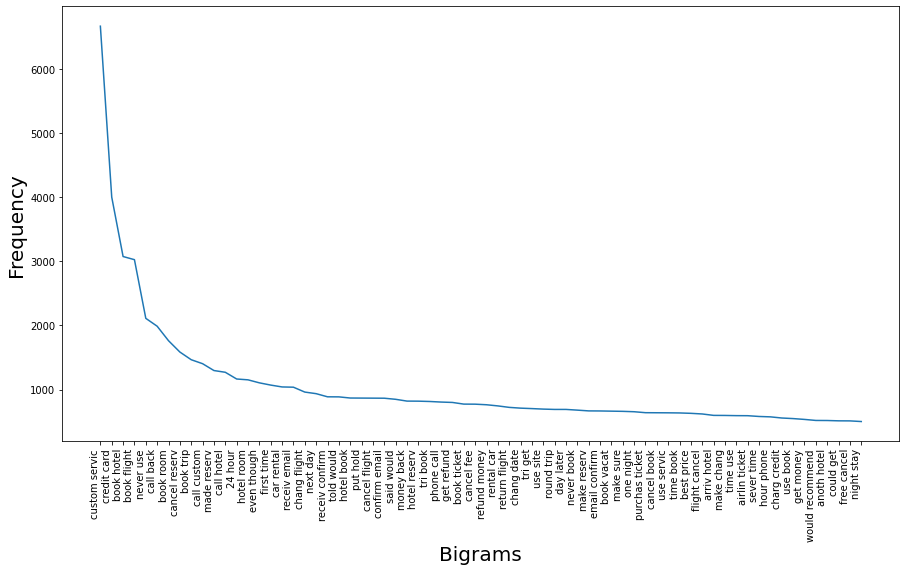

In [21]:
plt.figure(figsize=(15,8))
g7 = sns.lineplot(x='bigrams', y = 'frequency', data =df_total, sort = False, markers = True )
g7.set_xticklabels(df_total.bigrams, rotation = 90, ha="right")
g7.set_xlabel("Bigrams",fontsize=20)
g7.set_ylabel("Frequency",fontsize =20)

# Tri-grams

In [27]:
BookIt_bi_grams = BookIt['text'].apply(lambda x: TextBlob(x).ngrams(3))
CheapOair_bi_grams = CheapOair['text'].apply(lambda x: TextBlob(x).ngrams(3)) 
Expedia_bi_grams = Expedia['text'].apply(lambda x: TextBlob(x).ngrams(3))
Priceline_bi_grams = Priceline['text'].apply(lambda x: TextBlob(x).ngrams(3))
Booking_bi_grams = Booking['text'].apply(lambda x: TextBlob(x).ngrams(3))
Hotels_bi_grams = Hotels['text'].apply(lambda x: TextBlob(x).ngrams(3))
Travelocity_bi_grams = Travelocity['text'].apply(lambda x: TextBlob(x).ngrams(3))
Hotwire_bi_grams = Hotwire['text'].apply(lambda x: TextBlob(x).ngrams(3))
Orbitz_bi_grams = Orbitz['text'].apply(lambda x: TextBlob(x).ngrams(3))
OneTravel_bi_grams = OneTravel['text'].apply(lambda x: TextBlob(x).ngrams(3))
TripAdvisor_bi_grams = TripAdvisor['text'].apply(lambda x: TextBlob(x).ngrams(3))
Airbnb_bi_grams = Airbnb['text'].apply(lambda x: TextBlob(x).ngrams(3))
CheapTickets_bi_grams = CheapTickets['text'].apply(lambda x: TextBlob(x).ngrams(3))
trivago_bi_grams = trivago['text'].apply(lambda x: TextBlob(x).ngrams(3))
KAYAK_bi_grams = KAYAK['text'].apply(lambda x: TextBlob(x).ngrams(3))
Travelzoo_bi_grams = Travelzoo['text'].apply(lambda x: TextBlob(x).ngrams(3))
Hipmunk_bi_grams = Hipmunk['text'].apply(lambda x: TextBlob(x).ngrams(3))

In [28]:
#trigrams
word_vectorizer = CountVectorizer(ngram_range=(3,3), analyzer='word')
sparse_matrix = word_vectorizer.fit_transform(df['text'])
frequencies = sum(sparse_matrix).toarray()[0]
sites_trigram = pd.DataFrame(frequencies, index=word_vectorizer.get_feature_names(), columns=['frequency'])

In [41]:
#Select bigrams with frequency > 500
df_total3 = sites_trigram.loc[(sites_trigram['frequency'] >= 100)].sort_values('frequency', ascending = False)

In [42]:
df_total3 = df_total3.sort_values(['frequency'], ascending = False).reset_index()

In [43]:
df_total3.columns = ['trigrams', 'frequency']

<ipython-input-44-6ec5190907e1>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  g8.set_xticklabels(df_total3.trigrams, rotation = 90, ha="right")


Text(0, 0.5, 'Frequency')

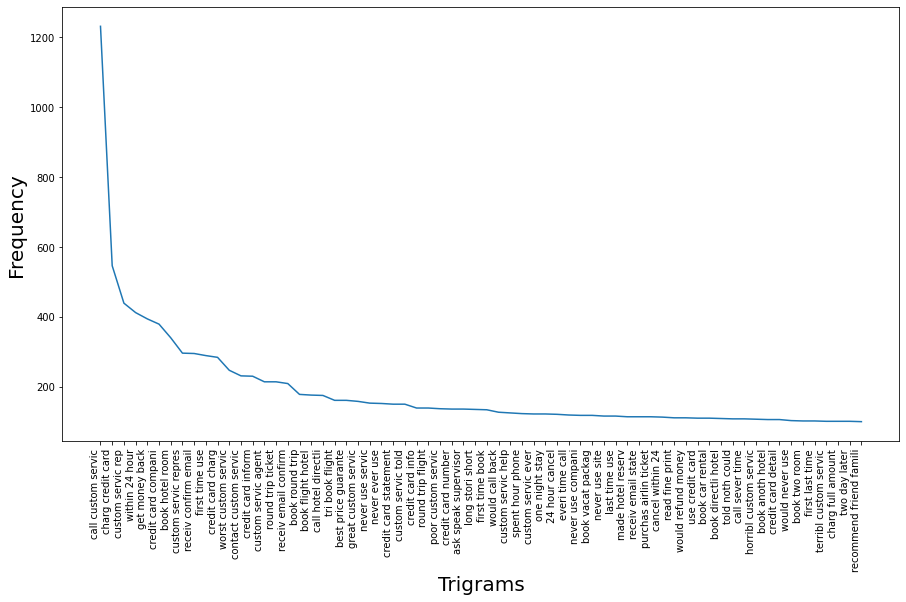

In [44]:
plt.figure(figsize=(15,8))
g8 = sns.lineplot(x='trigrams', y = 'frequency', data =df_total3, sort = False, markers = True )
g8.set_xticklabels(df_total3.trigrams, rotation = 90, ha="right")
g8.set_xlabel("Trigrams",fontsize=20)
g8.set_ylabel("Frequency",fontsize=20)

# Bigrams per Rating

In [45]:
# Rating 5 - Bigrams
df_5 = df.loc[df['rating'] == 5]

In [46]:
word_vectorizer = CountVectorizer(ngram_range=(2,2), analyzer='word')
sparse_matrix = word_vectorizer.fit_transform(df_5['text'])
frequencies = sum(sparse_matrix).toarray()[0]
df5_bigram_score = pd.DataFrame(frequencies, index=word_vectorizer.get_feature_names(), columns=['frequency'])

In [47]:
#Select bigrams with frequency > 500
df_5 = df5_bigram_score.loc[(df5_bigram_score['frequency'] >= 100)].sort_values('frequency', ascending = False)

In [48]:
df_5 = df5_bigram_score.sort_values(['frequency'], ascending = False).reset_index()

In [49]:
df_5.columns = ['bigrams', 'frequency']

In [50]:
df_5_top30 = df_5.head(30)

<ipython-input-51-4101b280e26b>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  g9.set_xticklabels(df_5.bigrams, rotation = 90, ha="right")


Text(0, 0.5, 'Frequency')

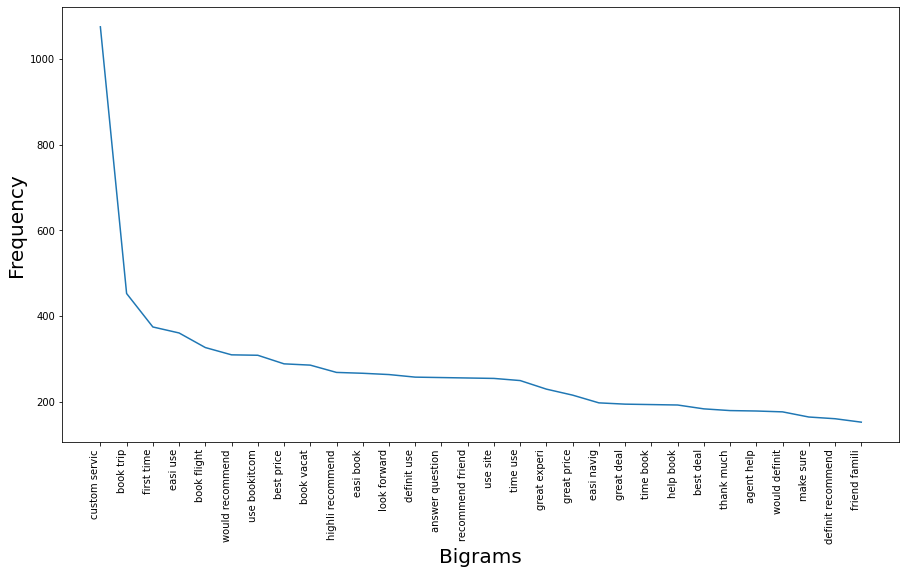

In [51]:
plt.figure(figsize=(15,8))
g9 = sns.lineplot(x='bigrams', y = 'frequency', data =df_5_top30, sort = False)
g9.set_xticklabels(df_5.bigrams, rotation = 90, ha="right")
g9.set_xlabel("Bigrams",fontsize=20)
g9.set_ylabel("Frequency",fontsize=20)

In [52]:
# Rating 1 - Bigrams
df_1 = df.loc[df['rating'] == 1]

In [53]:
word_vectorizer = CountVectorizer(ngram_range=(2,2), analyzer='word')
sparse_matrix = word_vectorizer.fit_transform(df_1['text'])
frequencies = sum(sparse_matrix).toarray()[0]
df1_bigram_score = pd.DataFrame(frequencies, index=word_vectorizer.get_feature_names(), columns=['frequency'])

In [54]:
#Select bigrams with frequency > 100
df_1 = df1_bigram_score.loc[(df1_bigram_score['frequency'] >= 100)].sort_values('frequency', ascending = False)

In [55]:
df_1 = df1_bigram_score.sort_values(['frequency'], ascending = False).reset_index()

In [56]:
df_1.columns = ['bigrams', 'frequency']

In [57]:
df_1_top30 = df_1.head(30)

<ipython-input-58-1ea1bef5d866>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  g10.set_xticklabels(df_1.bigrams, rotation = 90, ha="right")


Text(0, 0.5, 'Frequency')

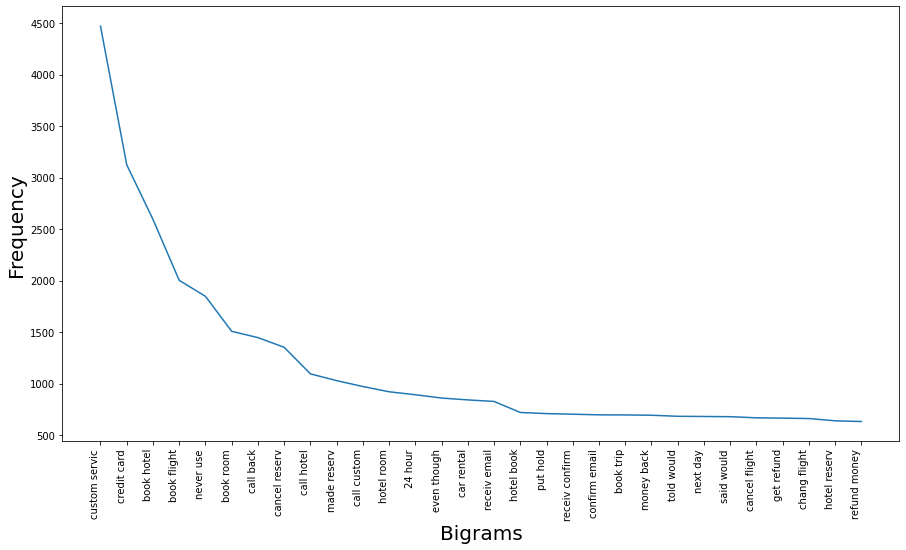

In [58]:
plt.figure(figsize=(15,8))
g10 = sns.lineplot(x='bigrams', y = 'frequency', data =df_1_top30, sort = False)
g10.set_xticklabels(df_1.bigrams, rotation = 90, ha="right")
g10.set_xlabel("Bigrams",fontsize=20)
g10.set_ylabel("Frequency",fontsize=20)

# Common bigram in both rating = 5 & rating =1 reviews 

In [59]:
inner_join_bigrams = pd.concat([df_5.set_index('bigrams'),df_1.set_index('bigrams')], axis=1, join='inner')
inner_join_bigrams.columns = ['rating = 5 frequency', 'rating = 1 frequency']

In [60]:
inner_join_bigrams.head(30)

,rating = 5 frequency,rating = 1 frequency
bigrams,,
custom servic,1075,4470
book trip,453,695
first time,375,484
easi use,361,13
book flight,327,2002
would recommend,310,139
use bookitcom,309,70
best price,289,251
book vacat,286,265


# Word Cloud

In [61]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
# generate word cloud
wc.generate(' '.join(df['text']))

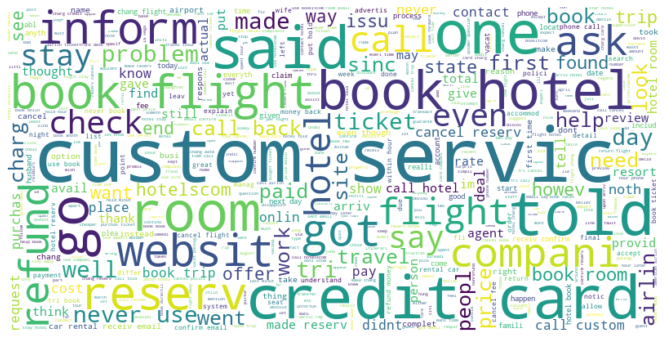

In [62]:
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

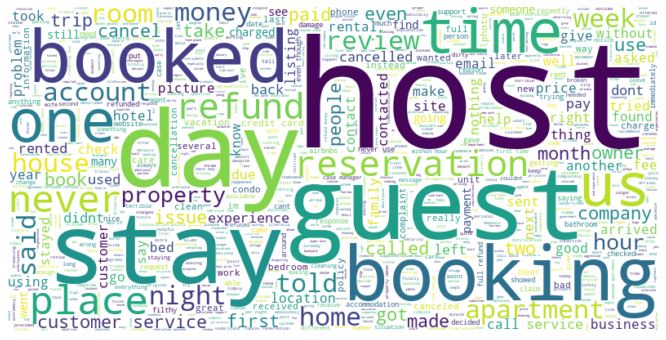

In [63]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Airbnb['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

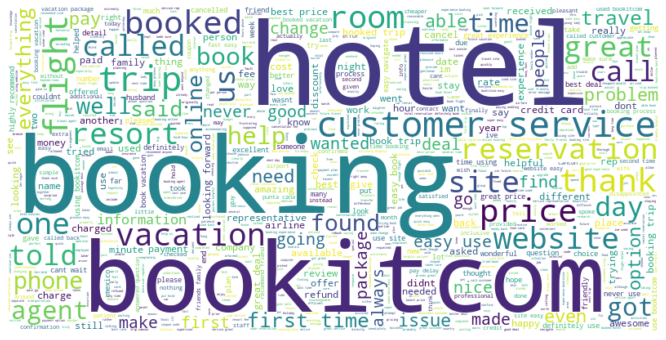

In [64]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(BookIt['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

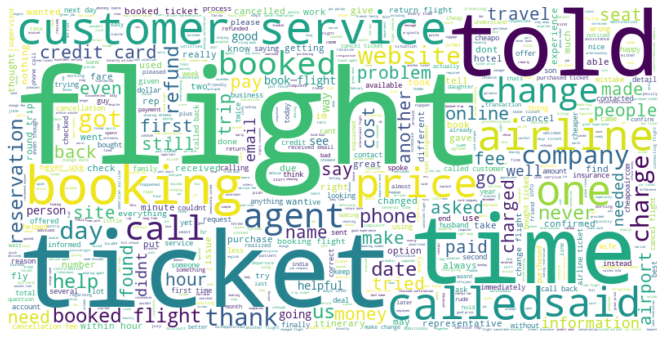

In [65]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(CheapOair['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

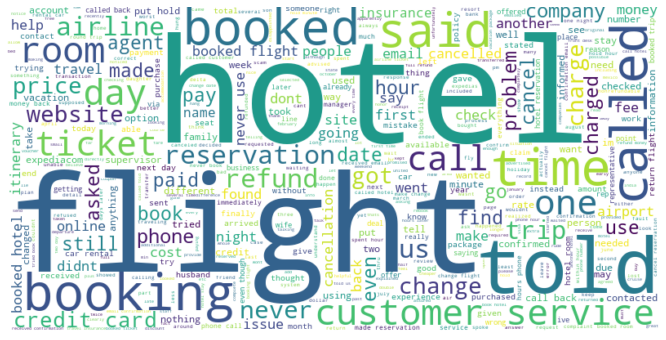

In [66]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Expedia['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

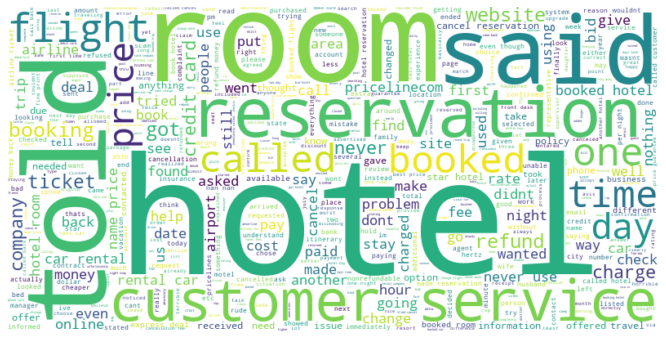

In [67]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Priceline['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

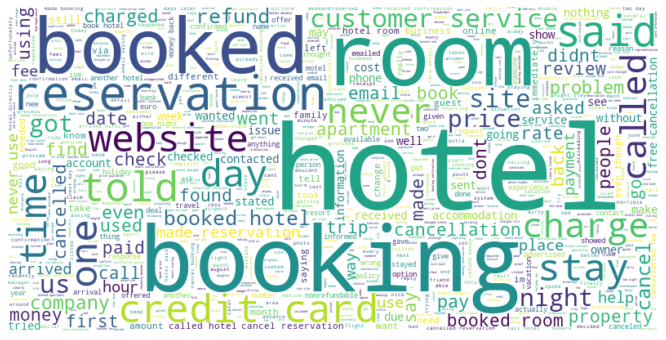

In [68]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Booking['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

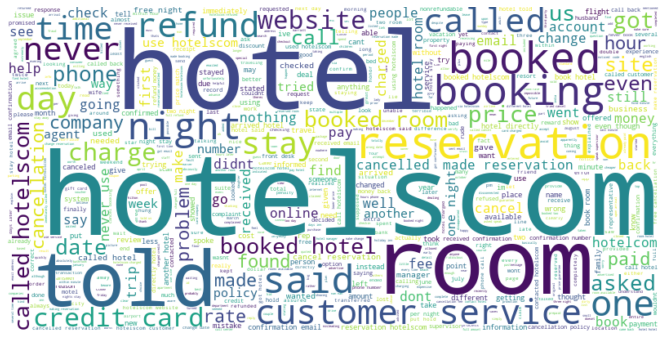

In [69]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Hotels['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

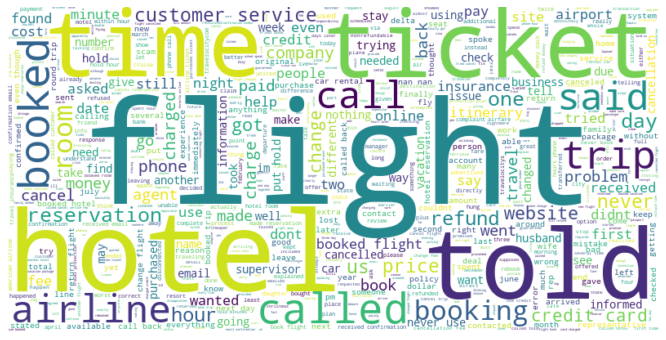

In [70]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Travelocity['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

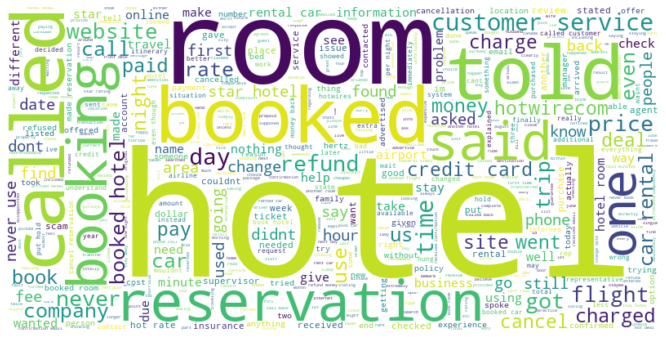

In [71]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Hotwire['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

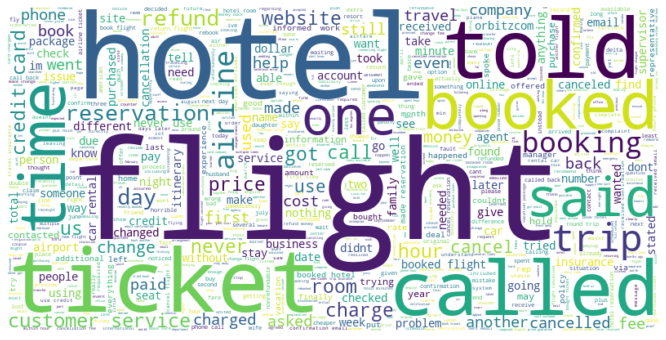

In [72]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Orbitz['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

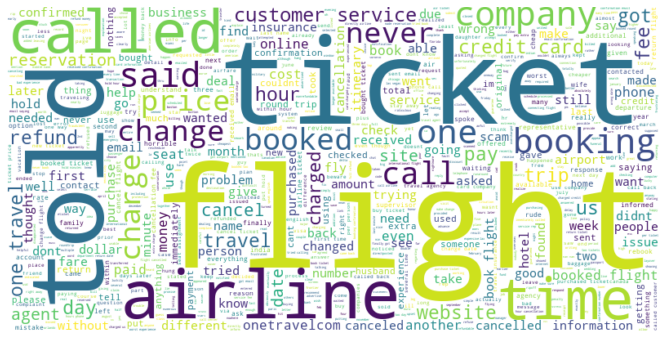

In [73]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(OneTravel['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

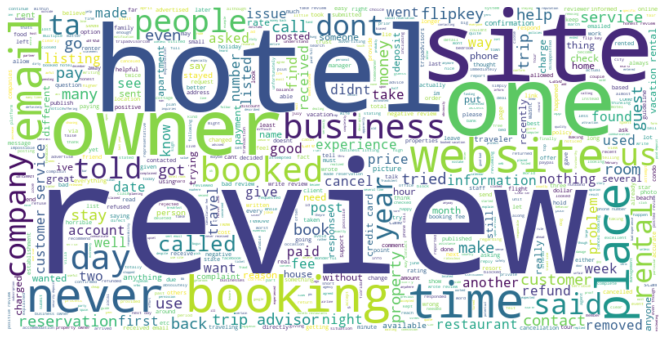

In [74]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(TripAdvisor['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

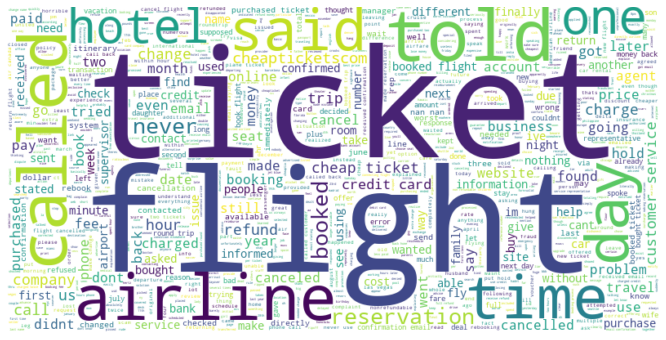

In [75]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(CheapTickets['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

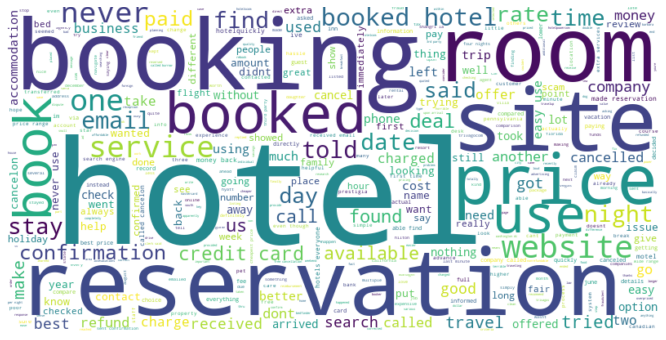

In [76]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(trivago['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

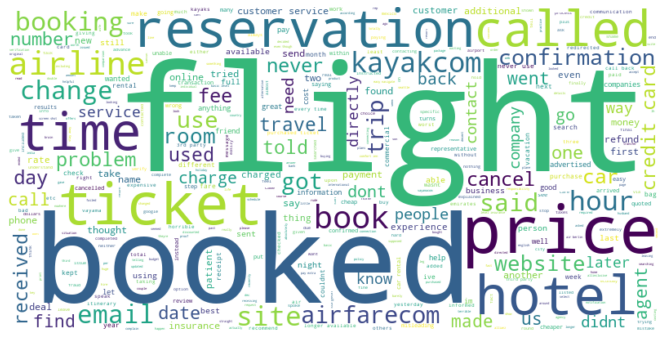

In [77]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(KAYAK['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

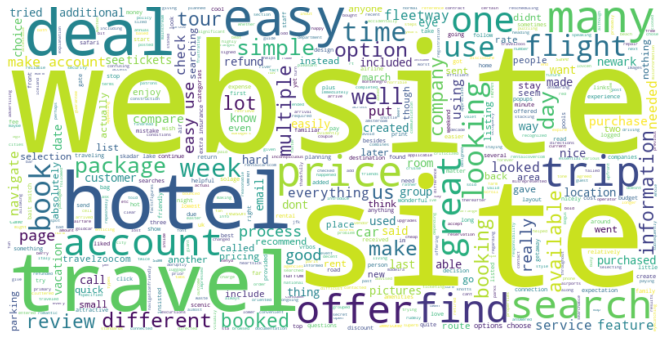

In [78]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Travelzoo['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

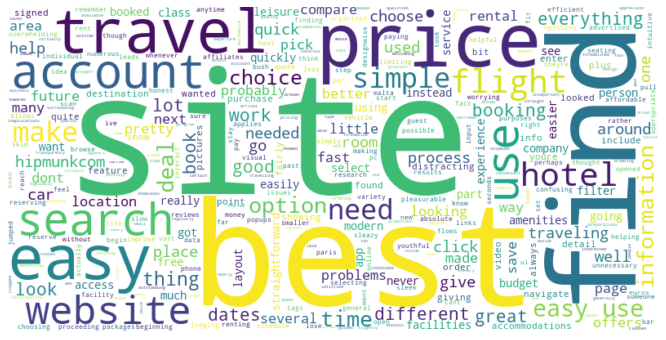

In [79]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc.generate(' '.join(Hipmunk['text']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

# Sentiment Analysis

In [80]:
sample_size = 4000

def sentiment_func(x):
    sentiment = TextBlob(x['text'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

sample = df.sample(sample_size).apply(sentiment_func, axis=1)

In [81]:
sample

,helpful,rating,review_date,site,text,verified_buyer,verified_reviewer,city,state,review_length,polarity,subjectivity
16846,NaN,5.0,2018-04-16,BookIt.com,great price good option book mobil got super h...,VerifiedBuyer,VerifiedReviewer,Stephen of Beaverton,OR,242,0.611111,0.672222
4328,NaN,1.0,2019-03-20,Booking.com,card number taken ye ive contact bank fraud de...,NaN,VerifiedReviewer,Kalil of Maple Ridge,BC,302,0.000000,0.000000
34631,2.0,1.0,2016-01-25,BookIt.com,ive tri modifi flight hold long wait time hang...,VerifiedBuyer,VerifiedReviewer,Arty of Bronx,NY,115,-0.050000,0.400000
19811,NaN,1.0,2012-09-12,Hotels.com,book room crete 3 night inclus 4star hotel saw...,NaN,NaN,Tal of Netanya,OTHER,498,-0.188889,0.222222
10807,3.0,1.0,2016-08-20,Hotels.com,book room red lion hotel feder way wa 20 minut...,NaN,VerifiedReviewer,Sadie of Wenatchee,WA,643,-0.077778,0.242593
...,...,...,...,...,...,...,...,...,...,...,...,...
26694,14.0,NaN,2010-09-21,Booking.com,understand peopl wrote think mani dont know wo...,NaN,NaN,Vasco of Porto,Other,462,0.500000,0.500000
23436,NaN,1.0,2015-08-10,Expedia,tri use expedia 25 promo coupon firsttim book ...,VerifiedBuyer,VerifiedReviewer,David of Oshkosh,WI,508,0.080000,0.257778
13874,2.0,1.0,2015-03-15,Hotwire,use past woman phone told would get day type i...,NaN,NaN,karen of Bethel Park,PA,416,0.115000,0.250000
24080,NaN,1.0,2012-03-05,Priceline,book hotel london 5 night june 1620 fill neces...,NaN,VerifiedReviewer,Christin of Evergreen,CO,717,0.100000,0.237778


Text(0, 0.5, 'Polarity')

<Figure size 1152x720 with 0 Axes>

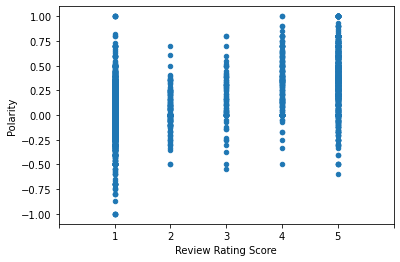

In [82]:

plt.figure(figsize =(16,10))
sample.plot.scatter('rating', 'polarity')
plt.xticks(np.arange(7), ('', '1', '2', '3', '4', '5',''))
plt.xlabel('Review Rating Score')
plt.ylabel('Polarity')

# Detecting good, neutral, and bad reviews

In [84]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\KitaeKim\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping taggers\averaged_perceptron_tagger.zip.


True

In [86]:
def get_wordnet_pos(pos_tag):
    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [87]:
def clean_text(text):
    # lower text
    text = text.lower()
    # tokenize text and remove puncutation
    text = [word.strip(string.punctuation) for word in text.split(" ")]
    # remove words that contain numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]
    # remove stop words
    stop = stopwords.words('english')
    text = [x for x in text if x not in stop]
    # remove empty tokens
    text = [t for t in text if len(t) > 0]
    # pos tag text
    pos_tags = pos_tag(text)
    # lemmatize text
    text = [WordNetLemmatizer().lemmatize(t[0], get_wordnet_pos(t[1])) for t in pos_tags]
    # remove words with only one letter
    text = [t for t in text if len(t) > 1]
    # join all
    text = " ".join(text)
    return(text)

In [88]:
# clean text data
df["text_clean"] = df["text"].map(lambda x: clean_text(x))

In [90]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\KitaeKim\AppData\Roaming\nltk_data...


True

In [91]:
# add sentiment anaylsis columns
from nltk.sentiment.vader import SentimentIntensityAnalyzer

sid = SentimentIntensityAnalyzer()
df["sentiments"] = df["text"].apply(lambda x: sid.polarity_scores(x))

In [92]:
df = pd.concat([df.drop(['sentiments'], axis=1), df['sentiments'].apply(pd.Series)], axis=1)

In [93]:
# add number of characters column
df["nb_chars"] = df["text"].apply(lambda x: len(x))

In [94]:
# add number of words column
df["nb_words"] = df["text"].apply(lambda x: len(x.split(" ")))

In [95]:
# highest positive sentiment reviews (with more than 5 words)
df[df["nb_words"] >= 5].sort_values("pos", ascending = False)[["text", "pos"]].head(10)

,text,pos
31862,impress help quick experi recommend friend,0.850
31364,want thank rebecca great custom servic kind cl...,0.847
31600,crystal help would recommend friend thank,0.845
29264,thank help help accomplish everyth need,0.843
29411,great peopl great servic thank,0.843
34748,everyth fine good job thank support,0.832
32389,hope good vacat thank guy,0.806
30505,thank book room hope nice,0.804
30238,person help extrem nice help,0.804
31816,good experi help thank much,0.802


In [96]:
# lowest negative sentiment reviews (with more than 5 words)
df[df["nb_words"] >= 5].sort_values("neg", ascending = False)[["text", "neg"]].head(10)

,text,neg
28611,hate charg chang even fault,0.681
2146,never chang cancel hotel reserv never recommen...,0.622
34272,cancel chang polici total suck,0.620
9400,scam scam scam warn use aw aw aw made error bo...,0.590
504,help get ticket refund flight cancel delay eve...,0.574
27714,one wrong click lock bad way busi,0.569
6627,pay get want bad custom servic realli bad busi...,0.540
17322,compani suck much word dictionari describ wasn...,0.520
32991,need extra day problem fast book problem,0.519
25888,keep steal money websit weird gave wrong infor...,0.503


In [97]:
df["is_bad_review"] = df["rating"].apply(lambda x: -1 if x < 3 else (0 if x==3 else 1))

In [98]:
df2 = df[["text", "is_bad_review"]]
df2

,text,is_bad_review
0,save 600 v anoth web site use mani time contin...,1
1,great experi need help chang flight repres qui...,1
2,noth courteou patient will help advisor ive al...,1
3,want let know talk anoth coupl decid book comp...,1
4,call verifi one inclus featur comment descript...,1
...,...,...
35353,travel uk live meet friend canada set meet dom...,-1
35354,book hotel airlin reserv includ seat bookitcom...,1
35355,book hotel airlin reserv includ seat bookitcom...,1
35356,purchas march 2010 vacat la vega bookitcom als...,1


In [99]:
# show is_bad_review distribution
df["is_bad_review"].value_counts(normalize = True)

-1    0.613836
 1    0.363991
 0    0.022173
Name: is_bad_review, dtype: float64

C:\Users\KitaeKim\miniconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\KitaeKim\miniconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\KitaeKim\miniconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibili

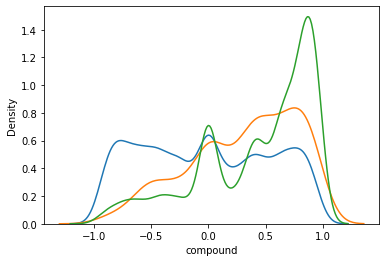

In [100]:
for x in [-1, 0, 1]:
    subset = df[df['is_bad_review'] == x]
    
    # Draw the density plot
    if x == -1:
        label = "Bad reviews"
    elif x == 0:
        label = "Neutral reviews"
    else:
        label = "Good reviews"
    sns.distplot(subset['compound'], hist = False, label = label)
    
    

# Word Distribution

In [101]:
df['freq_word'] = df['text'].apply(lambda x: len(str(x).split()))
df['unique_freq_word'] =df['text'].apply(lambda x: len(set(str(x).split())))

In [102]:
df.head()

,helpful,rating,review_date,site,text,verified_buyer,verified_reviewer,city,state,review_length,text_clean,neg,neu,pos,compound,nb_chars,nb_words,is_bad_review,freq_word,unique_freq_word
0,2.0,5.0,2019-05-26,BookIt.com,save 600 v anoth web site use mani time contin...,VerifiedBuyer,VerifiedReviewer,Stuart of Springfield,IL,178,save anoth web site use mani time continu book...,0.000,0.618,0.382,0.8720,102,20,1,20,18
1,8.0,5.0,2019-03-28,BookIt.com,great experi need help chang flight repres qui...,VerifiedBuyer,VerifiedReviewer,Nichole of Roseville,CA,196,great experi need help chang flight repres qui...,0.000,0.561,0.439,0.9100,116,20,1,20,18
2,7.0,5.0,2019-02-10,BookIt.com,noth courteou patient will help advisor ive al...,VerifiedBuyer,VerifiedReviewer,Cheryl of Corfu,NY,210,noth courteou patient help advisor ive alreadi...,0.000,0.709,0.291,0.8225,144,24,1,24,23
3,4.0,5.0,2019-05-22,BookIt.com,want let know talk anoth coupl decid book comp...,VerifiedBuyer,VerifiedReviewer,Lisa of Flushing,MI,696,want let know talk anoth coupl decid book comp...,0.000,0.927,0.073,0.5719,369,62,1,62,43
4,4.0,4.0,2019-04-13,BookIt.com,call verifi one inclus featur comment descript...,VerifiedBuyer,VerifiedReviewer,Brandon of Honolulu,HI,431,call verifi one inclus featur comment descript...,0.085,0.798,0.117,0.3968,284,46,1,46,41


C:\Users\KitaeKim\miniconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


median of word frequency:  43.0


C:\Users\KitaeKim\miniconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


median of uniuqe word frequency:  35.0


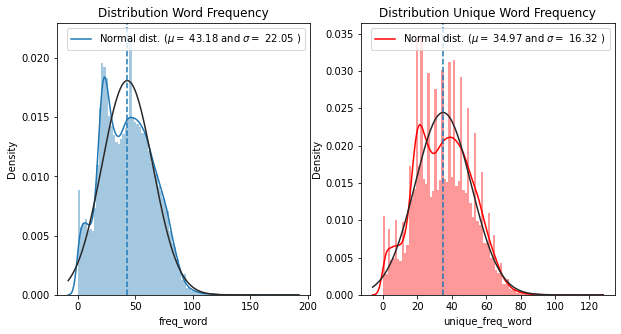

In [103]:
fig, axes = plt.subplots(ncols=2)
fig.set_size_inches(10,5)

sns.distplot(df['freq_word'], bins = 90, ax = axes[0], fit = stats.norm)
(mu0, sigma0) = stats.norm.fit(df['freq_word'])
axes[0].legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu0, sigma0)],loc='best')
axes[0].set_title("Distribution Word Frequency")
axes[0].axvline(df['freq_word'].median(), linestyle='dashed')
print("median of word frequency: ", df['freq_word'].median())


sns.distplot(df['unique_freq_word'], bins = 90, ax=axes[1], color = 'r', fit = stats.norm)
(mu1, sigma1) = stats.norm.fit(df['unique_freq_word'])
axes[1].set_title("Distribution Unique Word Frequency")
axes[1].legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu1, sigma1)],loc='best')
axes[1].axvline(df['unique_freq_word'].median(), linestyle='dashed')
print("median of uniuqe word frequency: ", df['unique_freq_word'].median())

# TF-IDF Analysis

In [105]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [106]:
corpus = df['text']
tfidf = TfidfVectorizer()
response = tfidf.fit_transform(corpus)

In [107]:
feature_names = tfidf.get_feature_names()
for col in response.nonzero()[1]:
    print (feature_names[col], ' - ', response[0, col])

price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
anoth  -  0.19387395463175996
600  -  0.3661770758832008
save  -  0.2679856244666799
futur  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
found  -  0.0
quick  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
save  -  0.2679856244666799
vacat  -  0.0
next  -  0.0
wait  -  0.0
cant  -  0.0
activ  -  0.0
sign  -  0.0
someon  -  0.0
talk  -  0.0
actual  -  0.0
abl  -  0.0
bookitcom  -  0.0
friend  -  0.0
numer  -  0.0
told  -  0.

situat  -  0.0
due  -  0.0
rearrang  -  0.0
beyond  -  0.0
jeannin  -  0.0
made  -  0.0
except  -  0.0
plan  -  0.0
caus  -  0.0
much  -  0.0
everi  -  0.0
could  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
went  -  0.0
travel  -  0.0
bookitcom  -  0.0
noth  -  0.0
help  -  0.0
provid  -  0.24585306853302216
today  -  0.0
im  -  0.0
mexico  -  0.0
friendli  -  0.0
interest  -  0.0
polit  -  0.0
request  -  0.0
accommod  -  0.0
superb  -  0.0
marshal  -  0.0
amaz  -  0.0
plea  -  0.0
alway  -  0.0
resort  -  0.0
got  -  0.0
knowledg  -  0.0
back  -  0.0
go  -  0.0
compani  -  0.0
bookitcom  -  0.0
courteou  -  0.0
experi  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
birthday  -  0.0
effort  -  0.0
enthusiast  -  0.0
name  -  0.0
guy  -  0.0
result  -  0.0
question  -  0.0
ask  -  0.0
marshal  -  0.0
appreci  -  0.0
jamaica  -  0.0
deal  -  0.0
reserv  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
futur  -  0.0
help  -  0.0
trip  -  0.31986167461412957
b

quick  -  0.0
help  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
data  -  0.0
slow  -  0.0
pc  -  0.0
theyr  -  0.0
input  -  0.0
stay  -  0.0
guest  -  0.0
opinion  -  0.0
info  -  0.0
rent  -  0.0
your  -  0.0
option  -  0.0
fast  -  0.0
honest  -  0.0
account  -  0.0
well  -  0.0
way  -  0.0
date  -  0.0
alway  -  0.0
good  -  0.0
find  -  0.0
work  -  0.0
go  -  0.0
phone  -  0.0
includ  -  0.0
room  -  0.0
give  -  0.0
start  -  0.0
dont  -  0.0
show  -  0.0
pretti  -  0.0
travel  -  0.0
know  -  0.0
cant  -  0.0
someon  -  0.0
actual  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
lead  -  0.0
flow  -  0.0
gener  -  0.0
visual  -  0.0
click  -  0.0
your  -  0.0
inform  -  0.0
fast  -  0.0
account  -  0.0
simpl  -  0.0
ma

say  -  0.0
got  -  0.0
make  -  0.0
cancel  -  0.0
thing  -  0.0
dont  -  0.0
coupl  -  0.0
money  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
agre  -  0.0
polici  -  0.0
rentalcovercom  -  0.0
madeira  -  0.0
goldcar  -  0.0
contract  -  0.0
rentalcarscom  -  0.0
sent  -  0.0
azor  -  0.0
direct  -  0.0
turn  -  0.0
bounc  -  0.0
insur  -  0.0
bought  -  0.0
enter  -  0.0
order  -  0.0
link  -  0.0
rent  -  0.0
along  -  0.0
also  -  0.0
purchas  -  0.0
car  -  0.0
assum  -  0.0
week  -  0.0
extra  -  0.0
packag  -  0.0
call  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
vacat  -  0.0
condit  -  0.0
term  -  0.0
applic  -  0.0
advis  -  0.0
abruptli  -  0.0
rude  -  0.0
depart  -  0.0
mistak  -  0.0
recogn  -  0.0
immedi  -  0.0
puzzl  -  0.0
font  -  0.0
red  -  0.0
bold  -  0.0
disclosur  -  0.0
expir  -  0.0
thereaft  -  0.0
29  -  0.0
28  -  0.0
valid  -  0.0
accident  -  0.0
farm  -  0.0
berri  -  0.0
knott  -  0.0
print  -  0.0
inconspicu

follow  -  0.0
inform  -  0.0
account  -  0.0
simpl  -  0.0
purchas  -  0.0
look  -  0.0
problem  -  0.0
good  -  0.0
find  -  0.0
make  -  0.0
didnt  -  0.0
travel  -  0.0
abl  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
log  -  0.0
decis  -  0.0
creat  -  0.0
front  -  0.0
insid  -  0.0
link  -  0.0
amen  -  0.0
sever  -  0.0
select  -  0.0
option  -  0.0
easili  -  0.0
account  -  0.0
locat  -  0.0
compar  -  0.0
refer  -  0.0
pictur  -  0.0
properti  -  0.0
also  -  0.0
offer  -  0.0
see  -  0.0
make  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
travel  -  0.0
compani  -  0.0
sign  -  0.0
futur  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
mani  -  0.24316369406242275
save  -  0.2679856244666799
clutter  -  0.0
wonder  -  0.0
chose  -  0.0
cheap  -  0.0
probabl  -  0.0
littl  -  0.0
account  -  0.0


breakfast  -  0.0
secur  -  0.0
clean  -  0.0
stay  -  0.0
amen  -  0.0
inform  -  0.0
locat  -  0.0
event  -  0.0
staff  -  0.0
accur  -  0.0
enjoy  -  0.0
good  -  0.0
avail  -  0.0
room  -  0.0
hotel  -  0.0
help  -  0.0
escort  -  0.0
wheelchair  -  0.0
cheapest  -  0.0
fairli  -  0.0
multipl  -  0.0
whole  -  0.0
day  -  0.0
simpl  -  0.0
process  -  0.0
plan  -  0.0
overal  -  0.0
search  -  0.0
like  -  0.0
extra  -  0.0
servic  -  0.0
get  -  0.0
travel  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
singapor  -  0.0
honolulu  -  0.0
fli  -  0.0
hawaiian  -  0.0
line  -  0.0
sadli  -  0.0
wast  -  0.0
address  -  0.0
bad  -  0.0
ticket  -  0.0
kid  -  0.0
purchas  -  0.0
confirm  -  0.0
issu  -  0.0
first  -  0.0
like  -  0.0
phone  -  0.0
call  -  0.0
thing  -  0.0
airlin  -  0.0
want  -  0.0
wait  -  0.0
lot  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
corrupt  -  0.0
y

trip  -  0.31986167461412957
use  -  0.26077413664580884
voucher  -  0.0
weve  -  0.0
collabor  -  0.0
cooper  -  0.0
claus  -  0.0
militari  -  0.0
realiti  -  0.0
flexibl  -  0.0
protectioncancel  -  0.0
cancelpostpon  -  0.0
deploy  -  0.0
husband  -  0.0
fli  -  0.0
british  -  0.0
addit  -  0.0
reschedul  -  0.0
contact  -  0.0
refus  -  0.0
refund  -  0.0
transact  -  0.0
think  -  0.0
point  -  0.0
bad  -  0.0
ask  -  0.0
due  -  0.0
credit  -  0.0
ticket  -  0.0
month  -  0.0
pay  -  0.0
also  -  0.0
plan  -  0.0
case  -  0.0
got  -  0.0
back  -  0.0
like  -  0.0
extra  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
money  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
swindl  -  0.0
premium  -  0.0
damn  -  0.0
caveat  -  0.0
clearli  -  0.0
angri  -  0.0
cash  -  0.0
36551  -  0.0
18120  -  0.0
medic  -  0.0
voucher  -  0.0
protect  -  0.0
cover  -  0.0
wors  -  0.0
number  -  0.0
rt  -  0.0
addit  -  0.0
condit  -  0.0
term  -  

went  -  0.0
cant  -  0.0
activ  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
710  -  0.0
screenshot  -  0.0
765700  -  0.0
horrifi  -  0.0
power  -  0.0
expediaca  -  0.0
ie  -  0.0
c602600  -  0.0
trivagoca  -  0.0
regard  -  0.0
amount  -  0.0
year  -  0.0
insist  -  0.0
bill  -  0.0
fund  -  0.0
approx  -  0.0
canadian  -  0.0
said  -  0.0
correct  -  0.0
took  -  0.0
ask  -  0.0
recent  -  0.0
quot  -  0.0
day  -  0.0
offer  -  0.0
see  -  0.0
thought  -  0.0
email  -  0.0
resort  -  0.0
confirm  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
show  -  0.0
compani  -  0.0
would  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
supplier  -  0.0
5319  -  0.0
32019  -  0.0
pas  -  0.0
middleman  -  0.0
everyon  -  0.0
dc  -  0.0
washington  -  0.0
within  -  0.0
24  -  0.0
3rd  -  0.0
arrang  -  0.0

chicago  -  0.0
coverag  -  0.0
june  -  0.0
concert  -  0.0
attend  -  0.0
contact  -  0.0
advis  -  0.0
2019  -  0.0
20  -  0.0
18  -  0.0
refund  -  0.0
insur  -  0.0
possibl  -  0.0
last  -  0.0
today  -  0.0
assist  -  0.0
hour  -  0.0
made  -  0.0
payment  -  0.0
may  -  0.0
date  -  0.0
week  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
page  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
reason  -  0.0
travel  -  0.0
wait  -  0.0
would  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
advantag  -  0.0
unreal  -  0.0
confer  -  0.0
bos  -  0.0
exampl  -  0.0
neither  -  0.0
notic  -  0.0
delta  -  0.0
fli  -  0.0
consum  -  0.0
later  -  0.0
contact  -  0.0
ye  -  0.0
exact  -  0.0
certain  -  0.0
schedul  -  0.0
absolut  -  0.0
take  -  0.0
sold  -  0.0
busi  -  0.0
im  -  0.0
feel  -  0.0
origin  -  0.0
total  -  0.0
ticket  -  0.0
hour  -  0.0
purchas  -  0.0
car  -  0.0
see  -  

alreadi  -  0.0
repres  -  0.0
book  -  0.0913734863178861
chanc  -  0.0
remotest  -  0.0
advic  -  0.0
react  -  0.0
bother  -  0.0
stay  -  0.0
your  -  0.0
request  -  0.0
pay  -  0.0
even  -  0.0
plan  -  0.0
email  -  0.0
week  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
travel  -  0.0
never  -  0.0
chang  -  0.0
book  -  0.0913734863178861
pace  -  0.0
65  -  0.0
age  -  0.0
henri  -  0.0
organis  -  0.0
antelop  -  0.0
bu  -  0.0
canyon  -  0.0
excel  -  0.0
grand  -  0.0
comfort  -  0.0
care  -  0.0
vega  -  0.0
guid  -  0.0
tour  -  0.0
took  -  0.0
throughout  -  0.0
take  -  0.0
accommod  -  0.0
plu  -  0.0
keep  -  0.0
day  -  0.0
anyon  -  0.0
well  -  0.0
enjoy  -  0.0
way  -  0.0
thing  -  0.0
went  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
forget  -  0.0
tours4fun  -  0.0
particip  -  0.0
insuffici  -  0.0
memor  -  0.0
jeff  -  0.0
eva  -  0.0
surpass  -  0.0
bend  -  0.0
horsesho  -  

say  -  0.0
impress  -  0.0
enjoy  -  0.0
definit  -  0.0
way  -  0.0
plea  -  0.0
good  -  0.0
got  -  0.0
servic  -  0.0
realli  -  0.0
nation  -  0.0
next  -  0.0
noth  -  0.0
found  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
significantli  -  0.0
8day  -  0.0
texa  -  0.0
fair  -  0.0
felt  -  0.0
group  -  0.0
long  -  0.0
term  -  0.0
refus  -  0.0
refund  -  0.0
cut  -  0.0
order  -  0.0
ask  -  0.0
request  -  0.0
day  -  0.0
upset  -  0.0
also  -  0.0
custom  -  0.0
differ  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
help  -  0.0
price  -  0.15910357157775243
5060  -  0.0
mainli  -  0.0
reaaalli  -  0.0
reenter  -  0.0
offic  -  0.0
queue  -  0.0
invoic  -  0.0
qr  -  0.0
cabl  -  0.0
chine  -  0.0
ride  -  0.0
tours4fun  -  0.0
local  -  0.0
surpris  -  0.0
wall  -  0.0
12  -  0.0
code  -  0.0
fine  -  0.0
entranc  -  0.0
oper  -  0.0
contact  -  0.0
mistak  -  0.0
recogn  -  0.0
sent  -  0.0
big  -  0.0
usd  -  0.0
refund  -  0.0
buy  -

locat  -  0.0
shop  -  0.0
beauti  -  0.0
close  -  0.0
still  -  0.0
view  -  0.0
super  -  0.0
right  -  0.0
independ  -  0.0
jame  -  0.0
reject  -  0.0
publish  -  0.0
initi  -  0.0
inbox  -  0.0
insult  -  0.0
thread  -  0.0
treatment  -  0.0
unhappi  -  0.0
treat  -  0.0
sicili  -  0.0
express  -  0.0
platform  -  0.0
conclus  -  0.0
repeat  -  0.0
wrote  -  0.0
badli  -  0.0
food  -  0.0
wrong  -  0.0
left  -  0.0
remov  -  0.0
aw  -  0.0
turn  -  0.0
scam  -  0.0
tell  -  0.0
stay  -  0.0
opinion  -  0.0
think  -  0.0
person  -  0.0
worth  -  0.0
explain  -  0.0
support  -  0.0
honest  -  0.0
owner  -  0.0
etc  -  0.0
made  -  0.0
though  -  0.0
review  -  0.0
leav  -  0.0
well  -  0.0
restaur  -  0.0
even  -  0.0
email  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
week  -  0.0
new  -  0.0
100  -  0.0
servic  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
happen  -  0.0
dont  -  0.0
everyth  -  0.0
place  -  0.0
know  -  0.0
l

evil  -  0.0
infin  -  0.0
excess  -  0.0
compens  -  0.0
inbound  -  0.0
figur  -  0.0
scene  -  0.0
rica  -  0.0
costa  -  0.0
shouldnt  -  0.0
escal  -  0.0
updat  -  0.0
repeat  -  0.0
hear  -  0.0
lucki  -  0.0
joke  -  0.0
outbound  -  0.0
wrong  -  0.0
within  -  0.0
hand  -  0.0
promis  -  0.0
oper  -  0.0
mistak  -  0.0
big  -  0.0
either  -  0.0
miss  -  0.0
cours  -  0.0
behind  -  0.0
return  -  0.0
stay  -  0.0
person  -  0.0
commun  -  0.0
inform  -  0.0
support  -  0.0
sold  -  0.0
enough  -  0.0
busi  -  0.0
ask  -  0.0
horribl  -  0.0
ticket  -  0.0
unabl  -  0.0
hold  -  0.0
review  -  0.0
airport  -  0.0
also  -  0.0
purchas  -  0.0
alway  -  0.0
got  -  0.0
far  -  0.0
allow  -  0.0
check  -  0.0
away  -  0.0
back  -  0.0
doesnt  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
thing  -  0.0
dont  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
talk  -  0.0
actual  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.091373486

know  -  0.0
recommend  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
terribl  -  0.0
given  -  0.0
number  -  0.0
ago  -  0.0
card  -  0.0
day  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
plan  -  0.0
payment  -  0.0
confirm  -  0.0
far  -  0.0
first  -  0.0
onlin  -  0.0
go  -  0.0
charg  -  0.0
airlin  -  0.0
cant  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
whoever  -  0.0
pal  -  0.0
4x  -  0.0
usd100  -  0.0
68  -  0.0
1099  -  0.0
hidden  -  0.0
crook  -  0.0
statement  -  0.0
mislead  -  0.0
pas  -  0.0
network  -  0.0
depart  -  0.0
agenc  -  0.0
bill  -  0.0
usd  -  0.0
said  -  0.0
insur  -  0.0
card  -  0.0
seat  -  0.0
prefer  -  0.0
credit  -  0.0
peopl  -  0.0
pay  -  0.0
choos  -  0.0
say  -  0.0
mention  -  0.0
way  -  0.0
much  

extrem  -  0.0
look  -  0.0
even  -  0.0
check  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
went  -  0.0
actual  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
powerless  -  0.0
held  -  0.0
battl  -  0.0
lock  -  0.0
430  -  0.0
closer  -  0.0
350  -  0.0
nj  -  0.0
respond  -  0.0
australia  -  0.0
mean  -  0.0
lose  -  0.0
tax  -  0.0
wont  -  0.0
legal  -  0.0
bewar  -  0.0
lie  -  0.0
number  -  0.0
newark  -  0.0
contract  -  0.0
scam  -  0.0
either  -  0.0
pick  -  0.0
account  -  0.0
im  -  0.0
fee  -  0.0
day  -  0.0
pay  -  0.0
say  -  0.0
impress  -  0.0
car  -  0.0
much  -  0.0
extra  -  0.0
cancel  -  0.0
dollar  -  0.0
go  -  0.0
200  -  0.0
one  -  0.0
get  -  0.0
dont  -  0.0
went  -  0.0
pretti  -  0.0
know  -  0.0
actual  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
hooker  -  0.0
trucker  -  0.0
motor  -  0.0
northgat  -  0.0
inn  -  0.0
star  -  0.0

peopl  -  0.0
day  -  0.0
anyon  -  0.0
still  -  0.0
though  -  0.0
car  -  0.0
sinc  -  0.0
couldnt  -  0.0
rang  -  0.0
happi  -  0.0
end  -  0.0
didnt  -  0.0
super  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
let  -  0.0
next  -  0.0
someon  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
20000  -  0.0
2020  -  0.0
isnt  -  0.0
boardwalk  -  0.0
hollywood  -  0.0
condo  -  0.0
host  -  0.0
diego  -  0.0
fl  -  0.0
describ  -  0.0
son  -  0.0
apart  -  0.0
san  -  0.0
york  -  0.0
chicago  -  0.0
10  -  0.0
wrong  -  0.0
sometim  -  0.0
year  -  0.0
citi  -  0.0
later  -  0.0
2019  -  0.0
wife  -  0.0
human  -  0.0
whenev  -  0.0
gave  -  0.0
bad  -  0.0
question  -  0.0
friendli  -  0.0
recent  -  0.0
credit  -  0.0
perfect  -  0.0
made  -  0.0
month  -  0.0
review  -  0.0
also  -  0.0
world  -  0.0
see  -  0.0
februari  -  0.0
exactli  -  0.0
week  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
thing  -

complaint  -  0.0
independ  -  0.0
attent  -  0.0
pas  -  0.0
wall  -  0.0
upon  -  0.0
line  -  0.0
separ  -  0.0
deliv  -  0.0
given  -  0.0
consum  -  0.0
home  -  0.0
contact  -  0.0
refus  -  0.0
occas  -  0.0
match  -  0.0
biggest  -  0.0
despit  -  0.0
visit  -  0.0
return  -  0.0
clean  -  0.0
fit  -  0.0
purpos  -  0.0
involv  -  0.0
fee  -  0.0
recent  -  0.0
plu  -  0.0
two  -  0.0
properti  -  0.0
part  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
thing  -  0.0
happen  -  0.0
hit  -  0.0
decid  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
nonwork  -  0.0
roof  -  0.0
wifi  -  0.0
fals  -  0.0
attitud  -  0.0
tub  -  0.0
inn  -  0.0
item  -  0.0
repair  -  0.0
hot  -  0.0
red  -  0.0
ill  -  0.0


citi  -  0.0
addit  -  0.0
newark  -  0.0
wife  -  0.0
came  -  0.0
via  -  0.0
insur  -  0.0
arriv  -  0.0
rent  -  0.0
sever  -  0.0
quickli  -  0.0
last  -  0.0
littl  -  0.0
select  -  0.0
commun  -  0.0
result  -  0.0
friendli  -  0.0
recent  -  0.0
total  -  0.0
peopl  -  0.0
unabl  -  0.0
day  -  0.0
hold  -  0.0
made  -  0.0
airport  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
search  -  0.0
minut  -  0.0
reserv  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
includ  -  0.0
call  -  0.0
decid  -  0.0
know  -  0.0
help  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
percentag  -  0.0
cellphon  -  0.0
guess  -  0.0
drawback  -  0.0
bonu  -  0.0
express  -  0.0
chanc  -  0.0
must  -  0.0
prepay  -  0.0
your  -  0.0
take  -  0.0
fast  -  0.0
often  -  0.0
still  -  0.0
month  -  0.0
done  -  0.0
deal  -  0.0
find  -  0.0
away  -  0.0
that  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
end  -  0.0
room  -  0.0
hotel  -  0.0
get 

satisfact  -  0.0
significantli  -  0.0
memor  -  0.0
deserv  -  0.0
must  -  0.0
aaa  -  0.0
within  -  0.0
24  -  0.0
star  -  0.0
short  -  0.0
larg  -  0.0
although  -  0.0
guarante  -  0.0
consum  -  0.0
polici  -  0.0
direct  -  0.0
ago  -  0.0
match  -  0.0
penalti  -  0.0
card  -  0.0
outsid  -  0.0
past  -  0.0
fact  -  0.0
absolut  -  0.0
interest  -  0.0
favor  -  0.0
le  -  0.0
hour  -  0.0
made  -  0.0
cost  -  0.0
definit  -  0.0
checkin  -  0.0
howev  -  0.0
state  -  0.0
find  -  0.0
first  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
200  -  0.0
midnight  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
actual  -  0.0
money  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
discret  -  0.0
ohh  -  0.0
3128  -  0.0
tree  -  0.0
court  -  0.0
tenni  -  0.0
captiva  -  0.0
sea  -  0.0
i

hotel  -  0.0
let  -  0.0
someon  -  0.0
would  -  0.0
need  -  0.0
best  -  0.23068528936618451
contrari  -  0.0
corp  -  0.0
17  -  0.0
domest  -  0.0
suspend  -  0.0
316310  -  0.0
cad  -  0.0
vancouv  -  0.0
canada  -  0.0
expediaca  -  0.0
april  -  0.0
notic  -  0.0
india  -  0.0
intern  -  0.0
short  -  0.0
reschedul  -  0.0
2019  -  0.0
26  -  0.0
airway  -  0.0
jet  -  0.0
mumbai  -  0.0
wife  -  0.0
expens  -  0.0
unfortun  -  0.0
bought  -  0.0
buy  -  0.0
return  -  0.0
ticket  -  0.0
may  -  0.0
date  -  0.0
come  -  0.0
back  -  0.0
kind  -  0.0
airlin  -  0.0
travel  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
anoth  -  0.19387395463175996
sound  -  0.0
own  -  0.0
test  -  0.0
flood  -  0.0
databas  -  0.0
browser  -  0.0
garbag  -  0.0
deep  -  0.0
internet  -  0.0
togeth  -  0.0
mountain  -  0.0
approxim  -  0.0
group  -  0.0
50  -  0.0
long  -  0.0
agenc  -  0.0
said  -  0.0
20  -  0.0
ad  -  0.0
enter  -  0.0
theyr

intern  -  0.0
blame  -  0.0
number  -  0.0
bill  -  0.0
departur  -  0.0
area  -  0.0
ever  -  0.0
free  -  0.0
situat  -  0.0
day  -  0.0
though  -  0.0
pay  -  0.0
say  -  0.0
even  -  0.0
problem  -  0.0
date  -  0.0
could  -  0.0
extra  -  0.0
reserv  -  0.0
new  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
airlin  -  0.0
never  -  0.0
noth  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
kaan  -  0.0
sian  -  0.0
principa  -  0.0
bahia  -  0.0
luxuri  -  0.0
painless  -  0.0
pack  -  0.0
safeti  -  0.0
prioriti  -  0.0
sit  -  0.0
assur  -  0.0
relax  -  0.0
comfort  -  0.0
oper  -  0.0
wife  -  0.0
fast  -  0.0
rebook  -  0.0
amaz  -  0.0
process  -  0.0
cana  -  0.0
punta  -  0.0
first  -  0.0
back  -  0.0
start  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
memphi  -  0.0
melodi  -  0.0
kirk  -  0.0
mx  -  0.0
vallarta  -  0.0
puerta 

jamaica  -  0.0
cheaper  -  0.0
make  -  0.0
vacat  -  0.0
recommend  -  0.0
would  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
extend  -  0.0
delay  -  0.0
year  -  0.0
el  -  0.0
option  -  0.0
day  -  0.0
anyon  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
get  -  0.0
vacat  -  0.0
bookitcom  -  0.0
would  -  0.0
lot  -  0.0
great  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
userfriendli  -  0.0
reschedul  -  0.0
third  -  0.0
refund  -  0.0
insur  -  0.0
better  -  0.0
quickli  -  0.0
pleasant  -  0.0
purchas  -  0.0
even  -  0.0
alway  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
vacat  -  0.0
bookitcom  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
1000  -  0.0
wonder  -  0.0
addit  - 

help  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
summer  -  0.0
okay  -  0.0
hous  -  0.0
photo  -  0.0
orlando  -  0.0
year  -  0.0
previou  -  0.0
odd  -  0.0
base  -  0.0
live  -  0.0
seem  -  0.0
home  -  0.0
turn  -  0.0
said  -  0.0
nonrefund  -  0.0
trust  -  0.0
rent  -  0.0
advertis  -  0.0
take  -  0.0
locat  -  0.0
name  -  0.0
peopl  -  0.0
review  -  0.0
properti  -  0.0
round  -  0.0
rental  -  0.0
famili  -  0.0
good  -  0.0
afford  -  0.0
happi  -  0.0
kind  -  0.0
dont  -  0.0
place  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
modif  -  0.0
terribl  -  0.0
three  -  0.0
polici  -  0.0
scam  -  0.0
modifi  -  0.0
month  -  0.0
wouldnt  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
compani  -  0.0
noth  -  0.0
nevertheless  -  0.0
christi  -  0.0
corpu  -  0.0
employ  -  0.0
min  -  0.0
15  -  0.0
notifi  -  0.0

50  -  0.0
document  -  0.0
consid  -  0.0
plane  -  0.0
correct  -  0.0
hr  -  0.0
almost  -  0.0
insur  -  0.0
ad  -  0.0
arriv  -  0.0
follow  -  0.0
ea  -  0.0
honest  -  0.0
name  -  0.0
im  -  0.0
still  -  0.0
pay  -  0.0
round  -  0.0
impress  -  0.0
purchas  -  0.0
id  -  0.0
howev  -  0.0
date  -  0.0
got  -  0.0
nice  -  0.0
wouldnt  -  0.0
servic  -  0.0
custom  -  0.0
super  -  0.0
charg  -  0.0
never  -  0.0
talk  -  0.0
alreadi  -  0.0
ive  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
bye  -  0.0
everybodi  -  0.0
buy  -  0.0
friendli  -  0.0
ticket  -  0.0
offer  -  0.0
effici  -  0.0
famili  -  0.0
plea  -  0.0
alway  -  0.0
air  -  0.0
page  -  0.0
servic  -  0.0
dont  -  0.0
everyth  -  0.0
friend  -  0.0
recommend  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
web  -  0.338631926660554
courtesi  -  0.0
c

hour  -  0.0
sure  -  0.0
plan  -  0.0
without  -  0.0
agent  -  0.0
custom  -  0.0
includ  -  0.0
hotel  -  0.0
place  -  0.0
found  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
72  -  0.0
mistaken  -  0.0
incorrect  -  0.0
spirit  -  0.0
mother  -  0.0
14  -  0.0
delay  -  0.0
angel  -  0.0
difficult  -  0.0
year  -  0.0
long  -  0.0
stop  -  0.0
correct  -  0.0
click  -  0.0
assist  -  0.0
plu  -  0.0
hour  -  0.0
see  -  0.0
agent  -  0.0
minut  -  0.0
old  -  0.0
tri  -  0.0
know  -  0.0
patient  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
save  -  0.2679856244666799
zero  -  0.0
artist  -  0.0
230  -  0.0
seen  -  0.0
deserv  -  0.0
protect  -  0.0
star  -  0.0
rip  -  0.0
scam  -  0.0
biggest  -  0.0
worst  -  0.0
buy  -  0.0
ever  -  0.0
ticket  -  0.0
even  -  0.0
plan  -  0.0
could  -  0.0
go  -  0.0
200  -  0.0
one  -  0.0
charg  -  0.

use  -  0.26077413664580884
mandatori  -  0.0
42  -  0.0
disclos  -  0.0
tax  -  0.0
turn  -  0.0
risk  -  0.0
twice  -  0.0
almost  -  0.0
insur  -  0.0
due  -  0.0
fee  -  0.0
day  -  0.0
cost  -  0.0
rental  -  0.0
car  -  0.0
thought  -  0.0
reserv  -  0.0
one  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
addon  -  0.0
america  -  0.0
region  -  0.0
display  -  0.0
mall  -  0.0
north  -  0.0
updat  -  0.0
affect  -  0.0
europ  -  0.0
ie  -  0.0
user  -  0.0
fee  -  0.0
impress  -  0.0
page  -  0.0
airlin  -  0.0
need  -  0.0
price  -  0.15910357157775243
mani  -  0.24316369406242275
site  -  0.18810167383220103
web  -  0.338631926660554
save  -  0.2679856244666799
fulfil  -  0.0
rule  -  0.0
menu  -  0.0
ruledriven  -  0.0
word  -  0.0
challeng  -  0.0
repli  -  0.0
flexibl  -  0.0
basic  -  0.0
appear  -  0.0
select  -  0.0
choic  -  0.0
question  -  0.0
friendli  -  0.0
mani  -  0.24316369406242275
bedrest  -  0.0
honeymoon  -  0.0
heart  -  0.0
un

money  -  0.0
flight  -  0.0
price  -  0.15910357157775243
somethingservic  -  0.0
voicemail  -  0.0
automat  -  0.0
serious  -  0.0
min  -  0.0
experienc  -  0.0
associ  -  0.0
complaint  -  0.0
significantli  -  0.0
cooper  -  0.0
30  -  0.0
later  -  0.0
rome  -  0.0
deceiv  -  0.0
ye  -  0.0
spent  -  0.0
invit  -  0.0
account  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
yet  -  0.0
purchas  -  0.0
state  -  0.0
deal  -  0.0
paid  -  0.0
back  -  0.0
minut  -  0.0
packag  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
show  -  0.0
went  -  0.0
never  -  0.0
friend  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
juan  -  0.0
sheraton  -  0.0
13th  -  0.0
12th  -  0.0
unaccept  -  0.0
realiz  -  0.0
san  -  0.0
notif  -  0.0
januari  -  0.0
bewar  -  0.0
regard  -  0.0
number  -  0.0
respons  -  0.0
later  -  0.0
immedi  -  0.0
tell  -  0.0
refund  -  0.0
enter  -  0.0
multipl  -  0.0
recent  -  0.0
rate  -  0.0
day  -  0.0
open  -  0.0
write  -  0.0


21945r305505  -  0.0
2017  -  0.0
accord  -  0.0
hous  -  0.0
pro  -  0.0
decemb  -  0.0
2018  -  0.0
increas  -  0.0
log  -  0.0
year  -  0.0
upgrad  -  0.0
manag  -  0.0
second  -  0.0
guest  -  0.0
proceed  -  0.0
market  -  0.0
account  -  0.0
address  -  0.0
busi  -  0.0
effort  -  0.0
result  -  0.0
email  -  0.0
howev  -  0.0
paid  -  0.0
receiv  -  0.0
hotel  -  0.0
system  -  0.0
want  -  0.0
told  -  0.0
provid  -  0.24585306853302216
cream  -  0.0
22600  -  0.0
pocket  -  0.0
mean  -  0.0
power  -  0.0
stuck  -  0.0
35  -  0.0
contact  -  0.0
tell  -  0.0
refund  -  0.0
took  -  0.0
absolut  -  0.0
take  -  0.0
account  -  0.0
busi  -  0.0
interest  -  0.0
day  -  0.0
even  -  0.0
avail  -  0.0
wasnt  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
compani  -  0.0
know  -  0.0
alreadi  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
noon  -  0.0
nobodi  -  0.0
man  -  0.0
emerg  -  0.0
10  -  0.0
med

could  -  0.0
make  -  0.0
reserv  -  0.0
new  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
happen  -  0.0
travel  -  0.0
told  -  0.0
noth  -  0.0
lot  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
prayer  -  0.0
excel  -  0.0
holiday  -  0.0
choic  -  0.0
offer  -  0.0
look  -  0.0
world  -  0.0
good  -  0.0
sinc  -  0.0
first  -  0.0
search  -  0.0
like  -  0.0
one  -  0.0
everyth  -  0.0
know  -  0.0
lot  -  0.0
found  -  0.0
ahead  -  0.0
transfer  -  0.0
compar  -  0.0
rate  -  0.0
sure  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
call  -  0.0
hotel  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
whichev  -  0.0
twindoubl  -  0.0
twin  -  0.0
presid  -  0.0
cancelon  -  0.0
mastercard  -  0.0
protest  -  0.0
share  -  0.0
australia  -  0.0
pm  -  0.0
pas  -  0.0
forc  -  0.0
london  -  0.0
bed  -  0.0
immedi  -  0.0
came  -  0.0
said  -  0.0
arriv  -  0.

explan  -  0.0
hr  -  0.0
almost  -  0.0
refund  -  0.0
stay  -  0.0
25  -  0.0
see  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
everi  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
happen  -  0.0
reason  -  0.0
show  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
shephard  -  0.0
verbal  -  0.0
sit  -  0.0
basic  -  0.0
beach  -  0.0
night  -  0.0
plane  -  0.0
tell  -  0.0
20  -  0.0
fee  -  0.0
per  -  0.0
love  -  0.0
purchas  -  0.0
may  -  0.0
resort  -  0.0
good  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
pretti  -  0.0
flight  -  0.0
need  -  0.0
atroc  -  0.0
flop  -  0.0
philippin  -  0.0
disband  -  0.0
everywher  -  0.0
center  -  0.0
decent  -  0.0
sent  -  0.0
motel  -  0.0
put  -  0.0
report  -  0.0
close  -  0.0
deal  -  0.0
back  -  0.0
servic  -  0.0
phone  -  0.0
hotel  -  0.0
never  -  0.0
min  -  0.0
pend  -  0.0
bank  -  0.0
itinerari  -  0.0
30  -  0.0
increas  -  0.0


group  -  0.0
addit  -  0.0
mistak  -  0.0
big  -  0.0
guid  -  0.0
tour  -  0.0
stay  -  0.0
think  -  0.0
free  -  0.0
take  -  0.0
other  -  0.0
bad  -  0.0
friendli  -  0.0
peopl  -  0.0
simpl  -  0.0
pay  -  0.0
deal  -  0.0
paid  -  0.0
custom  -  0.0
realli  -  0.0
one  -  0.0
kind  -  0.0
compani  -  0.0
decid  -  0.0
noth  -  0.0
recommend  -  0.0
concentr  -  0.0
2017  -  0.0
america  -  0.0
meal  -  0.0
languag  -  0.0
buffet  -  0.0
english  -  0.0
chine  -  0.0
tours4fun  -  0.0
satisfactori  -  0.0
angel  -  0.0
lo  -  0.0
grand  -  0.0
usual  -  0.0
promis  -  0.0
difficult  -  0.0
stop  -  0.0
reimburs  -  0.0
said  -  0.0
tour  -  0.0
think  -  0.0
rather  -  0.0
littl  -  0.0
option  -  0.0
point  -  0.0
explain  -  0.0
purchas  -  0.0
alway  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
first  -  0.0
could  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
get  -  0.0
thing  -  0.0
give  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
money  -  0.0
easi 

deal  -  0.0
good  -  0.0
find  -  0.0
nice  -  0.0
minut  -  0.0
wait  -  0.0
great  -  0.0
time  -  0.1362940528921192
downtown  -  0.0
tours4fun  -  0.0
bu  -  0.0
angel  -  0.0
lo  -  0.0
pregnant  -  0.0
grand  -  0.0
year  -  0.0
stop  -  0.0
condit  -  0.0
ago  -  0.0
tour  -  0.0
hard  -  0.0
except  -  0.0
good  -  0.0
check  -  0.0
air  -  0.0
didnt  -  0.0
one  -  0.0
everyth  -  0.0
went  -  0.0
cattl  -  0.0
outcast  -  0.0
asian  -  0.0
dump  -  0.0
gripe  -  0.0
tight  -  0.0
lock  -  0.0
rush  -  0.0
bu  -  0.0
bathroom  -  0.0
felt  -  0.0
group  -  0.0
park  -  0.0
polici  -  0.0
came  -  0.0
visit  -  0.0
clean  -  0.0
tour  -  0.0
theyr  -  0.0
better  -  0.0
schedul  -  0.0
your  -  0.0
ask  -  0.0
feel  -  0.0
le  -  0.0
day  -  0.0
pay  -  0.0
much  -  0.0
good  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
didnt  -  0.0
nation  -  0.0
dont  -  0.0
place  -  0.0
compani  -  0.0
want  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.

via  -  0.0
said  -  0.0
detail  -  0.0
stay  -  0.0
simpli  -  0.0
post  -  0.0
inform  -  0.0
honest  -  0.0
recent  -  0.0
pay  -  0.0
review  -  0.0
restaur  -  0.0
email  -  0.0
anymor  -  0.0
couldnt  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
give  -  0.0
reason  -  0.0
would  -  0.0
price  -  0.15910357157775243
mani  -  0.24316369406242275
exclud  -  0.0
nonreclin  -  0.0
noninclus  -  0.0
predomin  -  0.0
glass  -  0.0
spirit  -  0.0
carri  -  0.0
engin  -  0.0
fli  -  0.0
water  -  0.0
wish  -  0.0
airfar  -  0.0
depart  -  0.0
certain  -  0.0
seat  -  0.0
lowest  -  0.0
often  -  0.0
rate  -  0.0
pay  -  0.0
way  -  0.0
come  -  0.0
air  -  0.0
search  -  0.0
airlin  -  0.0
never  -  0.0
would  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
time  -  0.1362940528921192
reli  -  0.0
left  -  0.0
read  -  0.0
return  -  0.0
follow  -  0.0
someth  -  0.0
reliabl  -  0.0
peopl  -  0.0
review  -  0.0
accur  -  0.0
also  -  0.0
alway  -  0.

let  -  0.0
cant  -  0.0
talk  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
fraudster  -  0.0
7th  -  0.0
730  -  0.0
row  -  0.0
cad  -  0.0
liter  -  0.0
must  -  0.0
somehow  -  0.0
notic  -  0.0
amount  -  0.0
current  -  0.0
cool  -  0.0
immedi  -  0.0
refus  -  0.0
usd  -  0.0
ye  -  0.0
said  -  0.0
correct  -  0.0
refund  -  0.0
put  -  0.0
explain  -  0.0
ticket  -  0.0
report  -  0.0
hour  -  0.0
also  -  0.0
sure  -  0.0
receipt  -  0.0
onlin  -  0.0
could  -  0.0
agent  -  0.0
extra  -  0.0
cancel  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
airlin  -  0.0
want  -  0.0
told  -  0.0
found  -  0.0
book  -  0.0913734863178861
yvr  -  0.0
lax  -  0.0
1000  -  0.0
joke  -  0.0
notif  -  0.0
lose  -  0.0
wrong  -  0.0
notic  -  0.0
la  -  0.0
advis  -  0.0
nonrefund  -  0.0
tell  -  0.0
person  -  

aggress  -  0.0
threat  -  0.0
contest  -  0.0
display  -  0.0
threaten  -  0.0
assign  -  0.0
colorado  -  0.0
respond  -  0.0
doubl  -  0.0
separ  -  0.0
ultim  -  0.0
add  -  0.0
respons  -  0.0
addit  -  0.0
rude  -  0.0
sent  -  0.0
negoti  -  0.0
repeatedli  -  0.0
card  -  0.0
disput  -  0.0
ad  -  0.0
seat  -  0.0
other  -  0.0
question  -  0.0
fee  -  0.0
credit  -  0.0
total  -  0.0
ticket  -  0.0
made  -  0.0
cost  -  0.0
well  -  0.0
also  -  0.0
disappoint  -  0.0
offer  -  0.0
payment  -  0.0
email  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
includ  -  0.0
charg  -  0.0
never  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
save  -  0.2679856244666799
passeng  -  0.0
organis  -  0.0
short  -  0.0
rel  -  0.0
return  -  0.0
quickli  -  0.0
worri  -  0.0
coordin  -  0.0
ticket  - 

ace  -  0.0
share  -  0.0
77  -  0.0
left  -  0.0
orlando  -  0.0
line  -  0.0
year  -  0.0
seem  -  0.0
normal  -  0.0
note  -  0.0
scam  -  0.0
refund  -  0.0
slightli  -  0.0
outsid  -  0.0
took  -  0.0
better  -  0.0
ever  -  0.0
store  -  0.0
other  -  0.0
shop  -  0.0
peopl  -  0.0
close  -  0.0
hour  -  0.0
anyon  -  0.0
though  -  0.0
month  -  0.0
review  -  0.0
airport  -  0.0
also  -  0.0
kid  -  0.0
sure  -  0.0
even  -  0.0
car  -  0.0
famili  -  0.0
way  -  0.0
plea  -  0.0
much  -  0.0
paid  -  0.0
come  -  0.0
first  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
reserv  -  0.0
old  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
went  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
money  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
vulner  -  0.0
mix  -  0.0
irvin  -  0.0
regardless  -  0.0
versa  -  0.0
compact  -  0.0
midsiz  -  0.0
ridicul  -  0.0
nissan  -  0.0
counter  -  0.0
ace  -  0.0
tx  -  0.0
tampa  -  0.0
obvious  -  0.0
cash  -

stair  -  0.0
trash  -  0.0
notic  -  0.0
2nd  -  0.0
line  -  0.0
combin  -  0.0
seem  -  0.0
requir  -  0.0
luggag  -  0.0
toward  -  0.0
clean  -  0.0
area  -  0.0
guest  -  0.0
bit  -  0.0
think  -  0.0
locat  -  0.0
fee  -  0.0
etc  -  0.0
ladi  -  0.0
love  -  0.0
properti  -  0.0
also  -  0.0
like  -  0.0
old  -  0.0
one  -  0.0
charg  -  0.0
thing  -  0.0
place  -  0.0
pretti  -  0.0
talk  -  0.0
use  -  0.26077413664580884
bbb  -  0.0
accredit  -  0.0
hack  -  0.0
polic  -  0.0
airbnb  -  0.0
solv  -  0.0
pend  -  0.0
file  -  0.0
legal  -  0.0
stop  -  0.0
2000  -  0.0
scam  -  0.0
card  -  0.0
spent  -  0.0
think  -  0.0
put  -  0.0
account  -  0.0
result  -  0.0
horribl  -  0.0
report  -  0.0
anyon  -  0.0
say  -  0.0
also  -  0.0
even  -  0.0
email  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
charg  -  0.0
tri  -  0.0
happen  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
use  -  0.26077413664580884
box  -  0

floor  -  0.0
wrote  -  0.0
hair  -  0.0
towel  -  0.0
left  -  0.0
trash  -  0.0
fine  -  0.0
huge  -  0.0
appeal  -  0.0
previou  -  0.0
normal  -  0.0
visit  -  0.0
arriv  -  0.0
stay  -  0.0
person  -  0.0
follow  -  0.0
last  -  0.0
littl  -  0.0
prefer  -  0.0
locat  -  0.0
multipl  -  0.0
question  -  0.0
request  -  0.0
made  -  0.0
pay  -  0.0
review  -  0.0
rental  -  0.0
see  -  0.0
overal  -  0.0
first  -  0.0
week  -  0.0
like  -  0.0
room  -  0.0
hotel  -  0.0
thing  -  0.0
dont  -  0.0
would  -  0.0
experi  -  0.0
great  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
compromis  -  0.0
judgement  -  0.0
stolen  -  0.0
exhaust  -  0.0
ident  -  0.0
discov  -  0.0
passport  -  0.0
europ  -  0.0
notif  -  0.0
copi  -  0.0
govern  -  0.0
record  -  0.0
licens  -  0.0
driver  -  0.0
fine  -  0.0
number  -  0.0
year  -  0.0
sent  -  0.0
send  -  0.0
ago  -  0.0
said  -  0.0
card  -  0.0
trust  -  0.0
arriv  -  0.0
better  -  0.0
rent  -  0.0
possibl  -  0.0
take

apolog  -  0.0
learn  -  0.0
card  -  0.0
stay  -  0.0
credit  -  0.0
entir  -  0.0
le  -  0.0
unabl  -  0.0
process  -  0.0
case  -  0.0
issu  -  0.0
check  -  0.0
could  -  0.0
eventu  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
new  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
know  -  0.0
would  -  0.0
use  -  0.26077413664580884
3pm  -  0.0
zero  -  0.0
touch  -  0.0
express  -  0.0
repeat  -  0.0
advanc  -  0.0
claim  -  0.0
argu  -  0.0
overbook  -  0.0
star  -  0.0
wish  -  0.0
refus  -  0.0
deni  -  0.0
expens  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
function  -  0.0
follow  -  0.0
day  -  0.0
two  -  0.0
famili  -  0.0
plea  -  0.0
howev  -  0.0
confirm  -  0.0
deal  -  0.0
spend  -  0.0
avail  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
go  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
diffe

charg  -  0.0
get  -  0.0
money  -  0.0
book  -  0.0913734863178861
incorrect  -  0.0
updat  -  0.0
respond  -  0.0
uneth  -  0.0
benefit  -  0.0
repli  -  0.0
team  -  0.0
care  -  0.0
contact  -  0.0
valid  -  0.0
sent  -  0.0
match  -  0.0
deni  -  0.0
follow  -  0.0
set  -  0.0
explain  -  0.0
least  -  0.0
ask  -  0.0
situat  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
except  -  0.0
email  -  0.0
date  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
wait  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
1650  -  0.0
pl  -  0.0
1530  -  0.0
rule  -  0.0
upcom  -  0.0
internet  -  0.0
taxesfe  -  0.0
june  -  0.0
supervisor  -  0.0
flash  -  0.0
transfer  -  0.0
lower  -  0.0
guarante  -  0.0
contact  -  0.0
2019  -  0.0
match  -  0.0
nyc  -  0.0
exact  -  0

book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
pi  -  0.0
manneken  -  0.0
belgium  -  0.0
famou  -  0.0
museum  -  0.0
proxim  -  0.0
carrefour  -  0.0
nh  -  0.0
station  -  0.0
thru  -  0.0
brussel  -  0.0
describ  -  0.0
train  -  0.0
finish  -  0.0
excel  -  0.0
distanc  -  0.0
grand  -  0.0
walk  -  0.0
step  -  0.0
shop  -  0.0
staff  -  0.0
close  -  0.0
also  -  0.0
restaur  -  0.0
exactli  -  0.0
super  -  0.0
one  -  0.0
hotel  -  0.0
start  -  0.0
place  -  0.0
repres  -  0.0
experi  -  0.0
book  -  0.0913734863178861
vancouv  -  0.0
advanc  -  0.0
upon  -  0.0
stuck  -  0.0
bill  -  0.0
directli  -  0.0
note  -  0.0
sever  -  0.0
inform  -  0.0
rebook  -  0.0
two  -  0.0
pay  -  0.0
well  -  0.0
checkin  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
cancel  -  0.0
room  -  0.0
hotel  -  0.0
next  -  0.0
cant  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  

love  -  0.0
well  -  0.0
inclus  -  0.0
dont  -  0.0
want  -  0.0
vacat  -  0.0
help  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
thoroughli  -  0.0
took  -  0.0
simpli  -  0.0
quickli  -  0.0
explain  -  0.0
resolv  -  0.0
im  -  0.0
assist  -  0.0
effici  -  0.0
extrem  -  0.0
fix  -  0.0
satisfi  -  0.0
issu  -  0.0
receiv  -  0.0
rep  -  0.0
everyth  -  0.0
patient  -  0.0
would  -  0.0
help  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
wonder  -  0.0
year  -  0.0
hope  -  0.0
last  -  0.0
pick  -  0.0
locat  -  0.0
cancun  -  0.0
good  -  0.0
nice  -  0.0
super  -  0.0
one  -  0.0
hotel  -  0.0
know  -  0.0
friend  -  0.0
recommend  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
violenc  -  0.0
hangup  -  0.0
disconnect  -  0.0
prioriti  -  0.0
death  -  0.0
juli  -  0.0
june  -  0.0
refus  -  0.0
modifi  -  0.0
refund  -  0.0
face  -  0.0
retu

friend  -  0.0
told  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
concern  -  0.0
gentleman  -  0.0
manner  -  0.0
handl  -  0.0
comfort  -  0.0
wife  -  0.0
question  -  0.0
im  -  0.0
friendli  -  0.0
feel  -  0.0
entir  -  0.0
profession  -  0.0
made  -  0.0
process  -  0.0
sure  -  0.0
extrem  -  0.0
knowledg  -  0.0
spoke  -  0.0
futur  -  0.0
help  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
finest  -  0.0
corner  -  0.0
righthand  -  0.0
upper  -  0.0
decept  -  0.0
pop  -  0.0
posit  -  0.0
real  -  0.0
aw  -  0.0
scroll  -  0.0
night  -  0.0
spent  -  0.0
stay  -  0.0
select  -  0.0
review  -  0.0
done  -  0.0
everi  -  0.0
back  -  0.0
minut  -  0.0
one  -  0.0
hotel  -  0.0
went  -  0.0
found  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
intermitt  -  0.0
sofacumb  -  0.0
built  -  0.0
poorli  -  0.0
disrespect  -  0.0
disconnect  -  0.0
properli  -  0.0
supe

9th  -  0.0
28000  -  0.0
penthous  -  0.0
here  -  0.0
guesthous  -  0.0
bookingcom  -  0.0
understat  -  0.0
dread  -  0.0
7th  -  0.0
fri  -  0.0
kitchen  -  0.0
empti  -  0.0
photo  -  0.0
shock  -  0.0
liter  -  0.0
pm  -  0.0
advanc  -  0.0
portal  -  0.0
sun  -  0.0
june  -  0.0
separ  -  0.0
aw  -  0.0
stupid  -  0.0
decis  -  0.0
weekend  -  0.0
condit  -  0.0
2019  -  0.0
direct  -  0.0
came  -  0.0
almost  -  0.0
took  -  0.0
stay  -  0.0
facil  -  0.0
reach  -  0.0
around  -  0.0
bad  -  0.0
destin  -  0.0
pool  -  0.0
look  -  0.0
done  -  0.0
see  -  0.0
plan  -  0.0
payment  -  0.0
avail  -  0.0
like  -  0.0
friday  -  0.0
servic  -  0.0
super  -  0.0
room  -  0.0
hotel  -  0.0
give  -  0.0
happen  -  0.0
place  -  0.0
friend  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
kitchenett  -  0.0
quaint  -  0.0
zagreb  -  0.0
apart  -  0.0
liter  -  0.0
bathroom  -  0.0
fli  -  0.0
short  -  0.0
citi  -  0.0
night  -  

seat  -  0.0
straightforward  -  0.0
select  -  0.0
ticket  -  0.0
pay  -  0.0
choos  -  0.0
also  -  0.0
purchas  -  0.0
paid  -  0.0
first  -  0.0
onlin  -  0.0
agent  -  0.0
make  -  0.0
spoke  -  0.0
includ  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
compani  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
forthcom  -  0.0
80  -  0.0
inadvert  -  0.0
break  -  0.0
april  -  0.0
within  -  0.0
60  -  0.0
24  -  0.0
notic  -  0.0
arent  -  0.0
30  -  0.0
fine  -  0.0
matter  -  0.0
addit  -  0.0
mistak  -  0.0
29  -  0.0
human  -  0.0
scam  -  0.0
tell  -  0.0
instead  -  0.0
person  -  0.0
put  -  0.0
fee  -  0.0
peopl  -  0.0
per  -  0.0
hour  -  0.0
say  -  0.0
airport  -  0.0
date  -  0.0
state  -  0.0
first  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
charg  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
want  -  0.0
abl  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
websit  -  0.

today  -  0.0
friendli  -  0.0
ticket  -  0.0
review  -  0.0
purchas  -  0.0
first  -  0.0
give  -  0.0
airlin  -  0.0
let  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
ohar  -  0.0
23rd  -  0.0
biloxi  -  0.0
thrifti  -  0.0
flew  -  0.0
held  -  0.0
350  -  0.0
debit  -  0.0
solut  -  0.0
cowork  -  0.0
orlean  -  0.0
mississippi  -  0.0
august  -  0.0
major  -  0.0
pas  -  0.0
juli  -  0.0
drive  -  0.0
cheapticketscom  -  0.0
card  -  0.0
took  -  0.0
full  -  0.0
pick  -  0.0
inform  -  0.0
credit  -  0.0
two  -  0.0
hold  -  0.0
though  -  0.0
offer  -  0.0
purchas  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
email  -  0.0
suppos  -  0.0
confirm  -  0.0
deal  -  0.0
paid  -  0.0
check  -  0.0
new  -  0.0
packag  -  0.0
receiv  -  0.0
didnt  -  0.0
includ  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
went  -  0.0
vacat  -  0.0
told  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
8pm  -  0.0
selle

websit  -  0.18085191971067682
book  -  0.0913734863178861
21800  -  0.0
wildfir  -  0.0
rosa  -  0.0
ca  -  0.0
california  -  0.0
portion  -  0.0
santa  -  0.0
neither  -  0.0
either  -  0.0
refund  -  0.0
due  -  0.0
credit  -  0.0
ticket  -  0.0
american  -  0.0
cancel  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
recommend  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
physic  -  0.0
wont  -  0.0
unhelp  -  0.0
transfer  -  0.0
number  -  0.0
three  -  0.0
rude  -  0.0
send  -  0.0
avoid  -  0.0
card  -  0.0
past  -  0.0
account  -  0.0
resolv  -  0.0
multipl  -  0.0
due  -  0.0
havent  -  0.0
still  -  0.0
without  -  0.0
issu  -  0.0
receiv  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
cant  -  0.0
ive  -  0.0
recommend  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
gestur  -  0.0
qualifi  -  0.0
recompens  -  0.0
westin  -  0.0
unimagin  -  0.0
dismiss  -  0.0
incid  -  

decept  -  0.0
thrifti  -  0.0
pure  -  0.0
gotten  -  0.0
theyv  -  0.0
deposit  -  0.0
summar  -  0.0
desk  -  0.0
nail  -  0.0
holiday  -  0.0
number  -  0.0
accept  -  0.0
home  -  0.0
addit  -  0.0
turn  -  0.0
vehicl  -  0.0
250  -  0.0
pick  -  0.0
answer  -  0.0
fee  -  0.0
rate  -  0.0
cost  -  0.0
rental  -  0.0
car  -  0.0
state  -  0.0
issu  -  0.0
got  -  0.0
back  -  0.0
90  -  0.0
receiv  -  0.0
went  -  0.0
would  -  0.0
help  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
200pp  -  0.0
sacramento  -  0.0
unexpect  -  0.0
york  -  0.0
amount  -  0.0
came  -  0.0
penalti  -  0.0
insur  -  0.0
ad  -  0.0
rent  -  0.0
fee  -  0.0
event  -  0.0
total  -  0.0
upset  -  0.0
round  -  0.0
car  -  0.0
famili  -  0.0
case  -  0.0
without  -  0.0
confirm  -  0.0
paid  -  0.0
sinc  -  0.0
reserv  -  0.0
new  -  0.0
packag  -  0.0
includ  -  0.0
show  -  0.0
never  -  0.0
decid  -  0.0
want  -  0.0
vacat  -  0.0
abl  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -

criterion  -  0.0
wifi  -  0.0
breakfast  -  0.0
year  -  0.0
ago  -  0.0
free  -  0.0
offer  -  0.0
look  -  0.0
deal  -  0.0
find  -  0.0
allow  -  0.0
doesnt  -  0.0
dollar  -  0.0
featur  -  0.0
hotel  -  0.0
tri  -  0.0
travel  -  0.0
coupl  -  0.0
vacat  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -  0.2679856244666799
glanc  -  0.0
readili  -  0.0
popular  -  0.0
rare  -  0.0
internet  -  0.0
benefit  -  0.0
tax  -  0.0
lower  -  0.0
combin  -  0.0
base  -  0.0
match  -  0.0
consid  -  0.0
said  -  0.0
visit  -  0.0
slightli  -  0.0
research  -  0.0
easili  -  0.0
inform  -  0.0
competit  -  0.0
enough  -  0.0
often  -  0.0
compar  -  0.0
total  -  0.0
offer  -  0.0
discount  -  0.0
navig  -  0.0
sinc  -  0.0
avail  -  0.0
first  -  0.0
onlin  -  0.0
room  -  0.0
hotel  -  0.0
differ  -  0.0
travel  -  0.0
actual  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
save  -  0.2679856

notif  -  0.0
record  -  0.0
googl  -  0.0
decad  -  0.0
contact  -  0.0
mistak  -  0.0
polici  -  0.0
refus  -  0.0
directli  -  0.0
hope  -  0.0
correct  -  0.0
individu  -  0.0
explain  -  0.0
account  -  0.0
address  -  0.0
recent  -  0.0
cannot  -  0.0
though  -  0.0
well  -  0.0
even  -  0.0
problem  -  0.0
caus  -  0.0
without  -  0.0
email  -  0.0
issu  -  0.0
anymor  -  0.0
allow  -  0.0
agent  -  0.0
make  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
bozo  -  0.0
520  -  0.0
lame  -  0.0
callback  -  0.0
650  -  0.0
eat  -  0.0
phoenix  -  0.0
pm  -  0.0
10  -  0.0
neg  -  0.0
wont  -  0.0
left  -  0.0
unit  -  0.0
morn  -  0.0
star  -  0.0
nightmar  -  0.0
home  -  0.0
contact  -  0.0
wife  -  0.0
night  -  0.0
excus  -  0.0
return  -  0.0
rent  -  0.0
last  -  0.0
today  -  0.0
im  -  0.0
rebook  -  0.0
still  -  0.0

room  -  0.0
travel  -  0.0
would  -  0.0
certifi  -  0.0
semest  -  0.0
spring  -  0.0
suspect  -  0.0
colleg  -  0.0
son  -  0.0
death  -  0.0
offic  -  0.0
seriou  -  0.0
doctor  -  0.0
protect  -  0.0
cover  -  0.0
corpor  -  0.0
fine  -  0.0
transfer  -  0.0
print  -  0.0
2019  -  0.0
ill  -  0.0
said  -  0.0
insur  -  0.0
might  -  0.0
return  -  0.0
spent  -  0.0
possibl  -  0.0
multipl  -  0.0
final  -  0.0
two  -  0.0
hour  -  0.0
speak  -  0.0
purchas  -  0.0
plan  -  0.0
case  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
phone  -  0.0
get  -  0.0
happen  -  0.0
travel  -  0.0
someon  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
webpag  -  0.0
rob  -  0.0
wont  -  0.0
miami  -  0.0
deliv  -  0.0
although  -  0.0
excus  -  0.0
refund  -  0.0
card  -  0.0
rent  -  0.0
absolut  -  0.0
feel  -  0.0
keep  -  0.0
car  -  0.0
paid  -  0.0
onlin  -  0.0
week  -  0.0
get  -  0.0
place  -  0.0
never  -  0.0
u

state  -  0.0
everi  -  0.0
like  -  0.0
wasnt  -  0.0
extra  -  0.0
old  -  0.0
includ  -  0.0
one  -  0.0
thing  -  0.0
activ  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
time  -  0.1362940528921192
heck  -  0.0
dame  -  0.0
notr  -  0.0
prevent  -  0.0
summer  -  0.0
okay  -  0.0
homework  -  0.0
tours4fun  -  0.0
skip  -  0.0
stair  -  0.0
sun  -  0.0
line  -  0.0
fine  -  0.0
expect  -  0.0
stand  -  0.0
fun  -  0.0
quit  -  0.0
think  -  0.0
pleasur  -  0.0
last  -  0.0
bad  -  0.0
whole  -  0.0
still  -  0.0
review  -  0.0
enjoy  -  0.0
purchas  -  0.0
overal  -  0.0
onlin  -  0.0
like  -  0.0
work  -  0.0
thing  -  0.0
dont  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
ive  -  0.0
noth  -  0.0
would  -  0.0
lot  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
suffoc  -  0.0
journey  -  0.0
indiffer  -  0.0
suffer  -  0.0
bu  -  0.0
resolut  -  0.0
bother  -  0.0

part  -  0.0
deal  -  0.0
like  -  0.0
extra  -  0.0
packag  -  0.0
servic  -  0.0
confus  -  0.0
includ  -  0.0
one  -  0.0
charg  -  0.0
tri  -  0.0
start  -  0.0
compani  -  0.0
know  -  0.0
next  -  0.0
cant  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
use  -  0.26077413664580884
tulip  -  0.0
summer  -  0.0
western  -  0.0
five  -  0.0
european  -  0.0
canada  -  0.0
educ  -  0.0
tours4fun  -  0.0
wonder  -  0.0
learn  -  0.0
fun  -  0.0
tour  -  0.0
fact  -  0.0
im  -  0.0
plu  -  0.0
day  -  0.0
enjoy  -  0.0
highli  -  0.0
see  -  0.0
alway  -  0.0
much  -  0.0
got  -  0.0
cheaper  -  0.0
like  -  0.0
go  -  0.0
thing  -  0.0
place  -  0.0
went  -  0.0
abl  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
lot  -  0.0
mayan  -  0.0
archaeolog  -  0.0
coba  -  0.0
snorkel  -  0.0
cenot  -  0.0
nope  -  0.0
swim  -  0.0
isnt  -  0.0
tours4fun  -  0.0
terribl  -  0.0
googl  -  0.0
cool  -  0.0
beach  -  0.0
group  -  0.0
dri

week  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
differ  -  0.0
never  -  0.0
money  -  0.0
repres  -  0.0
chang  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
voila  -  0.0
autom  -  0.0
hound  -  0.0
block  -  0.0
hang  -  0.0
number  -  0.0
ever  -  0.0
day  -  0.0
yet  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
never  -  0.0
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
repay  -  0.0
consolid  -  0.0
nonvet  -  0.0
vet  -  0.0
releas  -  0.0
thru  -  0.0
prepaid  -  0.0
ta  -  0.0
treat  -  0.0
steal  -  0.0
crimin  -  0.0
excel  -  0.0
voucher  -  0.0
forc  -  0.0
desk  -  0.0
stuck  -  0.0
accept  -  0.0
bogu  -  0.0
home  -  0.0
sent  -  0.0
bill  -  0.0
said  -  0.0
non  -  0.0
front  -  0.0
miss  -  0.0
spent  -  0.0
stay  -  0.0
take  -  0.0
partner  -  0.0
republ  -  0.0
dominican  -  0.0
entir  -  0.0
unabl  -  0.0
two  -  0.0
hour  -  0.0
pay  -  0.0
leav  -  0.0

back  -  0.0
agent  -  0.0
messag  -  0.0
phone  -  0.0
call  -  0.0
airlin  -  0.0
place  -  0.0
went  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
c300  -  0.0
passeng  -  0.0
clarifi  -  0.0
canada  -  0.0
intern  -  0.0
lie  -  0.0
30  -  0.0
although  -  0.0
live  -  0.0
canadian  -  0.0
said  -  0.0
tell  -  0.0
ever  -  0.0
fee  -  0.0
per  -  0.0
havent  -  0.0
mention  -  0.0
sure  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
good  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
page  -  0.0
servic  -  0.0
phone  -  0.0
understand  -  0.0
150  -  0.0
charg  -  0.0
tri  -  0.0
never  -  0.0
talk  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
aunt  -  0.0
dad  -  0.0
prevent  -  0.0
ahead  -  0.0
middl  -  0.0
figur  -  0.0
realiz  -  0.0
10  -  0.0
24  -  0.0
intern  -  0.0
match  -  0.0
visa  -  0.0
road  -  

fli  -  0.0
gone  -  0.0
later  -  0.0
big  -  0.0
penalti  -  0.0
said  -  0.0
refund  -  0.0
insur  -  0.0
bought  -  0.0
buy  -  0.0
bad  -  0.0
credit  -  0.0
ticket  -  0.0
daughter  -  0.0
month  -  0.0
also  -  0.0
paid  -  0.0
couldnt  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
realli  -  0.0
call  -  0.0
understand  -  0.0
give  -  0.0
system  -  0.0
dont  -  0.0
reason  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
money  -  0.0
chang  -  0.0
use  -  0.26077413664580884
610pm  -  0.0
39  -  0.0
10am  -  0.0
okay  -  0.0
3000  -  0.0
maam  -  0.0
passeng  -  0.0
complaint  -  0.0
bos  -  0.0
sen  -  0.0
center  -  0.0
husband  -  0.0
morn  -  0.0
three  -  0.0
said  -  0.0
plane  -  0.0
design  -  0.0
seat  -  0.0
guy  -  0.0
ask  -  0.0
ticket  -  0.0
daughter  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
payment  -  0.0
paid  -  0.0
doesnt  -  0.0
make  -  0.0
receiv  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
know  -  0.0
want  -  0.

room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
want  -  0.0
actual  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
uber  -  0.0
investig  -  0.0
ahead  -  0.0
anyway  -  0.0
mean  -  0.0
care  -  0.0
advis  -  0.0
fraud  -  0.0
refus  -  0.0
deni  -  0.0
worst  -  0.0
refund  -  0.0
busi  -  0.0
pay  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
back  -  0.0
100  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
experi  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
shenzhen  -  0.0
04242019  -  0.0
bbb  -  0.0
exchang  -  0.0
lousi  -  0.0
assign  -  0.0
updat  -  0.0
stori  -  0.0
14  -  0.0
francisco  -  0.0
san  -  0.0
china  -  0.0
wrote  -  0.0
april  -  0.0
wrong  -  0.0
complain  -  0.0
star  -  0.0
short  -  0.0
lon

within  -  0.0
polici  -  0.0
ye  -  0.0
refund  -  0.0
due  -  0.0
email  -  0.0
issu  -  0.0
find  -  0.0
sinc  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
error  -  0.0
receiv  -  0.0
call  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
unborn  -  0.0
host  -  0.0
circumst  -  0.0
30  -  0.0
year  -  0.0
beach  -  0.0
depend  -  0.0
50  -  0.0
agre  -  0.0
polici  -  0.0
said  -  0.0
refund  -  0.0
stay  -  0.0
last  -  0.0
explain  -  0.0
due  -  0.0
rebook  -  0.0
day  -  0.0
though  -  0.0
love  -  0.0
properti  -  0.0
well  -  0.0
child  -  0.0
even  -  0.0
famili  -  0.0
date  -  0.0
state  -  0.0
check  -  0.0
onlin  -  0.0
cancel  -  0.0
spoke  -  0.0
room  -  0.0
thing  -  0.0
differ  -  0.0
give  -  0.0
went  -  0.0
vacat  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
identif  -  0.0
compil  -  0.0
topic  -  0.0
ignor  -  0.0
deactiv  -  0.0
host  -  0.0
passport  -  0.0
client  -  0.0
delet  -  0

polic  -  0.0
host  -  0.0
filthi  -  0.0
door  -  0.0
floor  -  0.0
bug  -  0.0
given  -  0.0
meet  -  0.0
negoti  -  0.0
scam  -  0.0
cours  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
put  -  0.0
fee  -  0.0
two  -  0.0
hour  -  0.0
properti  -  0.0
offer  -  0.0
discount  -  0.0
even  -  0.0
thought  -  0.0
got  -  0.0
allow  -  0.0
make  -  0.0
complet  -  0.0
room  -  0.0
call  -  0.0
show  -  0.0
let  -  0.0
actual  -  0.0
money  -  0.0
download  -  0.0
submitt  -  0.0
success  -  0.0
machin  -  0.0
licens  -  0.0
driver  -  0.0
vrbo  -  0.0
requir  -  0.0
take  -  0.0
multipl  -  0.0
im  -  0.0
pictur  -  0.0
without  -  0.0
satisfi  -  0.0
work  -  0.0
tri  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
147933  -  0.0
travelcustom  -  0.0
gift  -  0.0
condo  -  0.0
host  -  0.0
upload  -  0.0
son  -  0.0
april  -  0.0
cover  -  0.0
florida  -  0.0
11  -  0.0
seamless  -  0.0
section  -  0.0
requir  -  0.0
park  -  0.0
addit  -  0.0
contact  -  0.0
immedi  -  0

read  -  0.0
long  -  0.0
print  -  0.0
rentalcarscom  -  0.0
reimburs  -  0.0
said  -  0.0
sister  -  0.0
insur  -  0.0
arriv  -  0.0
rent  -  0.0
advertis  -  0.0
answer  -  0.0
multipl  -  0.0
final  -  0.0
cancun  -  0.0
le  -  0.0
ladi  -  0.0
pay  -  0.0
offer  -  0.0
list  -  0.0
purchas  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
email  -  0.0
howev  -  0.0
state  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
like  -  0.0
phone  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
show  -  0.0
compani  -  0.0
vacat  -  0.0
abl  -  0.0
told  -  0.0
money  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
gentleman  -  0.0
costli  -  0.0
worth  -  0.0
stress  -  0.0
made  -  0.0
sinc  -  0.0
make  -  0.0
spoke  -  0.0
travel  -  0.0
recommend  -  0.0
would  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
shown  -  0.0
detail  -  0.0
competit  -  0.

book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
flightvac  -  0.0
tend  -  0.0
decis  -  0.0
narrow  -  0.0
lodg  -  0.0
research  -  0.0
schedul  -  0.0
choic  -  0.0
easili  -  0.0
answer  -  0.0
im  -  0.0
type  -  0.0
final  -  0.0
readi  -  0.0
alway  -  0.0
allow  -  0.0
make  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
echat  -  0.0
hid  -  0.0
emphas  -  0.0
disgrac  -  0.0
minor  -  0.0
oblig  -  0.0
sucker  -  0.0
intent  -  0.0
certainli  -  0.0
prepaid  -  0.0
regular  -  0.0
none  -  0.0
advanc  -  0.0
notic  -  0.0
oh  -  0.0
redirect  -  0.0
chose  -  0.0
switch  -  0.0
bait  -  0.0
normal  -  0.0
later  -  0.0
said  -  0.0
nonrefund  -  0.0
20  -  0.0
refund  -  0.0
rent  -  0.0
fact  -  0.0
ever  -  0.0
option  -  0.0
busi  -  0.0
kept  -  0.0
feel  -  0.0
total  -  0.0
per  -  0.0
le  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
pay  -  0.0
discount  -  0.0


refund  -  0.0
area  -  0.0
stay  -  0.0
reach  -  0.0
fact  -  0.0
full  -  0.0
im  -  0.0
horribl  -  0.0
still  -  0.0
month  -  0.0
pay  -  0.0
also  -  0.0
even  -  0.0
state  -  0.0
find  -  0.0
allow  -  0.0
could  -  0.0
make  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
super  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
thing  -  0.0
differ  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
terrifi  -  0.0
grandchild  -  0.0
husband  -  0.0
year  -  0.0
immedi  -  0.0
deceiv  -  0.0
wast  -  0.0
took  -  0.0
take  -  0.0
fee  -  0.0
excurs  -  0.0
enjoy  -  0.0
paid  -  0.0
could  -  0.0
old  -  0.0
descript  -  0.0
get  -  0.0
rapidli  -  0.0
rapid  -  0.0
repli  -  0.0
excel  -  0.0
correct  -  0.0
sort  -  0.0
well  -  0.0
problem  -  0.0
navig  -  0.0
plan  -  0.0
make  -  0.0
clear  -  0.0
travel  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
site 

ago  -  0.0
hope  -  0.0
correct  -  0.0
stay  -  0.0
schedul  -  0.0
reach  -  0.0
address  -  0.0
resolv  -  0.0
im  -  0.0
day  -  0.0
soon  -  0.0
hold  -  0.0
write  -  0.0
review  -  0.0
see  -  0.0
email  -  0.0
howev  -  0.0
issu  -  0.0
first  -  0.0
everi  -  0.0
week  -  0.0
like  -  0.0
receiv  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
vacat  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
offend  -  0.0
recoveri  -  0.0
progress  -  0.0
giovani  -  0.0
autom  -  0.0
password  -  0.0
reset  -  0.0
mandatori  -  0.0
upcom  -  0.0
terribl  -  0.0
lower  -  0.0
respons  -  0.0
expens  -  0.0
slow  -  0.0
lodg  -  0.0
follow  -  0.0
resolv  -  0.0
due  -  0.0
rate  -  0.0
staff  -  0.0
two  -  0.0
pay  -  0.0
process  -  0.0
disappoint  -  0.0
offer 

ocean  -  0.0
confirm  -  0.0
find  -  0.0
reserv  -  0.0
receiv  -  0.0
end  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
vacat  -  0.0
friend  -  0.0
book  -  0.0913734863178861
712  -  0.0
205  -  0.0
particular  -  0.0
altogeth  -  0.0
altern  -  0.0
unhappi  -  0.0
deposit  -  0.0
neither  -  0.0
husband  -  0.0
long  -  0.0
later  -  0.0
said  -  0.0
refund  -  0.0
took  -  0.0
select  -  0.0
take  -  0.0
account  -  0.0
least  -  0.0
origin  -  0.0
final  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
properti  -  0.0
offer  -  0.0
sure  -  0.0
email  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
paid  -  0.0
avail  -  0.0
reserv  -  0.0
work  -  0.0
dollar  -  0.0
error  -  0.0
complet  -  0.0
didnt  -  0.0
one  -  0.0
get  -  0.0
differ  -  0.0
show  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
nightli  -  0.0
defend  -  0.0
recruit  -  0.0
timeconsum  -  0.0
aggress  -  0.0
began  -  0.0
project  -

twice  -  0.0
card  -  0.0
account  -  0.0
owner  -  0.0
ask  -  0.0
credit  -  0.0
refer  -  0.0
two  -  0.0
cost  -  0.0
though  -  0.0
month  -  0.0
even  -  0.0
email  -  0.0
far  -  0.0
avail  -  0.0
week  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
wait  -  0.0
told  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
chest  -  0.0
hospit  -  0.0
letter  -  0.0
behalf  -  0.0
unless  -  0.0
alon  -  0.0
gentleman  -  0.0
mother  -  0.0
pain  -  0.0
1000  -  0.0
januari  -  0.0
left  -  0.0
medic  -  0.0
deliv  -  0.0
year  -  0.0
sent  -  0.0
agenc  -  0.0
turn  -  0.0
said  -  0.0
spent  -  0.0
reach  -  0.0
commun  -  0.0
bad  -  0.0
multipl  -  0.0
unabl  -  0.0
day  -  0.0
review  -  0.0
email  -  0.0
suppos  -  0.0
avail  -  0.0
back  -  0.0
make  -  0.0
dollar  -  0.0
go  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
happen  -  0.0
went  -  0.0
never  -  0.0
let  -  0.0
cant  -  0.0
someon  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31

easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
cheat  -  0.0
currenc  -  0.0
disgust  -  0.0
dishonest  -  0.0
led  -  0.0
star  -  0.0
card  -  0.0
trust  -  0.0
order  -  0.0
think  -  0.0
credit  -  0.0
final  -  0.0
peopl  -  0.0
date  -  0.0
confirm  -  0.0
come  -  0.0
could  -  0.0
custom  -  0.0
end  -  0.0
differ  -  0.0
give  -  0.0
never  -  0.0
flight  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
anoth  -  0.19387395463175996
35bag  -  0.0
50bag  -  0.0
10min  -  0.0
there  -  0.0
ridicul  -  0.0
tx  -  0.0
liter  -  0.0
argu  -  0.0
forev  -  0.0
bag  -  0.0
sent  -  0.0
ago  -  0.0
came  -  0.0
refund  -  0.0
absolut  -  0.0
kept  -  0.0
fee  -  0.0
credit  -  0.0
hold  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
fix  -  0.0
email  -  0.0
paid  -  0.0
come  -  0.0
back  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
system  -  0.0
airlin  -  0.

show  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
shall  -  0.0
espinosa  -  0.0
urgent  -  0.0
outrag  -  0.0
pm  -  0.0
notif  -  0.0
move  -  0.0
four  -  0.0
within  -  0.0
ok  -  0.0
contact  -  0.0
agre  -  0.0
refund  -  0.0
second  -  0.0
around  -  0.0
answer  -  0.0
ask  -  0.0
two  -  0.0
month  -  0.0
also  -  0.0
offer  -  0.0
definit  -  0.0
without  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
cheaper  -  0.0
first  -  0.0
week  -  0.0
minut  -  0.0
dollar  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
compani  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
omaha  -  0.0
thick  -  0.0
accent  -  0.0
indian  -  0.0
declin  -  0.0
girl  -  0.0
honolulu  -  0.0
number  -  0.0
later  -  0.0
direct  -  0.0
said  -  0.0
bought  -  0.0
card  -  0.0
detail  -  0.0
explain  -  0.0
answer  -  0.0
ask  -  0.0
ticket  -  0.0


travel  -  0.0
compani  -  0.0
let  -  0.0
money  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
wisdom  -  0.0
revers  -  0.0
word  -  0.0
hung  -  0.0
taken  -  0.0
care  -  0.0
screw  -  0.0
number  -  0.0
seem  -  0.0
accident  -  0.0
bill  -  0.0
directli  -  0.0
said  -  0.0
twice  -  0.0
trust  -  0.0
confid  -  0.0
resolv  -  0.0
feel  -  0.0
cannot  -  0.0
type  -  0.0
peopl  -  0.0
report  -  0.0
well  -  0.0
look  -  0.0
see  -  0.0
issu  -  0.0
got  -  0.0
onlin  -  0.0
back  -  0.0
like  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
stroke  -  0.0
oneway  -  0.0
ball  -  0.0
bunch  -  0.0
artist  -  0.0
20000  -  0.0
mother  -  0.0
bottom  -  0.0
voucher  -  0.0
husband  -  0.0
addit  -  0.0
send  -  0.0
scam  -  0.0
refund  -  0.0
explain  -  0.0
enough  -  0.0

peopl  -  0.0
say  -  0.0
airport  -  0.0
except  -  0.0
rental  -  0.0
car  -  0.0
balconi  -  0.0
view  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
sinc  -  0.0
avail  -  0.0
could  -  0.0
back  -  0.0
wasnt  -  0.0
cancel  -  0.0
honor  -  0.0
servic  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
thing  -  0.0
dont  -  0.0
show  -  0.0
travel  -  0.0
want  -  0.0
vacat  -  0.0
recommend  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
airfarecom  -  0.0
dominica  -  0.0
crap  -  0.0
kayakcom  -  0.0
unless  -  0.0
treat  -  0.0
mean  -  0.0
screw  -  0.0
number  -  0.0
airfar  -  0.0
rude  -  0.0
either  -  0.0
bought  -  0.0
buy  -  0.0
worth  -  0.0
last  -  0.0
account  -  0.0
ask  -  0.0
horribl  -  0.0
ticket  -  0.0
yesterday  -  0.0
anyon  -  0.0
month  -  0.0
pay  -  0.0
purchas  -  0.0
extrem  -  0.0
email  -  0.0
receipt  -  0.0
confirm  -  0.0
got  -  0.0
onlin  -  0.0
like  -  0.0
fault  -  0.0
reserv  -  0.0
g

name  -  0.0
today  -  0.0
ticket  -  0.0
american  -  0.0
keep  -  0.0
anyon  -  0.0
made  -  0.0
even  -  0.0
done  -  0.0
caus  -  0.0
confirm  -  0.0
paid  -  0.0
first  -  0.0
allow  -  0.0
could  -  0.0
reserv  -  0.0
error  -  0.0
call  -  0.0
thing  -  0.0
happen  -  0.0
everyth  -  0.0
airlin  -  0.0
know  -  0.0
let  -  0.0
abl  -  0.0
noth  -  0.0
would  -  0.0
chang  -  0.0
dupe  -  0.0
exclus  -  0.0
impos  -  0.0
forfeit  -  0.0
inabl  -  0.0
partial  -  0.0
nowher  -  0.0
realiz  -  0.0
must  -  0.0
within  -  0.0
claim  -  0.0
24  -  0.0
basic  -  0.0
usual  -  0.0
true  -  0.0
later  -  0.0
sell  -  0.0
directli  -  0.0
nonrefund  -  0.0
refund  -  0.0
buy  -  0.0
possibl  -  0.0
free  -  0.0
option  -  0.0
gave  -  0.0
due  -  0.0
fee  -  0.0
ticket  -  0.0
whole  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
purchas  -  0.0
even  -  0.0
way  -  0.0
thought  -  0.0
back  -  0.0
reserv  -  0.0
old  -  0.0
cancel  -  0.0
dilig  -  0.0
new  -  0.0
didnt  -  0.

ticket  -  0.0
choos  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
travel  -  0.0
want  -  0.0
experi  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
subject  -  0.0
conglomer  -  0.0
manipul  -  0.0
shift  -  0.0
425  -  0.0
41218  -  0.0
decept  -  0.0
hurrican  -  0.0
million  -  0.0
manual  -  0.0
run  -  0.0
bewar  -  0.0
florida  -  0.0
consum  -  0.0
contact  -  0.0
advis  -  0.0
sent  -  0.0
came  -  0.0
expens  -  0.0
said  -  0.0
refund  -  0.0
insur  -  0.0
spent  -  0.0
around  -  0.0
higher  -  0.0
inform  -  0.0
least  -  0.0
bad  -  0.0
ask  -  0.0
request  -  0.0
horribl  -  0.0
situat  -  0.0
credit  -  0.0
ticket  -  0.0
hour  -  0.0
anyon  -  0.0
purchas  -  0.0
car  -  0.0
definit  -  0.0
plan  -  0.0
email  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
agent  -  0.0
cancel  -  0.0
dollar  -  0.0
anyth  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
thing  -  0.0
everyth  -  0.0
talk  -  0.0
would  -  0.0
f

famili  -  0.0
may  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
phone  -  0.0
midnight  -  0.0
hotel  -  0.0
happen  -  0.0
vacat  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
1272  -  0.0
enquir  -  0.0
kerala  -  0.0
kochi  -  0.0
pl  -  0.0
casual  -  0.0
commit  -  0.0
narrat  -  0.0
henc  -  0.0
tariff  -  0.0
inr  -  0.0
incid  -  0.0
irrit  -  0.0
reveal  -  0.0
advic  -  0.0
carri  -  0.0
tv  -  0.0
recept  -  0.0
surpris  -  0.0
assur  -  0.0
liabl  -  0.0
cheapest  -  0.0
amount  -  0.0
addit  -  0.0
contact  -  0.0
said  -  0.0
ad  -  0.0
stay  -  0.0
ever  -  0.0
advertis  -  0.0
straight  -  0.0
accommod  -  0.0
cannot  -  0.0
compar  -  0.0
staff  -  0.0
day  -  0.0
two  -  0.0
pay  -  0.0
offer  -  0.0
done  -  0.0
see  -  0.0
without  -  0.0
much  -  0.0
confirm  -  0.0
got  -  0.0
cheaper  -  0.0
onlin  -  0.0
away  -  0

work  -  0.0
dollar  -  0.0
differ  -  0.0
never  -  0.0
compani  -  0.0
cant  -  0.0
someon  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
aircraft  -  0.0
mainland  -  0.0
jam  -  0.0
fare  -  0.0
economi  -  0.0
needle  -  0.0
miser  -  0.0
excess  -  0.0
august  -  0.0
hawaii  -  0.0
complain  -  0.0
premium  -  0.0
septemb  -  0.0
board  -  0.0
attend  -  0.0
fine  -  0.0
standard  -  0.0
home  -  0.0
wife  -  0.0
usd  -  0.0
said  -  0.0
500  -  0.0
seat  -  0.0
last  -  0.0
resolv  -  0.0
ticket  -  0.0
made  -  0.0
say  -  0.0
id  -  0.0
late  -  0.0
confirm  -  0.0
got  -  0.0
back  -  0.0
reserv  -  0.0
receiv  -  0.0
everyth  -  0.0
abl  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
statu  -  0.0
reconfirm  -  0.0
till  -  0.0
lax  -  0.0
solv  -  0.0
must  -  0.0
repli  -  0.0
wrong  -  0.0
husband  -  0.0
code  -  0.0
itinerari  -  0.0
number  -  0.0
three  -  0.0
cont

state  -  0.0
confirm  -  0.0
deal  -  0.0
paid  -  0.0
sinc  -  0.0
wait  -  0.0
told  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
montana  -  0.0
1996  -  0.0
126  -  0.0
semiretir  -  0.0
graciou  -  0.0
sept  -  0.0
traveloc  -  0.0
feb  -  0.0
unless  -  0.0
termin  -  0.0
disneyland  -  0.0
son  -  0.0
august  -  0.0
lose  -  0.0
neither  -  0.0
voucher  -  0.0
suggest  -  0.0
delta  -  0.0
hand  -  0.0
youll  -  0.0
2018  -  0.0
16  -  0.0
year  -  0.0
2019  -  0.0
dead  -  0.0
job  -  0.0
insur  -  0.0
buy  -  0.0
last  -  0.0
take  -  0.0
busi  -  0.0
question  -  0.0
credit  -  0.0
die  -  0.0
ticket  -  0.0
report  -  0.0
discount  -  0.0
famili  -  0.0
case  -  0.0
howev  -  0.0
got  -  0.0
allow  -  0.0
back  -  0.0
cancel  -  0.0
new  -  0.0
honor  -  0.0
friday  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
vacat  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734

balanc  -  0.0
canyon  -  0.0
quiet  -  0.0
grand  -  0.0
seamless  -  0.0
creat  -  0.0
seem  -  0.0
sent  -  0.0
guid  -  0.0
tour  -  0.0
intuit  -  0.0
take  -  0.0
inform  -  0.0
account  -  0.0
ticket  -  0.0
also  -  0.0
purchas  -  0.0
fantast  -  0.0
email  -  0.0
good  -  0.0
knowledg  -  0.0
allow  -  0.0
onlin  -  0.0
spoke  -  0.0
pretti  -  0.0
need  -  0.0
stanley  -  0.0
capilano  -  0.0
smooth  -  0.0
internet  -  0.0
tours4fun  -  0.0
wrong  -  0.0
citi  -  0.0
park  -  0.0
took  -  0.0
think  -  0.0
around  -  0.0
bad  -  0.0
purchas  -  0.0
onlin  -  0.0
go  -  0.0
dont  -  0.0
went  -  0.0
pretti  -  0.0
found  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
greedili  -  0.0
castl  -  0.0
torment  -  0.0
tortur  -  0.0
470  -  0.0
surcharg  -  0.0
bottl  -  0.0
exclud  -  0.0
tip  -  0.0
80  -  0.0
pocket  -  0.0
bewar  -  0.0
deliv  -  0.0
water  -  0.0
standard  -  0.0
almost  -  0.0
tour  -  0.0
goe  -  0.0
outsid  -  0.0
insid  -  0.0
fee  -  0

pictur  -  0.0
pay  -  0.0
choos  -  0.0
also  -  0.0
purchas  -  0.0
see  -  0.0
date  -  0.0
much  -  0.0
view  -  0.0
far  -  0.0
knew  -  0.0
onlin  -  0.0
everyth  -  0.0
went  -  0.0
want  -  0.0
abl  -  0.0
will  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
time  -  0.1362940528921192
site  -  0.18810167383220103
approach  -  0.0
smooth  -  0.0
everybodi  -  0.0
glad  -  0.0
there  -  0.0
west  -  0.0
dam  -  0.0
hoover  -  0.0
tours4fun  -  0.0
bu  -  0.0
canyon  -  0.0
excel  -  0.0
grand  -  0.0
walk  -  0.0
given  -  0.0
group  -  0.0
sent  -  0.0
fun  -  0.0
guid  -  0.0
tour  -  0.0
begin  -  0.0
around  -  0.0
pick  -  0.0
enough  -  0.0
friendli  -  0.0
compar  -  0.0
day  -  0.0
made  -  0.0
offer  -  0.0
look  -  0.0
payment  -  0.0
good  -  0.0
nice  -  0.0
onlin  -  0.0
back  -  0.0
happi  -  0.0
like  -  0.0
saw  -  0.0
end  -  0.0
descript  -  0.0
one  -  0.0
hotel  -  0.0
everyth  -  0.0
travel  -  0.0
lot  -  0.0
easi  -  0.2121834331365478
bo

explan  -  0.0
upgrad  -  0.0
rude  -  0.0
tell  -  0.0
refund  -  0.0
might  -  0.0
seat  -  0.0
address  -  0.0
kept  -  0.0
type  -  0.0
peopl  -  0.0
ticket  -  0.0
two  -  0.0
made  -  0.0
airport  -  0.0
also  -  0.0
offer  -  0.0
sure  -  0.0
even  -  0.0
problem  -  0.0
way  -  0.0
email  -  0.0
issu  -  0.0
got  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
westjet  -  0.0
domest  -  0.0
cad  -  0.0
reveal  -  0.0
mislead  -  0.0
50  -  0.0
rude  -  0.0
immedi  -  0.0
usd  -  0.0
canadian  -  0.0
hope  -  0.0
scam  -  0.0
refund  -  0.0
ad  -  0.0
im  -  0.0
feel  -  0.0
disappoint  -  0.0

account  -  0.0
troubl  -  0.0
day  -  0.0
write  -  0.0
pay  -  0.0
alway  -  0.0
paid  -  0.0
check  -  0.0
happi  -  0.0
like  -  0.0
wasnt  -  0.0
next  -  0.0
wait  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
itinerari  -  0.0
blame  -  0.0
prior  -  0.0
rude  -  0.0
said  -  0.0
tell  -  0.0
card  -  0.0
quit  -  0.0
least  -  0.0
name  -  0.0
credit  -  0.0
assist  -  0.0
confirm  -  0.0
paid  -  0.0
find  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
actual  -  0.0
will  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
15h  -  0.0
supposedli  -  0.0
light  -  0.0
fare  -  0.0
till  -  0.0
baggag  -  0.0
europ  -  0.0
60  -  0.0
juli  -  0.0
aw  -  0.0
year  -  0.0
bag  -  0.0
addit  -  0.0
rude  -  0.0
info  -  0.0
sever  -  0.0
euro  -  0.0
inform  -  0.0
ask  - 

cours  -  0.0
avoid  -  0.0
card  -  0.0
disput  -  0.0
sale  -  0.0
quit  -  0.0
bit  -  0.0
simpli  -  0.0
follow  -  0.0
your  -  0.0
busi  -  0.0
im  -  0.0
credit  -  0.0
final  -  0.0
unabl  -  0.0
still  -  0.0
made  -  0.0
cost  -  0.0
yet  -  0.0
also  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
plea  -  0.0
date  -  0.0
allow  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
go  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
travel  -  0.0
compani  -  0.0
cant  -  0.0
someon  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
outdoor  -  0.0
safe  -  0.0
lock  -  0.0
reveal  -  0.0
door  -  0.0
approv  -  0.0
dirti  -  0.0
chat  -  0.0
upon  -  0.0
led  -  0.0
star  -  0.0
year  -  0.0
live  -  0.0
seem  -  0.0
read  -  0.0
three  -  0.0
directli  -  0.0
hope  -  0.0
refund  -  0.0
area  -  0.0
broken  -  0.0
reach  -  0.0
last  -  0.0
support  -  0.0
busi  -  0.0
multipl  -  0.0
feel  -  0.0
credit  -  0.0
rebook  -  0.0
rate  -  0.0
peo

speak  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
paid  -  0.0
couldnt  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
give  -  0.0
dont  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
12241228  -  0.0
10318  -  0.0
mid  -  0.0
rule  -  0.0
downgrad  -  0.0
economi  -  0.0
restrict  -  0.0
agreement  -  0.0
suv  -  0.0
prepaid  -  0.0
nowher  -  0.0
cash  -  0.0
claim  -  0.0
upon  -  0.0
amount  -  0.0
section  -  0.0
size  -  0.0
contact  -  0.0
hot  -  0.0
refus  -  0.0
said  -  0.0
return  -  0.0
arriv  -  0.0
rent  -  0.0
credit  -  0.0
rate  -  0.0
though  -  0.0
airport  -  0.0
offer  -  0.0
mention  -  0.0
speak  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
paid  -  0.0
sinc  -  0.0
avail  -  0.0
could  -  0.0
back  -  0.0
spoke  -  0.0
dollar  -  0

total  -  0.0
properti  -  0.0
back  -  0.0
cancel  -  0.0
work  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
destroy  -  0.0
callmessag  -  0.0
damag  -  0.0
pretend  -  0.0
host  -  0.0
attent  -  0.0
folk  -  0.0
broke  -  0.0
deposit  -  0.0
surpris  -  0.0
claus  -  0.0
secur  -  0.0
rip  -  0.0
despit  -  0.0
though  -  0.0
pay  -  0.0
properti  -  0.0
list  -  0.0
way  -  0.0
case  -  0.0
may  -  0.0
email  -  0.0
much  -  0.0
state  -  0.0
receipt  -  0.0
confirm  -  0.0
charg  -  0.0
get  -  0.0
place  -  0.0
noth  -  0.0
would  -  0.0
book  -  0.0913734863178861
822  -  0.0
39328  -  0.0
percent  -  0.0
host  -  0.0
hous  -  0.0
cent  -  0.0
minu  -  0.0
14  -  0.0
august  -  0.0
taken  -  0.0
mislead  -  0.0
within  -  0.0
48  -  0.0
amount  -  0.0
50  -  0.0
march  -  0.0
polici  -  0.0
non  -  0.0
tell  -  0.0
refund  -  0.0
stay  -  0.0
think  -  0.0
full  -  0.0
im  -  0.0
day  -  0.0
hour  -  0.0
februari  -  0.0
check  -  0.0
back  -  0.

2019  -  0.0
night  -  0.0
along  -  0.0
request  -  0.0
also  -  0.0
revis  -  0.0
email  -  0.0
date  -  0.0
king  -  0.0
confirm  -  0.0
got  -  0.0
reserv  -  0.0
room  -  0.0
one  -  0.0
show  -  0.0
chang  -  0.0
book  -  0.0913734863178861
np  -  0.0
relent  -  0.0
mon  -  0.0
750  -  0.0
planet  -  0.0
okay  -  0.0
sat  -  0.0
feb  -  0.0
wed  -  0.0
member  -  0.0
hollywood  -  0.0
six  -  0.0
300  -  0.0
move  -  0.0
hotelscom  -  0.0
april  -  0.0
argu  -  0.0
vega  -  0.0
la  -  0.0
contact  -  0.0
agre  -  0.0
polici  -  0.0
note  -  0.0
ye  -  0.0
said  -  0.0
manag  -  0.0
refund  -  0.0
slightli  -  0.0
arriv  -  0.0
stay  -  0.0
think  -  0.0
point  -  0.0
bad  -  0.0
rate  -  0.0
le  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
properti  -  0.0
also  -  0.0
problem  -  0.0
famili  -  0.0
plan  -  0.0
email  -  0.0
date  -  0.0
alway  -  0.0
late  -  0.0
confirm  -  0.0
spend  -  0.0
week  -  0.0
back  -  0.0
that  -  0.0
eventu  -  0.0
wasnt  -  0.0
minut  

need  -  0.0
continu  -  0.29141334306609357
site  -  0.18810167383220103
102120  -  0.0
657  -  0.0
inept  -  0.0
120  -  0.0
loyal  -  0.0
equal  -  0.0
wyndham  -  0.0
engag  -  0.0
loss  -  0.0
incred  -  0.0
unprofession  -  0.0
honestli  -  0.0
joke  -  0.0
hotelscom  -  0.0
tax  -  0.0
left  -  0.0
upon  -  0.0
amount  -  0.0
year  -  0.0
bill  -  0.0
directli  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
arriv  -  0.0
im  -  0.0
due  -  0.0
rate  -  0.0
per  -  0.0
still  -  0.0
paid  -  0.0
onlin  -  0.0
custom  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
dozen  -  0.0
hundr  -  0.0
move  -  0.0
hotelscom  -  0.0
elsewher  -  0.0
2018  -  0.0
year  -  0.0
better  -  0.0
2010  -  0.0
point  -  0.0
busi  -  0.0
today  -  0.0
month  -  0.0
disappoint  -  0.0
issu  -  0.0
find  -  0.0
back  -  0.0
go  -  0.0
roo

cancel  -  0.0
work  -  0.0
anyth  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
use  -  0.26077413664580884
till  -  0.0
declin  -  0.0
bank  -  0.0
doubl  -  0.0
mistak  -  0.0
worst  -  0.0
tell  -  0.0
refund  -  0.0
ever  -  0.0
gave  -  0.0
account  -  0.0
horribl  -  0.0
refer  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
state  -  0.0
deal  -  0.0
back  -  0.0
dollar  -  0.0
servic  -  0.0
didnt  -  0.0
one  -  0.0
charg  -  0.0
dont  -  0.0
never  -  0.0
money  -  0.0
experi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
necessarili  -  0.0
currenc  -  0.0
awar  -  0.0
local  -  0.0
within  -  0.0
flexibl  -  0.0
24  -  0.0
decent  -  0.0
usd  -  0.0
hr  -  0.0
even  -  0.0
see  -  0.0
deal  -  0.0
good  -  0.0
away  -  0.0
cancel  -  0.0
error  -  0.0
didnt  -  0.0
understand  -  0.0
right  -  0.0
tri  -  0.0
thing  -  0.0
give  -  0.0
airlin  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
typenam

call  -  0.0
happen  -  0.0
went  -  0.0
never  -  0.0
let  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
noth  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
autom  -  0.0
algorithm  -  0.0
extend  -  0.0
horrif  -  0.0
terribl  -  0.0
fli  -  0.0
citi  -  0.0
match  -  0.0
directli  -  0.0
better  -  0.0
schedul  -  0.0
choic  -  0.0
multipl  -  0.0
month  -  0.0
offer  -  0.0
make  -  0.0
tri  -  0.0
airlin  -  0.0
want  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
site  -  0.18810167383220103
commerc  -  0.0
travelodg  -  0.0
west  -  0.0
east  -  0.0
14  -  0.0
april  -  0.0
wrong  -  0.0
florida  -  0.0
orlando  -  0.0
2nd  -  0.0
given  -  0.0
later  -  0.0
29  -  0.0
2019  -  0.0
refund  -  0.0
address  -  0.0
multipl  -  0.0
ask  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
process  -  0.0
may  -  0.0
date  -  0.0
got  -  0.0
avail  -  0.0
onlin  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
know  

happi  -  0.0
inclus  -  0.0
travel  -  0.0
want  -  0.0
vacat  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
imo  -  0.0
photo  -  0.0
sen  -  0.0
protect  -  0.0
basic  -  0.0
insur  -  0.0
detail  -  0.0
improv  -  0.0
quit  -  0.0
order  -  0.0
inform  -  0.0
im  -  0.0
whole  -  0.0
two  -  0.0
transport  -  0.0
look  -  0.0
overal  -  0.0
check  -  0.0
could  -  0.0
make  -  0.0
cancel  -  0.0
packag  -  0.0
go  -  0.0
includ  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
abl  -  0.0
bookitcom  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
theyv  -  0.0
regard  -  0.0
stay  -  0.0
info  -  0.0
point  -  0.0
inform  -  0.0
answer  -  0.0
birthday  -  0.0
question  -  0.0
assist  -  0.0
well  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
guess  -  0.0
advantag  -  0.0
luc

easi  -  0.2121834331365478
time  -  0.1362940528921192
site  -  0.18810167383220103
bothersom  -  0.0
rest  -  0.0
tax  -  0.0
3rd  -  0.0
seem  -  0.0
parti  -  0.0
popup  -  0.0
appli  -  0.0
littl  -  0.0
rate  -  0.0
may  -  0.0
state  -  0.0
like  -  0.0
hotel  -  0.0
differ  -  0.0
actual  -  0.0
site  -  0.18810167383220103
maldron  -  0.0
ireland  -  0.0
middl  -  0.0
dublin  -  0.0
blame  -  0.0
second  -  0.0
problem  -  0.0
first  -  0.0
cancel  -  0.0
room  -  0.0
hotel  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
jpi  -  0.0
osaka  -  0.0
japan  -  0.0
juli  -  0.0
1200  -  0.0
respons  -  0.0
later  -  0.0
2019  -  0.0
stand  -  0.0
night  -  0.0
risk  -  0.0
twice  -  0.0
behind  -  0.0
promot  -  0.0
think  -  0.0
advertis  -  0.0
take  -  0.0
resolv  -  0.0
per  -  0.0
day  -  0.0
made  -  0.0
properti  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
issu  -  0.0
fault  -  0.0
re

spring  -  0.0
electron  -  0.0
boy  -  0.0
thorough  -  0.0
concern  -  0.0
paperwork  -  0.0
senior  -  0.0
trustworthi  -  0.0
break  -  0.0
year  -  0.0
decis  -  0.0
brought  -  0.0
took  -  0.0
option  -  0.0
answer  -  0.0
question  -  0.0
made  -  0.0
review  -  0.0
forward  -  0.0
look  -  0.0
issu  -  0.0
easier  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
ive  -  0.0
repres  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
sara  -  0.0
somewher  -  0.0
45  -  0.0
comput  -  0.0
30  -  0.0
star  -  0.0
seat  -  0.0
pick  -  0.0
gave  -  0.0
resolv  -  0.0
hold  -  0.0
problem  -  0.0
issu  -  0.0
minut  -  0.0
one  -  0.0
reason  -  0.0
next  -  0.0
abl  -  0.0
help  -  0.0
book  -  0.0913734863178861
teddi  -  0.0
acapulco  -  0.0
altern  -  0.0
reject  -  0.0
arrang  -  0.0
superb  -  0.0
assist  -  0.0
profession  -  0.0
onlin  -  0.0
make  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
tri  -  0.0
reason  -  0.0
abl  -  0.0
would  -  0.0
flight  -

info  -  0.0
pick  -  0.0
put  -  0.0
frustrat  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0
date  -  0.0
extra  -  0.0
cancel  -  0.0
monday  -  0.0
end  -  0.0
didnt  -  0.0
call  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
remors  -  0.0
minor  -  0.0
lure  -  0.0
fare  -  0.0
trap  -  0.0
consult  -  0.0
realiz  -  0.0
reput  -  0.0
wrong  -  0.0
wors  -  0.0
fine  -  0.0
rel  -  0.0
seem  -  0.0
print  -  0.0
scam  -  0.0
correct  -  0.0
low  -  0.0
littl  -  0.0
request  -  0.0
feel  -  0.0
fee  -  0.0
peopl  -  0.0
ticket  -  0.0
suck  -  0.0
pay  -  0.0
part  -  0.0
much  -  0.0
everi  -  0.0
like  -  0.0
servic  -  0.0
end  -  0.0
charg  -  0.0
differ  -  0.0
want  -  0.0
recommend  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
2200  -  0.0
2

purchas  -  0.0
look  -  0.0
thought  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
paid  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
new  -  0.0
saw  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
airlin  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
price  -  0.15910357157775243
hook  -  0.0
isnt  -  0.0
son  -  0.0
unit  -  0.0
bewar  -  0.0
lie  -  0.0
care  -  0.0
mistak  -  0.0
print  -  0.0
cheap  -  0.0
correct  -  0.0
buy  -  0.0
sever  -  0.0
ticket  -  0.0
made  -  0.0
state  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
give  -  0.0
dont  -  0.0
airlin  -  0.0
went  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
bureau  -  0.0
monitor  -  0.0
fiction  -  0.0
berlin  -  0.0
everybodi  -  0.0
sound  -  0.0
cheat  -  0.0
polic  -  0.0
sorri  -  0.0
steal  -  0.0
bank  

success  -  0.0
serv  -  0.0
350  -  0.0
complaint  -  0.0
english  -  0.0
theyv  -  0.0
lose  -  0.0
advanc  -  0.0
bare  -  0.0
hang  -  0.0
itinerari  -  0.0
seem  -  0.0
oper  -  0.0
three  -  0.0
farm  -  0.0
via  -  0.0
cut  -  0.0
theyr  -  0.0
past  -  0.0
reach  -  0.0
person  -  0.0
quickli  -  0.0
your  -  0.0
prefer  -  0.0
recent  -  0.0
favor  -  0.0
ticket  -  0.0
per  -  0.0
hold  -  0.0
month  -  0.0
well  -  0.0
conveni  -  0.0
speak  -  0.0
even  -  0.0
onlin  -  0.0
servic  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
happen  -  0.0
travel  -  0.0
know  -  0.0
next  -  0.0
actual  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
reexplain  -  0.0
immigr  -  0.0
kayakcom  -  0.0
altern  -  0.0
unwil  -  0.0
behalf  -  0.0
min  -  0.0
reput  -  0.0
durat  -  0.0
leg  -  0.0
board  -  0.0
stop  -  0.0
35  -  0.0
longer  -  0.0
contact  -  0.0
connect  -  0.0
directli  -  0.0
expens  -  0.0
job  -  

agoni  -  0.0
ceas  -  0.0
redund  -  0.0
kayak  -  0.0
burn  -  0.0
certifi  -  0.0
backup  -  0.0
constant  -  0.0
inquiri  -  0.0
ruin  -  0.0
letter  -  0.0
frequent  -  0.0
wed  -  0.0
cap  -  0.0
respond  -  0.0
proof  -  0.0
copi  -  0.0
upon  -  0.0
1200  -  0.0
arrang  -  0.0
requir  -  0.0
home  -  0.0
addit  -  0.0
longer  -  0.0
three  -  0.0
document  -  0.0
hr  -  0.0
return  -  0.0
arriv  -  0.0
order  -  0.0
worth  -  0.0
ever  -  0.0
advertis  -  0.0
commun  -  0.0
hard  -  0.0
inform  -  0.0
sold  -  0.0
busi  -  0.0
resolv  -  0.0
etc  -  0.0
anniversari  -  0.0
dr  -  0.0
pay  -  0.0
allinclus  -  0.0
purchas  -  0.0
cana  -  0.0
resort  -  0.0
receipt  -  0.0
got  -  0.0
onlin  -  0.0
week  -  0.0
packag  -  0.0
end  -  0.0
phone  -  0.0
includ  -  0.0
never  -  0.0
would  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
conf  -  0.0
pinpoint  -  0.0
facilit  -  0.0
36  -  0.0
amex  -  0.0
identifi  -  0.0
24  -  0.0
in

kill  -  0.0
memphi  -  0.0
fear  -  0.0
must  -  0.0
complain  -  0.0
lie  -  0.0
weekend  -  0.0
long  -  0.0
penalti  -  0.0
visit  -  0.0
arriv  -  0.0
better  -  0.0
pictur  -  0.0
say  -  0.0
sure  -  0.0
look  -  0.0
even  -  0.0
car  -  0.0
thought  -  0.0
could  -  0.0
like  -  0.0
cancel  -  0.0
rep  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
hit  -  0.0
never  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
slap  -  0.0
crap  -  0.0
thru  -  0.0
nowher  -  0.0
seattl  -  0.0
300  -  0.0
stupid  -  0.0
walk  -  0.0
meet  -  0.0
might  -  0.0
card  -  0.0
arriv  -  0.0
rent  -  0.0
your  -  0.0
im  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
hour  -  0.0
hold  -  0.0
airport  -  0.0
mention  -  0.0
look  -  0.0
rental  -  0.0
car  -  0.0
late  -  0.0
allow  -  0.0
doesnt  -  0.0
dollar  -  0.0
go  -  0.0
nation  -  0.0
one  -  0.0
charg  -  0.0
want  -  0.0
websit  -  0.18085191971067682
bodi  -  0.0

airlin  -  0.0
coupl  -  0.0
vacat  -  0.0
next  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
morocco  -  0.0
count  -  0.0
vagu  -  0.0
trick  -  0.0
transit  -  0.0
indic  -  0.0
shock  -  0.0
canada  -  0.0
mother  -  0.0
client  -  0.0
mislead  -  0.0
clearli  -  0.0
itinerari  -  0.0
roundtrip  -  0.0
fail  -  0.0
polici  -  0.0
visa  -  0.0
via  -  0.0
other  -  0.0
ticket  -  0.0
mention  -  0.0
way  -  0.0
find  -  0.0
back  -  0.0
confus  -  0.0
noth  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
sand  -  0.0
crap  -  0.0
pound  -  0.0
ruin  -  0.0
1star  -  0.0
straighten  -  0.0
reput  -  0.0
india  -  0.0
read  -  0.0
fraud  -  0.0
said  -  0.0
plane  -  0.0
poor  -  0.0
arriv  -  0.0
think  -  0.0
american  -  0.0
destin  -  0.0
review  -  0.0
enjoy  -  0.0
see  -  0.0
way  -  0.0
search  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
realli  -  0.0
cal

howev  -  0.0
sinc  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
error  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
never  -  0.0
vacat  -  0.0
next  -  0.0
would  -  0.0
repres  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
cooki  -  0.0
fought  -  0.0
coincid  -  0.0
yahoo  -  0.0
audac  -  0.0
occur  -  0.0
montreal  -  0.0
fight  -  0.0
saturday  -  0.0
obvious  -  0.0
feed  -  0.0
within  -  0.0
12  -  0.0
switch  -  0.0
bait  -  0.0
said  -  0.0
night  -  0.0
card  -  0.0
stay  -  0.0
order  -  0.0
link  -  0.0
schedul  -  0.0
click  -  0.0
credit  -  0.0
rate  -  0.0
close  -  0.0
purchas  -  0.0
look  -  0.0
done  -  0.0
deal  -  0.0
could  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
saw  -  0.0
sunday  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
price  -  0.15910357157775243
wind  -  0.0
homeless  -  0.0
mind  -  0.0
istanbul  -  0

know  -  0.0
let  -  0.0
wait  -  0.0
trip  -  0.31986167461412957
florenc  -  0.0
tough  -  0.0
carpet  -  0.0
dirti  -  0.0
asia  -  0.0
venic  -  0.0
tours4fun  -  0.0
ac  -  0.0
rome  -  0.0
hot  -  0.0
said  -  0.0
night  -  0.0
fun  -  0.0
spent  -  0.0
tour  -  0.0
function  -  0.0
probabl  -  0.0
someth  -  0.0
explain  -  0.0
guy  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
overal  -  0.0
good  -  0.0
nice  -  0.0
like  -  0.0
wasnt  -  0.0
didnt  -  0.0
one  -  0.0
hotel  -  0.0
thing  -  0.0
next  -  0.0
would  -  0.0
lot  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
downsel  -  0.0
upsel  -  0.0
sound  -  0.0
tours4fun  -  0.0
york  -  0.0
wrong  -  0.0
caught  -  0.0
niagara  -  0.0
although  -  0.0
citi  -  0.0
immedi  -  0.0
correct  -  0.0
fairli  -  0.0
tour  -  0.0
littl  -  0.0
fall  -  0.0
soon  -  0.0
cost  -  0.0
leav  -  0.0
purchas  -  0.0
look  -  0.0
paid  -  0.0
onlin  -  0.0
like  -  0.0
new  -  0.0
go  -

team  -  0.0
niagara  -  0.0
stop  -  0.0
came  -  0.0
spent  -  0.0
theyr  -  0.0
gave  -  0.0
shop  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
profession  -  0.0
made  -  0.0
month  -  0.0
process  -  0.0
purchas  -  0.0
look  -  0.0
good  -  0.0
got  -  0.0
search  -  0.0
back  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
right  -  0.0
hotel  -  0.0
kind  -  0.0
reason  -  0.0
went  -  0.0
decid  -  0.0
next  -  0.0
would  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
use  -  0.26077413664580884
annoy  -  0.0
shouldnt  -  0.0
smoothli  -  0.0
tours4fun  -  0.0
bu  -  0.0
must  -  0.0
everyon  -  0.0
angel  -  0.0
lo  -  0.0
morn  -  0.0
driver  -  0.0
fine  -  0.0
stop  -  0.0
three  -  0.0
parti  -  0.0
tour  -  0.0
competit  -  0.0
locat  -  0.0
frustrat  -  0.0
peopl  -  0.0
hour  -  0.0
leav  -  0.0
except  -  0.0
navig  -  0.0
late  -  0.0
like  -  0.0
make  -  0.0
realli  -  0.0
get  -  0.0
start  -  0.0
everyth  -  0.0
went 

lion  -  0.0
tape  -  0.0
hadnt  -  0.0
7th  -  0.0
firstli  -  0.0
forgot  -  0.0
plug  -  0.0
electr  -  0.0
13th  -  0.0
lauderdal  -  0.0
fort  -  0.0
afternoon  -  0.0
upstair  -  0.0
bedroom  -  0.0
hous  -  0.0
blind  -  0.0
maintain  -  0.0
liter  -  0.0
path  -  0.0
villa  -  0.0
10  -  0.0
stair  -  0.0
april  -  0.0
clearli  -  0.0
code  -  0.0
morn  -  0.0
2018  -  0.0
meet  -  0.0
condit  -  0.0
sent  -  0.0
directli  -  0.0
miss  -  0.0
clean  -  0.0
arriv  -  0.0
enter  -  0.0
broken  -  0.0
stay  -  0.0
quit  -  0.0
pleasur  -  0.0
owner  -  0.0
due  -  0.0
properti  -  0.0
mention  -  0.0
part  -  0.0
late  -  0.0
issu  -  0.0
air  -  0.0
everi  -  0.0
agent  -  0.0
wasnt  -  0.0
minut  -  0.0
work  -  0.0
didnt  -  0.0
get  -  0.0
never  -  0.0
decid  -  0.0
flight  -  0.0
davao  -  0.0
guidanc  -  0.0
philippin  -  0.0
2017  -  0.0
ahead  -  0.0
ta  -  0.0
messeng  -  0.0
23  -  0.0
lose  -  0.0
deposit  -  0.0
april  -  0.0
decemb  -  0.0
june  -  0.0
2018  -  0.0
n

deal  -  0.0
come  -  0.0
could  -  0.0
make  -  0.0
receiv  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
longest  -  0.0
defeat  -  0.0
uh  -  0.0
histori  -  0.0
smh  -  0.0
mistakenli  -  0.0
75  -  0.0
repeat  -  0.0
attent  -  0.0
attempt  -  0.0
layov  -  0.0
wrong  -  0.0
push  -  0.0
long  -  0.0
mistak  -  0.0
cheap  -  0.0
instead  -  0.0
ever  -  0.0
purpos  -  0.0
prefer  -  0.0
similar  -  0.0
hard  -  0.0
fee  -  0.0
origin  -  0.0
compar  -  0.0
rate  -  0.0
whole  -  0.0
day  -  0.0
still  -  0.0
though  -  0.0
pay  -  0.0
look  -  0.0
plea  -  0.0
satisfi  -  0.0
date  -  0.0
state  -  0.0
find  -  0.0
couldnt  -  0.0
fault  -  0.0
wasnt  -  0.0
cancel  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
happen  -  0.0
everyth  -  0.0
compani  -  0.0
decid  -  0.0
next  -  0.0

confirm  -  0.0
got  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
error  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
system  -  0.0
airlin  -  0.0
travel  -  0.0
want  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
awhil  -  0.0
hundr  -  0.0
disrespect  -  0.0
211  -  0.0
shouldnt  -  0.0
pas  -  0.0
tax  -  0.0
fair  -  0.0
within  -  0.0
24  -  0.0
appar  -  0.0
usual  -  0.0
seem  -  0.0
usd  -  0.0
bought  -  0.0
bit  -  0.0
worth  -  0.0
top  -  0.0
around  -  0.0
free  -  0.0
straight  -  0.0
guy  -  0.0
fee  -  0.0
final  -  0.0
ticket  -  0.0
le  -  0.0
hour  -  0.0
say  -  0.0
much  -  0.0
got  -  0.0
sinc  -  0.0
back  -  0.0
that  -  0.0
extra  -  0.0
cancel  -  0.0
dollar  -  0.0
100  -  0.0
rep  -  0.0
servic  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
reason  -  0.0
airlin  -  0.0
went  -  0.0
actual  -  0.0
abl  -  0.0
noth 

refund  -  0.0
took  -  0.0
stay  -  0.0
sever  -  0.0
answer  -  0.0
half  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
say  -  0.0
late  -  0.0
confirm  -  0.0
got  -  0.0
couldnt  -  0.0
back  -  0.0
reserv  -  0.0
black  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
told  -  0.0
money  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
347  -  0.0
170  -  0.0
63  -  0.0
tripl  -  0.0
counter  -  0.0
aw  -  0.0
direct  -  0.0
directli  -  0.0
insur  -  0.0
took  -  0.0
rent  -  0.0
hour  -  0.0
pay  -  0.0
rental  -  0.0
car  -  0.0
paid  -  0.0
find  -  0.0
cheaper  -  0.0
onlin  -  0.0
dollar  -  0.0
get  -  0.0
compani  -  0.0
would  -  0.0
save  -  0.2679856244666799
minimum  -  0.0
mind  -  0.0
success  -  0.0
truli  -  0.0
nowher  -  0.0
moment  -  0.0
last  -  0.0
take  -  0.0
hoop  -  0.0
jump  -  0.0
credit  -  0.0
rebook  -  0.0
keep  -  0.0
hour  -  0.0
yet  -  0.0
also  -  0.0
disappoint  -  0.0
even  -  0.0
plea  - 

guest  -  0.0
process  -  0.0
review  -  0.0
confirm  -  0.0
good  -  0.0
paid  -  0.0
check  -  0.0
reserv  -  0.0
site  -  0.18810167383220103
vacationanniversaryvalentin  -  0.0
bomb  -  0.0
lil  -  0.0
restroom  -  0.0
mouth  -  0.0
lawyer  -  0.0
mcdonald  -  0.0
wash  -  0.0
ruin  -  0.0
incid  -  0.0
sleep  -  0.0
middl  -  0.0
solv  -  0.0
10  -  0.0
miami  -  0.0
walk  -  0.0
weekend  -  0.0
contact  -  0.0
ago  -  0.0
video  -  0.0
take  -  0.0
guy  -  0.0
im  -  0.0
suck  -  0.0
day  -  0.0
hour  -  0.0
soon  -  0.0
child  -  0.0
car  -  0.0
without  -  0.0
issu  -  0.0
sinc  -  0.0
like  -  0.0
reserv  -  0.0
go  -  0.0
end  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
wait  -  0.0
thank  -  0.22014625375064578
242146  -  0.0
asthma  -  0.0
slight  -  0.0
frame  -  0.0
suppli  -  0.0
altern  -  0.0
mold  -  0.0
bathtub  -  0.0
host  -  0.0
hous  -  0.0
block  -  0.0
respond  -  0.0
abil  -  0.0
resolut  -  0.0
31st  -  0.0
januari  -  0.0
notifi  -  0.0
headach  -  0.0
wi

unit  -  0.0
cover  -  0.0
2018  -  0.0
number  -  0.0
standard  -  0.0
prior  -  0.0
long  -  0.0
secur  -  0.0
bill  -  0.0
brought  -  0.0
stay  -  0.0
guest  -  0.0
appli  -  0.0
last  -  0.0
worri  -  0.0
hard  -  0.0
feel  -  0.0
peopl  -  0.0
per  -  0.0
two  -  0.0
month  -  0.0
say  -  0.0
alway  -  0.0
suppos  -  0.0
paid  -  0.0
make  -  0.0
receiv  -  0.0
go  -  0.0
realli  -  0.0
includ  -  0.0
call  -  0.0
thing  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
use  -  0.26077413664580884
reli  -  0.0
summer  -  0.0
shouldnt  -  0.0
apart  -  0.0
europ  -  0.0
doubt  -  0.0
explan  -  0.0
take  -  0.0
frustrat  -  0.0
say  -  0.0
find  -  0.0
allow  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
messag  -  0.0
receiv  -  0.0
right  -  0.0
happen  -  0.0
place  -  0.0
compani  -  0.0
coupl  -  0.0
ive  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884

support  -  0.0
ask  -  0.0
request  -  0.0
accommod  -  0.0
recent  -  0.0
say  -  0.0
properti  -  0.0
also  -  0.0
case  -  0.0
email  -  0.0
find  -  0.0
custom  -  0.0
hotel  -  0.0
actual  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
obligingli  -  0.0
egyptian  -  0.0
glanc  -  0.0
box  -  0.0
text  -  0.0
unbeliev  -  0.0
word  -  0.0
chosen  -  0.0
usa  -  0.0
seen  -  0.0
lose  -  0.0
proof  -  0.0
bottom  -  0.0
real  -  0.0
hotelscom  -  0.0
care  -  0.0
ok  -  0.0
section  -  0.0
read  -  0.0
contact  -  0.0
print  -  0.0
big  -  0.0
refus  -  0.0
risk  -  0.0
refund  -  0.0
fact  -  0.0
click  -  0.0
littl  -  0.0
answer  -  0.0
im  -  0.0
request  -  0.0
event  -  0.0
credit  -  0.0
choos  -  0.0
well  -  0.0
look  -  0.0
see  -  0.0
payment  -  0.0
plea  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
everi  -  0.0
reserv  -  0.0
cancel  -  0.0
page  -  0.0
phone  -  0.0
nation  -  0.0
room  -  0.0
call  -

brand  -  0.0
quinta  -  0.0
western  -  0.0
denver  -  0.0
express  -  0.0
disclos  -  0.0
inn  -  0.0
clearli  -  0.0
intern  -  0.0
terribl  -  0.0
la  -  0.0
holiday  -  0.0
given  -  0.0
condit  -  0.0
immedi  -  0.0
night  -  0.0
probabl  -  0.0
name  -  0.0
etc  -  0.0
close  -  0.0
airport  -  0.0
mention  -  0.0
deal  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
show  -  0.0
noth  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
stolen  -  0.0
accus  -  0.0
crook  -  0.0
passport  -  0.0
hang  -  0.0
intern  -  0.0
lie  -  0.0
fli  -  0.0
unfortun  -  0.0
name  -  0.0
rebook  -  0.0
agent  -  0.0
call  -  0.0
dont  -  0.0
never  -  0.0
someon  -  0.0
flight  -  0.0
experi  -  0.0
commit  -  0.0
extend  -  0.0
unaccept  -  0.0
mysteri  -  0.0
queen  -  0.0
bedroom  -  0.0
specif  -  0.0
bed  -  0.0
fraud  -  0.0
sell  -  0.0
arriv  -  0.0
stay  -  0.0
advertis  -  0.0
someth  -  0.0
horribl  -  0.0
two  -  0.0
also  -  0.0
find  - 

process  -  0.0
done  -  0.0
see  -  0.0
id  -  0.0
checkin  -  0.0
email  -  0.0
issu  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
knew  -  0.0
check  -  0.0
could  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
midnight  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
happen  -  0.0
went  -  0.0
know  -  0.0
let  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
spous  -  0.0
submit  -  0.0
militari  -  0.0
claim  -  0.0
basic  -  0.0
wast  -  0.0
either  -  0.0
refund  -  0.0
insur  -  0.0
bought  -  0.0
take  -  0.0
im  -  0.0
due  -  0.0
die  -  0.0
ticket  -  0.0
day  -  0.0
though  -  0.0
month  -  0.0
leav  -  0.0
also  -  0.0
even  -  0.0
back  -  0.0
cancel  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
use  -  0.260774136645808

limit  -  0.0
worth  -  0.0
choic  -  0.0
someth  -  0.0
inform  -  0.0
gave  -  0.0
fee  -  0.0
25  -  0.0
ticket  -  0.0
day  -  0.0
still  -  0.0
pay  -  0.0
disappoint  -  0.0
even  -  0.0
see  -  0.0
date  -  0.0
first  -  0.0
back  -  0.0
agent  -  0.0
cancel  -  0.0
work  -  0.0
saw  -  0.0
servic  -  0.0
custom  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
reason  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
alreadi  -  0.0
will  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
anoth  -  0.19387395463175996
1363  -  0.0
1144  -  0.0
boyfriend  -  0.0
calgari  -  0.0
3000  -  0.0
togeth  -  0.0
hello  -  0.0
notic  -  0.0
singapor  -  0.0
said  -  0.0
scam  -  0.0
appear  -  0.0
support  -  0.0
pay  -  0.0
upset  -  0.0
disappoint  -  0.0
look  -  0.0
imagin  -  0.0
first  -  0.0
everi  -  0.0
like  -  0.0
minut  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
noth  -  0.0
flight  -  0

care  -  0.0
year  -  0.0
past  -  0.0
pleasur  -  0.0
ea  -  0.0
refer  -  0.0
alway  -  0.0
complet  -  0.0
reason  -  0.0
everyth  -  0.0
know  -  0.0
friend  -  0.0
price  -  0.15910357157775243
continu  -  0.29141334306609357
use  -  0.26077413664580884
cid  -  0.0
morelo  -  0.0
riviera  -  0.0
royalton  -  0.0
marina  -  0.0
puerto  -  0.0
wed  -  0.0
therefor  -  0.0
indic  -  0.0
recept  -  0.0
attend  -  0.0
although  -  0.0
direct  -  0.0
directli  -  0.0
hope  -  0.0
night  -  0.0
twice  -  0.0
card  -  0.0
info  -  0.0
el  -  0.0
advertis  -  0.0
last  -  0.0
select  -  0.0
choic  -  0.0
put  -  0.0
credit  -  0.0
cancun  -  0.0
made  -  0.0
process  -  0.0
late  -  0.0
issu  -  0.0
avail  -  0.0
first  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
end  -  0.0
room  -  0.0
hotel  -  0.0
system  -  0.0
want  -  0.0
bookitcom  -  0.0
friend  -  0.0
told  -  0.0
found  -  0.0
need  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
anoth  -  0.1938739546

total  -  0.0
final  -  0.0
cost  -  0.0
yet  -  0.0
car  -  0.0
see  -  0.0
confirm  -  0.0
deal  -  0.0
good  -  0.0
cancel  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
cage  -  0.0
ricketi  -  0.0
stairwel  -  0.0
unmark  -  0.0
napl  -  0.0
vita  -  0.0
dolc  -  0.0
greet  -  0.0
bb  -  0.0
chao  -  0.0
opt  -  0.0
tini  -  0.0
filthi  -  0.0
door  -  0.0
floor  -  0.0
dirti  -  0.0
eat  -  0.0
recept  -  0.0
stair  -  0.0
elev  -  0.0
breakfast  -  0.0
itali  -  0.0
agre  -  0.0
misrepres  -  0.0
area  -  0.0
second  -  0.0
advertis  -  0.0
question  -  0.0
final  -  0.0
le  -  0.0
couldnt  -  0.0
hotel  -  0.0
sign  -  0.0
found  -  0.0
websit  -  0.18085191971067682
3100  -  0.0
necessari  -  0.0
instanc  -  0.0
initi  -  0.0
apart  -  0.0
none  -  0.0
warn  -  0.0
fake  -  0.0
cover  -  0.0
gone  -  0.0
exist  -  0.0
amount  -  0.0
later  -  0.0


minut  -  0.0
recommend  -  0.0
would  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
913  -  0.0
scram  -  0.0
older  -  0.0
feb  -  0.0
son  -  0.0
apart  -  0.0
21  -  0.0
miami  -  0.0
year  -  0.0
requir  -  0.0
2019  -  0.0
polici  -  0.0
said  -  0.0
night  -  0.0
scam  -  0.0
20  -  0.0
refund  -  0.0
stay  -  0.0
around  -  0.0
made  -  0.0
look  -  0.0
may  -  0.0
got  -  0.0
check  -  0.0
week  -  0.0
away  -  0.0
reserv  -  0.0
old  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
start  -  0.0
dont  -  0.0
abl  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
necessarili  -  0.0
az  -  0.0
arizona  -  0.0
werent  -  0.0
sedona  -  0.0
octob  -  0.0
construct  -  0.0
idea  -  0.0
inform  -  0.0
due  -  0.0
half  -  0.0
frustrat  -  0.0
le  -  0.0
two  -  0.0
still  -  0.0
month  -  0.0
famili  -  0.0
date  -  0.0
week  -  0.0
back  -  0.0
fault  - 

away  -  0.0
realli  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
airlin  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
17900  -  0.0
15800  -  0.0
16yearold  -  0.0
oneway  -  0.0
son  -  0.0
nonstop  -  0.0
better  -  0.0
ticket  -  0.0
round  -  0.0
purchas  -  0.0
way  -  0.0
satisfi  -  0.0
overal  -  0.0
deal  -  0.0
paid  -  0.0
minut  -  0.0
dollar  -  0.0
saw  -  0.0
alreadi  -  0.0
trip  -  0.31986167461412957
necessari  -  0.0
advis  -  0.0
immedi  -  0.0
agenc  -  0.0
document  -  0.0
visa  -  0.0
resolv  -  0.0
also  -  0.0
problem  -  0.0
famili  -  0.0
definit  -  0.0
see  -  0.0
believ  -  0.0
afford  -  0.0
special  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
thing  -  0.0
travel  -  0.0
compani  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
need  -  0.0
great  -  0.0
pri

still  -  0.0
airport  -  0.0
purchas  -  0.0
see  -  0.0
case  -  0.0
email  -  0.0
date  -  0.0
februari  -  0.0
confirm  -  0.0
find  -  0.0
sinc  -  0.0
couldnt  -  0.0
could  -  0.0
receiv  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
reason  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
opera  -  0.0
phantom  -  0.0
180  -  0.0
99  -  0.0
cheat  -  0.0
attempt  -  0.0
stamp  -  0.0
contact  -  0.0
came  -  0.0
rip  -  0.0
bought  -  0.0
feel  -  0.0
ticket  -  0.0
charg  -  0.0
never  -  0.0
use  -  0.26077413664580884
philippin  -  0.0
rule  -  0.0
29th  -  0.0
28th  -  0.0
tomorrow  -  0.0
hung  -  0.0
15  -  0.0
decemb  -  0.0
terribl  -  0.0
read  -  0.0
ago  -  0.0
sell  -  0.0
refus  -  0.0
tell  -  0.0
hr  -  0.0
instead  -  0.0
today  -  0.0
request  -  0.0
peopl  -  0.0
readi  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
mention  -  0.0
plea  -  0.0
allow  -  0.0
check  -  0.0
onlin  -  0.0
back  -  0.0
reserv  -  0.0
cance

onlin  -  0.0
reserv  -  0.0
spoke  -  0.0
packag  -  0.0
messag  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
system  -  0.0
everyth  -  0.0
noth  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
liar  -  0.0
success  -  0.0
act  -  0.0
isnt  -  0.0
thru  -  0.0
arent  -  0.0
bought  -  0.0
seat  -  0.0
prefer  -  0.0
select  -  0.0
cannot  -  0.0
ticket  -  0.0
choos  -  0.0
process  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
like  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
tri  -  0.0
let  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
web  -  0.338631926660554
methodolog  -  0.0
trustpilotcom  -  0.0
horrend  -  0.0
practic  -  0.0
spare  -  0.0
indic  -  0.0
solv  -  0.0
elsewher  -  0.0
neg  -  0.0
lack  -  0.0
basic  -  0.0
cheapticketscom  -  0.0
disput  -  0.0
buy  -  

seat  -  0.0
throughout  -  0.0
busi  -  0.0
origin  -  0.0
rate  -  0.0
total  -  0.0
two  -  0.0
disappoint  -  0.0
done  -  0.0
overal  -  0.0
date  -  0.0
got  -  0.0
check  -  0.0
custom  -  0.0
charg  -  0.0
airlin  -  0.0
went  -  0.0
ive  -  0.0
money  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
save  -  0.2679856244666799
cheat  -  0.0
steal  -  0.0
dishonest  -  0.0
admit  -  0.0
suggest  -  0.0
overcharg  -  0.0
alamo  -  0.0
directli  -  0.0
said  -  0.0
refund  -  0.0
design  -  0.0
select  -  0.0
gave  -  0.0
busi  -  0.0
bad  -  0.0
result  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
back  -  0.0
drop  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
system  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
spare  -  0.0
okay  -  0.0
frequent  -  0.0
unless  -  0.0

imposs  -  0.0
attack  -  0.0
passport  -  0.0
realiz  -  0.0
painstakingli  -  0.0
legal  -  0.0
assur  -  0.0
claim  -  0.0
cover  -  0.0
upon  -  0.0
intern  -  0.0
base  -  0.0
polici  -  0.0
turn  -  0.0
lost  -  0.0
insur  -  0.0
sale  -  0.0
appear  -  0.0
gener  -  0.0
full  -  0.0
partner  -  0.0
name  -  0.0
situat  -  0.0
due  -  0.0
origin  -  0.0
die  -  0.0
ticket  -  0.0
purchas  -  0.0
even  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
honor  -  0.0
complet  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
use  -  0.26077413664580884
116  -  0.0
14th  -  0.0
aug  -  0.0
whatev  -  0.0
13th  -  0.0
imposs  -  0.0
permiss  -  0.0
40  -  0.0
son  -  0.0
31st  -  0.0
obvious  -  0.0
tax  -  0.0
juli  -  0.0
supervisor  -  0.0
weekend  -  0.0
50  -  0.0
later  -  0.0
contact  -  0.0
mistak  -  0.0
immedi  -  0.0
penalti  -  0.0
waiv  -  0.0
correct  -  0.0
moment  -

time  -  0.1362940528921192
mistreat  -  0.0
somewher  -  0.0
partial  -  0.0
neg  -  0.0
wrong  -  0.0
walk  -  0.0
wish  -  0.0
citi  -  0.0
later  -  0.0
refund  -  0.0
cours  -  0.0
think  -  0.0
rather  -  0.0
ever  -  0.0
least  -  0.0
fee  -  0.0
rebook  -  0.0
rate  -  0.0
ticket  -  0.0
anyon  -  0.0
daughter  -  0.0
pay  -  0.0
round  -  0.0
even  -  0.0
way  -  0.0
alway  -  0.0
issu  -  0.0
find  -  0.0
could  -  0.0
cancel  -  0.0
go  -  0.0
200  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
want  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
bunch  -  0.0
press  -  0.0
dissatisfi  -  0.0
watch  -  0.0
updat  -  0.0
seen  -  0.0
elsewher  -  0.0
claim  -  0.0
lower  -  0.0
requir  -  0.0
later  -  0.0
refus  -  0.0
occas  -  0.0
exact  -  0.0
learn  -  0.0
ent

24  -  0.0
blame  -  0.0
later  -  0.0
ill  -  0.0
said  -  0.0
avoid  -  0.0
sort  -  0.0
theyr  -  0.0
think  -  0.0
el  -  0.0
pick  -  0.0
put  -  0.0
gave  -  0.0
situat  -  0.0
final  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
well  -  0.0
airport  -  0.0
id  -  0.0
back  -  0.0
like  -  0.0
cancel  -  0.0
dollar  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
patient  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
cent  -  0.0
circumst  -  0.0
overbook  -  0.0
wish  -  0.0
read  -  0.0
said  -  0.0
scam  -  0.0
manag  -  0.0
refund  -  0.0
ask  -  0.0
rebook  -  0.0
day  -  0.0
review  -  0.0
paid  -  0.0
avail  -  0.0
couldnt  -  0.0
could  -  0.0
complet  -  0.0
go  -  0.0
one  -  0.0
get  -  0.0
dont  -  0.0
compani  -  0.0
w

hour  -  0.0
purchas  -  0.0
email  -  0.0
onlin  -  0.0
search  -  0.0
back  -  0.0
hotel  -  0.0
differ  -  0.0
coupl  -  0.0
activ  -  0.0
would  -  0.0
lot  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
time  -  0.1362940528921192
dryer  -  0.0
stare  -  0.0
vest  -  0.0
recognis  -  0.0
hijack  -  0.0
no  -  0.0
nomin  -  0.0
slc  -  0.0
unrel  -  0.0
earth  -  0.0
provis  -  0.0
rushmor  -  0.0
yellowston  -  0.0
alarm  -  0.0
mt  -  0.0
rain  -  0.0
paperwork  -  0.0
block  -  0.0
passeng  -  0.0
respond  -  0.0
west  -  0.0
nearbi  -  0.0
coast  -  0.0
chine  -  0.0
hair  -  0.0
pickup  -  0.0
breakfast  -  0.0
walk  -  0.0
transfer  -  0.0
holiday  -  0.0
googl  -  0.0
arrang  -  0.0
stop  -  0.0
shuttl  -  0.0
later  -  0.0
turn  -  0.0
night  -  0.0
twice  -  0.0
arriv  -  0.0
guid  -  0.0
facil  -  0.0
guy  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
airport  -  0.0
1st  -  0.0
look  -  0.0
check  -  0.0
onlin  -  0.0
phone  -

confirm  -  0.0
got  -  0.0
wouldnt  -  0.0
onlin  -  0.0
couldnt  -  0.0
like  -  0.0
one  -  0.0
reason  -  0.0
friend  -  0.0
told  -  0.0
recommend  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
selfexplanatori  -  0.0
spain  -  0.0
internet  -  0.0
tours4fun  -  0.0
europ  -  0.0
town  -  0.0
fine  -  0.0
regard  -  0.0
across  -  0.0
citi  -  0.0
itali  -  0.0
wife  -  0.0
came  -  0.0
visit  -  0.0
worth  -  0.0
busi  -  0.0
question  -  0.0
havent  -  0.0
also  -  0.0
purchas  -  0.0
look  -  0.0
part  -  0.0
see  -  0.0
fantast  -  0.0
satisfi  -  0.0
good  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
that  -  0.0
saw  -  0.0
page  -  0.0
realli  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
went  -  0.0
coupl  -  0.0
want  -  0.0
actual  -  0.0
money  -  0.0
time  -  0.1362940528921192
web  -  0.3386319266605

24  -  0.0
line  -  0.0
weather  -  0.0
care  -  0.0
long  -  0.0
drive  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
cours  -  0.0
near  -  0.0
stay  -  0.0
250  -  0.0
worri  -  0.0
predict  -  0.0
gave  -  0.0
question  -  0.0
due  -  0.0
day  -  0.0
hour  -  0.0
leav  -  0.0
except  -  0.0
case  -  0.0
got  -  0.0
back  -  0.0
make  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
nation  -  0.0
one  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
25000  -  0.0
saud  -  0.0
disappear  -  0.0
spain  -  0.0
earn  -  0.0
loss  -  0.0
termin  -  0.0
scammer  -  0.0
attempt  -  0.0
proof  -  0.0
villa  -  0.0
juli  -  0.0
lack  -  0.0
adequ  -  0.0
transfer  -  0.0
holiday  -  0.0
given  -  0.0
year  -  0.0
respons  -  0.0
prior  -  0.0
long  -  0.0
contact  -  0.0
turn  -  0.0
scam  -  0.0
took  -  0.0
sever  -  0.0
eu

24  -  0.0
30  -  0.0
stuck  -  0.0
50  -  0.0
expect  -  0.0
match  -  0.0
bill  -  0.0
fund  -  0.0
canadian  -  0.0
directli  -  0.0
consid  -  0.0
said  -  0.0
cours  -  0.0
card  -  0.0
execut  -  0.0
ask  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
rate  -  0.0
ticket  -  0.0
per  -  0.0
cost  -  0.0
mention  -  0.0
much  -  0.0
paid  -  0.0
air  -  0.0
minut  -  0.0
cancel  -  0.0
100  -  0.0
get  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
175  -  0.0
administr  -  0.0
declin  -  0.0
repli  -  0.0
airfar  -  0.0
accept  -  0.0
later  -  0.0
came  -  0.0
turn  -  0.0
choic  -  0.0
request  -  0.0
horribl  -  0.0
fee  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
well  -  0.0
email  -  0.0
onlin  -  0.0
week  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
never  -  0.0
recommend  -  0.0
chan

hour  -  0.0
hold  -  0.0
extrem  -  0.0
email  -  0.0
state  -  0.0
allow  -  0.0
onlin  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
give  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
penair  -  0.0
suppli  -  0.0
stood  -  0.0
seat  -  0.0
select  -  0.0
option  -  0.0
enough  -  0.0
simpl  -  0.0
choos  -  0.0
extra  -  0.0
one  -  0.0
charg  -  0.0
thing  -  0.0
everyth  -  0.0
lot  -  0.0
site  -  0.18810167383220103
norway  -  0.0
stavang  -  0.0
zurich  -  0.0
26th  -  0.0
vagu  -  0.0
2017  -  0.0
350  -  0.0
switzerland  -  0.0
notif  -  0.0
januari  -  0.0
decemb  -  0.0
60  -  0.0
june  -  0.0
30  -  0.0
2018  -  0.0
vega  -  0.0
la  -  0.0
holiday  -  0.0
home  -  0.0
reschedul  -  0.0
contact  -  0.0
said  -  0.0
refund  -  0.0
return  -  0.0
take  -  0.0
locat  -  0.0
ask  -  0.0
origin  -  0.0
day  -  0.0
still  -  0.0
avail  -  0.0
check  -  0.0
could  -  0.0

time  -  0.1362940528921192
use  -  0.26077413664580884
recoveri  -  0.0
florenc  -  0.0
flood  -  0.0
hurrican  -  0.0
death  -  0.0
useless  -  0.0
ill  -  0.0
refund  -  0.0
insur  -  0.0
last  -  0.0
take  -  0.0
enough  -  0.0
locat  -  0.0
due  -  0.0
sure  -  0.0
purchas  -  0.0
plan  -  0.0
case  -  0.0
first  -  0.0
could  -  0.0
cancel  -  0.0
work  -  0.0
receiv  -  0.0
travel  -  0.0
told  -  0.0
chang  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
2917  -  0.0
1157  -  0.0
1760  -  0.0
katherin  -  0.0
subtot  -  0.0
sep  -  0.0
compass  -  0.0
revert  -  0.0
industri  -  0.0
method  -  0.0
piti  -  0.0
unless  -  0.0
prepaid  -  0.0
power  -  0.0
tax  -  0.0
comput  -  0.0
12  -  0.0
driver  -  0.0
supervisor  -  0.0
2018  -  0.0
summari  -  0.0
number  -  0.0
switch  -  0.0
bait  -  0.0
visa  -  0.0
usd  -  0.0
refund  -  0.0
cours  -  0.0
card  -  0.0
transact  -  0.0
detail  -  0.0
last  -  0.0
higher  -  0.0
busi  -  0.0
name  -  0.0
fee  -  0.0
credi

start  -  0.0
compani  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
ipo  -  0.0
payout  -  0.0
tokyo  -  0.0
host  -  0.0
japan  -  0.0
stupid  -  0.0
care  -  0.0
condit  -  0.0
term  -  0.0
rude  -  0.0
send  -  0.0
excus  -  0.0
think  -  0.0
per  -  0.0
even  -  0.0
email  -  0.0
allow  -  0.0
make  -  0.0
work  -  0.0
call  -  0.0
dont  -  0.0
repres  -  0.0
teeth  -  0.0
butt  -  0.0
driveway  -  0.0
chigger  -  0.0
flea  -  0.0
eaten  -  0.0
surveil  -  0.0
largo  -  0.0
sexton  -  0.0
deck  -  0.0
cigarett  -  0.0
camera  -  0.0
rusti  -  0.0
cockroach  -  0.0
establish  -  0.0
cove  -  0.0
watch  -  0.0
kitchen  -  0.0
mold  -  0.0
crew  -  0.0
fl  -  0.0
smell  -  0.0
sit  -  0.0
stone  -  0.0
rd  -  0.0
seen  -  0.0
bathroom  -  0.0
upon  -  0.0
hang  -  0.0
florida  -  0.0
11  -  0.0
care  -  0.0
key  -  0.0
nail  -  0.0
live  -  0.0
long  -  0.0
occas  -  0.0
job  -  0.0
clean  -  0.0
enter  -  0.0
sever  -  0.0
pick  -  0.0
point  -  0.0
bad  -  0.0
also  -  0.0
kid  -

would  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
spain  -  0.0
host  -  0.0
barcelona  -  0.0
sheet  -  0.0
tast  -  0.0
dirti  -  0.0
apart  -  0.0
realiz  -  0.0
neither  -  0.0
towel  -  0.0
fair  -  0.0
ac  -  0.0
aw  -  0.0
care  -  0.0
matter  -  0.0
seem  -  0.0
unfortun  -  0.0
rent  -  0.0
take  -  0.0
support  -  0.0
bad  -  0.0
question  -  0.0
recent  -  0.0
frustrat  -  0.0
troubl  -  0.0
side  -  0.0
choos  -  0.0
say  -  0.0
review  -  0.0
good  -  0.0
wasnt  -  0.0
make  -  0.0
work  -  0.0
custom  -  0.0
anyth  -  0.0
realli  -  0.0
right  -  0.0
give  -  0.0
went  -  0.0
money  -  0.0
experi  -  0.0
mujer  -  0.0
isla  -  0.0
slum  -  0.0
cab  -  0.0
garbag  -  0.0
host  -  0.0
hous  -  0.0
hire  -  0.0
window  -  0.0
warn  -  0.0
street  -  0.0
luckili  -  0.0
local  -  0.0
decemb  -  0.0
driver  -  0.0
line  -  0.0
home  -  0.0
took  -  0.0
bar  -  0.0
honest  -  0.0
enough  -  0.0
mexico  -  0.0
recent  -  0.0
day  -  0.0
close  -  0.0
pictur 

decid  -  0.0
activ  -  0.0
time  -  0.1362940528921192
stoppedreset  -  0.0
wtf  -  0.0
sf  -  0.0
drove  -  0.0
sweden  -  0.0
hous  -  0.0
son  -  0.0
300  -  0.0
bank  -  0.0
12  -  0.0
11  -  0.0
year  -  0.0
fraud  -  0.0
said  -  0.0
night  -  0.0
lost  -  0.0
card  -  0.0
stay  -  0.0
destin  -  0.0
hour  -  0.0
month  -  0.0
famili  -  0.0
without  -  0.0
got  -  0.0
wow  -  0.0
fault  -  0.0
reserv  -  0.0
old  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
cant  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
exchang  -  0.0
medium  -  0.0
accid  -  0.0
crook  -  0.0
wrong  -  0.0
refund  -  0.0
horribl  -  0.0
write  -  0.0
review  -  0.0
date  -  0.0
go  -  0.0
one  -  0.0
hotel  -  0.0
never  -  0.0
experi  -  0.0
book  -  0.0913734863178861
insight  -  0.0
prospect  -  0.0
compel  -  0.0
warn  -  0.0
hotelscom  -  0.0
wrong  -  0.0
summar  -  0.0
usual  -  0.0
base  -  0.0
consum  -  0.0
bad  -  0.0
feel  -  0.0
recent  -  0.0
write  -  0.0
review  -  0.

price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
home2  -  0.0
antonio  -  0.0
runaround  -  0.0
queen  -  0.0
tx  -  0.0
san  -  0.0
hotelscom  -  0.0
doubl  -  0.0
militari  -  0.0
upon  -  0.0
bed  -  0.0
suit  -  0.0
card  -  0.0
ask  -  0.0
credit  -  0.0
discount  -  0.0
famili  -  0.0
king  -  0.0
check  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
never  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
pirat  -  0.0
unqualifi  -  0.0
walter  -  0.0
poorli  -  0.0
cot  -  0.0
util  -  0.0
mattress  -  0.0
sleep  -  0.0
buyer  -  0.0
commiss  -  0.0
mislead  -  0.0
hotelscom  -  0.0
bewar  -  0.0
supervisor  -  0.0
care  -  0.0
base  -  0.0
consum  -  0.0
longer  -  0.0
contact  -  0.0
direct  -  0.0
stand  -  0.0
non  -  0.0
manag  -  0.0
refund  -  0.0
learn  -  0.0
lesson  -  0.0
behind  -  0.0
amen  -  0.0
advertis  -  0.0
bring  -  0.0
whole  -  0.0
confirm  -  0.0
find  -  0.0
air  -  0.0
onlin  -  0.0
lik

reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
system  -  0.0
button  -  0.0
want  -  0.0
abl  -  0.0
ive  -  0.0
chang  -  0.0
scummi  -  0.0
bbb  -  0.0
complaint  -  0.0
file  -  0.0
everyon  -  0.0
protect  -  0.0
suggest  -  0.0
add  -  0.0
either  -  0.0
refund  -  0.0
theyr  -  0.0
el  -  0.0
ever  -  0.0
account  -  0.0
well  -  0.0
purchas  -  0.0
problem  -  0.0
find  -  0.0
didnt  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
unpleasantli  -  0.0
288  -  0.0
179  -  0.0
likelihood  -  0.0
emptor  -  0.0
natur  -  0.0
mind  -  0.0
germani  -  0.0
eur  -  0.0
frankli  -  0.0
counter  -  0.0
indic  -  0.0
overnight  -  0.0
ten  -  0.0
advic  -  0.0
surpris  -  0.0
excel  -  0.0
caveat  -  0.0
amount  -  0.0
switch  -  0.0
bait  -  0.0
addit  -  0.0
insur  -  0.0
might  -  0.0
avoid  -  0.0
learn  -  

book  -  0.0913734863178861
zero  -  0.0
star  -  0.0
nightmar  -  0.0
care  -  0.0
guarante  -  0.0
hope  -  0.0
goe  -  0.0
stay  -  0.0
well  -  0.0
problem  -  0.0
call  -  0.0
tri  -  0.0
give  -  0.0
everyth  -  0.0
repres  -  0.0
experi  -  0.0
book  -  0.0913734863178861
outward  -  0.0
quicker  -  0.0
lhr  -  0.0
journey  -  0.0
bundl  -  0.0
nz  -  0.0
father  -  0.0
law  -  0.0
initi  -  0.0
lax  -  0.0
24  -  0.0
london  -  0.0
later  -  0.0
sent  -  0.0
hr  -  0.0
earlier  -  0.0
die  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
leav  -  0.0
problem  -  0.0
car  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
air  -  0.0
back  -  0.0
receiv  -  0.0
call  -  0.0
travel  -  0.0
abl  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
disconnect  -  0.0
complaint  -  0.0
claim  -  0.0
hang  -  0.0
record  -  0.0
intern  -  0.0
especi  -  0.0
50  -  0.0
contact  -  0.0
tell  -  0.0
either  -  0.0
refund  -  0.0
avoid  -  0.0

assist  -  0.0
final  -  0.0
keep  -  0.0
day  -  0.0
anyon  -  0.0
pay  -  0.0
process  -  0.0
offer  -  0.0
plan  -  0.0
state  -  0.0
spend  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
vacat  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
void  -  0.0
saudi  -  0.0
406  -  0.0
letter  -  0.0
withdraw  -  0.0
thru  -  0.0
acknowledg  -  0.0
deduct  -  0.0
amount  -  0.0
immedi  -  0.0
sent  -  0.0
send  -  0.0
big  -  0.0
said  -  0.0
scam  -  0.0
exact  -  0.0
manag  -  0.0
option  -  0.0
account  -  0.0
busi  -  0.0
frustrat  -  0.0
ticket  -  0.0
hour  -  0.0
anyon  -  0.0
disappoint  -  0.0
purchas  -  0.0
look  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
couldnt  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
coupl  

transfer  -  0.0
add  -  0.0
upgrad  -  0.0
contact  -  0.0
cheap  -  0.0
tell  -  0.0
insur  -  0.0
access  -  0.0
better  -  0.0
person  -  0.0
your  -  0.0
answer  -  0.0
busi  -  0.0
least  -  0.0
name  -  0.0
im  -  0.0
final  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
write  -  0.0
month  -  0.0
say  -  0.0
transport  -  0.0
speak  -  0.0
id  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
wouldnt  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
everyth  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
wait  -  0.0
someon  -  0.0
friend  -  0.0
told  -  0.0
alreadi  -  0.0
ive  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
85  -  0.0
mx  -  0.0
min  -  0.0
remind  -  0.0
oper  -  0.0
long  -  0.0
answer  -  0.0
guy  -  0.0
hold  -  0.0
love  -  0.0
plea  -  0.0
alway  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
tri  -  0

gener  -  0.0
guest  -  0.0
euro  -  0.0
support  -  0.0
name  -  0.0
two  -  0.0
payment  -  0.0
good  -  0.0
come  -  0.0
like  -  0.0
doesnt  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
anyth  -  0.0
one  -  0.0
get  -  0.0
reason  -  0.0
cant  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
ignor  -  0.0
worker  -  0.0
solut  -  0.0
europ  -  0.0
useless  -  0.0
center  -  0.0
usual  -  0.0
around  -  0.0
answer  -  0.0
request  -  0.0
accommod  -  0.0
horribl  -  0.0
total  -  0.0
properti  -  0.0
problem  -  0.0
email  -  0.0
alway  -  0.0
issu  -  0.0
far  -  0.0
get  -  0.0
compani  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
undertak  -  0.0
emerg  -  0.0
venic  -  0.0
specif  -  0.0
europ  -  0.0
proof  -  0.0
copi  -  0.0
neither  -  0.0
medic  -  0.0
forc  -  0.0
appoint  -  0.0
amount  -  0.0
stop  -  0.0

hotel  -  0.0
get  -  0.0
show  -  0.0
let  -  0.0
money  -  0.0
book  -  0.0913734863178861
coldli  -  0.0
alexandria  -  0.0
20night  -  0.0
va  -  0.0
touch  -  0.0
advanc  -  0.0
everyon  -  0.0
inn  -  0.0
cc  -  0.0
licens  -  0.0
comfort  -  0.0
walk  -  0.0
true  -  0.0
seem  -  0.0
directli  -  0.0
said  -  0.0
tell  -  0.0
receptionist  -  0.0
throw  -  0.0
return  -  0.0
rent  -  0.0
around  -  0.0
often  -  0.0
multipl  -  0.0
rate  -  0.0
destin  -  0.0
month  -  0.0
say  -  0.0
car  -  0.0
confirm  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
everi  -  0.0
onlin  -  0.0
week  -  0.0
away  -  0.0
search  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
drop  -  0.0
special  -  0.0
receiv  -  0.0
custom  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
everyth  -  0.0
show  -  0.0
cant  -  0.0
friend  -  0.0
would  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
19042019  -  0.0
lamoda  -  0.0
residenti  -  

font  -  0.0
ye  -  0.0
small  -  0.0
return  -  0.0
free  -  0.0
put  -  0.0
ask  -  0.0
ticket  -  0.0
per  -  0.0
le  -  0.0
hour  -  0.0
airport  -  0.0
also  -  0.0
extrem  -  0.0
even  -  0.0
allow  -  0.0
like  -  0.0
agent  -  0.0
minut  -  0.0
extra  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
dont  -  0.0
know  -  0.0
cant  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
carrier  -  0.0
within  -  0.0
24  -  0.0
1hr  -  0.0
arrang  -  0.0
50  -  0.0
hr  -  0.0
return  -  0.0
el  -  0.0
free  -  0.0
pay  -  0.0
part  -  0.0
sinc  -  0.0
make  -  0.0
cancel  -  0.0
100  -  0.0
error  -  0.0
one  -  0.0
charg  -  0.0
differ  -  0.0
someon  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
checkedbag  -  0.0
noel  -  0.0
perk  -  0.0
excel  -  0.0
l

drove  -  0.0
cove  -  0.0
courtesi  -  0.0
north  -  0.0
vacanc  -  0.0
hell  -  0.0
resolut  -  0.0
pas  -  0.0
variou  -  0.0
beach  -  0.0
long  -  0.0
drive  -  0.0
manag  -  0.0
arriv  -  0.0
stay  -  0.0
think  -  0.0
better  -  0.0
person  -  0.0
last  -  0.0
around  -  0.0
peopl  -  0.0
staff  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
even  -  0.0
famili  -  0.0
without  -  0.0
resort  -  0.0
state  -  0.0
reserv  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
off  -  0.0
bull  -  0.0
whoever  -  0.0
whatsoev  -  0.0
broke  -  0.0
protect  -  0.0
corpor  -  0.0
consum  -  0.0
three  -  0.0
polici  -  0.0
airway  -  0.0
sell  -  0.0
directli  -  0.0
rip  -  0.0
twice  -  0.0
refund  -  0.0
think  -  0.0
seat  -  0.0
higher  -  0.0
busi  -  0.0
ask  -  0.0
friendli  -  0.0
fee  -  0.0
rebook  -  0.0
total  -  0.0
ticket  -  0.0
suck  -  0.0
american  -  0.0

ive  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
4097  -  0.0
visakhapatnam  -  0.0
particular  -  0.0
assign  -  0.0
chicago  -  0.0
admit  -  0.0
itinerari  -  0.0
india  -  0.0
number  -  0.0
arrang  -  0.0
vendor  -  0.0
sent  -  0.0
said  -  0.0
worst  -  0.0
card  -  0.0
took  -  0.0
seat  -  0.0
reach  -  0.0
name  -  0.0
credit  -  0.0
peopl  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
airport  -  0.0
kid  -  0.0
world  -  0.0
confirm  -  0.0
first  -  0.0
check  -  0.0
fault  -  0.0
reserv  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
includ  -  0.0
call  -  0.0
airlin  -  0.0
travel  -  0.0
next  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
geneva  -  0.0
passeng  -  0.0
awar  -  0.0
left  -  0.0
notic  -  0.0
suggest  -  0.0
fine  -  0.0
respons  -  0.0
addit  -  0.0
rome  -  0.0
mistak  -  0.0
correct  -  0.0
cours  -  0.0
return  -  0.0
departur  -  0.0
order  -  0.0
take 

sneaki  -  0.0
shadi  -  0.0
small  -  0.0
busi  -  0.0
write  -  0.0
could  -  0.0
dollar  -  0.0
100  -  0.0
dont  -  0.0
airlin  -  0.0
compani  -  0.0
recommend  -  0.0
found  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
save  -  0.2679856244666799
northern  -  0.0
11000  -  0.0
avr  -  0.0
bbb  -  0.0
2017  -  0.0
400  -  0.0
wed  -  0.0
10th  -  0.0
mile  -  0.0
complaint  -  0.0
mean  -  0.0
van  -  0.0
california  -  0.0
file  -  0.0
current  -  0.0
switch  -  0.0
bait  -  0.0
addit  -  0.0
via  -  0.0
said  -  0.0
cours  -  0.0
insur  -  0.0
return  -  0.0
ad  -  0.0
limit  -  0.0
rent  -  0.0
im  -  0.0
per  -  0.0
whole  -  0.0
day  -  0.0
rental  -  0.0
thought  -  0.0
may  -  0.0
paid  -  0.0
doesnt  -  0.0
extra  -  0.0
unlimit  -  0.0
get  -  0.0
tri  -  0.0
show  -  0.0
actual  -  0.0
told  -  0.0
money  -  0.0
anoth  -  0.19387395463175996
automat  -  0.0
truli  -  0.0
insult  -  0.0
inconvenienc  -  0.0
wrong  -  0.0
coupon  -  0.0
florida  -  0.0

coupl  -  0.0
book  -  0.0913734863178861
flu  -  0.0
sap  -  0.0
mood  -  0.0
crap  -  0.0
annoy  -  0.0
fianc  -  0.0
onto  -  0.0
anyway  -  0.0
seen  -  0.0
file  -  0.0
claim  -  0.0
live  -  0.0
citi  -  0.0
home  -  0.0
insur  -  0.0
card  -  0.0
hassl  -  0.0
departur  -  0.0
last  -  0.0
option  -  0.0
inform  -  0.0
address  -  0.0
name  -  0.0
life  -  0.0
credit  -  0.0
ticket  -  0.0
hour  -  0.0
review  -  0.0
purchas  -  0.0
without  -  0.0
good  -  0.0
allow  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
call  -  0.0
get  -  0.0
kind  -  0.0
place  -  0.0
travel  -  0.0
compani  -  0.0
money  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
stolen  -  0.0
artist  -  0.0
fals  -  0.0
wont  -  0.0
wors  -  0.0
scam  -  0.0
dealt  -  0.0
ever  -  0.0
advertis  -  0.0
account  -  0.0
say  -  0.0
check  -  0.0
cance

name  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
american  -  0.0
hour  -  0.0
still  -  0.0
cost  -  0.0
pay  -  0.0
even  -  0.0
famili  -  0.0
plan  -  0.0
fix  -  0.0
issu  -  0.0
first  -  0.0
onlin  -  0.0
cancel  -  0.0
dollar  -  0.0
packag  -  0.0
servic  -  0.0
end  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
hit  -  0.0
everyth  -  0.0
airlin  -  0.0
never  -  0.0
decid  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
consol  -  0.0
vat  -  0.0
ludicr  -  0.0
retort  -  0.0
drier  -  0.0
warmer  -  0.0
btw  -  0.0
remedi  -  0.0
501  -  0.0
thrifti  -  0.0
mandatori  -  0.0
protest  -  0.0
contrari  -  0.0
650  -  0.0
430  -  0.0
concern  -  0.0
counter  -  0.0
fight  -  0.0
fals  -  0.0
rest  -  0.0
absurd  -  0.0
owe  -  0.0
pas  -  0.0
chain  -  0.0
anywher  -  0.0
tax  -  0.0
complain  -  0.0
convers  -  0.0
itinerari  -  0.0


depart  -  0.0
28  -  0.0
turn  -  0.0
worst  -  0.0
tour  -  0.0
seat  -  0.0
person  -  0.0
ever  -  0.0
take  -  0.0
heard  -  0.0
kept  -  0.0
ask  -  0.0
peopl  -  0.0
sure  -  0.0
way  -  0.0
back  -  0.0
make  -  0.0
end  -  0.0
didnt  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
help  -  0.0
thank  -  0.22014625375064578
woodburi  -  0.0
common  -  0.0
bilingu  -  0.0
drove  -  0.0
west  -  0.0
english  -  0.0
chine  -  0.0
delay  -  0.0
four  -  0.0
assur  -  0.0
driver  -  0.0
join  -  0.0
chose  -  0.0
combin  -  0.0
nyc  -  0.0
visit  -  0.0
departur  -  0.0
guid  -  0.0
tour  -  0.0
person  -  0.0
last  -  0.0
pick  -  0.0
point  -  0.0
locat  -  0.0
ask  -  0.0
two  -  0.0
pay  -  0.0
speak  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
spoke  -  0.0
drop  -  0.0
go  -  0.0
one  -  0.0
differ  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
drove  -  0.0
tours

water  -  0.0
categori  -  0.0
park  -  0.0
came  -  0.0
visit  -  0.0
earlier  -  0.0
guid  -  0.0
take  -  0.0
honest  -  0.0
answer  -  0.0
feel  -  0.0
etc  -  0.0
write  -  0.0
review  -  0.0
enjoy  -  0.0
see  -  0.0
plan  -  0.0
howev  -  0.0
aruba  -  0.0
back  -  0.0
happi  -  0.0
100  -  0.0
go  -  0.0
comment  -  0.0
one  -  0.0
thing  -  0.0
want  -  0.0
told  -  0.0
noth  -  0.0
mani  -  0.24316369406242275
use  -  0.26077413664580884
imposs  -  0.0
unless  -  0.0
duplic  -  0.0
complaint  -  0.0
delet  -  0.0
left  -  0.0
remov  -  0.0
contact  -  0.0
theyr  -  0.0
instead  -  0.0
facil  -  0.0
put  -  0.0
busi  -  0.0
multipl  -  0.0
ask  -  0.0
peopl  -  0.0
suck  -  0.0
close  -  0.0
made  -  0.0
review  -  0.0
list  -  0.0
even  -  0.0
thought  -  0.0
issu  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
thing  -  0.0
actual  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
anoth  -  0.19387395463175996
nono  -  0.0
narr  -  0.0
mundan  -  0.0
182  -  0.0
blackb

allevi  -  0.0
unbias  -  0.0
bias  -  0.0
ignor  -  0.0
kickback  -  0.0
submit  -  0.0
warn  -  0.0
wrote  -  0.0
taken  -  0.0
bewar  -  0.0
terribl  -  0.0
patron  -  0.0
normal  -  0.0
read  -  0.0
valet  -  0.0
print  -  0.0
manag  -  0.0
might  -  0.0
mayb  -  0.0
think  -  0.0
el  -  0.0
fact  -  0.0
easili  -  0.0
post  -  0.0
result  -  0.0
im  -  0.0
recent  -  0.0
entir  -  0.0
review  -  0.0
accur  -  0.0
car  -  0.0
thought  -  0.0
email  -  0.0
could  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
someon  -  0.0
actual  -  0.0
would  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
site  -  0.18810167383220103
furnitur  -  0.0
nois  -  0.0
door  -  0.0
1130  -  0.0
complaint  -  0.0
solv  -  0.0
pm  -  0.0
neg  -  0.0
convers  -  0.0
said  -  0.0
outsid  -  0.0
insid  -  0.0
motel  -  0.0
guest  -  0.0
take  -  0.0
other  -  0.0
request  -  0.0
hold  -  0.0
made  -  0.0
review  -  0

outfit  -  0.0
track  -  0.0
practic  -  0.0
artist  -  0.0
justifi  -  0.0
70  -  0.0
submit  -  0.0
sporad  -  0.0
buyer  -  0.0
challeng  -  0.0
baggag  -  0.0
author  -  0.0
uneth  -  0.0
notif  -  0.0
10  -  0.0
bewar  -  0.0
vega  -  0.0
la  -  0.0
difficult  -  0.0
scam  -  0.0
card  -  0.0
ad  -  0.0
fee  -  0.0
credit  -  0.0
keep  -  0.0
process  -  0.0
also  -  0.0
got  -  0.0
could  -  0.0
make  -  0.0
charg  -  0.0
compani  -  0.0
know  -  0.0
need  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
anoth  -  0.19387395463175996
20kg  -  0.0
abroad  -  0.0
among  -  0.0
robberi  -  0.0
daylight  -  0.0
broad  -  0.0
tremend  -  0.0
baggag  -  0.0
passeng  -  0.0
highway  -  0.0
fals  -  0.0
surpris  -  0.0
especi  -  0.0
amount  -  0.0
hope  -  0.0
info  -  0.0
link  -  0.0
follow  -  0.0
choic  -  0.0
fee  -  0.0
pay  -  0.0
say  -  0.0
airport  -  0.0
come  -  0.0
check  -  0.0
custom  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
lot  -  0.0
mani  -  0.2

situat  -  0.0
review  -  0.0
way  -  0.0
deal  -  0.0
cheaper  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
told  -  0.0
will  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
float  -  0.0
welfar  -  0.0
crack  -  0.0
infest  -  0.0
green  -  0.0
pamper  -  0.0
abandon  -  0.0
began  -  0.0
drug  -  0.0
shadi  -  0.0
prostitut  -  0.0
mold  -  0.0
thru  -  0.0
updat  -  0.0
disgust  -  0.0
maintain  -  0.0
window  -  0.0
real  -  0.0
felt  -  0.0
comfort  -  0.0
water  -  0.0
live  -  0.0
decad  -  0.0
arriv  -  0.0
stay  -  0.0
peopl  -  0.0
pool  -  0.0
look  -  0.0
plea  -  0.0
like  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
experi  -  0.0
book  -  0.0913734863178861
ya  -  0.0
boyfriend  -  0.0
unexpectedli  -  0.0
needle  -  0.0
900  -  0.0
death  -  0.0
california  -  0.0
broke  -  0.0
sen  -  0.0
neither  -  0.0
year  -  0.0
expir  -  0.0
said  -  0.0
was

diego  -  0.0
employe  -  0.0
plaza  -  0.0
san  -  0.0
notifi  -  0.0
admit  -  0.0
june  -  0.0
lie  -  0.0
supervisor  -  0.0
star  -  0.0
bed  -  0.0
previou  -  0.0
rude  -  0.0
mistak  -  0.0
march  -  0.0
ago  -  0.0
deni  -  0.0
arriv  -  0.0
stay  -  0.0
limit  -  0.0
person  -  0.0
last  -  0.0
select  -  0.0
option  -  0.0
accommod  -  0.0
stress  -  0.0
rebook  -  0.0
hour  -  0.0
month  -  0.0
kid  -  0.0
1st  -  0.0
without  -  0.0
king  -  0.0
avail  -  0.0
week  -  0.0
minut  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
place  -  0.0
vacat  -  0.0
told  -  0.0
alreadi  -  0.0
book  -  0.0913734863178861
tight  -  0.0
pet  -  0.0
wors  -  0.0
matter  -  0.0
said  -  0.0
refund  -  0.0
trust  -  0.0
arriv  -  0.0
appropri  -  0.0
budget  -  0.0
begin  -  0.0
last  -  0.0
busi  -  0.0
im  -  0.0
friendli  -  0.0
accur  -  0.0
suppos  -  0.0
good  -  0.0
first  -  0.0
check

would  -  0.0
book  -  0.0913734863178861
cannon  -  0.0
triomph  -  0.0
arc  -  0.0
macmahon  -  0.0
metro  -  0.0
inaccess  -  0.0
tear  -  0.0
hazard  -  0.0
ave  -  0.0
dec  -  0.0
violent  -  0.0
violenc  -  0.0
ga  -  0.0
8th  -  0.0
safer  -  0.0
protest  -  0.0
unsaf  -  0.0
highlight  -  0.0
safeti  -  0.0
fire  -  0.0
host  -  0.0
block  -  0.0
shouldnt  -  0.0
apart  -  0.0
repli  -  0.0
decemb  -  0.0
de  -  0.0
husband  -  0.0
especi  -  0.0
water  -  0.0
condit  -  0.0
29  -  0.0
refus  -  0.0
deni  -  0.0
refund  -  0.0
road  -  0.0
outsid  -  0.0
near  -  0.0
pari  -  0.0
around  -  0.0
locat  -  0.0
multipl  -  0.0
ask  -  0.0
request  -  0.0
day  -  0.0
close  -  0.0
though  -  0.0
kid  -  0.0
list  -  0.0
even  -  0.0
email  -  0.0
cancel  -  0.0
honor  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
travel  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
lord  -  0.0
model  -  0.0
irrespons  -  0.0
pray  -  0.0
host  -  0.0
public  - 

60  -  0.0
lie  -  0.0
terribl  -  0.0
care  -  0.0
amount  -  0.0
requir  -  0.0
long  -  0.0
home  -  0.0
addit  -  0.0
term  -  0.0
night  -  0.0
refund  -  0.0
second  -  0.0
slow  -  0.0
appli  -  0.0
simpli  -  0.0
commun  -  0.0
put  -  0.0
market  -  0.0
account  -  0.0
im  -  0.0
due  -  0.0
though  -  0.0
even  -  0.0
id  -  0.0
state  -  0.0
paid  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
get  -  0.0
excit  -  0.0
compani  -  0.0
decid  -  0.0
book  -  0.0913734863178861
centuri  -  0.0
magnific  -  0.0
hungari  -  0.0
rakpart  -  0.0
belgrad  -  0.0
1056  -  0.0
downright  -  0.0
fallen  -  0.0
dilapid  -  0.0
common  -  0.0
danger  -  0.0
electr  -  0.0
imposs  -  0.0
disrepair  -  0.0
disturb  -  0.0
hygien  -  0.0
filthi  -  0.0
19th  -  0.0
floor  -  0.0
ground  -  0.0
univers  -  0.0
budapest  -  0.0
spoken  -  0.0
stair  -  0.0
lack  -  0.0
resid  -  0.0
terribl  -  0.0
entranc  -  0.0
lobbi  -  0.0
citi  -  0.0
condit  -  0.0
18  - 

reward  -  0.0
tie  -  0.0
needle  -  0.0
elsewher  -  0.0
husband  -  0.0
appar  -  0.0
year  -  0.0
night  -  0.0
order  -  0.0
person  -  0.0
take  -  0.0
point  -  0.0
busi  -  0.0
cannot  -  0.0
say  -  0.0
well  -  0.0
email  -  0.0
200  -  0.0
hotel  -  0.0
travel  -  0.0
lot  -  0.0
book  -  0.0913734863178861
annoy  -  0.0
began  -  0.0
nc  -  0.0
raleigh  -  0.0
bunch  -  0.0
irrit  -  0.0
40  -  0.0
paperwork  -  0.0
door  -  0.0
sit  -  0.0
woman  -  0.0
unhappi  -  0.0
photo  -  0.0
seattl  -  0.0
fill  -  0.0
mother  -  0.0
realiz  -  0.0
pm  -  0.0
hotelscom  -  0.0
code  -  0.0
miami  -  0.0
desk  -  0.0
wonder  -  0.0
chose  -  0.0
cruis  -  0.0
shuttl  -  0.0
send  -  0.0
night  -  0.0
front  -  0.0
face  -  0.0
card  -  0.0
moment  -  0.0
choic  -  0.0
least  -  0.0
ask  -  0.0
credit  -  0.0
close  -  0.0
say  -  0.0
airport  -  0.0
look  -  0.0
way  -  0.0
id  -  0.0
email  -  0.0
got  -  0.0
back  -  0.0
happi  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
ca

pain  -  0.0
hung  -  0.0
notif  -  0.0
advanc  -  0.0
warn  -  0.0
fli  -  0.0
stuck  -  0.0
respons  -  0.0
reschedul  -  0.0
later  -  0.0
mistak  -  0.0
visa  -  0.0
said  -  0.0
refund  -  0.0
bought  -  0.0
learn  -  0.0
slow  -  0.0
schedul  -  0.0
put  -  0.0
ask  -  0.0
situat  -  0.0
due  -  0.0
peopl  -  0.0
ticket  -  0.0
day  -  0.0
still  -  0.0
month  -  0.0
process  -  0.0
airport  -  0.0
mention  -  0.0
plea  -  0.0
without  -  0.0
late  -  0.0
good  -  0.0
got  -  0.0
check  -  0.0
couldnt  -  0.0
agent  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
thing  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
coupl  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
site  -  0.18810167383220103
hold30  -  0.0
strongli  -  0.0
ridicul  -  0.0
min  -  0.0
absurd  -  0.0
obvious  -  0.0
major  -  0.0
forc  -  0.0
exist  -  0.0
amount  -  0.0
agre  -  0.0
expens  -  0.0
tell  -  0.0
spent  -  0.0
took  -  0.0
simpli  -  0.0
point  -  0.0
today  -

state  -  0.0
deal  -  0.0
nice  -  0.0
allow  -  0.0
could  -  0.0
extra  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
never  -  0.0
know  -  0.0
noth  -  0.0
money  -  0.0
repres  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
within  -  0.0
push  -  0.0
guarante  -  0.0
rude  -  0.0
better  -  0.0
person  -  0.0
hour  -  0.0
rental  -  0.0
got  -  0.0
honor  -  0.0
phone  -  0.0
call  -  0.0
compani  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
manchest  -  0.0
prompt  -  0.0
monthli  -  0.0
nh  -  0.0
loyal  -  0.0
drove  -  0.0
respect  -  0.0
concern  -  0.0
hampshir  -  0.0
satisfactori  -  0.0
notifi  -  0.0
blame  -  0.0
pickup  -  0.0
boston  -  0.0
fine  -  0.0
ok  -  0.0
respons  -  0.0
print  -  0.0
wife  -  0.0
modifi  -  0.0
lost  -  0.0
app  -  0.0
last  -  0.0
pick  -  0.0
locat  -  0.0
ask  -  0.0
look  

mani  -  0.24316369406242275
gatwick  -  0.0
hampton  -  0.0
default  -  0.0
realiz  -  0.0
hilton  -  0.0
later  -  0.0
three  -  0.0
correct  -  0.0
earlier  -  0.0
nearli  -  0.0
took  -  0.0
app  -  0.0
select  -  0.0
inform  -  0.0
day  -  0.0
airport  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
onlin  -  0.0
week  -  0.0
search  -  0.0
make  -  0.0
new  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
coupl  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
findpay  -  0.0
interjet  -  0.0
furthermor  -  0.0
compens  -  0.0
notifi  -  0.0
angel  -  0.0
lo  -  0.0
addit  -  0.0
sell  -  0.0
either  -  0.0
insur  -  0.0
bought  -  0.0
buy  -  0.0
return  -  0.0
your  -  0.0
point  -  0.0
mexico  -  0.0
cost  -  0.0
also  -  0.0
easier  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
anyth  -  0.0
dont  -  0.0
travel  -  0.0
decid  -  0.0
actual  -  0.0
noth  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.159103

never  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
remain  -  0.0
royal  -  0.0
caribbean  -  0.0
automat  -  0.0
unless  -  0.0
balanc  -  0.0
decemb  -  0.0
line  -  0.0
2018  -  0.0
cruis  -  0.0
later  -  0.0
sent  -  0.0
ever  -  0.0
two  -  0.0
pay  -  0.0
thought  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
alaska  -  0.0
stori  -  0.0
long  -  0.0
turn  -  0.0
note  -  0.0
tell  -  0.0
sale  -  0.0
link  -  0.0
click  -  0.0
your  -  0.0
partner  -  0.0
ticket  -  0.0
two  -  0.0
say  -  0.0
round  -  0.0
allow  -  0.0
air  -  0.0
one  -  0.0
hotel  -  0.0
button  -  0.0
compani  -  0.0
vacat  -  0.0
actual  -  0.0
noth  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -

30m  -  0.0
232  -  0.0
wrong  -  0.0
itinerari  -  0.0
chose  -  0.0
addit  -  0.0
select  -  0.0
peopl  -  0.0
hold  -  0.0
speak  -  0.0
onlin  -  0.0
make  -  0.0
room  -  0.0
comment  -  0.0
charg  -  0.0
tri  -  0.0
place  -  0.0
want  -  0.0
someon  -  0.0
chang  -  0.0
help  -  0.0
anyway  -  0.0
mean  -  0.0
specif  -  0.0
somehow  -  0.0
terribl  -  0.0
2000  -  0.0
either  -  0.0
might  -  0.0
user  -  0.0
your  -  0.0
littl  -  0.0
friendli  -  0.0
peopl  -  0.0
amaz  -  0.0
simpl  -  0.0
pay  -  0.0
process  -  0.0
way  -  0.0
view  -  0.0
exactli  -  0.0
deal  -  0.0
avail  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
room  -  0.0
descript  -  0.0
get  -  0.0
know  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
agreement  -  0.0
ahead  -  0.0
five  -  0.0
wont  -  0.0
amount  -  0.0
card  -  0.0
entir  -  0.0
peopl  -  0.0
month  -  0.0
disappoint  -  0.0

show  -  0.0
never  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
eeeekk  -  0.0
compromis  -  0.0
22  -  0.0
updat  -  0.0
australia  -  0.0
major  -  0.0
bank  -  0.0
intern  -  0.0
year  -  0.0
card  -  0.0
detail  -  0.0
individu  -  0.0
euro  -  0.0
credit  -  0.0
frustrat  -  0.0
howev  -  0.0
issu  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
dollar  -  0.0
receiv  -  0.0
charg  -  0.0
travel  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
inund  -  0.0
alloc  -  0.0
popular  -  0.0
tactic  -  0.0
establish  -  0.0
altern  -  0.0
suddenli  -  0.0
polic  -  0.0
five  -  0.0
attempt  -  0.0
lose  -  0.0
declin  -  0.0
complain  -  0.0
adequ  -  0.0
care  -  0.0
later  -  0.0
ago  -  0.0
poor  -  0.0
almost  -  0.0
cours  -  0.0
card  -  0.0
sort  -  0.0
prepar  -  0.0
certain  -  0.0
last  -  0.0
option  -  0.0
higher  -  0.0
request  -  0.0
recent  -  0.0
aspect  -  0.0
day  -  0.0
two  -  0.0
cost  - 

hell  -  0.0
transfer  -  0.0
fund  -  0.0
refund  -  0.0
avoid  -  0.0
card  -  0.0
return  -  0.0
toward  -  0.0
sever  -  0.0
begin  -  0.0
set  -  0.0
option  -  0.0
put  -  0.0
account  -  0.0
credit  -  0.0
cannot  -  0.0
keep  -  0.0
problem  -  0.0
plea  -  0.0
good  -  0.0
believ  -  0.0
come  -  0.0
back  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
place  -  0.0
travel  -  0.0
compani  -  0.0
want  -  0.0
talk  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
wallet  -  0.0
onto  -  0.0
technic  -  0.0
reenter  -  0.0
move  -  0.0
perfectli  -  0.0
nightmar  -  0.0
transfer  -  0.0
fund  -  0.0
via  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
sever  -  0.0
begin  -  0.0
credit  -  0.0
cannot  -  0.0
keep  -  0.0
speak  -  0.0
even  -  0.0
problem  -  0.0
fix  -  0.0
plea  -  0.0
issu  -  0.0
good  -  0.0
believ  -  0.0

wife  -  0.0
visa  -  0.0
said  -  0.0
trust  -  0.0
moment  -  0.0
quit  -  0.0
person  -  0.0
pick  -  0.0
due  -  0.0
frustrat  -  0.0
ticket  -  0.0
readi  -  0.0
hour  -  0.0
without  -  0.0
confirm  -  0.0
issu  -  0.0
cancel  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
wait  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
hk  -  0.0
mnl  -  0.0
settl  -  0.0
lap  -  0.0
yvr  -  0.0
infant  -  0.0
hong  -  0.0
pend  -  0.0
april  -  0.0
layov  -  0.0
24  -  0.0
notic  -  0.0
board  -  0.0
babi  -  0.0
roundtrip  -  0.0
number  -  0.0
accept  -  0.0
29  -  0.0
send  -  0.0
kong  -  0.0
came  -  0.0
said  -  0.0
night  -  0.0
non  -  0.0
plane  -  0.0
almost  -  0.0
refund  -  0.0
think  -  0.0
schedul  -  0.0
ask  -  0.0
ticket  -  0.0
readi  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
airport  -  0.0
adult  -  0.0
purchas  -  0.0
email  -  0.0
receipt  -  0

worri  -  0.0
put  -  0.0
busi  -  0.0
credit  -  0.0
ticket  -  0.0
two  -  0.0
hold  -  0.0
purchas  -  0.0
back  -  0.0
spoke  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
never  -  0.0
provid  -  0.24585306853302216
craigslist  -  0.0
basebal  -  0.0
heck  -  0.0
nobodi  -  0.0
game  -  0.0
werent  -  0.0
piss  -  0.0
somebodi  -  0.0
respons  -  0.0
sell  -  0.0
cheap  -  0.0
twice  -  0.0
refund  -  0.0
bought  -  0.0
sale  -  0.0
buy  -  0.0
order  -  0.0
seat  -  0.0
someth  -  0.0
answer  -  0.0
event  -  0.0
final  -  0.0
ticket  -  0.0
still  -  0.0
ladi  -  0.0
purchas  -  0.0
done  -  0.0
email  -  0.0
got  -  0.0
first  -  0.0
end  -  0.0
realli  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
want  -  0.0
told  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
031615  -  0.0
031515  -  0.0
48hr  -  0.0
lawyer  -  0.0
script  -  0.0
24hr  -  0.0
floor  -  0.0
repe

check  -  0.0
back  -  0.0
extra  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
tri  -  0.0
happen  -  0.0
wait  -  0.0
sign  -  0.0
noth  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
angrycustom  -  0.0
pinch  -  0.0
apostroph  -  0.0
symbol  -  0.0
aunt  -  0.0
god  -  0.0
whose  -  0.0
fare  -  0.0
correctli  -  0.0
buck  -  0.0
800  -  0.0
realiz  -  0.0
wrong  -  0.0
clearli  -  0.0
angri  -  0.0
gone  -  0.0
accept  -  0.0
seem  -  0.0
occas  -  0.0
cheap  -  0.0
twice  -  0.0
learn  -  0.0
lesson  -  0.0
transact  -  0.0
enter  -  0.0
second  -  0.0
person  -  0.0
last  -  0.0
lowest  -  0.0
inform  -  0.0
name  -  0.0
final  -  0.0
ticket  -  0.0
american  -  0.0
daughter  -  0.0
cost  -  0.0
pay  -  0.0
love  -  0.0
purchas  -  0.0
thought  -  0.0
howev  -  0.0
first  -  0.0
back  -  0.0
minut  -  0.0
work  -  0.0
custom  -  0.0
one  -  0.0
charg  

room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
would  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
900  -  0.0
passeng  -  0.0
europ  -  0.0
four  -  0.0
tax  -  0.0
husband  -  0.0
cover  -  0.0
babi  -  0.0
june  -  0.0
add  -  0.0
normal  -  0.0
refus  -  0.0
said  -  0.0
tell  -  0.0
almost  -  0.0
insur  -  0.0
500  -  0.0
ad  -  0.0
free  -  0.0
ticket  -  0.0
daughter  -  0.0
cost  -  0.0
though  -  0.0
month  -  0.0
even  -  0.0
plan  -  0.0
sinc  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
make  -  0.0
cancel  -  0.0
dollar  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
know  -  0.0
want  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
56  -  0.0
ridicul  -  0.0
min  -  0.0
transfer  -  0.0
long  -  0.0
hr  -  0.0
take  -  0.0
hold  -  0.0
write  -  0.0
simpl  -  0.0
review  -  0.0
air  -  0.0
reserv  -  0.0
cancel  -  0.0
never  -  0.0
compan

disput  -  0.0
last  -  0.0
select  -  0.0
ask  -  0.0
credit  -  0.0
ticket  -  0.0
purchas  -  0.0
without  -  0.0
work  -  0.0
page  -  0.0
charg  -  0.0
compani  -  0.0
told  -  0.0
flight  -  0.0
need  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
anoth  -  0.19387395463175996
66  -  0.0
trudg  -  0.0
nefel  -  0.0
greec  -  0.0
physic  -  0.0
hardship  -  0.0
reli  -  0.0
72  -  0.0
santorini  -  0.0
senior  -  0.0
describ  -  0.0
nowher  -  0.0
fight  -  0.0
street  -  0.0
surpris  -  0.0
12  -  0.0
walk  -  0.0
1200  -  0.0
exist  -  0.0
creat  -  0.0
condit  -  0.0
wife  -  0.0
manag  -  0.0
refund  -  0.0
simpli  -  0.0
person  -  0.0
select  -  0.0
mention  -  0.0
state  -  0.0
dollar  -  0.0
rep  -  0.0
servic  -  0.0
anyth  -  0.0
room  -  0.0
descript  -  0.0
hotel  -  0.0
get  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
anoth  -  0.19387395463175996
icu  -  0.0
irma  -  0.0
maria  -  0.0
accord  -  0.0
portland  -  0.0
hurrican  -  0

mislead  -  0.0
clearli  -  0.0
24  -  0.0
pickup  -  0.0
fli  -  0.0
known  -  0.0
specifi  -  0.0
mistak  -  0.0
contract  -  0.0
turn  -  0.0
insur  -  0.0
buy  -  0.0
slightli  -  0.0
quit  -  0.0
rent  -  0.0
locat  -  0.0
close  -  0.0
hour  -  0.0
open  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
week  -  0.0
reserv  -  0.0
200  -  0.0
import  -  0.0
right  -  0.0
reason  -  0.0
decid  -  0.0
sign  -  0.0
would  -  0.0
flight  -  0.0
anoth  -  0.19387395463175996
wtf  -  0.0
penni  -  0.0
intent  -  0.0
land  -  0.0
thru  -  0.0
notifi  -  0.0
neg  -  0.0
husband  -  0.0
delta  -  0.0
miami  -  0.0
star  -  0.0
add  -  0.0
live  -  0.0
home  -  0.0
later  -  0.0
depart  -  0.0
ago  -  0.0
lost  -  0.0
return  -  0.0
departur  -  0.0
pick  -  0.0
half  -  0.0
american  -  0.0
day  -  0.0
still  -  0.0
month  -  0.0
pay  -  0.0
leav  -  0.0
round  -  0.0
kid  -  0.0
enjoy  -  0.0
way  -  0.0
date  -  0.0
check  -  0.0
everi  -  0.0
onlin  -  0.0
could  -  0.0
back  -  0.0
cancel

research  -  0.0
schedul  -  0.0
throughout  -  0.0
explain  -  0.0
busi  -  0.0
due  -  0.0
origin  -  0.0
day  -  0.0
two  -  0.0
well  -  0.0
also  -  0.0
famili  -  0.0
navig  -  0.0
plan  -  0.0
howev  -  0.0
got  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
could  -  0.0
go  -  0.0
want  -  0.0
friend  -  0.0
told  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
handwrit  -  0.0
glen  -  0.0
watkin  -  0.0
cavern  -  0.0
tip  -  0.0
mandatori  -  0.0
sheet  -  0.0
posit  -  0.0
3day  -  0.0
bu  -  0.0
york  -  0.0
dc  -  0.0
washington  -  0.0
philadelphia  -  0.0
niagara  -  0.0
given  -  0.0
secret  -  0.0
night  -  0.0
guid  -  0.0
tour  -  0.0
took  -  0.0
seat  -  0.0
person  -  0.0
valu  -  0.0
option  -  0.0
take  -  0.0
ask  -  0.0
per  -  0.0
fall  -  0.0
day  -  0.0
pay  -  0.0
enjoy  -  0.0
case  -  0.0
view  -  0.0
deal  -  0.0
good  -  0.0
believ  -  0.0
new  -  0.0
dollar  -  0.0
go  -  0.0
anyth  -  0.0
hotel  -  0.0
thing  -  0.0
start  -  0

there  -  0.0
guess  -  0.0
countri  -  0.0
number  -  0.0
toward  -  0.0
fairli  -  0.0
outsid  -  0.0
bit  -  0.0
straightforward  -  0.0
littl  -  0.0
peopl  -  0.0
destin  -  0.0
made  -  0.0
otherwis  -  0.0
sinc  -  0.0
confus  -  0.0
one  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
site  -  0.18810167383220103
wax  -  0.0
tussaud  -  0.0
madam  -  0.0
oneday  -  0.0
museum  -  0.0
hous  -  0.0
white  -  0.0
tours4fun  -  0.0
tv  -  0.0
washington  -  0.0
left  -  0.0
especi  -  0.0
big  -  0.0
came  -  0.0
ill  -  0.0
visit  -  0.0
guid  -  0.0
tour  -  0.0
smaller  -  0.0
bit  -  0.0
schedul  -  0.0
littl  -  0.0
organ  -  0.0
inform  -  0.0
whole  -  0.0
purchas  -  0.0
look  -  0.0
definit  -  0.0
see  -  0.0
good  -  0.0
onlin  -  0.0
back  -  0.0
clear  -  0.0
place  -  0.0
went  -  0.0
next  -  0.0
lot  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.2607

night  -  0.0
learn  -  0.0
full  -  0.0
fee  -  0.0
event  -  0.0
day  -  0.0
still  -  0.0
though  -  0.0
month  -  0.0
even  -  0.0
rental  -  0.0
without  -  0.0
email  -  0.0
paid  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
cach  -  0.0
restart  -  0.0
worthless  -  0.0
progress  -  0.0
shot  -  0.0
everyday  -  0.0
submit  -  0.0
escal  -  0.0
updat  -  0.0
comput  -  0.0
team  -  0.0
rout  -  0.0
item  -  0.0
respons  -  0.0
live  -  0.0
fail  -  0.0
immedi  -  0.0
send  -  0.0
ye  -  0.0
tell  -  0.0
screen  -  0.0
app  -  0.0
person  -  0.0
absolut  -  0.0
along  -  0.0
post  -  0.0
inform  -  0.0
support  -  0.0
heard  -  0.0
ask  -  0.0
plu  -  0.0
keep  -  0.0
review  -  0.0
even  -  0.0
done  -  0.0
email  -  0.0
issu  -  0.0
far  -  0.0
sinc  -  0.0
allow  -  0.0
week  -  0.0
back  -  0.0
like  -  0.0
go  -  0.0
clear  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
talk  -  0.0
noth  -  

unrest  -  0.0
civil  -  0.0
practic  -  0.0
sat  -  0.0
experienc  -  0.0
associ  -  0.0
stori  -  0.0
english  -  0.0
hung  -  0.0
15  -  0.0
exampl  -  0.0
owe  -  0.0
wors  -  0.0
countri  -  0.0
short  -  0.0
long  -  0.0
contact  -  0.0
hope  -  0.0
ad  -  0.0
ever  -  0.0
option  -  0.0
point  -  0.0
ask  -  0.0
horribl  -  0.0
fee  -  0.0
frustrat  -  0.0
ticket  -  0.0
hold  -  0.0
speak  -  0.0
see  -  0.0
caus  -  0.0
first  -  0.0
agent  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
reason  -  0.0
travel  -  0.0
talk  -  0.0
ive  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
rico  -  0.0
ship  -  0.0
puerto  -  0.0
ft  -  0.0
lauderdal  -  0.0
mess  -  0.0
hurrican  -  0.0
april  -  0.0
juli  -  0.0
cruis  -  0.0
depart  -  0.0
correct  -  0.0

zero  -  0.0
figur  -  0.0
six  -  0.0
rest  -  0.0
leg  -  0.0
india  -  0.0
star  -  0.0
fine  -  0.0
prove  -  0.0
respons  -  0.0
later  -  0.0
connect  -  0.0
wife  -  0.0
bought  -  0.0
buy  -  0.0
appear  -  0.0
sever  -  0.0
sleazi  -  0.0
commun  -  0.0
post  -  0.0
busi  -  0.0
ask  -  0.0
cannot  -  0.0
ticket  -  0.0
day  -  0.0
airport  -  0.0
got  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
give  -  0.0
airlin  -  0.0
pretti  -  0.0
compani  -  0.0
actual  -  0.0
flight  -  0.0
anoth  -  0.19387395463175996
argentina  -  0.0
uncl  -  0.0
funer  -  0.0
meal  -  0.0
airplan  -  0.0
escal  -  0.0
mother  -  0.0
resolut  -  0.0
taken  -  0.0
voucher  -  0.0
30  -  0.0
wors  -  0.0
later  -  0.0
plane  -  0.0
refund  -  0.0
insur  -  0.0
instead  -  0.0
full  -  0.0
die  -  0.0
ticket  -  0.0
2700  -  0.0
day  -  0.0
hour  -  0.0
month  -  0.0
leav  -  0.0
purchas  -  0.0
way  -  0.

final  -  0.0
day  -  0.0
though  -  0.0
airport  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
charg  -  0.0
get  -  0.0
went  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
proof  -  0.0
star  -  0.0
chose  -  0.0
number  -  0.0
depart  -  0.0
sent  -  0.0
refus  -  0.0
misrepres  -  0.0
refund  -  0.0
proceed  -  0.0
advertis  -  0.0
put  -  0.0
rate  -  0.0
still  -  0.0
pictur  -  0.0
see  -  0.0
case  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
give  -  0.0
show  -  0.0
noth  -  0.0
money  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
10pm  -  0.0
learnt  -  0.0
understat  -  0.0
safeti  -  0.0
certainli  -  0.0
lock  -  0.0
ahead  -  0.0
blind  -  0.0
door  -  0.0
aw  -  0.0
care  -  0.0
across  -  0.0
respons  -  0.0
contact  -  0.0
worst  -  0.0
lesson  -  0.0
area  -  0.0
research  -  0.0
ever  -  0.0
inform  -  0.0
procedur  -  0.0
name  -  0.0
ask

unclear  -  0.0
somewher  -  0.0
artist  -  0.0
needle  -  0.0
everyon  -  0.0
fine  -  0.0
although  -  0.0
mistak  -  0.0
print  -  0.0
nonrefund  -  0.0
scam  -  0.0
tell  -  0.0
500  -  0.0
avoid  -  0.0
rent  -  0.0
today  -  0.0
total  -  0.0
made  -  0.0
cost  -  0.0
process  -  0.0
say  -  0.0
car  -  0.0
good  -  0.0
find  -  0.0
reserv  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
experi  -  0.0
use  -  0.26077413664580884
explanationapolog  -  0.0
36  -  0.0
embarrass  -  0.0
girlfriend  -  0.0
theyll  -  0.0
4th  -  0.0
chao  -  0.0
counter  -  0.0
floor  -  0.0
parent  -  0.0
dinner  -  0.0
advantag  -  0.0
run  -  0.0
admit  -  0.0
line  -  0.0
3rd  -  0.0
year  -  0.0
matter  -  0.0
later  -  0.0
night  -  0.0
scam  -  0.0
worst  -  0.0
tell  -  0.0
miss  -  0.0
avoid  -  0.0
spent  -  0.0
hassl  -  0.0
pull  -  0.0
rent  -  0.0
point  -  0.0
life  -  0.0
due  -  0.0
total  -  0.0
hour  -  0.0
rental  -  0.0
car  -  0.0
much  -  0.0
far  -  0.0
cheaper  -  0.0
back  -

host  -  0.0
privat  -  0.0
deposit  -  0.0
angel  -  0.0
legal  -  0.0
separ  -  0.0
accept  -  0.0
50  -  0.0
mistak  -  0.0
accident  -  0.0
sent  -  0.0
wife  -  0.0
night  -  0.0
post  -  0.0
per  -  0.0
day  -  0.0
pay  -  0.0
list  -  0.0
plea  -  0.0
email  -  0.0
confirm  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
messag  -  0.0
call  -  0.0
know  -  0.0
cant  -  0.0
abl  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
serviceev  -  0.0
400000  -  0.0
havasu  -  0.0
bitten  -  0.0
eaten  -  0.0
grandkid  -  0.0
bedbug  -  0.0
supposedli  -  0.0
encourag  -  0.0
hous  -  0.0
treat  -  0.0
taken  -  0.0
10  -  0.0
everyon  -  0.0
bed  -  0.0
care  -  0.0
bug  -  0.0
prove  -  0.0
lake  -  0.0
sent  -  0.0
wife  -  0.0
bill  -  0.0
took  -  0.0
bit  -  0.0
rent  -  0.0
sever  -  0.0
take  -  0.0
owner  -  0.0
due  -  0.0
rate  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
report  -  0.0
soon  -  0.0
pictur  -  0.0
child  -  0.0
kid  -  0.0
off

junk  -  0.0
photo  -  0.0
apart  -  0.0
highway  -  0.0
fulli  -  0.0
edit  -  0.0
creat  -  0.0
behind  -  0.0
stay  -  0.0
rather  -  0.0
simpli  -  0.0
advertis  -  0.0
around  -  0.0
busi  -  0.0
peopl  -  0.0
way  -  0.0
far  -  0.0
paid  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
place  -  0.0
compani  -  0.0
money  -  0.0
need  -  0.0
use  -  0.26077413664580884
lawndal  -  0.0
microwav  -  0.0
bowl  -  0.0
cabinet  -  0.0
confront  -  0.0
maid  -  0.0
suppli  -  0.0
unus  -  0.0
accord  -  0.0
occur  -  0.0
thorough  -  0.0
fire  -  0.0
host  -  0.0
filthi  -  0.0
music  -  0.0
share  -  0.0
stood  -  0.0
ca  -  0.0
move  -  0.0
hallway  -  0.0
bathroom  -  0.0
notic  -  0.0
decis  -  0.0
immedi  -  0.0
came  -  0.0
turn  -  0.0
night  -  0.0
parti  -  0.0
despit  -  0.0
refund  -  0.0
clean  -  0.0
stay  -  0.0
guest  -  0.0
fact  -  0.0
full  -  0.0
ask  -  0.0
request  -  0.0
etc  -  0.0
day  -  0.0
made  -  0.0
pictur  -  0.0
leav  -  0.0
earli  -  0.0
disa

assum  -  0.0
check  -  0.0
that  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
wait  -  0.0
told  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
prime  -  0.0
slap  -  0.0
hidden  -  0.0
saturday  -  0.0
hotelscom  -  0.0
tuesday  -  0.0
usual  -  0.0
normal  -  0.0
later  -  0.0
night  -  0.0
20  -  0.0
slow  -  0.0
stay  -  0.0
republ  -  0.0
dominican  -  0.0
compar  -  0.0
still  -  0.0
list  -  0.0
see  -  0.0
exactli  -  0.0
cheaper  -  0.0
monday  -  0.0
sunday  -  0.0
charg  -  0.0
hotel  -  0.0
let  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
siteservic  -  0.0
inconveni  -  0.0
statement  -  0.0
bank  -  0.0
hotelscom  -  0.0
wont  -  0.0
record  -  0.0
blame  -  0.0
lie  -  0.0
refund  -  0.0
took  -  0.0
say  -  0.0
yet  -  0.0
charg  -  0.0
hotel  -  0.0
money  -  0.0
use  -  0.26077413664580884
sm  -  0.0
conform  -  

agreement  -  0.0
anyway  -  0.0
genuin  -  0.0
copi  -  0.0
wrong  -  0.0
care  -  0.0
respons  -  0.0
condit  -  0.0
term  -  0.0
agre  -  0.0
worst  -  0.0
instead  -  0.0
past  -  0.0
last  -  0.0
point  -  0.0
friendli  -  0.0
request  -  0.0
anyon  -  0.0
appreci  -  0.0
say  -  0.0
review  -  0.0
look  -  0.0
famili  -  0.0
definit  -  0.0
issu  -  0.0
come  -  0.0
first  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
eg  -  0.0
redey  -  0.0
02  -  0.0
suffer  -  0.0
fate  -  0.0
intent  -  0.0
treat  -  0.0
overnight  -  0.0
exampl  -  0.0
mislead  -  0.0
saturday  -  0.0
notic  -  0.0
bewar  -  0.0
stop  -  0.0
despit  -  0.0
departur  -  0.0
arriv  -  0.0
advertis  -  0.0
select  -  0.0
option  -  0.0
destin  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
leav  -  0.0
may  -  0.0
could  -  0.0
back  -  0.0
monday  -  0.

care  -  0.0
known  -  0.0
amount  -  0.0
park  -  0.0
addit  -  0.0
contact  -  0.0
scam  -  0.0
tell  -  0.0
lost  -  0.0
might  -  0.0
arriv  -  0.0
busi  -  0.0
fee  -  0.0
made  -  0.0
may  -  0.0
resort  -  0.0
could  -  0.0
go  -  0.0
didnt  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
place  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
hint  -  0.0
shade  -  0.0
brand  -  0.0
mark  -  0.0
seven  -  0.0
left  -  0.0
husband  -  0.0
hand  -  0.0
chose  -  0.0
map  -  0.0
three  -  0.0
might  -  0.0
screen  -  0.0
area  -  0.0
total  -  0.0
final  -  0.0
side  -  0.0
problem  -  0.0
without  -  0.0
got  -  0.0
room  -  0.0
one  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
button  -  0.0
hit  -  0.0
show  -  0.0
know  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
chelsea  -  0.0
ken  -  0

100  -  0.0
saw  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
know  -  0.0
let  -  0.0
sign  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
site  -  0.18810167383220103
unavail  -  0.0
sound  -  0.0
man  -  0.0
mean  -  0.0
voucher  -  0.0
blue  -  0.0
group  -  0.0
fraud  -  0.0
sell  -  0.0
nyc  -  0.0
refund  -  0.0
card  -  0.0
begin  -  0.0
take  -  0.0
someth  -  0.0
sold  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
hold  -  0.0
confirm  -  0.0
like  -  0.0
cancel  -  0.0
receiv  -  0.0
dont  -  0.0
never  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
approv  -  0.0
wont  -  0.0
mine  -  0.0
cheap  -  0.0
enter  -  0.0
select  -  0.0
higher  -  0.0
inform  -  0.0
origin  -  0.0
still  -  0.0
cost  -  0.0
review  -  0.0
sure  -  0.0
payment  -  0.0
without  -  0.0
search  -  0.0
back  -  0.0
call  -  0.0
show  -  0.0
went  -  0.0
someon  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
4872  -  0.0
s

past  -  0.0
full  -  0.0
question  -  0.0
ask  -  0.0
horribl  -  0.0
cannot  -  0.0
thought  -  0.0
plan  -  0.0
without  -  0.0
issu  -  0.0
air  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
never  -  0.0
vacat  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
mobil  -  0.0
300  -  0.0
coupon  -  0.0
insur  -  0.0
around  -  0.0
transport  -  0.0
sure  -  0.0
famili  -  0.0
definit  -  0.0
deal  -  0.0
air  -  0.0
onlin  -  0.0
like  -  0.0
packag  -  0.0
hotel  -  0.0
friend  -  0.0
futur  -  0.0
recommend  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
antigua  -  0.0
royalti  -  0.0
detail  -  0.0
full  -  0.0
explain  -  0.0
answer  -  0.0
question  -  0.0
ladi  -  0.0
adult  -  0.0
much  -  0.0
nice  -  0.0
allow  -  0.0
room  -  0.0
hotel  -  0.0
everyth  -  0.0
futur  -  0.0
found  -  0.0
help  -  0.0
thank  -  0.22014625375064

airport  -  0.0
round  -  0.0
even  -  0.0
definit  -  0.0
alway  -  0.0
confirm  -  0.0
avail  -  0.0
check  -  0.0
reserv  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
airlin  -  0.0
know  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
farc  -  0.0
awkward  -  0.0
whatev  -  0.0
employ  -  0.0
altern  -  0.0
man  -  0.0
min  -  0.0
45  -  0.0
break  -  0.0
within  -  0.0
damn  -  0.0
30  -  0.0
expect  -  0.0
longer  -  0.0
later  -  0.0
send  -  0.0
said  -  0.0
took  -  0.0
someth  -  0.0
procedur  -  0.0
peopl  -  0.0
ladi  -  0.0
simpl  -  0.0
say  -  0.0
look  -  0.0
email  -  0.0
could  -  0.0
back  -  0.0
eventu  -  0.0
make  -  0.0
cancel  -  0.0
complet  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
compani  -  0.0
book  -  0.0913734863178861
unbeknownst  -  0.0
thru  - 

noth  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
unjustifi  -  0.0
instinct  -  0.0
gut  -  0.0
logic  -  0.0
femal  -  0.0
singl  -  0.0
unsaf  -  0.0
safeti  -  0.0
asap  -  0.0
scene  -  0.0
disgust  -  0.0
handl  -  0.0
fear  -  0.0
proof  -  0.0
terribl  -  0.0
felt  -  0.0
care  -  0.0
add  -  0.0
evid  -  0.0
excus  -  0.0
visit  -  0.0
refund  -  0.0
might  -  0.0
behind  -  0.0
trust  -  0.0
spent  -  0.0
arriv  -  0.0
person  -  0.0
pari  -  0.0
feel  -  0.0
cannot  -  0.0
two  -  0.0
made  -  0.0
offer  -  0.0
way  -  0.0
may  -  0.0
without  -  0.0
alway  -  0.0
deal  -  0.0
good  -  0.0
come  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
someon  -  0.0
told  -  0.0
money  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
cluster 

found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
1400  -  0.0
1600  -  0.0
75  -  0.0
exact  -  0.0
took  -  0.0
explain  -  0.0
bad  -  0.0
fee  -  0.0
ticket  -  0.0
hour  -  0.0
simpl  -  0.0
paid  -  0.0
cancel  -  0.0
saw  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
thing  -  0.0
went  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
shockingli  -  0.0
telephon  -  0.0
unprofession  -  0.0
feedback  -  0.0
attempt  -  0.0
48  -  0.0
milan  -  0.0
newark  -  0.0
via  -  0.0
despit  -  0.0
almost  -  0.0
sever  -  0.0
hour  -  0.0
made  -  0.0
without  -  0.0
email  -  0.0
cancel  -  0.0
call  -  0.0
reason  -  0.0
wait  -  0.0
trip  -  0.31986167461412957
distraught  -  0.0
mess  -  0.0
buyer  -  0.0
europ  -  0.0
april  -  0.0
notic  -  0.0
bewar  -  0.0
explan  -  0.0
correct  -  0.0
disput  -  0.0
schedul  -  0.0
ever  -

fee  -  0.0
credit  -  0.0
ticket  -  0.0
le  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
well  -  0.0
without  -  0.0
date  -  0.0
paid  -  0.0
avail  -  0.0
knowledg  -  0.0
back  -  0.0
wasnt  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
100  -  0.0
end  -  0.0
didnt  -  0.0
call  -  0.0
right  -  0.0
150  -  0.0
system  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
robin  -  0.0
nicer  -  0.0
prais  -  0.0
buy  -  0.0
better  -  0.0
name  -  0.0
polit  -  0.0
opportun  -  0.0
ticket  -  0.0
pleasant  -  0.0
write  -  0.0
made  -  0.0
couldnt  -  0.0
happi  -  0.0
agent  -  0.0
work  -  0.0
clear  -  0.0
phone  -  0.0
give  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
1520  -  0.0
ransom  -  0.0
hospit  -  0.0
australia  -  0.0
450  -  0.0
seen  -  0.0
taken  -  0.0
center  -  0.0
claim  -  0.0
supervisor  -  0.0
fli  -  0.0
lin

connect  -  0.0
sent  -  0.0
send  -  0.0
ago  -  0.0
cheap  -  0.0
said  -  0.0
night  -  0.0
order  -  0.0
instead  -  0.0
inform  -  0.0
name  -  0.0
ask  -  0.0
ticket  -  0.0
month  -  0.0
pay  -  0.0
say  -  0.0
leav  -  0.0
problem  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
air  -  0.0
onlin  -  0.0
that  -  0.0
fault  -  0.0
reserv  -  0.0
old  -  0.0
receiv  -  0.0
go  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
dont  -  0.0
went  -  0.0
next  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
behavior  -  0.0
redeem  -  0.0
ripoff  -  0.0
5000  -  0.0
social  -  0.0
run  -  0.0
voucher  -  0.0
lie  -  0.0
known  -  0.0
chose  -  0.0
previou  -  0.0
three  -  0.0
refus  -  0.0
last  -  0.0
gave  -  0.0
busi  -  0.0
type  -  0.0
peopl  -  0.0
anyon  -  0.0
pay  -  0.0
world  -  0.0
much  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
one  -  0.0
hotel  -  0.0
happen  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
thank  -  0.220146253750645

site  -  0.18810167383220103
182665  -  0.0
mind  -  0.0
runaround  -  0.0
experienc  -  0.0
togeth  -  0.0
attempt  -  0.0
declin  -  0.0
taken  -  0.0
10  -  0.0
given  -  0.0
number  -  0.0
year  -  0.0
immedi  -  0.0
said  -  0.0
plane  -  0.0
earlier  -  0.0
card  -  0.0
kept  -  0.0
ask  -  0.0
today  -  0.0
total  -  0.0
ticket  -  0.0
say  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
wasnt  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
reason  -  0.0
never  -  0.0
ive  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
38082  -  0.0
34578  -  0.0
33428  -  0.0
57471  -  0.0
runaround  -  0.0
orbitzcom  -  0.0
declin  -  0.0
shut  -  0.0
everyon  -  0.0
notic  -  0.0
cc  -  0.0
countri  -  0.0
2000  -  0.0
wast  -  0.0
tell  -  0.0
twice  -  0.0
card  -  0.0
brow  -  0.0
el  -  0.0
often  -  0.0
fee  -  0.0
credit  -  0.0
well  -  0.0
also  -  0.0
look  -  0.0
caus  -  0.0
got  -  0.0
like  -  0.0
packag  -  0.0
one  -  0.0
ca

dec  -  0.0
pm  -  0.0
lose  -  0.0
luckili  -  0.0
four  -  0.0
left  -  0.0
admit  -  0.0
morn  -  0.0
2nd  -  0.0
3rd  -  0.0
vega  -  0.0
year  -  0.0
decis  -  0.0
weekend  -  0.0
reschedul  -  0.0
mistak  -  0.0
accident  -  0.0
wife  -  0.0
nyc  -  0.0
turn  -  0.0
ill  -  0.0
penalti  -  0.0
insur  -  0.0
take  -  0.0
support  -  0.0
birthday  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
open  -  0.0
made  -  0.0
month  -  0.0
purchas  -  0.0
car  -  0.0
plan  -  0.0
case  -  0.0
date  -  0.0
suppos  -  0.0
make  -  0.0
new  -  0.0
complet  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
flighthotelrent  -  0.0
solv  -  0.0
screenshot  -  0.0
notic  -  0.0
hang  -  0.0
supervisor  -  0.0
line  -  0.0
transfer  -  0.0
although  -  0.0
addit 

lost  -  0.0
learn  -  0.0
appear  -  0.0
possibl  -  0.0
credit  -  0.0
famili  -  0.0
plea  -  0.0
good  -  0.0
allow  -  0.0
cancel  -  0.0
custom  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
crap  -  0.0
expedia  -  0.0
instruct  -  0.0
wrong  -  0.0
cash  -  0.0
basic  -  0.0
polici  -  0.0
turn  -  0.0
tell  -  0.0
manag  -  0.0
refund  -  0.0
theyr  -  0.0
layout  -  0.0
click  -  0.0
credit  -  0.0
rebook  -  0.0
per  -  0.0
cost  -  0.0
also  -  0.0
offer  -  0.0
sure  -  0.0
except  -  0.0
exactli  -  0.0
first  -  0.0
doesnt  -  0.0
make  -  0.0
extra  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
200  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
button  -  0.0
airlin  -  0.0
know  -  0.0
want  -  0.0
actual  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
web  -  0.338631926660554
2447  -  0.0
1

emerg  -  0.0
van  -  0.0
medic  -  0.0
short  -  0.0
promis  -  0.0
shuttl  -  0.0
sent  -  0.0
document  -  0.0
repeatedli  -  0.0
refund  -  0.0
insur  -  0.0
cut  -  0.0
simpli  -  0.0
ever  -  0.0
multipl  -  0.0
ask  -  0.0
due  -  0.0
credit  -  0.0
becom  -  0.0
assist  -  0.0
keep  -  0.0
havent  -  0.0
month  -  0.0
purchas  -  0.0
problem  -  0.0
part  -  0.0
confirm  -  0.0
come  -  0.0
back  -  0.0
honor  -  0.0
go  -  0.0
anyth  -  0.0
clear  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
resold  -  0.0
quinta  -  0.0
son  -  0.0
nowher  -  0.0
mean  -  0.0
advanc  -  0.0
chain  -  0.0
fulli  -  0.0
period  -  0.0
la  -  0.0
guarante  -  0.0
three  -  0.0
night  -  0.0
bought  -  0.0
card  -  0.0
arriv  -  0.0
took  -  0.0
stay  -  0.0
valu  -  0.0
gave  -  0.0
credit  -  0.0
entir  -  0.0
rebook  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
pay  -  0.0
kid  -  0.0
payment  -  0.0
paid  -  

person  -  0.0
begin  -  0.0
your  -  0.0
locat  -  0.0
half  -  0.0
ticket  -  0.0
staff  -  0.0
day  -  0.0
look  -  0.0
problem  -  0.0
suppos  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
make  -  0.0
new  -  0.0
honor  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
kind  -  0.0
differ  -  0.0
place  -  0.0
compani  -  0.0
coupl  -  0.0
know  -  0.0
found  -  0.0
need  -  0.0
experi  -  0.0
time  -  0.1362940528921192
disneyland  -  0.0
1day  -  0.0
tours4fun  -  0.0
order  -  0.0
ticket  -  0.0
problem  -  0.0
didnt  -  0.0
would  -  0.0
book  -  0.0913734863178861
oven  -  0.0
refriger  -  0.0
there  -  0.0
tours4fun  -  0.0
tour  -  0.0
motel  -  0.0
took  -  0.0
theyr  -  0.0
im  -  0.0
peopl  -  0.0
say  -  0.0
mention  -  0.0
satisfi  -  0.0
extra  -  0.0
room  -  0.0
charg  -  0.0
thing  -  0.0
went  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
younger  -  0.0
sixt

140000  -  0.0
rehears  -  0.0
nowher  -  0.0
advanc  -  0.0
complain  -  0.0
24  -  0.0
dalla  -  0.0
line  -  0.0
said  -  0.0
nonrefund  -  0.0
manag  -  0.0
card  -  0.0
disput  -  0.0
advertis  -  0.0
higher  -  0.0
credit  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
month  -  0.0
say  -  0.0
disappoint  -  0.0
even  -  0.0
exactli  -  0.0
state  -  0.0
deal  -  0.0
got  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
thing  -  0.0
start  -  0.0
compani  -  0.0
talk  -  0.0
alreadi  -  0.0
noth  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
recognit  -  0.0
sync  -  0.0
calendar  -  0.0
multitud  -  0.0
imposs  -  0.0
updat  -  0.0
english  -  0.0
pain  -  0.0
manual  -  0.0
bottom  -  0.0
real  -  0.0
forc  -  0.0
terribl  -  0.0
line  -  0.0
difficult  -  0.0
wish  -  0.0
tell  -  0.0
almost  -  0.0
reach  -  0.0
person  -  0.0
whenev  - 

drtransfersnexu  -  0.0
swt  -  0.0
paypal  -  0.0
7200  -  0.0
headach  -  0.0
came  -  0.0
avoid  -  0.0
pick  -  0.0
take  -  0.0
bad  -  0.0
republ  -  0.0
dominican  -  0.0
frustrat  -  0.0
though  -  0.0
airport  -  0.0
transport  -  0.0
round  -  0.0
even  -  0.0
famili  -  0.0
cana  -  0.0
punta  -  0.0
paid  -  0.0
back  -  0.0
dollar  -  0.0
servic  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
vacat  -  0.0
need  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
315  -  0.0
615  -  0.0
ungodli  -  0.0
impact  -  0.0
complaint  -  0.0
francisco  -  0.0
san  -  0.0
rest  -  0.0
januari  -  0.0
florida  -  0.0
orlando  -  0.0
blame  -  0.0
home  -  0.0
longer  -  0.0
connect  -  0.0
departur  -  0.0
follow  -  0.0
leav  -  0.0
airport  -  0.0
earli  -  0.0
also  -  0.0
good  -  0.0
happi  -  0.0
dont  -  0.0
airlin  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
skyscann  -  0.0
10000  -  0.0
12th  -  0.0
10th  -  0.

never  -  0.0
want  -  0.0
told  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
swear  -  0.0
smart  -  0.0
dissatisfi  -  0.0
75  -  0.0
venic  -  0.0
10  -  0.0
claim  -  0.0
24  -  0.0
girl  -  0.0
supervisor  -  0.0
fine  -  0.0
number  -  0.0
read  -  0.0
later  -  0.0
print  -  0.0
night  -  0.0
better  -  0.0
last  -  0.0
free  -  0.0
kept  -  0.0
ticket  -  0.0
le  -  0.0
readi  -  0.0
hour  -  0.0
plan  -  0.0
late  -  0.0
much  -  0.0
got  -  0.0
could  -  0.0
cancel  -  0.0
friday  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
actual  -  0.0
numer  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
montt  -  0.0
chile  -  0.0
onetravel  -  0.0
puerto  -  0.0
santiago  -  0.0
verbal  -  0.0
success  -  0.0

dollar  -  0.0
would  -  0.0
book  -  0.0913734863178861
granola  -  0.0
continent  -  0.0
god  -  0.0
pair  -  0.0
menu  -  0.0
extend  -  0.0
consist  -  0.0
kitchen  -  0.0
hotwirecom  -  0.0
coffe  -  0.0
understood  -  0.0
left  -  0.0
breakfast  -  0.0
short  -  0.0
hot  -  0.0
hope  -  0.0
said  -  0.0
night  -  0.0
cours  -  0.0
stay  -  0.0
bar  -  0.0
past  -  0.0
full  -  0.0
choic  -  0.0
feel  -  0.0
rate  -  0.0
two  -  0.0
except  -  0.0
forward  -  0.0
look  -  0.0
problem  -  0.0
issu  -  0.0
deal  -  0.0
good  -  0.0
paid  -  0.0
nice  -  0.0
first  -  0.0
week  -  0.0
like  -  0.0
end  -  0.0
realli  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
everyth  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
lot  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
fastpass  -  0.0
disney  -  0.0
clue  -  0.0
determin  -  0.0
advanc  -  0.0
60  -  0.0
admit  -  0.0
bewar  -  0.0
it

sheraton  -  0.0
folk  -  0.0
shown  -  0.0
plaza  -  0.0
inn  -  0.0
hilton  -  0.0
itinerari  -  0.0
lie  -  0.0
star  -  0.0
35  -  0.0
agre  -  0.0
came  -  0.0
worst  -  0.0
receptionist  -  0.0
refund  -  0.0
return  -  0.0
cannot  -  0.0
airport  -  0.0
list  -  0.0
hotel  -  0.0
thing  -  0.0
button  -  0.0
hit  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
interst  -  0.0
lighthous  -  0.0
bonnet  -  0.0
creek  -  0.0
sneak  -  0.0
hundr  -  0.0
fume  -  0.0
extend  -  0.0
bedroom  -  0.0
condo  -  0.0
assign  -  0.0
blind  -  0.0
five  -  0.0
significantli  -  0.0
realiz  -  0.0
seen  -  0.0
four  -  0.0
supervisor  -  0.0
star  -  0.0
fraudul  -  0.0
bed  -  0.0
key  -  0.0
exist  -  0.0
lower  -  0.0
guarante  -  0.0
map  -  0.0
three  -  0.0
spa  -  0.0
area  -  0.0
past  -  0.0
research  -  0.0
low  -  0.0
littl  -  0.0
put  -  0.0
busi  -  0.0
today  -  0.0
life  -  0.0
cannot  -  0.0
two  -  0.0
close  -  0.0
say  -  0.0
way  -  0.0
resort  -  0.0
paid  

id  -  0.0
may  -  0.0
find  -  0.0
come  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
tri  -  0.0
happen  -  0.0
know  -  0.0
let  -  0.0
abl  -  0.0
told  -  0.0
alreadi  -  0.0
ive  -  0.0
would  -  0.0
found  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
x3  -  0.0
tomorrow  -  0.0
15  -  0.0
sen  -  0.0
advanc  -  0.0
promis  -  0.0
contact  -  0.0
sent  -  0.0
send  -  0.0
ill  -  0.0
said  -  0.0
rent  -  0.0
option  -  0.0
similar  -  0.0
owner  -  0.0
multipl  -  0.0
rebook  -  0.0
close  -  0.0
month  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
couldnt  -  0.0
week  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
receiv  -  0.0
anyth  -  0.0
call  -  0.0
place  -  0.0
never  -  0.0
someon  -  0.0
alreadi  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
3060  -  0.0
2750  -  0.0
3400  -  0.0
reiter  -  0.0
weekli

never  -  0.0
book  -  0.0913734863178861
60000  -  0.0
emerg  -  0.0
medic  -  0.0
refus  -  0.0
almost  -  0.0
refund  -  0.0
stay  -  0.0
advertis  -  0.0
busi  -  0.0
due  -  0.0
cancel  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
deaf  -  0.0
3125  -  0.0
penal  -  0.0
ear  -  0.0
zero  -  0.0
125  -  0.0
surpris  -  0.0
hotelscom  -  0.0
overcharg  -  0.0
star  -  0.0
reimburs  -  0.0
night  -  0.0
rip  -  0.0
twice  -  0.0
refund  -  0.0
stay  -  0.0
ever  -  0.0
pay  -  0.0
see  -  0.0
got  -  0.0
doesnt  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
money  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
trace  -  0.0
stolen  -  0.0
gift  -  0.0
thiev  -  0.0
deactiv  -  0.0
lock  -  0.0
hotelscom  -  0.0
cash  -  0.0
transfer  -  0.0
combin  -  0.0
seem  -  0.0
immedi  -  0.0
turn  -  0.0
500  -  0.

opinion  -  0.0
person  -  0.0
inform  -  0.0
explain  -  0.0
horribl  -  0.0
situat  -  0.0
process  -  0.0
may  -  0.0
email  -  0.0
resort  -  0.0
view  -  0.0
state  -  0.0
believ  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
candlewood  -  0.0
7500  -  0.0
hotelscom  -  0.0
suit  -  0.0
refund  -  0.0
card  -  0.0
stay  -  0.0
im  -  0.0
credit  -  0.0
could  -  0.0
away  -  0.0
work  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
compani  -  0.0
outshin  -  0.0
upcom  -  0.0
incid  -  0.0
occur  -  0.0
hotelscom  -  0.0
especi  -  0.0
number  -  0.0
normal  -  0.0
long  -  0.0
contact  -  0.0
immedi  -  0.0
ago  -  0.0
area  -  0.0
think  -  0.0
option  -  0.0
other  -  0.0
account  -  0.0
day  -  0.0
made  -  0.0
month  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
check  -  0.0

refund  -  0.0
bought  -  0.0
took  -  0.0
due  -  0.0
cannot  -  0.0
ticket  -  0.0
destin  -  0.0
two  -  0.0
airport  -  0.0
howev  -  0.0
much  -  0.0
first  -  0.0
check  -  0.0
air  -  0.0
week  -  0.0
back  -  0.0
didnt  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
cant  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
help  -  0.0
mani  -  0.24316369406242275
pricelin  -  0.0
truth  -  0.0
72  -  0.0
advanc  -  0.0
wont  -  0.0
within  -  0.0
clearli  -  0.0
24  -  0.0
fine  -  0.0
larg  -  0.0
consum  -  0.0
read  -  0.0
print  -  0.0
polici  -  0.0
hope  -  0.0
night  -  0.0
despit  -  0.0
half  -  0.0
rate  -  0.0
hour  -  0.0
state  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
told  -  0.0
money  -  0.0
websit  -  0.18085191971067682
andrew  -  0.0
halifax  -  0.0
experienc  -  0.0
toronto  -  0.0
file  -  0.0
10  -  0.0
redirect  -  0.0
googl  -  0.0
map  -  0.0
sent  -  0.0
fund  -  0.0
canadian  -  0.0
exact  -  

member  -  0.0
5000  -  0.0
complaint  -  0.0
ten  -  0.0
14  -  0.0
thousand  -  0.0
12  -  0.0
socal  -  0.0
huge  -  0.0
number  -  0.0
year  -  0.0
respons  -  0.0
addit  -  0.0
depart  -  0.0
sent  -  0.0
tell  -  0.0
spent  -  0.0
appropri  -  0.0
take  -  0.0
point  -  0.0
ask  -  0.0
credit  -  0.0
troubl  -  0.0
hour  -  0.0
anyon  -  0.0
hold  -  0.0
offer  -  0.0
discount  -  0.0
find  -  0.0
couldnt  -  0.0
minut  -  0.0
extra  -  0.0
spoke  -  0.0
dollar  -  0.0
messag  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
someon  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
2001  -  0.0
modif  -  0.0
dissatisfi  -  0.0
bother  -  0.0
excel  -  0.0
wrong  -  0.0
2018  -  0.0
gone  -  0.0
true  -  0.0
year  -  0.0
expect  -  0.0
longer  -  0.0
recogn  -  0.0
2019  -  0.0
control  -  0.0
transpar  -  0.0
upfront  -  0.0
last  -  0.0
honest  -  0.0
situat  -  0.0
two  - 

cc  -  0.0
record  -  0.0
basic  -  0.0
amount  -  0.0
addit  -  0.0
contract  -  0.0
turn  -  0.0
said  -  0.0
plane  -  0.0
small  -  0.0
class  -  0.0
im  -  0.0
republ  -  0.0
dominican  -  0.0
fee  -  0.0
entir  -  0.0
total  -  0.0
per  -  0.0
day  -  0.0
two  -  0.0
anyon  -  0.0
cost  -  0.0
sure  -  0.0
car  -  0.0
without  -  0.0
got  -  0.0
knew  -  0.0
rang  -  0.0
week  -  0.0
like  -  0.0
doesnt  -  0.0
make  -  0.0
reserv  -  0.0
realli  -  0.0
200  -  0.0
comment  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
compani  -  0.0
let  -  0.0
sign  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
time  -  0.1362940528921192
site  -  0.18810167383220103
afterward  -  0.0
vet  -  0.0
dissatisfi  -  0.0
concern  -  0.0
compens  -  0.0
six  -  0.0
fals  -  0.0
neither  -  0.0
booker  -  0.0
bewar  -  0.0
breakfast  -  0.0
care  -  0.0
night  -  0.0
motel  -  0.0
advertis  -  0.0
quickli  -  0.0
your  -  0.0
free  -  0.0
take  -  0.0
easili  -  0.0
restaur 

rememb  -  0.0
person  -  0.0
explain  -  0.0
name  -  0.0
day  -  0.0
profession  -  0.0
highli  -  0.0
plea  -  0.0
agent  -  0.0
complet  -  0.0
give  -  0.0
dont  -  0.0
everyth  -  0.0
travel  -  0.0
repres  -  0.0
great  -  0.0
identifi  -  0.0
ahead  -  0.0
togeth  -  0.0
relax  -  0.0
contact  -  0.0
arriv  -  0.0
detail  -  0.0
second  -  0.0
put  -  0.0
mexico  -  0.0
made  -  0.0
transport  -  0.0
enjoy  -  0.0
done  -  0.0
highli  -  0.0
plan  -  0.0
first  -  0.0
make  -  0.0
servic  -  0.0
go  -  0.0
hotel  -  0.0
vacat  -  0.0
bookitcom  -  0.0
recommend  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
comparison  -  0.0
stop  -  0.0
fact  -  0.0
absolut  -  0.0
multipl  -  0.0
shop  -  0.0
compar  -  0.0
appreci  -  0.0
made  -  0.0
choos  -  0.0
also  -  0.0
offer  -  0.0
definit  -  0.0
resort  -  0.0
afford  -  0.0
one  -  0.0
travel  -  0.0
abl  -  0.0
fu

shown  -  0.0
desk  -  0.0
promis  -  0.0
wonder  -  0.0
mistak  -  0.0
friendli  -  0.0
relat  -  0.0
rate  -  0.0
thought  -  0.0
email  -  0.0
confirm  -  0.0
reserv  -  0.0
didnt  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
went  -  0.0
would  -  0.0
price  -  0.15910357157775243
save  -  0.2679856244666799
gwen  -  0.0
callsemail  -  0.0
reciev  -  0.0
word  -  0.0
solut  -  0.0
wrong  -  0.0
24  -  0.0
longer  -  0.0
ago  -  0.0
said  -  0.0
answer  -  0.0
multipl  -  0.0
le  -  0.0
keep  -  0.0
hour  -  0.0
9am  -  0.0
month  -  0.0
say  -  0.0
email  -  0.0
avail  -  0.0
nice  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
work  -  0.0
spoke  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
noth  -  0.0
would  -  0.0
book  -  0.0913734863178861
370  -  0.0
bc  -  0.0
attorney  -  0.0
noncancel  -  0.0
necessari  -  0.0
youv  -  0.0
vancouv  -  0.0
mile  -  0.0
wa  -  0.0
describ  -  0.0
offic  -  0.0
canada  -  0.0
togeth  -  0.0
inn  -  0.0
fraudul  -  0.0
c

major  -  0.0
notifi  -  0.0
intern  -  0.0
30  -  0.0
corpor  -  0.0
regard  -  0.0
2000  -  0.0
hr  -  0.0
worth  -  0.0
absolut  -  0.0
last  -  0.0
commun  -  0.0
hold  -  0.0
believ  -  0.0
everi  -  0.0
week  -  0.0
wasnt  -  0.0
cancel  -  0.0
verifi  -  0.0
call  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
reattempt  -  0.0
cheapoaircom  -  0.0
revers  -  0.0
harass  -  0.0
coa  -  0.0
collect  -  0.0
threaten  -  0.0
statement  -  0.0
attempt  -  0.0
bank  -  0.0
surpris  -  0.0
left  -  0.0
appar  -  0.0
valid  -  0.0
wife  -  0.0
deni  -  0.0
turn  -  0.0
card  -  0.0
appear  -  0.0
near  -  0.0
limit  -  0.0
inform  -  0.0
result  -  0.0
credit  -  0.0
ticket  -  0.0
cost  -  0.0
payment  -  0.0
without  -  0.0
confirm  -  0.0
reserv  -  0.0
charg  -  0.0
actual  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
feeetc  -  0.0
sunpass  -  0.0
green  -  0.0
addon  -  0

week  -  0.0
like  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
went  -  0.0
travel  -  0.0
compani  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
peru  -  0.0
800  -  0.0
rout  -  0.0
number  -  0.0
pleasur  -  0.0
person  -  0.0
inform  -  0.0
answer  -  0.0
question  -  0.0
good  -  0.0
knowledg  -  0.0
reserv  -  0.0
saw  -  0.0
complet  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
decid  -  0.0
ive  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
consent  -  0.0
airplan  -  0.0
difficulti  -  0.0
chat  -  0.0
notifi  -  0.0
aw  -  0.0
later  -  0.0
contact  -  0.0
poor  -  0.0
refund  -  0.0
peopl  -  0.0
ticket  -  0.0
way  -  0.0
without  -  0.0
come  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
understand  -  0.0
get  -  0.0
tri  -  0.0
everyth  -  0.0
compani  -  0.0
talk  

confirm  -  0.0
old  -  0.0
cancel  -  0.0
honor  -  0.0
realli  -  0.0
get  -  0.0
airlin  -  0.0
cant  -  0.0
told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
siteairlin  -  0.0
decemberbegin  -  0.0
cheapticketcom  -  0.0
bump  -  0.0
jan  -  0.0
yellow  -  0.0
alitalia  -  0.0
israel  -  0.0
remot  -  0.0
satisfact  -  0.0
fl  -  0.0
oversea  -  0.0
none  -  0.0
togeth  -  0.0
delta  -  0.0
home  -  0.0
jfk  -  0.0
rome  -  0.0
came  -  0.0
said  -  0.0
non  -  0.0
plane  -  0.0
refund  -  0.0
might  -  0.0
seat  -  0.0
sever  -  0.0
select  -  0.0
pick  -  0.0
im  -  0.0
rectifi  -  0.0
ticket  -  0.0
pay  -  0.0
say  -  0.0
airport  -  0.0
sure  -  0.0
purchas  -  0.0
problem  -  0.0
famili  -  0.0
issu  -  0.0
sinc  -  0.0
back  -  0.0
messag  -  0.0
go  -  0.0
end  -  0.0
one  -  0.0
right  -  0.0
tri  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
yanke  -  0.0
bunch  -

show  -  0.0
cant  -  0.0
told  -  0.0
recommend  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
70886  -  0.0
dec26th  -  0.0
zero  -  0.0
mess  -  0.0
experienc  -  0.0
nj  -  0.0
spirit  -  0.0
bank  -  0.0
orlando  -  0.0
amount  -  0.0
current  -  0.0
prior  -  0.0
later  -  0.0
wife  -  0.0
said  -  0.0
refund  -  0.0
moment  -  0.0
detail  -  0.0
pick  -  0.0
account  -  0.0
total  -  0.0
pay  -  0.0
say  -  0.0
kid  -  0.0
except  -  0.0
email  -  0.0
issu  -  0.0
deal  -  0.0
good  -  0.0
paid  -  0.0
onlin  -  0.0
could  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
tri  -  0.0
went  -  0.0
travel  -  0.0
know  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
115600  -  0.0
27000  -  0.0
bbb  -  0.0
english  -  0.0
none  -  0.0
understood  -  0.0
supervisor  -  0.0
promis  -  0.0
addit  -  0.0
worst  -  0.0
manag 

refer  -  0.0
look  -  0.0
even  -  0.0
done  -  0.0
email  -  0.0
got  -  0.0
paid  -  0.0
cheaper  -  0.0
custom  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
itin  -  0.0
fashion  -  0.0
cabo  -  0.0
neglig  -  0.0
hertz  -  0.0
fax  -  0.0
regular  -  0.0
mean  -  0.0
august  -  0.0
steal  -  0.0
copi  -  0.0
lo  -  0.0
requir  -  0.0
expect  -  0.0
valid  -  0.0
send  -  0.0
document  -  0.0
mail  -  0.0
via  -  0.0
refund  -  0.0
insur  -  0.0
took  -  0.0
sever  -  0.0
pick  -  0.0
mexico  -  0.0
request  -  0.0
process  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
email  -  0.0
old  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
told  -  0.0
money  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
jam  -  0.0
elderli  -  0.0
grandmoth  -  0.0
sc  -  0.0
upcom  -  0.0
hurrican  -  0.0
member  -  0.0
mother  -  0.0
300  -  0.0
glitch  -  0.0
compu

first  -  0.0
like  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
hotel  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
coupl  -  0.0
vacat  -  0.0
money  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
294  -  0.0
94  -  0.0
singl  -  0.0
penni  -  0.0
juri  -  0.0
duti  -  0.0
fire  -  0.0
shouldnt  -  0.0
train  -  0.0
300  -  0.0
militari  -  0.0
deploy  -  0.0
husband  -  0.0
cover  -  0.0
terribl  -  0.0
gone  -  0.0
tell  -  0.0
job  -  0.0
sick  -  0.0
insur  -  0.0
bought  -  0.0
ever  -  0.0
beyond  -  0.0
etc  -  0.0
ticket  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
leav  -  0.0
well  -  0.0
sure  -  0.0
see  -  0.0
date  -  0.0
find  -  0.0
come  -  0.0
first  -  0.0
extra  -  0.0
dollar  -  0.0
go  -  0.0
anyth  -  0.0
200  -  0.0
call  -  0.0
get  -  0.0
reason  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
chang  -  0.0
nhra  -  0.0
race  -  0.0
drag  -  0.0
commerc  -  0.0
ga  -  0.0
hadnt  -  0.0
dump 

citi  -  0.0
connect  -  0.0
certain  -  0.0
motel  -  0.0
stay  -  0.0
vehicl  -  0.0
option  -  0.0
today  -  0.0
frustrat  -  0.0
month  -  0.0
restaur  -  0.0
offer  -  0.0
plan  -  0.0
got  -  0.0
spend  -  0.0
onlin  -  0.0
reserv  -  0.0
go  -  0.0
differ  -  0.0
went  -  0.0
travel  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
websit  -  0.18085191971067682
duplic  -  0.0
21  -  0.0
pas  -  0.0
glitch  -  0.0
corpor  -  0.0
terribl  -  0.0
consum  -  0.0
big  -  0.0
refus  -  0.0
fund  -  0.0
refund  -  0.0
sever  -  0.0
around  -  0.0
littl  -  0.0
pick  -  0.0
put  -  0.0
peopl  -  0.0
hour  -  0.0
hold  -  0.0
caus  -  0.0
minut  -  0.0
reserv  -  0.0
system  -  0.0
flight  -  0.0
45  -  0.0
10  -  0.0
within  -  0.0
morn  -  0.0
matter  -  0.0
switch  -  0.0
twice  -  0.0
manag  -  0.0
20  -  0.0
almost  -  0.0
ever  -  0.0
put  -  0.0
gave  -  0.0
ask  -  0.0
today  -  0.0
frustrat  -  0.0
american  -  0.0
hour  -  0.0
yesterday  -  0.0
hold  -  0.0
month 

garden  -  0.0
felt  -  0.0
chose  -  0.0
hope  -  0.0
im  -  0.0
beauti  -  0.0
problem  -  0.0
id  -  0.0
deal  -  0.0
good  -  0.0
nice  -  0.0
that  -  0.0
like  -  0.0
thing  -  0.0
went  -  0.0
next  -  0.0
recommend  -  0.0
lot  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
annoy  -  0.0
okay  -  0.0
orlean  -  0.0
tours4fun  -  0.0
lobbi  -  0.0
citi  -  0.0
hassl  -  0.0
tour  -  0.0
took  -  0.0
bit  -  0.0
littl  -  0.0
commun  -  0.0
half  -  0.0
hour  -  0.0
got  -  0.0
find  -  0.0
fault  -  0.0
reserv  -  0.0
new  -  0.0
super  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
know  -  0.0
wait  -  0.0
actual  -  0.0
wharf  -  0.0
fisherman  -  0.0
pleasantli  -  0.0
escap  -  0.0
altern  -  0.0
glad  -  0.0
island  -  0.0
tours4fun  -  0.0
rock  -  0.0
real  -  0.0
surpris  -  0.0
notic  -  0.0
cruis  -  0.0
three  -  0.0
tour  -  0.0
similar  -  0.0
organ  -  0.0
half  -  0.0
two  -  0.0

dont  -  0.0
went  -  0.0
pretti  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
next  -  0.0
sign  -  0.0
money  -  0.0
lot  -  0.0
found  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
bia  -  0.0
suspicion  -  0.0
vastli  -  0.0
incent  -  0.0
degre  -  0.0
vow  -  0.0
demonstr  -  0.0
principl  -  0.0
audac  -  0.0
establish  -  0.0
financi  -  0.0
okay  -  0.0
ta  -  0.0
publish  -  0.0
overr  -  0.0
especi  -  0.0
add  -  0.0
critic  -  0.0
turn  -  0.0
involv  -  0.0
account  -  0.0
close  -  0.0
review  -  0.0
look  -  0.0
world  -  0.0
howev  -  0.0
hotel  -  0.0
never  -  0.0
would  -  0.0
best  -  0.23068528936618451
299  -  0.0
flipkey  -  0.0
escap  -  0.0
homeown  -  0.0
subscript  -  0.0
ta  -  0.0
attent  -  0.0
notif  -  0.0
correspond  -  0.0
doubl  -  0.0
record  -  0.0
lie  -  0.0
increas  -  0.0
599  -  0.0
prior  -  0.0
sent  -  0.0
said  -  0.0
keep  -  0.0
without  -  0.0
ema

last  -  0.0
honest  -  0.0
account  -  0.0
bad  -  0.0
25  -  0.0
quot  -  0.0
etc  -  0.0
rate  -  0.0
report  -  0.0
review  -  0.0
leav  -  0.0
look  -  0.0
discrep  -  0.0
got  -  0.0
believ  -  0.0
couldnt  -  0.0
wasnt  -  0.0
make  -  0.0
work  -  0.0
new  -  0.0
complet  -  0.0
go  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
place  -  0.0
know  -  0.0
actual  -  0.0
great  -  0.0
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
flatter  -  0.0
writeup  -  0.0
samui  -  0.0
ko  -  0.0
treetop  -  0.0
ziplin  -  0.0
rebutt  -  0.0
thailand  -  0.0
glow  -  0.0
credibl  -  0.0
mix  -  0.0
pose  -  0.0
verif  -  0.0
thru  -  0.0
instruct  -  0.0
island  -  0.0
whatsoev  -  0.0
obvious  -  0.0
notifi  -  0.0
run  -  0.0
care  -  0.0
current  -  0.0
requir  -  0.0
read  -  0.0
tell  -  0.0
correct  -  0.0
card  -  0.0
small  -  0.0
tour  -  0.0
info  -  0.0
order  -  0.0
sever  -  0.0
post  -  0.0
busi  -  0.0
name  -  0.0
credit  -  0.0
peopl  -  0.0
le  -

site  -  0.18810167383220103
lowcost  -  0.0
onetravelcom  -  0.0
aisl  -  0.0
level  -  0.0
barcelona  -  0.0
assign  -  0.0
english  -  0.0
window  -  0.0
four  -  0.0
angel  -  0.0
lo  -  0.0
bare  -  0.0
assur  -  0.0
departur  -  0.0
seat  -  0.0
person  -  0.0
fee  -  0.0
ticket  -  0.0
two  -  0.0
month  -  0.0
issu  -  0.0
paid  -  0.0
check  -  0.0
week  -  0.0
reserv  -  0.0
spoke  -  0.0
includ  -  0.0
verifi  -  0.0
call  -  0.0
system  -  0.0
airlin  -  0.0
show  -  0.0
went  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
onetravelcom  -  0.0
straighten  -  0.0
warn  -  0.0
mostli  -  0.0
later  -  0.0
agre  -  0.0
came  -  0.0
directli  -  0.0
ill  -  0.0
spent  -  0.0
stress  -  0.0
fee  -  0.0
final  -  0.0
hour  -  0.0
yesterday  -  0.0
hold  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
back  -  0.0
new  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
everyth  -  0.0
airlin  -  0.0
want  -  0.0
next  -  0.0

easi  -  0.2121834331365478
time  -  0.1362940528921192
recontact  -  0.0
travelcom  -  0.0
outgo  -  0.0
frontier  -  0.0
outbound  -  0.0
handl  -  0.0
owe  -  0.0
fine  -  0.0
26  -  0.0
sent  -  0.0
ill  -  0.0
return  -  0.0
took  -  0.0
probabl  -  0.0
seat  -  0.0
though  -  0.0
pay  -  0.0
say  -  0.0
look  -  0.0
even  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
paid  -  0.0
reserv  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
everyth  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
888  -  0.0
3500  -  0.0
assign  -  0.0
invoic  -  0.0
nervou  -  0.0
toll  -  0.0
convers  -  0.0
london  -  0.0
number  -  0.0
whether  -  0.0
contact  -  0.0
rome  -  0.0
plane  -  0.0
twice  -  0.0
cut  -  0.0
seat  -  0.0
person  -  0.0
free  -  0.0
option  -  0.0
put  -  0.0
hold  -  0.0
made  -  0.0
much  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
receiv  -  0.0
go  -  0.0
clear  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
know

made  -  0.0
pay  -  0.0
say  -  0.0
got  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
actual  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
130xx  -  0.0
cad12821  -  0.0
wrote  -  0.0
mislead  -  0.0
fine  -  0.0
amount  -  0.0
respons  -  0.0
usd  -  0.0
arriv  -  0.0
competit  -  0.0
ask  -  0.0
due  -  0.0
total  -  0.0
pay  -  0.0
plan  -  0.0
paid  -  0.0
agent  -  0.0
hotel  -  0.0
went  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
chalk  -  0.0
ant  -  0.0
infest  -  0.0
spray  -  0.0
atlanta  -  0.0
written  -  0.0
callback  -  0.0
compens  -  0.0
posit  -  0.0
hear  -  0.0
neg  -  0.0
within  -  0.0
assur  -  0.0
24  -  0.0
upon  -  0.0
weekend  -  0.0
50  -  0.0
came  -  0.0
said  -  0.0
manag  -  0.0
hr  -  0.0
either  -  0.0
learn  -  0.0
card  -  0.0
return  -  0.0
rent  -  0.0
sever  -  0.0
take  -  0.0
higher  -  0.0
busi  

charg  -  0.0
airlin  -  0.0
show  -  0.0
actual  -  0.0
would  -  0.0
found  -  0.0
quick  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
dare  -  0.0
harass  -  0.0
refresh  -  0.0
verbal  -  0.0
40  -  0.0
safeti  -  0.0
threaten  -  0.0
host  -  0.0
vancouv  -  0.0
concern  -  0.0
sit  -  0.0
express  -  0.0
300  -  0.0
wors  -  0.0
unhelp  -  0.0
matter  -  0.0
home  -  0.0
contact  -  0.0
wife  -  0.0
night  -  0.0
worst  -  0.0
refund  -  0.0
area  -  0.0
stay  -  0.0
dealt  -  0.0
ever  -  0.0
absolut  -  0.0
point  -  0.0
due  -  0.0
hour  -  0.0
made  -  0.0
leav  -  0.0
well  -  0.0
airport  -  0.0
list  -  0.0
even  -  0.0
discrep  -  0.0
without  -  0.0
find  -  0.0
extra  -  0.0
page  -  0.0
complet  -  0.0
didnt  -  0.0
call  -  0.0
kick  -  0.0
give  -  0.0
everyth  -  0.0
place  -  0.0
compani  -  0.0
decid  -  0.0
ive  -  0.0
noth  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
perman  -  0.0
rank  -  0.0


within  -  0.0
24  -  0.0
suggest  -  0.0
juli  -  0.0
promis  -  0.0
refus  -  0.0
refund  -  0.0
cours  -  0.0
account  -  0.0
owner  -  0.0
today  -  0.0
request  -  0.0
day  -  0.0
still  -  0.0
email  -  0.0
book  -  0.0913734863178861
50th  -  0.0
dad  -  0.0
twin  -  0.0
couch  -  0.0
queen  -  0.0
bedroom  -  0.0
host  -  0.0
sleep  -  0.0
age  -  0.0
toddler  -  0.0
must  -  0.0
clearli  -  0.0
bed  -  0.0
3rd  -  0.0
unfortun  -  0.0
stay  -  0.0
pull  -  0.0
think  -  0.0
inform  -  0.0
birthday  -  0.0
im  -  0.0
amaz  -  0.0
two  -  0.0
sure  -  0.0
look  -  0.0
see  -  0.0
confirm  -  0.0
assum  -  0.0
first  -  0.0
could  -  0.0
like  -  0.0
didnt  -  0.0
includ  -  0.0
room  -  0.0
thing  -  0.0
coupl  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
unapologet  -  0.0
rodent  -  0.0
infest  -  0.0
eaten  -  0.0
dusti  -  0.0
corner  -  0.0
earn  -  0.0
father  -  0.0
sound  -  0.0
host  -  0.0
hous  -  0.0
impli  -  0.0
smell  -  0.0
unreli  -  0.0
maint

futur  -  0.0
would  -  0.0
help  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
penal  -  0.0
advanc  -  0.0
mislead  -  0.0
hotelscom  -  0.0
protect  -  0.0
june  -  0.0
prior  -  0.0
2019  -  0.0
polici  -  0.0
turn  -  0.0
night  -  0.0
stay  -  0.0
sever  -  0.0
free  -  0.0
two  -  0.0
month  -  0.0
choos  -  0.0
review  -  0.0
issu  -  0.0
like  -  0.0
cancel  -  0.0
servic  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
differ  -  0.0
reason  -  0.0
went  -  0.0
never  -  0.0
next  -  0.0
friend  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
informationwrong  -  0.0
netherland  -  0.0
moron  -  0.0
complaint  -  0.0
hear  -  0.0
colleagu  -  0.0
hotelscom  -  0.0
wrong  -  0.0
hang  -  0.0
biggest  -  0.0
tell  -  0.0
either  -  0.0
fun  -  0.0
address  

rude  -  0.0
directli  -  0.0
night  -  0.0
toward  -  0.0
better  -  0.0
ever  -  0.0
free  -  0.0
staff  -  0.0
also  -  0.0
mention  -  0.0
problem  -  0.0
receipt  -  0.0
deal  -  0.0
page  -  0.0
servic  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
permit  -  0.0
attempt  -  0.0
hotelscom  -  0.0
star  -  0.0
ultim  -  0.0
contact  -  0.0
advis  -  0.0
via  -  0.0
parti  -  0.0
third  -  0.0
learn  -  0.0
inform  -  0.0
partner  -  0.0
made  -  0.0
email  -  0.0
confirm  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
theyd  -  0.0
callback  -  0.0
skeptic  -  0.0
til  -  0.0
crook  -  0.0
five  -  0.0
urgent  -  0.0
liter  -  0.0
carri  -  0.

phone  -  0.0
hotel  -  0.0
tri  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
await  -  0.0
400  -  0.0
pas  -  0.0
doubl  -  0.0
67  -  0.0
overcharg  -  0.0
supervisor  -  0.0
guarante  -  0.0
refus  -  0.0
match  -  0.0
refund  -  0.0
simpli  -  0.0
multipl  -  0.0
request  -  0.0
still  -  0.0
also  -  0.0
speak  -  0.0
week  -  0.0
spoke  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
repres  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
bundl  -  0.0
bbb  -  0.0
okay  -  0.0
there  -  0.0
isnt  -  0.0
900  -  0.0
disclos  -  0.0
taken  -  0.0
file  -  0.0
clearli  -  0.0
supervisor  -  0.0
fli  -  0.0
prior  -  0.0
expect  -  0.0
shuttl  -  0.0
contact  -  0.0
almost  -  0.0
appear  -  0.0
arriv  -  0.0
enter  -  0.0
locat  -  0.0
ask  -  0.0
hour  -  0.0
choos  -  0.0
say  -  0.0
well  -  0.0
airport  -  

rental  -  0.0
car  -  0.0
confirm  -  0.0
issu  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
happen  -  0.0
know  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
forgo  -  0.0
dust  -  0.0
allerg  -  0.0
shell  -  0.0
curio  -  0.0
smelli  -  0.0
min  -  0.0
lesser  -  0.0
center  -  0.0
portal  -  0.0
within  -  0.0
amount  -  0.0
immedi  -  0.0
said  -  0.0
excus  -  0.0
refund  -  0.0
sale  -  0.0
option  -  0.0
similar  -  0.0
bad  -  0.0
request  -  0.0
25  -  0.0
relat  -  0.0
surf  -  0.0
readi  -  0.0
soon  -  0.0
daughter  -  0.0
made  -  0.0
review  -  0.0
properti  -  0.0
even  -  0.0
issu  -  0.0
got  -  0.0
sinc  -  0.0
extra  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
start  -  0.0
know  -  0.0
talk  -  0.0
recommend  -  0.0
money  -  0.0
websit  -  0.180851919710676

could  -  0.0
new  -  0.0
phone  -  0.0
one  -  0.0
airlin  -  0.0
travel  -  0.0
let  -  0.0
told  -  0.0
found  -  0.0
repres  -  0.0
815  -  0.0
dear  -  0.0
notifi  -  0.0
april  -  0.0
16  -  0.0
later  -  0.0
contact  -  0.0
depart  -  0.0
2019  -  0.0
explain  -  0.0
ask  -  0.0
situat  -  0.0
day  -  0.0
month  -  0.0
date  -  0.0
first  -  0.0
could  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
coupl  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
borrow  -  0.0
83  -  0.0
austin  -  0.0
yellow  -  0.0
inde  -  0.0
onto  -  0.0
father  -  0.0
duplic  -  0.0
usa  -  0.0
3000  -  0.0
excess  -  0.0
shock  -  0.0
octob  -  0.0
elsewher  -  0.0
novemb  -  0.0
year  -  0.0
easter  -  0.0
2019  -  0.0
refus  -  0.0
plane  -  0.0
refund  -  0.0
learn  -  0.0
card  -  0.0
enter  -  0.0
detail  -  0.0
seat  -  0.0
gave  -  0.0
sold  -  0.0
credit  -  0.0
unabl  -  0.0
day  -  0.

site  -  0.18810167383220103
save  -  0.2679856244666799
cherish  -  0.0
vow  -  0.0
financi  -  0.0
renew  -  0.0
bless  -  0.0
truli  -  0.0
concern  -  0.0
dear  -  0.0
within  -  0.0
flexibl  -  0.0
larg  -  0.0
group  -  0.0
secur  -  0.0
better  -  0.0
confid  -  0.0
ea  -  0.0
littl  -  0.0
soon  -  0.0
month  -  0.0
pay  -  0.0
even  -  0.0
famili  -  0.0
payment  -  0.0
plea  -  0.0
week  -  0.0
hotel  -  0.0
next  -  0.0
abl  -  0.0
friend  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
coincident  -  0.0
lm  -  0.0
aniqu  -  0.0
member  -  0.0
wonder  -  0.0
absolut  -  0.0
total  -  0.0
two  -  0.0
profession  -  0.0
extrem  -  0.0
plea  -  0.0
got  -  0.0
back  -  0.0
servic  -  0.0
call  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
time  -  0.1362940528921192
aniqu  -  0.0
ext  -  0.0
glad  -  0.0
english  -  0.0
excel  -  0.0
wonder  -  0.0
second  -  0.0
around  -  0.0
speak  -  0.0
good  -  0.

dalla  -  0.0
adjust  -  0.0
contact  -  0.0
night  -  0.0
stay  -  0.0
simpli  -  0.0
schedul  -  0.0
horribl  -  0.0
day  -  0.0
still  -  0.0
howev  -  0.0
date  -  0.0
alway  -  0.0
got  -  0.0
couldnt  -  0.0
complet  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
great  -  0.0
use  -  0.26077413664580884
reservationscom  -  0.0
accord  -  0.0
partial  -  0.0
wast  -  0.0
manag  -  0.0
refund  -  0.0
half  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
speak  -  0.0
state  -  0.0
find  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
rep  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
need  -  0.0
time  -  0.1362940528921192
festiv  -  0.0
boost  -  0.0
tripadvisorcom  -  0.0
spain  -  0.0
wed  -  0.0
bedroom  -  0.0
hous

86000  -  0.0
worst  -  0.0
card  -  0.0
fast  -  0.0
enough  -  0.0
fee  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
say  -  0.0
purchas  -  0.0
forward  -  0.0
without  -  0.0
email  -  0.0
receipt  -  0.0
confirm  -  0.0
got  -  0.0
cancel  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
dont  -  0.0
hit  -  0.0
actual  -  0.0
noth  -  0.0
recommend  -  0.0
would  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
min  -  0.0
hear  -  0.0
seen  -  0.0
15  -  0.0
protect  -  0.0
24  -  0.0
care  -  0.0
50  -  0.0
reschedul  -  0.0
polici  -  0.0
came  -  0.0
worst  -  0.0
avoid  -  0.0
ticket  -  0.0
hour  -  0.0
though  -  0.0
say  -  0.0
mention  -  0.0
purchas  -  0.0
even  -  0.0
plan  -  0.0
plea  -  0.0
case  -  0.0
cancel  -  0.0
custom  -  0.0
call  -  0.0
thing  -  0.0
differ  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.09137348631788

middl  -  0.0
initi  -  0.0
share  -  0.0
morn  -  0.0
request  -  0.0
sure  -  0.0
see  -  0.0
fix  -  0.0
error  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
reason  -  0.0
never  -  0.0
chang  -  0.0
use  -  0.26077413664580884
gosh  -  0.0
cheapticketcom  -  0.0
debit  -  0.0
complaint  -  0.0
file  -  0.0
headach  -  0.0
oh  -  0.0
intern  -  0.0
short  -  0.0
consum  -  0.0
connect  -  0.0
ago  -  0.0
tell  -  0.0
card  -  0.0
take  -  0.0
organ  -  0.0
today  -  0.0
final  -  0.0
ticket  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
yesterday  -  0.0
discount  -  0.0
problem  -  0.0
thought  -  0.0
without  -  0.0
email  -  0.0
got  -  0.0
spend  -  0.0
avail  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
dollar  -  0.0
100  -  0.0
receiv  -  0.0
realli  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
decid  -  0.0
know  -  0.0
next  -  0.0
wait  -  0.0
cant  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0


said  -  0.0
spent  -  0.0
complic  -  0.0
sever  -  0.0
inform  -  0.0
multipl  -  0.0
due  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
airport  -  0.0
suppos  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
airlin  -  0.0
travel  -  0.0
want  -  0.0
told  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
cring  -  0.0
lone  -  0.0
tempt  -  0.0
industri  -  0.0
god  -  0.0
suitabl  -  0.0
written  -  0.0
whatev  -  0.0
gotten  -  0.0
45  -  0.0
pain  -  0.0
lucki  -  0.0
power  -  0.0
oh  -  0.0
line  -  0.0
respons  -  0.0
read  -  0.0
repeatedli  -  0.0
might  -  0.0
buy  -  0.0
gener  -  0.0
post  -  0.0
bad  -  0.0
guy  -  0.0
horribl  -  0.0
ticket  -  0.0
fall  -  0.0
pay  -  0.0
offer  -  0.0
purchas  -  0.0
plea  -  0.0
howev  -  0.0
cheaper  -  0.0
make  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
get 

two  -  0.0
havent  -  0.0
still  -  0.0
cost  -  0.0
pay  -  0.0
offer  -  0.0
even  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
week  -  0.0
back  -  0.0
wasnt  -  0.0
extra  -  0.0
dollar  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
charg  -  0.0
differ  -  0.0
dont  -  0.0
compani  -  0.0
vacat  -  0.0
talk  -  0.0
will  -  0.0
repres  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
080416  -  0.0
150525  -  0.0
flush  -  0.0
2016  -  0.0
balanc  -  0.0
septemb  -  0.0
supervisor  -  0.0
number  -  0.0
later  -  0.0
contact  -  0.0
earlier  -  0.0
inform  -  0.0
kept  -  0.0
credit  -  0.0
hour  -  0.0
yesterday  -  0.0
hold  -  0.0
made  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
one  -  0.0
verifi  -  0.0
system  -  0.0
airlin  -  0.0
trip  -  0.31986167461412957
book  -  0.09137348

two  -  0.0
hour  -  0.0
cost  -  0.0
speak  -  0.0
purchas  -  0.0
problem  -  0.0
fix  -  0.0
email  -  0.0
state  -  0.0
back  -  0.0
receiv  -  0.0
150  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
06282016  -  0.0
06012016  -  0.0
investig  -  0.0
45  -  0.0
paperwork  -  0.0
fax  -  0.0
deposit  -  0.0
separ  -  0.0
care  -  0.0
number  -  0.0
later  -  0.0
ye  -  0.0
consid  -  0.0
twice  -  0.0
front  -  0.0
refund  -  0.0
took  -  0.0
ever  -  0.0
pick  -  0.0
take  -  0.0
account  -  0.0
answer  -  0.0
busi  -  0.0
ask  -  0.0
today  -  0.0
request  -  0.0
perfect  -  0.0
whole  -  0.0
two  -  0.0
month  -  0.0
say  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
suppos  -  0.0
first  -  0.0
90  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
place  -  0.0
compani  

way  -  0.0
far  -  0.0
allow  -  0.0
extra  -  0.0
cancel  -  0.0
100  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
travel  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
120  -  0.0
painless  -  0.0
favorit  -  0.0
300  -  0.0
weekend  -  0.0
low  -  0.0
last  -  0.0
ea  -  0.0
compar  -  0.0
cost  -  0.0
registr  -  0.0
alway  -  0.0
deal  -  0.0
find  -  0.0
could  -  0.0
room  -  0.0
went  -  0.0
travel  -  0.0
friend  -  0.0
found  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
site  -  0.18810167383220103
nearbi  -  0.0
flexibl  -  0.0
person  -  0.0
busi  -  0.0
resolv  -  0.0
ask  -  0.0
airport  -  0.0
effici  -  0.0
problem  -  0.0
date  -  0.0
find  -  0.0
allow  -  0.0
travel  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
use  -  0.26077413664580884
32000  -  0.0
12860  -  0.0
44860  -  0.0
121616  -  0.0
121516  -  0.0
12152016  -  0.0

use  -  0.26077413664580884
ttour  -  0.0
northern  -  0.0
anticip  -  0.0
sept  -  0.0
aug  -  0.0
pace  -  0.0
itali  -  0.0
29  -  0.0
tour  -  0.0
fast  -  0.0
love  -  0.0
otherwis  -  0.0
trip  -  0.31986167461412957
guid  -  0.0
profession  -  0.0
love  -  0.0
100  -  0.0
recommend  -  0.0
trip  -  0.31986167461412957
wine  -  0.0
tours4fun  -  0.0
delux  -  0.0
fun  -  0.0
tour  -  0.0
definit  -  0.0
id  -  0.0
plan  -  0.0
got  -  0.0
next  -  0.0
recommend  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
pop  -  0.0
flew  -  0.0
land  -  0.0
victoria  -  0.0
vancouv  -  0.0
tours4fun  -  0.0
key  -  0.0
tour  -  0.0
detail  -  0.0
person  -  0.0
idea  -  0.0
low  -  0.0
answer  -  0.0
question  -  0.0
process  -  0.0
excurs  -  0.0
purchas  -  0.0
issu  -  0.0
good  -  0.0
onlin  -  0.0
couldnt  -  0.0
search  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
confus  -  0.0
call  -  0.0
get  -  0.0
place  -  0.0
went  -  0.0
coupl  -  0.0
know  -  0.0
quick  -  0

didnt  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
went  -  0.0
know  -  0.0
next  -  0.0
wait  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
scooter  -  0.0
alcatraz  -  0.0
deepli  -  0.0
pier  -  0.0
boat  -  0.0
cast  -  0.0
foot  -  0.0
moreov  -  0.0
tours4fun  -  0.0
stuff  -  0.0
wonder  -  0.0
cruis  -  0.0
clean  -  0.0
guid  -  0.0
tour  -  0.0
took  -  0.0
limit  -  0.0
around  -  0.0
littl  -  0.0
inform  -  0.0
gave  -  0.0
accommod  -  0.0
pictur  -  0.0
love  -  0.0
enjoy  -  0.0
way  -  0.0
exactli  -  0.0
nice  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
went  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
would  -  0.0
lot  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
time  -  0.1362940528921192
terrac  -  0.0
wed  -  0.0
werent  -  0.0
buffet  -  0.0
instanc  -  0.0
cater  -  0.0
apart  -  0.0
surpris  -  0.0
breakfast  -  0.0
variou  -  0.0
prove  -  0.0
year  -  0.0


believ  -  0.0
allow  -  0.0
everi  -  0.0
compani  -  0.0
know  -  0.0
seri  -  0.0
tripadvisorcom  -  0.0
exagger  -  0.0
destroy  -  0.0
career  -  0.0
charact  -  0.0
tripadvisor  -  0.0
immor  -  0.0
employ  -  0.0
public  -  0.0
insult  -  0.0
wont  -  0.0
wrong  -  0.0
claim  -  0.0
lie  -  0.0
care  -  0.0
seem  -  0.0
term  -  0.0
took  -  0.0
person  -  0.0
take  -  0.0
enough  -  0.0
bad  -  0.0
name  -  0.0
rectifi  -  0.0
event  -  0.0
made  -  0.0
review  -  0.0
see  -  0.0
onlin  -  0.0
servic  -  0.0
thing  -  0.0
dont  -  0.0
place  -  0.0
someon  -  0.0
need  -  0.0
rochel  -  0.0
bnb  -  0.0
success  -  0.0
airbnb  -  0.0
franc  -  0.0
deposit  -  0.0
move  -  0.0
clearli  -  0.0
comput  -  0.0
2nd  -  0.0
3rd  -  0.0
la  -  0.0
head  -  0.0
respons  -  0.0
drive  -  0.0
mistak  -  0.0
immedi  -  0.0
agre  -  0.0
big  -  0.0
wife  -  0.0
came  -  0.0
tell  -  0.0
road  -  0.0
card  -  0.0
enter  -  0.0
think  -  0.0
instead  -  0.0
along  -  0.0
click  -  0.0
take  -

got  -  0.0
find  -  0.0
couldnt  -  0.0
rep  -  0.0
get  -  0.0
differ  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
858  -  0.0
smooth  -  0.0
300  -  0.0
1500  -  0.0
came  -  0.0
enough  -  0.0
fee  -  0.0
ticket  -  0.0
plu  -  0.0
cost  -  0.0
say  -  0.0
way  -  0.0
onlin  -  0.0
new  -  0.0
charg  -  0.0
everyth  -  0.0
went  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
insurancebut  -  0.0
7900  -  0.0
nopehad  -  0.0
okayno  -  0.0
shall  -  0.0
regardless  -  0.0
honour  -  0.0
partial  -  0.0
anyway  -  0.0
headach  -  0.0
leg  -  0.0
direct  -  0.0
match  -  0.0
correct  -  0.0
refund  -  0.0
second  -  0.0
begin  -  0.0
take  -  0.0
etc  -  0.0
le  -  0.0
still  -  0.0
say  -  0.0
problem  -  0.0
way  -  0.0
payment  -  0.0
date  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
avail  -  0.0
cheape

said  -  0.0
refund  -  0.0
earlier  -  0.0
return  -  0.0
spent  -  0.0
put  -  0.0
least  -  0.0
kept  -  0.0
multipl  -  0.0
today  -  0.0
cannot  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
review  -  0.0
also  -  0.0
state  -  0.0
got  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0.0
phone  -  0.0
call  -  0.0
give  -  0.0
dont  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
talk  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
3464  -  0.0
20204  -  0.0
nasti  -  0.0
refus  -  0.0
fund  -  0.0
ye  -  0.0
manag  -  0.0
refund  -  0.0
instead  -  0.0
ever  -  0.0
last  -  0.0
take  -  0.0
account  -  0.0
ask  -  0.0
today  -  0.0
suppos  -  0.0
issu  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
kind  -  0.0
differ  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
help  -

actual  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
thank  -  0.22014625375064578
book  -  0.0913734863178861
82117  -  0.0
grandma  -  0.0
540  -  0.0
nicer  -  0.0
grown  -  0.0
opposit  -  0.0
member  -  0.0
men  -  0.0
disgust  -  0.0
death  -  0.0
liter  -  0.0
pas  -  0.0
certif  -  0.0
care  -  0.0
group  -  0.0
later  -  0.0
hope  -  0.0
night  -  0.0
exact  -  0.0
tell  -  0.0
learn  -  0.0
fun  -  0.0
spent  -  0.0
mayb  -  0.0
stay  -  0.0
better  -  0.0
sever  -  0.0
last  -  0.0
option  -  0.0
pick  -  0.0
busi  -  0.0
ask  -  0.0
request  -  0.0
two  -  0.0
review  -  0.0
thought  -  0.0
deal  -  0.0
sinc  -  0.0
like  -  0.0
minut  -  0.0
cancel  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
ive  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
configur  -  0.0
grand

halifax  -  0.0
invalid  -  0.0
imposs  -  0.0
move  -  0.0
four  -  0.0
notic  -  0.0
48  -  0.0
deliv  -  0.0
50  -  0.0
later  -  0.0
polici  -  0.0
sent  -  0.0
note  -  0.0
tell  -  0.0
refund  -  0.0
probabl  -  0.0
account  -  0.0
address  -  0.0
unabl  -  0.0
day  -  0.0
hour  -  0.0
properti  -  0.0
see  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
cancel  -  0.0
receiv  -  0.0
end  -  0.0
verifi  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
book  -  0.0913734863178861
dale  -  0.0
1400  -  0.0
carolina  -  0.0
nois  -  0.0
230  -  0.0
instantli  -  0.0
north  -  0.0
host  -  0.0
hous  -  0.0
sleep  -  0.0
liter  -  0.0
obvious  -  0.0
noisi  -  0.0
basic  -  0.0
morn  -  0.0
beach  -  0.0
contact  -  0.0
said  -  0.0
ad  -  0.0
last  -  0.0
your  -  0.0
owner  -  0.0
locat  -  0.0
life  -  0.0
situat  -  0.0
side  -  0.0
say  -  0.0
properti  -  0.0
well  -  0.0
problem  -  0.0
rental  -  0.0
could  -  0.0
servic  -  0.0
anyth  -  0.0
get  -

said  -  0.0
night  -  0.0
stay  -  0.0
order  -  0.0
follow  -  0.0
day  -  0.0
love  -  0.0
say  -  0.0
offer  -  0.0
even  -  0.0
issu  -  0.0
air  -  0.0
make  -  0.0
new  -  0.0
saw  -  0.0
super  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
never  -  0.0
coupl  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
told  -  0.0
spin  -  0.0
spread  -  0.0
span  -  0.0
word  -  0.0
urg  -  0.0
crook  -  0.0
approv  -  0.0
unprofession  -  0.0
across  -  0.0
itali  -  0.0
advis  -  0.0
rude  -  0.0
came  -  0.0
expens  -  0.0
cours  -  0.0
theyr  -  0.0
stay  -  0.0
ever  -  0.0
organ  -  0.0
busi  -  0.0
bad  -  0.0
life  -  0.0
entir  -  0.0
peopl  -  0.0
day  -  0.0
plea  -  0.0
without  -  0.0
good  -  0.0
away  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
custom  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
place  -  0.0
know  -  0.0
let  -  0.0
vacat  -  0.0
would  -  0.0
money  -  0.0
lot  -  0

anniversari  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
much  -  0.0
spend  -  0.0
find  -  0.0
come  -  0.0
onlin  -  0.0
could  -  0.0
that  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
get  -  0.0
differ  -  0.0
went  -  0.0
travel  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
princeton  -  0.0
sonesta  -  0.0
overpaid  -  0.0
text  -  0.0
meal  -  0.0
10th  -  0.0
truli  -  0.0
partial  -  0.0
nj  -  0.0
complaint  -  0.0
disgust  -  0.0
chain  -  0.0
hotelscom  -  0.0
cover  -  0.0
coupon  -  0.0
overbook  -  0.0
breakfast  -  0.0
ok  -  0.0
mine  -  0.0
amount  -  0.0
guarante  -  0.0
50  -  0.0
addit  -  0.0
expens  -  0.0
night  -  0.0
tell  -  0.0
app  -  0.0
last  -  0.0
valu  -  0.0
free  -  0.0
put  -  0.0
whole  -  0.0
close  -  0.0
hour  -  0.0
still  -  0.0
pay  -  0.0
also  -  0.0
offer  -  0.0
list  -  0.0
done  -  0.0
checkin  -  0.0
much  -  

via  -  0.0
directli  -  0.0
said  -  0.0
card  -  0.0
ad  -  0.0
stay  -  0.0
person  -  0.0
ever  -  0.0
inform  -  0.0
enough  -  0.0
result  -  0.0
situat  -  0.0
fee  -  0.0
credit  -  0.0
assist  -  0.0
staff  -  0.0
hour  -  0.0
airport  -  0.0
restaur  -  0.0
done  -  0.0
state  -  0.0
confirm  -  0.0
allow  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
reserv  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
place  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
676  -  0.0
rob  -  0.0
pop  -  0.0
forget  -  0.0
sorri  -  0.0
skip  -  0.0
hello  -  0.0
notic  -  0.0
oper  -  0.0
later  -  0.0
directli  -  0.0
bought  -  0.0
someth  -  0.0
sold  -  0.0
ticket  -  0.0
day  -  0.0
still  -  0.0
process  -  0.0
offer  -  0.0
email  -  0.0
date  -  0.0
deal  -  0.0
find  -  0.0
first  -  0.0
couldnt  -  0.0
search  -  0.0
like  -  0.0
tri  -  0.0
airlin  -  0.0
compani  - 

upon  -  0.0
orlando  -  0.0
28  -  0.0
refus  -  0.0
said  -  0.0
tell  -  0.0
arriv  -  0.0
execut  -  0.0
support  -  0.0
day  -  0.0
transport  -  0.0
rental  -  0.0
car  -  0.0
plan  -  0.0
confirm  -  0.0
come  -  0.0
fault  -  0.0
reserv  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
start  -  0.0
compani  -  0.0
actual  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
insensit  -  0.0
icu  -  0.0
alaskan  -  0.0
downright  -  0.0
everytim  -  0.0
hurt  -  0.0
tomorrow  -  0.0
emerg  -  0.0
pathet  -  0.0
brother  -  0.0
taken  -  0.0
fli  -  0.0
care  -  0.0
critic  -  0.0
home  -  0.0
reschedul  -  0.0
condit  -  0.0
turn  -  0.0
hope  -  0.0
said  -  0.0
worst  -  0.0
refund  -  0.0
buy  -  0.0
small  -  0.0
last  -  0.0
full  -  0.0
option  -  0.0
take  -  0.0
credit  -  0.0
peopl  -  0.0
ticket  -  0.0
offer  -  0.0
discount  -  0.0
purchas  -  0.0
even  -  0.0
fa

call  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
wait  -  0.0
cant  -  0.0
noth  -  0.0
money  -  0.0
help  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
800  -  0.0
lose  -  0.0
ie  -  0.0
terribl  -  0.0
given  -  0.0
excus  -  0.0
limit  -  0.0
multipl  -  0.0
credit  -  0.0
unabl  -  0.0
also  -  0.0
resort  -  0.0
onlin  -  0.0
week  -  0.0
end  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
airlin  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
enterpris  -  0.0
debit  -  0.0
clarifi  -  0.0
local  -  0.0
accept  -  0.0
fail  -  0.0
requir  -  0.0
polici  -  0.0
card  -  0.0
past  -  0.0
rent  -  0.0
locat  -  0.0
multipl  -  0.0
credit  -  0.0
airport  -  0.0
done  -  0.0
car  -  0.0
payment  -  0.0
compani  -  0.0
ive  -  0.0
time  -  0.1362940528921192
burden  -  0.0
reaction  -  0.0
dozen  -  0.0
surgeon  -  0.0
text  -  0.0
hospit  -  0.0
drug  -  0.0
la

thank  -  0.22014625375064578
book  -  0.0913734863178861
thru  -  0.0
chat  -  0.0
clearli  -  0.0
idea  -  0.0
quickli  -  0.0
inform  -  0.0
answer  -  0.0
question  -  0.0
pictur  -  0.0
look  -  0.0
resort  -  0.0
good  -  0.0
complet  -  0.0
clear  -  0.0
hotel  -  0.0
give  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
everyon  -  0.0
care  -  0.0
holiday  -  0.0
year  -  0.0
last  -  0.0
worri  -  0.0
free  -  0.0
take  -  0.0
highli  -  0.0
resort  -  0.0
everyth  -  0.0
travel  -  0.0
activ  -  0.0
recommend  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
use  -  0.26077413664580884
del  -  0.0
cabo  -  0.0
jose  -  0.0
san  -  0.0
whenev  -  0.0
friendli  -  0.0
love  -  0.0
allinclus  -  0.0
alway  -  0.0
resort  -  0.0
deal  -  0.0
servic  -  0.0
custom  -  0.0
travel  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
mani  -  0.24316369406242275
jan24 

custom  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
reason  -  0.0
place  -  0.0
compani  -  0.0
would  -  0.0
lot  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
precari  -  0.0
greek  -  0.0
crate  -  0.0
celsiu  -  0.0
garag  -  0.0
degre  -  0.0
greec  -  0.0
dark  -  0.0
mattress  -  0.0
tini  -  0.0
bedroom  -  0.0
cold  -  0.0
apart  -  0.0
english  -  0.0
accept  -  0.0
turn  -  0.0
said  -  0.0
night  -  0.0
arriv  -  0.0
el  -  0.0
rent  -  0.0
top  -  0.0
put  -  0.0
owner  -  0.0
accommod  -  0.0
destin  -  0.0
made  -  0.0
disappoint  -  0.0
speak  -  0.0
without  -  0.0
late  -  0.0
reserv  -  0.0
someon  -  0.0
would  -  0.0
anoth  -  0.19387395463175996
netherland  -  0.0
frame  -  0.0
spain  -  0.0
feb  -  0.0
min  -  0.0
800  -  0.0
august  -  0.0
hung  -  0.0
bank  -  0.0
decemb  -  0.0
bewar  -  0.0
fraudul  -  0.0
2018  -  0.0
base  -  0.0
later  -  0.0
28  -  0.0
2019  -  0.0
fraud  -  0.0
manag  -  0.0
20  -  0.0
card  -  0.0
arri

addit  -  0.0
contact  -  0.0
consid  -  0.0
visit  -  0.0
500  -  0.0
return  -  0.0
arriv  -  0.0
put  -  0.0
organ  -  0.0
inform  -  0.0
horribl  -  0.0
rectifi  -  0.0
situat  -  0.0
made  -  0.0
pay  -  0.0
child  -  0.0
adult  -  0.0
list  -  0.0
discrep  -  0.0
deal  -  0.0
check  -  0.0
reserv  -  0.0
room  -  0.0
hotel  -  0.0
noth  -  0.0
experi  -  0.0
untidi  -  0.0
dirti  -  0.0
disgust  -  0.0
share  -  0.0
apart  -  0.0
pm  -  0.0
left  -  0.0
assur  -  0.0
upon  -  0.0
luggag  -  0.0
immedi  -  0.0
night  -  0.0
arriv  -  0.0
accommod  -  0.0
day  -  0.0
readi  -  0.0
leav  -  0.0
airport  -  0.0
also  -  0.0
problem  -  0.0
late  -  0.0
confirm  -  0.0
could  -  0.0
wasnt  -  0.0
one  -  0.0
place  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
tricki  -  0.0
produc  -  0.0
discus  -  0.0
bother  -  0.0
screenshot  -  0.0
approxim  -  0.0
10  -  0.0
run  -  0.0
within  -  0.0
24  -  0.0
bewar  -  0.0
overcharg  -  0.0
basic  -  0.0
given 

airlin  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
took  -  0.0
info  -  0.0
seat  -  0.0
select  -  0.0
le  -  0.0
readi  -  0.0
even  -  0.0
done  -  0.0
come  -  0.0
minut  -  0.0
call  -  0.0
travel  -  0.0
next  -  0.0
help  -  0.0
great  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
150200  -  0.0
prene  -  0.0
960  -  0.0
cheapoaircom  -  0.0
thiev  -  0.0
450  -  0.0
lose  -  0.0
300  -  0.0
pas  -  0.0
visit  -  0.0
lost  -  0.0
free  -  0.0
half  -  0.0
ticket  -  0.0
plu  -  0.0
anyon  -  0.0
cancel  -  0.0
150  -  0.0
charg  -  0.0
compani  -  0.0
want  -  0.0
recommend  -  0.0
flight  -  0.0
price  -  0.15910357157775243
pretzel  -  0.0
fold  -  0.0
lump  -  0.0
130  -  0.0
unavail  -  0.0
thru  -  0.0
68  -  0.0
crook  -  0.0
exit  -  0.0
husband  -  0.0
addit  - 

hospit  -  0.0
teenag  -  0.0
elig  -  0.0
submit  -  0.0
suddenli  -  0.0
shortli  -  0.0
offic  -  0.0
seen  -  0.0
advanc  -  0.0
doctor  -  0.0
argu  -  0.0
ultim  -  0.0
rel  -  0.0
year  -  0.0
three  -  0.0
cheapticketscom  -  0.0
cheap  -  0.0
refund  -  0.0
past  -  0.0
due  -  0.0
relat  -  0.0
day  -  0.0
report  -  0.0
daughter  -  0.0
made  -  0.0
month  -  0.0
first  -  0.0
everi  -  0.0
cancel  -  0.0
go  -  0.0
reason  -  0.0
decid  -  0.0
vacat  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
delhikolkata  -  0.0
lincolnchicagonew  -  0.0
mar  -  0.0
2012  -  0.0
dec  -  0.0
oct  -  0.0
revers  -  0.0
15  -  0.0
octob  -  0.0
13  -  0.0
india  -  0.0
care  -  0.0
16  -  0.0
year  -  0.0
valid  -  0.0
return  -  0.0
order  -  0.0
locat  -  0.0
rebook  -  0.0
peopl  -  0.0
ticket  -  0.0
date  -  0.0
could  -  0.0
cancel  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
give  -  0.0
airlin  -  0.0
travel  -  0.0
deci

didnt  -  0.0
charg  -  0.0
tri  -  0.0
kind  -  0.0
give  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
ive  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
canada  -  0.0
china  -  0.0
mine  -  0.0
contact  -  0.0
advis  -  0.0
cheapticketscom  -  0.0
inform  -  0.0
ticket  -  0.0
issu  -  0.0
air  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
never  -  0.0
friend  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
3122012  -  0.0
pr  -  0.0
pm  -  0.0
within  -  0.0
regard  -  0.0
number  -  0.0
agre  -  0.0
arriv  -  0.0
schedul  -  0.0
explain  -  0.0
day  -  0.0
email  -  0.0
late  -  0.0
agent  -  0.0
new  -  0.0
receiv  -  0.0
end  -  0.0
didnt  -  0.0
call  -  0.0
coupl  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book 

refund  -  0.0
instead  -  0.0
person  -  0.0
along  -  0.0
ask  -  0.0
due  -  0.0
credit  -  0.0
ticket  -  0.0
per  -  0.0
month  -  0.0
mention  -  0.0
back  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
noth  -  0.0
futur  -  0.0
repres  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
orbitzjetblu  -  0.0
morocco  -  0.0
1400  -  0.0
thru  -  0.0
900  -  0.0
jax  -  0.0
steal  -  0.0
high  -  0.0
wont  -  0.0
board  -  0.0
intern  -  0.0
line  -  0.0
screw  -  0.0
long  -  0.0
reschedul  -  0.0
mistak  -  0.0
came  -  0.0
poor  -  0.0
lost  -  0.0
miss  -  0.0
info  -  0.0
put  -  0.0
least  -  0.0
fee  -  0.0
origin  -  0.0
jetblu  -  0.0
entir  -  0.0
ticket  -  0.0
hour  -  0.0
made  -  0.0
cost  -  0.0
airport  -  0.0
good  -  0.0
find  -  0.0
could  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
cal

chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
14940  -  0.0
guatemala  -  0.0
payless  -  0.0
hasnt  -  0.0
80  -  0.0
400  -  0.0
6th  -  0.0
fl  -  0.0
thru  -  0.0
cousin  -  0.0
fals  -  0.0
bother  -  0.0
protect  -  0.0
hand  -  0.0
orlando  -  0.0
attend  -  0.0
given  -  0.0
number  -  0.0
guarante  -  0.0
accept  -  0.0
contact  -  0.0
refus  -  0.0
almost  -  0.0
trust  -  0.0
hassl  -  0.0
arriv  -  0.0
advertis  -  0.0
plu  -  0.0
still  -  0.0
made  -  0.0
airport  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
may  -  0.0
find  -  0.0
week  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
charg  -  0.0
get  -  0.0
want  -  0.0
cant  -  0.0
recommend  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
use  -  0.26077413664580884
site  -  0.18810167383220103
idiot  -  0.0
bunch  -  0.0
advantag  -  0.0
wrong  -  0.0
number  -  0.0
insist  -  0.0
three  -  0.0
occas  -  0.0
directli  

airport  -  0.0
look  -  0.0
problem  -  0.0
like  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
show  -  0.0
excit  -  0.0
friend  -  0.0
noth  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
length  -  0.0
germani  -  0.0
extend  -  0.0
economi  -  0.0
long  -  0.0
addit  -  0.0
wife  -  0.0
twice  -  0.0
correct  -  0.0
return  -  0.0
class  -  0.0
explain  -  0.0
busi  -  0.0
due  -  0.0
origin  -  0.0
hold  -  0.0
say  -  0.0
well  -  0.0
also  -  0.0
speak  -  0.0
alway  -  0.0
avail  -  0.0
first  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
work  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
system  -  0.0
airlin  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
265  -  0.0
enquir  -  0.0
thrifti  -  0.0
mandatori  -  0.0
prepaid  -  0.0
phoenix  -  0.0
coverag  -  0.0
accept  -  0.0

dont  -  0.0
know  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
depot  -  0.0
central  -  0.0
asian  -  0.0
america  -  0.0
languag  -  0.0
regret  -  0.0
frankli  -  0.0
primarili  -  0.0
australia  -  0.0
english  -  0.0
francisco  -  0.0
san  -  0.0
tours4fun  -  0.0
bu  -  0.0
portion  -  0.0
advanc  -  0.0
obvious  -  0.0
understood  -  0.0
fortun  -  0.0
vega  -  0.0
la  -  0.0
chose  -  0.0
arrang  -  0.0
group  -  0.0
unfortun  -  0.0
poor  -  0.0
manag  -  0.0
small  -  0.0
guid  -  0.0
tour  -  0.0
stay  -  0.0
ask  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
leav  -  0.0
well  -  0.0
speak  -  0.0
much  -  0.0
got  -  0.0
first  -  0.0
back  -  0.0
go  -  0.0
one  -  0.0
understand  -  0.0
went  -  0.0
coupl  -  0.0
want  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
ness  -  0.0
loch  -  0.0
allday  -  0.0
scotland  -  0.0
edinburgh  -  0.0
tours4fun  -  0.0
team  -  0.0
fine  -  0.0
wife  -  0.0
excurs  -  0.0
purchas  -  

rais  -  0.0
naiv  -  0.0
prime  -  0.0
fish  -  0.0
funki  -  0.0
district  -  0.0
here  -  0.0
theyll  -  0.0
ignor  -  0.0
nois  -  0.0
guess  -  0.0
renter  -  0.0
solut  -  0.0
catch  -  0.0
apart  -  0.0
real  -  0.0
complain  -  0.0
claim  -  0.0
join  -  0.0
amount  -  0.0
map  -  0.0
poor  -  0.0
probabl  -  0.0
bit  -  0.0
full  -  0.0
littl  -  0.0
worri  -  0.0
free  -  0.0
support  -  0.0
address  -  0.0
owner  -  0.0
locat  -  0.0
pay  -  0.0
properti  -  0.0
list  -  0.0
rental  -  0.0
fix  -  0.0
email  -  0.0
make  -  0.0
old  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
dont  -  0.0
travel  -  0.0
want  -  0.0
next  -  0.0
talk  -  0.0
lot  -  0.0
quick  -  0.0
chang  -  0.0
great  -  0.0
price  -  0.15910357157775243
incept  -  0.0
analyz  -  0.0
strong  -  0.0
written  -  0.0
previous  -  0.0
occur  -  0.0
space  -  0.0
complaint  -  0.0
incred  -  0.0
honestli  -  0.0
corrupt  -  0.0
item  -  0.0
amount  -  0.0
group  -  0.0
hope  -  0.0
someth  -

home  -  0.0
later  -  0.0
contact  -  0.0
came  -  0.0
20  -  0.0
hr  -  0.0
arriv  -  0.0
took  -  0.0
sever  -  0.0
proceed  -  0.0
littl  -  0.0
address  -  0.0
answer  -  0.0
owner  -  0.0
accommod  -  0.0
final  -  0.0
hour  -  0.0
sure  -  0.0
believ  -  0.0
paid  -  0.0
find  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
spoke  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
let  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
weatherproof  -  0.0
unattend  -  0.0
panel  -  0.0
bbq  -  0.0
wooden  -  0.0
deck  -  0.0
count  -  0.0
burn  -  0.0
pattern  -  0.0
mad  -  0.0
colour  -  0.0
cabin  -  0.0
burnt  -  0.0
damag  -  0.0
panick  -  0.0
bless  -  0.0
treatment  -  0.0
treat  -  0.0
deposit  -  0.0
blew  -  0.0
left  -  0.0
cheapest  -  0.0
holiday  -  0.0
exist  -  0.0
standard  -  0.0
seem  -  0.0
50  -  0.0
repair  -  0.0
hot  -  0.0
tell  -  0.0
correct  -  0.0
guest  -  0.0


show  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
ridicul  -  0.0
75  -  0.0
unprofession  -  0.0
uneth  -  0.0
seen  -  0.0
wrong  -  0.0
within  -  0.0
notic  -  0.0
itinerari  -  0.0
transfer  -  0.0
wish  -  0.0
mistak  -  0.0
immedi  -  0.0
refus  -  0.0
came  -  0.0
hope  -  0.0
nonrefund  -  0.0
scam  -  0.0
manag  -  0.0
hr  -  0.0
disput  -  0.0
research  -  0.0
person  -  0.0
ask  -  0.0
request  -  0.0
fee  -  0.0
credit  -  0.0
assist  -  0.0
ticket  -  0.0
per  -  0.0
made  -  0.0
pay  -  0.0
review  -  0.0
offer  -  0.0
speak  -  0.0
1st  -  0.0
thought  -  0.0
plea  -  0.0
date  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
complet  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
slightest  -  0.

due  -  0.0
ticket  -  0.0
keep  -  0.0
day  -  0.0
issu  -  0.0
got  -  0.0
away  -  0.0
phone  -  0.0
one  -  0.0
compani  -  0.0
found  -  0.0
chang  -  0.0
need  -  0.0
site  -  0.18810167383220103
steer  -  0.0
mari  -  0.0
finger  -  0.0
sound  -  0.0
hotwir  -  0.0
therefor  -  0.0
shock  -  0.0
realiz  -  0.0
warn  -  0.0
everyon  -  0.0
record  -  0.0
amount  -  0.0
decis  -  0.0
owen  -  0.0
usd  -  0.0
said  -  0.0
card  -  0.0
stay  -  0.0
advertis  -  0.0
point  -  0.0
fee  -  0.0
date  -  0.0
state  -  0.0
check  -  0.0
minut  -  0.0
cancel  -  0.0
clear  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
noth  -  0.0
futur  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
continu  -  0.29141334306609357
bragg  -  0.0
bummer  -  0.0
alexandria  -  0.0
va  -  0.0
lame  -  0.0
drove  -  0.0
tower  -  0.0
min  -  0.0
tomorrow  -  0.0
sorri  -  0.0
balanc  -  0.0
left  -  0.0
itinerari  -  0.0
30  -  0.0
walk  -  0.0
said  -  0.0
night  -  0.0
excus

hotel  -  0.0
thing  -  0.0
happen  -  0.0
show  -  0.0
decid  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
sayulita  -  0.0
minivan  -  0.0
europcar  -  0.0
puerto  -  0.0
vallarta  -  0.0
there  -  0.0
inventori  -  0.0
700  -  0.0
hous  -  0.0
van  -  0.0
center  -  0.0
fraudul  -  0.0
16  -  0.0
luggag  -  0.0
bag  -  0.0
print  -  0.0
said  -  0.0
arriv  -  0.0
rent  -  0.0
sever  -  0.0
mexico  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
young  -  0.0
child  -  0.0
adult  -  0.0
rental  -  0.0
famili  -  0.0
way  -  0.0
state  -  0.0
confirm  -  0.0
onlin  -  0.0
week  -  0.0
away  -  0.0
reserv  -  0.0
page  -  0.0
anyth  -  0.0
get  -  0.0
went  -  0.0
never  -  0.0
vacat  -  0.0
would  -  0.0
use  -  0.26077413664580884
wanter  -  0.0
119  -  0.0
bullet  -  0.0
rodeway  -  0.0
florenc  -  0.0
sc  -  0.0
hole  -  0.0
shouldv  -  0.0
hotwirecom  -  0.0
seriou  -  0.0
window  -  0.0
15  -  0.0
approxim  -  0.0
inn  -  0.0
remov  -  0

st  -  0.0
pictur  -  0.0
build  -  0.0
like  -  0.0
work  -  0.0
one  -  0.0
found  -  0.0
great  -  0.0
provid  -  0.24585306853302216
field  -  0.0
strict  -  0.0
criterion  -  0.0
host  -  0.0
photo  -  0.0
york  -  0.0
convinc  -  0.0
niagara  -  0.0
polici  -  0.0
deceiv  -  0.0
return  -  0.0
enter  -  0.0
detail  -  0.0
took  -  0.0
stay  -  0.0
locat  -  0.0
result  -  0.0
fall  -  0.0
close  -  0.0
choos  -  0.0
properti  -  0.0
well  -  0.0
look  -  0.0
thought  -  0.0
plan  -  0.0
state  -  0.0
issu  -  0.0
find  -  0.0
sinc  -  0.0
knew  -  0.0
wouldnt  -  0.0
search  -  0.0
that  -  0.0
like  -  0.0
cancel  -  0.0
new  -  0.0
anyth  -  0.0
descript  -  0.0
one  -  0.0
place  -  0.0
want  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
maci  -  0.0
pad  -  0.0
thirti  -  0.0
par  -  0.0
becam  -  0.0
behalf  -  0.0
host  -  0.0
concern  -  0.0
lucki  -  0.0
south  -  0.0
real  -  0.0
within  -  0.0
husband  -  0.0
unit  -  0.0
florida  -  0

came  -  0.0
stay  -  0.0
guest  -  0.0
order  -  0.0
instead  -  0.0
owner  -  0.0
18th  -  0.0
review  -  0.0
earli  -  0.0
also  -  0.0
exactli  -  0.0
nice  -  0.0
first  -  0.0
back  -  0.0
receiv  -  0.0
one  -  0.0
verifi  -  0.0
place  -  0.0
went  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
abl  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
leaki  -  0.0
unliv  -  0.0
ceil  -  0.0
alarm  -  0.0
whose  -  0.0
fire  -  0.0
mold  -  0.0
host  -  0.0
forc  -  0.0
hand  -  0.0
fraudul  -  0.0
bed  -  0.0
bug  -  0.0
item  -  0.0
respons  -  0.0
condit  -  0.0
said  -  0.0
worst  -  0.0
miss  -  0.0
broken  -  0.0
stay  -  0.0
busi  -  0.0
name  -  0.0
yesterday  -  0.0
still  -  0.0
say  -  0.0
review  -  0.0
properti  -  0.0
even  -  0.0
fix  -  0.0
state  -  0.0
come  -  0.0
doesnt  -  0.0
new  -  0.0
dont  -  0.0
everyth  -  0.0
know  -  0.0
websit  -  0.18085191971067682
bereav  -  0.0
coz  -  0.0
blood  -  0.0
funer  -  0.0
stole  -  0.0
thie

accident  -  0.0
via  -  0.0
human  -  0.0
said  -  0.0
nonrefund  -  0.0
worst  -  0.0
manag  -  0.0
enter  -  0.0
schedul  -  0.0
reach  -  0.0
inform  -  0.0
explain  -  0.0
heard  -  0.0
ask  -  0.0
situat  -  0.0
frustrat  -  0.0
peopl  -  0.0
hour  -  0.0
havent  -  0.0
part  -  0.0
plan  -  0.0
date  -  0.0
issu  -  0.0
sinc  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
never  -  0.0
wait  -  0.0
someon  -  0.0
talk  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
web  -  0.338631926660554
whatev  -  0.0
hear  -  0.0
tub  -  0.0
hotelscom  -  0.0
hang  -  0.0
cheapest  -  0.0
breakfast  -  0.0
park  -  0.0
hot  -  0.0
direct  -  0.0
said  -  0.0
poor  -  0.0
worst  -  0.0
tell  -  0.0
lost  -  0.0
either  -  0.0
think  -  0.0
quickli  -  0.0
free  -  0.0
take  - 

cancel  -  0.0
receiv  -  0.0
verifi  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
realiz  -  0.0
mislead  -  0.0
wrong  -  0.0
live  -  0.0
immedi  -  0.0
info  -  0.0
free  -  0.0
resolv  -  0.0
date  -  0.0
agent  -  0.0
extra  -  0.0
cancel  -  0.0
phone  -  0.0
charg  -  0.0
tri  -  0.0
want  -  0.0
talk  -  0.0
actual  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
cutthroat  -  0.0
sorri  -  0.0
24  -  0.0
stuck  -  0.0
mistak  -  0.0
immedi  -  0.0
contract  -  0.0
said  -  0.0
stay  -  0.0
ever  -  0.0
last  -  0.0
put  -  0.0
busi  -  0.0
ask  -  0.0
final  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
look  -  0.0
date  -  0.0
allow  -  0.0
week  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
airlin  -  0.0
travel  -  0.0
know  -  0.0
recommend  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
2541 

sign  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
unfair  -  0.0
24hr  -  0.0
wont  -  0.0
overcharg  -  0.0
care  -  0.0
add  -  0.0
rude  -  0.0
insur  -  0.0
busi  -  0.0
horribl  -  0.0
rate  -  0.0
total  -  0.0
fix  -  0.0
cheaper  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
let  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
10000  -  0.0
rip  -  0.0
stay  -  0.0
cheaper  -  0.0
away  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
hotel  -  0.0
talk  -  0.0
noth  -  0.0
book  -  0.0913734863178861
bid  -  0.0
paypal  -  0.0
timelin  -  0.0
vice  -  0.0
stolen  -  0.0
versa  -  0.0
12497  -  0.0
singl  -  0.0
runaround  -  0.0
zero  -  0.0
loss  -  0.0
2448  -  0.0
gotten  -  0.0
releas  -  0.0
diego  -  0.0
m

said  -  0.0
insur  -  0.0
buy  -  0.0
around  -  0.0
pick  -  0.0
someth  -  0.0
gave  -  0.0
sold  -  0.0
life  -  0.0
total  -  0.0
hour  -  0.0
cost  -  0.0
car  -  0.0
work  -  0.0
one  -  0.0
differ  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
luau  -  0.0
relationship  -  0.0
pacif  -  0.0
establish  -  0.0
cove  -  0.0
updat  -  0.0
nowher  -  0.0
move  -  0.0
partnership  -  0.0
cooper  -  0.0
babi  -  0.0
30  -  0.0
fail  -  0.0
vendor  -  0.0
reschedul  -  0.0
avoid  -  0.0
person  -  0.0
busi  -  0.0
multipl  -  0.0
ask  -  0.0
request  -  0.0
due  -  0.0
fee  -  0.0
per  -  0.0
day  -  0.0
write  -  0.0
simpl  -  0.0
pay  -  0.0
mention  -  0.0
even  -  0.0
done  -  0.0
plea  -  0.0
receipt  -  0.0
reserv  -  0.0
one  -  0.0
want  -  0.0
next  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
rebil  -  0.0
12am  -  0.0
mind  -  0.0
ruin  -  0.0
nobodi  -  0.0
stori  -  0.0

said  -  0.0
took  -  0.0
option  -  0.0
gave  -  0.0
resort  -  0.0
exactli  -  0.0
deal  -  0.0
knowledg  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
reason  -  0.0
next  -  0.0
help  -  0.0
great  -  0.0
time  -  0.1362940528921192
tripmast  -  0.0
christma  -  0.0
town  -  0.0
expens  -  0.0
sever  -  0.0
select  -  0.0
market  -  0.0
le  -  0.0
close  -  0.0
choos  -  0.0
plea  -  0.0
check  -  0.0
old  -  0.0
hotel  -  0.0
travel  -  0.0
want  -  0.0
bookitcom  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
site  -  0.18810167383220103
peasi  -  0.0
caribbean  -  0.0
rest  -  0.0
anywher  -  0.0
wont  -  0.0
plenti  -  0.0
care  -  0.0
read  -  0.0
visit  -  0.0
second  -  0.0
el  -  0.0
take  -  0.0
review  -  0.0
navig  -  0.0
alway  -  0.0
like  -  0.0
go  -  0.0
realli  -  0.0
super  -  0.0
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884


shape  -  0.0
smell  -  0.0
storm  -  0.0
figur  -  0.0
sourc  -  0.0
conclus  -  0.0
handl  -  0.0
shower  -  0.0
towel  -  0.0
star  -  0.0
terribl  -  0.0
matter  -  0.0
citi  -  0.0
three  -  0.0
condit  -  0.0
poor  -  0.0
stay  -  0.0
reach  -  0.0
reliabl  -  0.0
locat  -  0.0
origin  -  0.0
peopl  -  0.0
two  -  0.0
still  -  0.0
disappoint  -  0.0
list  -  0.0
fault  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
room  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
gbp37112  -  0.0
gbp13050  -  0.0
gbp46110  -  0.0
lew  -  0.0
070219  -  0.0
chalk  -  0.0
shot  -  0.0
cottag  -  0.0
legitim  -  0.0
instanc  -  0.0
proof  -  0.0
deposit  -  0.0
screenshot  -  0.0
claim  -  0.0
although  -  0.0
requir  -  0.0
uk  -  0.0
longer  -  0.0
contact  -  0.0
polici  -  0.0
match  -  0.0
deni  -  0.0
night  -  0.0
either  -  0.0
refund  -  0.0
cours  -  0.0
behind  -  0.0
hide  -  0.0
screen  -  0.0
possibl  -  0.0
inform  -  0.0
request  -  0.0
cannot  -  0.0
total  -  0.0
side  

layout  -  0.0
advertis  -  0.0
whenev  -  0.0
point  -  0.0
inform  -  0.0
answer  -  0.0
partner  -  0.0
month  -  0.0
also  -  0.0
problem  -  0.0
see  -  0.0
howev  -  0.0
issu  -  0.0
like  -  0.0
fault  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
understand  -  0.0
charg  -  0.0
happen  -  0.0
never  -  0.0
would  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
gain  -  0.0
feedback  -  0.0
base  -  0.0
stay  -  0.0
desir  -  0.0
user  -  0.0
easili  -  0.0
properti  -  0.0
allow  -  0.0
onlin  -  0.0
hotel  -  0.0
thing  -  0.0
abl  -  0.0
experi  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
book  -  0.0913734863178861
subject  -  0.0
exclus  -  0.0
meant  -  0.0
complaint  -  0.0
share  -  0.0
photo  -  0.0
dinner  -  0.0
fals  -  0.0
disclos  -  0.0
copi  -  0.0
shower  -  0.0
upon  -  0.0
led  -  0.0
requir  -  0.0
addit  -  0.0
note  -  0.0
card  -  0.0
arriv  -  0.0
guest  

keep  -  0.0
two  -  0.0
readi  -  0.0
hour  -  0.0
pay  -  0.0
process  -  0.0
offer  -  0.0
even  -  0.0
definit  -  0.0
got  -  0.0
onlin  -  0.0
agent  -  0.0
reserv  -  0.0
100  -  0.0
messag  -  0.0
complet  -  0.0
phone  -  0.0
call  -  0.0
midnight  -  0.0
differ  -  0.0
travel  -  0.0
will  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
84  -  0.0
wheel  -  0.0
1095  -  0.0
reg  -  0.0
tulsa  -  0.0
misunderstand  -  0.0
170  -  0.0
forgot  -  0.0
economi  -  0.0
michael  -  0.0
chair  -  0.0
sheet  -  0.0
baggag  -  0.0
senior  -  0.0
perk  -  0.0
protect  -  0.0
wheelchair  -  0.0
upgrad  -  0.0
print  -  0.0
bill  -  0.0
note  -  0.0
said  -  0.0
nearli  -  0.0
departur  -  0.0
arriv  -  0.0
person  -  0.0
ask  -  0.0
im  -  0.0
request  -  0.0
quot  -  0.0
discount  -  0.0
even  -  0.0
confirm  -  0

tri  -  0.0
system  -  0.0
everyth  -  0.0
decid  -  0.0
know  -  0.0
next  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
yakim  -  0.0
699  -  0.0
indic  -  0.0
author  -  0.0
hung  -  0.0
attempt  -  0.0
supervisor  -  0.0
fraudul  -  0.0
number  -  0.0
explan  -  0.0
refus  -  0.0
cheapticketscom  -  0.0
card  -  0.0
answer  -  0.0
name  -  0.0
question  -  0.0
credit  -  0.0
made  -  0.0
purchas  -  0.0
even  -  0.0
without  -  0.0
email  -  0.0
got  -  0.0
wouldnt  -  0.0
eventu  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
activ  -  0.0
site  -  0.18810167383220103
705am  -  0.0
705pm  -  0.0
24hour  -  0.0
delta  -  0.0
care  -  0.0
mistak  -  0.0
polici  -  0.0
miss  -  0.0
departur  -  0.0
honest  -  0.0
fee  -  0.0
credit  -  0.0
made  -  0.0
choos  -  0.0
date  -  0.0
much  -  0.0
believ  -  0.0
could  -  0.0
like  -  0.0
wasnt  -  0.0
error  -  0.0
150  -  0.0
airlin  -  0.0
know  -  0.

cancel  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
call  -  0.0
happen  -  0.0
know  -  0.0
cant  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
time  -  0.1362940528921192
as  -  0.0
frame  -  0.0
attorney  -  0.0
earn  -  0.0
necessari  -  0.0
legitim  -  0.0
instant  -  0.0
sit  -  0.0
offic  -  0.0
bank  -  0.0
10  -  0.0
thousand  -  0.0
plenti  -  0.0
within  -  0.0
24  -  0.0
amount  -  0.0
expect  -  0.0
contact  -  0.0
night  -  0.0
refund  -  0.0
gener  -  0.0
along  -  0.0
account  -  0.0
busi  -  0.0
today  -  0.0
im  -  0.0
interest  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
process  -  0.0
say  -  0.0
way  -  0.0
state  -  0.0
nice  -  0.0
onlin  -  0.0
could  -  0.0
week  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
get  -  0.0
dont  -  0.0
reason  -  0.0
compani  -  0.0
wait  -  0.0
told  -  0.0
money  -  0.0
found  -  0.0
easi  -  0.21218343313654

abl  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
worthless  -  0.0
aon  -  0.0
affin  -  0.0
unless  -  0.0
min  -  0.0
handl  -  0.0
15  -  0.0
protect  -  0.0
transfer  -  0.0
worst  -  0.0
20  -  0.0
insur  -  0.0
person  -  0.0
option  -  0.0
put  -  0.0
die  -  0.0
hold  -  0.0
pay  -  0.0
paid  -  0.0
grab  -  0.0
like  -  0.0
minut  -  0.0
cancel  -  0.0
call  -  0.0
everyth  -  0.0
travel  -  0.0
compani  -  0.0
talk  -  0.0
told  -  0.0
money  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
105  -  0.0
count  -  0.0
death  -  0.0
10  -  0.0
itinerari  -  0.0
supervisor  -  0.0
line  -  0.0
exist  -  0.0
number  -  0.0
year  -  0.0
contact  -  0.0
modifi  -  0.0
took  -  0.0
person  -  0.0
point  -  0.0
bad  -  0.0
due  -  0.0
hold  -  0.0
say  -  0.0
famili  -  0.0
without  -  0.0
co

abl  -  0.0
ive  -  0.0
noth  -  0.0
help  -  0.0
book  -  0.0913734863178861
cross  -  0.0
finger  -  0.0
chanc  -  0.0
wont  -  0.0
overcharg  -  0.0
hesit  -  0.0
supervisor  -  0.0
screw  -  0.0
wish  -  0.0
number  -  0.0
mistak  -  0.0
direct  -  0.0
send  -  0.0
bill  -  0.0
hope  -  0.0
twice  -  0.0
almost  -  0.0
refund  -  0.0
trust  -  0.0
spent  -  0.0
second  -  0.0
person  -  0.0
follow  -  0.0
last  -  0.0
gave  -  0.0
bad  -  0.0
name  -  0.0
ask  -  0.0
recent  -  0.0
keep  -  0.0
hour  -  0.0
well  -  0.0
conveni  -  0.0
see  -  0.0
thought  -  0.0
plea  -  0.0
spend  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
spoke  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
talk  -  0.0
actual  -  0.0
ive  -  0.0
would  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
cofresi  -  0.0
days8  -  0.0
junior  -  0.0
tear  -  0.0
fourth  -  0.0
longtim  -  0.0
ignor  -  0.0
beg  -  0.0
guess  -  0.0
faith  -  0.0
complaint  - 

email  -  0.0
date  -  0.0
confirm  -  0.0
issu  -  0.0
cheaper  -  0.0
agent  -  0.0
wasnt  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
everyth  -  0.0
airlin  -  0.0
money  -  0.0
found  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
confess  -  0.0
sr  -  0.0
seemingli  -  0.0
2016  -  0.0
minor  -  0.0
22nd  -  0.0
maiden  -  0.0
17  -  0.0
middl  -  0.0
passeng  -  0.0
passport  -  0.0
realiz  -  0.0
11th  -  0.0
four  -  0.0
april  -  0.0
husband  -  0.0
supervisor  -  0.0
11  -  0.0
regard  -  0.0
add  -  0.0
addit  -  0.0
match  -  0.0
pari  -  0.0
last  -  0.0
heard  -  0.0
kept  -  0.0
name  -  0.0
friendli  -  0.0
polit  -  0.0
25  -  0.0
ticket  -  0.0
unabl  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
though  -  0.0
may  -  0.0
exactli  -  0.0
issu  -  0.0
deal  -  0.0
make  -  0.0
mi

what  -  0.0
also  -  0.0
speak  -  0.0
howev  -  0.0
good  -  0.0
got  -  0.0
allow  -  0.0
go  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
pretti  -  0.0
know  -  0.0
want  -  0.0
next  -  0.0
cant  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
funni  -  0.0
complaint  -  0.0
dam  -  0.0
hoover  -  0.0
tours4fun  -  0.0
canyon  -  0.0
grand  -  0.0
stop  -  0.0
depart  -  0.0
bought  -  0.0
guid  -  0.0
tour  -  0.0
slow  -  0.0
inform  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
leav  -  0.0
transport  -  0.0
look  -  0.0
even  -  0.0
way  -  0.0
email  -  0.0
got  -  0.0
sinc  -  0.0
nice  -  0.0
allow  -  0.0
back  -  0.0
didnt  -  0.0
compani  -  0.0
courteou  -  0.0
experi  -  0.0
great  -  0.0
wealth  -  0.0
ranger  -  0.0
wellorgan  -  0.0
yellowston  -  0.0
mandarin  -  0.0
mind  -  0.0
accent  -  0.0
gotten  -  0.0
stori  -  0.0
english  -  0.0
tours4fun  -  0.0
fine  -  0.0
park  -  0.0
20  -  0.0


stay  -  0.0
guest  -  0.0
amen  -  0.0
bring  -  0.0
post  -  0.0
inform  -  0.0
answer  -  0.0
owner  -  0.0
locat  -  0.0
birthday  -  0.0
name  -  0.0
question  -  0.0
ask  -  0.0
etc  -  0.0
two  -  0.0
made  -  0.0
pictur  -  0.0
month  -  0.0
restaur  -  0.0
list  -  0.0
thought  -  0.0
state  -  0.0
paid  -  0.0
find  -  0.0
avail  -  0.0
nice  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
didnt  -  0.0
give  -  0.0
activ  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
mani  -  0.24316369406242275
1970  -  0.0
attic  -  0.0
furnitur  -  0.0
random  -  0.0
shabbi  -  0.0
here  -  0.0
grandmoth  -  0.0
tini  -  0.0
chair  -  0.0
sit  -  0.0
ta  -  0.0
exampl  -  0.0
excel  -  0.0
high  -  0.0
fair  -  0.0
bathroom  -  0.0
husband  -  0.0
felt  -  0.0
ok  -  0.0
usual  -  0.0
decent  -  0.0
style  -  0.0
read  -  0.0
directli  -  0.0
ye  -  0.0
arriv  -  0.0
gener  -  0.0
opinion  -  0.0
around  -  0.0
put  -  0.0
support  -  0.0
owner  -  0.0
recent  -  0.0
wri

find  -  0.0
cancel  -  0.0
messag  -  0.0
realli  -  0.0
call  -  0.0
button  -  0.0
want  -  0.0
vacat  -  0.0
told  -  0.0
alreadi  -  0.0
need  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
traumat  -  0.0
mug  -  0.0
bulgaria  -  0.0
amidst  -  0.0
handbag  -  0.0
distress  -  0.0
abroad  -  0.0
4th  -  0.0
stolen  -  0.0
equal  -  0.0
encourag  -  0.0
tough  -  0.0
chao  -  0.0
wed  -  0.0
isnt  -  0.0
incred  -  0.0
realiz  -  0.0
fiancé  -  0.0
lose  -  0.0
balanc  -  0.0
deposit  -  0.0
street  -  0.0
bank  -  0.0
surpris  -  0.0
period  -  0.0
india  -  0.0
given  -  0.0
although  -  0.0
respons  -  0.0
direct  -  0.0
twice  -  0.0
either  -  0.0
card  -  0.0
set  -  0.0
owner  -  0.0
accommod  -  0.0
shop  -  0.0
peopl  -  0.0
day  -  0.0
made  -  0.0
effect  -  0.0
pay  -  0.0
say  -  0.0
email  -  0.0
sinc  -  0.0
nice  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
eventu  -  0.0
spoke  -  

travel  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
hook  -  0.0
hardli  -  0.0
background  -  0.0
nois  -  0.0
heavi  -  0.0
accent  -  0.0
promo  -  0.0
facebook  -  0.0
loud  -  0.0
within  -  0.0
realiti  -  0.0
24  -  0.0
notic  -  0.0
code  -  0.0
coupon  -  0.0
terribl  -  0.0
directli  -  0.0
unfortun  -  0.0
front  -  0.0
refund  -  0.0
avoid  -  0.0
think  -  0.0
due  -  0.0
peopl  -  0.0
hour  -  0.0
also  -  0.0
offer  -  0.0
discount  -  0.0
way  -  0.0
make  -  0.0
cancel  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
understand  -  0.0
charg  -  0.0
get  -  0.0
airlin  -  0.0
know  -  0.0
recommend  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
web  -  0.338631926660554
runaround  -  0.0
werent  -  0.0
finish  -  0.0
tax  -  0.0
transfer  -  0.0
chose  -  0.0
guarante  -  0.0
misinform  -  0.0
upgrad  -  0.0
three  -  0.0
plane  -  0.0
refund  -  0.0
seat  -  0.0
follow  - 

call  -  0.0
charg  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
chang  -  0.0
book  -  0.0913734863178861
hoteltonight  -  0.0
specialist  -  0.0
thoroughli  -  0.0
wouldv  -  0.0
dissatisfi  -  0.0
act  -  0.0
45  -  0.0
hotwirecom  -  0.0
francisco  -  0.0
san  -  0.0
togeth  -  0.0
everyon  -  0.0
12  -  0.0
star  -  0.0
wish  -  0.0
misrepres  -  0.0
tell  -  0.0
appear  -  0.0
spent  -  0.0
area  -  0.0
bit  -  0.0
el  -  0.0
research  -  0.0
ever  -  0.0
littl  -  0.0
least  -  0.0
superb  -  0.0
compar  -  0.0
made  -  0.0
well  -  0.0
purchas  -  0.0
look  -  0.0
way  -  0.0
find  -  0.0
avail  -  0.0
like  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
phone  -  0.0
hotel  -  0.0
tri  -  0.0
everyth  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
site  -  0.18810167383220103
anoth  -  0.19387395463175996
50720  -  0.0
2016  -  0.0
700  -  0.0
son  -  0.0
remind  -  0.0
attempt  -  0.0
tak

corner  -  0.0
box  -  0.0
exhaust  -  0.0
mold  -  0.0
piec  -  0.0
sleep  -  0.0
filthi  -  0.0
dirt  -  0.0
roll  -  0.0
sink  -  0.0
disgust  -  0.0
rim  -  0.0
14  -  0.0
paper  -  0.0
toilet  -  0.0
move  -  0.0
shower  -  0.0
hair  -  0.0
bathroom  -  0.0
left  -  0.0
husband  -  0.0
morn  -  0.0
desk  -  0.0
ok  -  0.0
suit  -  0.0
immedi  -  0.0
night  -  0.0
front  -  0.0
clean  -  0.0
insid  -  0.0
seat  -  0.0
last  -  0.0
destin  -  0.0
keep  -  0.0
hour  -  0.0
month  -  0.0
leav  -  0.0
look  -  0.0
got  -  0.0
paid  -  0.0
grab  -  0.0
couldnt  -  0.0
like  -  0.0
minut  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
anoth  -  0.19387395463175996
cigarett  -  0.0
daylight  -  0.0
worker  -  0.0
smoke  -  0.0
smell  -  0.0
hell  -  0.0
concern  -  0.0
woman  -  0.0
seen  -  0.0
clerk  -  0.0
run  -  0.0

northridg  -  0.0
parsa  -  0.0
hostfriendli  -  0.0
unregist  -  0.0
lone  -  0.0
creepi  -  0.0
theyll  -  0.0
defer  -  0.0
unsaf  -  0.0
linen  -  0.0
renter  -  0.0
safeti  -  0.0
host  -  0.0
filthi  -  0.0
concern  -  0.0
dirti  -  0.0
ca  -  0.0
lucki  -  0.0
attempt  -  0.0
bathroom  -  0.0
clearli  -  0.0
claim  -  0.0
resid  -  0.0
lie  -  0.0
key  -  0.0
live  -  0.0
big  -  0.0
document  -  0.0
misrepres  -  0.0
risk  -  0.0
refund  -  0.0
gener  -  0.0
theyr  -  0.0
stay  -  0.0
guest  -  0.0
el  -  0.0
your  -  0.0
take  -  0.0
similar  -  0.0
other  -  0.0
enough  -  0.0
friendli  -  0.0
feel  -  0.0
total  -  0.0
pictur  -  0.0
mention  -  0.0
look  -  0.0
see  -  0.0
alway  -  0.0
good  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
like  -  0.0
anyth  -  0.0
realli  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
get  -  0.0
give  -  0.0
place  -  0.0
show  -  0.0
travel  -  0.0
never  -  0.0
someon  -  0.0
actual  -  0.0
would  -  0.0
experi  -  0.0
book  -  0.0

log  -  0.0
requir  -  0.0
meet  -  0.0
ago  -  0.0
wife  -  0.0
turn  -  0.0
refund  -  0.0
stay  -  0.0
lodg  -  0.0
littl  -  0.0
account  -  0.0
im  -  0.0
two  -  0.0
made  -  0.0
month  -  0.0
say  -  0.0
leav  -  0.0
also  -  0.0
purchas  -  0.0
email  -  0.0
state  -  0.0
everi  -  0.0
could  -  0.0
week  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
room  -  0.0
one  -  0.0
tri  -  0.0
thing  -  0.0
personnel  -  0.0
okay  -  0.0
condo  -  0.0
crew  -  0.0
prepaid  -  0.0
7200  -  0.0
710  -  0.0
everyon  -  0.0
notifi  -  0.0
hotelscom  -  0.0
oh  -  0.0
prior  -  0.0
said  -  0.0
parti  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
rent  -  0.0
least  -  0.0
kept  -  0.0
day  -  0.0
though  -  0.0
well  -  0.0
even  -  0.0
rental  -  0.0
paid  -  0.0
find  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
90  -  0.0
error  -  0.0
phone  -  0.0
call  -  0.0
place  -  0.0
show  -  0.0
someon  -  0.0
told  -  0.0
found  -  0.0
need  -  0.0
book 

two  -  0.0
hour  -  0.0
yet  -  0.0
upset  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
could  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
pretti  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
found  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
390  -  0.0
50th  -  0.0
dec  -  0.0
fairmont  -  0.0
2017  -  0.0
royal  -  0.0
upcom  -  0.0
208  -  0.0
wed  -  0.0
luck  -  0.0
york  -  0.0
toronto  -  0.0
delet  -  0.0
hotelscom  -  0.0
wont  -  0.0
husband  -  0.0
juli  -  0.0
11  -  0.0
2018  -  0.0
concert  -  0.0
attend  -  0.0
directli  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
arriv  -  0.0
instead  -  0.0
rent  -  0.0
app  -  0.0
celebr  -  0.0
birthday  -  0.0
ticket  -  0.0
plu  -  0.0
cost  -  0.0
pay  -  0.0
well  -  0.0
purchas  -  0.0
definit  -  0.0
deal  -  0.0
far  -  0.0
room

cancel  -  0.0
work  -  0.0
page  -  0.0
complet  -  0.0
end  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
next  -  0.0
would  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
031919  -  0.0
030519  -  0.0
032619  -  0.0
031219  -  0.0
220  -  0.0
maui  -  0.0
hawaiian  -  0.0
expect  -  0.0
mistak  -  0.0
hope  -  0.0
nonrefund  -  0.0
similar  -  0.0
answer  -  0.0
fee  -  0.0
origin  -  0.0
made  -  0.0
though  -  0.0
pay  -  0.0
even  -  0.0
date  -  0.0
got  -  0.0
onlin  -  0.0
week  -  0.0
one  -  0.0
airlin  -  0.0
vacat  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
amex  -  0.0
submit  -  0.0
alert  -  0.0
reject  -  0.0
resolut  -  0.0
must  -  0.0
chat  -  0.0
710  -  0.0
remov  -  0.0
supervisor  -  0.0
larg  -  0.0
number  -  0.0
came  -  0.0
said  -  0.0
scam  -  0.0
card  -  0.0
spent  -  0.0
enter  -  0.0
info  -  0.0
person  -  0.0
last  -  0.0
guy  -  0.0
due  -  0.0
credit  -  0.0
da

currenc  -  0.0
canada  -  0.0
aw  -  0.0
although  -  0.0
guarante  -  0.0
rude  -  0.0
polici  -  0.0
stand  -  0.0
usd  -  0.0
canadian  -  0.0
behind  -  0.0
advertis  -  0.0
made  -  0.0
cost  -  0.0
offer  -  0.0
list  -  0.0
wouldnt  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
anyth  -  0.0
clear  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
11648  -  0.0
11675  -  0.0
antonio  -  0.0
pet  -  0.0
member  -  0.0
hidden  -  0.0
san  -  0.0
notifi  -  0.0
protect  -  0.0
huge  -  0.0
year  -  0.0
gener  -  0.0
stay  -  0.0
think  -  0.0
last  -  0.0
today  -  0.0
fee  -  0.0
pay  -  0.0
famili  -  0.0
way  -  0.0
howev  -  0.0
satisfi  -  0.0
custom  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.136294052892

confirm  -  0.0
find  -  0.0
avail  -  0.0
away  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
right  -  0.0
place  -  0.0
show  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
solv  -  0.0
joke  -  0.0
warn  -  0.0
itinerari  -  0.0
promis  -  0.0
goe  -  0.0
individu  -  0.0
point  -  0.0
well  -  0.0
even  -  0.0
issu  -  0.0
good  -  0.0
spend  -  0.0
cheaper  -  0.0
back  -  0.0
agent  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
talk  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
blogger  -  0.0
chart  -  0.0
statist  -  0.0
massiv  -  0.0
frame  -  0.0
percent  -  0.0
obstacl  -  0.0
gonna  -  0.0
liar  -  0.0
auto  -  0.0
asia  -  0.0
melbourn  -  0.0
internet  -  0.0
warn  -  0.0
repli  -  0.0
within  -  0.0
24  -  0.0
fli  -  0.0
cheapest  -  0.0
promis  -  0.0
given  -  0.

custom  -  0.0
confus  -  0.0
right  -  0.0
get  -  0.0
travel  -  0.0
want  -  0.0
vacat  -  0.0
bookitcom  -  0.0
repres  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
telephon  -  0.0
skeptic  -  0.0
floor  -  0.0
respond  -  0.0
must  -  0.0
parti  -  0.0
third  -  0.0
narrow  -  0.0
top  -  0.0
quickli  -  0.0
filter  -  0.0
answer  -  0.0
question  -  0.0
made  -  0.0
say  -  0.0
look  -  0.0
even  -  0.0
problem  -  0.0
highli  -  0.0
definit  -  0.0
awesom  -  0.0
fantast  -  0.0
view  -  0.0
ocean  -  0.0
exactli  -  0.0
room  -  0.0
call  -  0.0
tri  -  0.0
bookitcom  -  0.0
ive  -  0.0
recommend  -  0.0
would  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
year  -  0.0
across  -  0.0
ago  -  0.0
wife  -  0.0
came  -  0.0
program  -  0.0
ever  -  0.0
user  -  0.0
life  -  0.0
anniversari  -  0.0
plu  -  0.0
amaz

card  -  0.0
appear  -  0.0
think  -  0.0
past  -  0.0
euro  -  0.0
inform  -  0.0
explain  -  0.0
request  -  0.0
recent  -  0.0
etc  -  0.0
relat  -  0.0
refer  -  0.0
made  -  0.0
cost  -  0.0
month  -  0.0
pay  -  0.0
properti  -  0.0
way  -  0.0
spoke  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
charg  -  0.0
alreadi  -  0.0
noth  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
florenc  -  0.0
userfriendli  -  0.0
brussel  -  0.0
venic  -  0.0
milan  -  0.0
rome  -  0.0
result  -  0.0
accur  -  0.0
highli  -  0.0
happi  -  0.0
descript  -  0.0
hotel  -  0.0
give  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
exasper  -  0.0
accompani  -  0.0
distress  -  0.0
bookingcom  -  0.0
inde  -  0.0
honeymoon  -  0.0
permiss  -  0.0
venu  -  0.0
solut  -  0.0
shown  -  0.0
taken  -  0.0
13  -  0.0
fine  -  0.0
transfer  -  0.0
contact  -  0.0
wife 

ok  -  0.0
year  -  0.0
night  -  0.0
cours  -  0.0
avoid  -  0.0
return  -  0.0
arriv  -  0.0
goe  -  0.0
link  -  0.0
last  -  0.0
option  -  0.0
someth  -  0.0
inform  -  0.0
other  -  0.0
least  -  0.0
peopl  -  0.0
per  -  0.0
plu  -  0.0
day  -  0.0
pay  -  0.0
say  -  0.0
way  -  0.0
email  -  0.0
paid  -  0.0
week  -  0.0
back  -  0.0
extra  -  0.0
one  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
everyth  -  0.0
compani  -  0.0
next  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
repres  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
anoth  -  0.19387395463175996
advanc  -  0.0
24  -  0.0
remov  -  0.0
said  -  0.0
resolv  -  0.0
hour  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
state  -  0.0
confirm  -  0.0
cancel  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
want  -  0.0
emoji  -  0.0
riviera  -  0.0
max  -  0.0
princess  -  0.0
box  -  0.0
faith  -  0.0
x2  -  0.0
properli  -  0.0
understood  -  0.0
doubl  -  

price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
vain  -  0.0
312184  -  0.0
calcul  -  0.0
8th  -  0.0
earn  -  0.0
pocket  -  0.0
feb  -  0.0
passeng  -  0.0
parent  -  0.0
deduct  -  0.0
januari  -  0.0
30  -  0.0
rude  -  0.0
2019  -  0.0
agre  -  0.0
came  -  0.0
said  -  0.0
500  -  0.0
250  -  0.0
ever  -  0.0
hard  -  0.0
busi  -  0.0
kept  -  0.0
total  -  0.0
final  -  0.0
ticket  -  0.0
per  -  0.0
hold  -  0.0
say  -  0.0
paid  -  0.0
first  -  0.0
agent  -  0.0
minut  -  0.0
cancel  -  0.0
spoke  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
cheapoair  -  0.0
unexpectedli  -  0.0
man  -  0.0
disconnect  -  0.0
experienc  -  0.0
intern  -  0.0
past  -  0.0
assist  -  0.0
impress  -  0.0
back  -  0.0
that  -  0.0
agent  -  0.0
receiv  -  0.0
one  -  0.0
call  -  0.0
start  -  0.0
happen  -  0.0
never  -  0.0
flight  -  0.0
need  -  0.0
anoth  -  0.1938

bathroom  -  0.0
headach  -  0.0
complain  -  0.0
cover  -  0.0
12  -  0.0
babi  -  0.0
star  -  0.0
bed  -  0.0
bag  -  0.0
three  -  0.0
stand  -  0.0
cheapticketscom  -  0.0
manag  -  0.0
dead  -  0.0
sick  -  0.0
arriv  -  0.0
insid  -  0.0
better  -  0.0
gave  -  0.0
bad  -  0.0
horribl  -  0.0
rate  -  0.0
two  -  0.0
open  -  0.0
made  -  0.0
extrem  -  0.0
good  -  0.0
got  -  0.0
nice  -  0.0
reserv  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
someon  -  0.0
recommend  -  0.0
best  -  0.23068528936618451
24230  -  0.0
consequ  -  0.0
materi  -  0.0
distrust  -  0.0
212  -  0.0
societi  -  0.0
1015  -  0.0
concern  -  0.0
debit  -  0.0
hello  -  0.0
period  -  0.0
weather  -  0.0
regard  -  0.0
consum  -  0.0
long  -  0.0
drive  -  0.0
contact  -  0.0
immedi  -  0.0
stand  -  0.0
cheapticketscom  -  0.0
cheap  -  0.0
fund  -  0.0
refund  -  0.0
return  -  0.0
hassl  -  0.0
someth  -  0.0
put  -  0.0
account  -  0.0
busi  -  0.0
today  -  0.0
due  -  0.0
ticket  -  0.0
day  - 

assign  -  0.0
middl  -  0.0
fight  -  0.0
satisfactori  -  0.0
cash  -  0.0
30  -  0.0
number  -  0.0
upgrad  -  0.0
advis  -  0.0
seat  -  0.0
possibl  -  0.0
ever  -  0.0
last  -  0.0
today  -  0.0
situat  -  0.0
cannot  -  0.0
ticket  -  0.0
upset  -  0.0
except  -  0.0
confirm  -  0.0
got  -  0.0
avail  -  0.0
first  -  0.0
minut  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
know  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
1109  -  0.0
foolishli  -  0.0
incomplet  -  0.0
1195  -  0.0
inexperienc  -  0.0
instruct  -  0.0
unreli  -  0.0
attempt  -  0.0
rest  -  0.0
bewar  -  0.0
wors  -  0.0
amount  -  0.0
fail  -  0.0
addit  -  0.0
contact  -  0.0
third  -  0.0
despit  -  0.0
card  -  0.0
disput  -  0.0
second  -  0.0
lead  -  0.0
follow  -  0.0
support  -  0.0
ask  -  0.0
request  -  0.0
republ  -  0.0
dominican  

portion  -  0.0
averag  -  0.0
24  -  0.0
separ  -  0.0
promis  -  0.0
number  -  0.0
immedi  -  0.0
said  -  0.0
hr  -  0.0
bought  -  0.0
appear  -  0.0
seat  -  0.0
daili  -  0.0
point  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
daughter  -  0.0
choos  -  0.0
process  -  0.0
review  -  0.0
even  -  0.0
receipt  -  0.0
confirm  -  0.0
sinc  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
airlin  -  0.0
never  -  0.0
let  -  0.0
book  -  0.0913734863178861
minor  -  0.0
split  -  0.0
mess  -  0.0
level  -  0.0
indic  -  0.0
solv  -  0.0
four  -  0.0
within  -  0.0
24  -  0.0
socal  -  0.0
intern  -  0.0
supervisor  -  0.0
appar  -  0.0
number  -  0.0
subsequ  -  0.0
respons  -  0.0
fail  -  0.0
three  -  0.0
fact  -  0.0
daili  -  0.0
least  -  0.0
kept  -  0.0
ticket  -  0.0
le  -  0.0
two  -  0.0
hour  -  0.0
daughter  -  0.0
process  -  0.0
adult  -  0.0
kid  -  0.0
purchas  -  0.0
problem  -  0.0
done  -  0.0
famili  -  0.0
see  -  0.0
without  -  0.0
confirm 

200  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
let  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
site  -  0.18810167383220103
headquart  -  0.0
acapulco  -  0.0
zero  -  0.0
tonight  -  0.0
statement  -  0.0
15  -  0.0
copi  -  0.0
bank  -  0.0
govern  -  0.0
itinerari  -  0.0
supervisor  -  0.0
corpor  -  0.0
wish  -  0.0
consum  -  0.0
mistak  -  0.0
agenc  -  0.0
send  -  0.0
big  -  0.0
refus  -  0.0
said  -  0.0
miss  -  0.0
last  -  0.0
ask  -  0.0
entir  -  0.0
unabl  -  0.0
report  -  0.0
review  -  0.0
speak  -  0.0
see  -  0.0
id  -  0.0
may  -  0.0
deal  -  0.0
paid  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
like  -  0.0
cancel  -  0.0
packag  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
want  -  0.0
someon  -  0.0
told  -  0.0
alreadi  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
steam  -  

rolex  -  0.0
kentucki  -  0.0
travelocityexpedia  -  0.0
comp  -  0.0
lexington  -  0.0
2016  -  0.0
guesthous  -  0.0
determin  -  0.0
thru  -  0.0
doubl  -  0.0
inn  -  0.0
assur  -  0.0
novemb  -  0.0
attend  -  0.0
mine  -  0.0
suit  -  0.0
exist  -  0.0
given  -  0.0
guarante  -  0.0
contact  -  0.0
direct  -  0.0
stand  -  0.0
parti  -  0.0
third  -  0.0
behind  -  0.0
arriv  -  0.0
full  -  0.0
inform  -  0.0
due  -  0.0
le  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
away  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
would  -  0.0
book  -  0.0913734863178861
fontainebleau  -  0.0
chateau  -  0.0
tours4fun  -  0.0
de  -  0.0
insid  -  0.0
ticket  -  0.0
purchas  -  0.0
problem  -  0.0
onlin  -  0.0
go  -  0.0
bridg  -  0.0
capilano  -  0.0
written  -  0.0
middl  -  0.0
west  -  0.0
gentleman  -  0.0
rim  -  0.0
grand  -  0.0
terribl  -  0.0
wonder  -  0.0
citi  -  0.0
later  - 

tour  -  0.0
took  -  0.0
prefer  -  0.0
option  -  0.0
pick  -  0.0
take  -  0.0
shop  -  0.0
hour  -  0.0
say  -  0.0
well  -  0.0
also  -  0.0
impress  -  0.0
disappoint  -  0.0
even  -  0.0
way  -  0.0
date  -  0.0
late  -  0.0
spend  -  0.0
nice  -  0.0
back  -  0.0
spoke  -  0.0
saw  -  0.0
special  -  0.0
end  -  0.0
one  -  0.0
understand  -  0.0
compani  -  0.0
want  -  0.0
noth  -  0.0
would  -  0.0
found  -  0.0
time  -  0.1362940528921192
timelin  -  0.0
mix  -  0.0
whatev  -  0.0
instruct  -  0.0
couldv  -  0.0
landmark  -  0.0
tours4fun  -  0.0
versu  -  0.0
balanc  -  0.0
cover  -  0.0
niagara  -  0.0
fine  -  0.0
stick  -  0.0
freedom  -  0.0
second  -  0.0
improv  -  0.0
order  -  0.0
bit  -  0.0
kept  -  0.0
fall  -  0.0
day  -  0.0
thought  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
go  -  0.0
clear  -  0.0
thing  -  0.0
differ  -  0.0
dont  -  0.0
place  -  0.0
pretti  -  0.0
know  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
experi  -

got  -  0.0
check  -  0.0
start  -  0.0
place  -  0.0
advisor  -  0.0
recommend  -  0.0
trip  -  0.31986167461412957
presenc  -  0.0
foodi  -  0.0
plethora  -  0.0
upward  -  0.0
perspect  -  0.0
boost  -  0.0
root  -  0.0
forum  -  0.0
girlfriend  -  0.0
previous  -  0.0
util  -  0.0
medium  -  0.0
yelp  -  0.0
social  -  0.0
platform  -  0.0
doubt  -  0.0
true  -  0.0
scam  -  0.0
reach  -  0.0
put  -  0.0
post  -  0.0
honest  -  0.0
say  -  0.0
review  -  0.0
forward  -  0.0
without  -  0.0
100  -  0.0
messag  -  0.0
includ  -  0.0
want  -  0.0
thank  -  0.22014625375064578
site  -  0.18810167383220103
southampton  -  0.0
bermuda  -  0.0
fairmont  -  0.0
violat  -  0.0
untrustworthi  -  0.0
rob  -  0.0
submit  -  0.0
safe  -  0.0
pend  -  0.0
contact  -  0.0
term  -  0.0
wife  -  0.0
said  -  0.0
tell  -  0.0
post  -  0.0
peopl  -  0.0
two  -  0.0
review  -  0.0
see  -  0.0
servic  -  0.0
hotel  -  0.0
know  -  0.0
let  -  0.0
would  -  0.0
experi  -  0.0
tripadvisorflipkey  -  0.0


still  -  0.0
yet  -  0.0
conveni  -  0.0
speak  -  0.0
state  -  0.0
back  -  0.0
receiv  -  0.0
go  -  0.0
give  -  0.0
dont  -  0.0
travel  -  0.0
compani  -  0.0
ive  -  0.0
money  -  0.0
trip  -  0.31986167461412957
7300  -  0.0
40000  -  0.0
colombia  -  0.0
bogota  -  0.0
fare  -  0.0
advantag  -  0.0
cartagena  -  0.0
30  -  0.0
instead  -  0.0
around  -  0.0
ask  -  0.0
origin  -  0.0
compar  -  0.0
ticket  -  0.0
le  -  0.0
hour  -  0.0
soon  -  0.0
cost  -  0.0
offer  -  0.0
purchas  -  0.0
thought  -  0.0
email  -  0.0
date  -  0.0
cancel  -  0.0
dollar  -  0.0
receiv  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
want  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
percent  -  0.0
prevent  -  0.0
verif  -  0.0
75  -  0.0
inbox  -  0.0
30  -  0.0
gone  -  0.0
guarante  -  0.0
three  -  0.0
fraud  -  0.0
third  -  0.0
quot  -  0.0
ticket  -  0.0
day  -  0.0
simpl  -  0.0
say  -  0.0
purchas  -  0.0
confirm  

request  -  0.0
rectifi  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
per  -  0.0
love  -  0.0
kid  -  0.0
even  -  0.0
receipt  -  0.0
good  -  0.0
could  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
friend  -  0.0
repres  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
vuel  -  0.0
lisbon  -  0.0
sep  -  0.0
iberia  -  0.0
2016  -  0.0
discus  -  0.0
portug  -  0.0
counter  -  0.0
delay  -  0.0
venic  -  0.0
leg  -  0.0
fli  -  0.0
respons  -  0.0
oper  -  0.0
connect  -  0.0
itali  -  0.0
mistak  -  0.0
biggest  -  0.0
miss  -  0.0
bought  -  0.0
buy  -  0.0
arriv  -  0.0
schedul  -  0.0
pari  -  0.0
ever  -  0.0
ticket  -  0.0
hour  -  0.0
made  -  0.0
leav  -  0.0
way  -  0.0
first  -  0.0
onlin  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.

guarante  -  0.0
bag  -  0.0
peopl  -  0.0
child  -  0.0
adult  -  0.0
kid  -  0.0
thought  -  0.0
email  -  0.0
king  -  0.0
avail  -  0.0
air  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
book  -  0.0913734863178861
sync  -  0.0
seri  -  0.0
incid  -  0.0
attent  -  0.0
realiz  -  0.0
understood  -  0.0
assur  -  0.0
led  -  0.0
key  -  0.0
vega  -  0.0
hot  -  0.0
agre  -  0.0
polici  -  0.0
turn  -  0.0
manag  -  0.0
refund  -  0.0
toward  -  0.0
guest  -  0.0
think  -  0.0
last  -  0.0
littl  -  0.0
gave  -  0.0
recent  -  0.0
sure  -  0.0
see  -  0.0
way  -  0.0
checkin  -  0.0
email  -  0.0
howev  -  0.0
deal  -  0.0
believ  -  0.0
paid  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
talk  -  0.0
would  -  0.0
money  -  0.0
experi  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
franchis  -  0.0
scottsdal  -  0.0
level  -  0.0
up

book  -  0.0913734863178861
cupglass  -  0.0
sharehous  -  0.0
ueno  -  0.0
backpack  -  0.0
jpi  -  0.0
random  -  0.0
bottl  -  0.0
accus  -  0.0
230  -  0.0
damag  -  0.0
host  -  0.0
800  -  0.0
21  -  0.0
pm  -  0.0
break  -  0.0
10  -  0.0
fair  -  0.0
clearli  -  0.0
2018  -  0.0
care  -  0.0
water  -  0.0
appeal  -  0.0
addit  -  0.0
march  -  0.0
said  -  0.0
stay  -  0.0
guest  -  0.0
last  -  0.0
around  -  0.0
take  -  0.0
ask  -  0.0
feel  -  0.0
day  -  0.0
report  -  0.0
side  -  0.0
pay  -  0.0
review  -  0.0
even  -  0.0
check  -  0.0
extra  -  0.0
thing  -  0.0
next  -  0.0
money  -  0.0
use  -  0.26077413664580884
bnboh  -  0.0
placesi  -  0.0
bnb  -  0.0
perman  -  0.0
zero  -  0.0
renter  -  0.0
carpet  -  0.0
filthi  -  0.0
fals  -  0.0
disast  -  0.0
obviou  -  0.0
bathroom  -  0.0
ok  -  0.0
variou  -  0.0
year  -  0.0
live  -  0.0
expect  -  0.0
home  -  0.0
stay  -  0.0
rent  -  0.0
amen  -  0.0
simpli  -  0.0
sever  -  0.0
advertis  -  0.0
other  -  0.0
name 

state  -  0.0
allow  -  0.0
onlin  -  0.0
make  -  0.0
complet  -  0.0
custom  -  0.0
includ  -  0.0
right  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
deaf  -  0.0
math  -  0.0
downhil  -  0.0
170  -  0.0
47  -  0.0
outsourc  -  0.0
hundr  -  0.0
aggress  -  0.0
threat  -  0.0
condescend  -  0.0
suspend  -  0.0
host  -  0.0
81  -  0.0
consult  -  0.0
theyv  -  0.0
center  -  0.0
notifi  -  0.0
thousand  -  0.0
notic  -  0.0
star  -  0.0
gone  -  0.0
vrbo  -  0.0
besid  -  0.0
year  -  0.0
tone  -  0.0
polici  -  0.0
risk  -  0.0
refund  -  0.0
guest  -  0.0
think  -  0.0
better  -  0.0
possibl  -  0.0
fact  -  0.0
account  -  0.0
busi  -  0.0
im  -  0.0
recent  -  0.0
rate  -  0.0
suck  -  0.0
two  -  0.0
appreci  -  0.0
review  -  0.0
properti  -  0.0
sure  -  0.0
way  -  0.0
case  -  0.0
without  -  0.0
much  -  0.0
anymor  -  0.0
easier  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
travel  

guy  -  0.0
credit  -  0.0
month  -  0.0
properti  -  0.0
well  -  0.0
way  -  0.0
date  -  0.0
balconi  -  0.0
come  -  0.0
check  -  0.0
cancel  -  0.0
featur  -  0.0
charg  -  0.0
want  -  0.0
would  -  0.0
websit  -  0.18085191971067682
save  -  0.2679856244666799
paypal  -  0.0
stroke  -  0.0
chargeback  -  0.0
hospit  -  0.0
devast  -  0.0
mess  -  0.0
stori  -  0.0
mother  -  0.0
lucki  -  0.0
fight  -  0.0
taken  -  0.0
hotelscom  -  0.0
notic  -  0.0
short  -  0.0
long  -  0.0
said  -  0.0
rip  -  0.0
card  -  0.0
sort  -  0.0
stay  -  0.0
quit  -  0.0
ever  -  0.0
gave  -  0.0
enough  -  0.0
busi  -  0.0
ask  -  0.0
im  -  0.0
fee  -  0.0
credit  -  0.0
still  -  0.0
pay  -  0.0
deal  -  0.0
got  -  0.0
couldnt  -  0.0
afford  -  0.0
like  -  0.0
wasnt  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
didnt  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
dont  -  0.0
compani  -  0.0
ive  -  0.0
money  -  0.0
lot  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26

receiv  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
43632  -  0.0
13800  -  0.0
138  -  0.0
display  -  0.0
cad  -  0.0
currenc  -  0.0
specif  -  0.0
averag  -  0.0
amount  -  0.0
fool  -  0.0
said  -  0.0
night  -  0.0
twice  -  0.0
card  -  0.0
enter  -  0.0
inform  -  0.0
ask  -  0.0
credit  -  0.0
peopl  -  0.0
per  -  0.0
still  -  0.0
say  -  0.0
confirm  -  0.0
good  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
sanction  -  0.0
shatter  -  0.0
bari  -  0.0
eu  -  0.0
wear  -  0.0
despic  -  0.0
bb  -  0.0
minimum  -  0.0
stolen  -  0.0
electron  -  0.0
recov  -  0.0
loss  -  0.0
dream  -  0.0
man  -  0.0
solut  -  0.0
3000  -  0.0
110  -  0.0
cloth  -  0.0
apart  -  0.0
move  -  0.0
notifi 

use  -  0.26077413664580884
305  -  0.0
poorest  -  0.0
misrepresent  -  0.0
crown  -  0.0
level  -  0.0
min  -  0.0
diego  -  0.0
experienc  -  0.0
45  -  0.0
escal  -  0.0
son  -  0.0
disgust  -  0.0
liter  -  0.0
san  -  0.0
useless  -  0.0
disclos  -  0.0
bewar  -  0.0
lack  -  0.0
star  -  0.0
bed  -  0.0
transfer  -  0.0
promis  -  0.0
deliv  -  0.0
bug  -  0.0
longer  -  0.0
immedi  -  0.0
night  -  0.0
wast  -  0.0
poor  -  0.0
lost  -  0.0
refund  -  0.0
stay  -  0.0
bit  -  0.0
ever  -  0.0
advertis  -  0.0
met  -  0.0
multipl  -  0.0
accommod  -  0.0
horribl  -  0.0
due  -  0.0
process  -  0.0
resort  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
ive  -  0.0
repres  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
australian  -  0.0
idiot  -  0.0
rudest  -  0.0


transfer  -  0.0
known  -  0.0
respons  -  0.0
bag  -  0.0
visa  -  0.0
unfortun  -  0.0
either  -  0.0
refund  -  0.0
instead  -  0.0
access  -  0.0
pick  -  0.0
inform  -  0.0
partner  -  0.0
final  -  0.0
ticket  -  0.0
destin  -  0.0
hour  -  0.0
pay  -  0.0
airport  -  0.0
sure  -  0.0
caus  -  0.0
issu  -  0.0
got  -  0.0
spend  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
wasnt  -  0.0
make  -  0.0
new  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
differ  -  0.0
airlin  -  0.0
let  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
realiz  -  0.0
pend  -  0.0
10  -  0.0
wrong  -  0.0
year  -  0.0
later  -  0.0
second  -  0.0
25  -  0.0
car  -  0.0
date  -  0.0
90  -  0.0
anyth  -  0.0
call  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
contain  -  0.0
slot  -  0.0
opposit  -  0.0
fare  -  0.0
lousi  -  0.0
ahead  -  0.0
mislead  -  0.0
misinform  -  0.0

rental  -  0.0
car  -  0.0
wouldnt  -  0.0
doesnt  -  0.0
right  -  0.0
charg  -  0.0
know  -  0.0
great  -  0.0
goat  -  0.0
forfeit  -  0.0
27  -  0.0
mile  -  0.0
five  -  0.0
fals  -  0.0
mountain  -  0.0
wrong  -  0.0
contact  -  0.0
sent  -  0.0
came  -  0.0
said  -  0.0
night  -  0.0
visit  -  0.0
road  -  0.0
ad  -  0.0
arriv  -  0.0
stay  -  0.0
order  -  0.0
advertis  -  0.0
desir  -  0.0
inform  -  0.0
answer  -  0.0
locat  -  0.0
destin  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
pictur  -  0.0
see  -  0.0
away  -  0.0
back  -  0.0
error  -  0.0
go  -  0.0
hotel  -  0.0
show  -  0.0
want  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
found  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
contest  -  0.0
supposedli  -  0.0
2526  -  0.0
bank  -  0.0
current  -  0.0
forth  -  0.0
refund  -  0.0
stay  -  0.0
schedul  -  0.0
multipl  -  0.0
month  -  0.0
review  -  0.0
email  -  0.0
date  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
error  - 

question  -  0.0
im  -  0.0
made  -  0.0
pay  -  0.0
also  -  0.0
navig  -  0.0
see  -  0.0
without  -  0.0
issu  -  0.0
far  -  0.0
first  -  0.0
onlin  -  0.0
agent  -  0.0
rep  -  0.0
go  -  0.0
right  -  0.0
hotel  -  0.0
vacat  -  0.0
abl  -  0.0
bookitcom  -  0.0
friend  -  0.0
alreadi  -  0.0
quick  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
volum  -  0.0
lengthi  -  0.0
render  -  0.0
high  -  0.0
connect  -  0.0
sent  -  0.0
plane  -  0.0
bit  -  0.0
seat  -  0.0
select  -  0.0
explain  -  0.0
assist  -  0.0
process  -  0.0
id  -  0.0
satisfi  -  0.0
confirm  -  0.0
got  -  0.0
complet  -  0.0
servic  -  0.0
call  -  0.0
wait  -  0.0
book  -  0.0913734863178861
riviera  -  0.0
royalton  -  0.0
downgrad  -  0.0
permiss  -  0.0
disast  -  0.0
caught  -  0.0
3rd  -  0.0
mistak  -  0.0
immedi  -  0.0
pers

know  -  0.0
let  -  0.0
money  -  0.0
book  -  0.0913734863178861
collater  -  0.0
galliv  -  0.0
cupboard  -  0.0
chip  -  0.0
squar  -  0.0
400  -  0.0
paint  -  0.0
smear  -  0.0
door  -  0.0
floor  -  0.0
dirti  -  0.0
initi  -  0.0
toilet  -  0.0
21  -  0.0
break  -  0.0
delux  -  0.0
disclos  -  0.0
surpris  -  0.0
stuff  -  0.0
wall  -  0.0
decemb  -  0.0
upon  -  0.0
bed  -  0.0
2018  -  0.0
addit  -  0.0
three  -  0.0
night  -  0.0
miss  -  0.0
clean  -  0.0
broken  -  0.0
stay  -  0.0
guest  -  0.0
follow  -  0.0
last  -  0.0
two  -  0.0
made  -  0.0
famili  -  0.0
much  -  0.0
view  -  0.0
check  -  0.0
receiv  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
noth  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
citibank  -  0.0
propertiespari  -  0.0
pnl  -  0.0
93055usd  -  0.0
120318  -  0.0
vosg  -  0.0
consequ  -  0.0
reopen  -  0.0
jan  -  0.0
glad  -  0.0
statement  -  0.0
handl  -  0.0
surpris  -  0.0
de  -  0.0

hotel  -  0.0
get  -  0.0
tri  -  0.0
money  -  0.0
great  -  0.0
book  -  0.0913734863178861
tomorrow  -  0.0
whether  -  0.0
weekend  -  0.0
agre  -  0.0
sent  -  0.0
send  -  0.0
night  -  0.0
sick  -  0.0
day  -  0.0
two  -  0.0
disappoint  -  0.0
email  -  0.0
date  -  0.0
suppos  -  0.0
confirm  -  0.0
got  -  0.0
week  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
show  -  0.0
want  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
3085410  -  0.0
3890888  -  0.0
thb  -  0.0
patong  -  0.0
swissotel  -  0.0
swiss  -  0.0
premier  -  0.0
27  -  0.0
basi  -  0.0
noncancel  -  0.0
19th  -  0.0
advantag  -  0.0
decemb  -  0.0
phuket  -  0.0
30  -  0.0
breakfast  -  0.0
2018  -  0.0
guarante  -  0.0
beach  -  0.0
categori  -  0.0
refus  -  0.0
match  -  0.0
centr  -  0.0
night  -  0.0
app  -  0.0
follow  -  0.0
lowest  -  0.0
higher  -  0.0
sold  -  0.0
yesterday  -  0.0
properti  -  0.0
pool  -  0.0
discount  -  0.0
date  -  0.0
view  -  0.0
con

date  -  0.0
good  -  0.0
reserv  -  0.0
get  -  0.0
airlin  -  0.0
travel  -  0.0
cant  -  0.0
patient  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
time  -  0.1362940528921192
detroit  -  0.0
son  -  0.0
visit  -  0.0
road  -  0.0
fast  -  0.0
discount  -  0.0
deal  -  0.0
week  -  0.0
servic  -  0.0
go  -  0.0
realli  -  0.0
compani  -  0.0
friend  -  0.0
alreadi  -  0.0
recommend  -  0.0
found  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
save  -  0.2679856244666799
tomorrow  -  0.0
solv  -  0.0
chat  -  0.0
bank  -  0.0
amount  -  0.0
contact  -  0.0
bill  -  0.0
expens  -  0.0
hope  -  0.0
miss  -  0.0
card  -  0.0
full  -  0.0
inform  -  0.0
due  -  0.0
afraid  -  0.0
credit  -  0.0
cannot  -  0.0
dept  -  0.0
soon  -  0.0
sure  -  0.0
even  -  0.0
problem  -  0.0
payment  -  0.0
caus  -  0.0
email  -  0.0
much  -  0.0
confirm  -  0.0
check  -  0.0
onlin  -  0.0
charg  -  0.0
tri  -  0.0
know  -  

money  -  0.0
chang  -  0.0
need  -  0.0
continu  -  0.29141334306609357
nan  -  0.0
59898  -  0.0
runaround  -  0.0
none  -  0.0
710  -  0.0
april  -  0.0
promis  -  0.0
given  -  0.0
refund  -  0.0
full  -  0.0
busi  -  0.0
horribl  -  0.0
day  -  0.0
two  -  0.0
month  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
servic  -  0.0
custom  -  0.0
give  -  0.0
compani  -  0.0
continu  -  0.29141334306609357
nan  -  0.0
nan  -  0.0
nan  -  0.0
nan  -  0.0
nan  -  0.0
147181  -  0.0
madison  -  0.0
1409  -  0.0
121  -  0.0
wi  -  0.0
timeshar  -  0.0
estim  -  0.0
ohar  -  0.0
108  -  0.0
royal  -  0.0
2500  -  0.0
caribbean  -  0.0
barcelona  -  0.0
therefor  -  0.0
bu  -  0.0
chicago  -  0.0
fli  -  0.0
airfar  -  0.0
cruis  -  0.0
ha  -  0.0
said  -  0.0
lost  -  0.0
refund  -  0.0
insur  -  0.0
return  -  0.0
took  -  0.0
250  -  0.0
inform  -  0.0
ticket  -  0.0
american  -  0.0
plu  -  0.0
unabl  -  0.0
yesterday  -  0.0
cost  -  0.0
airport  -  0.0
confirm  -  0.0
spend  -  0.0

flight  -  0.0
anoth  -  0.19387395463175996
jewel  -  0.0
boyfriend  -  0.0
realiz  -  0.0
obviou  -  0.0
mistak  -  0.0
refus  -  0.0
refund  -  0.0
second  -  0.0
river  -  0.0
dunn  -  0.0
jamaica  -  0.0
resort  -  0.0
cancel  -  0.0
packag  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
reason  -  0.0
want  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
170  -  0.0
older  -  0.0
describ  -  0.0
ten  -  0.0
angri  -  0.0
lie  -  0.0
promis  -  0.0
tab  -  0.0
amount  -  0.0
year  -  0.0
across  -  0.0
later  -  0.0
immedi  -  0.0
came  -  0.0
scam  -  0.0
20  -  0.0
card  -  0.0
enter  -  0.0
order  -  0.0
sever  -  0.0
inform  -  0.0
feel  -  0.0
fee  -  0.0
25  -  0.0
credit  -  0.0
upset  -  0.0
also  -  0.0
even  -  0.0
email  -  0.0
state  -  0.0
got  -  0.0
check  -  0.0
search  -  0.0
minut  -  0.0
old  -  0.0
cancel  -  0.0
dollar  -  0.0
complet  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
neve

supervisor  -  0.0
bed  -  0.0
care  -  0.0
person  -  0.0
last  -  0.0
take  -  0.0
ask  -  0.0
feel  -  0.0
peopl  -  0.0
hour  -  0.0
hold  -  0.0
adult  -  0.0
speak  -  0.0
assum  -  0.0
first  -  0.0
fault  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
want  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
count  -  0.0
17  -  0.0
ill  -  0.0
worst  -  0.0
ever  -  0.0
hour  -  0.0
hold  -  0.0
minut  -  0.0
monday  -  0.0
sunday  -  0.0
servic  -  0.0
custom  -  0.0
airlin  -  0.0
next  -  0.0
ive  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
preliminari  -  0.0
printabl  -  0.0
success  -  0.0
bank  -  0.0
appar  -  0.0
wish  -  0.0
amount  -  0.0
year  -  0.0
refund  -  0.0
card  -  0.0
disput  -  0.0
sever  -  0.0
put  -  0.0
inform  -  0.0
credit  -  0.0
review  -  0.0
list  -  0.0
look  -  0.0
thought  -  0.0
febru

absolut  -  0.0
point  -  0.0
disappoint  -  0.0
state  -  0.0
deal  -  0.0
could  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
charg  -  0.0
give  -  0.0
compani  -  0.0
ive  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
prompt  -  0.0
exchang  -  0.0
there  -  0.0
min  -  0.0
45  -  0.0
maam  -  0.0
associ  -  0.0
sorri  -  0.0
liabl  -  0.0
fine  -  0.0
print  -  0.0
deni  -  0.0
said  -  0.0
parti  -  0.0
third  -  0.0
hr  -  0.0
insur  -  0.0
heard  -  0.0
multipl  -  0.0
im  -  0.0
fee  -  0.0
destin  -  0.0
plu  -  0.0
whole  -  0.0
hold  -  0.0
purchas  -  0.0
look  -  0.0
make  -  0.0
cancel  -  0.0
200  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
couldntwouldnt  -  0.0
56  -  0.0
58  -  0.0
accord  -  0.0
chosen  -  0.0
condemn  -  0.0
attempt  -  0.0
p

vacat  -  0.0
would  -  0.0
need  -  0.0
use  -  0.26077413664580884
kudo  -  0.0
adventur  -  0.0
snafu  -  0.0
flat  -  0.0
prevent  -  0.0
tours4fun  -  0.0
tire  -  0.0
tax  -  0.0
screw  -  0.0
fun  -  0.0
guid  -  0.0
tour  -  0.0
appropri  -  0.0
think  -  0.0
past  -  0.0
better  -  0.0
last  -  0.0
littl  -  0.0
someth  -  0.0
organ  -  0.0
enough  -  0.0
ask  -  0.0
perfect  -  0.0
le  -  0.0
whole  -  0.0
day  -  0.0
though  -  0.0
even  -  0.0
done  -  0.0
good  -  0.0
couldnt  -  0.0
like  -  0.0
anyth  -  0.0
understand  -  0.0
kind  -  0.0
coupl  -  0.0
next  -  0.0
cant  -  0.0
friend  -  0.0
ive  -  0.0
recommend  -  0.0
lot  -  0.0
experi  -  0.0
time  -  0.1362940528921192
teaser  -  0.0
gain  -  0.0
adventur  -  0.0
span  -  0.0
strongli  -  0.0
european  -  0.0
tours4fun  -  0.0
europ  -  0.0
power  -  0.0
suggest  -  0.0
countri  -  0.0
decent  -  0.0
wife  -  0.0
visit  -  0.0
learn  -  0.0
along  -  0.0
amaz  -  0.0
day  -  0.0
two  -  0.0
kid  -  0.0
definit  -

reject  -  0.0
neg  -  0.0
edit  -  0.0
profession  -  0.0
review  -  0.0
iran  -  0.0
tripadvisorca  -  0.0
topic  -  0.0
regul  -  0.0
canada  -  0.0
sen  -  0.0
govern  -  0.0
claim  -  0.0
lack  -  0.0
advis  -  0.0
came  -  0.0
ask  -  0.0
peopl  -  0.0
ticket  -  0.0
unabl  -  0.0
mention  -  0.0
howev  -  0.0
exactli  -  0.0
believ  -  0.0
knowledg  -  0.0
could  -  0.0
like  -  0.0
make  -  0.0
tri  -  0.0
thing  -  0.0
travel  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
obstin  -  0.0
getaroom  -  0.0
broker  -  0.0
inquir  -  0.0
concern  -  0.0
buyer  -  0.0
difficulti  -  0.0
bewar  -  0.0
terribl  -  0.0
line  -  0.0
aw  -  0.0
unhelp  -  0.0
respons  -  0.0
seem  -  0.0
contact  -  0.0
connect  -  0.0
risk  -  0.0
tell  -  0.0
control  -  0.0
took  -  0.0
simpli  -  0.0
partner  -  0.0
25  -  0.0
made  -  0.0
case  -  0.0
alway  -  0.0
got  -  0.0
minut  -  0.0
reserv  -  0.0
serv

call  -  0.0
tri  -  0.0
kind  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
site  -  0.18810167383220103
gf  -  0.0
bali  -  0.0
hong  -  0.0
counter  -  0.0
terribl  -  0.0
mistak  -  0.0
kong  -  0.0
said  -  0.0
plane  -  0.0
buy  -  0.0
put  -  0.0
step  -  0.0
name  -  0.0
ticket  -  0.0
two  -  0.0
made  -  0.0
though  -  0.0
even  -  0.0
issu  -  0.0
allow  -  0.0
check  -  0.0
onlin  -  0.0
one  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
found  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
anoth  -  0.19387395463175996
land  -  0.0
cowork  -  0.0
nowher  -  0.0
chicago  -  0.0
layov  -  0.0
itinerari  -  0.0
intern  -  0.0
stop  -  0.0
connect  -  0.0
seat  -  0.0
instead  -  0.0
pick  -  0.0
etc  -  0.0
ticket  -  0.0
mention  -  0.0
plan  -  0.0
extra  -  0.0
didnt  -  0.0
one  -  0.0
travel  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.09137

ask  -  0.0
today  -  0.0
credit  -  0.0
ticket  -  0.0
write  -  0.0
review  -  0.0
even  -  0.0
see  -  0.0
without  -  0.0
confirm  -  0.0
back  -  0.0
wow  -  0.0
like  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
start  -  0.0
happen  -  0.0
never  -  0.0
actual  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
midjun  -  0.0
common  -  0.0
closer  -  0.0
assign  -  0.0
august  -  0.0
juli  -  0.0
team  -  0.0
immedi  -  0.0
said  -  0.0
disput  -  0.0
departur  -  0.0
seat  -  0.0
higher  -  0.0
support  -  0.0
rebook  -  0.0
final  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
purchas  -  0.0
done  -  0.0
fix  -  0.0
late  -  0.0
spend  -  0.0
sinc  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.091

work  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
give  -  0.0
never  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
default  -  0.0
necessari  -  0.0
hertz  -  0.0
fill  -  0.0
10  -  0.0
given  -  0.0
number  -  0.0
return  -  0.0
program  -  0.0
input  -  0.0
inform  -  0.0
explain  -  0.0
made  -  0.0
rental  -  0.0
car  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
call  -  0.0
thing  -  0.0
told  -  0.0
chang  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
specialist  -  0.0
commit  -  0.0
investig  -  0.0
author  -  0.0
steal  -  0.0
client  -  0.0
fine  -  0.0
consum  -  0.0
fraud  -  0.0
said  -  0.0
explain  -  0.0
ask  -  0.0
cannot  -  0.0
made  -  0.0
pool  -  0.0
sure  -  0.0
see  -  0.0
februari  -  0.0
sinc  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
happe

infest  -  0.0
bedbug  -  0.0
14th  -  0.0
jan  -  0.0
thru  -  0.0
transfer  -  0.0
said  -  0.0
rip  -  0.0
card  -  0.0
ever  -  0.0
peopl  -  0.0
hour  -  0.0
ladi  -  0.0
even  -  0.0
got  -  0.0
wouldnt  -  0.0
back  -  0.0
phone  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
blurri  -  0.0
feat  -  0.0
accomplish  -  0.0
sudden  -  0.0
taken  -  0.0
pas  -  0.0
nightmar  -  0.0
current  -  0.0
year  -  0.0
longer  -  0.0
later  -  0.0
ago  -  0.0
match  -  0.0
wast  -  0.0
20  -  0.0
almost  -  0.0
either  -  0.0
second  -  0.0
take  -  0.0
step  -  0.0
cannot  -  0.0
rate  -  0.0
hour  -  0.0
still  -  0.0
pictur  -  0.0
problem  -  0.0
id  -  0.0
without  -  0.0
first  -  0.0
complet  -  0.0
servic  -  0.0
tri  -  0.0
need  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
selfi  -  0.0
creepi  -

offlin  -  0.0
accuraci  -  0.0
5star  -  0.0
task  -  0.0
statu  -  0.0
produc  -  0.0
unknown  -  0.0
hack  -  0.0
sourc  -  0.0
obvious  -  0.0
promis  -  0.0
secur  -  0.0
trust  -  0.0
program  -  0.0
took  -  0.0
valu  -  0.0
commun  -  0.0
account  -  0.0
resolv  -  0.0
situat  -  0.0
recent  -  0.0
cannot  -  0.0
day  -  0.0
dept  -  0.0
review  -  0.0
may  -  0.0
sinc  -  0.0
week  -  0.0
make  -  0.0
one  -  0.0
start  -  0.0
compani  -  0.0
would  -  0.0
fleec  -  0.0
sweater  -  0.0
mitten  -  0.0
caroutdoor  -  0.0
726  -  0.0
jacket  -  0.0
hood  -  0.0
temperatur  -  0.0
warmer  -  0.0
winter  -  0.0
freez  -  0.0
astoria  -  0.0
degre  -  0.0
hostess  -  0.0
femal  -  0.0
pair  -  0.0
7th  -  0.0
oregon  -  0.0
sock  -  0.0
hous  -  0.0
sleep  -  0.0
complaint  -  0.0
insult  -  0.0
cloth  -  0.0
bed  -  0.0
observ  -  0.0
regard  -  0.0
accept  -  0.0
refus  -  0.0
refund  -  0.0
throw  -  0.0
insid  -  0.0
visual  -  0.0
guest  -  0.0
advertis  -  0.0
request  -  0.0


longer  -  0.0
depart  -  0.0
sent  -  0.0
repeatedli  -  0.0
cours  -  0.0
card  -  0.0
spent  -  0.0
ever  -  0.0
select  -  0.0
gave  -  0.0
busi  -  0.0
kept  -  0.0
bad  -  0.0
today  -  0.0
horribl  -  0.0
final  -  0.0
peopl  -  0.0
beauti  -  0.0
plu  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
properti  -  0.0
well  -  0.0
even  -  0.0
avail  -  0.0
come  -  0.0
onlin  -  0.0
work  -  0.0
spoke  -  0.0
new  -  0.0
receiv  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
start  -  0.0
never  -  0.0
decid  -  0.0
want  -  0.0
talk  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
minuteday  -  0.0
2016  -  0.0
display  -  0.0
exceed  -  0.0
scrambl  -  0.0
resolut  -  0.0
promptli  -  0.0
hotelscom  -  0.0
gone  -  0.0
arrang  -  0.0
essenti  -  0.0
2000  -  0.0
forth  -  0.0
night  -  0.0
card  -  0.0
reach  -  0.0
follow  -  0.0
last  -  0.0
recent  -  0.0


unhelp  -  0.0
via  -  0.0
parti  -  0.0
full  -  0.0
account  -  0.0
still  -  0.0
made  -  0.0
cost  -  0.0
extrem  -  0.0
email  -  0.0
that  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
beaufort  -  0.0
ramada  -  0.0
roof  -  0.0
75  -  0.0
smoothli  -  0.0
inn  -  0.0
hilton  -  0.0
head  -  0.0
prior  -  0.0
red  -  0.0
almost  -  0.0
ever  -  0.0
locat  -  0.0
compar  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
satisfi  -  0.0
first  -  0.0
check  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
everyth  -  0.0
went  -  0.0
coupl  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
decapoli  -  0.0
radisson  -  0.0
82  -  0.0
survey  -  0.0
plain  -  0.0
sight  -

advertis  -  0.0
free  -  0.0
ask  -  0.0
fee  -  0.0
day  -  0.0
still  -  0.0
even  -  0.0
date  -  0.0
believ  -  0.0
anymor  -  0.0
agent  -  0.0
cancel  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
book  -  0.0913734863178861
pentagon  -  0.0
111  -  0.0
decept  -  0.0
sheraton  -  0.0
gal  -  0.0
own  -  0.0
updat  -  0.0
77  -  0.0
tax  -  0.0
dc  -  0.0
washington  -  0.0
add  -  0.0
citi  -  0.0
prior  -  0.0
said  -  0.0
exact  -  0.0
either  -  0.0
stay  -  0.0
sever  -  0.0
click  -  0.0
busi  -  0.0
bad  -  0.0
fee  -  0.0
look  -  0.0
done  -  0.0
way  -  0.0
resort  -  0.0
believ  -  0.0
away  -  0.0
saw  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
went  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
mom  -  0.0
frontier  -  0.0
15  -  0.0
file  -  0.0
10  -  0.0
fan  -  0.0
luggag  -  0.0
said  -  0.0
wast  -

forc  -  0.0
blame  -  0.0
exist  -  0.0
wife  -  0.0
buy  -  0.0
put  -  0.0
organ  -  0.0
name  -  0.0
entir  -  0.0
ticket  -  0.0
day  -  0.0
new  -  0.0
tri  -  0.0
next  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
inept  -  0.0
earn  -  0.0
employ  -  0.0
scammer  -  0.0
sight  -  0.0
finish  -  0.0
sen  -  0.0
10  -  0.0
screw  -  0.0
year  -  0.0
matter  -  0.0
direct  -  0.0
agenc  -  0.0
follow  -  0.0
hard  -  0.0
total  -  0.0
staff  -  0.0
anyon  -  0.0
hold  -  0.0
rental  -  0.0
car  -  0.0
plan  -  0.0
good  -  0.0
search  -  0.0
doesnt  -  0.0
make  -  0.0
reserv  -  0.0
hotel  -  0.0
dont  -  0.0
airlin  -  0.0
want  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
ravag  -  0.0
leadership  -  0.0
mismanag  -  0.0
remain  -  0.0
poorli  -  0.0
mr  -  0.0
hurrican  -  0.0
neither  -  0.0
upon  -  0.0
team  -  0.0
seem  -  0.0
stop  -  0.0
fund  -  0.0
wast  -  0.0
de

bewar  -  0.0
cc  -  0.0
given  -  0.0
addit  -  0.0
night  -  0.0
transact  -  0.0
commun  -  0.0
day  -  0.0
review  -  0.0
otherwis  -  0.0
see  -  0.0
may  -  0.0
state  -  0.0
find  -  0.0
check  -  0.0
reserv  -  0.0
anyth  -  0.0
room  -  0.0
150  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
book  -  0.0913734863178861
1st27th  -  0.0
flightshotel  -  0.0
demolish  -  0.0
cambodia  -  0.0
nobodi  -  0.0
guess  -  0.0
gentleman  -  0.0
facebook  -  0.0
intern  -  0.0
2nd  -  0.0
breakfast  -  0.0
2018  -  0.0
novemb  -  0.0
number  -  0.0
forev  -  0.0
insist  -  0.0
contact  -  0.0
26  -  0.0
night  -  0.0
arriv  -  0.0
cut  -  0.0
put  -  0.0
hard  -  0.0
sold  -  0.0
busi  -  0.0
due  -  0.0
assist  -  0.0
hour  -  0.0
hold  -  0.0
restaur  -  0.0
paid  -  0.0
find  -  0.0
anymor  -  0.0
check  -  0.0
everi  -  0.0
eventu  -  0.0
packag  -  0.0
anyth  -  0.0
phone  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
let  -  0.0
would  -  0.0

better  -  0.0
research  -  0.0
forward  -  0.0
look  -  0.0
deal  -  0.0
check  -  0.0
search  -  0.0
lot  -  0.0
found  -  0.0
quick  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
time  -  0.1362940528921192
came  -  0.0
discount  -  0.0
look  -  0.0
navig  -  0.0
good  -  0.0
inclus  -  0.0
right  -  0.0
vacat  -  0.0
futur  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
kaitlyn  -  0.0
barrier  -  0.0
languag  -  0.0
taken  -  0.0
comfort  -  0.0
seem  -  0.0
group  -  0.0
correct  -  0.0
possibl  -  0.0
sever  -  0.0
hard  -  0.0
locat  -  0.0
question  -  0.0
im  -  0.0
request  -  0.0
destin  -  0.0
havent  -  0.0
made  -  0.0
yet  -  0.0
sure  -  0.0
awesom  -  0.0
got  -  0.0
couldnt  -  0.0
100  -  0.0
servic  -  0.0
call  -  0.0
understand  -  0.0
get  -  0.0
talk  -  0.0
repres  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
w

use  -  0.26077413664580884
organis  -  0.0
crimin  -  0.0
deliv  -  0.0
refus  -  0.0
correct  -  0.0
refund  -  0.0
took  -  0.0
product  -  0.0
believ  -  0.0
paid  -  0.0
error  -  0.0
never  -  0.0
money  -  0.0
use  -  0.26077413664580884
unforseen  -  0.0
sir  -  0.0
circumst  -  0.0
refund  -  0.0
due  -  0.0
made  -  0.0
month  -  0.0
date  -  0.0
sinc  -  0.0
cancel  -  0.0
receiv  -  0.0
anyth  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
gm  -  0.0
girlfriend  -  0.0
shot  -  0.0
unforeseen  -  0.0
nj  -  0.0
figur  -  0.0
circumst  -  0.0
militari  -  0.0
year  -  0.0
base  -  0.0
weekend  -  0.0
seem  -  0.0
nonrefund  -  0.0
lost  -  0.0
small  -  0.0
near  -  0.0
stay  -  0.0
worth  -  0.0
due  -  0.0
origin  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
caus  -  0.0
confirm  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
new  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
next  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
stipul  -  0.

hotel  -  0.0
went  -  0.0
activ  -  0.0
alreadi  -  0.0
noth  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
expo  -  0.0
breach  -  0.0
reward  -  0.0
accord  -  0.0
buck  -  0.0
share  -  0.0
fals  -  0.0
file  -  0.0
lawsuit  -  0.0
lie  -  0.0
current  -  0.0
secur  -  0.0
condit  -  0.0
term  -  0.0
refus  -  0.0
scam  -  0.0
tell  -  0.0
excus  -  0.0
20  -  0.0
program  -  0.0
stay  -  0.0
opinion  -  0.0
link  -  0.0
person  -  0.0
inform  -  0.0
hold  -  0.0
well  -  0.0
first  -  0.0
back  -  0.0
wasnt  -  0.0
make  -  0.0
honor  -  0.0
go  -  0.0
get  -  0.0
happen  -  0.0
everyth  -  0.0
wait  -  0.0
cant  -  0.0
abl  -  0.0
friend  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
keen  -  0.0
abroad  -  0.0
zero  -  0.0
respons  -  0.0
quit  -  0.0
instead  -  0.0
app  -  0.0
take  -  0.0
accommod  -  0.0
refer  -  0.0
problem  -  0.0
howev  -  0.0
happi  -  0.0
anyth  -  0.0
futur  -  

fli  -  0.0
lower  -  0.0
negoti  -  0.0
buy  -  0.0
individu  -  0.0
set  -  0.0
question  -  0.0
quot  -  0.0
rate  -  0.0
daughter  -  0.0
howev  -  0.0
find  -  0.0
cheaper  -  0.0
could  -  0.0
minut  -  0.0
servic  -  0.0
call  -  0.0
get  -  0.0
know  -  0.0
told  -  0.0
found  -  0.0
price  -  0.15910357157775243
everytim  -  0.0
magic  -  0.0
constant  -  0.0
hung  -  0.0
everyon  -  0.0
increas  -  0.0
contact  -  0.0
send  -  0.0
scam  -  0.0
tell  -  0.0
goe  -  0.0
advertis  -  0.0
explain  -  0.0
today  -  0.0
total  -  0.0
email  -  0.0
week  -  0.0
phone  -  0.0
tri  -  0.0
happen  -  0.0
numer  -  0.0
repres  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
extraordinari  -  0.0
funer  -  0.0
mind  -  0.0
incorrect  -  0.0
felt  -  0.0
correct  -  0.0
sister  -  0.0
departur  -  0.0
enter  -  0.0
ea  -  0.0
pick  -  0.0
put  -  0.0
resolv  -  0.0
stress  -  0.0
assist  -  0.0
le  -  0.0
problem  -  0.0
plea 

destin  -  0.0
open  -  0.0
offer  -  0.0
even  -  0.0
email  -  0.0
avail  -  0.0
air  -  0.0
grab  -  0.0
away  -  0.0
spoke  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
tri  -  0.0
differ  -  0.0
compani  -  0.0
cant  -  0.0
someon  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
2007  -  0.0
denver  -  0.0
colorado  -  0.0
800  -  0.0
notif  -  0.0
chicago  -  0.0
10  -  0.0
notifi  -  0.0
left  -  0.0
septemb  -  0.0
unit  -  0.0
morn  -  0.0
respons  -  0.0
cheap  -  0.0
said  -  0.0
bought  -  0.0
arriv  -  0.0
order  -  0.0
ticket  -  0.0
suppos  -  0.0
go  -  0.0
airlin  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
600  -  0.3661770758832008
1900  -  0.0
reus  -  0.0
unforeseen  -  0.0
circumst  -  0.0
paper  -  0.0
year  -  0.0
sent  -  0.0
send  -  0.0
fraud  -  0.0
ago  -  0.0
cheapticketscom  -  0.0
mail  -  0.0
refund  -  0.0
last  -  0.0
put  -  0.0
today  -  0.0
due  -  0.0
origin  -  0.0
credit  -  0.0
cannot  -  0.0

believ  -  0.0
sinc  -  0.0
could  -  0.0
cancel  -  0.0
spoke  -  0.0
dollar  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
help  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
24  -  0.0
cheapest  -  0.0
direct  -  0.0
match  -  0.0
cheap  -  0.0
appear  -  0.0
advertis  -  0.0
hour  -  0.0
even  -  0.0
definit  -  0.0
alway  -  0.0
much  -  0.0
good  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
airlin  -  0.0
compani  -  0.0
wait  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
volum  -  0.0
180  -  0.0
there  -  0.0
buck  -  0.0
five  -  0.0
updat  -  0.0
english  -  0.0
mean  -  0.0
incompet  -  0.0
lose  -  0.0
high  -  0.0
bare  -  0.0
basic  -  0.0
supervisor  -  0.0
terribl  -  0.0
suit  -  0.0
upgrad  -  0.0
later  -  0.0
mistak  -  0.0
refus  -  0.0
said  -  0.0
worst  -  0.0
tell  -  0.0
limit  -  0.0
sea

72  -  0.0
co  -  0.0
run  -  0.0
refund  -  0.0
insur  -  0.0
around  -  0.0
gave  -  0.0
day  -  0.0
yet  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
avail  -  0.0
dollar  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
book  -  0.0913734863178861
liar  -  0.0
mislead  -  0.0
husband  -  0.0
lie  -  0.0
hate  -  0.0
tell  -  0.0
refund  -  0.0
stay  -  0.0
sever  -  0.0
your  -  0.0
take  -  0.0
horribl  -  0.0
peopl  -  0.0
keep  -  0.0
say  -  0.0
also  -  0.0
find  -  0.0
back  -  0.0
complet  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
place  -  0.0
never  -  0.0
told  -  0.0
money  -  0.0
quick  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
gall  -  0.0
crosscountri  -  0.0
rerout  -  0.0
boyfriend  -  0.0
wifi  -  0.0
nashvil  -  0.0
lack  -  0.0
blame  -  0.0
weather  -  0.0
condit  -  0.0
road  -  0.0
past  -  0.0
access  -  0.0
top  -  0.0
pick  -  0.0
due  -  0.0
staff  -  0.0


innonrefundableguarante  -  0.0
lock  -  0.0
paperwork  -  0.0
thru  -  0.0
initi  -  0.0
indic  -  0.0
rush  -  0.0
clearli  -  0.0
usual  -  0.0
prior  -  0.0
seat  -  0.0
set  -  0.0
select  -  0.0
someth  -  0.0
day  -  0.0
done  -  0.0
week  -  0.0
went  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
118866  -  0.0
traveloc  -  0.0
letterhead  -  0.0
letter  -  0.0
debit  -  0.0
bank  -  0.0
24  -  0.0
remov  -  0.0
requir  -  0.0
three  -  0.0
send  -  0.0
visa  -  0.0
said  -  0.0
card  -  0.0
last  -  0.0
commun  -  0.0
account  -  0.0
beyond  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
sure  -  0.0
purchas  -  0.0
problem  -  0.0
email  -  0.0
onlin  -  0.0
back  -  0.0
extra  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
talk  -  0.0
numer  -  0.0
noth  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
0735  -  0.0
0700  -  0.0
29jan  -  0.0

four  -  0.0
everyon  -  0.0
run  -  0.0
wrong  -  0.0
unit  -  0.0
florida  -  0.0
intern  -  0.0
arrang  -  0.0
across  -  0.0
expect  -  0.0
contact  -  0.0
said  -  0.0
tell  -  0.0
repeatedli  -  0.0
control  -  0.0
arriv  -  0.0
el  -  0.0
idea  -  0.0
around  -  0.0
full  -  0.0
recent  -  0.0
ticket  -  0.0
destin  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
young  -  0.0
leav  -  0.0
child  -  0.0
way  -  0.0
fix  -  0.0
imagin  -  0.0
state  -  0.0
confirm  -  0.0
paid  -  0.0
back  -  0.0
fault  -  0.0
wasnt  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
happen  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
vacat  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
rose  -  0.0
bowl  -  0.0
thru  -  0.0
initi  -  0.0
notifi  -  0.0
attend  -  0.0
la  -  0.0
wonder  -  0.0
airfar  -  0.0
reschedul  -  0.0
later  -  0.0
immedi  -  0.0
manag  -  0.0
return  -  0

wonder  -  0.0
attract  -  0.0
three  -  0.0
fun  -  0.0
spent  -  0.0
tour  -  0.0
took  -  0.0
fall  -  0.0
day  -  0.0
sure  -  0.0
look  -  0.0
famili  -  0.0
good  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
call  -  0.0
everyth  -  0.0
went  -  0.0
coupl  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
tours4fun  -  0.0
washington  -  0.0
itinerari  -  0.0
niagara  -  0.0
chose  -  0.0
fall  -  0.0
look  -  0.0
good  -  0.0
dont  -  0.0
everyth  -  0.0
went  -  0.0
travel  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
us15  -  0.0
repar  -  0.0
yosemit  -  0.0
minor  -  0.0
tip  -  0.0
america  -  0.0
mandatori  -  0.0
cheat  -  0.0
hidden  -  0.0
inconveni  -  0.0
asia  -  0.0
francisco  -  0.0
san  -  0.0
tours4fun  -  0.0
center  -  0.0
care  -  0.0
transfer  -  0.0
prove  -  0.0
oper  -  0.0
park  -  0.0
addit  -  0.0
document

avail  -  0.0
first  -  0.0
special  -  0.0
room  -  0.0
hotel  -  0.0
reason  -  0.0
travel  -  0.0
actual  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
gain  -  0.0
seek  -  0.0
can  -  0.0
greedi  -  0.0
homeaway  -  0.0
america  -  0.0
worker  -  0.0
sound  -  0.0
success  -  0.0
hous  -  0.0
compet  -  0.0
center  -  0.0
spell  -  0.0
india  -  0.0
corpor  -  0.0
home  -  0.0
access  -  0.0
inform  -  0.0
name  -  0.0
question  -  0.0
life  -  0.0
cannot  -  0.0
peopl  -  0.0
well  -  0.0
list  -  0.0
rental  -  0.0
work  -  0.0
realli  -  0.0
call  -  0.0
understand  -  0.0
dont  -  0.0
vacat  -  0.0
talk  -  0.0
help  -  0.0
orand  -  0.0
touriststravel  -  0.0
extortion  -  0.0
visasextens  -  0.0
fraudulentscam  -  0.0
compatriot  -  0.0
trang  -  0.0
nha  -  0.0
allani  -  0.0
counterfeit  -  0.0
govt  -  0.0
vietnames  -  0.0
vietnam  -  0.0
unsuspect  -  0.0
particula

money  -  0.0
need  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
time  -  0.1362940528921192
1242016  -  0.0
unwork  -  0.0
payperlead  -  0.0
25000  -  0.0
rais  -  0.0
76  -  0.0
volum  -  0.0
object  -  0.0
extort  -  0.0
flipkey  -  0.0
written  -  0.0
practic  -  0.0
word  -  0.0
renew  -  0.0
inventori  -  0.0
unwil  -  0.0
deactiv  -  0.0
commiss  -  0.0
hear  -  0.0
outrag  -  0.0
sorri  -  0.0
declin  -  0.0
delet  -  0.0
wrote  -  0.0
larg  -  0.0
exist  -  0.0
number  -  0.0
year  -  0.0
seem  -  0.0
essenti  -  0.0
requir  -  0.0
unfortun  -  0.0
tell  -  0.0
manag  -  0.0
buy  -  0.0
appear  -  0.0
ad  -  0.0
el  -  0.0
advertis  -  0.0
set  -  0.0
option  -  0.0
account  -  0.0
busi  -  0.0
entir  -  0.0
per  -  0.0
anyon  -  0.0
cost  -  0.0
pay  -  0.0
properti  -  0.0
discount  -  0.0
list  -  0.0
even  -  0.0
date  -  0.0
deal  -  0.0
everi  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
one  -  0.0
right  -  0.0
vacat  -  0.0
next  -  0.0
would  -  0.0
otp  -  

sold  -  0.0
busi  -  0.0
ask  -  0.0
fee  -  0.0
cannot  -  0.0
day  -  0.0
hour  -  0.0
pay  -  0.0
say  -  0.0
discount  -  0.0
list  -  0.0
case  -  0.0
without  -  0.0
allow  -  0.0
onlin  -  0.0
could  -  0.0
search  -  0.0
old  -  0.0
monday  -  0.0
friday  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
reason  -  0.0
travel  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
bonair  -  0.0
curacao  -  0.0
insel  -  0.0
105  -  0.0
85  -  0.0
theyd  -  0.0
contest  -  0.0
recov  -  0.0
statement  -  0.0
doubl  -  0.0
claim  -  0.0
fli  -  0.0
contact  -  0.0
send  -  0.0
bill  -  0.0
directli  -  0.0
ill  -  0.0
said  -  0.0
correct  -  0.0
bought  -  0.0
avoid  -  0.0
card  -  0.0
buy  -  0.0
arriv  -  0.0
set  -  0.0
multipl  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
two  -  0.0
process  -  0.0
say  -  0.0
purchas  - 

sauna  -  0.0
blood  -  0.0
hike  -  0.0
overlook  -  0.0
announc  -  0.0
flip  -  0.0
alarm  -  0.0
forgot  -  0.0
230  -  0.0
test  -  0.0
fire  -  0.0
mold  -  0.0
min  -  0.0
smell  -  0.0
sleep  -  0.0
discov  -  0.0
stain  -  0.0
rock  -  0.0
10  -  0.0
cover  -  0.0
30  -  0.0
star  -  0.0
felt  -  0.0
bed  -  0.0
true  -  0.0
park  -  0.0
later  -  0.0
small  -  0.0
dri  -  0.0
pull  -  0.0
purpos  -  0.0
fee  -  0.0
25  -  0.0
close  -  0.0
open  -  0.0
mention  -  0.0
look  -  0.0
thought  -  0.0
suppos  -  0.0
got  -  0.0
wouldnt  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
dollar  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
hit  -  0.0
went  -  0.0
actual  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
million  -  0.0
cover  -  0.0
year  -  0.0
insur  -  0.0
last  -  0.0
point  -  0.0
hoop  -  0.0
jump  -  0.0
credit  -  0.0
pay  -  0.0
purchas  -  0.0
sinc  -  0.0
wouldnt  -  0.0
cancel  -  0.0
didnt 

offer  -  0.0
deal  -  0.0
like  -  0.0
90  -  0.0
includ  -  0.0
right  -  0.0
hotel  -  0.0
never  -  0.0
need  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
132  -  0.0
73  -  0.0
85  -  0.0
80  -  0.0
serious  -  0.0
reveal  -  0.0
hotwir  -  0.0
reduc  -  0.0
notic  -  0.0
basic  -  0.0
lie  -  0.0
contact  -  0.0
hot  -  0.0
deceiv  -  0.0
ill  -  0.0
exact  -  0.0
bought  -  0.0
littl  -  0.0
option  -  0.0
take  -  0.0
busi  -  0.0
recent  -  0.0
rate  -  0.0
also  -  0.0
avail  -  0.0
that  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
show  -  0.0
compani  -  0.0
want  -  0.0
next  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
numbersemail  -  0.0
ascot  -  0.0
dozen  -  0.0
greet  -  0.0
homeless  -  0.0
singl  -  0.0
meant  -  0.0
altern  -  0.0
success  -  0.0
venu  -  0.0
touch 

foot  -  0.0
host  -  0.0
privat  -  0.0
apart  -  0.0
left  -  0.0
walk  -  0.0
number  -  0.0
rel  -  0.0
year  -  0.0
citi  -  0.0
read  -  0.0
contact  -  0.0
nyc  -  0.0
18  -  0.0
arriv  -  0.0
person  -  0.0
inform  -  0.0
answer  -  0.0
locat  -  0.0
half  -  0.0
day  -  0.0
two  -  0.0
close  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
sure  -  0.0
even  -  0.0
deal  -  0.0
good  -  0.0
sinc  -  0.0
first  -  0.0
old  -  0.0
messag  -  0.0
receiv  -  0.0
realli  -  0.0
room  -  0.0
went  -  0.0
travel  -  0.0
noth  -  0.0
experi  -  0.0
book  -  0.0913734863178861
cohost  -  0.0
tablet  -  0.0
host  -  0.0
disconnect  -  0.0
certainli  -  0.0
describ  -  0.0
clerk  -  0.0
suggest  -  0.0
care  -  0.0
vega  -  0.0
la  -  0.0
ye  -  0.0
said  -  0.0
took  -  0.0
rent  -  0.0
last  -  0.0
explain  -  0.0
ask  -  0.0
stress  -  0.0
look  -  0.0
email  -  0.0
first  -  0.0
check  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
everyth  

week  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
decid  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
ymca  -  0.0
flush  -  0.0
buse  -  0.0
fri  -  0.0
storm  -  0.0
65  -  0.0
lose  -  0.0
shut  -  0.0
nyc  -  0.0
risk  -  0.0
refund  -  0.0
el  -  0.0
yesterday  -  0.0
even  -  0.0
paid  -  0.0
couldnt  -  0.0
make  -  0.0
reserv  -  0.0
dollar  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
cant  -  0.0
money  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
refresh  -  0.0
express  -  0.0
warn  -  0.0
hotelscom  -  0.0
husband  -  0.0
orlando  -  0.0
overbook  -  0.0
30  -  0.0
number  -  0.0
odd  -  0.0
later  -  0.0
night  -  0.0
second  -  0.0
american  -  0.0
though  -  0.0
earli  -  0.0
sure  -  0.0
even  -  0.0
problem  -  0.0
got  -  0.0
paid  -  0.0
could  -  0.0
minut  -  0.0
reserv 

use  -  0.26077413664580884
site  -  0.18810167383220103
1250am  -  0.0
norefund  -  0.0
2818  -  0.0
12418  -  0.0
700pm  -  0.0
12518  -  0.0
12218  -  0.0
630pm  -  0.0
cst  -  0.0
indic  -  0.0
attempt  -  0.0
hotelscom  -  0.0
record  -  0.0
short  -  0.0
fine  -  0.0
contact  -  0.0
print  -  0.0
polici  -  0.0
directli  -  0.0
refund  -  0.0
disput  -  0.0
stay  -  0.0
resolv  -  0.0
still  -  0.0
review  -  0.0
well  -  0.0
email  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
instantan  -  0.0
272018  -  0.0
eagl  -  0.0
bowl  -  0.0
zero  -  0.0
indic  -  0.0
parad  -  0.0
crowd  -  0.0
age  -  0.0
hotelscom  -  0.0
period  -  0.0
philadelphia  -  0.0
basic  -  0.0
huge  -  0.0
number  -  0.0
expect  -  0.0
later  -  0.0
valid  - 

reserv  -  0.0
receiv  -  0.0
call  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
time  -  0.1362940528921192
anoth  -  0.19387395463175996
jane  -  0.0
onto  -  0.0
lock  -  0.0
catch  -  0.0
regular  -  0.0
ride  -  0.0
300  -  0.0
24  -  0.0
india  -  0.0
terribl  -  0.0
especi  -  0.0
later  -  0.0
ad  -  0.0
instead  -  0.0
rent  -  0.0
heard  -  0.0
im  -  0.0
le  -  0.0
hour  -  0.0
rental  -  0.0
car  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
tri  -  0.0
never  -  0.0
friend  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
method  -  0.0
gotten  -  0.0
senior  -  0.0
mislead  -  0.0
12  -  0.0
star  -  0.0
year  -  0.0
manag  -  0.0
ever  -  0.0
last  -  0.0
pick  -  0.0
gave  -  0.0
name  -  0.0
horribl  -  0.0
recent  -  0

book  -  0.0913734863178861
85year  -  0.0
dolphin  -  0.0
cane  -  0.0
handicap  -  0.0
grandmoth  -  0.0
play  -  0.0
began  -  0.0
oceanfront  -  0.0
nightmar  -  0.0
walk  -  0.0
guarante  -  0.0
beach  -  0.0
weekend  -  0.0
contact  -  0.0
hope  -  0.0
arriv  -  0.0
access  -  0.0
full  -  0.0
locat  -  0.0
request  -  0.0
assist  -  0.0
two  -  0.0
look  -  0.0
see  -  0.0
plan  -  0.0
ocean  -  0.0
paid  -  0.0
check  -  0.0
reserv  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
get  -  0.0
everyth  -  0.0
want  -  0.0
vacat  -  0.0
told  -  0.0
websit  -  0.18085191971067682
doom  -  0.0
merlefest  -  0.0
twenti  -  0.0
ruin  -  0.0
mile  -  0.0
discov  -  0.0
five  -  0.0
compens  -  0.0
six  -  0.0
nowher  -  0.0
advanc  -  0.0
real  -  0.0
wont  -  0.0
within  -  0.0
care  -  0.0
year  -  0.0
seem  -  0.0
later  -  0.0
three  -  0.0
contact  -  0.0
2019  -  0.0
direct  -  0.0
trust  -  0.0
stay  -  0.0
ever  -  0.0
point  -  0.0
cannot  -  0.0
peopl  -  0.0
day  -  0.0
two  

cruis  -  0.0
said  -  0.0
arriv  -  0.0
tour  -  0.0
el  -  0.0
pick  -  0.0
point  -  0.0
ask  -  0.0
peopl  -  0.0
side  -  0.0
sure  -  0.0
way  -  0.0
resort  -  0.0
far  -  0.0
away  -  0.0
minut  -  0.0
spoke  -  0.0
go  -  0.0
hotel  -  0.0
place  -  0.0
repres  -  0.0
book  -  0.0913734863178861
headach  -  0.0
voucher  -  0.0
overcharg  -  0.0
line  -  0.0
cruis  -  0.0
refus  -  0.0
match  -  0.0
directli  -  0.0
instead  -  0.0
excurs  -  0.0
email  -  0.0
honor  -  0.0
tri  -  0.0
never  -  0.0
would  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
cristian  -  0.0
letter  -  0.0
10  -  0.0
supervisor  -  0.0
number  -  0.0
wast  -  0.0
correct  -  0.0
took  -  0.0
stay  -  0.0
gave  -  0.0
name  -  0.0
ask  -  0.0
hour  -  0.0
speak  -  0.0
fix  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
away  -  0.0
minut  -  0.0
reserv  -  0.0
one  -  0.0
call  -  0.0
never  -  0.0
need  -  0.0


travel  -  0.0
decid  -  0.0
coupl  -  0.0
want  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
bookitcom  -  0.0
friend  -  0.0
alreadi  -  0.0
recommend  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
spread  -  0.0
wrong  -  0.0
earlier  -  0.0
love  -  0.0
plan  -  0.0
payment  -  0.0
issu  -  0.0
error  -  0.0
hotel  -  0.0
give  -  0.0
recommend  -  0.0
chang  -  0.0
help  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
themand  -  0.0
ridicul  -  0.0
modifi  -  0.0
twice  -  0.0
sort  -  0.0
absolut  -  0.0
heard  -  0.0
havent  -  0.0
still  -  0.0
onlin  -  0.0
couldnt  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
everyth  -  0.0
manuev  -  0.0
around  -  0.0
fast  -  0.0
shop  -  0.0
plan  -  0.0
payment  -  0.0
afford  -  0.0
week  -  0.0
make  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121834331365478
w

host  -  0.0
alon  -  0.0
commiss  -  0.0
excess  -  0.0
associ  -  0.0
apart  -  0.0
mean  -  0.0
wish  -  0.0
year  -  0.0
home  -  0.0
ago  -  0.0
via  -  0.0
wast  -  0.0
worst  -  0.0
lost  -  0.0
prepar  -  0.0
area  -  0.0
sever  -  0.0
last  -  0.0
say  -  0.0
list  -  0.0
done  -  0.0
fantast  -  0.0
payment  -  0.0
good  -  0.0
far  -  0.0
week  -  0.0
away  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
charg  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
found  -  0.0
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
stipul  -  0.0
meant  -  0.0
correctli  -  0.0
awar  -  0.0
basic  -  0.0
amount  -  0.0
said  -  0.0
worst  -  0.0
detail  -  0.0
instead  -  0.0
absolut  -  0.0
someth  -  0.0
fee  -  0.0
whole  -  0.0
made  -  0.0
choos  -  0.0
problem  -  0.0
howev  -  0.0
reserv  -  0.0
cancel  -  0.0
clear  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
happen  -  0.0
dont  -  0.0
help  -  0.0
book  -

bad  -  0.0
peopl  -  0.0
still  -  0.0
month  -  0.0
review  -  0.0
list  -  0.0
confirm  -  0.0
avail  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
custom  -  0.0
one  -  0.0
hotel  -  0.0
ive  -  0.0
money  -  0.0
found  -  0.0
experi  -  0.0
book  -  0.0913734863178861
fame  -  0.0
83  -  0.0
blood  -  0.0
curtain  -  0.0
cockroach  -  0.0
proxim  -  0.0
member  -  0.0
bedroom  -  0.0
hollywood  -  0.0
block  -  0.0
disabl  -  0.0
apart  -  0.0
landmark  -  0.0
seriou  -  0.0
shower  -  0.0
10  -  0.0
consider  -  0.0
within  -  0.0
unit  -  0.0
walk  -  0.0
chose  -  0.0
map  -  0.0
bath  -  0.0
night  -  0.0
almost  -  0.0
gave  -  0.0
locat  -  0.0
question  -  0.0
accommod  -  0.0
though  -  0.0
pay  -  0.0
review  -  0.0
even  -  0.0
famili  -  0.0
sinc  -  0.0
nice  -  0.0
1100  -  0.0
one  -  0.0
place  -  0.0
travel  -  0.0
will  -  0.0
need  -  0.0
great  -  0.0
book  -  0.0913734863178861
foul  -  0.0
behavior  -  0.0
necessari  -  0.0
unexpect  -  0.0
mislead  -  0

use  -  0.26077413664580884
indecis  -  0.0
trent  -  0.0
ireland  -  0.0
dublin  -  0.0
handl  -  0.0
littl  -  0.0
im  -  0.0
due  -  0.0
rebook  -  0.0
effici  -  0.0
satisfi  -  0.0
knowledg  -  0.0
air  -  0.0
agent  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
travel  -  0.0
patient  -  0.0
courteou  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
clerk  -  0.0
quickli  -  0.0
extrem  -  0.0
done  -  0.0
definit  -  0.0
got  -  0.0
couldnt  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
understand  -  0.0
everyth  -  0.0
chang  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
overhaul  -  0.0
singl  -  0.0
moreov  -  0.0
layov  -  0.0
crazi  -  0.0
especi  -  0.0
attract  -  0.0
turn  -  0.0
info  -  0.0
order  -  0.0
better  -  0.0
low  -  0.0
put  -  0.0
other  -  0.0
competit  -  0.0
origin  -  0.0
compar  -  0.0
extrem  -  0.0
way  -  0.0
satisfi  -  0.0
date  - 

inquir  -  0.0
duplic  -  0.0
fax  -  0.0
statement  -  0.0
octob  -  0.0
panama  -  0.0
copi  -  0.0
promptli  -  0.0
surpris  -  0.0
delta  -  0.0
florida  -  0.0
fli  -  0.0
airfar  -  0.0
respons  -  0.0
citi  -  0.0
contact  -  0.0
cheap  -  0.0
bill  -  0.0
twice  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
rent  -  0.0
littl  -  0.0
put  -  0.0
interest  -  0.0
request  -  0.0
25  -  0.0
credit  -  0.0
ticket  -  0.0
still  -  0.0
soon  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
also  -  0.0
car  -  0.0
email  -  0.0
back  -  0.0
reserv  -  0.0
work  -  0.0
saw  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
show  -  0.0
trip  -  0.31986167461412957
nan  -  0.0
nan  -  0.0
nan  -  0.0
iot  -  0.0
visibl  -  0.0
plainli  -  0.0
rule  -  0.0
fare  -  0.0
430  -  0.0
lose  -  0.0
chose  -  0.0
year  -  0.0
cheap  -  0.0
nonrefund  -  0.0
correct  -  0.0
info  -  0.0
explain  -  0.0
name  -  0.0
ask  -  0.0
fee  -  0.0
ticket  -  0.0


without  -  0.0
paid  -  0.0
find  -  0.0
away  -  0.0
make  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
outgo  -  0.0
nz  -  0.0
discus  -  0.0
neglig  -  0.0
usa  -  0.0
shouldnt  -  0.0
catch  -  0.0
coast  -  0.0
east  -  0.0
angel  -  0.0
lo  -  0.0
left  -  0.0
delta  -  0.0
itinerari  -  0.0
leg  -  0.0
separ  -  0.0
ok  -  0.0
la  -  0.0
later  -  0.0
came  -  0.0
said  -  0.0
plane  -  0.0
miss  -  0.0
return  -  0.0
arriv  -  0.0
brought  -  0.0
last  -  0.0
worri  -  0.0
due  -  0.0
close  -  0.0
hour  -  0.0
soon  -  0.0
made  -  0.0
month  -  0.0
round  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
sinc  -  0.0
air  -  0.0
onlin  -  0.0
couldnt  -  0.0
reserv  -  0.0
receiv  -  0.0
call  -  0.0
differ  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
notwithstand  -  0.0
there  - 

repres  -  0.0
chang  -  0.0
awaken  -  0.0
tissu  -  0.0
louver  -  0.0
starsmayb  -  0.0
sec  -  0.0
pad  -  0.0
05  -  0.0
butt  -  0.0
closet  -  0.0
green  -  0.0
gross  -  0.0
woke  -  0.0
housekeep  -  0.0
stench  -  0.0
cockroach  -  0.0
poop  -  0.0
nasti  -  0.0
squar  -  0.0
crown  -  0.0
freak  -  0.0
strang  -  0.0
light  -  0.0
spare  -  0.0
wouldv  -  0.0
blow  -  0.0
insert  -  0.0
wed  -  0.0
mattress  -  0.0
replac  -  0.0
pressur  -  0.0
filthi  -  0.0
door  -  0.0
empti  -  0.0
roll  -  0.0
scrub  -  0.0
toilet  -  0.0
must  -  0.0
bottom  -  0.0
shower  -  0.0
badli  -  0.0
left  -  0.0
notic  -  0.0
morn  -  0.0
stuck  -  0.0
walk  -  0.0
water  -  0.0
wonder  -  0.0
hot  -  0.0
cheap  -  0.0
card  -  0.0
appear  -  0.0
rent  -  0.0
absolut  -  0.0
top  -  0.0
quickli  -  0.0
25  -  0.0
hour  -  0.0
open  -  0.0
say  -  0.0
highli  -  0.0
definit  -  0.0
id  -  0.0
issu  -  0.0
got  -  0.0
could  -  0.0
drop  -  0.0
room  -  0.0
get  -  0.0
hit  -  0.0
place  -  0

call  -  0.0
get  -  0.0
tri  -  0.0
decid  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
1h  -  0.0
airlinetraveloc  -  0.0
45m  -  0.0
utterli  -  0.0
310  -  0.0
faulti  -  0.0
255  -  0.0
onto  -  0.0
boy  -  0.0
ridicul  -  0.0
frequent  -  0.0
permiss  -  0.0
disgust  -  0.0
treat  -  0.0
laughabl  -  0.0
outrag  -  0.0
legal  -  0.0
within  -  0.0
oh  -  0.0
2nd  -  0.0
ok  -  0.0
exist  -  0.0
wonder  -  0.0
35  -  0.0
later  -  0.0
demand  -  0.0
despit  -  0.0
return  -  0.0
seat  -  0.0
past  -  0.0
absolut  -  0.0
someth  -  0.0
ask  -  0.0
request  -  0.0
origin  -  0.0
ticket  -  0.0
still  -  0.0
pay  -  0.0
purchas  -  0.0
problem  -  0.0
payment  -  0.0
case  -  0.0
without  -  0.0
much  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
minut  -  0.0
dollar  -  0.0
custom  -  0.0
get  -  0.0
happen  -  0.0
airlin  -  0.0
place  -  0.0
travel  -  0.0
want  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
use  -  

forev  -  0.0
three  -  0.0
twice  -  0.0
road  -  0.0
fun  -  0.0
took  -  0.0
instead  -  0.0
pick  -  0.0
organ  -  0.0
locat  -  0.0
guy  -  0.0
perfect  -  0.0
hour  -  0.0
well  -  0.0
also  -  0.0
except  -  0.0
problem  -  0.0
good  -  0.0
nice  -  0.0
happi  -  0.0
like  -  0.0
drop  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
happen  -  0.0
everyth  -  0.0
coupl  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
disneyland  -  0.0
within  -  0.0
order  -  0.0
ticket  -  0.0
got  -  0.0
onlin  -  0.0
week  -  0.0
work  -  0.0
quick  -  0.0
great  -  0.0
disneyland  -  0.0
tours4fun  -  0.0
seen  -  0.0
long  -  0.0
havent  -  0.0
good  -  0.0
sinc  -  0.0
nice  -  0.0
go  -  0.0
tri  -  0.0
friend  -  0.0
would  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
4sad  -  0.0
urgenc  -  0.0
despic  -  0.0
180  -  0.0
eticket  -  0.0
tours4fun  -  0.0
advanc  -  0.0
ca

submit  -  0.0
attempt  -  0.0
must  -  0.0
screw  -  0.0
given  -  0.0
attract  -  0.0
respons  -  0.0
addit  -  0.0
three  -  0.0
contact  -  0.0
mistak  -  0.0
directli  -  0.0
correct  -  0.0
took  -  0.0
info  -  0.0
commun  -  0.0
address  -  0.0
recent  -  0.0
peopl  -  0.0
review  -  0.0
well  -  0.0
even  -  0.0
problem  -  0.0
email  -  0.0
date  -  0.0
much  -  0.0
find  -  0.0
wasnt  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
alreadi  -  0.0
ive  -  0.0
advisor  -  0.0
chang  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
nonrelev  -  0.0
particularli  -  0.0
potenti  -  0.0
relev  -  0.0
faq  -  0.0
annoy  -  0.0
suitabl  -  0.0
softwar  -  0.0
telephon  -  0.0
electron  -  0.0
format  -  0.0
mobil  -  0.0
block  -  0.0
therefor  -  0.0
fill  -  0.0
none  -  0.0
glitch  -  0.0
morn  -  0.0
although  -  0.0
number  -  

alway  -  0.0
confirm  -  0.0
got  -  0.0
away  -  0.0
search  -  0.0
like  -  0.0
verifi  -  0.0
call  -  0.0
get  -  0.0
next  -  0.0
actual  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
garbag  -  0.0
expens  -  0.0
bad  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
offer  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
check  -  0.0
wasnt  -  0.0
make  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
travel  -  0.0
want  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
400  -  0.0
ridicul  -  0.0
guardia  -  0.0
disconnect  -  0.0
updat  -  0.0
complaint  -  0.0
catch  -  0.0
seen  -  0.0
taxi  -  0.0
warn  -  0.0
leg  -  0.0
2nd  -  0.0
countri  -  0.0
caught  -  0.0
la  -  0.0
wish  -  0.0
regard  -  0.0
requir  -  0.0
jfk  -  0.0
connect  -  0.0
unfortun  -  0.0
worst  -  0.0
nearli  -  0.0
stay  -  0.0
take  -  0.0
life  -  0.0
anyon  -  0.0
leav  -  0.0
airport  -  0.0
away  -  0.0
agent  -  0.0


show  -  0.0
never  -  0.0
decid  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
joint  -  0.0
980  -  0.0
nz  -  0.0
therefor  -  0.0
attempt  -  0.0
declin  -  0.0
separ  -  0.0
la  -  0.0
immedi  -  0.0
parti  -  0.0
tell  -  0.0
bought  -  0.0
card  -  0.0
detail  -  0.0
second  -  0.0
class  -  0.0
person  -  0.0
busi  -  0.0
friendli  -  0.0
jump  -  0.0
credit  -  0.0
ticket  -  0.0
per  -  0.0
pleasant  -  0.0
day  -  0.0
hold  -  0.0
made  -  0.0
purchas  -  0.0
thought  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
good  -  0.0
far  -  0.0
paid  -  0.0
agent  -  0.0
minut  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
compani  -  0.0
coupl  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
experi  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
horrend  -  0.0
submit  -  0.0
taken  -  0.0
india  -  0.0
rou

chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
micro  -  0.0
microfridg  -  0.0
count  -  0.0
fridg  -  0.0
none  -  0.0
wrong  -  0.0
transfer  -  0.0
promis  -  0.0
refund  -  0.0
amen  -  0.0
suck  -  0.0
could  -  0.0
agent  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
okay  -  0.0
delay  -  0.0
300  -  0.0
itinerari  -  0.0
stuck  -  0.0
hot  -  0.0
said  -  0.0
plane  -  0.0
almost  -  0.0
buy  -  0.0
arriv  -  0.0
due  -  0.0
credit  -  0.0
destin  -  0.0
two  -  0.0
hour  -  0.0
airport  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
paid  -  0.0
sinc  -  0.0
back  -  0.0
cancel  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
cant  -  0.0
money  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
anoth  -  0.19387395463175996
p

book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
helprefund  -  0.0
vizio  -  0.0
method  -  0.0
walmart  -  0.0
prepaid  -  0.0
ahead  -  0.0
tv  -  0.0
sen  -  0.0
wont  -  0.0
aw  -  0.0
respons  -  0.0
directli  -  0.0
tell  -  0.0
refund  -  0.0
card  -  0.0
buy  -  0.0
broken  -  0.0
credit  -  0.0
month  -  0.0
rental  -  0.0
car  -  0.0
id  -  0.0
imagin  -  0.0
onlin  -  0.0
that  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
cant  -  0.0
told  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
greatli  -  0.0
survey  -  0.0
wound  -  0.0
ga  -  0.0
nobodi  -  0.0
word  -  0.0
space  -  0.0
honesti  -  0.0
lunch  -  0.0
ten  -  0.0
hear  -  0.0
van  -  0.0
feedback  -  0.0
15  -  0.0
versu  -  0.0
pickup  -  0.0
care  -  0.0
increas  -  0.0
especi  -  0.0
prior  -  0.0
apolog  -  0.0
past  -  0.0
schedul  -  0.0
around  -  0.0
littl  -  0.0
take  -  0.0
inform  -  0

hidden  -  0.0
contradict  -  0.0
specif  -  0.0
10  -  0.0
hotelscom  -  0.0
clearli  -  0.0
fine  -  0.0
although  -  0.0
polici  -  0.0
said  -  0.0
behind  -  0.0
second  -  0.0
link  -  0.0
think  -  0.0
sever  -  0.0
click  -  0.0
throughout  -  0.0
free  -  0.0
review  -  0.0
mention  -  0.0
date  -  0.0
state  -  0.0
believ  -  0.0
nice  -  0.0
first  -  0.0
could  -  0.0
like  -  0.0
minut  -  0.0
cancel  -  0.0
saw  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
button  -  0.0
never  -  0.0
want  -  0.0
actual  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
stori  -  0.0
hotelscom  -  0.0
lie  -  0.0
supervisor  -  0.0
wors  -  0.0
nightmar  -  0.0
advis  -  0.0
parti  -  0.0
third  -  0.0
manag  -  0.0
refund  -  0.0
kept  -  0.0
hold  -  0.0
say  -  0.0
issu  -  0.0
complet  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.

afternoon  -  0.0
downtown  -  0.0
montreal  -  0.0
express  -  0.0
east  -  0.0
pm  -  0.0
confer  -  0.0
octob  -  0.0
center  -  0.0
13  -  0.0
inn  -  0.0
suggest  -  0.0
overbook  -  0.0
line  -  0.0
novemb  -  0.0
ok  -  0.0
holiday  -  0.0
live  -  0.0
drive  -  0.0
longer  -  0.0
said  -  0.0
night  -  0.0
area  -  0.0
stay  -  0.0
around  -  0.0
put  -  0.0
due  -  0.0
hour  -  0.0
ladi  -  0.0
choos  -  0.0
say  -  0.0
earli  -  0.0
list  -  0.0
part  -  0.0
email  -  0.0
got  -  0.0
anymor  -  0.0
avail  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
servic  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
place  -  0.0
alreadi  -  0.0
would  -  0.0
need  -  0.0
time  -  0.1362940528921192
unwittingli  -  0.0
trump  -  0.0
struck  -  0.0
loop  -  0.0
manila  -  0.0
charact  -  0.0
autom  -  0.0
recheck  -  0.0
flat  -  0.0
strike  -  0.0
philippin  -  0.0
decept  -  0.0
honeymoon  - 

fee  -  0.0
credit  -  0.0
quot  -  0.0
rate  -  0.0
final  -  0.0
keep  -  0.0
hold  -  0.0
speak  -  0.0
see  -  0.0
state  -  0.0
receipt  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
minut  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
everyth  -  0.0
show  -  0.0
went  -  0.0
compani  -  0.0
next  -  0.0
told  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
1451  -  0.0
4746  -  0.0
6197  -  0.0
northern  -  0.0
clue  -  0.0
earth  -  0.0
billion  -  0.0
profit  -  0.0
present  -  0.0
woman  -  0.0
repeat  -  0.0
florida  -  0.0
lie  -  0.0
night  -  0.0
scam  -  0.0
tell  -  0.0
refund  -  0.0
card  -  0.0
stay  -  0.0
better  -  0.0
ever  -  0.0
shame  -  0.0
account  -  0.0
ask  -  0.0
im  -  0.0
credit  -  0.0
peopl  -  0.0
still  -  0.0
also  -  0.0
way  -  0.0
suppos  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
make  -  0.0
custom  -  0.0
realli  -  0.0
room  -  0.0
call  -  0

fail  -  0.0
twice  -  0.0
return  -  0.0
program  -  0.0
think  -  0.0
take  -  0.0
cannot  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
anyon  -  0.0
leav  -  0.0
airport  -  0.0
offer  -  0.0
discount  -  0.0
rental  -  0.0
car  -  0.0
could  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
dont  -  0.0
wait  -  0.0
actual  -  0.0
help  -  0.0
rais  -  0.0
merg  -  0.0
mix  -  0.0
mean  -  0.0
care  -  0.0
document  -  0.0
match  -  0.0
tell  -  0.0
correct  -  0.0
last  -  0.0
kept  -  0.0
name  -  0.0
problem  -  0.0
part  -  0.0
fix  -  0.0
first  -  0.0
end  -  0.0
call  -  0.0
understand  -  0.0
dont  -  0.0
everyth  -  0.0
travel  -  0.0
know  -  0.0
book  -  0.0913734863178861
trainer  -  0.0
willwont  -  0.0
cancant  -  0.0
yup  -  0.0
30000  -  0.0
injuri  -  0.0
southwest  -  0.0
fare  -  0.0
goug  -  0.0
700  -  0.0
baggag  -  0.0
insult  -  0.0
tire  -  0.0
wont  -  0.0
unit  -  0.0
delta  -  0.0
gone  

check  -  0.0
could  -  0.0
like  -  0.0
end  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
never  -  0.0
recommend  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
3965  -  0.0
3065  -  0.0
4050  -  0.0
roughli  -  0.0
aggress  -  0.0
cad  -  0.0
currenc  -  0.0
canada  -  0.0
10  -  0.0
match  -  0.0
bill  -  0.0
usd  -  0.0
said  -  0.0
rip  -  0.0
wast  -  0.0
tell  -  0.0
refund  -  0.0
card  -  0.0
sale  -  0.0
transact  -  0.0
select  -  0.0
account  -  0.0
least  -  0.0
kept  -  0.0
ask  -  0.0
jump  -  0.0
credit  -  0.0
quot  -  0.0
though  -  0.0
say  -  0.0
leav  -  0.0
mention  -  0.0
even  -  0.0
see  -  0.0
way  -  0.0
without  -  0.0
got  -  0.0
check  -  0.0
onlin  -  0.0
back  -  0.0
agent  -  0.0
fault  -  0.0
minut  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
tri  -  0.0
button  -  0.0
decid  -  0.0
talk  -  0.0
flight  -  0.0
price  

fail  -  0.0
hope  -  0.0
said  -  0.0
goe  -  0.0
took  -  0.0
el  -  0.0
kept  -  0.0
avail  -  0.0
onlin  -  0.0
agent  -  0.0
complet  -  0.0
one  -  0.0
hotel  -  0.0
noth  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
sat  -  0.0
diego  -  0.0
ca  -  0.0
san  -  0.0
10  -  0.0
unit  -  0.0
longer  -  0.0
took  -  0.0
stay  -  0.0
hold  -  0.0
resort  -  0.0
much  -  0.0
state  -  0.0
didnt  -  0.0
inclus  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
decid  -  0.0
actual  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
resourc  -  0.0
add  -  0.0
year  -  0.0
day  -  0.0
date  -  0.0
thing  -  0.0
differ  -  0.0
give  -  0.0
friend  -  0.0
recommend  -  0.0
chang  -  0.0
great  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
jame  -  0.0
handl  -  0.0
bank  -  

even  -  0.0
got  -  0.0
paid  -  0.0
fault  -  0.0
work  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
dont  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
chang  -  0.0
book  -  0.0913734863178861
hadnt  -  0.0
letter  -  0.0
intent  -  0.0
occur  -  0.0
hear  -  0.0
taken  -  0.0
repli  -  0.0
claim  -  0.0
fine  -  0.0
lower  -  0.0
respons  -  0.0
later  -  0.0
bold  -  0.0
sent  -  0.0
direct  -  0.0
send  -  0.0
match  -  0.0
tell  -  0.0
stay  -  0.0
info  -  0.0
follow  -  0.0
interest  -  0.0
peopl  -  0.0
day  -  0.0
say  -  0.0
review  -  0.0
avail  -  0.0
wouldnt  -  0.0
realli  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
dont  -  0.0
reason  -  0.0
compani  -  0.0
want  -  0.0
cant  -  0.0
alreadi  -  0.0
found  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
monitor  -  0.0
56  -  0.0
download  -  0.0
altern  -  0.0
upcom  -  0.0
min  -  0.0
repea

import  -  0.0
hotel  -  0.0
thing  -  0.0
differ  -  0.0
show  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
feedbackcomplaint  -  0.0
shobha  -  0.0
untidi  -  0.0
wrongli  -  0.0
dirt  -  0.0
updat  -  0.0
respond  -  0.0
bother  -  0.0
taken  -  0.0
mislead  -  0.0
inn  -  0.0
care  -  0.0
respons  -  0.0
contact  -  0.0
said  -  0.0
scam  -  0.0
worst  -  0.0
front  -  0.0
refund  -  0.0
card  -  0.0
stay  -  0.0
seat  -  0.0
take  -  0.0
inform  -  0.0
least  -  0.0
ask  -  0.0
feel  -  0.0
credit  -  0.0
anyon  -  0.0
still  -  0.0
process  -  0.0
properti  -  0.0
done  -  0.0
email  -  0.0
date  -  0.0
avail  -  0.0
check  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
dont  -  0.0
recommend  -  0.0
money  -  0.0
help  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
101518  -  0.0
101418  -  0.0
bac

flight  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
understood  -  0.0
care  -  0.0
explain  -  0.0
ask  -  0.0
polit  -  0.0
anyon  -  0.0
problem  -  0.0
plea  -  0.0
got  -  0.0
first  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
right  -  0.0
everyth  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
cooki  -  0.0
manipul  -  0.0
anxieti  -  0.0
erron  -  0.0
afterward  -  0.0
400  -  0.0
700  -  0.0
associ  -  0.0
initi  -  0.0
realiz  -  0.0
mean  -  0.0
run  -  0.0
suggest  -  0.0
itinerari  -  0.0
care  -  0.0
long  -  0.0
directli  -  0.0
scam  -  0.0
nearli  -  0.0
return  -  0.0
littl  -  0.0
ticket  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
round  -  0.0
purchas  -  0.0
date  -  0.0
deal  -  0.0
sinc  -  0.0
check  -  0.0
reserv  -  0.0
dollar  -  0.0
go  -  0.0
start  -  0.0
airlin  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
trip  -  0.3198

itinerari  -  0.0
wish  -  0.0
guarante  -  0.0
later  -  0.0
big  -  0.0
directli  -  0.0
exact  -  0.0
possibl  -  0.0
rate  -  0.0
refer  -  0.0
ticket  -  0.0
per  -  0.0
plu  -  0.0
le  -  0.0
hour  -  0.0
disappoint  -  0.0
offer  -  0.0
famili  -  0.0
thought  -  0.0
week  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
friend  -  0.0
would  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
33  -  0.0
percent  -  0.0
exchang  -  0.0
orbitz  -  0.0
pocket  -  0.0
guess  -  0.0
thru  -  0.0
excess  -  0.0
canada  -  0.0
bill  -  0.0
fund  -  0.0
canadian  -  0.0
ye  -  0.0
appli  -  0.0
option  -  0.0
gave  -  0.0
busi  -  0.0
ask  -  0.0
rate  -  0.0
american  -  0.0
cost  -  0.0
discount  -  0.0
purchas  -  0.0
got  -  0.0
dollar  -  0.0
receiv  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
reason  -  0.0
went  -  0.0
know  -  0.0
ive  -  0.0
money  -  0.0


14  -  0.0
declin  -  0.0
piss  -  0.0
obvious  -  0.0
12  -  0.0
overbook  -  0.0
30  -  0.0
desk  -  0.0
lobbi  -  0.0
shuttl  -  0.0
mistak  -  0.0
came  -  0.0
tell  -  0.0
twice  -  0.0
front  -  0.0
spent  -  0.0
rent  -  0.0
person  -  0.0
pick  -  0.0
take  -  0.0
guy  -  0.0
ask  -  0.0
made  -  0.0
airport  -  0.0
also  -  0.0
offer  -  0.0
sure  -  0.0
rental  -  0.0
car  -  0.0
howev  -  0.0
avail  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
saw  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
compani  -  0.0
coupl  -  0.0
wait  -  0.0
abl  -  0.0
told  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
anoth  -  0.19387395463175996
astonishingli  -  0.0
303  -  0.0
ip  -  0.0
swear  -  0.0
nobodi  -  0.0
tick  -  0.0
investig  -  0.0
sleep  -  0.0
mean  -  0.0
regard  -  0.0
log  -  0.0
refus  -  0.0
match  -  0.0
bill  -  0.0
fund  -  0.0
buy  -  0.0
info  -  0

stay  -  0.0
person  -  0.0
ever  -  0.0
last  -  0.0
put  -  0.0
ticket  -  0.0
american  -  0.0
hold  -  0.0
daughter  -  0.0
well  -  0.0
sinc  -  0.0
first  -  0.0
back  -  0.0
like  -  0.0
fault  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
complet  -  0.0
rep  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
lot  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
stung  -  0.0
australian  -  0.0
hundr  -  0.0
display  -  0.0
pocket  -  0.0
unlik  -  0.0
mobil  -  0.0
domest  -  0.0
currenc  -  0.0
suddenli  -  0.0
occur  -  0.0
warn  -  0.0
badli  -  0.0
itinerari  -  0.0
cheapest  -  0.0
googl  -  0.0
guarante  -  0.0
accept  -  0.0
direct  -  0.0
consid  -  0.0
scam  -  0.0
near  -  0.0
sever  -  0.0
full  -

dog  -  0.0
upon  -  0.0
star  -  0.0
transfer  -  0.0
fail  -  0.0
drive  -  0.0
newark  -  0.0
mistak  -  0.0
worst  -  0.0
arriv  -  0.0
stay  -  0.0
ever  -  0.0
put  -  0.0
explain  -  0.0
locat  -  0.0
beyond  -  0.0
half  -  0.0
le  -  0.0
two  -  0.0
hold  -  0.0
say  -  0.0
well  -  0.0
sure  -  0.0
got  -  0.0
wouldnt  -  0.0
like  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
place  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
differenti  -  0.0
clearer  -  0.0
chart  -  0.0
helicopt  -  0.0
airplan  -  0.0
internet  -  0.0
tours4fun  -  0.0
excel  -  0.0
cover  -  0.0
read  -  0.0
came  -  0.0
tour  -  0.0
el  -  0.0
absolut  -  0.0
someth  -  0.0
inform  -  0.0
profession  -  0.0
simpl  -  0.0
review  -  0.0
look  -  0.0
problem  -  0.0
overal  -  0.0
good  -  0.0
could  -  0.0
like  -  0.0
one  -  0.0
thing  -  0.0
kind  -  0.0
differ  -  0.0
decid  -  0.0
actual  -  0.0


onlin  -  0.0
search  -  0.0
like  -  0.0
saw  -  0.0
tri  -  0.0
give  -  0.0
travel  -  0.0
decid  -  0.0
coupl  -  0.0
want  -  0.0
next  -  0.0
ive  -  0.0
lot  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
glimps  -  0.0
tour  -  0.0
area  -  0.0
possibl  -  0.0
day  -  0.0
disappoint  -  0.0
enjoy  -  0.0
see  -  0.0
much  -  0.0
one  -  0.0
want  -  0.0
quick  -  0.0
breath  -  0.0
theyll  -  0.0
museum  -  0.0
cram  -  0.0
okay  -  0.0
15  -  0.0
exampl  -  0.0
run  -  0.0
wont  -  0.0
bit  -  0.0
otherwis  -  0.0
see  -  0.0
minut  -  0.0
get  -  0.0
give  -  0.0
time  -  0.1362940528921192
wellequip  -  0.0
spectacular  -  0.0
helicopt  -  0.0
smooth  -  0.0
funni  -  0.0
pilot  -  0.0
ride  -  0.0
canyon  -  0.0
grand  -  0.0
group  -  0.0
tour  -  0.0
inform  -  0.0
well  -  0.0
check  -  0.0
go  -  0.0
would  -  0.0
exemploye  -  0.0
tripadvisorcom  -  0.0
disgrac  -  0.0
rank  -  0.0
written  -  0.0
ruin  -  0.0
17  -  0.0
hous  -  0.0
randomli  -  0.0
t

manag  -  0.0
lost  -  0.0
trust  -  0.0
insid  -  0.0
rent  -  0.0
lodg  -  0.0
reach  -  0.0
click  -  0.0
address  -  0.0
owner  -  0.0
got  -  0.0
like  -  0.0
dollar  -  0.0
receiv  -  0.0
tri  -  0.0
never  -  0.0
ive  -  0.0
noth  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
posit  -  0.0
feedback  -  0.0
wrote  -  0.0
neg  -  0.0
star  -  0.0
turn  -  0.0
said  -  0.0
trust  -  0.0
stay  -  0.0
name  -  0.0
write  -  0.0
what  -  0.0
review  -  0.0
anymor  -  0.0
check  -  0.0
go  -  0.0
didnt  -  0.0
one  -  0.0
hotel  -  0.0
place  -  0.0
know  -  0.0
cant  -  0.0
advisor  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
joker  -  0.0
jacuzzi  -  0.0
32  -  0.0
inconveni  -  0.0
stori  -  0.0
broke  -  0.0
dime  -  0.0
300  -  0.0
owe  -  0.0
tub  -  0.0
town  -  0.0
short  -  0.0
given  -  0.0
long  -  0.0
hot  -  0.0
came  -  0.0
said  -  0.0
return  -  0.0
motel  -  0.0
last  -  0.0
inform  -  0.0
close  -  0.0
purchas  -  0.0
confirm  -  0.0
first  -  

report  -  0.0
round  -  0.0
look  -  0.0
even  -  0.0
first  -  0.0
make  -  0.0
get  -  0.0
compani  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
folksthi  -  0.0
minutesi  -  0.0
fillin  -  0.0
centuri  -  0.0
21st  -  0.0
altern  -  0.0
field  -  0.0
figur  -  0.0
fill  -  0.0
surpris  -  0.0
claim  -  0.0
india  -  0.0
30  -  0.0
fli  -  0.0
direct  -  0.0
hope  -  0.0
bounc  -  0.0
behind  -  0.0
spent  -  0.0
departur  -  0.0
follow  -  0.0
form  -  0.0
kept  -  0.0
final  -  0.0
peopl  -  0.0
two  -  0.0
way  -  0.0
plea  -  0.0
email  -  0.0
got  -  0.0
eventu  -  0.0
minut  -  0.0
spoke  -  0.0
page  -  0.0
show  -  0.0
know  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
site  -  0.18810167383220103
logo  -  0.0
seller  -  0.0
buyer  -  0.0
900  -  0.0
bewar  -  0.0
overcharg  -  0.0
sun  -  0.0
countri  -  0.0
terribl  -  0.0
aw  -  0.0
rip  -  0.0
poor  -

next  -  0.0
wait  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
garbag  -  0.0
held  -  0.0
attitud  -  0.0
reput  -  0.0
india  -  0.0
line  -  0.0
stick  -  0.0
wish  -  0.0
amount  -  0.0
directli  -  0.0
worst  -  0.0
trust  -  0.0
ever  -  0.0
absolut  -  0.0
stress  -  0.0
hold  -  0.0
pay  -  0.0
say  -  0.0
without  -  0.0
email  -  0.0
much  -  0.0
paid  -  0.0
come  -  0.0
back  -  0.0
make  -  0.0
old  -  0.0
saw  -  0.0
page  -  0.0
servic  -  0.0
go  -  0.0
one  -  0.0
get  -  0.0
dont  -  0.0
airlin  -  0.0
compani  -  0.0
know  -  0.0
cant  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
25star  -  0.0
funni  -  0.0
identifi  -  0.0
quinta  -  0.0
western  -  0.0
collect  -  0.0
equival  -  0.0
express  -  0.0
photo  -  0.0
mean  -  0.0
inn  -  0.0
run  -  0.0
complain  -  0.0
terribl  -  0.0
la  -  0.0
holiday  -  0.0
year  -  0.0
secret  -  0.0
said  -  0.0
manag  -

give  -  0.0
dont  -  0.0
told  -  0.0
would  -  0.0
use  -  0.26077413664580884
antonia  -  0.0
165  -  0.0
2016  -  0.0
san  -  0.0
statement  -  0.0
advantag  -  0.0
15  -  0.0
bank  -  0.0
anywher  -  0.0
everyon  -  0.0
septemb  -  0.0
notic  -  0.0
fine  -  0.0
50  -  0.0
shuttl  -  0.0
35  -  0.0
29  -  0.0
wife  -  0.0
arriv  -  0.0
full  -  0.0
pick  -  0.0
resolv  -  0.0
today  -  0.0
im  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
though  -  0.0
pay  -  0.0
say  -  0.0
leav  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
famili  -  0.0
paid  -  0.0
check  -  0.0
air  -  0.0
could  -  0.0
make  -  0.0
extra  -  0.0
reserv  -  0.0
dollar  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
place  -  0.0
decid  -  0.0
wait  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
48000  -  0.0
stolen  -  0.0
supposedli  -  0.0
jail  -  0.0
voic  -  0.0
isnt  -  0.0
hotwirecom  -  0.0
machin  -  0.0
shut  -  0.0
run  -  0.0
comput  -  0.

bay  -  0.0
montego  -  0.0
center  -  0.0
hotelscom  -  0.0
comput  -  0.0
weekend  -  0.0
mistak  -  0.0
immedi  -  0.0
polici  -  0.0
correct  -  0.0
stay  -  0.0
instead  -  0.0
follow  -  0.0
free  -  0.0
two  -  0.0
open  -  0.0
jamaica  -  0.0
problem  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
sinc  -  0.0
could  -  0.0
wasnt  -  0.0
reserv  -  0.0
cancel  -  0.0
monday  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
poorer  -  0.0
prix  -  0.0
lumpur  -  0.0
kuala  -  0.0
hotelcom  -  0.0
suitabl  -  0.0
tick  -  0.0
prepaid  -  0.0
advanc  -  0.0
repli  -  0.0
grand  -  0.0
overbook  -  0.0
lower  -  0.0
weekend  -  0.0
standard  -  0.0
upgrad  -  0.0
arriv  -  0.0
area  -  0.0
better  -  0.0
gave  -  0.0
name  -  0.0
event  -  0.0
day  -  0.0
say  -  0.0
purchas  -  0.0
email 

young  -  0.0
cost  -  0.0
pay  -  0.0
also  -  0.0
discount  -  0.0
even  -  0.0
much  -  0.0
cheaper  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
actual  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
unamerican  -  0.0
alexand  -  0.0
georgia  -  0.0
unlaw  -  0.0
penal  -  0.0
declar  -  0.0
natur  -  0.0
unlik  -  0.0
hurrican  -  0.0
alert  -  0.0
act  -  0.0
anyway  -  0.0
author  -  0.0
awar  -  0.0
proper  -  0.0
advantag  -  0.0
rest  -  0.0
disast  -  0.0
hotelscom  -  0.0
assur  -  0.0
florida  -  0.0
amount  -  0.0
standard  -  0.0
three  -  0.0
polici  -  0.0
waiv  -  0.0
night  -  0.0
took  -  0.0
stay  -  0.0
interest  -  0.0
request  -  0.0
situat  -  0.0
due  -  0.0
fee  -  0.0
rebook  -  0.0
cancun  -  0.0
profession  -  0.0
made  -  0.0
sure  -  0.0
world  -  0.0
way  -  0.0
plan  -  0.0
without  -  0.

custom  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
cant  -  0.0
ive  -  0.0
would  -  0.0
lot  -  0.0
repres  -  0.0
need  -  0.0
use  -  0.26077413664580884
consist  -  0.0
isnt  -  0.0
buyer  -  0.0
acknowledg  -  0.0
hidden  -  0.0
therefor  -  0.0
express  -  0.0
wont  -  0.0
bewar  -  0.0
youll  -  0.0
line  -  0.0
separ  -  0.0
true  -  0.0
especi  -  0.0
longer  -  0.0
refus  -  0.0
note  -  0.0
said  -  0.0
either  -  0.0
cours  -  0.0
stay  -  0.0
purpos  -  0.0
fee  -  0.0
entir  -  0.0
report  -  0.0
cost  -  0.0
case  -  0.0
resort  -  0.0
deal  -  0.0
paid  -  0.0
servic  -  0.0
realli  -  0.0
includ  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
know  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
315  -  0.0
driven  -  0.0
135  -  0.0
exposur  -  0.0
tactic  -  0.0
protest  -  0.0
western  -  0.0
shadi  -  0.0
advic  -  0.0
fals  -  0.0
tax  -  0.0
assur  -  0.0
35  -  0.0
directli  -  0.0
expens  -  

upcom  -  0.0
youv  -  0.0
certain  -  0.0
area  -  0.0
select  -  0.0
kept  -  0.0
impress  -  0.0
famili  -  0.0
alway  -  0.0
back  -  0.0
saw  -  0.0
room  -  0.0
one  -  0.0
kick  -  0.0
went  -  0.0
ive  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
poppycock  -  0.0
feckless  -  0.0
trick  -  0.0
incred  -  0.0
bank  -  0.0
excus  -  0.0
took  -  0.0
perfect  -  0.0
payment  -  0.0
make  -  0.0
one  -  0.0
compani  -  0.0
money  -  0.0
eustachian  -  0.0
instrument  -  0.0
mm  -  0.0
tube  -  0.0
ear  -  0.0
dull  -  0.0
qualifi  -  0.0
revers  -  0.0
christma  -  0.0
north  -  0.0
termin  -  0.0
break  -  0.0
obvious  -  0.0
left  -  0.0
protect  -  0.0
airfar  -  0.0
oper  -  0.0
home  -  0.0
big  -  0.0
ill  -  0.0
tell  -  0.0
insur  -  0.0
mayb  -  0.0
took  -  0.0
order  -  0.0
bad  -  0.0
im  -  0.0
recent  -  0.0
daughter  -  0.0
made  -  0.0
airport  -  0.0
round  -  0.0
purchas  -  0.0
deal  -

plan  -  0.0
may  -  0.0
like  -  0.0
doesnt  -  0.0
anyth  -  0.0
didnt  -  0.0
understand  -  0.0
tri  -  0.0
hit  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
6page  -  0.0
tier  -  0.0
hid  -  0.0
reset  -  0.0
carrier  -  0.0
expedia  -  0.0
level  -  0.0
unknown  -  0.0
24hr  -  0.0
stori  -  0.0
must  -  0.0
itinerari  -  0.0
caught  -  0.0
short  -  0.0
scroll  -  0.0
long  -  0.0
print  -  0.0
polici  -  0.0
refus  -  0.0
human  -  0.0
third  -  0.0
refund  -  0.0
earlier  -  0.0
behind  -  0.0
small  -  0.0
return  -  0.0
second  -  0.0
individu  -  0.0
past  -  0.0
straightforward  -  0.0
lowest  -  0.0
full  -  0.0
select  -  0.0
option  -  0.0
kept  -  0.0
multipl  -  0.0
request  -  0.0
half  -  0.0
entir  -  0.0
two  -  0.0
made  -  0.0
process  -  0.0
purchas  -  0.0
look  -  0.0
problem  -  0.0
thought  -  0.0
email  -  0.0
date  -  0.0
first  -  0.0
onlin  -  0.0
week  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
cance

punta  -  0.0
deal  -  0.0
find  -  0.0
error  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
flight  -  0.0
help  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
400night  -  0.0
marqui  -  0.0
cabo  -  0.0
steal  -  0.0
lo  -  0.0
terribl  -  0.0
number  -  0.0
respons  -  0.0
read  -  0.0
contact  -  0.0
spa  -  0.0
via  -  0.0
return  -  0.0
stay  -  0.0
quickli  -  0.0
recent  -  0.0
say  -  0.0
review  -  0.0
also  -  0.0
thought  -  0.0
email  -  0.0
resort  -  0.0
confirm  -  0.0
issu  -  0.0
deal  -  0.0
check  -  0.0
onlin  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
room  -  0.0
hotel  -  0.0
actual  -  0.0
abl  -  0.0
bookitcom  -  0.0
found  -  0.0
great  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
monthwith  -  0.0
mess  -  0

year  -  0.0
normal  -  0.0
read  -  0.0
consid  -  0.0
unfortun  -  0.0
night  -  0.0
second  -  0.0
stay  -  0.0
quit  -  0.0
think  -  0.0
rather  -  0.0
last  -  0.0
higher  -  0.0
ask  -  0.0
recent  -  0.0
etc  -  0.0
review  -  0.0
well  -  0.0
howev  -  0.0
king  -  0.0
good  -  0.0
check  -  0.0
work  -  0.0
custom  -  0.0
hotel  -  0.0
place  -  0.0
want  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
earth  -  0.0
sept  -  0.0
pennsylvania  -  0.0
chanc  -  0.0
york  -  0.0
recept  -  0.0
luckili  -  0.0
30  -  0.0
line  -  0.0
26  -  0.0
came  -  0.0
worst  -  0.0
tell  -  0.0
receptionist  -  0.0
reach  -  0.0
around  -  0.0
ask  -  0.0
horribl  -  0.0
25  -  0.0
peopl  -  0.0
hour  -  0.0
see  -  0.0
checkin  -  0.0
confirm  -  0.0
got  -  0.0
avail  -  0.0
check  -  0.0
doesnt  -  0.0
cancel  -  0.0
new  -  0.0
custom  -  0.0
anyth  -  0.0
one  -  0.0
hotel  -  0.0
place  -  0.0
know  -  0.0
wait  -  0.0
told

told  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
15  -  0.0
known  -  0.0
directli  -  0.0
inform  -  0.0
fee  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
keycard  -  0.0
2g  -  0.0
jeez  -  0.0
stretch  -  0.0
basket  -  0.0
duh  -  0.0
greet  -  0.0
flower  -  0.0
carrier  -  0.0
began  -  0.0
lock  -  0.0
door  -  0.0
block  -  0.0
hidden  -  0.0
respond  -  0.0
gentleman  -  0.0
warn  -  0.0
fortun  -  0.0
neg  -  0.0
complain  -  0.0
oh  -  0.0
basic  -  0.0
desk  -  0.0
walk  -  0.0
number  -  0.0
secur  -  0.0
amsterdam  -  0.0
contact  -  0.0
connect  -  0.0
mistak  -  0.0
tell  -  0.0
front  -  0.0
stay  -  0.0
begin  -  0.0
absolut  -  0.0
inform  -  0.0
market  -  0.0
enough  -  0.0
locat  -  0.0
total  -  0.0
well  -  0.0
imagin  -  0.0
email  -  0.0
got  -  0.0
check  - 

also  -  0.0
discount  -  0.0
even  -  0.0
receipt  -  0.0
confirm  -  0.0
paid  -  0.0
find  -  0.0
onlin  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
use  -  0.26077413664580884
swift  -  0.0
gal  -  0.0
fun  -  0.0
friendli  -  0.0
appreci  -  0.0
knowledg  -  0.0
thing  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
240person  -  0.0
75ticket  -  0.0
pretens  -  0.0
baggag  -  0.0
woman  -  0.0
period  -  0.0
within  -  0.0
24  -  0.0
lie  -  0.0
polici  -  0.0
better  -  0.0
busi  -  0.0
kept  -  0.0
keep  -  0.0
hour  -  0.0
though  -  0.0
pay  -  0.0
look  -  0.0
even  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
charg  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
told  -  0.0
found  -  0.0
help 

servic  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
know  -  0.0
actual  -  0.0
money  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
beij  -  0.0
mom  -  0.0
guess  -  0.0
57  -  0.0
eticket  -  0.0
3000  -  0.0
sincer  -  0.0
doubt  -  0.0
claim  -  0.0
wish  -  0.0
read  -  0.0
ago  -  0.0
usd  -  0.0
via  -  0.0
visit  -  0.0
refund  -  0.0
arriv  -  0.0
instead  -  0.0
ever  -  0.0
explain  -  0.0
today  -  0.0
ticket  -  0.0
hour  -  0.0
cost  -  0.0
even  -  0.0
email  -  0.0
week  -  0.0
that  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
get  -  0.0
happen  -  0.0
reason  -  0.0
wait  -  0.0
friend  -  0.0
money  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dehumidifi  -  0.0
pepperoni  -  0.0
dibervil  -  0.0
remodel  -  0.0
pizza  -  0.0
visibl  -  0.0
2015  -  0.0
41  -  0.0
cold

day  -  0.0
hour  -  0.0
pool  -  0.0
look  -  0.0
checkin  -  0.0
nice  -  0.0
first  -  0.0
away  -  0.0
work  -  0.0
dollar  -  0.0
100  -  0.0
go  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
hit  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
decid  -  0.0
vacat  -  0.0
sign  -  0.0
money  -  0.0
help  -  0.0
unbear  -  0.0
gotten  -  0.0
parent  -  0.0
local  -  0.0
separ  -  0.0
requir  -  0.0
long  -  0.0
longer  -  0.0
either  -  0.0
took  -  0.0
probabl  -  0.0
advertis  -  0.0
rate  -  0.0
two  -  0.0
simpl  -  0.0
process  -  0.0
even  -  0.0
exactli  -  0.0
deal  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
special  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
decid  -  0.0
book  -  0.0913734863178861
119  -  0.0
orbuck  -  0.0
139  -  0.0
deadlin  -  0.0
bc  -  0.0
elig  -  0.0
opt  -  0.0
tx  -  0.0
respond  -  0.0
houston  -  0.0
15  -  0.0
move  -  0.0
saturday  -  0.0
tax  -  0.0
ac  -  0.0
within  -  0.0
claim  -  0.0
24  -  0.0
given  -  0.0
guarante  

give  -  0.0
airlin  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
doublebil  -  0.0
written  -  0.0
sentenc  -  0.0
repeat  -  0.0
copi  -  0.0
itinerari  -  0.0
number  -  0.0
sent  -  0.0
document  -  0.0
bill  -  0.0
card  -  0.0
ask  -  0.0
horribl  -  0.0
credit  -  0.0
keep  -  0.0
say  -  0.0
look  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
never  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
842015  -  0.0
crystal  -  0.0
atm  -  0.0
westin  -  0.0
400  -  0.0
debit  -  0.0
prepaid  -  0.0
treat  -  0.0
1000  -  0.0
advanc  -  0.0
deposit  -  0.0
dc  -  0.0
washington  -  0.0
cash  -  0.0
terribl  -  0.0
felt  -  0.0
walk  -  0.0
citi  -  0.0
refus  -  0.0
said  -  0.0
lost  -  0.0
refund  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
name  -  0.0
ask  -  0.0
credit  -  0.0
troubl  -  0.0
thou

told  -  0.0
futur  -  0.0
would  -  0.0
lot  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
time  -  0.1362940528921192
depth  -  0.0
comfi  -  0.0
safe  -  0.0
tours4fun  -  0.0
colleagu  -  0.0
attract  -  0.0
via  -  0.0
guid  -  0.0
tour  -  0.0
interact  -  0.0
user  -  0.0
heard  -  0.0
friendli  -  0.0
enjoy  -  0.0
purchas  -  0.0
email  -  0.0
much  -  0.0
good  -  0.0
knowledg  -  0.0
onlin  -  0.0
servic  -  0.0
custom  -  0.0
friend  -  0.0
help  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
rewards4fun  -  0.0
redeem  -  0.0
program  -  0.0
tour  -  0.0
take  -  0.0
point  -  0.0
havent  -  0.0
yet  -  0.0
look  -  0.0
good  -  0.0
far  -  0.0
featur  -  0.0
happen  -  0.0
need  -  0.0
propel  -  0.0
aerial  -  0.0
weight  -  0.0
wide  -  0.0
narrat  -  0.0
western  -  0.0
thorough  -  0.0
assign  -  0.0
rim  -  0.0
window  -  0.0
canyon  -  0.0
grand  -  0.0
board  -  0.0
hand  -  0.0
2nd  -  0.0
vega  -  0.0
la  -  0.0
plane  -  0.0
e

tour  -  0.0
take  -  0.0
form  -  0.0
someth  -  0.0
straight  -  0.0
step  -  0.0
locat  -  0.0
opportun  -  0.0
day  -  0.0
discount  -  0.0
purchas  -  0.0
look  -  0.0
see  -  0.0
first  -  0.0
everi  -  0.0
onlin  -  0.0
like  -  0.0
wasnt  -  0.0
work  -  0.0
call  -  0.0
differ  -  0.0
give  -  0.0
everyth  -  0.0
want  -  0.0
abl  -  0.0
help  -  0.0
great  -  0.0
easi  -  0.2121834331365478
leader  -  0.0
agenda  -  0.0
languag  -  0.0
highlight  -  0.0
smoothli  -  0.0
english  -  0.0
chine  -  0.0
tours4fun  -  0.0
fine  -  0.0
mostli  -  0.0
vega  -  0.0
la  -  0.0
join  -  0.0
normal  -  0.0
turn  -  0.0
twice  -  0.0
visit  -  0.0
job  -  0.0
guid  -  0.0
tour  -  0.0
stay  -  0.0
organ  -  0.0
explain  -  0.0
met  -  0.0
recent  -  0.0
peopl  -  0.0
two  -  0.0
simpl  -  0.0
well  -  0.0
speak  -  0.0
purchas  -  0.0
extrem  -  0.0
much  -  0.0
good  -  0.0
onlin  -  0.0
that  -  0.0
work  -  0.0
spoke  -  0.0
new  -  0.0
saw  -  0.0
differ  -  0.0
place  -  0.0
went  -

remov  -  0.0
felt  -  0.0
base  -  0.0
cours  -  0.0
tour  -  0.0
took  -  0.0
gener  -  0.0
past  -  0.0
post  -  0.0
other  -  0.0
interest  -  0.0
though  -  0.0
review  -  0.0
leav  -  0.0
enjoy  -  0.0
even  -  0.0
howev  -  0.0
first  -  0.0
allow  -  0.0
one  -  0.0
understand  -  0.0
differ  -  0.0
compani  -  0.0
recommend  -  0.0
found  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
unverifi  -  0.0
flaw  -  0.0
hurt  -  0.0
held  -  0.0
compens  -  0.0
content  -  0.0
seriou  -  0.0
action  -  0.0
notic  -  0.0
lie  -  0.0
suit  -  0.0
respons  -  0.0
class  -  0.0
post  -  0.0
owner  -  0.0
busi  -  0.0
even  -  0.0
allow  -  0.0
make  -  0.0
noth  -  0.0
money  -  0.0
lot  -  0.0
need  -  0.0
websit  -  0.18085191971067682
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
bbq  -  0.0
compil  -  0.0
hundr  -  0.0
nc  -  0.0
releas  -  0.0
liter  -  0.0
10  -  0.0
countri  -  0.0
wonder  -  0.0
although  -  0.0
top  -  

happen  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
flight  -  0.0
time  -  0.1362940528921192
onetravelcom  -  0.0
attorney  -  0.0
disconnect  -  0.0
debit  -  0.0
hung  -  0.0
taken  -  0.0
pas  -  0.0
claim  -  0.0
argu  -  0.0
board  -  0.0
number  -  0.0
airfar  -  0.0
contact  -  0.0
rude  -  0.0
scam  -  0.0
demand  -  0.0
20  -  0.0
refund  -  0.0
card  -  0.0
transact  -  0.0
buy  -  0.0
think  -  0.0
ever  -  0.0
put  -  0.0
explain  -  0.0
kept  -  0.0
hold  -  0.0
say  -  0.0
even  -  0.0
got  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
dont  -  0.0
airlin  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
talk  -  0.0
told  -  0.0
money  -  0.0
use  -  0.26077413664580884
disappear  -  0.0
hundr  -  0.0
attorney  -  0.0
assign  -  0.0
complaint  -  0.0
surpris  -  0.0
file  -  0.0
lawsuit  -  0.0
action  -  0.0
phuke

peopl  -  0.0
american  -  0.0
day  -  0.0
alway  -  0.0
find  -  0.0
cheaper  -  0.0
onlin  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
dont  -  0.0
airlin  -  0.0
went  -  0.0
let  -  0.0
next  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
sept2115  -  0.0
mai  -  0.0
chiang  -  0.0
thailand  -  0.0
paypal  -  0.0
autom  -  0.0
remain  -  0.0
suitabl  -  0.0
voic  -  0.0
master  -  0.0
safe  -  0.0
discov  -  0.0
express  -  0.0
fill  -  0.0
toronto  -  0.0
four  -  0.0
record  -  0.0
fine  -  0.0
seem  -  0.0
secur  -  0.0
three  -  0.0
applic  -  0.0
deni  -  0.0
visa  -  0.0
tell  -  0.0
either  -  0.0
card  -  0.0
buy  -  0.0
info  -  0.0
fit  -  0.0
reach  -  0.0
proceed  -  0.0
option  -  0.0
choic  -  0.0
locat  -  0.0
ticket  -  0.0
american  -  0.0
pa

cancel  -  0.0
end  -  0.0
phone  -  0.0
hotel  -  0.0
differ  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
use  -  0.26077413664580884
microscop  -  0.0
crap  -  0.0
decept  -  0.0
bunch  -  0.0
care  -  0.0
print  -  0.0
scam  -  0.0
refund  -  0.0
insur  -  0.0
whole  -  0.0
say  -  0.0
purchas  -  0.0
case  -  0.0
cancel  -  0.0
custom  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
138  -  0.0
hotwireca  -  0.0
96  -  0.0
ontario  -  0.0
161  -  0.0
play  -  0.0
122  -  0.0
artist  -  0.0
cad  -  0.0
40  -  0.0
specif  -  0.0
toronto  -  0.0
tax  -  0.0
fine  -  0.0
16  -  0.0
transfer  -  0.0
depart  -  0.0
came  -  0.0
usd  -  0.0
canadian  -  0.0
said  -  0.0
scam  -  0.0
access  -  0.0
ever  -  0.0
tag  -  0.0
fee  -  0.0
le  -  0.0
unabl  -  0.0
hold  -  0.0
cost  -  0.0
though  -  0.0
list  -  0.0
even  -  0.0
howev  -  0.0
everi  -  0.0
minut  -  0.0
spoke  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
one  -

didnt  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
dont  -  0.0
everyth  -  0.0
travel  -  0.0
let  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
deaf  -  0.0
fell  -  0.0
ear  -  0.0
1400  -  0.0
isnt  -  0.0
park  -  0.0
tell  -  0.0
point  -  0.0
fee  -  0.0
cannot  -  0.0
day  -  0.0
pay  -  0.0
may  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
anymor  -  0.0
make  -  0.0
extra  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
harsh  -  0.0
sam  -  0.0
forgotten  -  0.0
heartless  -  0.0
central  -  0.0
hadnt  -  0.0
unexpectedli  -  0.0
unsympathet  -  0.0
earn  -  0.0
america  -  0.0
accid  -  0.0
oversea  -  0.0
escal  -  0.0
useless  -  0.0
chain  -  0.0
10  -  0.0
hotelscom  -  0.0
notic  -  0.0
supervisor  -  0.0
care  -  0.0
join  -  0.0
regard  -  0.0
year  -  0.0
expir  -  0.0
said  -  0.0
unfortun  -  0.0
night  -  0.0
tell  -  0.0
sister  -  0.0

mislead  -  0.0
hotelscom  -  0.0
clearli  -  0.0
amount  -  0.0
respons  -  0.0
consum  -  0.0
later  -  0.0
sent  -  0.0
usd  -  0.0
canadian  -  0.0
rip  -  0.0
screen  -  0.0
order  -  0.0
option  -  0.0
take  -  0.0
resolv  -  0.0
question  -  0.0
request  -  0.0
recent  -  0.0
quot  -  0.0
pay  -  0.0
speak  -  0.0
issu  -  0.0
check  -  0.0
everi  -  0.0
dollar  -  0.0
receiv  -  0.0
page  -  0.0
go  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
start  -  0.0
show  -  0.0
compani  -  0.0
someon  -  0.0
would  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
us75  -  0.0
ca189  -  0.0
ca304  -  0.0
2017  -  0.0
oregon  -  0.0
vancouv  -  0.0
sleep  -  0.0
uncomfort  -  0.0
pm  -  0.0
sorri  -  0.0
30th  -  0.0
hotelscom  -  0.0
somehow  -  0.0
left  -  0.0
voucher  -  0.0
juli  -  0.0
morn  -  0.0
supervisor  -  0.0
11  -  0.0
amount  -  0.0
dri

airfar  -  0.0
upgrad  -  0.0
luggag  -  0.0
addit  -  0.0
contact  -  0.0
turn  -  0.0
either  -  0.0
learn  -  0.0
design  -  0.0
return  -  0.0
seat  -  0.0
along  -  0.0
choic  -  0.0
today  -  0.0
recent  -  0.0
two  -  0.0
cost  -  0.0
choos  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
believ  -  0.0
sinc  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
make  -  0.0
happen  -  0.0
airlin  -  0.0
show  -  0.0
let  -  0.0
want  -  0.0
wait  -  0.0
recommend  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
accid  -  0.0
michigan  -  0.0
nowher  -  0.0
mississippi  -  0.0
bank  -  0.0
file  -  0.0
wrong  -  0.0
notic  -  0.0
later  -  0.0
polici  -  0.0
refus  -  0.0
directli  -  0.0
ye  -  0.0
said  -  0.0
refund  -  0.0
card  -  0.0
disput  -  0.0
pull  -  0.0
credit  -  0.0
say  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
make  -  0.0
minut  -  0.0
one  -  0.0
call  -  0.0
hotel  -

notif  -  0.0
bank  -  0.0
neg  -  0.0
claim  -  0.0
star  -  0.0
hate  -  0.0
amount  -  0.0
accident  -  0.0
march  -  0.0
consid  -  0.0
said  -  0.0
scam  -  0.0
tell  -  0.0
refund  -  0.0
instead  -  0.0
busi  -  0.0
today  -  0.0
rate  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
yet  -  0.0
confirm  -  0.0
check  -  0.0
couldnt  -  0.0
back  -  0.0
that  -  0.0
reserv  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
went  -  0.0
never  -  0.0
cant  -  0.0
actual  -  0.0
use  -  0.26077413664580884
feefin  -  0.0
backpack  -  0.0
northern  -  0.0
forest  -  0.0
tactic  -  0.0
nm  -  0.0
co  -  0.0
restrict  -  0.0
occur  -  0.0
land  -  0.0
public  -  0.0
west  -  0.0
southern  -  0.0
sen  -  0.0
juli  -  0.0
fli  -  0.0
2018  -  0.0
term  -  0.0
nonrefund  -  0.0
control  -  0.0
certain  -  0.0
access  -  0.0
rent  -  0.0
person  -  0.0
locat  -  0.0
situat  -  0.0
beyond  -  0.0
recent  -  0.0
ticket  -  0.0
made

third  -  0.0
visit  -  0.0
either  -  0.0
insur  -  0.0
follow  -  0.0
option  -  0.0
take  -  0.0
someth  -  0.0
im  -  0.0
report  -  0.0
purchas  -  0.0
famili  -  0.0
may  -  0.0
suppos  -  0.0
deal  -  0.0
cancel  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
travel  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
aug  -  0.0
430  -  0.0
buyer  -  0.0
pm  -  0.0
10  -  0.0
bewar  -  0.0
12  -  0.0
11  -  0.0
contact  -  0.0
direct  -  0.0
refus  -  0.0
said  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
day  -  0.0
two  -  0.0
done  -  0.0
paid  -  0.0
could  -  0.0
reserv  -  0.0
error  -  0.0
servic  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
next  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
decenc  -  0.0
233  -  0.0
paypal  -  0.0
pound  -  0.0
heart  -  0.0
barcelona  -  0.0
respond  -  0.0
taken  -  0.0
wont  -  0.0
glitch  -  0.0
2nd 

stay  -  0.0
unnecessari  -  0.0
fact  -  0.0
ever  -  0.0
inform  -  0.0
disappoint  -  0.0
believ  -  0.0
far  -  0.0
away  -  0.0
go  -  0.0
anyth  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
evid  -  0.0
dead  -  0.0
sick  -  0.0
refund  -  0.0
insur  -  0.0
buy  -  0.0
think  -  0.0
product  -  0.0
american  -  0.0
purchas  -  0.0
plan  -  0.0
case  -  0.0
may  -  0.0
could  -  0.0
cancel  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
flight  -  0.0
chang  -  0.0
use  -  0.26077413664580884
walk  -  0.0
immedi  -  0.0
card  -  0.0
possibl  -  0.0
reach  -  0.0
outstand  -  0.0
derick  -  0.0
effort  -  0.0
assist  -  0.0
appreci  -  0.0
process  -  0.0
way  -  0.0
howev  -  0.0
issu  -  0.0
knowledg  -  0.0
everi  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
realli  -  0.0
vacat  -  0.0
abl  -  0.0
help  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682

better  -  0.0
ever  -  0.0
multipl  -  0.0
recent  -  0.0
offer  -  0.0
alway  -  0.0
come  -  0.0
search  -  0.0
reserv  -  0.0
new  -  0.0
end  -  0.0
went  -  0.0
vacat  -  0.0
noth  -  0.0
great  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
271  -  0.0
nocancel  -  0.0
automat  -  0.0
overnight  -  0.0
upon  -  0.0
later  -  0.0
nyc  -  0.0
stay  -  0.0
fee  -  0.0
recent  -  0.0
email  -  0.0
confirm  -  0.0
minut  -  0.0
cancel  -  0.0
saw  -  0.0
receiv  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
infopassword  -  0.0
addescript  -  0.0
myriad  -  0.0
1night  -  0.0
altogeth  -  0.0
supposedli  -  0.0
text  -  0.0
technic  -  0.0
host  -  0.0
portug  -  0.0
wifi  -  0.0
respond  -  0.0
specif  -  0.0
fulli  -  0.0
claim  -  0.0
lie  -  0.0
huge  -  0.0
network  -  0.0
bogu  -  0.0
stop  -  0.0
via  -  0.0
worst  -  0.0
appear  -  0.0
stay  -  0.0
access  -  0.0
schedul  -  0.0
free  -  0.0
commun  -

caus  -  0.0
alway  -  0.0
suppos  -  0.0
deal  -  0.0
cancel  -  0.0
end  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
actual  -  0.0
ive  -  0.0
will  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
min  -  0.0
fill  -  0.0
statement  -  0.0
copi  -  0.0
bank  -  0.0
real  -  0.0
cash  -  0.0
30  -  0.0
amount  -  0.0
contact  -  0.0
sent  -  0.0
send  -  0.0
said  -  0.0
night  -  0.0
disput  -  0.0
stay  -  0.0
person  -  0.0
worri  -  0.0
form  -  0.0
day  -  0.0
speak  -  0.0
email  -  0.0
got  -  0.0
paid  -  0.0
check  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
wait  -  0.0
someon  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
8888503958  -  0.0
fals  -  0.0
lose  -  0.0
warn  -  0.0
bewar  -  0.0
promis  -  0.0
consum  -  0.0
refund  -  0.0
disput  -  0.0

25  -  0.0
american  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
look  -  0.0
cheaper  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
moscow  -  0.0
passag  -  0.0
emptor  -  0.0
oneway  -  0.0
50000  -  0.0
buyer  -  0.0
tampa  -  0.0
deserv  -  0.0
caveat  -  0.0
bewar  -  0.0
forc  -  0.0
2000  -  0.0
worst  -  0.0
exact  -  0.0
brotherinlaw  -  0.0
buy  -  0.0
return  -  0.0
advertis  -  0.0
put  -  0.0
busi  -  0.0
ticket  -  0.0
round  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
travel  -  0.0
never  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
malaysia  -  0.0
mobil  -  0.0
empti  -  0.0
houston  -  0.0
promis  -  0.0
immedi  -  0.0
cheap  -  0.0
came  -  0.0
scam  -  0.0
buy  -  0.0
el  -  0.0
sever  -  0.0
fact  -  0.0
advertis  - 

person  -  0.0
worth  -  0.0
user  -  0.0
last  -  0.0
prefer  -  0.0
kept  -  0.0
friendli  -  0.0
peopl  -  0.0
hour  -  0.0
pay  -  0.0
date  -  0.0
deal  -  0.0
got  -  0.0
back  -  0.0
like  -  0.0
minut  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
clear  -  0.0
confus  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
compani  -  0.0
someon  -  0.0
will  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
tech  -  0.0
faq  -  0.0
obstacl  -  0.0
sad  -  0.0
tend  -  0.0
nobodi  -  0.0
listen  -  0.0
endear  -  0.0
unresolv  -  0.0
concern  -  0.0
five  -  0.0
finish  -  0.0
specif  -  0.0
file  -  0.0
wrong  -  0.0
clearli  -  0.0
hang  -  0.0
june  -  0.0
care  -  0.0
sometim  -  0.0
accept  -  0.0
oper  -  0.0
repeatedli  -  0.0
card  -  0.0
sort  -  0.0
gener  -  0.0
past  -  0.0
last  -  0.0
someth  -  0.0
put  -  0.0
account  -  0.0
kept  -  0.0
today  -  0.0
im  - 

would  -  0.0
price  -  0.15910357157775243
19126  -  0.0
awhil  -  0.0
min  -  0.0
reassur  -  0.0
respond  -  0.0
taken  -  0.0
bank  -  0.0
comput  -  0.0
supervisor  -  0.0
care  -  0.0
guarante  -  0.0
said  -  0.0
person  -  0.0
explain  -  0.0
support  -  0.0
fall  -  0.0
hour  -  0.0
hold  -  0.0
issu  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
system  -  0.0
happen  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
hammer  -  0.0
jack  -  0.0
zone  -  0.0
equal  -  0.0
mess  -  0.0
listen  -  0.0
sleep  -  0.0
hidden  -  0.0
1000  -  0.0
specif  -  0.0
disclos  -  0.0
shut  -  0.0
elev  -  0.0
12  -  0.0
relax  -  0.0
construct  -  0.0
lost  -  0.0
spent  -  0.0
ask  -  0.0
fee  -  0.0
day  -  0.0
hour  -  0.0
yet  -  0.0
airport  -  0.0
rental  -  0.0
car  -  0.0
caus  -  0.0
resort  -  0.0
first  -  0.0
tri  -  0.0
wait  -  0.0
book  -  0.09137348631788

book  -  0.0913734863178861
grad  -  0.0
nevada  -  0.0
school  -  0.0
incid  -  0.0
pet  -  0.0
cat  -  0.0
apart  -  0.0
11th  -  0.0
move  -  0.0
juli  -  0.0
oh  -  0.0
florida  -  0.0
stuck  -  0.0
edit  -  0.0
current  -  0.0
drive  -  0.0
contact  -  0.0
sent  -  0.0
said  -  0.0
program  -  0.0
arriv  -  0.0
stay  -  0.0
follow  -  0.0
set  -  0.0
explain  -  0.0
sold  -  0.0
im  -  0.0
friendli  -  0.0
situat  -  0.0
due  -  0.0
day  -  0.0
process  -  0.0
yet  -  0.0
also  -  0.0
car  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
issu  -  0.0
find  -  0.0
sinc  -  0.0
check  -  0.0
couldnt  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
didnt  -  0.0
import  -  0.0
hotel  -  0.0
system  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
excruci  -  0.0
scream  -  0.0
deplan  -  0.0
75  -  0.0
emerg  -  0.0
pain  -  0.0
warn  -  0.0
move  -  0.0
medic  -  0.

use  -  0.26077413664580884
122415  -  0.0
121915  -  0.0
61915  -  0.0
savvi  -  0.0
plug  -  0.0
must  -  0.0
luckili  -  0.0
screenshot  -  0.0
file  -  0.0
within  -  0.0
comput  -  0.0
24  -  0.0
attach  -  0.0
separ  -  0.0
lower  -  0.0
guarante  -  0.0
section  -  0.0
live  -  0.0
fail  -  0.0
requir  -  0.0
applic  -  0.0
immedi  -  0.0
said  -  0.0
unfortun  -  0.0
tell  -  0.0
enter  -  0.0
person  -  0.0
take  -  0.0
inform  -  0.0
address  -  0.0
im  -  0.0
hour  -  0.0
say  -  0.0
also  -  0.0
email  -  0.0
howev  -  0.0
date  -  0.0
view  -  0.0
state  -  0.0
got  -  0.0
assum  -  0.0
cheaper  -  0.0
check  -  0.0
onlin  -  0.0
easier  -  0.0
friday  -  0.0
complet  -  0.0
go  -  0.0
room  -  0.0
get  -  0.0
someon  -  0.0
talk  -  0.0
would  -  0.0
repres  -  0.0
help  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
14day  -  0.0
okay  -  0.0
tours4fun  -  0.0
europ  - 

tours4fun  -  0.0
york  -  0.0
move  -  0.0
excel  -  0.0
niagara  -  0.0
gone  -  0.0
across  -  0.0
weekend  -  0.0
seem  -  0.0
citi  -  0.0
shuttl  -  0.0
wife  -  0.0
guid  -  0.0
tour  -  0.0
rather  -  0.0
straightforward  -  0.0
better  -  0.0
day  -  0.0
profession  -  0.0
well  -  0.0
airport  -  0.0
purchas  -  0.0
part  -  0.0
thought  -  0.0
much  -  0.0
deal  -  0.0
onlin  -  0.0
happi  -  0.0
like  -  0.0
new  -  0.0
servic  -  0.0
go  -  0.0
realli  -  0.0
includ  -  0.0
reason  -  0.0
everyth  -  0.0
went  -  0.0
pretti  -  0.0
decid  -  0.0
want  -  0.0
actual  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
tous4fun  -  0.0
jeep  -  0.0
misl  -  0.0
helicopt  -  0.0
north  -  0.0
rim  -  0.0
realiz  -  0.0
south  -  0.0
recept  -  0.0
canyon  -  0.0
left  -  0.0
grand  -  0.0
familiar  -  0.0
chose  -  0.0
number  -  0.0
drive  -  0.0
twice  -  0.0

ask  -  0.0
request  -  0.0
feel  -  0.0
fee  -  0.0
recent  -  0.0
properti  -  0.0
well  -  0.0
list  -  0.0
even  -  0.0
way  -  0.0
plea  -  0.0
deal  -  0.0
far  -  0.0
come  -  0.0
everi  -  0.0
could  -  0.0
servic  -  0.0
differ  -  0.0
give  -  0.0
reason  -  0.0
would  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -  0.2679856244666799
gimmick  -  0.0
tripadvisorflipkey  -  0.0
rubbish  -  0.0
outlet  -  0.0
evacu  -  0.0
flip  -  0.0
peac  -  0.0
exchang  -  0.0
mind  -  0.0
electr  -  0.0
flood  -  0.0
condo  -  0.0
45  -  0.0
sleep  -  0.0
pm  -  0.0
awar  -  0.0
advantag  -  0.0
taken  -  0.0
portal  -  0.0
claim  -  0.0
trash  -  0.0
11  -  0.0
promis  -  0.0
water  -  0.0
human  -  0.0
refund  -  0.0
insur  -  0.0
trust  -  0.0
promot  -  0.0
stay  -  0.0
el  -  0.0
someth  -  0.0
address  -  0.0
feel  -  0.0
cannot  -  0.0
day  -  0.0
two  -  0.0
pictur  -  0.0
pay  -  0.0
accur  -  0.0
pr

though  -  0.0
sure  -  0.0
look  -  0.0
see  -  0.0
date  -  0.0
come  -  0.0
onlin  -  0.0
could  -  0.0
agent  -  0.0
wasnt  -  0.0
saw  -  0.0
go  -  0.0
one  -  0.0
verifi  -  0.0
call  -  0.0
travel  -  0.0
decid  -  0.0
alreadi  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
ineptitud  -  0.0
outgo  -  0.0
neglect  -  0.0
infuri  -  0.0
overnight  -  0.0
none  -  0.0
incompet  -  0.0
outbound  -  0.0
useless  -  0.0
advanc  -  0.0
forc  -  0.0
record  -  0.0
fli  -  0.0
boston  -  0.0
screw  -  0.0
la  -  0.0
despit  -  0.0
return  -  0.0
stay  -  0.0
take  -  0.0
name  -  0.0
result  -  0.0
horribl  -  0.0
rebook  -  0.0
frustrat  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
month  -  0.0
airport  -  0.0
child  -  0.0
email  -  0.0
paid  -  0.0
90  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
get  -  0.0
differ  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
next  -  0.

email  -  0.0
receipt  -  0.0
check  -  0.0
air  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
next  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
airsid  -  0.0
cheapair  -  0.0
3060  -  0.0
distress  -  0.0
cycl  -  0.0
210  -  0.0
heathrow  -  0.0
2015  -  0.0
ukrain  -  0.0
20th  -  0.0
telephon  -  0.0
statu  -  0.0
man  -  0.0
land  -  0.0
partial  -  0.0
africa  -  0.0
mean  -  0.0
south  -  0.0
deduct  -  0.0
12  -  0.0
fli  -  0.0
contact  -  0.0
depart  -  0.0
immedi  -  0.0
bill  -  0.0
visa  -  0.0
turn  -  0.0
via  -  0.0
said  -  0.0
refund  -  0.0
ask  -  0.0
situat  -  0.0
fee  -  0.0
ticket  -  0.0
day  -  0.0
month  -  0.0
airport  -  0.0
purchas  -  0.0
1st  -  0.0
may  -  0.0
email  -  0.0
state  -  0.0
check  -  0.0
away  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
know  -  0.

due  -  0.0
yesterday  -  0.0
pay  -  0.0
yet  -  0.0
airport  -  0.0
offer  -  0.0
purchas  -  0.0
even  -  0.0
alway  -  0.0
got  -  0.0
find  -  0.0
check  -  0.0
could  -  0.0
cancel  -  0.0
go  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
everyth  -  0.0
never  -  0.0
know  -  0.0
told  -  0.0
repres  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
troy  -  0.0
montana  -  0.0
outsourc  -  0.0
hardli  -  0.0
compact  -  0.0
larger  -  0.0
tini  -  0.0
denver  -  0.0
emerg  -  0.0
mountain  -  0.0
10  -  0.0
terribl  -  0.0
stuck  -  0.0
requir  -  0.0
meet  -  0.0
refund  -  0.0
miss  -  0.0
begin  -  0.0
put  -  0.0
point  -  0.0
horribl  -  0.0
situat  -  0.0
due  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
yet  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
famili  -  0.0
caus  -  0.0
late  -  0.0
got  -  0.0
avail  -  0.0
wasnt  -  0.0
didnt  -  0.0
get  -  0.0
thing  -  0.0

upset  -  0.0
fix  -  0.0
got  -  0.0
complet  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
everyth  -  0.0
decid  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
unreach  -  0.0
specif  -  0.0
30  -  0.0
star  -  0.0
long  -  0.0
gener  -  0.0
stay  -  0.0
person  -  0.0
take  -  0.0
put  -  0.0
inform  -  0.0
account  -  0.0
hold  -  0.0
look  -  0.0
howev  -  0.0
like  -  0.0
minut  -  0.0
receiv  -  0.0
load  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
minneapoli  -  0.0
here  -  0.0
tactic  -  0.0
illeg  -  0.0
oop  -  0.0
occur  -  0.0
ident  -  0.0
fullsiz  -  0.0
instanc  -  0.0
main  -  0.0
fill  -  0.0
alamo  -  0.0
care  -  0.0
ok  -  0.0
add  -  0.0
standard  -  0.0
size  -  0.0
requir  -  0.0
read  -  0.0
send  -  0.0
directli  -  0.0
said  -  0.0
card  -  0.0
nearli  -  0.0
return  -  0.0
second  -  0.0
info  -  0.0
fact  -  0.0
click  -  

178041  -  0.0
97727  -  0.0
advertori  -  0.0
condominium  -  0.0
nocancel  -  0.0
studi  -  0.0
practic  -  0.0
engag  -  0.0
discov  -  0.0
conduct  -  0.0
outrag  -  0.0
mislead  -  0.0
hotelscom  -  0.0
husband  -  0.0
polici  -  0.0
fraud  -  0.0
arriv  -  0.0
stay  -  0.0
proceed  -  0.0
execut  -  0.0
put  -  0.0
inform  -  0.0
gave  -  0.0
result  -  0.0
ask  -  0.0
fee  -  0.0
total  -  0.0
hold  -  0.0
date  -  0.0
confirm  -  0.0
onlin  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
rep  -  0.0
didnt  -  0.0
hotel  -  0.0
told  -  0.0
chang  -  0.0
book  -  0.0913734863178861
expediahotelcom  -  0.0
tahitian  -  0.0
mortifi  -  0.0
4th  -  0.0
treasur  -  0.0
pet  -  0.0
40  -  0.0
min  -  0.0
island  -  0.0
doubl  -  0.0
clerk  -  0.0
inn  -  0.0
dog  -  0.0
left  -  0.0
juli  -  0.0
board  -  0.0
stuck  -  0.0
holiday  -  0.0
weekend  -  0.0
uk  -  0.0
contact  -  0.0
bill  -  0.0
night  -  0.0
parti  -  0.0
refund  -  0.0
500  -  0.0
stay  -  0.0
order  

airport  -  0.0
sure  -  0.0
look  -  0.0
even  -  0.0
late  -  0.0
good  -  0.0
paid  -  0.0
back  -  0.0
minut  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
alreadi  -  0.0
money  -  0.0
found  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
49056  -  0.0
90342  -  0.0
underli  -  0.0
kauai  -  0.0
exclud  -  0.0
fulfil  -  0.0
block  -  0.0
perk  -  0.0
specif  -  0.0
hawaii  -  0.0
tax  -  0.0
upon  -  0.0
line  -  0.0
item  -  0.0
chose  -  0.0
amount  -  0.0
directli  -  0.0
front  -  0.0
refund  -  0.0
arriv  -  0.0
detail  -  0.0
sever  -  0.0
daili  -  0.0
upfront  -  0.0
option  -  0.0
inform  -  0.0
other  -  0.0
fee  -  0.0
cost  -  0.0
pay  -  0.0
choos  -  0.0
offer  -  0.0
list  -  0.0
email  -  0.0
resort  -  0.0
state  -  0.0
receipt  -  0.0
confirm  -  0.0
paid  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
work  -  0.0
receiv  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
differ  - 

refus  -  0.0
ill  -  0.0
hope  -  0.0
scam  -  0.0
worst  -  0.0
visit  -  0.0
either  -  0.0
refund  -  0.0
card  -  0.0
order  -  0.0
ever  -  0.0
name  -  0.0
peopl  -  0.0
check  -  0.0
couldnt  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
kind  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
use  -  0.26077413664580884
anybodi  -  0.0
pop  -  0.0
zero  -  0.0
werent  -  0.0
son  -  0.0
emerg  -  0.0
houston  -  0.0
four  -  0.0
hotelscom  -  0.0
notic  -  0.0
suggest  -  0.0
given  -  0.0
weekend  -  0.0
prior  -  0.0
mistak  -  0.0
came  -  0.0
control  -  0.0
instead  -  0.0
accommod  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
see  -  0.0
way  -  0.0
plan  -  0.0
date  -  0.0
state  -  0.0
first  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
next  -  0.0

ask  -  0.0
credit  -  0.0
destin  -  0.0
hour  -  0.0
young  -  0.0
month  -  0.0
child  -  0.0
offer  -  0.0
issu  -  0.0
find  -  0.0
minut  -  0.0
old  -  0.0
phone  -  0.0
includ  -  0.0
room  -  0.0
midnight  -  0.0
hotel  -  0.0
dont  -  0.0
travel  -  0.0
next  -  0.0
wait  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
heber  -  0.0
valley  -  0.0
malfunct  -  0.0
24th  -  0.0
aug  -  0.0
22  -  0.0
western  -  0.0
anyway  -  0.0
august  -  0.0
pm  -  0.0
15  -  0.0
utah  -  0.0
complain  -  0.0
notic  -  0.0
itinerari  -  0.0
2018  -  0.0
known  -  0.0
citi  -  0.0
contact  -  0.0
said  -  0.0
refund  -  0.0
motel  -  0.0
take  -  0.0
destin  -  0.0
plu  -  0.0
hour  -  0.0
made  -  0.0
date  -  0.0
got  -  0.0
onlin  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
1100  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
would  -  0.0
found  -  0.0
best  -  0.23068528

guess  -  0.0
sen  -  0.0
home  -  0.0
three  -  0.0
fund  -  0.0
penalti  -  0.0
said  -  0.0
night  -  0.0
third  -  0.0
refund  -  0.0
return  -  0.0
stay  -  0.0
possibl  -  0.0
cancun  -  0.0
perfect  -  0.0
two  -  0.0
soon  -  0.0
say  -  0.0
speak  -  0.0
see  -  0.0
got  -  0.0
check  -  0.0
make  -  0.0
cancel  -  0.0
spoke  -  0.0
receiv  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
bookitcom  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
need  -  0.0
book  -  0.0913734863178861
correctli  -  0.0
30th  -  0.0
girl  -  0.0
wonder  -  0.0
mistak  -  0.0
past  -  0.0
research  -  0.0
anniversari  -  0.0
perfect  -  0.0
made  -  0.0
sure  -  0.0
problem  -  0.0
done  -  0.0
thought  -  0.0
alway  -  0.0
find  -  0.0
nice  -  0.0
realli  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
everyth  -  0.0
never  -  0.0
talk  -  0.0
lot  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
trip  -  0.319861674

websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
athen  -  0.0
15th  -  0.0
unsatisfi  -  0.0
22nd  -  0.0
establish  -  0.0
furthermor  -  0.0
shock  -  0.0
septemb  -  0.0
terribl  -  0.0
2018  -  0.0
decis  -  0.0
patron  -  0.0
previou  -  0.0
base  -  0.0
condit  -  0.0
cours  -  0.0
area  -  0.0
past  -  0.0
sever  -  0.0
person  -  0.0
advertis  -  0.0
busi  -  0.0
locat  -  0.0
accommod  -  0.0
made  -  0.0
pictur  -  0.0
review  -  0.0
look  -  0.0
alway  -  0.0
avail  -  0.0
make  -  0.0
complet  -  0.0
differ  -  0.0
place  -  0.0
never  -  0.0
actual  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
planetari  -  0.0
whine  -  0.0
gooder  -  0.0
sanctimoni  -  0.0
quash  -  0.0
acid  -  0.0
remark  -  0.0
rid  -  0.0
affair  -  0.0
planet  -  0.0
border  -  0.0
enterpris  -  0.0
thiev  -  0.0
basi  -  0.0
cross  -  0.0
law  -  0.0
lev

23  -  0.0
pas  -  0.0
10  -  0.0
doubl  -  0.0
inn  -  0.0
complain  -  0.0
blame  -  0.0
appar  -  0.0
holiday  -  0.0
year  -  0.0
group  -  0.0
uk  -  0.0
directli  -  0.0
ill  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
ad  -  0.0
gener  -  0.0
stay  -  0.0
inform  -  0.0
bad  -  0.0
im  -  0.0
fee  -  0.0
recent  -  0.0
credit  -  0.0
total  -  0.0
final  -  0.0
day  -  0.0
anyon  -  0.0
done  -  0.0
without  -  0.0
email  -  0.0
first  -  0.0
search  -  0.0
cancel  -  0.0
receiv  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
happen  -  0.0
show  -  0.0
travel  -  0.0
numer  -  0.0
lot  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
smoker  -  0.0
smoke  -  0.0
associ  -  0.0
weve  -  0.0
non  -  0.0
second  -  0.0
done  -  0.0
see  -  0.0
issu  -  0.0
anymor  -  0.0
first  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
compani  - 

ye  -  0.0
manag  -  0.0
order  -  0.0
last  -  0.0
cannot  -  0.0
rate  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
cost  -  0.0
purchas  -  0.0
good  -  0.0
that  -  0.0
minut  -  0.0
cancel  -  0.0
dollar  -  0.0
complet  -  0.0
rep  -  0.0
servic  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
would  -  0.0
lot  -  0.0
flight  -  0.0
site  -  0.18810167383220103
remors  -  0.0
rule  -  0.0
glad  -  0.0
listen  -  0.0
buyer  -  0.0
24hr  -  0.0
therefor  -  0.0
65  -  0.0
window  -  0.0
must  -  0.0
wrong  -  0.0
comput  -  0.0
basic  -  0.0
caught  -  0.0
seem  -  0.0
switch  -  0.0
bogu  -  0.0
read  -  0.0
immedi  -  0.0
print  -  0.0
sent  -  0.0
human  -  0.0
correct  -  0.0
cours  -  0.0
return  -  0.0
follow  -  0.0
stress  -  0.0
fee  -  0.0
ticket  -  0.0
impress  -  0.0
disappoint  -  0.0
purchas  -  0.0
see  -  0.0
fix  -  0.0
alway  -  0.0
confirm  -  0.0
good  -  0.0
got  -  0.0
allow  -  0.0
agent  -  0.0
cancel  -  0.0
error  -  0.0
servic  -  0.0
call 

sinc  -  0.0
assum  -  0.0
make  -  0.0
cancel  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
dont  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
4222015  -  0.0
fastidi  -  0.0
recuper  -  0.0
5152015  -  0.0
caravan  -  0.0
ceremoni  -  0.0
ontario  -  0.0
planner  -  0.0
suitabl  -  0.0
began  -  0.0
orbitz  -  0.0
colleg  -  0.0
graduat  -  0.0
auto  -  0.0
canada  -  0.0
rest  -  0.0
advanc  -  0.0
four  -  0.0
30  -  0.0
niagara  -  0.0
attend  -  0.0
ultim  -  0.0
drive  -  0.0
nyc  -  0.0
night  -  0.0
earlier  -  0.0
area  -  0.0
stay  -  0.0
budget  -  0.0
desir  -  0.0
accommod  -  0.0
fall  -  0.0
day  -  0.0
hour  -  0.0
daughter  -  0.0
made  -  0.0
way  -  0.0
away  -  0.0
search  -  0.0
back  -  0.0
reserv  -  0.0
servic  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
place  -  0.0
travel  -  0.0
need  

degre  -  0.0
homewood  -  0.0
beg  -  0.0
mile  -  0.0
tx  -  0.0
univers  -  0.0
town  -  0.0
hand  -  0.0
weather  -  0.0
suit  -  0.0
weekend  -  0.0
50  -  0.0
manag  -  0.0
refund  -  0.0
earlier  -  0.0
stay  -  0.0
someth  -  0.0
bad  -  0.0
ask  -  0.0
due  -  0.0
day  -  0.0
offer  -  0.0
speak  -  0.0
alway  -  0.0
confirm  -  0.0
find  -  0.0
sinc  -  0.0
away  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
show  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
use  -  0.26077413664580884
hell  -  0.0
five  -  0.0
advanc  -  0.0
line  -  0.0
number  -  0.0
card  -  0.0
spent  -  0.0
answer  -  0.0
guy  -  0.0
credit  -  0.0
cannot  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
plan  -  0.0
find  -  0.0
couldnt  -  0.0
week  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0
anyth  -  0.0
phone  -  0.0
one  -  0.0
call  - 

onlin  -  0.0
back  -  0.0
packag  -  0.0
end  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
airlin  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
found  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
35700  -  0.0
regardless  -  0.0
wednesday  -  0.0
left  -  0.0
line  -  0.0
guarante  -  0.0
airfar  -  0.0
waiv  -  0.0
said  -  0.0
scam  -  0.0
exact  -  0.0
refund  -  0.0
instead  -  0.0
accommod  -  0.0
fee  -  0.0
rebook  -  0.0
ticket  -  0.0
made  -  0.0
say  -  0.0
even  -  0.0
issu  -  0.0
cheaper  -  0.0
check  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0.0
friday  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
went  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
philippin

either  -  0.0
screen  -  0.0
visual  -  0.0
resolv  -  0.0
american  -  0.0
day  -  0.0
made  -  0.0
speak  -  0.0
case  -  0.0
email  -  0.0
could  -  0.0
week  -  0.0
agent  -  0.0
end  -  0.0
phone  -  0.0
descript  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
help  -  0.0
time  -  0.1362940528921192
overdrawn  -  0.0
recharg  -  0.0
anyway  -  0.0
overnight  -  0.0
12  -  0.0
head  -  0.0
number  -  0.0
later  -  0.0
big  -  0.0
reimburs  -  0.0
bill  -  0.0
said  -  0.0
insur  -  0.0
earlier  -  0.0
card  -  0.0
tour  -  0.0
idea  -  0.0
top  -  0.0
account  -  0.0
sold  -  0.0
fee  -  0.0
frustrat  -  0.0
final  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
pay  -  0.0
leav  -  0.0
sure  -  0.0
even  -  0.0
problem  -  0.0
fix  -  0.0
got  -  0.0
could  -  0.0
week  -  0.0
extra  -  0.0
complet  -  0.0
go  -  0.0
end  -  0.0
didnt  -  0.0
200  -  0.0
right  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
reason  -  0.0
went  -  0.0
travel  -  0.0
want  -  0.0
would  -

knowledg  -  0.0
first  -  0.0
onlin  -  0.0
back  -  0.0
easier  -  0.0
wasnt  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
thing  -  0.0
sign  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
tours4fun  -  0.0
excel  -  0.0
experi  -  0.0
gonna  -  0.0
gentleman  -  0.0
ride  -  0.0
tours4fun  -  0.0
bu  -  0.0
canyon  -  0.0
grand  -  0.0
morn  -  0.0
pickup  -  0.0
comfort  -  0.0
googl  -  0.0
chose  -  0.0
long  -  0.0
guid  -  0.0
tour  -  0.0
schedul  -  0.0
lowest  -  0.0
rate  -  0.0
amaz  -  0.0
excurs  -  0.0
purchas  -  0.0
look  -  0.0
awesom  -  0.0
thought  -  0.0
good  -  0.0
knew  -  0.0
onlin  -  0.0
go  -  0.0
realli  -  0.0
call  -  0.0
next  -  0.0
actual  -  0.0
lot  -  0.0
quick  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
sisterinlaw  -  0.0
werent  -  0.0
tours4fun  -  0.0
coupon  -  0.0
team  -  0.0
googl  -  0.0
sent  -  0.0
expens  -  0.0
order  -  0.0
regist  -  0.0
open  -  0.0
look  -  0.0
em

fulli  -  0.0
crazi  -  0.0
vrbo  -  0.0
year  -  0.0
respons  -  0.0
requir  -  0.0
annual  -  0.0
sent  -  0.0
sale  -  0.0
function  -  0.0
individu  -  0.0
overwhelm  -  0.0
fact  -  0.0
person  -  0.0
set  -  0.0
form  -  0.0
inform  -  0.0
support  -  0.0
answer  -  0.0
multipl  -  0.0
question  -  0.0
ask  -  0.0
im  -  0.0
due  -  0.0
origin  -  0.0
etc  -  0.0
assist  -  0.0
two  -  0.0
havent  -  0.0
still  -  0.0
process  -  0.0
yet  -  0.0
list  -  0.0
even  -  0.0
done  -  0.0
rental  -  0.0
payment  -  0.0
without  -  0.0
email  -  0.0
paid  -  0.0
onlin  -  0.0
week  -  0.0
back  -  0.0
rep  -  0.0
get  -  0.0
differ  -  0.0
want  -  0.0
vacat  -  0.0
cant  -  0.0
abl  -  0.0
alreadi  -  0.0
ive  -  0.0
money  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
6042u  -  0.0
2014  -  0.0
privat  -  0.0
major  -  0.0
consider  -  0.0
contract  -  0.0
document  -  0.0
gener  -  0.0
busi  -  0.0
due  -  0

airlin  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
clue  -  0.0
penal  -  0.0
employ  -  0.0
disconnect  -  0.0
min  -  0.0
ten  -  0.0
supervisor  -  0.0
walk  -  0.0
gone  -  0.0
later  -  0.0
rude  -  0.0
agenc  -  0.0
airway  -  0.0
top  -  0.0
result  -  0.0
ask  -  0.0
25  -  0.0
deplor  -  0.0
quot  -  0.0
rate  -  0.0
le  -  0.0
whole  -  0.0
hour  -  0.0
dr  -  0.0
cost  -  0.0
process  -  0.0
speak  -  0.0
purchas  -  0.0
even  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
afford  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
one  -  0.0
call  -  0.0
airlin  -  0.0
never  -  0.0
wait  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
werent  -  0.0
amount  -  0.0
rude  -  0.0
twice  -  0.0
accommod  -  0.0
horribl  -  0.0
origin  -  0.0
ticket  -  0.0
anyon  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
never  -  0.0
recommend  -  0.0
repres  -  0.0


peopl  -  0.0
find  -  0.0
come  -  0.0
could  -  0.0
understand  -  0.0
flight  -  0.0
book  -  0.0913734863178861
hostil  -  0.0
mad  -  0.0
row  -  0.0
hong  -  0.0
disconnect  -  0.0
assign  -  0.0
china  -  0.0
move  -  0.0
notic  -  0.0
fli  -  0.0
line  -  0.0
screw  -  0.0
la  -  0.0
number  -  0.0
year  -  0.0
kong  -  0.0
plane  -  0.0
worst  -  0.0
seat  -  0.0
sever  -  0.0
person  -  0.0
ever  -  0.0
last  -  0.0
put  -  0.0
ask  -  0.0
total  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
confirm  -  0.0
got  -  0.0
air  -  0.0
back  -  0.0
reserv  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
airlin  -  0.0
compani  -  0.0
cant  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
midbook  -  0.0
revers  -  0.0
seriou  -  0.0
luckili  -  0.0
protect  -  0.0
bewar  -  0.0
addit  -  0.0
detail  -  0.0
filter  -  0.0
cost  -  0.0
offer  -  0.0
see  -  0.0
paid  -  0.0
sinc  -  0.0
didnt  -  0.0
charg  -  

travel  -  0.0
know  -  0.0
let  -  0.0
someon  -  0.0
told  -  0.0
noth  -  0.0
time  -  0.1362940528921192
12day  -  0.0
hotwirecom  -  0.0
respond  -  0.0
real  -  0.0
10  -  0.0
desk  -  0.0
line  -  0.0
care  -  0.0
park  -  0.0
three  -  0.0
rude  -  0.0
said  -  0.0
front  -  0.0
access  -  0.0
free  -  0.0
explain  -  0.0
ask  -  0.0
final  -  0.0
still  -  0.0
speak  -  0.0
see  -  0.0
way  -  0.0
got  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
place  -  0.0
decid  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
thornton  -  0.0
walkingfre  -  0.0
coor  -  0.0
greater  -  0.0
expand  -  0.0
field  -  0.0
north  -  0.0
guess  -  0.0
downtown  -  0.0
denver  -  0.0
mile  -  0.0
reveal  -  0.0
ride  -  0.0
bu  -  0.0
distanc  -  0.0
within  -  0.0
complain  -  0.0
assur  -  0.0
appar  -  0.0
map  -  0.0
park  -  0.0
refus  -  0.0
unfortun  -  0.0
tell  -  0.0
narrow  -  0.0


free  -  0.0
ask  -  0.0
recent  -  0.0
havent  -  0.0
say  -  0.0
yet  -  0.0
offer  -  0.0
date  -  0.0
receiv  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
holi  -  0.0
crap  -  0.0
father  -  0.0
solid  -  0.0
shock  -  0.0
sorri  -  0.0
hotelscom  -  0.0
husband  -  0.0
record  -  0.0
desk  -  0.0
weekend  -  0.0
drive  -  0.0
lake  -  0.0
print  -  0.0
via  -  0.0
said  -  0.0
front  -  0.0
small  -  0.0
near  -  0.0
stay  -  0.0
straight  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
ladi  -  0.0
well  -  0.0
child  -  0.0
look  -  0.0
plan  -  0.0
spend  -  0.0
week  -  0.0
like  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
show  -  0.0
compani  -  0.0
let  -  0.0
lot  -  0.0
help  -  0.0
book  -  0.0913734863178861
kitte

ask  -  0.0
per  -  0.0
day  -  0.0
made  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
see  -  0.0
plea  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
grab  -  0.0
could  -  0.0
rang  -  0.0
inclus  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
told  -  0.0
money  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
android  -  0.0
reward  -  0.0
benefit  -  0.0
bottom  -  0.0
hotelscom  -  0.0
coupon  -  0.0
remov  -  0.0
add  -  0.0
night  -  0.0
either  -  0.0
stay  -  0.0
think  -  0.0
rather  -  0.0
instead  -  0.0
click  -  0.0
step  -  0.0
recent  -  0.0
discount  -  0.0
confirm  -  0.0
make  -  0.0
page  -  0.0
phone  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
worm  -  0.0
hemet  -  0.0
26th  -  0.0
exhaust  -  0.0
2017  -  0.0
blanket  -  0.0
disgust  -  0.0
white  -  0.0
ca  -  0.0
bank  -  0.0
hotelscom  -  0.0
bed  -  0.0
turn  -  0.0
night  -  0.0
refund  -  0.0
disput  -  0.0
ar

airport  -  0.0
speak  -  0.0
except  -  0.0
even  -  0.0
problem  -  0.0
rental  -  0.0
search  -  0.0
wasnt  -  0.0
reserv  -  0.0
cancel  -  0.0
custom  -  0.0
end  -  0.0
anyth  -  0.0
one  -  0.0
get  -  0.0
reason  -  0.0
talk  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
600  -  0.3661770758832008
amex  -  0.0
useless  -  0.0
within  -  0.0
prepay  -  0.0
record  -  0.0
read  -  0.0
immedi  -  0.0
info  -  0.0
question  -  0.0
ask  -  0.0
pay  -  0.0
even  -  0.0
first  -  0.0
make  -  0.0
minut  -  0.0
page  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
want  -  0.0
chang  -  0.0
help  -  0.0
web  -  0.338631926660554
teach  -  0.0
earth  -  0.0
somewher  -  0.0
god  -  0.0
costum  -  0.0
employe  -  0.0
figur  -  0.0
english  -  0.0
skill  -  0.0
hang  -  0.0
crazi  -  0.0
bug  -  0.0
live  -  0.0
buy  -  0

dump  -  0.0
pricelinecom  -  0.0
leak  -  0.0
sock  -  0.0
carpet  -  0.0
floor  -  0.0
stain  -  0.0
dirti  -  0.0
tile  -  0.0
coffe  -  0.0
toilet  -  0.0
everywher  -  0.0
author  -  0.0
clerk  -  0.0
wall  -  0.0
assur  -  0.0
notic  -  0.0
desk  -  0.0
bug  -  0.0
decis  -  0.0
condit  -  0.0
refus  -  0.0
front  -  0.0
manag  -  0.0
appear  -  0.0
arriv  -  0.0
soon  -  0.0
month  -  0.0
list  -  0.0
speak  -  0.0
except  -  0.0
make  -  0.0
complet  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
told  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
exclus  -  0.0
useless  -  0.0
suggest  -  0.0
basic  -  0.0
terribl  -  0.0
care  -  0.0
el  -  0.0
busi  -  0.0
bad  -  0.0
accommod  -  0.0
due  -  0.0
feel  -  0.0
two  -  0.0
month  -  0.0
pay  -  0.0
purchas  -  0.0
even  -  0.0
deal  -  0.0
away  -  0.0
make  -  0.0
spoke  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
rea

aircom  -  0.0
fare  -  0.0
own  -  0.0
goug  -  0.0
publish  -  0.0
shock  -  0.0
eat  -  0.0
finish  -  0.0
portion  -  0.0
forc  -  0.0
hawaiian  -  0.0
add  -  0.0
current  -  0.0
normal  -  0.0
upgrad  -  0.0
directli  -  0.0
consid  -  0.0
ad  -  0.0
seat  -  0.0
instead  -  0.0
point  -  0.0
ask  -  0.0
fee  -  0.0
origin  -  0.0
ticket  -  0.0
cost  -  0.0
choos  -  0.0
purchas  -  0.0
even  -  0.0
part  -  0.0
car  -  0.0
date  -  0.0
deal  -  0.0
paid  -  0.0
find  -  0.0
cheaper  -  0.0
first  -  0.0
air  -  0.0
could  -  0.0
like  -  0.0
reserv  -  0.0
new  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
place  -  0.0
know  -  0.0
want  -  0.0
vacat  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
sham  -  0.0
zero  -  0.0
submit  -  0.0
fals  -  0.0
advanc  -  0.0
assur  -  0.0
notic  -  0.0
star  -  

famili  -  0.0
definit  -  0.0
deal  -  0.0
friend  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
puf  -  0.0
huf  -  0.0
lena  -  0.0
loudli  -  0.0
annoy  -  0.0
hell  -  0.0
delay  -  0.0
move  -  0.0
everyon  -  0.0
left  -  0.0
unit  -  0.0
leg  -  0.0
wonder  -  0.0
tell  -  0.0
el  -  0.0
better  -  0.0
person  -  0.0
last  -  0.0
accommod  -  0.0
feel  -  0.0
origin  -  0.0
peopl  -  0.0
open  -  0.0
choos  -  0.0
yet  -  0.0
also  -  0.0
except  -  0.0
even  -  0.0
howev  -  0.0
resort  -  0.0
confirm  -  0.0
got  -  0.0
first  -  0.0
like  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
airlin  -  0.0
want  -  0.0
vacat  -  0.0
actual  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
continu  -  0.29141334306609357
time  -  0.13629405

address  -  0.0
ensur  -  0.0
name  -  0.0
25  -  0.0
credit  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
yet  -  0.0
offer  -  0.0
even  -  0.0
famili  -  0.0
see  -  0.0
may  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
issu  -  0.0
check  -  0.0
week  -  0.0
reserv  -  0.0
honor  -  0.0
receiv  -  0.0
complet  -  0.0
hotel  -  0.0
friend  -  0.0
told  -  0.0
noth  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
1p  -  0.0
dodgi  -  0.0
disappear  -  0.0
mous  -  0.0
landlord  -  0.0
suddenli  -  0.0
apart  -  0.0
break  -  0.0
local  -  0.0
action  -  0.0
run  -  0.0
legal  -  0.0
within  -  0.0
left  -  0.0
cash  -  0.0
star  -  0.0
promis  -  0.0
standard  -  0.0
citi  -  0.0
expect  -  0.0
secur  -  0.0
amsterdam  -  0.0
match  -  0.0
despit  -  0.0
refund  -  0.0
arriv  -  0.0
instead  -  0.0
around  -  0.0
take  -  0.0
hour  -  0.0
yet  -  0.0
properti  -  0.0
even  -  0.0
definit  -  0.0
week  -  0.0
back  -  0.0
receiv  -  0.0
descript  -  

visit  -  0.0
arriv  -  0.0
goe  -  0.0
last  -  0.0
ask  -  0.0
daughter  -  0.0
made  -  0.0
problem  -  0.0
part  -  0.0
deal  -  0.0
reserv  -  0.0
cancel  -  0.0
packag  -  0.0
hotel  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
thirdpartybil  -  0.0
1236  -  0.0
art  -  0.0
ceo  -  0.0
reward  -  0.0
marriott  -  0.0
written  -  0.0
13th  -  0.0
son  -  0.0
august  -  0.0
inn  -  0.0
april  -  0.0
wont  -  0.0
period  -  0.0
resid  -  0.0
2018  -  0.0
care  -  0.0
stop  -  0.0
night  -  0.0
stay  -  0.0
peopl  -  0.0
per  -  0.0
le  -  0.0
day  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
even  -  0.0
paid  -  0.0
find  -  0.0
sinc  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
went  -  0.0
never  -  0.0
noth  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
600  -  0.3661770758832008
migrain  -  0.0
circl  -  0.0
imposs

stop  -  0.0
hope  -  0.0
bought  -  0.0
return  -  0.0
begin  -  0.0
busi  -  0.0
rate  -  0.0
frustrat  -  0.0
ticket  -  0.0
hour  -  0.0
otherwis  -  0.0
purchas  -  0.0
see  -  0.0
way  -  0.0
state  -  0.0
confirm  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
receiv  -  0.0
custom  -  0.0
includ  -  0.0
give  -  0.0
place  -  0.0
travel  -  0.0
never  -  0.0
cant  -  0.0
would  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
louisiana  -  0.0
husband  -  0.0
mayb  -  0.0
pleasant  -  0.0
famili  -  0.0
servic  -  0.0
custom  -  0.0
vacat  -  0.0
friend  -  0.0
courteou  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
site  -  0.18810167383220103
pocket  -  0.0
eastern  -  0.0
delay  -  0.0
china  -  0.0
shanghai  -  0.0
phuket  -  0.0
argu  -  0.0
star  -  0.0
appar  -  0.0
screw  -  0.0
given  -  0.0
prior  -  0.0

read  -  0.0
home  -  0.0
mistak  -  0.0
send  -  0.0
refus  -  0.0
directli  -  0.0
ye  -  0.0
insur  -  0.0
might  -  0.0
return  -  0.0
detail  -  0.0
set  -  0.0
peopl  -  0.0
ticket  -  0.0
still  -  0.0
18th  -  0.0
cost  -  0.0
upset  -  0.0
well  -  0.0
purchas  -  0.0
email  -  0.0
date  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
search  -  0.0
make  -  0.0
extra  -  0.0
reserv  -  0.0
dollar  -  0.0
complet  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
orbit  -  0.0
calendar  -  0.0
2015  -  0.0
27  -  0.0
cozumel  -  0.0
internet  -  0.0
resolut  -  0.0
30th  -  0.0
24  -  0.0
notic  -  0.0
june  -  0.0
30  -  0.0
depart  -  0.0
immedi  -  0.0
sent  -  0.0
waiv  -  0.0
said  -  0.0
return  -  0.0
inform  -  0.0
fee  -  0.0
rebook  -  0.0
ticket  -  0.0
american  -  0.0
purchas  -  0.0
problem 

honor  -  0.0
sunday  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
compani  -  0.0
let  -  0.0
next  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
victorvil  -  0.0
collater  -  0.0
2015  -  0.0
jan  -  0.0
unresolv  -  0.0
ahead  -  0.0
inconveni  -  0.0
tire  -  0.0
10  -  0.0
inn  -  0.0
garden  -  0.0
hilton  -  0.0
upon  -  0.0
record  -  0.0
attend  -  0.0
16  -  0.0
promis  -  0.0
long  -  0.0
valid  -  0.0
print  -  0.0
march  -  0.0
card  -  0.0
disput  -  0.0
complic  -  0.0
arriv  -  0.0
lead  -  0.0
begin  -  0.0
full  -  0.0
explain  -  0.0
kept  -  0.0
request  -  0.0
event  -  0.0
credit  -  0.0
final  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
daughter  -  0.0
process  -  0.0
look  -  0.0
famili  -  0.0
late  -  0.0
confirm  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
reser

tax  -  0.0
pickup  -  0.0
3rd  -  0.0
amount  -  0.0
addit  -  0.0
correct  -  0.0
card  -  0.0
full  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
total  -  0.0
plu  -  0.0
day  -  0.0
cost  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
confirm  -  0.0
new  -  0.0
packag  -  0.0
receiv  -  0.0
200  -  0.0
call  -  0.0
travel  -  0.0
flight  -  0.0
time  -  0.1362940528921192
2015  -  0.0
sept  -  0.0
onto  -  0.0
son  -  0.0
attempt  -  0.0
itinerari  -  0.0
supervisor  -  0.0
line  -  0.0
gone  -  0.0
log  -  0.0
number  -  0.0
print  -  0.0
directli  -  0.0
said  -  0.0
almost  -  0.0
lost  -  0.0
detail  -  0.0
order  -  0.0
click  -  0.0
user  -  0.0
higher  -  0.0
gave  -  0.0
ask  -  0.0
quot  -  0.0
entir  -  0.0
final  -  0.0
hour  -  0.0
hold  -  0.0
process  -  0.0
speak  -  0.0
see  -  0.0
howev  -  0.0
state  -  0.0
got  -  0.0
first  -  0.0
could  -  0.0
100  -  0.0
saw  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
thing  -  0.0
happen  -  0.0
went  -

neg  -  0.0
star  -  0.0
niagara  -  0.0
wish  -  0.0
contact  -  0.0
worst  -  0.0
guid  -  0.0
tour  -  0.0
took  -  0.0
ever  -  0.0
littl  -  0.0
entir  -  0.0
keep  -  0.0
day  -  0.0
write  -  0.0
review  -  0.0
could  -  0.0
spoke  -  0.0
saw  -  0.0
anyth  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
place  -  0.0
travel  -  0.0
ive  -  0.0
experi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
uninform  -  0.0
212  -  0.0
yellowston  -  0.0
movi  -  0.0
toxic  -  0.0
violent  -  0.0
groceri  -  0.0
ignor  -  0.0
meal  -  0.0
serv  -  0.0
passeng  -  0.0
complaint  -  0.0
nonchines  -  0.0
lunch  -  0.0
chine  -  0.0
bu  -  0.0
15  -  0.0
chinatown  -  0.0
bathroom  -  0.0
left  -  0.0
husband  -  0.0
itinerari  -  0.0
morn  -  0.0
pickup  -  0.0
breakfast  -  0.0
given  -  0.0
long  -  0.0
stop  -  0.0
drive  -  0.0
park  -  0.0
poor  -  0.0
visit  -  0.0
buy  -  0.0
guid  -  0.0
tour  -  0.0
area  -  0.0
motel  -  0.0
fact  -  0.0
inform  -  0.0
day  -  0.0
tw

complain  -  0.0
philadelphia  -  0.0
clearli  -  0.0
husband  -  0.0
driver  -  0.0
felt  -  0.0
niagara  -  0.0
boston  -  0.0
deliv  -  0.0
lower  -  0.0
upgrad  -  0.0
stop  -  0.0
contact  -  0.0
depart  -  0.0
ny  -  0.0
said  -  0.0
night  -  0.0
qualiti  -  0.0
guid  -  0.0
tour  -  0.0
outsid  -  0.0
advertis  -  0.0
inform  -  0.0
answer  -  0.0
still  -  0.0
write  -  0.0
review  -  0.0
restaur  -  0.0
disappoint  -  0.0
email  -  0.0
howev  -  0.0
paid  -  0.0
knew  -  0.0
nice  -  0.0
like  -  0.0
extra  -  0.0
saw  -  0.0
realli  -  0.0
phone  -  0.0
includ  -  0.0
descript  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
noth  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
mani  -  0.24316369406242275
attractionsexcurs  -  0.0
attractionexcurs  -  0.0
160kid  -  0.0
241adult  -  0.0
panda  -  0.0
fu  -  0.0
kung  -  0.0
nick  -  0.0
canadaeast  -  0.0
frank  -  0.0
introduct  -  0.0
lump  -  0.0
fist  -  0.0
blindli  -  0.0
exclus  -  0.0


avail  -  0.0
happi  -  0.0
doesnt  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
messag  -  0.0
receiv  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
decid  -  0.0
vacat  -  0.0
cant  -  0.0
activ  -  0.0
someon  -  0.0
actual  -  0.0
told  -  0.0
will  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
price  -  0.15910357157775243
33059  -  0.0
27549  -  0.0
wallet  -  0.0
pretens  -  0.0
journey  -  0.0
suppli  -  0.0
prepaid  -  0.0
fals  -  0.0
attempt  -  0.0
obtain  -  0.0
declin  -  0.0
clerk  -  0.0
leg  -  0.0
desk  -  0.0
googl  -  0.0
amount  -  0.0
switch  -  0.0
bait  -  0.0
later  -  0.0
three  -  0.0
said  -  0.0
scam  -  0.0
correct  -  0.0
card  -  0.0
enter  -  0.0
think  -  0.0
skim  -  0.0
last  -  0.0
put  -  0.0
higher  -  0.0
credit  -  0.0
total  -  0.0
ladi  -  0.0
1st  -  0.0
problem  -  0.0
see  -  0.0
payment  -  0.0
suppos  -  0.0
confirm  -  0.0
check  -  0.0
that  -  0.0
saw  -  0.0


flipkey  -  0.0
can  -  0.0
discus  -  0.0
apt  -  0.0
apart  -  0.0
23  -  0.0
chicago  -  0.0
repli  -  0.0
suit  -  0.0
vrbo  -  0.0
number  -  0.0
respons  -  0.0
prior  -  0.0
contact  -  0.0
stay  -  0.0
rent  -  0.0
sever  -  0.0
person  -  0.0
option  -  0.0
inform  -  0.0
owner  -  0.0
least  -  0.0
request  -  0.0
pay  -  0.0
even  -  0.0
way  -  0.0
thought  -  0.0
payment  -  0.0
got  -  0.0
paid  -  0.0
avail  -  0.0
couldnt  -  0.0
week  -  0.0
back  -  0.0
like  -  0.0
drop  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
show  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
advisor  -  0.0
noth  -  0.0
would  -  0.0
found  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
1041  -  0.0
strasbourg  -  0.0
holidaylettingscouk  -  0.0
vanish  -  0.0
respect  -  0.0
suppli  -  0.0
initi  -  0.0
posit  -  0.0
apart  -  0.0
10  -

later  -  0.0
rude  -  0.0
worst  -  0.0
lost  -  0.0
buy  -  0.0
sever  -  0.0
explain  -  0.0
im  -  0.0
origin  -  0.0
ticket  -  0.0
hour  -  0.0
pay  -  0.0
say  -  0.0
well  -  0.0
except  -  0.0
look  -  0.0
way  -  0.0
date  -  0.0
paid  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
thing  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
46700  -  0.0
sarasota  -  0.0
explet  -  0.0
197  -  0.0
blood  -  0.0
pressur  -  0.0
suv  -  0.0
husband  -  0.0
alamo  -  0.0
standard  -  0.0
later  -  0.0
three  -  0.0
directli  -  0.0
hr  -  0.0
arriv  -  0.0
took  -  0.0
vehicl  -  0.0
rent  -  0.0
enough  -  0.0
day  -  0.0
write  -  0.0
review  -  0.0
without  -  0.0
date  -  0.0
come  -  0.0
week  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
manzanillo  -  0.0
invalid  - 

name  -  0.0
cannot  -  0.0
rate  -  0.0
two  -  0.0
hour  -  0.0
though  -  0.0
yet  -  0.0
even  -  0.0
way  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
start  -  0.0
happen  -  0.0
wait  -  0.0
talk  -  0.0
noth  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
auckland  -  0.0
unsuspect  -  0.0
onetravelcom  -  0.0
zealand  -  0.0
practic  -  0.0
duti  -  0.0
father  -  0.0
courtesi  -  0.0
incid  -  0.0
disturb  -  0.0
therefor  -  0.0
appal  -  0.0
warn  -  0.0
reput  -  0.0
wrong  -  0.0
lie  -  0.0
consum  -  0.0
consid  -  0.0
goe  -  0.0
possibl  -  0.0
last  -  0.0
select  -  0.0
explain  -  0.0
fast  -  0.0
horribl  -  0.0
situat  -  0.0
feel  -  0.0
die  -  0.0
sure  -  0.0
new  -  0.0
go  -  0.0
tri  -  0.0
place  -  0.0
compani  -  0.0
noth  -  0.0
flight  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
21

certainli  -  0.0
buyer  -  0.0
crook  -  0.0
five  -  0.0
death  -  0.0
regular  -  0.0
averag  -  0.0
bewar  -  0.0
socal  -  0.0
line  -  0.0
given  -  0.0
prior  -  0.0
repair  -  0.0
polici  -  0.0
visa  -  0.0
rip  -  0.0
bargain  -  0.0
learn  -  0.0
ever  -  0.0
pick  -  0.0
someth  -  0.0
rate  -  0.0
day  -  0.0
done  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
plan  -  0.0
good  -  0.0
cancel  -  0.0
work  -  0.0
200  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
unsatisfactori  -  0.0
mind  -  0.0
joke  -  0.0
wrong  -  0.0
stuck  -  0.0
year  -  0.0
three  -  0.0
stay  -  0.0
simpli  -  0.0
inform  -  0.0
total  -  0.0
peopl  -  0.0
hour  -  0.0
choos  -  0.0
love  -  0.0
satisfi  -  0.0
away  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
differ  -  0.0
never  -  0.0
would  

reset  -  0.0
softwar  -  0.0
mobil  -  0.0
certainli  -  0.0
clarifi  -  0.0
notifi  -  0.0
run  -  0.0
deploy  -  0.0
protect  -  0.0
stupid  -  0.0
fraud  -  0.0
correct  -  0.0
either  -  0.0
refund  -  0.0
el  -  0.0
better  -  0.0
click  -  0.0
put  -  0.0
other  -  0.0
day  -  0.0
month  -  0.0
way  -  0.0
thought  -  0.0
date  -  0.0
away  -  0.0
back  -  0.0
that  -  0.0
like  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
compani  -  0.0
noth  -  0.0
would  -  0.0
book  -  0.0913734863178861
web  -  0.338631926660554
hotelcom  -  0.0
ignor  -  0.0
inquir  -  0.0
10th  -  0.0
10  -  0.0
hotelscom  -  0.0
argu  -  0.0
previou  -  0.0
long  -  0.0
rude  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
visit  -  0.0
stay  -  0.0
free  -  0.0
point  -  0.0
credit  -  0.0
peopl  -  0.0
alway  -  0.0
deal  -  0.0
spoke  -  0.0
receiv  -  0.0
complet  -  0.0
rep  -  0.0
servic  -  0.0
call  -  0.0
get  -

200  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
told  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
600  -  0.3661770758832008
save  -  0.2679856244666799
177  -  0.0
133  -  0.0
rais  -  0.0
liar  -  0.0
pretend  -  0.0
submit  -  0.0
investig  -  0.0
statement  -  0.0
must  -  0.0
screenshot  -  0.0
repli  -  0.0
hotelscom  -  0.0
wont  -  0.0
suggest  -  0.0
true  -  0.0
lower  -  0.0
accept  -  0.0
match  -  0.0
deni  -  0.0
excus  -  0.0
either  -  0.0
cours  -  0.0
card  -  0.0
simpli  -  0.0
regist  -  0.0
ask  -  0.0
credit  -  0.0
rate  -  0.0
though  -  0.0
pay  -  0.0
list  -  0.0
even  -  0.0
see  -  0.0
email  -  0.0
receipt  -  0.0
deal  -  0.0
believ  -  0.0
cheaper  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
hanna  -  0.0
canalta  -  0.0
optimist  

one  -  0.0
call  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
book  -  0.0913734863178861
transplant  -  0.0
kidney  -  0.0
reschedul  -  0.0
refund  -  0.0
insur  -  0.0
ticket  -  0.0
offer  -  0.0
purchas  -  0.0
issu  -  0.0
cancel  -  0.0
get  -  0.0
compani  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
anoth  -  0.19387395463175996
brent  -  0.0
furiou  -  0.0
pricelin  -  0.0
crown  -  0.0
marriott  -  0.0
decept  -  0.0
embassi  -  0.0
sheraton  -  0.0
hospit  -  0.0
hous  -  0.0
certainli  -  0.0
buyer  -  0.0
employe  -  0.0
indic  -  0.0
plaza  -  0.0
inn  -  0.0
hilton  -  0.0
bewar  -  0.0
arent  -  0.0
suit  -  0.0
holiday  -  0.0
number  -  0.0
rude  -  0.0
visit  -  0.0
sick  -  0.0
stay  -  0.0
absolut  -  0.0
advertis  -  0.0
follow  -  0.0
set  -  0.0
heard  -  0.0
locat  -  0.0
compar  -  0.0
final  -  0.0
extrem  -  0.0
look  -  0.0
part  -  0.0
world  -  

everyth  -  0.0
place  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
anoth  -  0.19387395463175996
router  -  0.0
natick  -  0.0
vent  -  0.0
seminar  -  0.0
heat  -  0.0
36  -  0.0
vacuum  -  0.0
frame  -  0.0
95  -  0.0
cleaner  -  0.0
dump  -  0.0
similarli  -  0.0
aggrav  -  0.0
sound  -  0.0
safeti  -  0.0
sleep  -  0.0
lock  -  0.0
wifi  -  0.0
door  -  0.0
present  -  0.0
properli  -  0.0
cold  -  0.0
express  -  0.0
main  -  0.0
regular  -  0.0
65  -  0.0
tire  -  0.0
ie  -  0.0
10  -  0.0
loud  -  0.0
clearli  -  0.0
attach  -  0.0
morn  -  0.0
breakfast  -  0.0
attend  -  0.0
difficult  -  0.0
imag  -  0.0
park  -  0.0
sent  -  0.0
turn  -  0.0
said  -  0.0
road  -  0.0
area  -  0.0
stay  -  0.0
order  -  0.0
lodg  -  0.0
fit  -  0.0
around  -  0.0
free  -  0.0
bad  -  0.0
look  -  0.0
even  -  0.0
see  -  0.0
late  -  0.0
state  -  0.0
deal  -  0.0
find  -  0.0
check  -  0.0
could  -  0.0
like  -  0.0
minut  -  0.0
work  -  0.0
go  -  0.0
didnt  -  0.0
room  -

hour  -  0.0
hold  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
issu  -  0.0
avail  -  0.0
air  -  0.0
back  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
differ  -  0.0
happen  -  0.0
dont  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
landlin  -  0.0
embark  -  0.0
count  -  0.0
autom  -  0.0
dial  -  0.0
incur  -  0.0
voic  -  0.0
furthermor  -  0.0
tomorrow  -  0.0
none  -  0.0
ring  -  0.0
minim  -  0.0
attempt  -  0.0
approxim  -  0.0
10  -  0.0
30  -  0.0
terribl  -  0.0
line  -  0.0
regard  -  0.0
number  -  0.0
respons  -  0.0
tone  -  0.0
oper  -  0.0
cruis  -  0.0
cell  -  0.0
addit  -  0.0
contact  -  0.0
via  -  0.0
directli  -  0.0
risk  -  0.0
dead  -  0.0
hassl  -  0.0
instead  -  0.0
support  -  0.0
im  -  0.0
hoop  -  0.0
jump  -  0.0
fee  -  0.0
cannot  -  0.0
etc  -  0.0
total  -  0.0
le  -  0.0
day  -  0.0
hour  -  0.0
yet  -  0.0
upset 

make  -  0.0
differ  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
encount  -  0.0
stand  -  0.0
behind  -  0.0
ever  -  0.0
problem  -  0.0
alway  -  0.0
come  -  0.0
back  -  0.0
make  -  0.0
descript  -  0.0
travel  -  0.0
ive  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
member  -  0.0
cancun  -  0.0
discount  -  0.0
forward  -  0.0
look  -  0.0
fantast  -  0.0
got  -  0.0
nice  -  0.0
realli  -  0.0
travel  -  0.0
futur  -  0.0
quick  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
transfer  -  0.0
tool  -  0.0
near  -  0.0
perfect  -  0.0
still  -  0.0
airport  -  0.0
also  -  0.0


hotel  -  0.0
tri  -  0.0
book  -  0.0913734863178861
cheater  -  0.0
flat  -  0.0
liar  -  0.0
nevertheless  -  0.0
cheat  -  0.0
sum  -  0.0
apart  -  0.0
advanc  -  0.0
london  -  0.0
key  -  0.0
given  -  0.0
respons  -  0.0
sent  -  0.0
reimburs  -  0.0
refus  -  0.0
plane  -  0.0
card  -  0.0
took  -  0.0
stay  -  0.0
el  -  0.0
take  -  0.0
gave  -  0.0
shame  -  0.0
locat  -  0.0
life  -  0.0
half  -  0.0
credit  -  0.0
perfect  -  0.0
two  -  0.0
hour  -  0.0
month  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
place  -  0.0
never  -  0.0
someon  -  0.0
money  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
girlfriend  -  0.0
nobodi  -  0.0
polic  -  0.0
host  -  0.0
sleep  -  0.0
complaint  -  0.0
share  -  0.0
feedback  -  0.0
fals  -  0.0
mislead  -  0.0
protect  -  0.0
profil  -  0.0
care  -  0.0
contact  -  0.0
agre  -  0.0
sent  -  0.0
night  -  0.0
video  -  0.0
enter  -  0.0
stay  -  0.0
instead  -  0.0
ever  -  0.0
choic  -  0.0
inform 

book  -  0.0913734863178861
site  -  0.18810167383220103
doublebook  -  0.0
substandard  -  0.0
reloc  -  0.0
substitut  -  0.0
parent  -  0.0
attempt  -  0.0
12  -  0.0
contact  -  0.0
reimburs  -  0.0
expens  -  0.0
twice  -  0.0
manag  -  0.0
arriv  -  0.0
past  -  0.0
sever  -  0.0
support  -  0.0
recent  -  0.0
origin  -  0.0
anyon  -  0.0
cost  -  0.0
month  -  0.0
properti  -  0.0
state  -  0.0
confirm  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
ph  -  0.0
davao  -  0.0
bookingcom  -  0.0
fill  -  0.0
hung  -  0.0
left  -  0.0
record  -  0.0
2nd  -  0.0
arrang  -  0.0
decent  -  0.0
respons  -  0.0
weekend  -  0.0
sent  -  0.0
twice  -  0.0
arriv  -  0.0
name  -  0.0
event  -  0.0
day  -  0.0
made  -  0.0
properti  -  0.0
also  -  0.0
confirm  -  0.0
first  -  0.0
wouldnt  -  0.0
everi  -  0.0
couldnt  -

servic  -  0.0
get  -  0.0
patient  -  0.0
courteou  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
thank  -  0.22014625375064578
use  -  0.26077413664580884
slc  -  0.0
mia  -  0.0
ship  -  0.0
within  -  0.0
notic  -  0.0
fli  -  0.0
cruis  -  0.0
depart  -  0.0
61  -  0.0
expens  -  0.0
exact  -  0.0
bought  -  0.0
buy  -  0.0
certain  -  0.0
arriv  -  0.0
select  -  0.0
option  -  0.0
filter  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
purchas  -  0.0
even  -  0.0
date  -  0.0
first  -  0.0
away  -  0.0
that  -  0.0
wasnt  -  0.0
minut  -  0.0
cancel  -  0.0
go  -  0.0
right  -  0.0
charg  -  0.0
tri  -  0.0
place  -  0.0
show  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
159  -  0.0
within  -  0.0
24  -  0.0
itinerari  -  0.0
addit  -  0.0
mistak  -  0.0
departur  -  0.0
think  -  0.0
free  -  0.0
hour  -  0.0
made  -  0.0
purchas  -  0.0
done  -  0.0
date  -  0.0
know

flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
5x  -  0.0
400  -  0.0
min  -  0.0
45  -  0.0
5th  -  0.0
touch  -  0.0
attempt  -  0.0
file  -  0.0
10  -  0.0
year  -  0.0
expir  -  0.0
ago  -  0.0
reimburs  -  0.0
almost  -  0.0
lost  -  0.0
miss  -  0.0
cut  -  0.0
credit  -  0.0
final  -  0.0
day  -  0.0
anyon  -  0.0
hold  -  0.0
month  -  0.0
good  -  0.0
got  -  0.0
wouldnt  -  0.0
everi  -  0.0
couldnt  -  0.0
cancel  -  0.0
honor  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
someon  -  0.0
flight  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
briefli  -  0.0
previous  -  0.0
orbitzcom  -  0.0
word  -  0.0
consist  -  0.0
hung  -  0.0
transfer  -  0.0
promis  -  0.0
switch  -  0.0
later  -  0.0
connect  -  0.0
said  -  0.0
scam  -  0.0
worst  -  0.0
third  -  0.0
twice  -  0.0
either  -  0.0
think  -  0.0
person  -  0.0
dealt  -  0.0
ever  -  0.0
around  -  0.0
answer  -  0.0
fee 

believ  -  0.0
back  -  0.0
servic  -  0.0
anyth  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
talk  -  0.0
1300  -  0.0
although  -  0.0
nonrefund  -  0.0
confirm  -  0.0
could  -  0.0
hotel  -  0.0
flight  -  0.0
lock  -  0.0
awar  -  0.0
local  -  0.0
10  -  0.0
intern  -  0.0
fine  -  0.0
year  -  0.0
annual  -  0.0
cheap  -  0.0
cost  -  0.0
problem  -  0.0
date  -  0.0
cancel  -  0.0
travel  -  0.0
never  -  0.0
ive  -  0.0
flight  -  0.0
chang  -  0.0
mani  -  0.24316369406242275
use  -  0.26077413664580884
sv  -  0.0
usav  -  0.0
abbrevi  -  0.0
thru  -  0.0
offic  -  0.0
13  -  0.0
forc  -  0.0
record  -  0.0
3rd  -  0.0
number  -  0.0
contact  -  0.0
print  -  0.0
sent  -  0.0
via  -  0.0
parti  -  0.0
cours  -  0.0
spent  -  0.0
arriv  -  0.0
took  -  0.0
reach  -  0.0
resolv  -  0.0
mexico  -  0.0
destin  -  0.0
day  -  0.0
hour  -  0.0
pay  -  0.0
rental  -  0.0
car  -  0.0
id  -  0.0
email  -  0.0
confirm  -  0.0
nice  -  0.0
wouldnt  -  0

ask  -  0.0
today  -  0.0
feel  -  0.0
assist  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
even  -  0.0
see  -  0.0
alway  -  0.0
state  -  0.0
sinc  -  0.0
cheaper  -  0.0
air  -  0.0
like  -  0.0
minut  -  0.0
cancel  -  0.0
rep  -  0.0
didnt  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
everyth  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
found  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
shiver  -  0.0
1692  -  0.0
3415  -  0.0
35153815  -  0.0
immin  -  0.0
panel  -  0.0
freez  -  0.0
rodeway  -  0.0
heat  -  0.0
36  -  0.0
39  -  0.0
electr  -  0.0
voic  -  0.0
blanket  -  0.0
storm  -  0.0
floor  -  0.0
cold  -  0.0
initi  -  0.0
inn  -  0.0
bathroom  -  0.0
philadelphia  -  0.0
upon  -  0.0
itinerari  -  0.0
sun  -  0.0
fine  -  0.0
48  -  0.0
lower  -  0.0
seem  -  0.0
35  -  0.0


product  -  0.0
account  -  0.0
ask  -  0.0
request  -  0.0
day  -  0.0
pictur  -  0.0
review  -  0.0
sure  -  0.0
id  -  0.0
email  -  0.0
howev  -  0.0
sinc  -  0.0
back  -  0.0
make  -  0.0
get  -  0.0
decid  -  0.0
talk  -  0.0
would  -  0.0
time  -  0.1362940528921192
blaand  -  0.0
bla  -  0.0
troll  -  0.0
shoot  -  0.0
topic  -  0.0
tom  -  0.0
funni  -  0.0
mind  -  0.0
rule  -  0.0
word  -  0.0
undo  -  0.0
member  -  0.0
commiss  -  0.0
ta  -  0.0
mean  -  0.0
advic  -  0.0
sorri  -  0.0
proof  -  0.0
delet  -  0.0
screenshot  -  0.0
power  -  0.0
stupid  -  0.0
creat  -  0.0
seem  -  0.0
ad  -  0.0
follow  -  0.0
user  -  0.0
post  -  0.0
gave  -  0.0
name  -  0.0
guy  -  0.0
peopl  -  0.0
staff  -  0.0
keep  -  0.0
day  -  0.0
write  -  0.0
pay  -  0.0
say  -  0.0
case  -  0.0
without  -  0.0
new  -  0.0
comment  -  0.0
one  -  0.0
right  -  0.0
reason  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
activ  -  0.0
alreadi  -  0.0
found  -  0.0
chang  -  0.0
websit  -  0.18085

own  -  0.0
repeat  -  0.0
island  -  0.0
attempt  -  0.0
real  -  0.0
somehow  -  0.0
corpor  -  0.0
seem  -  0.0
longer  -  0.0
contact  -  0.0
correct  -  0.0
bar  -  0.0
person  -  0.0
busi  -  0.0
locat  -  0.0
resolv  -  0.0
name  -  0.0
two  -  0.0
close  -  0.0
made  -  0.0
review  -  0.0
restaur  -  0.0
way  -  0.0
may  -  0.0
issu  -  0.0
avail  -  0.0
onlin  -  0.0
make  -  0.0
one  -  0.0
differ  -  0.0
compani  -  0.0
websit  -  0.18085191971067682
defam  -  0.0
decenc  -  0.0
relief  -  0.0
prosecut  -  0.0
remedi  -  0.0
spread  -  0.0
knowingli  -  0.0
potenti  -  0.0
cite  -  0.0
focu  -  0.0
230  -  0.0
unless  -  0.0
member  -  0.0
act  -  0.0
ta  -  0.0
publish  -  0.0
content  -  0.0
respond  -  0.0
fals  -  0.0
liabl  -  0.0
arent  -  0.0
true  -  0.0
suit  -  0.0
section  -  0.0
respons  -  0.0
essenti  -  0.0
tell  -  0.0
face  -  0.0
commun  -  0.0
inform  -  0.0
owner  -  0.0
busi  -  0.0
review  -  0.0
way  -  0.0
case  -  0.0
without  -  0.0
state  -  0.0
ev

help  -  0.0
use  -  0.26077413664580884
mht  -  0.0
jetradar  -  0.0
8900  -  0.0
manchest  -  0.0
bo  -  0.0
logan  -  0.0
subject  -  0.0
7500  -  0.0
inquir  -  0.0
fare  -  0.0
attitud  -  0.0
code  -  0.0
leg  -  0.0
intern  -  0.0
desk  -  0.0
familiar  -  0.0
jfk  -  0.0
fool  -  0.0
via  -  0.0
penalti  -  0.0
either  -  0.0
return  -  0.0
instead  -  0.0
simpli  -  0.0
inform  -  0.0
origin  -  0.0
credit  -  0.0
ticket  -  0.0
plu  -  0.0
two  -  0.0
still  -  0.0
cost  -  0.0
airport  -  0.0
good  -  0.0
got  -  0.0
allow  -  0.0
air  -  0.0
could  -  0.0
cancel  -  0.0
new  -  0.0
one  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
fornev  -  0.0
blunder  -  0.0
physic  -  0.0
violenc  -  0.0
nobodi  -  0.0
grow  -  0.0
treat  -  0.0
respond  -  0.0
transfer  -  0.0
exist  -  0.0
wonder  -  0.0
respons  -  0.0
longer  -  0.0
rude  -  0.0
worst  -  0.0
manag  -  0.0
info  -  0.0
person  -  0.0
take  -  0.0
answer  

luckili  -  0.0
supervisor  -  0.0
transfer  -  0.0
add  -  0.0
polici  -  0.0
said  -  0.0
put  -  0.0
answer  -  0.0
name  -  0.0
question  -  0.0
ask  -  0.0
jetblu  -  0.0
final  -  0.0
ticket  -  0.0
hold  -  0.0
cost  -  0.0
though  -  0.0
speak  -  0.0
even  -  0.0
issu  -  0.0
first  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
new  -  0.0
rep  -  0.0
call  -  0.0
charg  -  0.0
everyth  -  0.0
told  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
use  -  0.26077413664580884
wizard  -  0.0
maingat  -  0.0
bonnet  -  0.0
creek  -  0.0
disney  -  0.0
shade  -  0.0
allegedli  -  0.0
sad  -  0.0
guess  -  0.0
mislead  -  0.0
wont  -  0.0
usual  -  0.0
map  -  0.0
hope  -  0.0
scam  -  0.0
trust  -  0.0
guid  -  0.0
area  -  0.0
gave  -  0.0
name  -  0.0
cannot  -  0.0
anniversari  -  0.0
total  -  0.0
close  -  0.0
choos  -  0.0
offer  -  0.0
even  -  0.0
suppos  -  0.0
make  -  0.0
reserv  -  0.0
anyth  -  0.0
get  -  0.0
reservationist  -  0.0
thu  -  0.0
auth

base  -  0.0
fraud  -  0.0
control  -  0.0
screen  -  0.0
clog  -  0.0
arriv  -  0.0
broken  -  0.0
advertis  -  0.0
around  -  0.0
request  -  0.0
pictur  -  0.0
extrem  -  0.0
definit  -  0.0
work  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
never  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
up  -  0.0
channel  -  0.0
disconnect  -  0.0
respond  -  0.0
care  -  0.0
respons  -  0.0
mail  -  0.0
poor  -  0.0
worst  -  0.0
refund  -  0.0
anytim  -  0.0
follow  -  0.0
commun  -  0.0
hard  -  0.0
gave  -  0.0
multipl  -  0.0
life  -  0.0
still  -  0.0
soon  -  0.0
well  -  0.0
even  -  0.0
car  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
futur  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
41916  -  0.0
4716  -  0.0
41416  -  0.0
physician  -  0.0

thing  -  0.0
reason  -  0.0
know  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
conway  -  0.0
outoftown  -  0.0
econolodg  -  0.0
overrid  -  0.0
sc  -  0.0
45  -  0.0
ten  -  0.0
confer  -  0.0
hotelscom  -  0.0
claim  -  0.0
comput  -  0.0
suggest  -  0.0
desk  -  0.0
sometim  -  0.0
later  -  0.0
came  -  0.0
tell  -  0.0
front  -  0.0
proceed  -  0.0
last  -  0.0
take  -  0.0
put  -  0.0
higher  -  0.0
inform  -  0.0
quot  -  0.0
staff  -  0.0
still  -  0.0
way  -  0.0
find  -  0.0
come  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
system  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
concept  -  0.0
doubl  -  0.0
difficult  -  0.0
worst  -  0.0
ever  -  0.0
explain  -  0.0
unabl  -  0.0
could  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
never  -  0.0
use  -  0.26077413

would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
soften  -  0.0
scave  -  0.0
achiev  -  0.0
altogeth  -  0.0
titl  -  0.0
redeem  -  0.0
submit  -  0.0
wrote  -  0.0
hotelscom  -  0.0
remov  -  0.0
11  -  0.0
edit  -  0.0
critic  -  0.0
read  -  0.0
stop  -  0.0
addit  -  0.0
consid  -  0.0
night  -  0.0
avoid  -  0.0
stay  -  0.0
full  -  0.0
free  -  0.0
similar  -  0.0
other  -  0.0
honest  -  0.0
im  -  0.0
horribl  -  0.0
feel  -  0.0
recent  -  0.0
entir  -  0.0
month  -  0.0
yet  -  0.0
review  -  0.0
also  -  0.0
part  -  0.0
paid  -  0.0
first  -  0.0
wouldnt  -  0.0
complet  -  0.0
go  -  0.0
import  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
next  -  0.0
would  -  0.0
chang  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
laquinta  -  0.0
hampton  -  0.0
america  -  0.0
western  -  0.0
pure  -  0.0
express  -  0.0
nowher  -  0.0
doubt  -  0.0
inn  -  0.0
an

variou  -  0.0
number  -  0.0
instead  -  0.0
el  -  0.0
someth  -  0.0
name  -  0.0
guy  -  0.0
beyond  -  0.0
ticket  -  0.0
made  -  0.0
air  -  0.0
couldnt  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
wait  -  0.0
chang  -  0.0
need  -  0.0
mani  -  0.24316369406242275
use  -  0.26077413664580884
sarena  -  0.0
convey  -  0.0
bump  -  0.0
dearli  -  0.0
sworn  -  0.0
suffer  -  0.0
nobodi  -  0.0
sound  -  0.0
serious  -  0.0
escal  -  0.0
unhappi  -  0.0
couldv  -  0.0
realiz  -  0.0
advanc  -  0.0
chat  -  0.0
lack  -  0.0
supervisor  -  0.0
youll  -  0.0
terribl  -  0.0
chose  -  0.0
advis  -  0.0
depart  -  0.0
mistak  -  0.0
nonrefund  -  0.0
excus  -  0.0
refund  -  0.0
learn  -  0.0
stay  -  0.0
interact  -  0.0
ever  -  0.0
click  -  0.0
explain  -  0.0
honest  -  0.0
busi  -  0.0
ask  -  0.0
horribl  -  0.0
cannot  -  0.0
assist  -  0.0
final  -  0.0
peopl  -  0.0
month  -  0.0
pay  -  0.0
say  -  0.0


receiv  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
wait  -  0.0
actual  -  0.0
anoth  -  0.19387395463175996
233  -  0.0
63  -  0.0
revers  -  0.0
shown  -  0.0
sorri  -  0.0
resolut  -  0.0
rest  -  0.0
contact  -  0.0
said  -  0.0
scam  -  0.0
hr  -  0.0
ever  -  0.0
day  -  0.0
made  -  0.0
got  -  0.0
back  -  0.0
make  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
show  -  0.0
next  -  0.0
cant  -  0.0
someon  -  0.0
repres  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
badit  -  0.0
ooop  -  0.0
tough  -  0.0
mistakenli  -  0.0
space  -  0.0
realiz  -  0.0
fake  -  0.0
said  -  0.0
trust  -  0.0
second  -  0.0
rent  -  0.0
point  -  0.0
cannot  -  0.0
side  -  0.0
made  -  0.0
say  -  0.0
well  -  0.0
offer  -  0.0
car  -  0.0
believ  -  0.0
assum  -  0.0
allow  -  0.0
could  -  0.0
like  -  0.0
cancel  -  0.0
drop  -  0.0
go  -  0.0
end  -  0

bank  -  0.0
consider  -  0.0
medic  -  0.0
upon  -  0.0
juli  -  0.0
june  -  0.0
corpor  -  0.0
appoint  -  0.0
la  -  0.0
seem  -  0.0
valid  -  0.0
agre  -  0.0
correct  -  0.0
20  -  0.0
18  -  0.0
refund  -  0.0
second  -  0.0
stay  -  0.0
advertis  -  0.0
account  -  0.0
step  -  0.0
effort  -  0.0
situat  -  0.0
rate  -  0.0
choos  -  0.0
even  -  0.0
date  -  0.0
confirm  -  0.0
first  -  0.0
check  -  0.0
reserv  -  0.0
honor  -  0.0
error  -  0.0
receiv  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
reason  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
wildwood  -  0.0
off  -  0.0
bunch  -  0.0
shouldv  -  0.0
19  -  0.0
21  -  0.0
saturday  -  0.0
10  -  0.0
24  -  0.0
june  -  0.0
amount  -  0.0
read  -  0.0
rude  -  0.0
ye  -  0.0
rip  -  0.0
tell  -  0.0
card  -  0.0
free  -  0.0
kept  -  0.0
25  -  0.0
credit  -  0.0
whole  -  0.0
day  -  0.0
month  -  0.0

plan  -  0.0
without  -  0.0
email  -  0.0
resort  -  0.0
come  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
200  -  0.0
verifi  -  0.0
call  -  0.0
tri  -  0.0
travel  -  0.0
vacat  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
understood  -  0.0
option  -  0.0
question  -  0.0
frustrat  -  0.0
made  -  0.0
sure  -  0.0
look  -  0.0
email  -  0.0
got  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
includ  -  0.0
differ  -  0.0
give  -  0.0
everyth  -  0.0
never  -  0.0
let  -  0.0
repres  -  0.0
great  -  0.0
thank  -  0.22014625375064578
mani  -  0.24316369406242275
wellplan  -  0.0
vacay  -  0.0
cowork  -  0.0
four  -  0.0
year  -  0.0
second  -  0.0
past  -  0.0
mexico  -  0.0
love  -  0.0
work  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
friend  -  0.0
best  -  0.23068528936618451
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
clueless 

impress  -  0.0
offer  -  0.0
thought  -  0.0
state  -  0.0
deal  -  0.0
believ  -  0.0
sinc  -  0.0
knew  -  0.0
couldnt  -  0.0
minut  -  0.0
cancel  -  0.0
page  -  0.0
complet  -  0.0
anyth  -  0.0
didnt  -  0.0
hotel  -  0.0
dont  -  0.0
know  -  0.0
cant  -  0.0
noth  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
meanwhil  -  0.0
altern  -  0.0
disconnect  -  0.0
900  -  0.0
updat  -  0.0
clerk  -  0.0
desk  -  0.0
said  -  0.0
20  -  0.0
arriv  -  0.0
hour  -  0.0
hold  -  0.0
ladi  -  0.0
problem  -  0.0
late  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
allow  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
unus  -  0.0
everybodi  -  0.0
extend  -  0.0
thru  -  0.0


differ  -  0.0
hit  -  0.0
never  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
webpag  -  0.0
classic  -  0.0
funni  -  0.0
tripl  -  0.0
morn  -  0.0
switch  -  0.0
bait  -  0.0
immedi  -  0.0
sell  -  0.0
came  -  0.0
buy  -  0.0
screen  -  0.0
stay  -  0.0
last  -  0.0
often  -  0.0
step  -  0.0
ticket  -  0.0
hour  -  0.0
pay  -  0.0
purchas  -  0.0
look  -  0.0
everi  -  0.0
week  -  0.0
search  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
happen  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
dad  -  0.0
theyll  -  0.0
okay  -  0.0
man  -  0.0
handl  -  0.0
lose  -  0.0
real  -  0.0
wont  -  0.0
care  -  0.0
refus  -  0.0
refund  -  0.0
insur  -  0.0
buy  -  0.0
certain  -  0.0
took  -  0.0
your  -  0.0
purpos  -  0.0
put  -  0.0

boooo  -  0.0
clue  -  0.0
okc  -  0.0
2015  -  0.0
csr  -  0.0
forget  -  0.0
april  -  0.0
period  -  0.0
star  -  0.0
vega  -  0.0
add  -  0.0
50  -  0.0
penalti  -  0.0
non  -  0.0
refund  -  0.0
learn  -  0.0
lesson  -  0.0
ad  -  0.0
think  -  0.0
el  -  0.0
better  -  0.0
fact  -  0.0
person  -  0.0
ever  -  0.0
along  -  0.0
someth  -  0.0
bad  -  0.0
fee  -  0.0
rate  -  0.0
per  -  0.0
plu  -  0.0
day  -  0.0
review  -  0.0
look  -  0.0
even  -  0.0
first  -  0.0
onlin  -  0.0
make  -  0.0
extra  -  0.0
cancel  -  0.0
packag  -  0.0
anyth  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
went  -  0.0
never  -  0.0
decid  -  0.0
want  -  0.0
vacat  -  0.0
cant  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
traci  -  0.0
bureau  -  0.0
formal  -  0.0
principl  -  0.0
spirit  -  0.0
compens  -  0.0
co

custom  -  0.0
dont  -  0.0
travel  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
math  -  0.0
virgin  -  0.0
calcul  -  0.0
america  -  0.0
fare  -  0.0
updat  -  0.0
solv  -  0.0
incompet  -  0.0
basic  -  0.0
lie  -  0.0
line  -  0.0
roundtrip  -  0.0
requir  -  0.0
polici  -  0.0
correct  -  0.0
spent  -  0.0
credit  -  0.0
rebook  -  0.0
peopl  -  0.0
hour  -  0.0
way  -  0.0
got  -  0.0
couldnt  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
phone  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
abl  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
parent  -  0.0
angri  -  0.0
intern  -  0.0
fine  -  0.0
given  -  0.0
contact  -  0.0
connect  -  0.0
mistak  -  0.0
came  -  0.0
said  -  0.0
excus  -  0.0
twice  -  0.0
hr  -  0.0
refund  -  0.0
option  -  0.0
kept  -  0.0
origin  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
hold  -  0.0
cost  -  0.0
see  -  0.0
fix  -  0.0
case  -  0.0
check  -  0.0
c

el  -  0.0
simpli  -  0.0
ever  -  0.0
take  -  0.0
put  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
le  -  0.0
anyon  -  0.0
hold  -  0.0
list  -  0.0
sure  -  0.0
purchas  -  0.0
exactli  -  0.0
deal  -  0.0
good  -  0.0
anymor  -  0.0
knowledg  -  0.0
first  -  0.0
could  -  0.0
that  -  0.0
doesnt  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
happen  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
help  -  0.0
use  -  0.26077413664580884
dominicana  -  0.0
iberostar  -  0.0
2015  -  0.0
jerk  -  0.0
drain  -  0.0
word  -  0.0
17  -  0.0
chair  -  0.0
piec  -  0.0
filthi  -  0.0
share  -  0.0
bathroom  -  0.0
hang  -  0.0
morn  -  0.0
nightmar  -  0.0
bed  -  0.0
care  -  0.0
stick  -  0.0
fail  -  0.0
size  -  0.0
home  -  0.0
contact  -  0.0
condit  -  0.0
rude  -  0.0
said  -  0.0
rip  -  0.0
poor  -  0.0
tell  -  0.0
refund  -  0.0
arriv  -  0.0
ever  -  0.0


fee  -  0.0
ticket  -  0.0
say  -  0.0
alway  -  0.0
charg  -  0.0
airlin  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
proviso  -  0.0
retrospect  -  0.0
needle  -  0.0
mean  -  0.0
europ  -  0.0
within  -  0.0
24  -  0.0
larg  -  0.0
directli  -  0.0
penalti  -  0.0
avoid  -  0.0
mayb  -  0.0
better  -  0.0
involv  -  0.0
hour  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
even  -  0.0
deal  -  0.0
onlin  -  0.0
could  -  0.0
cancel  -  0.0
airlin  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
screw  -  0.0
airfar  -  0.0
direct  -  0.0
worst  -  0.0
refund  -  0.0
insur  -  0.0
bought  -  0.0
ever  -  0.0
fee  -  0.0
plan  -  0.0
get  -  0.0
dont  -  0.0
compani  -  0.0
would  -  0.0
chang  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
travelocitycom  -  0.0
mandatori  -  0.0
door  -  0.0
cover  -  0.0
fraudul  -  0.0
given  -  0.0
addit  -  0.0
agre  -  0.0
possibl  -  0.0
absolut  -  0.0
click  -  0.

11  -  0.0
year  -  0.0
standard  -  0.0
stop  -  0.0
refund  -  0.0
card  -  0.0
el  -  0.0
someth  -  0.0
put  -  0.0
post  -  0.0
bad  -  0.0
total  -  0.0
peopl  -  0.0
hold  -  0.0
cost  -  0.0
say  -  0.0
even  -  0.0
see  -  0.0
plea  -  0.0
date  -  0.0
alway  -  0.0
confirm  -  0.0
everi  -  0.0
like  -  0.0
make  -  0.0
end  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
spammer  -  0.0
untrust  -  0.0
gain  -  0.0
tripadvisorcom  -  0.0
rank  -  0.0
ignor  -  0.0
hurt  -  0.0
thiev  -  0.0
regret  -  0.0
heart  -  0.0
scammer  -  0.0
music  -  0.0
trustworthi  -  0.0
mean  -  0.0
awar  -  0.0
remov  -  0.0
care  -  0.0
whether  -  0.0
consum  -  0.0
wast  -  0.0
worst  -  0.0
avoid  -

gone  -  0.0
said  -  0.0
scam  -  0.0
correct  -  0.0
miss  -  0.0
input  -  0.0
last  -  0.0
inform  -  0.0
locat  -  0.0
name  -  0.0
total  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
round  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
howev  -  0.0
state  -  0.0
deal  -  0.0
first  -  0.0
check  -  0.0
new  -  0.0
call  -  0.0
airlin  -  0.0
never  -  0.0
money  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
adam  -  0.0
tear  -  0.0
rais  -  0.0
dad  -  0.0
funer  -  0.0
frontier  -  0.0
altern  -  0.0
calm  -  0.0
shadi  -  0.0
voic  -  0.0
experienc  -  0.0
sourc  -  0.0
cri  -  0.0
10  -  0.0
itinerari  -  0.0
india  -  0.0
accept  -  0.0
rude  -  0.0
ago  -  0.0
turn  -  0.0
directli  -  0.0
ye  -  0.0
tell  -  0.0
refund  -  0.0
kept  -  0.0
stress  -  0.0
die  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
month  -  0.0
leav  -  0.0
airport  -  0.0
round  -  0.0
problem  -  0.0
way  -  0.0
plea  -  0.0
email  -  0.0
much  

book  -  0.0913734863178861
time  -  0.1362940528921192
39  -  0.0
onetravel  -  0.0
frontier  -  0.0
comput  -  0.0
itinerari  -  0.0
nightmar  -  0.0
separ  -  0.0
switch  -  0.0
direct  -  0.0
turn  -  0.0
directli  -  0.0
said  -  0.0
unfortun  -  0.0
worst  -  0.0
manag  -  0.0
disput  -  0.0
departur  -  0.0
arriv  -  0.0
person  -  0.0
absolut  -  0.0
around  -  0.0
recent  -  0.0
final  -  0.0
pay  -  0.0
conveni  -  0.0
even  -  0.0
thought  -  0.0
howev  -  0.0
date  -  0.0
deal  -  0.0
got  -  0.0
onlin  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
get  -  0.0
system  -  0.0
airlin  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
wait  -  0.0
talk  -  0.0
actual  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
reput  -  0.0
itinerari  -  0.0
india  -  0.0
given  -  

refund  -  0.0
return  -  0.0
seat  -  0.0
similar  -  0.0
day  -  0.0
airport  -  0.0
car  -  0.0
email  -  0.0
receipt  -  0.0
got  -  0.0
paid  -  0.0
like  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
would  -  0.0
anoth  -  0.19387395463175996
mulberri  -  0.0
western  -  0.0
2448  -  0.0
fl  -  0.0
debit  -  0.0
initi  -  0.0
deduct  -  0.0
move  -  0.0
major  -  0.0
13  -  0.0
supervisor  -  0.0
transfer  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
arriv  -  0.0
point  -  0.0
inform  -  0.0
account  -  0.0
busi  -  0.0
ask  -  0.0
request  -  0.0
due  -  0.0
credit  -  0.0
day  -  0.0
hour  -  0.0
leav  -  0.0
payment  -  0.0
suppos  -  0.0
paid  -  0.0
sinc  -  0.0
avail  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
new  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
someon  -  0.0
told  -  0.0
alreadi  -  0.0
will  -  0.0
would  -  0.0
money  -  0.0
best  -  0.23068528936618451
book  -  0.091373486

later  -  0.0
contact  -  0.0
contract  -  0.0
came  -  0.0
20  -  0.0
refund  -  0.0
screen  -  0.0
possibl  -  0.0
ever  -  0.0
absolut  -  0.0
littl  -  0.0
someth  -  0.0
hard  -  0.0
shame  -  0.0
busi  -  0.0
soon  -  0.0
made  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
plan  -  0.0
date  -  0.0
confirm  -  0.0
anymor  -  0.0
could  -  0.0
week  -  0.0
minut  -  0.0
reserv  -  0.0
saw  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
abl  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
1499  -  0.0
hotelcom  -  0.0
altogeth  -  0.0
hyatt  -  0.0
anyway  -  0.0
directli  -  0.0
rate  -  0.0
cancel  -  0.0
servic  -  0.0
charg  -  0.0
decid  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
fournight  -  0.0
structur  -  0.0
inflat  -  0.0
afterward  -  0.0
practic  -  0.0
decept  -  0.0
ident  -  0.0
realiz  -  0.0
awar  -  0.0
300  -  0.0
checkout  - 

fairli  -  0.0
past  -  0.0
possibl  -  0.0
ask  -  0.0
credit  -  0.0
keep  -  0.0
two  -  0.0
simpl  -  0.0
alway  -  0.0
confirm  -  0.0
issu  -  0.0
good  -  0.0
find  -  0.0
could  -  0.0
week  -  0.0
like  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
system  -  0.0
dont  -  0.0
reason  -  0.0
wait  -  0.0
lot  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
augustin  -  0.0
christma  -  0.0
western  -  0.0
expediacom  -  0.0
parent  -  0.0
yeah  -  0.0
30  -  0.0
holiday  -  0.0
consum  -  0.0
three  -  0.0
match  -  0.0
hope  -  0.0
said  -  0.0
night  -  0.0
third  -  0.0
refund  -  0.0
better  -  0.0
choic  -  0.0
inform  -  0.0
busi  -  0.0
st  -  0.0
becom  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
part  -  0.0
paid  -  0.0
first  -  0.0
back  -  0.0
make  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
compani  -  0.0
wait  -  0.0
would  -  0.

big  -  0.0
unfortun  -  0.0
night  -  0.0
scam  -  0.0
spent  -  0.0
250  -  0.0
last  -  0.0
full  -  0.0
locat  -  0.0
destin  -  0.0
beauti  -  0.0
pictur  -  0.0
look  -  0.0
king  -  0.0
got  -  0.0
paid  -  0.0
first  -  0.0
complet  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
show  -  0.0
never  -  0.0
decid  -  0.0
would  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
act  -  0.0
hang  -  0.0
supervisor  -  0.0
difficult  -  0.0
lower  -  0.0
rude  -  0.0
reach  -  0.0
your  -  0.0
hard  -  0.0
like  -  0.0
work  -  0.0
go  -  0.0
phone  -  0.0
get  -  0.0
dont  -  0.0
price  -  0.15910357157775243
youngest  -  0.0
oldest  -  0.0
tokyo  -  0.0
correctli  -  0.0
unknown  -  0.0
son  -  0.0
delay  -  0.0
pend  -  0.0
fals  -  0.0
attempt  -  0.0
obvious  -  0.0
wont  -  0.0
notic  -  0.0
appar  -  0.0
live  -  0.0
seem  -  0.0
later  -  0.0
fool  -  0.0
scam  -  0.0
visit  -  0.0
enter  -  0.0
individu  -  0.0
advertis  -  0.0
inform

ive  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
salisburi  -  0.0
sleep  -  0.0
uneth  -  0.0
bank  -  0.0
inn  -  0.0
stuck  -  0.0
polici  -  0.0
deni  -  0.0
via  -  0.0
refund  -  0.0
stay  -  0.0
confid  -  0.0
follow  -  0.0
full  -  0.0
set  -  0.0
someth  -  0.0
account  -  0.0
request  -  0.0
coordin  -  0.0
due  -  0.0
day  -  0.0
still  -  0.0
pay  -  0.0
case  -  0.0
email  -  0.0
howev  -  0.0
date  -  0.0
state  -  0.0
knew  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
told  -  0.0
noth  -  0.0
need  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
bia  -  0.0
strand  -  0.0
altern  -  0.0
buyer  -  0.0
publish  -  0.0
pm  -  0.0
expediaca  -  0.0
neg  -  0.0
left  -  0.0
bewar  -  0.0
upon  -  0.0
11  -  0.0
arriv  -  0.0
accommod  -  0.0
favor  -  0.0
review  -  0.0

protect  -  0.0
itinerari  -  0.0
fli  -  0.0
year  -  0.0
turn  -  0.0
nonrefund  -  0.0
lost  -  0.0
refund  -  0.0
bought  -  0.0
person  -  0.0
full  -  0.0
25  -  0.0
rebook  -  0.0
ticket  -  0.0
cost  -  0.0
case  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
avail  -  0.0
could  -  0.0
make  -  0.0
cancel  -  0.0
200  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
refundbutthey  -  0.0
seven  -  0.0
emerg  -  0.0
hung  -  0.0
three  -  0.0
refund  -  0.0
card  -  0.0
second  -  0.0
take  -  0.0
guy  -  0.0
due  -  0.0
day  -  0.0
still  -  0.0
famili  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
fair

airlin  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
bday  -  0.0
govt  -  0.0
shutdown  -  0.0
shytiarra  -  0.0
rico  -  0.0
boyfriend  -  0.0
puerto  -  0.0
passport  -  0.0
minim  -  0.0
aris  -  0.0
theyv  -  0.0
care  -  0.0
year  -  0.0
switch  -  0.0
departur  -  0.0
locat  -  0.0
interest  -  0.0
due  -  0.0
fee  -  0.0
assist  -  0.0
cancun  -  0.0
issu  -  0.0
good  -  0.0
got  -  0.0
knowledg  -  0.0
back  -  0.0
wasnt  -  0.0
custom  -  0.0
get  -  0.0
everyth  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
bookitcom  -  0.0
ive  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
shine  -  0.0
rais  -  0.0
sweet  -  0.0
gentleman  -  0.0
exampl  -  0.0
excel  -  0.0
doubl  -  0.0
bed  -  0.0
walk  -  0.0
wish  -  0.0
said  -  0.0
tell  -  0.0
job  -  0.0
welcom  -  0.0
rem

yell  -  0.0
1015  -  0.0
pop  -  0.0
panic  -  0.0
seven  -  0.0
fl  -  0.0
19  -  0.0
august  -  0.0
10  -  0.0
hello  -  0.0
inn  -  0.0
within  -  0.0
juli  -  0.0
june  -  0.0
2018  -  0.0
ok  -  0.0
long  -  0.0
came  -  0.0
note  -  0.0
modifi  -  0.0
18  -  0.0
execut  -  0.0
take  -  0.0
im  -  0.0
fee  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
date  -  0.0
check  -  0.0
away  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
messag  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
charg  -  0.0
tri  -  0.0
hit  -  0.0
went  -  0.0
never  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
earn  -  0.0
everybodi  -  0.0
andor  -  0.0
indic  -  0.0
must  -  0.0
aaa  -  0.0
militari  -  0.0
familiar  -  0.0
rel  -  0.0
insist  -  0.0
said  -  0.0
screen  -  0.0
stay  -  0.0
el  -  0.0
inform  -  0.0
ask  -  0.0
discount  -  0.0
thought  -  0.0
much  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0

cover  -  0.0
promis  -  0.0
guarante  -  0.0
contact  -  0.0
bill  -  0.0
person  -  0.0
write  -  0.0
way  -  0.0
confirm  -  0.0
paid  -  0.0
back  -  0.0
receiv  -  0.0
phone  -  0.0
would  -  0.0
great  -  0.0
integr  -  0.0
yell  -  0.0
ruin  -  0.0
languag  -  0.0
fire  -  0.0
catch  -  0.0
english  -  0.0
speed  -  0.0
doubl  -  0.0
hope  -  0.0
lost  -  0.0
stay  -  0.0
person  -  0.0
hard  -  0.0
patienc  -  0.0
name  -  0.0
question  -  0.0
horribl  -  0.0
situat  -  0.0
due  -  0.0
troubl  -  0.0
still  -  0.0
well  -  0.0
also  -  0.0
speak  -  0.0
even  -  0.0
plea  -  0.0
issu  -  0.0
check  -  0.0
couldnt  -  0.0
agent  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
understand  -  0.0
reason  -  0.0
compani  -  0.0
let  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
chang  -  0.0
spit  -  0.0
count  -  0.0
exchang  -  0.0
inconsider  -  0.0
employe  -  0.0
brother  -  0.0
pain  -  0.0
tire  -  0.0
doubl  -  0.0
star  -  0.0
coun

might  -  0.0
bit  -  0.0
seat  -  0.0
littl  -  0.0
take  -  0.0
fee  -  0.0
peopl  -  0.0
ticket  -  0.0
hour  -  0.0
well  -  0.0
problem  -  0.0
caus  -  0.0
paid  -  0.0
that  -  0.0
extra  -  0.0
spoke  -  0.0
anyth  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
22700  -  0.0
111718  -  0.0
patern  -  0.0
58140  -  0.0
102718  -  0.0
grandfath  -  0.0
wilmington  -  0.0
grandson  -  0.0
disgrac  -  0.0
written  -  0.0
carolina  -  0.0
35400  -  0.0
north  -  0.0
laguardia  -  0.0
complaint  -  0.0
treat  -  0.0
death  -  0.0
hear  -  0.0
york  -  0.0
spoken  -  0.0
sudden  -  0.0
23  -  0.0
octob  -  0.0
13  -  0.0
supervisor  -  0.0
2018  -  0.0
airfar  -  0.0
citi  -  0.0
contact  -  0.0
unfortun  -  0.0
plane  -  0.0
refund  -  0.0
last  -  0.0
situat  -  0.0
due  -  0.0
ticket  -  0.0
cost  -  0.0
round  -  0.0
speak  -  0.0
look  -  0.0
problem  -  0.

return  -  0.0
spent  -  0.0
last  -  0.0
free  -  0.0
take  -  0.0
half  -  0.0
day  -  0.0
month  -  0.0
leav  -  0.0
confirm  -  0.0
spend  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
make  -  0.0
didnt  -  0.0
phone  -  0.0
includ  -  0.0
one  -  0.0
tri  -  0.0
thing  -  0.0
airlin  -  0.0
want  -  0.0
vacat  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
year  -  0.0
directli  -  0.0
sick  -  0.0
refund  -  0.0
buy  -  0.0
situat  -  0.0
type  -  0.0
die  -  0.0
ticket  -  0.0
keep  -  0.0
purchas  -  0.0
except  -  0.0
date  -  0.0
one  -  0.0
get  -  0.0
airlin  -  0.0
next  -  0.0
money  -  0.0
chang  -  0.0
time  -  0.1362940528921192
739  -  0.0
888  -  0.0
man  -  0.0
needle  -  0.0
everyon  -  0.0
fine  -  0.0
match  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
upset  -  0.0
sure  -  0.0
purchas  -  0.0
wouldnt  -  0.0
make  -  0.0
packag  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
thing  -  0.0
know  -  0.

packag  -  0.0
messag  -  0.0
anyth  -  0.0
charg  -  0.0
tri  -  0.0
travel  -  0.0
vacat  -  0.0
friend  -  0.0
numer  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
granada  -  0.0
nicaragua  -  0.0
managua  -  0.0
timed  -  0.0
spous  -  0.0
payless  -  0.0
compact  -  0.0
drove  -  0.0
2014  -  0.0
foot  -  0.0
auto  -  0.0
approv  -  0.0
ride  -  0.0
taxi  -  0.0
15  -  0.0
fair  -  0.0
decemb  -  0.0
60  -  0.0
30  -  0.0
walk  -  0.0
number  -  0.0
amount  -  0.0
accept  -  0.0
prior  -  0.0
specifi  -  0.0
secur  -  0.0
broken  -  0.0
inform  -  0.0
fee  -  0.0
relat  -  0.0
type  -  0.0
hour  -  0.0
rental  -  0.0
car  -  0.0
plan  -  0.0
email  -  0.0
confirm  -  0.0
reserv  -  0.0
includ  -  0.0
call  -  0.0
travel  -  0.0
repres  -  0.0
need  -  0.0
pensacola  -  0.0
182  -  0.0
collect  -  0.0
discov  -  0.0
finish  -  0.0
upon  -  0.0
12  -  0.0
florida  -  0.0
huge  -  0.0
lower  -  

luck  -  0.0
chain  -  0.0
certif  -  0.0
basic  -  0.0
care  -  0.0
number  -  0.0
accept  -  0.0
50  -  0.0
contact  -  0.0
expir  -  0.0
wife  -  0.0
directli  -  0.0
said  -  0.0
tell  -  0.0
enter  -  0.0
appli  -  0.0
person  -  0.0
set  -  0.0
support  -  0.0
ask  -  0.0
rebook  -  0.0
rate  -  0.0
see  -  0.0
thought  -  0.0
plan  -  0.0
email  -  0.0
find  -  0.0
cheaper  -  0.0
could  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
place  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
303  -  0.0
460  -  0.0
103  -  0.0
fare  -  0.0
outbound  -  0.0
benefit  -  0.0
absurd  -  0.0
move  -  0.0
leg  -  0.0
increas  -  0.0
50  -  0.0
polici  -  0.0
direct  -  0.0
penalti  -  0.0
return  -  0.0
ad  -  0.0
involv  -  0.0
rebook  -  0.0
plu  -  0.0
whole  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0


hour  -  0.0
sure  -  0.0
famili  -  0.0
got  -  0.0
come  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
includ  -  0.0
airlin  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
22900  -  0.0
word  -  0.0
anyway  -  0.0
woman  -  0.0
incom  -  0.0
specif  -  0.0
fli  -  0.0
roundtrip  -  0.0
live  -  0.0
came  -  0.0
said  -  0.0
refund  -  0.0
rather  -  0.0
day  -  0.0
fix  -  0.0
date  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
couldnt  -  0.0
back  -  0.0
cancel  -  0.0
spoke  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
would  -  0.0
flight  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
bo  -  0.0
unfavor  -  0.0
15th  -  0.0
onetravelcom  -  0.0
120  -  0.0
sfo  -  0.0
correctli  -  0.0
respond  -  0.0
lax  -  0.0
june  -  0.0
boston  -  0.0
la  -  0.0
march  -  0.0
refus  -  0.0
seat  -  0.0
answer  -  0.0
day  -  0.0
cost  -  0.0
review  -  0.

look  -  0.0
id  -  0.0
good  -  0.0
allow  -  0.0
check  -  0.0
air  -  0.0
couldnt  -  0.0
back  -  0.0
doesnt  -  0.0
reserv  -  0.0
realli  -  0.0
phone  -  0.0
tri  -  0.0
start  -  0.0
dont  -  0.0
went  -  0.0
compani  -  0.0
decid  -  0.0
repres  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
awaken  -  0.0
med  -  0.0
20000  -  0.0
indic  -  0.0
realiz  -  0.0
high  -  0.0
unit  -  0.0
requir  -  0.0
contract  -  0.0
return  -  0.0
set  -  0.0
take  -  0.0
easili  -  0.0
inform  -  0.0
ticket  -  0.0
cost  -  0.0
purchas  -  0.0
much  -  0.0
could  -  0.0
extra  -  0.0
one  -  0.0
airlin  -  0.0
pretti  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
time  -  0.1362940528921192
overdraft  -  0.0
chat  -  0.0
bank  -  0.0
respons  -  0.0
twice  -  0.0
account  -  0.0
fee  -  0.0
leav  -  0.0
caus  -  0.0
email  -  0.0
onlin  -  0.0
messag  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
flight  -  0.0


5k  -  0.0
cisco  -  0.0
24k  -  0.0
histori  -  0.0
2k  -  0.0
mark  -  0.0
alon  -  0.0
client  -  0.0
60  -  0.0
screw  -  0.0
switch  -  0.0
sell  -  0.0
wast  -  0.0
buy  -  0.0
mayb  -  0.0
product  -  0.0
le  -  0.0
much  -  0.0
make  -  0.0
rep  -  0.0
charg  -  0.0
get  -  0.0
compani  -  0.0
would  -  0.0
money  -  0.0
anoth  -  0.19387395463175996
6999  -  0.0
699day  -  0.0
mom  -  0.0
download  -  0.0
shot  -  0.0
here  -  0.0
law  -  0.0
ridicul  -  0.0
serious  -  0.0
scare  -  0.0
unhappi  -  0.0
texa  -  0.0
mother  -  0.0
honestli  -  0.0
legit  -  0.0
utah  -  0.0
wont  -  0.0
lie  -  0.0
ill  -  0.0
return  -  0.0
instead  -  0.0
el  -  0.0
rent  -  0.0
app  -  0.0
person  -  0.0
low  -  0.0
pick  -  0.0
bad  -  0.0
im  -  0.0
afraid  -  0.0
compar  -  0.0
peopl  -  0.0
amaz  -  0.0
keep  -  0.0
anyon  -  0.0
made  -  0.0
review  -  0.0
leav  -  0.0
well  -  0.0
sure  -  0.0
look  -  0.0
problem  -  0.0
car  -  0.0
definit  -  0.0
see  -  0.0
way  -  0.0
thought  - 

saga  -  0.0
winter  -  0.0
freez  -  0.0
nonexist  -  0.0
fraudster  -  0.0
strand  -  0.0
conclus  -  0.0
apart  -  0.0
age  -  0.0
york  -  0.0
hotelscom  -  0.0
fulli  -  0.0
holiday  -  0.0
year  -  0.0
three  -  0.0
document  -  0.0
night  -  0.0
scam  -  0.0
advertis  -  0.0
gave  -  0.0
busi  -  0.0
assist  -  0.0
child  -  0.0
late  -  0.0
knew  -  0.0
allow  -  0.0
old  -  0.0
new  -  0.0
time  -  0.1362940528921192
1638  -  0.0
1541  -  0.0
incorrect  -  0.0
woman  -  0.0
figur  -  0.0
pend  -  0.0
bank  -  0.0
intern  -  0.0
log  -  0.0
exact  -  0.0
appear  -  0.0
pull  -  0.0
kept  -  0.0
origin  -  0.0
still  -  0.0
payment  -  0.0
suppos  -  0.0
issu  -  0.0
come  -  0.0
saw  -  0.0
messag  -  0.0
error  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
reason  -  0.0
actual  -  0.0
told  -  0.0
flight  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
credibl  - 

would  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
conform  -  0.0
vat  -  0.0
reclaim  -  0.0
calcul  -  0.0
suitabl  -  0.0
queri  -  0.0
correctli  -  0.0
invoic  -  0.0
fill  -  0.0
client  -  0.0
hotelscom  -  0.0
tax  -  0.0
convers  -  0.0
team  -  0.0
amount  -  0.0
respons  -  0.0
seem  -  0.0
uk  -  0.0
direct  -  0.0
ago  -  0.0
correct  -  0.0
gener  -  0.0
form  -  0.0
point  -  0.0
explain  -  0.0
regist  -  0.0
fee  -  0.0
rate  -  0.0
refer  -  0.0
two  -  0.0
month  -  0.0
accur  -  0.0
email  -  0.0
receipt  -  0.0
issu  -  0.0
paid  -  0.0
onlin  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
unauthor  -  0.0
measur  -  0.0
mind  -  0.0
blow  -  0.0
hack  -  0.0
bank  -  0.0
badli  -  0.0
hotelscom  -  0.0
within  -  0.0
30  -  0.0
fail  -  0.0
uk  -  0.0
secur  -  0.0
account  -  0.0
busi  -  0.0
recent  -  0.0
total  -  0.0
made  

cancel  -  0.0
work  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
everyth  -  0.0
never  -  0.0
compani  -  0.0
decid  -  0.0
coupl  -  0.0
next  -  0.0
wait  -  0.0
someon  -  0.0
abl  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
time  -  0.1362940528921192
relationship  -  0.0
loyal  -  0.0
inflex  -  0.0
unforeseen  -  0.0
within  -  0.0
given  -  0.0
year  -  0.0
matter  -  0.0
rip  -  0.0
sever  -  0.0
easili  -  0.0
life  -  0.0
due  -  0.0
peopl  -  0.0
hour  -  0.0
issu  -  0.0
come  -  0.0
wouldnt  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
custom  -  0.0
understand  -  0.0
hotel  -  0.0
travel  -  0.0
ive  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
strand  -  0.0
word  -  0.0
nearbi  -  0.0
pm  -  0.0
saturday  -  0.0
left  -  0.0
oh  -  0.0
florida  -  0.0
basic  -  0.0
citi  -  0.0
later  -  0.0
stand  -  0.0
ill  -  0.0
said  -  0.0
behind  -  0.0

request  -  0.0
due  -  0.0
unabl  -  0.0
made  -  0.0
well  -  0.0
purchas  -  0.0
state  -  0.0
deal  -  0.0
come  -  0.0
everi  -  0.0
could  -  0.0
cancel  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
622  -  0.0
fixtur  -  0.0
furnish  -  0.0
classic  -  0.0
luxuri  -  0.0
carpet  -  0.0
outdat  -  0.0
mean  -  0.0
bother  -  0.0
saturday  -  0.0
bathroom  -  0.0
memori  -  0.0
bed  -  0.0
suit  -  0.0
weekend  -  0.0
via  -  0.0
arriv  -  0.0
took  -  0.0
instead  -  0.0
gave  -  0.0
credit  -  0.0
etc  -  0.0
compar  -  0.0
day  -  0.0
hour  -  0.0
disappoint  -  0.0
checkin  -  0.0
email  -  0.0
could  -  0.0
reserv  -  0.0
old  -  0.0
cancel  -  0.0
end  -  0.0
didnt  -  0.0
room  -  0.0
150  -  0.0
hotel

hotel  -  0.0
differ  -  0.0
start  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
177xx  -  0.0
kahler  -  0.0
rochest  -  0.0
mayo  -  0.0
mn  -  0.0
slip  -  0.0
ridicul  -  0.0
6th  -  0.0
june  -  0.0
ago  -  0.0
said  -  0.0
visit  -  0.0
learn  -  0.0
lesson  -  0.0
day  -  0.0
yesterday  -  0.0
made  -  0.0
week  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
friend  -  0.0
chang  -  0.0
52382  -  0.0
pawa  -  0.0
login  -  0.0
16th  -  0.0
domingo  -  0.0
2600  -  0.0
santo  -  0.0
wed  -  0.0
five  -  0.0
tomorrow  -  0.0
passeng  -  0.0
indic  -  0.0
luck  -  0.0
mean  -  0.0
remind  -  0.0
januari  -  0.0
24  -  0.0
upon  -  0.0
miami  -  0.0
2018  -  0.0
ago  -  0.0
sister  -  0.0
hr  -  0.0
miss  -  0.0
appear  -  0.0
prepar  -  0.0
toward  -  0.0
spent  -  0.0
order  -  0.0
app  -  0.0
inform  -  

abl  -  0.0
flight  -  0.0
help  -  0.0
great  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
4x  -  0.0
reject  -  0.0
appropri  -  0.0
pick  -  0.0
filter  -  0.0
least  -  0.0
kept  -  0.0
request  -  0.0
suck  -  0.0
day  -  0.0
navig  -  0.0
avail  -  0.0
agent  -  0.0
didnt  -  0.0
phone  -  0.0
place  -  0.0
actual  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
site  -  0.18810167383220103
save  -  0.2679856244666799
recal  -  0.0
internet  -  0.0
checkout  -  0.0
regard  -  0.0
via  -  0.0
unfortun  -  0.0
moment  -  0.0
answer  -  0.0
name  -  0.0
question  -  0.0
beyond  -  0.0
assist  -  0.0
pleasant  -  0.0
anyon  -  0.0
sure  -  0.0
forward  -  0.0
look  -  0.0
problem  -  0.0
definit  -  0.0
navig  -  0.0
overal  -  0.0
resort  -  0.0
confirm  -  0.0
knowledg  -  0.0
onlin  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
airl

hotel  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
went  -  0.0
never  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
microwav  -  0.0
misl  -  0.0
pot  -  0.0
fridg  -  0.0
coffe  -  0.0
arriv  -  0.0
pool  -  0.0
everi  -  0.0
couldnt  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
never  -  0.0
told  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dfw  -  0.0
fort  -  0.0
western  -  0.0
client  -  0.0
real  -  0.0
dalla  -  0.0
remov  -  0.0
respons  -  0.0
read  -  0.0
shuttl  -  0.0
sent  -  0.0
said  -  0.0
poor  -  0.0
refund  -  0.0
trust  -  0.0
worth  -  0.0
full  -  0.0
pick  -  0.0
inform  -  0.0
bad  -  0.0
feel  -  0.0
cannot  -  0.0
entir  -  0.0
plu  -  0.0
review  -  0.0
leav  -  0.0
servic  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
reason  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
would  -  0.

arriv  -  0.0
qualiti  -  0.0
gener  -  0.0
dealt  -  0.0
along  -  0.0
regist  -  0.0
bad  -  0.0
locat  -  0.0
name  -  0.0
guy  -  0.0
question  -  0.0
situat  -  0.0
st  -  0.0
staff  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
good  -  0.0
hotel  -  0.0
next  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
experi  -  0.0
countdown  -  0.0
crest  -  0.0
butt  -  0.0
bookingcom  -  0.0
hostel  -  0.0
colorado  -  0.0
share  -  0.0
costli  -  0.0
run  -  0.0
left  -  0.0
categori  -  0.0
normal  -  0.0
citi  -  0.0
mistak  -  0.0
came  -  0.0
said  -  0.0
scam  -  0.0
stay  -  0.0
think  -  0.0
el  -  0.0
lodg  -  0.0
along  -  0.0
last  -  0.0
locat  -  0.0
type  -  0.0
see  -  0.0
thought  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
onlin  -  0.0
could  -  0.0
search  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
room  -  0.0
one  -  0.0
get  -  0.0
start  -  0.0
dont  -  0.0
button  -  0.0
hit  -  0.0
place  -  0.0
show  -  0.0
went  -  0.0
cant  -  0.0
need 

profession  -  0.0
made  -  0.0
sure  -  0.0
definit  -  0.0
happi  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
courteou  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
thank  -  0.22014625375064578
time  -  0.1362940528921192
use  -  0.26077413664580884
updat  -  0.0
job  -  0.0
begin  -  0.0
follow  -  0.0
inform  -  0.0
reliabl  -  0.0
fast  -  0.0
friendli  -  0.0
interest  -  0.0
accur  -  0.0
definit  -  0.0
way  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
reason  -  0.0
recommend  -  0.0
would  -  0.0
great  -  0.0
price  -  0.15910357157775243
11600  -  0.0
2900  -  0.0
7500  -  0.0
deduct  -  0.0
approxim  -  0.0
12  -  0.0
lower  -  0.0
arrang  -  0.0
match  -  0.0
expens  -  0.0
ask  -  0.0
feel  -  0.0
fee  -  0.0
ticket  -  0.0
plu  -  0.0
hour  -  0.0
made  -  0.0
though  -  0.0
even  -  0.0
cheaper  -  0.0
allow  -  0.0
could  -  

resolut  -  0.0
fortun  -  0.0
everyon  -  0.0
lack  -  0.0
addit  -  0.0
occas  -  0.0
directli  -  0.0
refund  -  0.0
avoid  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
quickli  -  0.0
full  -  0.0
inform  -  0.0
resolv  -  0.0
credit  -  0.0
two  -  0.0
anyon  -  0.0
still  -  0.0
made  -  0.0
cost  -  0.0
pay  -  0.0
process  -  0.0
disappoint  -  0.0
problem  -  0.0
issu  -  0.0
avail  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
recommend  -  0.0
need  -  0.0
book  -  0.0913734863178861
1214th  -  0.0
dora  -  0.0
lakesid  -  0.0
mount  -  0.0
smelli  -  0.0
sleep  -  0.0
compens  -  0.0
treat  -  0.0
unpleas  -  0.0
california  -  0.0
tire  -  0.0
tv  -  0.0
inn  -  0.0
complain  -  0.0
husband  -  0.0
florida  -  0.0
tuesday  -  0.0
desk  -  0.0
aw  -  0.0
walk  -  0.0
true  -  0.0
condit  -  0.0
rude  -  0.0
night  -  0.0
front  -  0.0
manag  -  0.0
either  -

cowork  -  0.0
complaint  -  0.0
cloth  -  0.0
delay  -  0.0
francisco  -  0.0
san  -  0.0
taxi  -  0.0
palm  -  0.0
food  -  0.0
layov  -  0.0
left  -  0.0
unit  -  0.0
supervisor  -  0.0
terribl  -  0.0
fine  -  0.0
la  -  0.0
googl  -  0.0
home  -  0.0
addit  -  0.0
reimburs  -  0.0
said  -  0.0
twice  -  0.0
miss  -  0.0
control  -  0.0
return  -  0.0
lodg  -  0.0
put  -  0.0
busi  -  0.0
bad  -  0.0
etc  -  0.0
final  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
hold  -  0.0
cost  -  0.0
review  -  0.0
airport  -  0.0
done  -  0.0
rental  -  0.0
car  -  0.0
much  -  0.0
find  -  0.0
back  -  0.0
cancel  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
happen  -  0.0
airlin  -  0.0
next  -  0.0
wait  -  0.0
talk  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
login  -  0.0
sept  -  0.0
accus  -  0.0
detroit  -  0.0
2014  -  0.0
weird  -  0.0
statement  -  0.0
doubl  -  0.0
claim  -  

put  -  0.0
higher  -  0.0
name  -  0.0
rate  -  0.0
see  -  0.0
much  -  0.0
confirm  -  0.0
first  -  0.0
onlin  -  0.0
back  -  0.0
reserv  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
never  -  0.0
compani  -  0.0
actual  -  0.0
told  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
save  -  0.2679856244666799
10hour  -  0.0
gaull  -  0.0
lag  -  0.0
reprimand  -  0.0
charl  -  0.0
20th  -  0.0
2014  -  0.0
level  -  0.0
figur  -  0.0
franc  -  0.0
11th  -  0.0
resolut  -  0.0
badli  -  0.0
within  -  0.0
de  -  0.0
juli  -  0.0
supervisor  -  0.0
48  -  0.0
promis  -  0.0
respons  -  0.0
immedi  -  0.0
jet  -  0.0
refus  -  0.0
hr  -  0.0
took  -  0.0
rent  -  0.0
budget  -  0.0
ever  -  0.0
upfront  -  0.0
option  -  0.0
pay  -  0.0
airport  -  0.0
kid  -  0.0
enjoy  -  0.0
rental  -  0.0
car  -  0.0
may  -  0.0
email  -  0.0
agent  -  0.0
reserv  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0

im  -  0.0
fee  -  0.0
half  -  0.0
etc  -  0.0
compar  -  0.0
rate  -  0.0
suck  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
upset  -  0.0
also  -  0.0
sure  -  0.0
thought  -  0.0
plea  -  0.0
got  -  0.0
cheaper  -  0.0
check  -  0.0
could  -  0.0
make  -  0.0
extra  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
charg  -  0.0
know  -  0.0
wait  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
savannah  -  0.0
270  -  0.0
23rd  -  0.0
ga  -  0.0
sacramento  -  0.0
46  -  0.0
satisfact  -  0.0
45  -  0.0
complaint  -  0.0
25th  -  0.0
ca  -  0.0
chat  -  0.0
30  -  0.0
48  -  0.0
mistak  -  0.0
came  -  0.0
correct  -  0.0
stay  -  0.0
info  -  0.0
sever  -  0.0
ever  -  0.0
put  -  0.0
answer  -  0.0
im  -  0.0
request  -  0.0
situat  -  0.0
origin  -  0.0
final  -  0.0
hour  -  0.0
hold  -  0.0
write  -  0.0
made  -  0.0
pay  -  0.0
februari  -  0.0
got  -  0

wait  -  0.0
numer  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
continu  -  0.29141334306609357
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
incomplet  -  0.0
written  -  0.0
correctli  -  0.0
clarifi  -  0.0
realiz  -  0.0
300  -  0.0
claim  -  0.0
long  -  0.0
immedi  -  0.0
print  -  0.0
sent  -  0.0
penalti  -  0.0
said  -  0.0
correct  -  0.0
almost  -  0.0
bought  -  0.0
disput  -  0.0
moment  -  0.0
instead  -  0.0
250  -  0.0
last  -  0.0
kept  -  0.0
name  -  0.0
recent  -  0.0
half  -  0.0
etc  -  0.0
favor  -  0.0
ticket  -  0.0
day  -  0.0
daughter  -  0.0
month  -  0.0
pay  -  0.0
sure  -  0.0
purchas  -  0.0
done  -  0.0
date  -  0.0
exactli  -  0.0
confirm  -  0.0
paid  -  0.0
make  -  0.0
extra  -  0.0
dollar  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
know  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.

name  -  0.0
credit  -  0.0
st  -  0.0
two  -  0.0
kid  -  0.0
sure  -  0.0
famili  -  0.0
email  -  0.0
confirm  -  0.0
could  -  0.0
rang  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
respect  -  0.0
hear  -  0.0
agenc  -  0.0
refus  -  0.0
refund  -  0.0
earlier  -  0.0
rent  -  0.0
someth  -  0.0
ask  -  0.0
day  -  0.0
profession  -  0.0
done  -  0.0
car  -  0.0
believ  -  0.0
first  -  0.0
that  -  0.0
like  -  0.0
realli  -  0.0
call  -  0.0
never  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
eve  -  0.0
offic  -  0.0
overbook  -  0.0
screw  -  0.0
year  -  0.0
three  -  0.0
contact  -  0.0
said  -  0.0
wast  -  0.0
tell  -  0.0
spent  -  0.0
info  -  0.0
put  -  0.0
hard  -  0.0
inform  -  0.0
least  -  0.0
close  -  0.0
hour  -  0.0
hold  -  0.0
first  -  0.0
couldnt  -  0.0
ne

oh  -  0.0
30  -  0.0
line  -  0.0
variou  -  0.0
add  -  0.0
year  -  0.0
beach  -  0.0
drive  -  0.0
came  -  0.0
said  -  0.0
worst  -  0.0
tell  -  0.0
return  -  0.0
arriv  -  0.0
near  -  0.0
pull  -  0.0
rent  -  0.0
sever  -  0.0
ever  -  0.0
last  -  0.0
guy  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
love  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
thought  -  0.0
deal  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
comment  -  0.0
right  -  0.0
hit  -  0.0
someon  -  0.0
alreadi  -  0.0
would  -  0.0
need  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
arrivaldepartur  -  0.0
stori  -  0.0
said  -  0.0
worst  -  0.0
ever  -  0.0
choic  -  0.0
origin  -  0.0
except  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
first  -  0.0
could  -  0.0
that  -  0.0
reserv  -  0.0
travel  -  0.0
compani  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
experi  -  0.0
time  -  0.1362940528921192
hotelscombr  -  

call  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
dongdaqiao  -  0.0
ibi  -  0.0
beij  -  0.0
disconnect  -  0.0
shown  -  0.0
street  -  0.0
hotelscom  -  0.0
wrong  -  0.0
juli  -  0.0
transfer  -  0.0
number  -  0.0
35  -  0.0
contact  -  0.0
direct  -  0.0
stand  -  0.0
directli  -  0.0
apolog  -  0.0
manag  -  0.0
lost  -  0.0
arriv  -  0.0
sever  -  0.0
last  -  0.0
explain  -  0.0
address  -  0.0
kept  -  0.0
situat  -  0.0
final  -  0.0
everi  -  0.0
back  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
found  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
optionadvic  -  0.0
accounttravel  -  0.0
potenti  -  0.0
download  -  0.0
singl  -  0.0
wifi  -  0.0
110  -  0.0
hotelscom  -  0.0
thousand  -  0.0
itinerari  -  0.0
lie  -  0.0
countri  -  0.0
foreign  -  0.0
log  -  0.

hook  -  0.0
runaround  -  0.0
guess  -  0.0
watch  -  0.0
thru  -  0.0
record  -  0.0
contact  -  0.0
directli  -  0.0
said  -  0.0
scam  -  0.0
tell  -  0.0
sister  -  0.0
made  -  0.0
say  -  0.0
thought  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
compani  -  0.0
site  -  0.18810167383220103
209  -  0.0
nobodi  -  0.0
queen  -  0.0
sofa  -  0.0
bedroom  -  0.0
chat  -  0.0
supervisor  -  0.0
wors  -  0.0
bed  -  0.0
suit  -  0.0
log  -  0.0
number  -  0.0
card  -  0.0
put  -  0.0
explain  -  0.0
ask  -  0.0
situat  -  0.0
credit  -  0.0
still  -  0.0
made  -  0.0
believ  -  0.0
wouldnt  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
error  -  0.0
didnt  -  0.0
call  -  0.0
system  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
sesina  -  0.0
carniv  -  0.0
listen  -  0.0
dissatisfi  -  0.0
everyon  -  0.0
extens  -  0.0
elsewher  -  0.0
wont  -  0.0
clearli  -  0.0
convers  -  0.

servic  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
everyth  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
experi  -  0.0
book  -  0.0913734863178861
rsw  -  0.0
mke  -  0.0
updrop  -  0.0
avi  -  0.0
midsiz  -  0.0
fare  -  0.0
pricelinecom  -  0.0
auto  -  0.0
mile  -  0.0
seen  -  0.0
husband  -  0.0
base  -  0.0
size  -  0.0
departur  -  0.0
arriv  -  0.0
enter  -  0.0
think  -  0.0
past  -  0.0
sever  -  0.0
click  -  0.0
lowest  -  0.0
option  -  0.0
pick  -  0.0
inform  -  0.0
origin  -  0.0
day  -  0.0
purchas  -  0.0
look  -  0.0
rental  -  0.0
car  -  0.0
plea  -  0.0
date  -  0.0
state  -  0.0
good  -  0.0
far  -  0.0
onlin  -  0.0
search  -  0.0
back  -  0.0
end  -  0.0
unlimit  -  0.0
one  -  0.0
get  -  0.0
show  -  0.0
went  -  0.0
never  -  0.0
vacat  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
t

deal  -  0.0
got  -  0.0
far  -  0.0
sinc  -  0.0
everi  -  0.0
back  -  0.0
fault  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
clustermess  -  0.0
helluva  -  0.0
undertrain  -  0.0
slightest  -  0.0
teeth  -  0.0
whatev  -  0.0
offshor  -  0.0
bunch  -  0.0
simplest  -  0.0
thick  -  0.0
accent  -  0.0
expediacom  -  0.0
bungl  -  0.0
repeat  -  0.0
solv  -  0.0
incompet  -  0.0
center  -  0.0
wrong  -  0.0
bare  -  0.0
lie  -  0.0
long  -  0.0
stop  -  0.0
avoid  -  0.0
goe  -  0.0
stay  -  0.0
think  -  0.0
busi  -  0.0
beyond  -  0.0
cannot  -  0.0
cost  -  0.0
even  -  0.0
problem  -  0.0
much  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
thing  -  0.0
everyth  -  0.0
pretti  -  0.0
travel  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
611  -  0.0
bahama  -  0.0
10th  -  0.0
straighten  -  0.0
11th  -  0.0
300  - 

alex  -  0.0
smooth  -  0.0
funni  -  0.0
listen  -  0.0
empathet  -  0.0
understood  -  0.0
agenc  -  0.0
job  -  0.0
transact  -  0.0
situat  -  0.0
profession  -  0.0
good  -  0.0
come  -  0.0
back  -  0.0
went  -  0.0
next  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
forgot  -  0.0
identifi  -  0.0
hangup  -  0.0
difficulti  -  0.0
chat  -  0.0
faster  -  0.0
name  -  0.0
ask  -  0.0
destin  -  0.0
appreci  -  0.0
problem  -  0.0
got  -  0.0
new  -  0.0
rep  -  0.0
servic  -  0.0
realli  -  0.0
get  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
hunter  -  0.0
adam  -  0.0
someplac  -  0.0
plant  -  0.0
consist  -  0.0
employe  -  0.0
advantag  -  0.0
bet  -  0.0
join  -  0.0
year  -  0.0
consid  -  0.0
bargain  -  0.0
el  -  0.0
better  -  0.0
valu  -  0.0
take  -  0.0
other  -  0.0
im  -  0.

technic  -  0.0
specif  -  0.0
delet  -  0.0
10  -  0.0
doubl  -  0.0
citi  -  0.0
later  -  0.0
immedi  -  0.0
nonrefund  -  0.0
tell  -  0.0
almost  -  0.0
explain  -  0.0
locat  -  0.0
type  -  0.0
day  -  0.0
hour  -  0.0
pay  -  0.0
problem  -  0.0
plan  -  0.0
email  -  0.0
date  -  0.0
alway  -  0.0
confirm  -  0.0
believ  -  0.0
reserv  -  0.0
error  -  0.0
receiv  -  0.0
end  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
place  -  0.0
coupl  -  0.0
told  -  0.0
help  -  0.0
book  -  0.0913734863178861
mytilini  -  0.0
grc  -  0.0
lesvo  -  0.0
contradictori  -  0.0
object  -  0.0
abandon  -  0.0
fell  -  0.0
curtain  -  0.0
sea  -  0.0
sheet  -  0.0
present  -  0.0
tile  -  0.0
island  -  0.0
toilet  -  0.0
apart  -  0.0
realiz  -  0.0
break  -  0.0
shower  -  0.0
wall  -  0.0
blue  -  0.0
upon  -  0.0
key  -  0.0
number  -  0.0
amount  -  0.0
prior  -  0.0
contact  -  0.0
agre  -  0.0
miss  -  0.0
card  -  0.0
nearli  -  0.0
small  -  0.

child  -  0.0
kid  -  0.0
problem  -  0.0
famili  -  0.0
alway  -  0.0
balconi  -  0.0
view  -  0.0
ocean  -  0.0
king  -  0.0
got  -  0.0
far  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
end  -  0.0
room  -  0.0
descript  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
never  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
winter  -  0.0
shift  -  0.0
85  -  0.0
95  -  0.0
summer  -  0.0
suspend  -  0.0
75  -  0.0
associ  -  0.0
unreli  -  0.0
obviou  -  0.0
fair  -  0.0
morn  -  0.0
2nd  -  0.0
3rd  -  0.0
adjust  -  0.0
three  -  0.0
sent  -  0.0
ago  -  0.0
said  -  0.0
night  -  0.0
motel  -  0.0
owner  -  0.0
origin  -  0.0
rate  -  0.0
total  -  0.0
per  -  0.0
day  -  0.0
month  -  0.0
say  -  0.0
problem  -  0.0
email  -  0.0
deal  -  0.0
first  -  0.0
servic  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
give  -  0.0
would  -  0.0
price  -  0.15

guid  -  0.0
last  -  0.0
support  -  0.0
name  -  0.0
assist  -  0.0
whole  -  0.0
process  -  0.0
sure  -  0.0
effici  -  0.0
done  -  0.0
famili  -  0.0
plea  -  0.0
phone  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
anoth  -  0.19387395463175996
5865  -  0.0
5837  -  0.0
amman  -  0.0
jordan  -  0.0
sunni  -  0.0
10000  -  0.0
bunch  -  0.0
crook  -  0.0
care  -  0.0
jfk  -  0.0
said  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
spent  -  0.0
explain  -  0.0
gave  -  0.0
ask  -  0.0
origin  -  0.0
credit  -  0.0
peopl  -  0.0
hold  -  0.0
yet  -  0.0
problem  -  0.0
confirm  -  0.0
minut  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
went  -  0.0
travel  -  0.0
talk  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
francedelta  -  0.0
2275  -  0.0
balloon  -  0.0
1550  -  0.0
kelton  -  0.0
carryon  -  0.0
inquir  -  0.0
light  -  0.0
economi  -  0.0
assign  -  0.0
baggag  -  0.0
none  -  0.0
approxim  -  0.0
assur  -  0.0
true  -  0.0
od

spa  -  0.0
29  -  0.0
28  -  0.0
march  -  0.0
sent  -  0.0
night  -  0.0
correct  -  0.0
dead  -  0.0
might  -  0.0
guest  -  0.0
appli  -  0.0
full  -  0.0
busi  -  0.0
result  -  0.0
due  -  0.0
quot  -  0.0
rate  -  0.0
total  -  0.0
le  -  0.0
day  -  0.0
discount  -  0.0
way  -  0.0
email  -  0.0
resort  -  0.0
confirm  -  0.0
paid  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0.0
error  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
rerat  -  0.0
seatac  -  0.0
disrupt  -  0.0
199  -  0.0
sfo  -  0.0
fll  -  0.0
ethic  -  0.0
singl  -  0.0
400  -  0.0
occur  -  0.0
79  -  0.0
apart  -  0.0
delay  -  0.0
advanc  -  0.0
within  -  0.0
prepay  -  0.0
leg  -  0.0
separ  -  0.0
normal  -  0.0
addit  -  0.0
directli  -  0.0
expens  -  0.0
second  -  0.0
instead  -  0.0
pleasur  -  0.0
research  -  0.0
schedul  -  0.0
inform  -  0.0
busi  -  0.0
credit  -  0.0
entir  -  0.0
ticket  -  0.0
le  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
pay  -  0.0
way  -

contact  -  0.0
construct  -  0.0
sent  -  0.0
fraud  -  0.0
said  -  0.0
trust  -  0.0
spent  -  0.0
stay  -  0.0
opinion  -  0.0
think  -  0.0
bar  -  0.0
better  -  0.0
amen  -  0.0
advertis  -  0.0
take  -  0.0
inform  -  0.0
situat  -  0.0
though  -  0.0
restaur  -  0.0
mention  -  0.0
look  -  0.0
even  -  0.0
fix  -  0.0
without  -  0.0
email  -  0.0
avail  -  0.0
check  -  0.0
could  -  0.0
fault  -  0.0
custom  -  0.0
anyth  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
everyth  -  0.0
never  -  0.0
would  -  0.0
money  -  0.0
great  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
jan  -  0.0
dec  -  0.0
nope  -  0.0
dubai  -  0.0
tactic  -  0.0
fare  -  0.0
qatar  -  0.0
act  -  0.0
disgust  -  0.0
specif  -  0.0
consider  -  0.0
left  -  0.0
assur  -  0.0
short  -  0.0
gone  -  0.0
rout  -  0.0
switch  -  0.0
bait  -  0.0
rome  -  0.0
ago  -  0.0
turn  -  0.0
despit  -  0.0
20  -  0.0
either  -  0.

onlin  -  0.0
week  -  0.0
back  -  0.0
spoke  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
give  -  0.0
system  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
177335  -  0.0
166535  -  0.0
bulli  -  0.0
expert  -  0.0
118  -  0.0
unsatisfi  -  0.0
travelocitycom  -  0.0
carniv  -  0.0
2014  -  0.0
everybodi  -  0.0
charleston  -  0.0
cheat  -  0.0
statement  -  0.0
overcharg  -  0.0
fine  -  0.0
care  -  0.0
cruis  -  0.0
26  -  0.0
deceiv  -  0.0
unfortun  -  0.0
manag  -  0.0
card  -  0.0
credit  -  0.0
look  -  0.0
id  -  0.0
plea  -  0.0
may  -  0.0
email  -  0.0
check  -  0.0
back  -  0.0
agent  -  0.0
work  -  0.0
page  -  0.0
servic  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
show  -  0.0
never  -  0.0
wait  -  0.0
talk  -  0.0
book  -  0.0913734863178861
web  -  0.338631926660554
rins  -  0.0
lather  -  0.0
thirteen  -  0.0
plung  -  0.0
collaps  -  0.0
vent  -  0.

bring  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
much  -  0.0
deal  -  0.0
agent  -  0.0
reserv  -  0.0
packag  -  0.0
didnt  -  0.0
hotel  -  0.0
never  -  0.0
coupl  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
use  -  0.26077413664580884
1230  -  0.0
antonio  -  0.0
myrtl  -  0.0
216  -  0.0
florenc  -  0.0
55  -  0.0
drove  -  0.0
statu  -  0.0
charlott  -  0.0
standbi  -  0.0
2014  -  0.0
sc  -  0.0
sat  -  0.0
land  -  0.0
san  -  0.0
21  -  0.0
15  -  0.0
thunderstorm  -  0.0
1200  -  0.0
beach  -  0.0
home  -  0.0
contact  -  0.0
connect  -  0.0
depart  -  0.0
ago  -  0.0
visit  -  0.0
either  -  0.0
miss  -  0.0
return  -  0.0
arriv  -  0.0
took  -  0.0
take  -  0.0
horribl  -  0.0
final  -  0.0
whole  -  0.0
day  -  0.0
hour  -  0.0
daughter  -  0.0
month  -  0.0
airport  -  0.0
may  -  0.0
late  -  0.0
got  -  0.0
first  -  0.0
away  -  0.0
minut  -  0.0
one  -  0.0
place  -  0.0
vacat  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
126500

someth  -  0.0
inform  -  0.0
explain  -  0.0
support  -  0.0
account  -  0.0
total  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
problem  -  0.0
see  -  0.0
fix  -  0.0
email  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
sinc  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
spoke  -  0.0
receiv  -  0.0
rep  -  0.0
custom  -  0.0
call  -  0.0
button  -  0.0
hit  -  0.0
told  -  0.0
alreadi  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
hidden  -  0.0
nowher  -  0.0
bewar  -  0.0
line  -  0.0
item  -  0.0
amount  -  0.0
airfar  -  0.0
50  -  0.0
refund  -  0.0
fee  -  0.0
origin  -  0.0
le  -  0.0
made  -  0.0
cost  -  0.0
process  -  0.0
see  -  0.0
reserv  -  0.0
cancel  -  0.0
charg  -  0.0
drag  -  0.0
2500  -  0.0
imposs  -  0.0
lousi  -  0.0
straighten  -  0.0
chat  -  0.0
wrong  -  0.0
line  -  0.0
forev  -  0.0
immedi  -  0.0
accident  -  0.0
refund  -  0.0
nearli  -  0.0
took  -  0.0
person  -  0.0
ever  -  

ill  -  0.0
lost  -  0.0
sever  -  0.0
put  -  0.0
jump  -  0.0
final  -  0.0
american  -  0.0
day  -  0.0
purchas  -  0.0
come  -  0.0
air  -  0.0
search  -  0.0
back  -  0.0
cancel  -  0.0
dollar  -  0.0
saw  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
flight  -  0.0
use  -  0.26077413664580884
bronchiti  -  0.0
chronic  -  0.0
coldest  -  0.0
cough  -  0.0
thrown  -  0.0
butt  -  0.0
eight  -  0.0
cigarett  -  0.0
thanksgiv  -  0.0
horrend  -  0.0
heavili  -  0.0
72  -  0.0
smoke  -  0.0
denver  -  0.0
son  -  0.0
treat  -  0.0
toilet  -  0.0
dog  -  0.0
bathroom  -  0.0
holiday  -  0.0
difficult  -  0.0
year  -  0.0
deni  -  0.0
manag  -  0.0
sick  -  0.0
better  -  0.0
around  -  0.0
pick  -  0.0
ask  -  0.0
cannot  -  0.0
day  -  0.0
pictur  -  0.0
earli  -  0.0
even  -  0.0
done  -  0.0
famili  -  0.0
may  -  0.0
deal  -  0.0
old  -  0.0
hotel  -  0.0
happen  -  0.0
show  -  0.0
coupl  -  0.0
vacat  -  0.0
next  -  0.0
time  -  0.1362940528921192
3565  -  0.0
altamont  -  0.0


hotwirecom  -  0.0
blame  -  0.0
night  -  0.0
stay  -  0.0
made  -  0.0
pay  -  0.0
also  -  0.0
away  -  0.0
back  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
200  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
money  -  0.0
anoth  -  0.19387395463175996
tricki  -  0.0
mous  -  0.0
therefor  -  0.0
statement  -  0.0
wrong  -  0.0
assur  -  0.0
forc  -  0.0
convers  -  0.0
twice  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
stay  -  0.0
click  -  0.0
busi  -  0.0
credit  -  0.0
peopl  -  0.0
two  -  0.0
part  -  0.0
see  -  0.0
way  -  0.0
payment  -  0.0
plea  -  0.0
confirm  -  0.0
sinc  -  0.0
away  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
everyth  -  0.0
want  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
timeno  -  0.0
surgeri  -  0.0
heart  -  0.0
alon  -  0.0
reader  -  0.0
treat  -  0.0
pas  -  0.0
front  -  0.0
shame

unfortun  -  0.0
night  -  0.0
arriv  -  0.0
account  -  0.0
destin  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
pay  -  0.0
see  -  0.0
imagin  -  0.0
howev  -  0.0
knew  -  0.0
allow  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
hundr  -  0.0
hardli  -  0.0
thick  -  0.0
accent  -  0.0
mile  -  0.0
approv  -  0.0
hotelscom  -  0.0
within  -  0.0
record  -  0.0
foreign  -  0.0
drive  -  0.0
penalti  -  0.0
night  -  0.0
poor  -  0.0
manag  -  0.0
refund  -  0.0
arriv  -  0.0
vast  -  0.0
person  -  0.0
ever  -  0.0
full  -  0.0
commun  -  0.0
kept  -  0.0
ask  -  0.0
due  -  0.0
disappoint  -  0.0
paid  -  0.0
find  -  0.0
avail  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
4pm  -  0.0
o

pain  -  0.0
advanc  -  0.0
crappi  -  0.0
terribl  -  0.0
roundtrip  -  0.0
number  -  0.0
later  -  0.0
said  -  0.0
seat  -  0.0
past  -  0.0
select  -  0.0
bad  -  0.0
half  -  0.0
rebook  -  0.0
day  -  0.0
cost  -  0.0
month  -  0.0
pay  -  0.0
airport  -  0.0
alway  -  0.0
confirm  -  0.0
first  -  0.0
check  -  0.0
onlin  -  0.0
could  -  0.0
cancel  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
wait  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
pierc  -  0.0
9400  -  0.0
rodeway  -  0.0
44  -  0.0
6000  -  0.0
quinta  -  0.0
2017  -  0.0
fort  -  0.0
western  -  0.0
5000  -  0.0
therefor  -  0.0
express  -  0.0
saturday  -  0.0
inn  -  0.0
decemb  -  0.0
florida  -  0.0
30  -  0.0
comfort  -  0.0
la  -  0.0
nearli  -  0.0
advertis  -  0.0
similar  -  0.0
half  -  0.0
compar  -  0.0
discount  -  0.0
list  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0

even  -  0.0
could  -  0.0
search  -  0.0
honor  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
nightli  -  0.0
ridicul  -  0.0
particip  -  0.0
fals  -  0.0
real  -  0.0
tax  -  0.0
add  -  0.0
20  -  0.0
ad  -  0.0
stay  -  0.0
advertis  -  0.0
fee  -  0.0
definit  -  0.0
that  -  0.0
dollar  -  0.0
room  -  0.0
one  -  0.0
understand  -  0.0
hotel  -  0.0
never  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
4310  -  0.0
accordingli  -  0.0
2017  -  0.0
shouldnt  -  0.0
desk  -  0.0
novemb  -  0.0
adjust  -  0.0
contact  -  0.0
front  -  0.0
le  -  0.0
made  -  0.0
thought  -  0.0
howev  -  0.0
receipt  -  0.0
error  -  0.0
receiv  -  0.0
hotel  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
price  -  0.1591035

phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
0416  -  0.0
0411  -  0.0
schengen  -  0.0
consul  -  0.0
230  -  0.0
partial  -  0.0
reject  -  0.0
lose  -  0.0
itinerari  -  0.0
basic  -  0.0
appoint  -  0.0
amount  -  0.0
requir  -  0.0
prior  -  0.0
contact  -  0.0
rome  -  0.0
applic  -  0.0
delhi  -  0.0
visa  -  0.0
unfortun  -  0.0
refund  -  0.0
around  -  0.0
request  -  0.0
situat  -  0.0
fee  -  0.0
cannot  -  0.0
ticket  -  0.0
plu  -  0.0
say  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
600  -  0.3661770758832008
15500  -  0.0
dissatisfi  -  0.0
score  -  0.0
notifi  -  0.0
appar  -  0.0
huge  -  0.0
googl  -  0.0
longer  -  0.0
learn  -  0.0
lesson  -  0.0
rate  -  0.0
day  -  0.0
also  -  0.0

hotel  -  0.0
everyth  -  0.0
travel  -  0.0
bookitcom  -  0.0
flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
rica  -  0.0
costa  -  0.0
year  -  0.0
prior  -  0.0
match  -  0.0
visit  -  0.0
alway  -  0.0
come  -  0.0
back  -  0.0
drop  -  0.0
vacat  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
60000  -  0.0
shadi  -  0.0
skeptic  -  0.0
attent  -  0.0
declin  -  0.0
taken  -  0.0
oh  -  0.0
morn  -  0.0
felt  -  0.0
longer  -  0.0
march  -  0.0
said  -  0.0
cours  -  0.0
mayb  -  0.0
seat  -  0.0
schedul  -  0.0
person  -  0.0
littl  -  0.0
take  -  0.0
someth  -  0.0
havent  -  0.0
still  -  0.0
ladi  -  0.0
pay  -  0.0
yet  -  0.0
look  -  0.0
definit  -  0.0
howev  -  0.0
alway  -  0.0
resort  -  0.0
good  -  0.0
avail  -  0.0
cheaper  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
new  -  0.0
anyth  -  0.0
didnt  -  0.0
pho

call  -  0.0
hotel  -  0.0
tri  -  0.0
place  -  0.0
show  -  0.0
want  -  0.0
told  -  0.0
33275  -  0.0
360775  -  0.0
327500  -  0.0
slip  -  0.0
boat  -  0.0
harbor  -  0.0
unknown  -  0.0
condo  -  0.0
land  -  0.0
five  -  0.0
sorri  -  0.0
23  -  0.0
tax  -  0.0
distanc  -  0.0
high  -  0.0
florida  -  0.0
june  -  0.0
felt  -  0.0
2018  -  0.0
walk  -  0.0
increas  -  0.0
given  -  0.0
beach  -  0.0
depart  -  0.0
agre  -  0.0
big  -  0.0
night  -  0.0
18  -  0.0
ad  -  0.0
inform  -  0.0
total  -  0.0
destin  -  0.0
close  -  0.0
look  -  0.0
date  -  0.0
paid  -  0.0
avail  -  0.0
check  -  0.0
reserv  -  0.0
new  -  0.0
call  -  0.0
get  -  0.0
reason  -  0.0
everyth  -  0.0
place  -  0.0
decid  -  0.0
vacat  -  0.0
told  -  0.0
found  -  0.0
chang  -  0.0
price  -  0.15910357157775243
jun  -  0.0
jan  -  0.0
recept  -  0.0
doubl  -  0.0
wrong  -  0.0
desk  -  0.0
bed  -  0.0
2018  -  0.0
care  -  0.0
3rd  -  0.0
directli  -  0.0
parti  -  0.0
twice  -  0.0
refund  -  0.0
fu

honestli  -  0.0
advanc  -  0.0
inn  -  0.0
wont  -  0.0
wrong  -  0.0
suggest  -  0.0
15000  -  0.0
care  -  0.0
1500  -  0.0
la  -  0.0
year  -  0.0
mistak  -  0.0
came  -  0.0
non  -  0.0
tell  -  0.0
job  -  0.0
either  -  0.0
ever  -  0.0
purpos  -  0.0
put  -  0.0
busi  -  0.0
im  -  0.0
situat  -  0.0
two  -  0.0
made  -  0.0
pay  -  0.0
review  -  0.0
sure  -  0.0
even  -  0.0
fix  -  0.0
without  -  0.0
deal  -  0.0
first  -  0.0
week  -  0.0
reserv  -  0.0
work  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
tri  -  0.0
happen  -  0.0
dont  -  0.0
compani  -  0.0
want  -  0.0
ive  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
boost  -  0.0
credibl  -  0.0
zero  -  0.0
score  -  0.0
10  -  0.0
profil  -  0.0
valid  -  0.0
guest  -  0.0
bring  -  0.0
low  -  0.0
owner  -  0.0
accommod  -  0.0
review  -  0.0
famili  -  0.0
get  -  0.0
fri

ticket  -  0.0
destin  -  0.0
day  -  0.0
two  -  0.0
airport  -  0.0
problem  -  0.0
come  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
custom  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
offend  -  0.0
respect  -  0.0
listen  -  0.0
guess  -  0.0
technolog  -  0.0
train  -  0.0
reput  -  0.0
convers  -  0.0
felt  -  0.0
especi  -  0.0
given  -  0.0
rude  -  0.0
big  -  0.0
centr  -  0.0
tell  -  0.0
return  -  0.0
rather  -  0.0
higher  -  0.0
inform  -  0.0
gave  -  0.0
ask  -  0.0
destin  -  0.0
also  -  0.0
look  -  0.0
see  -  0.0
way  -  0.0
thought  -  0.0
plea  -  0.0
date  -  0.0
deal  -  0.0
find  -  0.0
nice  -  0.0
like  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
abl  -  0.0
told  -  0.0
repres  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
cheapoaircom  -  0.0
canada  -  0.0
within  -  0.0
prot

patient  -  0.0
recommend  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
use  -  0.26077413664580884
lauderdal  -  0.0
fort  -  0.0
legitim  -  0.0
toronto  -  0.0
notif  -  0.0
sen  -  0.0
major  -  0.0
bank  -  0.0
terribl  -  0.0
given  -  0.0
arrang  -  0.0
weekend  -  0.0
proceed  -  0.0
last  -  0.0
form  -  0.0
account  -  0.0
answer  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
offer  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
check  -  0.0
onlin  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
compani  -  0.0
next  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
intern  -  0.0
30  -  0.0
line  -  0.0
forev  -  0.0
connect  -  0.0
earlier  -  0.0
learn  -  0.0
buy  -  0.0
reach  -  0.0
ever  -  0.0
put  -  0.0
gave  -  0.0
half  -  0.0
relat  -  0.0
final  -  0.0
ticket  -  0.0
hour  

one  -  0.0
call  -  0.0
never  -  0.0
noth  -  0.0
lot  -  0.0
help  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
1300  -  0.0
accord  -  0.0
ahead  -  0.0
particip  -  0.0
attempt  -  0.0
15  -  0.0
approxim  -  0.0
although  -  0.0
amount  -  0.0
fail  -  0.0
might  -  0.0
card  -  0.0
promot  -  0.0
better  -  0.0
along  -  0.0
full  -  0.0
put  -  0.0
account  -  0.0
multipl  -  0.0
credit  -  0.0
hold  -  0.0
well  -  0.0
discount  -  0.0
thought  -  0.0
email  -  0.0
sinc  -  0.0
check  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
verifi  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
airlin  -  0.0
place  -  0.0
decid  -  0.0
actual  -  0.0
alreadi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
themworst  -  0.

switch  -  0.0
immedi  -  0.0
sent  -  0.0
big  -  0.0
tell  -  0.0
card  -  0.0
screen  -  0.0
return  -  0.0
seat  -  0.0
sever  -  0.0
take  -  0.0
someth  -  0.0
put  -  0.0
post  -  0.0
origin  -  0.0
credit  -  0.0
day  -  0.0
open  -  0.0
say  -  0.0
offer  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
sinc  -  0.0
avail  -  0.0
assum  -  0.0
check  -  0.0
everi  -  0.0
back  -  0.0
complet  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
went  -  0.0
travel  -  0.0
know  -  0.0
want  -  0.0
next  -  0.0
noth  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
24hour  -  0.0
version  -  0.0
czech  -  0.0
panic  -  0.0
member  -  0.0
passport  -  0.0
window  -  0.0
shorten  -  0.0
notic  -  0.0
itinerari  -  0.0
june  -  0.0
appear  -  0.0
rather  -  0.0
past  -  0.0
appli  -  0.0
sever  -  0.0
full  -  0.0
name  -  0.0
republ  -  0.0
fee  -  0.0
still  -  0.0
even  -  0.0
famili  -  0.0
thought  -  0.0
fix  -  0.0
email  - 

say  -  0.0
round  -  0.0
may  -  0.0
email  -  0.0
got  -  0.0
paid  -  0.0
like  -  0.0
cancel  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
howl  -  0.0
affair  -  0.0
arm  -  0.0
17  -  0.0
complaint  -  0.0
wrote  -  0.0
mislead  -  0.0
13  -  0.0
fulli  -  0.0
complain  -  0.0
june  -  0.0
star  -  0.0
care  -  0.0
mine  -  0.0
given  -  0.0
consum  -  0.0
critic  -  0.0
50  -  0.0
three  -  0.0
polici  -  0.0
came  -  0.0
via  -  0.0
nonrefund  -  0.0
refund  -  0.0
card  -  0.0
full  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
two  -  0.0
review  -  0.0
part  -  0.0
email  -  0.0
paid  -  0.0
cancel  -  0.0
includ  -  0.0
give  -  0.0
compani  -  0.0
alreadi  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
mani  -  0.24316369406242275
injustic  -  0.0
incompassion  -  0.0
utter  -  0.0
degre  -  0.0
ib

pay  -  0.0
also  -  0.0
confirm  -  0.0
issu  -  0.0
deal  -  0.0
got  -  0.0
allow  -  0.0
check  -  0.0
make  -  0.0
100  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
start  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
bottomlin  -  0.0
distress  -  0.0
graduat  -  0.0
shadi  -  0.0
angri  -  0.0
miss  -  0.0
ever  -  0.0
last  -  0.0
busi  -  0.0
due  -  0.0
daughter  -  0.0
way  -  0.0
first  -  0.0
work  -  0.0
one  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
iranian  -  0.0
docent  -  0.0
iran  -  0.0
changeabl  -  0.0
civil  -  0.0
stole  -  0.0
jail  -  0.0
scammer  -  0.0
stori  -  0.0
luck  -  0.0
skill  -  0.0
manner  -  0.0
real  -  0.0
dc  -  0.0
washington  -  0.0
short  -  0.0
long  -  0.0
advis  -  0.0
rude  -  0.0
direct  -  0.0
refus  -  0.0
c

servic  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
includ  -  0.0
room  -  0.0
never  -  0.0
cant  -  0.0
abl  -  0.0
told  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
latest  -  0.0
ohar  -  0.0
enterpris  -  0.0
hotwirecom  -  0.0
ahead  -  0.0
chicago  -  0.0
disast  -  0.0
warn  -  0.0
shuttl  -  0.0
turn  -  0.0
took  -  0.0
better  -  0.0
rent  -  0.0
sever  -  0.0
though  -  0.0
month  -  0.0
airport  -  0.0
rental  -  0.0
car  -  0.0
alway  -  0.0
good  -  0.0
got  -  0.0
check  -  0.0
one  -  0.0
place  -  0.0
experi  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
stipul  -  0.0
practic  -  0.0
hotwirecom  -  0.0
notifi  -  0.0
guarante  -  0.0
respons  -  0.0
directli  -  0.0
refund  -  0.0
busi  -  0.0
well  -  0.0
howev  -  0.0
resort  -  0.0
cheaper  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
hotel  -  0

madrid  -  0.0
whilst  -  0.0
whose  -  0.0
spain  -  0.0
arizona  -  0.0
text  -  0.0
honeymoon  -  0.0
altern  -  0.0
languag  -  0.0
honour  -  0.0
english  -  0.0
premium  -  0.0
number  -  0.0
oper  -  0.0
uk  -  0.0
night  -  0.0
sort  -  0.0
spent  -  0.0
departur  -  0.0
think  -  0.0
inform  -  0.0
bad  -  0.0
accommod  -  0.0
rate  -  0.0
unabl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
part  -  0.0
first  -  0.0
receiv  -  0.0
complet  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
compani  -  0.0
talk  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
theyd  -  0.0
somewher  -  0.0
becam  -  0.0
plug  -  0.0
oversea  -  0.0
sink  -  0.0
photo  -  0.0
tire  -  0.0
shower  -  0.0
neither  -  0.0
hotelscom  -  0.0
clerk  -  0.0
left  -  0.0
morn  -  0.0
desk  -  0.0
appar  -  0.0
fine  -  0.0
although  -  0.0
seem  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
quickli  -  0.0
point  -  0.0
lov

get  -  0.0
tri  -  0.0
thing  -  0.0
told  -  0.0
time  -  0.1362940528921192
supposedli  -  0.0
anyway  -  0.0
doubt  -  0.0
hotelscom  -  0.0
wont  -  0.0
assur  -  0.0
cc  -  0.0
coupon  -  0.0
number  -  0.0
amount  -  0.0
refus  -  0.0
match  -  0.0
directli  -  0.0
expens  -  0.0
said  -  0.0
nonrefund  -  0.0
refund  -  0.0
card  -  0.0
toward  -  0.0
probabl  -  0.0
instead  -  0.0
ever  -  0.0
full  -  0.0
answer  -  0.0
ask  -  0.0
25  -  0.0
hold  -  0.0
yet  -  0.0
well  -  0.0
case  -  0.0
suppos  -  0.0
deal  -  0.0
first  -  0.0
couldnt  -  0.0
make  -  0.0
reserv  -  0.0
special  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
actual  -  0.0
futur  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
shouldnt  -  0.0
respond  -  0.0
luck  -  0.0
anywher  -  0.0
10  -  0.0
hotelscom  -  0.0
wont  -  0.0
bewar  -  0.0
promis  -  0.0
expir  -  0.0
night  -  0.0
scam  -  0.0
eithe

pm  -  0.0
layov  -  0.0
london  -  0.0
thursday  -  0.0
desk  -  0.0
short  -  0.0
novemb  -  0.0
16  -  0.0
head  -  0.0
weekend  -  0.0
bag  -  0.0
said  -  0.0
behind  -  0.0
arriv  -  0.0
pari  -  0.0
around  -  0.0
full  -  0.0
set  -  0.0
half  -  0.0
day  -  0.0
look  -  0.0
way  -  0.0
plan  -  0.0
week  -  0.0
back  -  0.0
agent  -  0.0
go  -  0.0
coupl  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
bro  -  0.0
oct  -  0.0
poorli  -  0.0
2017  -  0.0
pricelinecom  -  0.0
6th  -  0.0
treat  -  0.0
brother  -  0.0
pas  -  0.0
horrifi  -  0.0
basic  -  0.0
star  -  0.0
wish  -  0.0
year  -  0.0
matter  -  0.0
normal  -  0.0
immedi  -  0.0
refund  -  0.0
ask  -  0.0
recent  -  0.0
rate  -  0.0
die  -  0.0
anyon  -  0.0
process  -  0.0
purchas  -  0.0
even  -  0.0
definit  -  0.0
could  -  0.0
wasnt  -  0.0
saw  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
went  -  0.0
never  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
chang  -  0.0

use  -  0.26077413664580884
whatev  -  0.0
circumst  -  0.0
move  -  0.0
appli  -  0.0
fee  -  0.0
entir  -  0.0
ticket  -  0.0
hour  -  0.0
pay  -  0.0
well  -  0.0
also  -  0.0
sure  -  0.0
even  -  0.0
doesnt  -  0.0
make  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
will  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
fluentli  -  0.0
disconnect  -  0.0
english  -  0.0
15  -  0.0
angri  -  0.0
itinerari  -  0.0
transfer  -  0.0
consum  -  0.0
polici  -  0.0
transpar  -  0.0
inform  -  0.0
enough  -  0.0
resolv  -  0.0
situat  -  0.0
beyond  -  0.0
frustrat  -  0.0
day  -  0.0
well  -  0.0
disappoint  -  0.0
speak  -  0.0
issu  -  0.0
deal  -  0.0
away  -  0.0
cancel  -  0.0
packag  -  0.0
differ  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
help  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
73  -  0.0
bid  -  0.0
youd  -  0.0
cr

said  -  0.0
card  -  0.0
resolv  -  0.0
le  -  0.0
also  -  0.0
email  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
happen  -  0.0
travel  -  0.0
never  -  0.0
cant  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
disney  -  0.0
1230  -  0.0
smooth  -  0.0
spring  -  0.0
130  -  0.0
wed  -  0.0
sleep  -  0.0
break  -  0.0
taken  -  0.0
doubl  -  0.0
layov  -  0.0
pregnant  -  0.0
upon  -  0.0
florida  -  0.0
morn  -  0.0
orlando  -  0.0
fine  -  0.0
key  -  0.0
direct  -  0.0
said  -  0.0
plane  -  0.0
card  -  0.0
inform  -  0.0
credit  -  0.0
entir  -  0.0
day  -  0.0
still  -  0.0
ladi  -  0.0
airport  -  0.0
also  -  0.0
enjoy  -  0.0
look  -  0.0
world  -  0.0
imagin  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
reserv  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
went  -  0.0
know  -  0.0
let  -  0.0
wait  -  0

keep  -  0.0
alway  -  0.0
good  -  0.0
come  -  0.0
nice  -  0.0
back  -  0.0
work  -  0.0
call  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
oppos  -  0.0
layov  -  0.0
husband  -  0.0
day  -  0.0
disappoint  -  0.0
way  -  0.0
good  -  0.0
got  -  0.0
air  -  0.0
kind  -  0.0
travel  -  0.0
found  -  0.0
experi  -  0.0
book  -  0.0913734863178861
ridicul  -  0.0
15  -  0.0
care  -  0.0
huge  -  0.0
seem  -  0.0
wast  -  0.0
worst  -  0.0
tell  -  0.0
return  -  0.0
ever  -  0.0
kept  -  0.0
im  -  0.0
life  -  0.0
credit  -  0.0
assist  -  0.0
day  -  0.0
anyon  -  0.0
hold  -  0.0
world  -  0.0
minut  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
actual  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
frontier  -  0.0
verif  -  0.0
clearli  -  0.0
cc  -  0.0
code  -  0.0
print  -  0.0
documen

went  -  0.0
decid  -  0.0
let  -  0.0
great  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
ball  -  0.0
reflect  -  0.0
respect  -  0.0
act  -  0.0
somehow  -  0.0
claim  -  0.0
blame  -  0.0
mistak  -  0.0
cours  -  0.0
second  -  0.0
instead  -  0.0
take  -  0.0
inform  -  0.0
account  -  0.0
ask  -  0.0
favor  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
fix  -  0.0
date  -  0.0
suppos  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
drop  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
abl  -  0.0
would  -  0.0
chang  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
straw  -  0.0
harbour  -  0.0
dolphin  -  0.0
gladli  -  0.0
slept  -  0.0
lauderdal  -  0.0
sea  -  0.0
invoic  -  0.0
taken  -  0.0
inn  -  0.0
complain  -  0.0
florida  -  0.0
lie  -  0.0
given  -  0.0
refus  -  0.0
said  -  0.0
excus  -  0.0
refund  -  0.0
cours  -  0.0
sort  -  0.0
spent  -  0.0

caus  -  0.0
alway  -  0.0
deal  -  0.0
believ  -  0.0
find  -  0.0
check  -  0.0
extra  -  0.0
end  -  0.0
didnt  -  0.0
call  -  0.0
understand  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
great  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
111190  -  0.0
2900  -  0.0
barrier  -  0.0
incorrect  -  0.0
languag  -  0.0
3000  -  0.0
convinc  -  0.0
team  -  0.0
guarante  -  0.0
sometim  -  0.0
addit  -  0.0
35  -  0.0
accident  -  0.0
wife  -  0.0
worst  -  0.0
twice  -  0.0
almost  -  0.0
return  -  0.0
enter  -  0.0
seat  -  0.0
instead  -  0.0
top  -  0.0
support  -  0.0
name  -  0.0
rebook  -  0.0
frustrat  -  0.0
ticket  -  0.0
day  -  0.0
side  -  0.0
hour  -  0.0
pay  -  0.0
part  -  0.0
spend  -  0.0
first  -  0.0
cancel  -  0.0
phone  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
never  -  0.0
wait  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0


new  -  0.0
hotel  -  0.0
want  -  0.0
abl  -  0.0
lot  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
inward  -  0.0
backpack  -  0.0
lift  -  0.0
level  -  0.0
imposs  -  0.0
barcelona  -  0.0
suitcas  -  0.0
door  -  0.0
son  -  0.0
apart  -  0.0
manual  -  0.0
four  -  0.0
remov  -  0.0
wheelchair  -  0.0
care  -  0.0
matter  -  0.0
prior  -  0.0
said  -  0.0
small  -  0.0
arriv  -  0.0
amen  -  0.0
fit  -  0.0
fact  -  0.0
person  -  0.0
accommod  -  0.0
open  -  0.0
see  -  0.0
check  -  0.0
could  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
chunk  -  0.0
horrend  -  0.0
trick  -  0.0
ton  -  0.0
obscur  -  0.0
hidden  -  0.0
headach  -  0.0
realiti  -  0.0
notic  -  0.0
bewar  -  0.0
fraudul  -  0.0
huge  -  0.0
addit  -  0.0
agre  -  0.0
wast  -  0.0
worst  -  0.0
twice  -  0.0
manag  -  0.0
lost  -  0.0
avoid  -  0.0
card  -  0.0
order  -  0.0
account  -  0.0
fee  -  0.0
credit  -  0.0
total  -  0.0
day  -  0.0
pay  -  0.0
sp

repli  -  0.0
surpris  -  0.0
convers  -  0.0
record  -  0.0
base  -  0.0
expect  -  0.0
later  -  0.0
agre  -  0.0
polici  -  0.0
penalti  -  0.0
said  -  0.0
refund  -  0.0
buy  -  0.0
order  -  0.0
person  -  0.0
absolut  -  0.0
full  -  0.0
answer  -  0.0
ask  -  0.0
fee  -  0.0
cannot  -  0.0
ticket  -  0.0
pay  -  0.0
also  -  0.0
without  -  0.0
date  -  0.0
find  -  0.0
air  -  0.0
onlin  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
told  -  0.0
repres  -  0.0
chang  -  0.0
storag  -  0.0
rerout  -  0.0
strand  -  0.0
meal  -  0.0
piti  -  0.0
watch  -  0.0
solut  -  0.0
five  -  0.0
approxim  -  0.0
notic  -  0.0
mostli  -  0.0
prior  -  0.0
stop  -  0.0
home  -  0.0
expens  -  0.0
return  -  0.0
spent  -  0.0
ad  -  0.0
took  -  0.0
absolut  -  0.0
assist  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
month  -  0.0
leav  -  0.0
airport  -  0.0
offer  -  0.0
car  -  0.0
paid  -  0.0


reserv  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
happen  -  0.0
place  -  0.0
went  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
ruth  -  0.0
892012  -  0.0
remedi  -  0.0
180  -  0.0
1800  -  0.0
42  -  0.0
disconnect  -  0.0
denver  -  0.0
seattl  -  0.0
pm  -  0.0
10  -  0.0
2nd  -  0.0
transfer  -  0.0
oper  -  0.0
addit  -  0.0
35  -  0.0
screen  -  0.0
return  -  0.0
spent  -  0.0
access  -  0.0
im  -  0.0
fee  -  0.0
entir  -  0.0
total  -  0.0
assist  -  0.0
ticket  -  0.0
per  -  0.0
destin  -  0.0
still  -  0.0
hold  -  0.0
write  -  0.0
cost  -  0.0
round  -  0.0
speak  -  0.0
first  -  0.0
allow  -  0.0
couldnt  -  0.0
could  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
packag  -  0.0
call  -  0.0
differ  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
ano

charg  -  0.0
reason  -  0.0
hit  -  0.0
know  -  0.0
let  -  0.0
trip  -  0.31986167461412957
unauthor  -  0.0
discov  -  0.0
lie  -  0.0
later  -  0.0
bill  -  0.0
nonrefund  -  0.0
card  -  0.0
arriv  -  0.0
order  -  0.0
credit  -  0.0
ticket  -  0.0
date  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
told  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
cardnoth  -  0.0
frank  -  0.0
birth  -  0.0
omg  -  0.0
min  -  0.0
middl  -  0.0
son  -  0.0
passport  -  0.0
canada  -  0.0
certif  -  0.0
india  -  0.0
2nd  -  0.0
blame  -  0.0
30  -  0.0
matter  -  0.0
mistak  -  0.0
spent  -  0.0
cut  -  0.0
last  -  0.0
put  -  0.0
kept  -  0.0
name  -  0.0
guy  -  0.0
25  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
simpl  -  0.0
airport  -  0.0
1st  -  0.0
problem  -  0.0
fix  -  0.0
got  -  0.0
air  -  0.0
could  -  0.0
phone  -  0.0
call  -  0.0
start  -  0.0
anoth  -  0.19387395463175996
kingston  -  0.0
bangladesh  -  0.0
skype  -  0.0
somewher  -  0.0
outsourc  

overnight  -  0.0
12  -  0.0
home  -  0.0
addit  -  0.0
connect  -  0.0
depart  -  0.0
forth  -  0.0
tell  -  0.0
someth  -  0.0
accommod  -  0.0
plu  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
jamaica  -  0.0
pay  -  0.0
leav  -  0.0
earli  -  0.0
offer  -  0.0
speak  -  0.0
back  -  0.0
make  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
wait  -  0.0
someon  -  0.0
actual  -  0.0
told  -  0.0
best  -  0.23068528936618451
hunt  -  0.0
tpa  -  0.0
433  -  0.0
2013  -  0.0
244  -  0.0
50100  -  0.0
exorbit  -  0.0
189  -  0.0
483  -  0.0
common  -  0.0
carryon  -  0.0
lincoln  -  0.0
practic  -  0.0
solut  -  0.0
spirit  -  0.0
con  -  0.0
tampa  -  0.0
file  -  0.0
unit  -  0.0
given  -  0.0
seem  -  0.0
march  -  0.0
agre  -  0.0
nyc  -  0.0
came  -  0.0
forth  -  0.0
tell  -  0.0
job  -  0.0
appear  -  0.0
return  -  0.0
perhap  -  0.0
better  -  0.0
250  -  0.0
gave  -  0.0
least  -  0.0
origin  -  0.0
ticket  -  0.0
cost  -  0.0

continu  -  0.29141334306609357
nichlo  -  0.0
144720  -  0.0
24120  -  0.0
2012  -  0.0
strong  -  0.0
fare  -  0.0
accent  -  0.0
incorrect  -  0.0
man  -  0.0
debit  -  0.0
five  -  0.0
indic  -  0.0
indian  -  0.0
bank  -  0.0
complain  -  0.0
novemb  -  0.0
vega  -  0.0
la  -  0.0
adjust  -  0.0
given  -  0.0
number  -  0.0
amount  -  0.0
depart  -  0.0
bill  -  0.0
20  -  0.0
card  -  0.0
control  -  0.0
ad  -  0.0
appli  -  0.0
person  -  0.0
higher  -  0.0
explain  -  0.0
question  -  0.0
total  -  0.0
ticket  -  0.0
per  -  0.0
plu  -  0.0
hour  -  0.0
process  -  0.0
purchas  -  0.0
see  -  0.0
check  -  0.0
back  -  0.0
agent  -  0.0
spoke  -  0.0
one  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
tri  -  0.0
travel  -  0.0
friend  -  0.0
would  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
onetravelcom  -  0.0
debit  -  0.0
block  -  0.0
indic  -  0.0
circumst  -  0.0
lax  -  0.0


room  -  0.0
one  -  0.0
hotel  -  0.0
button  -  0.0
alreadi  -  0.0
would  -  0.0
site  -  0.18810167383220103
twostar  -  0.0
goround  -  0.0
palac  -  0.0
horrif  -  0.0
street  -  0.0
anywher  -  0.0
thousand  -  0.0
upon  -  0.0
comfort  -  0.0
given  -  0.0
year  -  0.0
across  -  0.0
night  -  0.0
road  -  0.0
arriv  -  0.0
near  -  0.0
idea  -  0.0
last  -  0.0
busi  -  0.0
bad  -  0.0
feel  -  0.0
compar  -  0.0
properti  -  0.0
look  -  0.0
even  -  0.0
car  -  0.0
like  -  0.0
dollar  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
didnt  -  0.0
super  -  0.0
room  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
judici  -  0.0
926  -  0.0
92915  -  0.0
92715  -  0.0
92615  -  0.0
92215  -  0.0
999  -  0.0
nope  -  0.0
enterpris  -  0.0
fullsiz  -  0.0
ran  -  0.0
300  -  0.0
itinerari  -  0.0
fli  -  0.0
respons  -  0.0
accept  -  0.0
switch  -  0.0
bait  -  0.0
50  -  0.0


attend  -  0.0
year  -  0.0
sent  -  0.0
send  -  0.0
wife  -  0.0
came  -  0.0
note  -  0.0
ye  -  0.0
said  -  0.0
refund  -  0.0
take  -  0.0
put  -  0.0
ask  -  0.0
hold  -  0.0
review  -  0.0
well  -  0.0
email  -  0.0
state  -  0.0
everi  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
referenc  -  0.0
printout  -  0.0
gladli  -  0.0
steer  -  0.0
ignor  -  0.0
word  -  0.0
duplic  -  0.0
sheet  -  0.0
hertz  -  0.0
five  -  0.0
complaint  -  0.0
fax  -  0.0
file  -  0.0
run  -  0.0
claim  -  0.0
hand  -  0.0
familiar  -  0.0
wish  -  0.0
read  -  0.0
prior  -  0.0
home  -  0.0
later  -  0.0
contact  -  0.0
bill  -  0.0
via  -  0.0
return  -  0.0
simpli  -  0.0
option  -  0.0
ask  -  0.0
im  -  0.0
credit  -  0.0
though  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
email  -  0.0
receipt  -  0.0
confirm  

nobodi  -  0.0
land  -  0.0
shortli  -  0.0
scare  -  0.0
offic  -  0.0
hotelscom  -  0.0
angri  -  0.0
amount  -  0.0
later  -  0.0
sent  -  0.0
arriv  -  0.0
stay  -  0.0
full  -  0.0
close  -  0.0
open  -  0.0
plan  -  0.0
email  -  0.0
much  -  0.0
confirm  -  0.0
paid  -  0.0
check  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
show  -  0.0
told  -  0.0
ive  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
isabella  -  0.0
accru  -  0.0
22  -  0.0
automat  -  0.0
realiz  -  0.0
10  -  0.0
hotelscom  -  0.0
24  -  0.0
juli  -  0.0
supervisor  -  0.0
year  -  0.0
said  -  0.0
20  -  0.0
hr  -  0.0
return  -  0.0
ad  -  0.0
order  -  0.0
last  -  0.0
free  -  0.0
put  -  0.0
procedur  -  0.0
account  -  0.0
today  -  0.0
credit  -  0.0
whole  -  0.0
day  -  0.0
hold  -  0.0
though  -  0.0
even  -  0.0
thought  -  0.

initi  -  0.0
800  -  0.0
realiz  -  0.0
move  -  0.0
towel  -  0.0
hotelscom  -  0.0
coupon  -  0.0
base  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
nearli  -  0.0
stay  -  0.0
credit  -  0.0
etc  -  0.0
beauti  -  0.0
two  -  0.0
though  -  0.0
pay  -  0.0
properti  -  0.0
offer  -  0.0
even  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
descript  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
next  -  0.0
repres  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
reinstat  -  0.0
thirti  -  0.0
nearbi  -  0.0
file  -  0.0
clearli  -  0.0
record  -  0.0
number  -  0.0
night  -  0.0
wast  -  0.0
spent  -  0.0
second  -  0.0
affili  -  0.0
resolv  -  0.0
stress  -  0.0
rebook  -  0.0
hour  -  0.0
problem  -  0.0
payment  -  0.0
caus  -  0.0
howev  -  0.0
much  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
spend  -  0.0
check  -  0.0
could  -  0.0
eventu  -  0.0

stay  -  0.0
el  -  0.0
point  -  0.0
ask  -  0.0
pay  -  0.0
process  -  0.0
payment  -  0.0
email  -  0.0
back  -  0.0
cancel  -  0.0
complet  -  0.0
room  -  0.0
hotel  -  0.0
never  -  0.0
decid  -  0.0
let  -  0.0
want  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
web  -  0.338631926660554
anoth  -  0.19387395463175996
worthless  -  0.0
stock  -  0.0
pricelinecom  -  0.0
disconnect  -  0.0
center  -  0.0
obvious  -  0.0
chat  -  0.0
perfectli  -  0.0
advis  -  0.0
immedi  -  0.0
prepar  -  0.0
goe  -  0.0
access  -  0.0
follow  -  0.0
your  -  0.0
option  -  0.0
inform  -  0.0
address  -  0.0
answer  -  0.0
multipl  -  0.0
question  -  0.0
ask  -  0.0
assist  -  0.0
perfect  -  0.0
otherwis  -  0.0
look  -  0.0
howev  -  0.0
much  -  0.0
issu  -  0.0
avail  -  0.0
allow  -  0.0
rep  -  0.0
featur  -  0.0
understand  -  0.0
get  -  0.0
differ  -  0.0
start  -  0.0
dont  -  0.0
everyth  -  0.0
pretti  -  0.0
abl  -  0.0
would  -  0.0
he

deal  -  0.0
packag  -  0.0
never  -  0.0
lot  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
save  -  0.2679856244666799
clot  -  0.0
blood  -  0.0
hospit  -  0.0
none  -  0.0
claim  -  0.0
doctor  -  0.0
leg  -  0.0
reschedul  -  0.0
later  -  0.0
advis  -  0.0
refus  -  0.0
sister  -  0.0
visit  -  0.0
sick  -  0.0
refund  -  0.0
bought  -  0.0
departur  -  0.0
explain  -  0.0
birthday  -  0.0
ask  -  0.0
situat  -  0.0
ticket  -  0.0
two  -  0.0
month  -  0.0
even  -  0.0
date  -  0.0
got  -  0.0
aruba  -  0.0
could  -  0.0
week  -  0.0
anyth  -  0.0
inclus  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
travel  -  0.0
vacat  -  0.0
zoom  -  0.0
neighborhood  -  0.0
rail  -  0.0
practic  -  0.0
light  -  0.0
shadi  -  0.0
downtown  -  0.0
rush  -  0.0
phoenix  -  0.0
score  -  0.0
sen  -  0.0
four  -  0.0
ok  -  0.0
googl  -  0.0
map  -  0.0
citi  -  0.0
expect  -  0.0
mistak  -  0.0
area  -  0.0
stay  -  0.0
think  -  0.0
rent  -  0.0
last  -  0.0
birthday  -  0.

forgot  -  0.0
2017  -  0.0
station  -  0.0
teenag  -  0.0
level  -  0.0
aid  -  0.0
land  -  0.0
middl  -  0.0
roll  -  0.0
son  -  0.0
nowher  -  0.0
1000  -  0.0
lucki  -  0.0
pm  -  0.0
real  -  0.0
oh  -  0.0
countri  -  0.0
push  -  0.0
stuck  -  0.0
attend  -  0.0
wife  -  0.0
ye  -  0.0
said  -  0.0
put  -  0.0
gave  -  0.0
daughter  -  0.0
rental  -  0.0
car  -  0.0
famili  -  0.0
onlin  -  0.0
agent  -  0.0
reserv  -  0.0
call  -  0.0
never  -  0.0
abl  -  0.0
told  -  0.0
found  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
accord  -  0.0
china  -  0.0
advanc  -  0.0
taken  -  0.0
bank  -  0.0
record  -  0.0
itinerari  -  0.0
amount  -  0.0
sent  -  0.0
match  -  0.0
insur  -  0.0
account  -  0.0
month  -  0.0
purchas  -  0.0
paid  -  0.0
could  -  0.0
cancel  -  0.0
packag  -  0.0
includ  -  0.0
call  -  0.0
tri  -  0.0
travel  -  0.0
never  -  0.0
vacat  -  0.0
told  -  0.0
trip  -  0.31986167461412957
1730  -  0.0
75312  -  0.0
73481  -  0.0


amanda  -  0.0
incorrect  -  0.0
hear  -  0.0
claim  -  0.0
lack  -  0.0
number  -  0.0
seem  -  0.0
rude  -  0.0
excus  -  0.0
second  -  0.0
inform  -  0.0
locat  -  0.0
quot  -  0.0
made  -  0.0
leav  -  0.0
howev  -  0.0
deal  -  0.0
find  -  0.0
first  -  0.0
onlin  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
spoke  -  0.0
messag  -  0.0
rep  -  0.0
call  -  0.0
differ  -  0.0
show  -  0.0
decid  -  0.0
wait  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
caico  -  0.0
turk  -  0.0
sharon  -  0.0
excel  -  0.0
seamless  -  0.0
job  -  0.0
name  -  0.0
whole  -  0.0
made  -  0.0
love  -  0.0
deal  -  0.0
agent  -  0.0
realli  -  0.0
get  -  0.0
vacat  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
serbic  -  0.0
cozumel  -  0.0
300  -  0.0
code  -  0.0
base  -  0.0
expect  -  0.0
correct  -  0.0
havent  -  0.0
made  -  0.0
yet  -  0.0
review 

crime  -  0.0
excess  -  0.0
dirti  -  0.0
share  -  0.0
maintain  -  0.0
break  -  0.0
wrote  -  0.0
deposit  -  0.0
bathroom  -  0.0
regard  -  0.0
condit  -  0.0
advis  -  0.0
note  -  0.0
card  -  0.0
departur  -  0.0
arriv  -  0.0
stay  -  0.0
follow  -  0.0
post  -  0.0
owner  -  0.0
recent  -  0.0
credit  -  0.0
made  -  0.0
review  -  0.0
properti  -  0.0
late  -  0.0
check  -  0.0
make  -  0.0
comment  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
book  -  0.0913734863178861
restor  -  0.0
entitl  -  0.0
text  -  0.0
word  -  0.0
hidden  -  0.0
forget  -  0.0
reput  -  0.0
attend  -  0.0
fine  -  0.0
read  -  0.0
contact  -  0.0
bold  -  0.0
print  -  0.0
polici  -  0.0
sent  -  0.0
big  -  0.0
waiv  -  0.0
unfortun  -  0.0
learn  -  0.0
lesson  -  0.0
motel  -  0.0
free  -  0.0
inform  -  0.0
locat  -  0.0
request  -  0.0
fee  -  0.0
event  -  0.0
entir  -  0.0
day  -  0.0
part  -  0.0
plan  -  0.0
email  -  0.0
howev  -  0.0
state  -  0.0
first  -  0.0
could  -  0.0
back  

british  -  0.0
scenario  -  0.0
connect  -  0.0
airway  -  0.0
refus  -  0.0
worst  -  0.0
parti  -  0.0
third  -  0.0
brotherinlaw  -  0.0
refund  -  0.0
miss  -  0.0
probabl  -  0.0
point  -  0.0
cannot  -  0.0
entir  -  0.0
still  -  0.0
mention  -  0.0
plea  -  0.0
case  -  0.0
state  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
anyth  -  0.0
happen  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
dilbert  -  0.0
remark  -  0.0
turkish  -  0.0
citizen  -  0.0
persist  -  0.0
employe  -  0.0
interrupt  -  0.0
privat  -  0.0
internet  -  0.0
india  -  0.0
home  -  0.0
buy  -  0.0
ticket  -  0.0
purchas  -  0.0
complet  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
airlin  -  0.0
great  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
611  -  0.0
recharg  -  0.0
alon  -  0.0
five  -  0.0
updat  -  0.0
west  -  0.0
300  -  0.0
24  -  0.0
team  -  0.0
transfer  -  0.0
seem  -  0.0
long  -  0.0
immedi  -  0.0
p

mistak  -  0.0
polici  -  0.0
manag  -  0.0
sale  -  0.0
limit  -  0.0
inform  -  0.0
gave  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
ticket  -  0.0
cost  -  0.0
could  -  0.0
cancel  -  0.0
rep  -  0.0
go  -  0.0
understand  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
jona  -  0.0
nc  -  0.0
excel  -  0.0
ever  -  0.0
hard  -  0.0
profession  -  0.0
highli  -  0.0
way  -  0.0
plea  -  0.0
satisfi  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
went  -  0.0
recommend  -  0.0
would  -  0.0
need  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
lindsey  -  0.0
linsdsey  -  0.0
slight  -  0.0
minor  -  0.0
typo  -  0.0
letter  -  0.0
insert  -  0.0
unwil  -  0.0
middl  -  0.0
passeng  -  0.0
excess  -  0.0
appal  -  0.0
notic  -  0.0
usual  -  0.0
seem  -  0.0
50  -  0.0
immedi  -  0.0
big  -  0.0
said  -

reserv  -  0.0
cancel  -  0.0
one  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
468000  -  0.0
multic  -  0.0
within  -  0.0
spell  -  0.0
forc  -  0.0
board  -  0.0
morn  -  0.0
supervisor  -  0.0
addit  -  0.0
refus  -  0.0
companion  -  0.0
ad  -  0.0
departur  -  0.0
arriv  -  0.0
last  -  0.0
name  -  0.0
cannot  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
airport  -  0.0
make  -  0.0
extra  -  0.0
work  -  0.0
error  -  0.0
go  -  0.0
call  -  0.0
thing  -  0.0
travel  -  0.0
told  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
anoth  -  0.19387395463175996
remain  -  0.0
carrier  -  0.0
700  -  0.0
replac  -  0.0
death  -  0.0
chanc  -  0.0
delta  -  0.0
code  -  0.0
record  -  0.0
basic  -  0.0
agre  -  0.0
form  -  0.0
point  -  0.0
due  -  0.0
origin  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
famili  -  0.0
sinc  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0

hope  -  0.0
said  -  0.0
order  -  0.0
peopl  -  0.0
adult  -  0.0
sure  -  0.0
confirm  -  0.0
issu  -  0.0
paid  -  0.0
sinc  -  0.0
allow  -  0.0
check  -  0.0
back  -  0.0
doesnt  -  0.0
make  -  0.0
friday  -  0.0
packag  -  0.0
messag  -  0.0
phone  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
fare  -  0.0
45  -  0.0
line  -  0.0
refus  -  0.0
twice  -  0.0
refund  -  0.0
earlier  -  0.0
buy  -  0.0
option  -  0.0
busi  -  0.0
origin  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
hour  -  0.0
daughter  -  0.0
date  -  0.0
spend  -  0.0
minut  -  0.0
cancel  -  0.0
new  -  0.0
honor  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
wait  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
anoth  -  0.19387395463175996
continentalunit  -  0.0
39049  -  0.0
eri  -  0.0
horror  -  0.0
school  -  0.0
mind  -  0.0
colleg  -  0.0
student  - 

multipl  -  0.0
credit  -  0.0
week  -  0.0
receiv  -  0.0
rep  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
compani  -  0.0
time  -  0.1362940528921192
gray  -  0.0
runaround  -  0.0
mean  -  0.0
bank  -  0.0
hair  -  0.0
headach  -  0.0
claim  -  0.0
contact  -  0.0
bill  -  0.0
turn  -  0.0
sick  -  0.0
around  -  0.0
worri  -  0.0
inform  -  0.0
well  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
start  -  0.0
know  -  0.0
would  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
hardearn  -  0.0
complaint  -  0.0
realiz  -  0.0
awar  -  0.0
advanc  -  0.0
excel  -  0.0
wont  -  0.0
wrong  -  0.0
claim  -  0.0
glitch  -  0.0
switch  -  0.0
bait  -  0.0
read  -  0.0
mistak  -  0.0
refus  -  0.0
rip  -  0.0
caution  -  0.0
refund  -  0.0
sort  -  0.0
ever  -  0.0
someth  -  0.0
fee  -  0.0
peopl  -  0.0
two  -  0.0
month  -  0.0
onlin  -  0.0
like  -  0.0
wasnt  -  0.0
cancel  -  0.0
servic  -  0.0
1

talk  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
boiler  -  0.0
consequ  -  0.0
frontier  -  0.0
alaska  -  0.0
altern  -  0.0
900  -  0.0
english  -  0.0
fight  -  0.0
steal  -  0.0
center  -  0.0
foreign  -  0.0
arrang  -  0.0
seem  -  0.0
oper  -  0.0
bill  -  0.0
poor  -  0.0
took  -  0.0
sold  -  0.0
answer  -  0.0
often  -  0.0
im  -  0.0
request  -  0.0
peopl  -  0.0
ticket  -  0.0
still  -  0.0
month  -  0.0
even  -  0.0
plan  -  0.0
deal  -  0.0
could  -  0.0
work  -  0.0
phone  -  0.0
nation  -  0.0
room  -  0.0
call  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
cant  -  0.0
flight  -  0.0
chang  -  0.0
great  -  0.0
use  -  0.26077413664580884
1800  -  0.0
1000  -  0.0
spoken  -  0.0
upon  -  0.0
itinerari  -  0.0
supervisor  -  0.0
transfer  -  0.0
exist  -  0.0
number  -  0.0
said  -  0.0
scam  -  0.0
card  -  0.0
stay  -  0.0
credit  -  0.0
american  -  0.0
hour  -  

appreci  -  0.0
process  -  0.0
earli  -  0.0
famili  -  0.0
plea  -  0.0
confirm  -  0.0
sinc  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
466  -  0.0
3x  -  0.0
illeg  -  0.0
europ  -  0.0
reput  -  0.0
forc  -  0.0
fraud  -  0.0
stay  -  0.0
advertis  -  0.0
cost  -  0.0
world  -  0.0
howev  -  0.0
away  -  0.0
never  -  0.0
compani  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
drain  -  0.0
usa  -  0.0
togeth  -  0.0
seen  -  0.0
surpris  -  0.0
fli  -  0.0
care  -  0.0
jfk  -  0.0
connect  -  0.0
big  -  0.0
visa  -  0.0
penalti  -  0.0
plane  -  0.0
lost  -  0.0
return  -  0.0
ad  -  0.0
enter  -  0.0
full  -  0.0
put  -  0.0
inform  -  0.0
busi  -  0.0
ask  -  0.0
fee  -  0.0
half  -  0.0
rebook  -  0.0
ticket  -  0.0
per  -  0.0
pay  -  0.0
round  -  0.0
even  -  0.0
without  -  0.0
state  -  0.0
cheaper  -  0.0
wow  -  0.0
extra  -  0.0
cancel  -  0.0
dollar

refus  -  0.0
refund  -  0.0
clean  -  0.0
motel  -  0.0
stay  -  0.0
el  -  0.0
around  -  0.0
full  -  0.0
someth  -  0.0
inform  -  0.0
gave  -  0.0
bad  -  0.0
name  -  0.0
made  -  0.0
also  -  0.0
look  -  0.0
payment  -  0.0
paid  -  0.0
wasnt  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
place  -  0.0
show  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
alreadi  -  0.0
recommend  -  0.0
would  -  0.0
book  -  0.0913734863178861
voic  -  0.0
auto  -  0.0
care  -  0.0
true  -  0.0
exist  -  0.0
forev  -  0.0
polici  -  0.0
deceiv  -  0.0
tell  -  0.0
anytim  -  0.0
select  -  0.0
put  -  0.0
post  -  0.0
dept  -  0.0
hold  -  0.0
say  -  0.0
may  -  0.0
confirm  -  0.0
onlin  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
tri  -  0.0
kind  -  0.0
give  -  0.0
never  -  0.0
cant  -  0.0
alreadi  -  0.0
websit  -  0.18085191971067682
book  -  0.091373486317

area  -  0.0
instead  -  0.0
option  -  0.0
choic  -  0.0
gave  -  0.0
bad  -  0.0
im  -  0.0
day  -  0.0
pay  -  0.0
review  -  0.0
look  -  0.0
plan  -  0.0
deal  -  0.0
reserv  -  0.0
old  -  0.0
servic  -  0.0
custom  -  0.0
200  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
tri  -  0.0
show  -  0.0
actual  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
chart  -  0.0
robot  -  0.0
senior  -  0.0
escal  -  0.0
realiz  -  0.0
10  -  0.0
bare  -  0.0
cooper  -  0.0
separ  -  0.0
decent  -  0.0
read  -  0.0
polici  -  0.0
refus  -  0.0
manag  -  0.0
small  -  0.0
second  -  0.0
account  -  0.0
name  -  0.0
ask  -  0.0
horribl  -  0.0
rate  -  0.0
final  -  0.0
two  -  0.0
made  -  0.0
well  -  0.0
even  -  0.0
date  -  0.0
issu  -  0.0
got  -  0.0
find  -  0.0
onlin  -  0.0
couldnt  -  0.0
like  -  0.0
error  -  0.0
servic  -  0.0
call  -  0.0
understand  -  0.0
never  -  0.0
compani  -  0.0
actual  -  0.0
chang  -  0.0
h

next  -  0.0
someon  -  0.0
told  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
petersburg  -  0.0
drip  -  0.0
burn  -  0.0
commit  -  0.0
clearwat  -  0.0
runaround  -  0.0
floor  -  0.0
respond  -  0.0
window  -  0.0
disast  -  0.0
neither  -  0.0
hotelscom  -  0.0
inn  -  0.0
left  -  0.0
desk  -  0.0
bed  -  0.0
water  -  0.0
besid  -  0.0
meet  -  0.0
orient  -  0.0
red  -  0.0
unfortun  -  0.0
refund  -  0.0
qualiti  -  0.0
follow  -  0.0
request  -  0.0
accommod  -  0.0
st  -  0.0
staff  -  0.0
day  -  0.0
two  -  0.0
open  -  0.0
airport  -  0.0
state  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
check  -  0.0
back  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
comment  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
happen  -  0.0
went  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
continu  -  0.29141334306609357
use  -  0.26077413664580884
robberi  -  0.0
rob  -  0.0
ridicul  -  0.0
steal  -  0.0
piss  -  0.0
tell  -  0.0
theyr  -  0.0
your 

book  -  0.0913734863178861
anoth  -  0.19387395463175996
1205  -  0.0
1140  -  0.0
roughli  -  0.0
1155  -  0.0
drove  -  0.0
nc  -  0.0
accord  -  0.0
infant  -  0.0
news  -  0.0
nj  -  0.0
tire  -  0.0
pm  -  0.0
toddler  -  0.0
hotelscom  -  0.0
dc  -  0.0
left  -  0.0
comput  -  0.0
deni  -  0.0
miss  -  0.0
welcom  -  0.0
arriv  -  0.0
area  -  0.0
app  -  0.0
around  -  0.0
rate  -  0.0
mention  -  0.0
look  -  0.0
checkin  -  0.0
date  -  0.0
work  -  0.0
go  -  0.0
hotel  -  0.0
travel  -  0.0
chang  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
cancelchang  -  0.0
makemytrip  -  0.0
oyo  -  0.0
hotelcom  -  0.0
forfeit  -  0.0
cheat  -  0.0
dissatisfact  -  0.0
mussoori  -  0.0
hotelscom  -  0.0
suggest  -  0.0
care  -  0.0
amount  -  0.0
mistak  -  0.0
deni  -  0.0
directli  -  0.0
facil  -  0.0
last  -  0.0
today  -  0.0
anyon  -  0.0
made  -  0.0
also  -  0.0
without  -  0.0
date  -  0.0
good  -  0.0
first  -  0.0
cancel  -  0.0
custom  -  0.

will  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
penni  -  0.0
provinc  -  0.0
alter  -  0.0
attent  -  0.0
delay  -  0.0
wont  -  0.0
terribl  -  0.0
concert  -  0.0
ultim  -  0.0
later  -  0.0
three  -  0.0
term  -  0.0
mistak  -  0.0
polici  -  0.0
night  -  0.0
rip  -  0.0
visit  -  0.0
500  -  0.0
slightli  -  0.0
better  -  0.0
shame  -  0.0
im  -  0.0
fee  -  0.0
cannot  -  0.0
close  -  0.0
pay  -  0.0
date  -  0.0
week  -  0.0
away  -  0.0
happi  -  0.0
reserv  -  0.0
custom  -  0.0
didnt  -  0.0
get  -  0.0
noth  -  0.0
would  -  0.0
lot  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
anoth  -  0.19387395463175996
allerg  -  0.0
bunch  -  0.0
smoke  -  0.0
discov  -  0.0
crook  -  0.0
specif  -  0.0
basic  -  0.0
said  -  0.0
non  -  0.0
bad  -  0.0
friendli  -  0.0
req

said  -  0.0
night  -  0.0
follow  -  0.0
whenev  -  0.0
take  -  0.0
heard  -  0.0
keep  -  0.0
hour  -  0.0
write  -  0.0
plan  -  0.0
checkin  -  0.0
without  -  0.0
much  -  0.0
cancel  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
150  -  0.0
hotel  -  0.0
tri  -  0.0
start  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
talk  -  0.0
noth  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
600  -  0.3661770758832008
rule  -  0.0
offici  -  0.0
15  -  0.0
glitch  -  0.0
screw  -  0.0
said  -  0.0
night  -  0.0
visit  -  0.0
front  -  0.0
refund  -  0.0
return  -  0.0
someth  -  0.0
request  -  0.0
staff  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
famili  -  0.0
way  -  0.0
date  -  0.0
got  -  0.0
first  -  0.0
week  -  0.0
reserv  -  0.0
spoke  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
tri

mistak  -  0.0
send  -  0.0
penalti  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
trust  -  0.0
stay  -  0.0
better  -  0.0
ever  -  0.0
answer  -  0.0
kept  -  0.0
ask  -  0.0
life  -  0.0
credit  -  0.0
cannot  -  0.0
keep  -  0.0
still  -  0.0
month  -  0.0
even  -  0.0
problem  -  0.0
without  -  0.0
email  -  0.0
confirm  -  0.0
away  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
understand  -  0.0
hotel  -  0.0
place  -  0.0
never  -  0.0
money  -  0.0
lot  -  0.0
book  -  0.0913734863178861
pillar  -  0.0
unrealist  -  0.0
approach  -  0.0
convert  -  0.0
america  -  0.0
gold  -  0.0
usa  -  0.0
certainli  -  0.0
unhappi  -  0.0
australia  -  0.0
mean  -  0.0
organis  -  0.0
pas  -  0.0
membership  -  0.0
wont  -  0.0
bewar  -  0.0
countri  -  0.0
year  -  0.0
respons  -  0.0
send  -  0.0
big  -  0.0
via  -  0.0
expens  -  0.0
instead  -  0.0
take  -  0.0
post  -  0.0
regist  -  0.0
feel  -  0.0
total  -  0.0
cost  -  0.0
say  -  0.0
problem  -  0.0
email

amaz  -  0.0
also  -  0.0
highli  -  0.0
good  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
vacat  -  0.0
recommend  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
within  -  0.0
hang  -  0.0
add  -  0.0
deni  -  0.0
modifi  -  0.0
ask  -  0.0
hour  -  0.0
still  -  0.0
airport  -  0.0
transport  -  0.0
fix  -  0.0
issu  -  0.0
paid  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
rep  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
abl  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
uneasi  -  0.0
unsettl  -  0.0
pop  -  0.0
incorrect  -  0.0
given  -  0.0
regard  -  0.0
appear  -  0.0
someth  -  0.0
inform  -  0.0
feel  -  0.0
origin  -  0.0
pay  -  0.0
sure  -  0.0
plea  -  0.0
howev  -  0.0
conf

fund  -  0.0
said  -  0.0
worst  -  0.0
card  -  0.0
guest  -  0.0
ever  -  0.0
gave  -  0.0
enough  -  0.0
ask  -  0.0
keep  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
done  -  0.0
world  -  0.0
alway  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
never  -  0.0
friend  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
postcard  -  0.0
uniqu  -  0.0
reward  -  0.0
2500  -  0.0
browser  -  0.0
thru  -  0.0
anyway  -  0.0
delet  -  0.0
wont  -  0.0
googl  -  0.0
switch  -  0.0
bait  -  0.0
said  -  0.0
typic  -  0.0
theyr  -  0.0
individu  -  0.0
link  -  0.0
question  -  0.0
cheaper  -  0.0
reserv  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
didnt  -  0.0
hotel  -  0.0
futur  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
colima  -  0.0
encanto  -  0.0
manzanillo  -  0.0
24000  -  0.0
casa  -  0.0
mar  -  0.0
background 

wast  -  0.0
arriv  -  0.0
area  -  0.0
set  -  0.0
inform  -  0.0
situat  -  0.0
plu  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
process  -  0.0
properti  -  0.0
offer  -  0.0
way  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
good  -  0.0
believ  -  0.0
find  -  0.0
avail  -  0.0
couldnt  -  0.0
week  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
repres  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
sentri  -  0.0
tworoom  -  0.0
smyrna  -  0.0
ridicul  -  0.0
intent  -  0.0
condo  -  0.0
agreement  -  0.0
outrag  -  0.0
balanc  -  0.0
deposit  -  0.0
30  -  0.0
given  -  0.0
beach  -  0.0
addit  -  0.0
later  -  0.0
contact  -  0.0
term  -  0.0
agre  -  0.0
contract  -  0.0
sent  -  0.0
scam  -  0.0
manag  -  0.0
refund  -  0.0
500  -  0.0
card  -  0.0
higher  -  0.0
explain  

whenev  -  0.0
ask  -  0.0
total  -  0.0
ticket  -  0.0
cost  -  0.0
say  -  0.0
februari  -  0.0
paid  -  0.0
back  -  0.0
extra  -  0.0
cancel  -  0.0
new  -  0.0
phone  -  0.0
call  -  0.0
differ  -  0.0
travel  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
flyoverlay  -  0.0
654  -  0.0
okc  -  0.0
wed  -  0.0
inconveni  -  0.0
orlando  -  0.0
true  -  0.0
accept  -  0.0
stop  -  0.0
longer  -  0.0
three  -  0.0
agre  -  0.0
direct  -  0.0
departur  -  0.0
arriv  -  0.0
rent  -  0.0
schedul  -  0.0
choic  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
hour  -  0.0
offer  -  0.0
purchas  -  0.0
car  -  0.0
much  -  0.0
good  -  0.0
back  -  0.0
cancel  -  0.0
work  -  0.0
go  -  0.0
one  -  0.0
tri  -  0.0
give  -  0.0
airlin  -  0.0
compani  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
anoth  -  0.19387395463175996
60

bought  -  0.0
think  -  0.0
ask  -  0.0
credit  -  0.0
ticket  -  0.0
yesterday  -  0.0
round  -  0.0
paid  -  0.0
first  -  0.0
agent  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
want  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
cancellationchang  -  0.0
180  -  0.0
hundr  -  0.0
reflect  -  0.0
trap  -  0.0
replac  -  0.0
averag  -  0.0
firm  -  0.0
realiti  -  0.0
expect  -  0.0
addit  -  0.0
cheap  -  0.0
250  -  0.0
ensur  -  0.0
fee  -  0.0
origin  -  0.0
quot  -  0.0
ticket  -  0.0
le  -  0.0
pay  -  0.0
mention  -  0.0
could  -  0.0
cancel  -  0.0
dollar  -  0.0
100  -  0.0
realli  -  0.0
one  -  0.0
charg  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
openend  -  0.0
youngest  -  0.0
studi  -  0.0
abroad  -  0.0
bueno  -  0.0
semest  -  0.0
zero  -  0.0
ahead  -  0.0
advic  -  0.

oper  -  0.0
long  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
learn  -  0.0
arriv  -  0.0
free  -  0.0
staff  -  0.0
report  -  0.0
open  -  0.0
yet  -  0.0
even  -  0.0
state  -  0.0
spend  -  0.0
avail  -  0.0
check  -  0.0
spoke  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
decid  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
21613  -  0.0
21313  -  0.0
213  -  0.0
2013  -  0.0
domingo  -  0.0
travelocitycom  -  0.0
santo  -  0.0
gift  -  0.0
strand  -  0.0
util  -  0.0
thu  -  0.0
attempt  -  0.0
sen  -  0.0
obvious  -  0.0
hilton  -  0.0
12  -  0.0
countri  -  0.0
foreign  -  0.0
googl  -  0.0
number  -  0.0
citi  -  0.0
50  -  0.0
cell  -  0.0
contact  -  0.0
via  -  0.0
learn  -  0.0
card  -  0.0
arriv  -  0.0
lodg  -  0.0
reach  -  0.0
inform  -  0.0
address  -  0.0
republ  -  0.0
dominican  -  0.0
unabl  -  0.0
day  -  0.0
offer  -  0.0
purchas  -  0.0
part  -  0.0
checkin  -  0.0
email  -  0.0
februari  -  0.0
confirm  -  0.0
onlin  -  0.

staff  -  0.0
destin  -  0.0
made  -  0.0
airport  -  0.0
also  -  0.0
sure  -  0.0
problem  -  0.0
see  -  0.0
find  -  0.0
come  -  0.0
first  -  0.0
agent  -  0.0
reserv  -  0.0
go  -  0.0
one  -  0.0
airlin  -  0.0
abl  -  0.0
ive  -  0.0
futur  -  0.0
recommend  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
2013  -  0.0
consequ  -  0.0
anticip  -  0.0
histori  -  0.0
10  -  0.0
attend  -  0.0
year  -  0.0
explan  -  0.0
said  -  0.0
unfortun  -  0.0
20  -  0.0
refund  -  0.0
prepar  -  0.0
rather  -  0.0
event  -  0.0
credit  -  0.0
le  -  0.0
hour  -  0.0
anyon  -  0.0
hold  -  0.0
car  -  0.0
februari  -  0.0
first  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
vacat  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
t

way  -  0.0
date  -  0.0
issu  -  0.0
paid  -  0.0
could  -  0.0
back  -  0.0
doesnt  -  0.0
make  -  0.0
old  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
kind  -  0.0
happen  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
alreadi  -  0.0
futur  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
mani  -  0.24316369406242275
use  -  0.26077413664580884
onetravelcom  -  0.0
webpag  -  0.0
fare  -  0.0
tast  -  0.0
pace  -  0.0
headach  -  0.0
wrong  -  0.0
remov  -  0.0
wonder  -  0.0
wast  -  0.0
think  -  0.0
person  -  0.0
advertis  -  0.0
someth  -  0.0
fast  -  0.0
busi  -  0.0
result  -  0.0
ticket  -  0.0
unabl  -  0.0
still  -  0.0
offer  -  0.0
world  -  0.0
see  -  0.0
may  -  0.0
got  -  0.0
first  -  0.0
everi  -  0.0
search  -  0.0
go  -  0.0
end  -  0.0
phone  -  0.0
200  -  0.0
call  -  0.0
start  -  0.0
system  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time 

april  -  0.0
intern  -  0.0
prior  -  0.0
addit  -  0.0
reschedul  -  0.0
three  -  0.0
penalti  -  0.0
almost  -  0.0
cours  -  0.0
return  -  0.0
250  -  0.0
set  -  0.0
ask  -  0.0
ticket  -  0.0
plu  -  0.0
whole  -  0.0
pay  -  0.0
well  -  0.0
purchas  -  0.0
may  -  0.0
date  -  0.0
februari  -  0.0
avail  -  0.0
onlin  -  0.0
could  -  0.0
week  -  0.0
wow  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
molin  -  0.0
quad  -  0.0
iah  -  0.0
illinoi  -  0.0
intercontinent  -  0.0
hobbi  -  0.0
hadnt  -  0.0
display  -  0.0
400  -  0.0
press  -  0.0
5th  -  0.0
houston  -  0.0
august  -  0.0
within  -  0.0
24  -  0.0
itinerari  -  0.0
15000  -  0.0
arrang  -  0.0
citi  -  0.0
addit  -  0.0
three  -  0.0
depart  -  0.0
correct  -  0.0
return  -  0.0
25  -  0.0
recent  -  0.0
final  -  0.0
ticket  -  0.0
day  - 

minut  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
numer  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
62  -  0.0
199  -  0.0
somewher  -  0.0
mad  -  0.0
furthermor  -  0.0
81  -  0.0
left  -  0.0
claim  -  0.0
dalla  -  0.0
morn  -  0.0
star  -  0.0
promis  -  0.0
hot  -  0.0
refus  -  0.0
night  -  0.0
stay  -  0.0
recent  -  0.0
origin  -  0.0
rate  -  0.0
le  -  0.0
close  -  0.0
pay  -  0.0
yet  -  0.0
airport  -  0.0
earli  -  0.0
late  -  0.0
deal  -  0.0
good  -  0.0
paid  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
realli  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
never  -  0.0
next  -  0.0
actual  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
save  -  0.2679856244666799
2015  -  0.0
9th  -  0.0
flew  -  0.0
offic  -  0.0
delay  -  0.0
august  -  0.0
l

custom  -  0.0
go  -  0.0
didnt  -  0.0
hotel  -  0.0
give  -  0.0
dont  -  0.0
reason  -  0.0
button  -  0.0
know  -  0.0
want  -  0.0
ive  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -  0.2679856244666799
respect  -  0.0
technic  -  0.0
copenhagen  -  0.0
taxi  -  0.0
hotelscom  -  0.0
voucher  -  0.0
previou  -  0.0
mistak  -  0.0
nearli  -  0.0
arriv  -  0.0
link  -  0.0
class  -  0.0
research  -  0.0
gave  -  0.0
rate  -  0.0
yet  -  0.0
even  -  0.0
late  -  0.0
deal  -  0.0
paid  -  0.0
avail  -  0.0
nice  -  0.0
room  -  0.0
verifi  -  0.0
hotel  -  0.0
actual  -  0.0
told  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
toler  -  0.0
reward  -  0.0
earn  -  0.0
cheat  -  0.0
technic  -  0.0
hotelscom  -  0.0
number  -  0.0
cell  -  0.0
home  -  0.0
directli  -  0.0
night  -  0.0
excus  -  0.0
learn  -  0.0
hassl  -  0.0
stay  -  0.0


tri  -  0.0
thing  -  0.0
give  -  0.0
system  -  0.0
happen  -  0.0
never  -  0.0
wait  -  0.0
cant  -  0.0
abl  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
ashtray  -  0.0
nonsmok  -  0.0
smoke  -  0.0
sleep  -  0.0
discov  -  0.0
hotelscom  -  0.0
exist  -  0.0
said  -  0.0
either  -  0.0
option  -  0.0
put  -  0.0
still  -  0.0
made  -  0.0
even  -  0.0
got  -  0.0
avail  -  0.0
couldnt  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
know  -  0.0
let  -  0.0
repres  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
slowli  -  0.0
stare  -  0.0
deadlin  -  0.0
youd  -  0.0
shove  -  0.0
shouldnt  -  0.0
repeat  -  0.0
pain  -  0.0
anywher  -  0.0
wrong  -  0.0
period  -  0.0
clearli  -  0.0
basic  -  0.0
aw  -  0.0
fine  -  0.0
transfer  -  0.0
true  -  0.0
weekend  -  0.0
later  

1100  -  0.0
thing  -  0.0
differ  -  0.0
airlin  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
green  -  0.0
freebi  -  0.0
symbol  -  0.0
unless  -  0.0
breakfast  -  0.0
fine  -  0.0
specifi  -  0.0
print  -  0.0
past  -  0.0
daili  -  0.0
free  -  0.0
choic  -  0.0
explain  -  0.0
also  -  0.0
offer  -  0.0
list  -  0.0
id  -  0.0
confirm  -  0.0
packag  -  0.0
includ  -  0.0
room  -  0.0
hotel  -  0.0
next  -  0.0
flight  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
weasel  -  0.0
count  -  0.0
intellig  -  0.0
member  -  0.0
public  -  0.0
ahead  -  0.0
shortli  -  0.0
insult  -  0.0
express  -  0.0
declin  -  0.0
assur  -  0.0
guarante  -  0.0
match  -  0.0
night  -  0.0
rip  -  0.0
20  -  0.0
gener  -  0.0
possibl  -  0.0
higher  -  0.0
rate  -  0.0
per  -  0.0
le  -  0.0
month  -  0.0
leav  -  0.0
see  -  0.0
way  -  0.0
date  -  0.0
deal  -  0.0
got  -  0.0
sinc  -  0.0
avail  -  0.0
one  -  0.0
hotel  -  0.0


still  -  0.0
hold  -  0.0
deal  -  0.0
good  -  0.0
nice  -  0.0
couldnt  -  0.0
week  -  0.0
back  -  0.0
anyth  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
compani  -  0.0
know  -  0.0
wait  -  0.0
cant  -  0.0
would  -  0.0
money  -  0.0
mani  -  0.24316369406242275
gonna  -  0.0
werent  -  0.0
whoever  -  0.0
sorri  -  0.0
weekend  -  0.0
prior  -  0.0
contact  -  0.0
polici  -  0.0
said  -  0.0
night  -  0.0
bad  -  0.0
speak  -  0.0
caus  -  0.0
first  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
spoke  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
talk  -  0.0
abl  -  0.0
told  -  0.0
money  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
antonio  -  0.0
aint  -  0.0
bunch  -  0.0
2017  -  0.0
carolina  -  0.0
charleston  -  0.0
graduat  -  0.0
10th  -  0.0
sit  -  0.0
crook  -  0.0
airplan  -  0.0
tx  -  0.0
son  -  0.0
catch  -  0.0
san  -  0.0

toll  -  0.0
warn  -  0.0
pas  -  0.0
add  -  0.0
base  -  0.0
vendor  -  0.0
addit  -  0.0
jfk  -  0.0
thereaft  -  0.0
possibl  -  0.0
begin  -  0.0
daili  -  0.0
regist  -  0.0
locat  -  0.0
fee  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
come  -  0.0
first  -  0.0
custom  -  0.0
didnt  -  0.0
charg  -  0.0
dont  -  0.0
know  -  0.0
actual  -  0.0
time  -  0.1362940528921192
640  -  0.0
glad  -  0.0
beforehand  -  0.0
bank  -  0.0
710  -  0.0
doubl  -  0.0
claim  -  0.0
appar  -  0.0
current  -  0.0
plane  -  0.0
miss  -  0.0
card  -  0.0
inform  -  0.0
account  -  0.0
busi  -  0.0
im  -  0.0
recent  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
yet  -  0.0
well  -  0.0
purchas  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
id  -  0.0
good  -  0.0
wouldnt  -  0.0
check  -  0.0
away  -  0.0
back  -  0.0
extra  -  0.0
saw  -  0.0
didnt  -  0.0
verifi  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
ive  -  0.0
money  -  0.0
lot  -  0.0
chang  - 

everyth  -  0.0
went  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
1146  -  0.0
central  -  0.0
eastern  -  0.0
repeat  -  0.0
pm  -  0.0
300  -  0.0
given  -  0.0
matter  -  0.0
read  -  0.0
detail  -  0.0
date  -  0.0
everi  -  0.0
cancel  -  0.0
custom  -  0.0
charg  -  0.0
midnight  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
spanish  -  0.0
satisfact  -  0.0
star  -  0.0
insur  -  0.0
spent  -  0.0
second  -  0.0
el  -  0.0
take  -  0.0
sold  -  0.0
ask  -  0.0
fee  -  0.0
troubl  -  0.0
anyon  -  0.0
ladi  -  0.0
well  -  0.0
speak  -  0.0
got  -  0.0
first  -  0.0
packag  -  0.0
confus  -  0.0
charg  -  0.0
give  -  0.0
everyth  -  0.0
travel  -  0.0
vacat  -  0.0
lot  -  0.0
thank  -  0.22014625375064578
surperb  -  0.0
karla  -  0.0
mind  -  0.0
grate  -  0.0
attent  -  0.0
assur  -  0.0
expect  -  0.0
detail  -  0.0
interest  -  0.0
beyond  -  0.0
profession  -  0.0
ladi  -  0.0
young  -  0.0
awesom  -  0.0


automat  -  0.0
concern  -  0.0
door  -  0.0
visitor  -  0.0
folk  -  0.0
offic  -  0.0
phoenix  -  0.0
flagstaff  -  0.0
husband  -  0.0
hang  -  0.0
hand  -  0.0
desk  -  0.0
nightmar  -  0.0
walk  -  0.0
key  -  0.0
seem  -  0.0
drive  -  0.0
condit  -  0.0
immedi  -  0.0
said  -  0.0
card  -  0.0
nearli  -  0.0
arriv  -  0.0
near  -  0.0
stay  -  0.0
quickli  -  0.0
around  -  0.0
post  -  0.0
open  -  0.0
young  -  0.0
properti  -  0.0
airport  -  0.0
look  -  0.0
late  -  0.0
state  -  0.0
got  -  0.0
come  -  0.0
could  -  0.0
work  -  0.0
didnt  -  0.0
room  -  0.0
150  -  0.0
charg  -  0.0
went  -  0.0
decid  -  0.0
sign  -  0.0
book  -  0.0913734863178861
3838  -  0.0
tribeca  -  0.0
loft  -  0.0
paypal  -  0.0
altogeth  -  0.0
invalid  -  0.0
shadi  -  0.0
condo  -  0.0
fraudul  -  0.0
send  -  0.0
big  -  0.0
nyc  -  0.0
person  -  0.0
advertis  -  0.0
account  -  0.0
owner  -  0.0
busi  -  0.0
cannot  -  0.0
properti  -  0.0
payment  -  0.0
plea  -  0.0
email  -  0.0
state

bodi  -  0.0
woke  -  0.0
landlord  -  0.0
bottl  -  0.0
squar  -  0.0
bite  -  0.0
cri  -  0.0
apart  -  0.0
liter  -  0.0
street  -  0.0
london  -  0.0
girl  -  0.0
bed  -  0.0
water  -  0.0
bug  -  0.0
contact  -  0.0
directli  -  0.0
night  -  0.0
refund  -  0.0
bought  -  0.0
arriv  -  0.0
stay  -  0.0
last  -  0.0
owner  -  0.0
day  -  0.0
month  -  0.0
properti  -  0.0
without  -  0.0
paid  -  0.0
find  -  0.0
couldnt  -  0.0
could  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
place  -  0.0
want  -  0.0
next  -  0.0
lot  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
save  -  0.2679856244666799
underwear  -  0.0
rincon  -  0.0
yea  -  0.0
booger  -  0.0
nerv  -  0.0
vend  -  0.0
ga  -  0.0
poop  -  0.0
spring  -  0.0
pair  -  0.0
roach  -  0.0
men  -  0.0
wifi  -  0.0
crook  -  0.0
ice  -  0.0
break  -  0.0
must  -  0.0
shower  -  0.0
reput  -  0.0
inn  -  0.0
wall  -  0.0
oh  -  0.0
lie  -  0.0
bed  -  0.0
lobbi  -  0.0
bug  -  0.0
sell  -  0.0
q

initi  -  0.0
lose  -  0.0
doubl  -  0.0
layov  -  0.0
itinerari  -  0.0
dalla  -  0.0
florida  -  0.0
fine  -  0.0
addit  -  0.0
advis  -  0.0
immedi  -  0.0
print  -  0.0
ago  -  0.0
directli  -  0.0
nonrefund  -  0.0
departur  -  0.0
arriv  -  0.0
locat  -  0.0
im  -  0.0
ticket  -  0.0
perfect  -  0.0
cost  -  0.0
purchas  -  0.0
even  -  0.0
problem  -  0.0
see  -  0.0
payment  -  0.0
fix  -  0.0
howev  -  0.0
date  -  0.0
state  -  0.0
paid  -  0.0
go  -  0.0
call  -  0.0
differ  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
friendliest  -  0.0
ohio  -  0.0
award  -  0.0
california  -  0.0
seen  -  0.0
fli  -  0.0
cheapest  -  0.0
care  -  0.0
year  -  0.0
program  -  0.0
ad  -  0.0
take  -  0.0
plu  -  0.0
love  -  0.0
child  -  0.0
car  -  0.0
see  -  0.0
much  -  0.0
wouldnt  -  0.0
wasnt  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
abl  -  0.0
ive  -  0.0
flight  -  0.0
need  -  0.0
price  -  0

mexico  -  0.0
request  -  0.0
daughter  -  0.0
confirm  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
get  -  0.0
tri  -  0.0
happen  -  0.0
abl  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
agit  -  0.0
1172  -  0.0
injustic  -  0.0
540  -  0.0
heat  -  0.0
mom  -  0.0
orbitzcom  -  0.0
discus  -  0.0
bank  -  0.0
suggest  -  0.0
sometim  -  0.0
explan  -  0.0
home  -  0.0
send  -  0.0
ago  -  0.0
stand  -  0.0
hope  -  0.0
demand  -  0.0
card  -  0.0
bit  -  0.0
think  -  0.0
resolv  -  0.0
today  -  0.0
im  -  0.0
credit  -  0.0
ticket  -  0.0
american  -  0.0
two  -  0.0
ladi  -  0.0
though  -  0.0
month  -  0.0
forward  -  0.0
even  -  0.0
case  -  0.0
email  -  0.0
issu  -  0.0
anymor  -  0.0
cheaper  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
dont  -  0.0
airlin  -  0.0
cant  -  0.0
told  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use 

email  -  0.0
resort  -  0.0
confirm  -  0.0
check  -  0.0
extra  -  0.0
reserv  -  0.0
call  -  0.0
charg  -  0.0
found  -  0.0
price  -  0.15910357157775243
descend  -  0.0
fashion  -  0.0
64  -  0.0
carryon  -  0.0
neglect  -  0.0
mind  -  0.0
rule  -  0.0
fare  -  0.0
alert  -  0.0
spirit  -  0.0
regular  -  0.0
carri  -  0.0
extens  -  0.0
30  -  0.0
known  -  0.0
year  -  0.0
airfar  -  0.0
standard  -  0.0
bag  -  0.0
polici  -  0.0
wast  -  0.0
buy  -  0.0
transpar  -  0.0
amen  -  0.0
pleasur  -  0.0
desir  -  0.0
click  -  0.0
last  -  0.0
free  -  0.0
explain  -  0.0
im  -  0.0
fee  -  0.0
ticket  -  0.0
cost  -  0.0
pay  -  0.0
list  -  0.0
without  -  0.0
eventu  -  0.0
fault  -  0.0
old  -  0.0
one  -  0.0
charg  -  0.0
differ  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
let  -  0.0
would  -  0.0
money  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
site  -  0.18810167383220103
301  -  0.0
491  -  0.0
49160  -  0.0
190  -  0.0
holder 

third  -  0.0
detail  -  0.0
second  -  0.0
advertis  -  0.0
click  -  0.0
free  -  0.0
select  -  0.0
put  -  0.0
question  -  0.0
total  -  0.0
pay  -  0.0
say  -  0.0
also  -  0.0
enjoy  -  0.0
thought  -  0.0
checkin  -  0.0
date  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
first  -  0.0
reserv  -  0.0
servic  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
websit  -  0.18085191971067682
mumbl  -  0.0
clement  -  0.0
fluent  -  0.0
inexperienc  -  0.0
revenu  -  0.0
okay  -  0.0
sound  -  0.0
member  -  0.0
indian  -  0.0
english  -  0.0
constantli  -  0.0
protect  -  0.0
promis  -  0.0
amount  -  0.0
secur  -  0.0
later  -  0.0
depart  -  0.0
worst  -  0.0
ever  -  0.0
idea  -  0.0
your  -  0.0
name  -  0.0
question  -  0.0
hour  -  0.0
speak  -  0.0
purchas  -  0.0
famili  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
good  -  0.0
got  -  0.0
spoke  -  0.0
receiv  -  0.0
rep  -  0.0
go  -  0.0
one  -  0.0
verifi  -  0.0
call  -  0.0
travel  -  0.0
never  -  0.0
cant  -  0.0


cover  -  0.0
oh  -  0.0
june  -  0.0
airfar  -  0.0
addit  -  0.0
said  -  0.0
card  -  0.0
possibl  -  0.0
quickli  -  0.0
inform  -  0.0
explain  -  0.0
gave  -  0.0
account  -  0.0
situat  -  0.0
due  -  0.0
origin  -  0.0
credit  -  0.0
daughter  -  0.0
cost  -  0.0
pay  -  0.0
famili  -  0.0
paid  -  0.0
wasnt  -  0.0
dollar  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
abovement  -  0.0
becam  -  0.0
member  -  0.0
advantag  -  0.0
countri  -  0.0
nightmar  -  0.0
reschedul  -  0.0
job  -  0.0
program  -  0.0
schedul  -  0.0
busi  -  0.0
ticket  -  0.0
also  -  0.0
howev  -  0.0
cancel  -  0.0
work  -  0.0
go  -  0.0
includ  -  0.0
one  -  0.0
travel  -  0.0
decid  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
anoth  -  0.19387395463175996
2300  -  0.0
legibl  -  0.0
trick  -  0.0
school  -  0.0
strang  -  0

phone  -  0.0
call  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
help  -  0.0
1534  -  0.0
enrout  -  0.0
outlook  -  0.0
antonio  -  0.0
yahoo  -  0.0
smart  -  0.0
concern  -  0.0
tx  -  0.0
express  -  0.0
seattl  -  0.0
realiz  -  0.0
san  -  0.0
file  -  0.0
militari  -  0.0
contact  -  0.0
term  -  0.0
print  -  0.0
via  -  0.0
insur  -  0.0
inform  -  0.0
address  -  0.0
enough  -  0.0
due  -  0.0
ticket  -  0.0
purchas  -  0.0
email  -  0.0
good  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
abl  -  0.0
told  -  0.0
flight  -  0.0
need  -  0.0
use  -  0.26077413664580884
fortyf  -  0.0
barrier  -  0.0
languag  -  0.0
realiz  -  0.0
approxim  -  0.0
wrong  -  0.0
bare  -  0.0
june  -  0.0
immedi  -  0.0
26  -  0.0
came  -  0.0
manag  -  0.0
took  -  0.0
idea  -  0.0
hour  -  0.0
made  -  0.0
date  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
minut  -  

last  -  0.0
littl  -  0.0
straight  -  0.0
ask  -  0.0
due  -  0.0
two  -  0.0
report  -  0.0
hour  -  0.0
havent  -  0.0
say  -  0.0
list  -  0.0
look  -  0.0
got  -  0.0
like  -  0.0
minut  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
everyth  -  0.0
went  -  0.0
know  -  0.0
let  -  0.0
cant  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
11515  -  0.0
prompt  -  0.0
behold  -  0.0
bbb  -  0.0
hotwirecom  -  0.0
five  -  0.0
woman  -  0.0
excess  -  0.0
complaint  -  0.0
finish  -  0.0
hung  -  0.0
handl  -  0.0
attempt  -  0.0
approxim  -  0.0
lo  -  0.0
recours  -  0.0
led  -  0.0
given  -  0.0
number  -  0.0
respons  -  0.0
fail  -  0.0
contact  -  0.0
connect  -  0.0
refus  -  0.0
visa  -  0.0
apolog  -  0.0
repeatedli  -  0.0
ad  -  0.0
sever  -  0.0
follow  -  0.0
put  -  0.0
account  -  0.0
answer  -  0.0
request  -  0.0
due  -  0.0
25  -  0.0
assist  -  0.0
hold  -  0.0
process  -  0.0
purchas  -  0.0
without  -  0.0
assum  -  0.0
first  -  0.0

actual  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
tech  -  0.0
footbal  -  0.0
horrend  -  0.0
spring  -  0.0
virginia  -  0.0
opposit  -  0.0
drove  -  0.0
game  -  0.0
north  -  0.0
fax  -  0.0
nearbi  -  0.0
advanc  -  0.0
hotelscom  -  0.0
desk  -  0.0
number  -  0.0
weekend  -  0.0
long  -  0.0
sister  -  0.0
front  -  0.0
near  -  0.0
stay  -  0.0
along  -  0.0
gave  -  0.0
destin  -  0.0
hour  -  0.0
ladi  -  0.0
month  -  0.0
well  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
could  -  0.0
away  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
system  -  0.0
everyth  -  0.0
show  -  0.0
friend  -  0.0
noth  -  0.0
book  -  0.0913734863178861
nasti  -  0.0
min  -  0.0
hotelscom  -  0.0
transfer  -  0.0
38  -  0.0
arriv  -  0.0
still  -  0.0
hold  -  0.0
pictur  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
tofino  -  0.0
202  -  0.0
201

hotelscom  -  0.0
regard  -  0.0
50  -  0.0
cell  -  0.0
addit  -  0.0
nonrefund  -  0.0
night  -  0.0
refund  -  0.0
avoid  -  0.0
detail  -  0.0
probabl  -  0.0
better  -  0.0
upfront  -  0.0
accommod  -  0.0
rate  -  0.0
still  -  0.0
good  -  0.0
far  -  0.0
could  -  0.0
week  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
sunday  -  0.0
friday  -  0.0
servic  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
actual  -  0.0
abl  -  0.0
need  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
eve  -  0.0
unauthoris  -  0.0
legitim  -  0.0
discov  -  0.0
repeat  -  0.0
shock  -  0.0
statement  -  0.0
copi  -  0.0
hotelscom  -  0.0
year  -  0.0
matter  -  0.0
addit  -  0.0
later  -  0.0
three  -  0.0
immedi  -  0.0
send  -  0.0
said  -  0.0
despit  -  0.0
refund  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
sever  -  0.0
credit  -  0.0
pleasant  -  0.0
still  -  0.0
made  -  0.0
mont

qualiti  -  0.0
lodg  -  0.0
budget  -  0.0
product  -  0.0
similar  -  0.0
gave  -  0.0
ask  -  0.0
type  -  0.0
choos  -  0.0
properti  -  0.0
state  -  0.0
deal  -  0.0
got  -  0.0
end  -  0.0
best  -  0.23068528936618451
god  -  0.0
hurt  -  0.0
joke  -  0.0
awar  -  0.0
bank  -  0.0
clearli  -  0.0
upon  -  0.0
care  -  0.0
later  -  0.0
immedi  -  0.0
said  -  0.0
rip  -  0.0
arriv  -  0.0
form  -  0.0
shame  -  0.0
account  -  0.0
multipl  -  0.0
horribl  -  0.0
situat  -  0.0
staff  -  0.0
le  -  0.0
made  -  0.0
mention  -  0.0
even  -  0.0
done  -  0.0
payment  -  0.0
fix  -  0.0
got  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
32  -  0.0
minu  -  0.0
owe  -  0.0
bank  -  0.0
10 

ticket  -  0.0
round  -  0.0
even  -  0.0
date  -  0.0
good  -  0.0
cheaper  -  0.0
air  -  0.0
back  -  0.0
servic  -  0.0
charg  -  0.0
give  -  0.0
want  -  0.0
told  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
hilo  -  0.0
kona  -  0.0
pure  -  0.0
watch  -  0.0
togeth  -  0.0
15  -  0.0
hawaii  -  0.0
fli  -  0.0
addit  -  0.0
shuttl  -  0.0
usd  -  0.0
stay  -  0.0
put  -  0.0
hour  -  0.0
pay  -  0.0
airport  -  0.0
disappoint  -  0.0
avail  -  0.0
away  -  0.0
packag  -  0.0
hotel  -  0.0
get  -  0.0
600  -  0.3661770758832008
zealand  -  0.0
voucher  -  0.0
24  -  0.0
roundtrip  -  0.0
seem  -  0.0
normal  -  0.0
expect  -  0.0
shuttl  -  0.0
night  -  0.0
avoid  -  0.0
return  -  0.0
arriv  -  0.0
stay  -  0.0
think  -  0.0
set  -  0.0
recent  -  0.0
day  -  0.0
offer  -  0.0
problem  -  0.0
famili  -  0.0
first  -  0.0
new  -  0.0
servic  -  0.0
hotel  -  0.0
tri  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
use  -  0.2

use  -  0.26077413664580884
stole  -  0.0
determin  -  0.0
expediacom  -  0.0
ridicul  -  0.0
crimin  -  0.0
unit  -  0.0
terribl  -  0.0
secur  -  0.0
expir  -  0.0
ago  -  0.0
worst  -  0.0
exact  -  0.0
500  -  0.0
slightli  -  0.0
absolut  -  0.0
last  -  0.0
purpos  -  0.0
account  -  0.0
address  -  0.0
due  -  0.0
credit  -  0.0
havent  -  0.0
month  -  0.0
list  -  0.0
even  -  0.0
done  -  0.0
email  -  0.0
howev  -  0.0
sinc  -  0.0
could  -  0.0
like  -  0.0
agent  -  0.0
servic  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
abl  -  0.0
ive  -  0.0
would  -  0.0
help  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
save  -  0.2679856244666799
seatthat  -  0.0
dizzi  -  0.0
topnotch  -  0.0
rattl  -  0.0
maze  -  0.0
loyalti  -  0.0
btw  -  0.0
becam  -  0.0
sad  -  0.0
mind  -  0.0
442  -  0.0
blow  -  0.0
economi  -  0.0
assign  -  0.0
counter  -  0.0
figur  -  0.0
folk  -  0.0
seriou  -  0.0
statement  -  0.0
togeth  -  0.0
dime  -  0.0
clear

cost  -  0.0
well  -  0.0
look  -  0.0
got  -  0.0
knew  -  0.0
everi  -  0.0
could  -  0.0
week  -  0.0
reserv  -  0.0
spoke  -  0.0
new  -  0.0
rep  -  0.0
charg  -  0.0
get  -  0.0
excit  -  0.0
wait  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
trip  -  0.31986167461412957
save  -  0.2679856244666799
practic  -  0.0
ruin  -  0.0
strand  -  0.0
pocket  -  0.0
honeymoon  -  0.0
uneth  -  0.0
hung  -  0.0
wont  -  0.0
left  -  0.0
itinerari  -  0.0
supervisor  -  0.0
terribl  -  0.0
home  -  0.0
return  -  0.0
absolut  -  0.0
busi  -  0.0
horribl  -  0.0
american  -  0.0
write  -  0.0
speak  -  0.0
way  -  0.0
email  -  0.0
come  -  0.0
could  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
inclus  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
compani  -  0.0
let  -  0.0
bookitcom  -  0.0
would  -  0.0
help  -  0.0
provid  -  0.24585306853302216
trip  -  0.319

two  -  0.0
close  -  0.0
pay  -  0.0
say  -  0.0
also  -  0.0
look  -  0.0
see  -  0.0
howev  -  0.0
exactli  -  0.0
paid  -  0.0
find  -  0.0
sinc  -  0.0
week  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
error  -  0.0
page  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
next  -  0.0
someon  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
uncoop  -  0.0
curtain  -  0.0
revers  -  0.0
anybodi  -  0.0
moni  -  0.0
isnt  -  0.0
denver  -  0.0
roof  -  0.0
incom  -  0.0
disgust  -  0.0
shower  -  0.0
clerk  -  0.0
inn  -  0.0
bathroom  -  0.0
desk  -  0.0
star  -  0.0
contact  -  0.0
rude  -  0.0
red  -  0.0
front  -  0.0
either  -  0.0
clean  -  0.0
departur  -  0.0
stay  -  0.0
better  -  0.0
competit  -  0.0
im  -  0.0
recent  -  0.0
le  -  0.0
pay  -  0.0
well  -  0.0
fix  -  0.0
howev  -  0.0
date  -  0.0
far  -  0.0
like  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
told  -  0

yelp  -  0.0
floor  -  0.0
dirti  -  0.0
tile  -  0.0
photo  -  0.0
san  -  0.0
advanc  -  0.0
hallway  -  0.0
2018  -  0.0
lobbi  -  0.0
beach  -  0.0
march  -  0.0
night  -  0.0
arriv  -  0.0
stay  -  0.0
sleazi  -  0.0
step  -  0.0
per  -  0.0
look  -  0.0
imagin  -  0.0
view  -  0.0
cheaper  -  0.0
check  -  0.0
could  -  0.0
like  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
reluct  -  0.0
ignor  -  0.0
text  -  0.0
mall  -  0.0
travelodg  -  0.0
held  -  0.0
initi  -  0.0
assur  -  0.0
upon  -  0.0
florida  -  0.0
morn  -  0.0
orlando  -  0.0
desk  -  0.0
fli  -  0.0
number  -  0.0
three  -  0.0
direct  -  0.0
night  -  0.0
scam  -  0.0
poor  -  0.0
front  -  0.0
card  -  0.0
arriv  -  0.0
near  -  0.0
took  -  0.0
stay  -  0.0
credit  -  0.0
quot  -  0.0
hold  -  0.0
cost  -  0.0
pay  -  0.0
mention  -  0.0
alway  -  0.0
got  -  0.0
first  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
spoke  -  0.0
n

websit  -  0.18085191971067682
site  -  0.18810167383220103
labor30  -  0.0
131  -  0.0
labor  -  0.0
accent  -  0.0
tonight  -  0.0
buck  -  0.0
news  -  0.0
thru  -  0.0
promo  -  0.0
indian  -  0.0
sorri  -  0.0
10  -  0.0
notic  -  0.0
code  -  0.0
card  -  0.0
buy  -  0.0
enter  -  0.0
detail  -  0.0
order  -  0.0
pull  -  0.0
appli  -  0.0
top  -  0.0
ask  -  0.0
day  -  0.0
ladi  -  0.0
process  -  0.0
say  -  0.0
offer  -  0.0
good  -  0.0
got  -  0.0
week  -  0.0
search  -  0.0
minut  -  0.0
100  -  0.0
messag  -  0.0
error  -  0.0
page  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
travel  -  0.0
know  -  0.0
want  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
godsend  -  0.0
grate  -  0.0
train  -  0.0
code  -  0.0
comfort  -  0.0
forev  -  0.0
cheap  -  0.0
patienc  -  0.0
name  -  0.0
pleasant  -  0.0
well  -  0.0
deal  -  0.0
could  -  0.0
agent

600  -  0.3661770758832008
193987  -  0.0
13059083366  -  0.0
13055340505  -  0.0
33140  -  0.0
3025  -  0.0
fivestar  -  0.0
2009  -  0.0
orbitzcom  -  0.0
fl  -  0.0
fax  -  0.0
advanc  -  0.0
palm  -  0.0
upon  -  0.0
prepay  -  0.0
miami  -  0.0
amount  -  0.0
beach  -  0.0
categori  -  0.0
requir  -  0.0
spa  -  0.0
immedi  -  0.0
march  -  0.0
full  -  0.0
made  -  0.0
phone  -  0.0
hotel  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
submit  -  0.0
replac  -  0.0
denver  -  0.0
mile  -  0.0
23  -  0.0
itinerari  -  0.0
said  -  0.0
refund  -  0.0
request  -  0.0
ticket  -  0.0
hour  -  0.0
soon  -  0.0
pay  -  0.0
airport  -  0.0
cana  -  0.0
punta  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
vacat  -  0.0
would  -  0.0
quick  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
a

satisfact  -  0.0
door  -  0.0
14  -  0.0
togeth  -  0.0
10  -  0.0
bathroom  -  0.0
left  -  0.0
husband  -  0.0
forc  -  0.0
lie  -  0.0
known  -  0.0
water  -  0.0
bug  -  0.0
regard  -  0.0
guarante  -  0.0
immedi  -  0.0
refus  -  0.0
bill  -  0.0
human  -  0.0
night  -  0.0
hr  -  0.0
dead  -  0.0
refund  -  0.0
card  -  0.0
behind  -  0.0
hassl  -  0.0
arriv  -  0.0
insid  -  0.0
motel  -  0.0
last  -  0.0
ensur  -  0.0
guy  -  0.0
accommod  -  0.0
due  -  0.0
credit  -  0.0
peopl  -  0.0
day  -  0.0
daughter  -  0.0
yet  -  0.0
well  -  0.0
sure  -  0.0
extrem  -  0.0
car  -  0.0
plan  -  0.0
paid  -  0.0
find  -  0.0
away  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
place  -  0.0
travel  -  0.0
wait  -  0.0
ive  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
prairi  -  0.0
eagan  -  0.0
eden  -  0.0
mn  -  0.0
mile  -  0.0
engl

job  -  0.0
refund  -  0.0
card  -  0.0
arriv  -  0.0
function  -  0.0
follow  -  0.0
credit  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
earli  -  0.0
also  -  0.0
much  -  0.0
sinc  -  0.0
could  -  0.0
week  -  0.0
happi  -  0.0
easier  -  0.0
agent  -  0.0
reserv  -  0.0
import  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
would  -  0.0
found  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
jack  -  0.0
ruin  -  0.0
crappiest  -  0.0
investig  -  0.0
disconnect  -  0.0
randomli  -  0.0
seen  -  0.0
crappi  -  0.0
record  -  0.0
30  -  0.0
16  -  0.0
amount  -  0.0
guarante  -  0.0
upgrad  -  0.0
said  -  0.0
night  -  0.0
ever  -  0.0
guy  -  0.0
cannot  -  0.0
total  -  0.0
per  -  0.0
also  -  0.0
without  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
start  -  0.0
never  -  0

occur  -  0.0
tomorrow  -  0.0
son  -  0.0
realiz  -  0.0
portion  -  0.0
tax  -  0.0
notic  -  0.0
leg  -  0.0
morn  -  0.0
wish  -  0.0
log  -  0.0
read  -  0.0
prior  -  0.0
stop  -  0.0
addit  -  0.0
contact  -  0.0
scam  -  0.0
sister  -  0.0
visit  -  0.0
card  -  0.0
higher  -  0.0
fee  -  0.0
half  -  0.0
credit  -  0.0
quot  -  0.0
rate  -  0.0
frustrat  -  0.0
becom  -  0.0
ticket  -  0.0
le  -  0.0
report  -  0.0
cost  -  0.0
list  -  0.0
1st  -  0.0
see  -  0.0
way  -  0.0
plan  -  0.0
howev  -  0.0
view  -  0.0
come  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
messag  -  0.0
one  -  0.0
charg  -  0.0
airlin  -  0.0
compani  -  0.0
decid  -  0.0
next  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
edwin  -  0.0
tsa  -  0.0
middl  -  0.0
initi  -  0.0
passport  -  0.0
handl  -  0.0
requir  -  0.0
immedi  -  0.0
wife  -  0.0
match  -  0.0
came  -  0.0
miss  -  0.0
screen  -  0.0
n

night  -  0.0
input  -  0.0
worth  -  0.0
take  -  0.0
ensur  -  0.0
cannot  -  0.0
look  -  0.0
even  -  0.0
date  -  0.0
confirm  -  0.0
first  -  0.0
special  -  0.0
room  -  0.0
understand  -  0.0
hotel  -  0.0
tri  -  0.0
happen  -  0.0
hit  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
dismay  -  0.0
theyd  -  0.0
sleep  -  0.0
assign  -  0.0
hotwirecom  -  0.0
hotwir  -  0.0
blind  -  0.0
floor  -  0.0
bigger  -  0.0
specif  -  0.0
move  -  0.0
desk  -  0.0
ok  -  0.0
number  -  0.0
guarante  -  0.0
weekend  -  0.0
note  -  0.0
night  -  0.0
front  -  0.0
arriv  -  0.0
guest  -  0.0
past  -  0.0
fit  -  0.0
reach  -  0.0
full  -  0.0
select  -  0.0
explain  -  0.0
heard  -  0.0
result  -  0.0
rate  -  0.0
total  -  0.0
final  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
well  -  0.0
child  -  0.0
adult  -  0.0
done  -  0.0
famili  -  0.0
see  -  0.0
awesom  -  0.0
id  -  0.0
good  -  0.0
avai

util  -  0.0
emerg  -  0.0
convent  -  0.0
headach  -  0.0
flexibl  -  0.0
arent  -  0.0
lie  -  0.0
supervisor  -  0.0
pickup  -  0.0
rout  -  0.0
arrang  -  0.0
said  -  0.0
worst  -  0.0
person  -  0.0
worth  -  0.0
ever  -  0.0
someth  -  0.0
busi  -  0.0
accommod  -  0.0
due  -  0.0
say  -  0.0
famili  -  0.0
first  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
spoke  -  0.0
dollar  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
understand  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
let  -  0.0
next  -  0.0
told  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
lejeun  -  0.0
2015  -  0.0
camp  -  0.0
bundl  -  0.0
fianc  -  0.0
inquir  -  0.0
nc  -  0.0
6th  -  0.0
disconnect  -  0.0
express  -  0.0
sudden  -  0.0
handl  -  0.0
juli  -  0.0
itinerari  -  0.0
thursday  -  0.0
regard  -  0.0
chose  -  0.0
contact  -  0.0
came  -  0.0
said  -  0.0
visit  -  0.0
in

sleep  -  0.0
thru  -  0.0
son  -  0.0
plaza  -  0.0
hotelscom  -  0.0
bed  -  0.0
boston  -  0.0
guarante  -  0.0
park  -  0.0
parti  -  0.0
third  -  0.0
select  -  0.0
request  -  0.0
made  -  0.0
also  -  0.0
adult  -  0.0
avail  -  0.0
check  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
never  -  0.0
told  -  0.0
use  -  0.26077413664580884
accumul  -  0.0
trough  -  0.0
hotelcom  -  0.0
2015  -  0.0
reward  -  0.0
member  -  0.0
juli  -  0.0
respons  -  0.0
contact  -  0.0
night  -  0.0
rip  -  0.0
reach  -  0.0
free  -  0.0
explain  -  0.0
gave  -  0.0
often  -  0.0
fix  -  0.0
email  -  0.0
far  -  0.0
sinc  -  0.0
hotel  -  0.0
tri  -  0.0
book  -  0.0913734863178861
hocohotelcom  -  0.0
210000  -  0.0
unwind  -  0.0
conf  -  0.0
seemingli  -  0.0
sf  -  0.0
blah  -  0.0
up  -  0.0
alaska  -  0.0
pop  -  0.0
opt  -  0.0
buck  -  0.0
450  -  0.0
none  -  0.0
hotelscom  -  0.0
within  -  0.0
code  -  0.0
vega  -  0.0
upgrad  -  0.0
35  -  0.0
immedi  -  0.0
print  -  0.0
nigh

almost  -  0.0
refund  -  0.0
spent  -  0.0
gave  -  0.0
account  -  0.0
enough  -  0.0
horribl  -  0.0
still  -  0.0
made  -  0.0
way  -  0.0
without  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
allow  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
never  -  0.0
let  -  0.0
someon  -  0.0
told  -  0.0
noth  -  0.0
futur  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
oversea  -  0.0
transfer  -  0.0
amount  -  0.0
directli  -  0.0
repeatedli  -  0.0
almost  -  0.0
worth  -  0.0
around  -  0.0
frustrat  -  0.0
hour  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
abl  -  0.0
recommend  -  0.0
would  -  0.0
use  -  0.26077413664580884
save  -  0.2679856244666799
poorest  -  0.0
helpless  -  0.0
stole  -  0.0
indian  -  0.0
english  -  0.0
1000

theft  -  0.0
awar  -  0.0
15  -  0.0
averag  -  0.0
govern  -  0.0
comput  -  0.0
fli  -  0.0
year  -  0.0
immedi  -  0.0
enter  -  0.0
select  -  0.0
pick  -  0.0
busi  -  0.0
sure  -  0.0
look  -  0.0
problem  -  0.0
part  -  0.0
deal  -  0.0
sinc  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
packag  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
system  -  0.0
happen  -  0.0
show  -  0.0
never  -  0.0
want  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
time  -  0.1362940528921192
299xx  -  0.0
meg  -  0.0
24northhotelcom  -  0.0
6617  -  0.0
purport  -  0.0
346xx  -  0.0
6217  -  0.0
1115  -  0.0
telephon  -  0.0
occur  -  0.0
experienc  -  0.0
five  -  0.0
express  -  0.0
regular  -  0.0
west  -  0.0
mean  -  0.0
difficulti  -  0.0
pm  -  0.0
chat  -  0.0
caveat  -  0.0
claim  -  0.0
suggest  -  0.0
florida  -  0.0
observ  -  0.0
key  -  0.0
lower  -  0.0
guarante  -  0.0
prior  -  0.0
contact  -  0.0
via  -  0.0
night  -  0.0
exact  -  0.0
refund  -  0.0
stay  -  0.0
organ 

said  -  0.0
motel  -  0.0
second  -  0.0
order  -  0.0
think  -  0.0
el  -  0.0
better  -  0.0
click  -  0.0
last  -  0.0
pick  -  0.0
resolv  -  0.0
hour  -  0.0
disappoint  -  0.0
even  -  0.0
problem  -  0.0
fix  -  0.0
case  -  0.0
much  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
first  -  0.0
easier  -  0.0
minut  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
hotel  -  0.0
differ  -  0.0
everyth  -  0.0
coupl  -  0.0
someon  -  0.0
told  -  0.0
need  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
85th  -  0.0
tyre  -  0.0
dubrovnik  -  0.0
bristol  -  0.0
lingu  -  0.0
aer  -  0.0
prospect  -  0.0
flat  -  0.0
2017  -  0.0
ala  -  0.0
zero  -  0.0
courtesi  -  0.0
mother  -  0.0
dublin  -  0.0
delay  -  0.0
seriou  -  0.0
taken  -  0.0
septemb  -  0.0
star  -  0.0
fli  -  0.0
29  -  0.0
agre  -  0.0
wife  -  0.0
via  -  0.0
almost  -  0.0
rather  -  0.0
anytim  -  

hotel  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
bunk  -  0.0
thru  -  0.0
clerk  -  0.0
wrong  -  0.0
although  -  0.0
amount  -  0.0
group  -  0.0
park  -  0.0
meet  -  0.0
said  -  0.0
night  -  0.0
stay  -  0.0
app  -  0.0
full  -  0.0
enough  -  0.0
fee  -  0.0
recent  -  0.0
day  -  0.0
two  -  0.0
offer  -  0.0
sure  -  0.0
thought  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
week  -  0.0
cancel  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
friend  -  0.0
alreadi  -  0.0
lot  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
15th  -  0.0
father  -  0.0
pet  -  0.0
feb  -  0.0
suddenli  -  0.0
member  -  0.0
wari  -  0.0
attent  -  0.0
clearli  -  0.0
memori  -  0.0
star  -  0.0
amount  -  0.0
nonrefund  -  0.0
fact  -  0.0
full  -  0.0
im  -  0.0
25  -  0.0
pay  -  0.0
pool  -  0.0
kid  -  0.0
famili  -  0.0
state  -  0.0
first  -  0.0
allow  -  0.0
reserv  -  0.0
ca

site  -  0.18810167383220103
tech  -  0.0
struck  -  0.0
savvi  -  0.0
consist  -  0.0
comparison  -  0.0
folk  -  0.0
balanc  -  0.0
arent  -  0.0
tool  -  0.0
standard  -  0.0
improv  -  0.0
intuit  -  0.0
possibl  -  0.0
inform  -  0.0
friendli  -  0.0
even  -  0.0
resort  -  0.0
knowledg  -  0.0
onlin  -  0.0
search  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
deepli  -  0.0
unbeliev  -  0.0
sweet  -  0.0
experienc  -  0.0
internet  -  0.0
benefit  -  0.0
care  -  0.0
longer  -  0.0
night  -  0.0
worst  -  0.0
hr  -  0.0
took  -  0.0
guest  -  0.0
improv  -  0.0
last  -  0.0
reliabl  -  0.0
friendli  -  0.0
troubl  -  0.0
appreci  -  0.0
profession  -  0.0
ladi  -  0.0
process  -  0.0
plea  -  0.0
case  -  0.0
onlin  -  0.0
agent  -  0.0
make  -  0.0
system  -  0.0
bookitcom  -  0.0
told  -  0.

list  -  0.0
problem  -  0.0
definit  -  0.0
find  -  0.0
come  -  0.0
reserv  -  0.0
black  -  0.0
servic  -  0.0
custom  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
websit  -  0.18085191971067682
exxonmobil  -  0.0
2h  -  0.0
73  -  0.0
mom  -  0.0
ga  -  0.0
station  -  0.0
sat  -  0.0
isnt  -  0.0
mother  -  0.0
whatsoev  -  0.0
orlean  -  0.0
saturday  -  0.0
10  -  0.0
bathroom  -  0.0
bare  -  0.0
morn  -  0.0
overbook  -  0.0
blame  -  0.0
countri  -  0.0
nightmar  -  0.0
fli  -  0.0
year  -  0.0
long  -  0.0
drive  -  0.0
expect  -  0.0
three  -  0.0
march  -  0.0
turn  -  0.0
consid  -  0.0
parti  -  0.0
third  -  0.0
stay  -  0.0
simpli  -  0.0
last  -  0.0
gave  -  0.0
least  -  0.0
accommod  -  0.0
staff  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
earli  -  0.0
problem  -  0.0
car  -  0.0
find  -  0.0
minut  -  0.0
old  -  0.0
new  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
kick  -  0.0
place  -  0.0
next  -  0.0
book  -  0.0913734863178861

incur  -  0.0
frequent  -  0.0
verbal  -  0.0
incred  -  0.0
unprofession  -  0.0
notif  -  0.0
neg  -  0.0
encount  -  0.0
contact  -  0.0
rude  -  0.0
refund  -  0.0
interact  -  0.0
simpli  -  0.0
worth  -  0.0
ask  -  0.0
final  -  0.0
unabl  -  0.0
first  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
diagon  -  0.0
12h  -  0.0
opposit  -  0.0
sit  -  0.0
indic  -  0.0
apart  -  0.0
realiz  -  0.0
specif  -  0.0
togeth  -  0.0
awar  -  0.0
neither  -  0.0
clearli  -  0.0
ok  -  0.0
spot  -  0.0
luggag  -  0.0
plane  -  0.0
took  -  0.0
seat  -  0.0
full  -  0.0
kept  -  0.0
ask  -  0.0
horribl  -  0.0
type  -  0.0
ticket  -  0.0
le  -  0.0
whole  -  0.0
two  -  0.0
side  -  0.0
hour  -  0.0
daughter  -  0.0
pay  -  0.0
airport  -  0.0
also  -  0.0
sure  -  0.0
purchas  -  0.0
howev  -  0.0
got  -  0.0
paid  

work  -  0.0
monday  -  0.0
call  -  0.0
airlin  -  0.0
know  -  0.0
let  -  0.0
vacat  -  0.0
would  -  0.0
flight  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
integr  -  0.0
extort  -  0.0
altern  -  0.0
feb  -  0.0
automat  -  0.0
insert  -  0.0
seven  -  0.0
mechan  -  0.0
realiz  -  0.0
specif  -  0.0
advanc  -  0.0
doubl  -  0.0
husband  -  0.0
notic  -  0.0
decent  -  0.0
airfar  -  0.0
consum  -  0.0
addit  -  0.0
2019  -  0.0
fraud  -  0.0
worst  -  0.0
refund  -  0.0
screen  -  0.0
return  -  0.0
second  -  0.0
ever  -  0.0
accommod  -  0.0
horribl  -  0.0
fee  -  0.0
plu  -  0.0
month  -  0.0
see  -  0.0
date  -  0.0
confirm  -  0.0
couldnt  -  0.0
make  -  0.0
cancel  -  0.0
rep  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
give  -  0.0
happen  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time

person  -  0.0
user  -  0.0
littl  -  0.0
put  -  0.0
address  -  0.0
name  -  0.0
ask  -  0.0
credit  -  0.0
entir  -  0.0
round  -  0.0
extrem  -  0.0
without  -  0.0
allow  -  0.0
make  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
never  -  0.0
someon  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
avi  -  0.0
mastercard  -  0.0
orbitzcom  -  0.0
onto  -  0.0
master  -  0.0
prepaid  -  0.0
nearbi  -  0.0
deposit  -  0.0
utah  -  0.0
within  -  0.0
24  -  0.0
524  -  0.0
vega  -  0.0
la  -  0.0
accept  -  0.0
night  -  0.0
visit  -  0.0
500  -  0.0
card  -  0.0
arriv  -  0.0
last  -  0.0
purpos  -  0.0
pick  -  0.0
put  -  0.0
inform  -  0.0
credit  -  0.0
total  -  0.0
hour  -  0.0
cost  -  0.0
rental  -  0.0
car  -  0.0
payment  -  0.0
paid  -  0.0
could  -  0.0
packag  -  0.0
load  -  0.0
200  -  0.0
place  -  0.0
went  -  0.0
friend  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.

fee  -  0.0
daughter  -  0.0
made  -  0.0
cost  -  0.0
resort  -  0.0
check  -  0.0
away  -  0.0
servic  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
differ  -  0.0
travel  -  0.0
vacat  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
coastal  -  0.0
pelican  -  0.0
6day  -  0.0
tape  -  0.0
continent  -  0.0
lauderdal  -  0.0
fort  -  0.0
fl  -  0.0
claim  -  0.0
grand  -  0.0
convers  -  0.0
record  -  0.0
breakfast  -  0.0
later  -  0.0
three  -  0.0
march  -  0.0
misrepres  -  0.0
manag  -  0.0
bought  -  0.0
stay  -  0.0
free  -  0.0
resolv  -  0.0
25  -  0.0
day  -  0.0
review  -  0.0
conveni  -  0.0
resort  -  0.0
view  -  0.0
ocean  -  0.0
state  -  0.0
confirm  -  0.0
paid  -  0.0
find  -  0.0
couldnt  -  0.0
back  -  0.0
receiv  -  0.0
rep  -  0.0
call  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
punjabi  -  0.0
changin

great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
4night  -  0.0
840  -  0.0
anaheim  -  0.0
4day  -  0.0
ridicul  -  0.0
disneyland  -  0.0
sit  -  0.0
3day  -  0.0
year  -  0.0
upgrad  -  0.0
immedi  -  0.0
cheap  -  0.0
penalti  -  0.0
said  -  0.0
correct  -  0.0
small  -  0.0
ad  -  0.0
stay  -  0.0
around  -  0.0
select  -  0.0
take  -  0.0
entir  -  0.0
rebook  -  0.0
peopl  -  0.0
ticket  -  0.0
pay  -  0.0
child  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
extra  -  0.0
cancel  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
let  -  0.0
would  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
save  -  0.2679856244666799
particular  -  0.0
nonexist  -  0.0
ate  -  0.0
hadnt  -  0.0
traveloc  -  0.0
liar  -  0.0
inconveni  -  0.0
lose  -  0.0
promptli  -  0.0
bewar  -  0.0
upon  -  0.0
exist  -  0.0
chose  -  

reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
one  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
told  -  0.0
alreadi  -  0.0
noth  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
unauthor  -  0.0
isnt  -  0.0
must  -  0.0
doubl  -  0.0
notic  -  0.0
march  -  0.0
refund  -  0.0
card  -  0.0
pari  -  0.0
someth  -  0.0
busi  -  0.0
credit  -  0.0
peopl  -  0.0
hour  -  0.0
made  -  0.0
purchas  -  0.0
done  -  0.0
howev  -  0.0
februari  -  0.0
spend  -  0.0
sinc  -  0.0
back  -  0.0
packag  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
happen  -  0.0
dont  -  0.0
travel  -  0.0
vacat  -  0.0
told  -  0.0
ive  -  0.0
money  -  0.0
nan  -  0.0
122906  -  0.0
legim  -  0.0
travelonecom  -  0.0
1807  -  0.0
910pm  -  0.0
1707  -  0.0
123006  -  0.0
71206  -  0.0
gut  -  0.0
mon  -  0.0
onetravelcom  -  0.0
frontier  -  0.0
tripl  -  0.0
denver  -  0.0
thru  -  0.0
til  -  0.0
doubl  

embarrass  -  0.0
letter  -  0.0
md  -  0.0
hertz  -  0.0
fax  -  0.0
english  -  0.0
warn  -  0.0
doctor  -  0.0
fli  -  0.0
appoint  -  0.0
said  -  0.0
poor  -  0.0
tell  -  0.0
refund  -  0.0
pick  -  0.0
busi  -  0.0
often  -  0.0
write  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
dont  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
13900  -  0.0
pensacola  -  0.0
8000  -  0.0
9000  -  0.0
blatantli  -  0.0
fl  -  0.0
mislead  -  0.0
lie  -  0.0
secret  -  0.0
hot  -  0.0
18  -  0.0
appear  -  0.0
qualiti  -  0.0
guest  -  0.0
better  -  0.0
advertis  -  0.0
valu  -  0.0
rate  -  0.0
total  -  0.0
also  -  0.0
offer  -  0.0
much  -  0.0
state  -  0.0
make  -  0.0
complet  -  0.0
realli  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
252  -  

return  -  0.0
order  -  0.0
vehicl  -  0.0
account  -  0.0
bad  -  0.0
ask  -  0.0
two  -  0.0
still  -  0.0
hold  -  0.0
purchas  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
cario  -  0.0
weigh  -  0.0
swiss  -  0.0
everytim  -  0.0
egypt  -  0.0
financi  -  0.0
nj  -  0.0
800  -  0.0
forc  -  0.0
upon  -  0.0
switch  -  0.0
newark  -  0.0
polici  -  0.0
refus  -  0.0
job  -  0.0
lost  -  0.0
refund  -  0.0
explain  -  0.0
situat  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
offer  -  0.0
air  -  0.0
could  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0
actual  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
627  -  0.0
62615  -  0.0
creditdebit  -  0.0
628  -  0.0
industri  -  

account  -  0.0
ask  -  0.0
peopl  -  0.0
plu  -  0.0
two  -  0.0
hour  -  0.0
list  -  0.0
speak  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
first  -  0.0
wasnt  -  0.0
spoke  -  0.0
packag  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
polari  -  0.0
someplac  -  0.0
115  -  0.0
ohio  -  0.0
elderli  -  0.0
sheraton  -  0.0
member  -  0.0
bedroom  -  0.0
storm  -  0.0
mother  -  0.0
pm  -  0.0
four  -  0.0
hotelscom  -  0.0
morn  -  0.0
11  -  0.0
snow  -  0.0
suit  -  0.0
rel  -  0.0
said  -  0.0
visit  -  0.0
arriv  -  0.0
took  -  0.0
stay  -  0.0
last  -  0.0
around  -  0.0
point  -  0.0
staff  -  0.0
two  -  0.0
made  -  0.0
offer  -  0.0
avail  -  0.0
first  -  0.0
minut  -  0.0
reserv  -  0.0
work  -  0.0
one  -  0.0
travel  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
differentwrong  -  0.0
delaydiffer  - 

place  -  0.0
abl  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anyway  -  0.0
photo  -  0.0
attempt  -  0.0
hotelscom  -  0.0
terribl  -  0.0
condit  -  0.0
refus  -  0.0
refund  -  0.0
return  -  0.0
stay  -  0.0
question  -  0.0
ask  -  0.0
look  -  0.0
email  -  0.0
good  -  0.0
got  -  0.0
couldnt  -  0.0
rep  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
told  -  0.0
anoth  -  0.19387395463175996
glendal  -  0.0
az  -  0.0
werent  -  0.0
hotelscom  -  0.0
weekend  -  0.0
night  -  0.0
brotherinlaw  -  0.0
stay  -  0.0
last  -  0.0
free  -  0.0
name  -  0.0
im  -  0.0
credit  -  0.0
made  -  0.0
well  -  0.0
done  -  0.0
email  -  0.0
sinc  -  0.0
check  -  0.0
couldnt  -  0.0
away  -  0.0
reserv  -  0.0
receiv  -  0.0
one  -  0.0
call  -  0.0
told  -  0.0
use  -  0.26077413664580884
singer  -  0.0
convert  -  0.0
currenc  -  0.0
island  -  0.0
significantli  -  0.0
canada  -  0.0
remind  -  

wait  -  0.0
ive  -  0.0
would  -  0.0
repres  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
plagu  -  0.0
divert  -  0.0
guatemala  -  0.0
nope  -  0.0
quinta  -  0.0
america  -  0.0
seen  -  0.0
warn  -  0.0
obvious  -  0.0
plenti  -  0.0
upon  -  0.0
line  -  0.0
care  -  0.0
la  -  0.0
exist  -  0.0
number  -  0.0
read  -  0.0
immedi  -  0.0
non  -  0.0
worst  -  0.0
refund  -  0.0
avoid  -  0.0
card  -  0.0
second  -  0.0
full  -  0.0
choic  -  0.0
other  -  0.0
credit  -  0.0
ladi  -  0.0
review  -  0.0
offer  -  0.0
discount  -  0.0
part  -  0.0
without  -  0.0
got  -  0.0
believ  -  0.0
paid  -  0.0
avail  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
saw  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
wait  -  0.0
actual  -  0.0
told  -  0.0
found  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
use  -  0.26077413664580884
site  -  0.188101

claim  -  0.0
print  -  0.0
sent  -  0.0
send  -  0.0
bill  -  0.0
night  -  0.0
screen  -  0.0
area  -  0.0
question  -  0.0
ask  -  0.0
deplor  -  0.0
unabl  -  0.0
even  -  0.0
email  -  0.0
howev  -  0.0
state  -  0.0
confirm  -  0.0
avail  -  0.0
reserv  -  0.0
messag  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
show  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
miscalcul  -  0.0
estim  -  0.0
payless  -  0.0
zero  -  0.0
57  -  0.0
chanc  -  0.0
tax  -  0.0
threw  -  0.0
terribl  -  0.0
care  -  0.0
seem  -  0.0
35  -  0.0
usd  -  0.0
directli  -  0.0
20  -  0.0
transpar  -  0.0
pick  -  0.0
higher  -  0.0
inform  -  0.0
gave  -  0.0
total  -  0.0
made  -  0.0
rental  -  0.0
car  -  0.0
fix  -  0.0
deal  -  0.0
away  -  0.0
reserv  -  0.0
dollar  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
talk  -  0.0
price  -  0.15910357157775243
bond  -  0.0
courthous  -  0.0
dade  -  0.0
civic  -  0.0
domin  -  0.0
infest  -  0.0
coun

basi  -  0.0
agoda  -  0.0
reconfirm  -  0.0
queen  -  0.0
sleep  -  0.0
complaint  -  0.0
bed  -  0.0
separ  -  0.0
expect  -  0.0
parti  -  0.0
third  -  0.0
tell  -  0.0
think  -  0.0
person  -  0.0
daili  -  0.0
im  -  0.0
problem  -  0.0
see  -  0.0
plea  -  0.0
caus  -  0.0
alway  -  0.0
confirm  -  0.0
good  -  0.0
agent  -  0.0
work  -  0.0
custom  -  0.0
hotel  -  0.0
dont  -  0.0
travel  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
rob  -  0.0
discov  -  0.0
15  -  0.0
repli  -  0.0
wrong  -  0.0
later  -  0.0
sent  -  0.0
scam  -  0.0
wast  -  0.0
500  -  0.0
ask  -  0.0
cannot  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
month  -  0.0
say  -  0.0
well  -  0.0
fix  -  0.0
email  -  0.0
date  -  0.0
paid  -  0.0
first  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
phone  -  0.0
hotel  -  0.0
want  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
13th14th  -  0.0
291621616  -  0.0
428147  -  0.0
antigua  -  0.0
snowstorm  -  0.0
4000  - 

short  -  0.0
requir  -  0.0
visa  -  0.0
ye  -  0.0
bounc  -  0.0
hr  -  0.0
sever  -  0.0
around  -  0.0
ticket  -  0.0
leav  -  0.0
airport  -  0.0
purchas  -  0.0
world  -  0.0
date  -  0.0
check  -  0.0
make  -  0.0
phone  -  0.0
understand  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
told  -  0.0
help  -  0.0
use  -  0.26077413664580884
casablanca  -  0.0
goal  -  0.0
runaround  -  0.0
accord  -  0.0
fals  -  0.0
europ  -  0.0
number  -  0.0
three  -  0.0
contact  -  0.0
polici  -  0.0
reimburs  -  0.0
night  -  0.0
advertis  -  0.0
gave  -  0.0
feel  -  0.0
etc  -  0.0
final  -  0.0
pay  -  0.0
email  -  0.0
got  -  0.0
paid  -  0.0
knew  -  0.0
cancel  -  0.0
phone  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
book  -  0.0913734863178861
ft  -  0.0
lauderdal  -  0.0
necessari  -  0.0
submit  -  0.0
economi  -  0.0
hung  -  0.0
obtain  -  0.0
medic  -  0.0
assur  -  0.0
pickup  -  0.0
whether  -  0.0
prior  -  0.0
contact  -  0.

phone  -  0.0
200  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
bookitcom  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
melissa  -  0.0
within  -  0.0
sent  -  0.0
document  -  0.0
correct  -  0.0
inform  -  0.0
answer  -  0.0
question  -  0.0
pleasant  -  0.0
look  -  0.0
resort  -  0.0
knowledg  -  0.0
first  -  0.0
minut  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
vacat  -  0.0
bookitcom  -  0.0
told  -  0.0
futur  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
verac  -  0.0
rais  -  0.0
represent  -  0.0
statement  -  0.0
16  -  0.0
50  -  0.0
modifi  -  0.0
daili  -  0.0
confid  -  0.0
littl  -  0.0
rate  -  0.0
per  -  0.0
whole  -  0.0
day  -  0.0
leav  -  0.0
confirm  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
need  -

like  -  0.0
cancel  -  0.0
one  -  0.0
give  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
disconcert  -  0.0
pop  -  0.0
upcom  -  0.0
needle  -  0.0
venu  -  0.0
screenshot  -  0.0
doubl  -  0.0
lack  -  0.0
fraudul  -  0.0
although  -  0.0
year  -  0.0
contact  -  0.0
immedi  -  0.0
document  -  0.0
consid  -  0.0
almost  -  0.0
refund  -  0.0
card  -  0.0
transact  -  0.0
reach  -  0.0
other  -  0.0
honest  -  0.0
account  -  0.0
busi  -  0.0
locat  -  0.0
fee  -  0.0
recent  -  0.0
credit  -  0.0
quot  -  0.0
cost  -  0.0
say  -  0.0
way  -  0.0
receipt  -  0.0
confirm  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
back  -  0.0
cancel  -  0.0
monday  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  

fashion  -  0.0
810  -  0.0
convinc  -  0.0
taken  -  0.0
notifi  -  0.0
wrong  -  0.0
true  -  0.0
number  -  0.0
agenc  -  0.0
bill  -  0.0
take  -  0.0
rectifi  -  0.0
refer  -  0.0
destin  -  0.0
hour  -  0.0
made  -  0.0
rental  -  0.0
payment  -  0.0
issu  -  0.0
got  -  0.0
paid  -  0.0
onlin  -  0.0
wasnt  -  0.0
minut  -  0.0
end  -  0.0
phone  -  0.0
200  -  0.0
call  -  0.0
flight  -  0.0
book  -  0.0913734863178861
destroy  -  0.0
tap  -  0.0
electron  -  0.0
unforeseen  -  0.0
fire  -  0.0
portug  -  0.0
touch  -  0.0
circumst  -  0.0
apart  -  0.0
proof  -  0.0
forc  -  0.0
supervisor  -  0.0
promis  -  0.0
year  -  0.0
jfk  -  0.0
contact  -  0.0
rome  -  0.0
immedi  -  0.0
sent  -  0.0
manag  -  0.0
insur  -  0.0
bought  -  0.0
order  -  0.0
past  -  0.0
take  -  0.0
explain  -  0.0
ask  -  0.0
due  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
purchas  -  0.0
howev  -  0.0
issu  -  0.0
could  -  0.0
week  -  0.0
spoke  -  0.0
anyth  -  0.0
get  -  0.0
travel  -  0.0
ne

africa  -  0.0
delay  -  0.0
difficulti  -  0.0
coverag  -  0.0
luggag  -  0.0
insur  -  0.0
seat  -  0.0
assist  -  0.0
amaz  -  0.0
except  -  0.0
knowledg  -  0.0
onlin  -  0.0
afford  -  0.0
agent  -  0.0
servic  -  0.0
phone  -  0.0
airlin  -  0.0
abl  -  0.0
recommend  -  0.0
flight  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
book  -  0.0913734863178861
446719  -  0.0
223152  -  0.0
1909  -  0.0
9908  -  0.0
grievanc  -  0.0
thailand  -  0.0
bangkok  -  0.0
fianc  -  0.0
complaint  -  0.0
delet  -  0.0
upon  -  0.0
record  -  0.0
itinerari  -  0.0
boston  -  0.0
exist  -  0.0
regard  -  0.0
log  -  0.0
amount  -  0.0
essenti  -  0.0
contact  -  0.0
immedi  -  0.0
sent  -  0.0
said  -  0.0
twice  -  0.0
arriv  -  0.0
follow  -  0.0
inform  -  0.0
locat  -  0.0
result  -  0.0
ask  -  0.0
request  -  0.0
origin  -  0.0
entir  -  0.0
ticket  -  0.0
pay  -  0.0
airport  -  0.0
email  -  0.0
confirm  -  0.0
search  -  0.0
cancel  -  0.0
messag  -

review  -  0.0
also  -  0.0
offer  -  0.0
even  -  0.0
resort  -  0.0
nice  -  0.0
check  -  0.0
happi  -  0.0
doesnt  -  0.0
wasnt  -  0.0
minut  -  0.0
reserv  -  0.0
special  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
told  -  0.0
lot  -  0.0
time  -  0.1362940528921192
northwest  -  0.0
unusu  -  0.0
7th  -  0.0
28th  -  0.0
octob  -  0.0
warn  -  0.0
within  -  0.0
30  -  0.0
contact  -  0.0
depart  -  0.0
20  -  0.0
cours  -  0.0
return  -  0.0
person  -  0.0
euro  -  0.0
due  -  0.0
per  -  0.0
problem  -  0.0
thought  -  0.0
without  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
call  -  0.0
tri  -  0.0
give  -  0.0
airlin  -  0.0
next  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
interupt  -  0.0
reapedli  -  0.0
fluentli  -  0.0
ryan  -  0.0
man  -  0.0
internet  -  0.0
english  -  0.0
hear  -  0.0
chanc  -  0.0
obviou  -  0.0
transfer  -  0.0
read  -  0.

go  -  0.0
get  -  0.0
would  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
faculti  -  0.0
207  -  0.0
ban  -  0.0
rare  -  0.0
99  -  0.0
empti  -  0.0
complaint  -  0.0
internet  -  0.0
15  -  0.0
chicago  -  0.0
advanc  -  0.0
bet  -  0.0
competitor  -  0.0
10  -  0.0
correspond  -  0.0
lawsuit  -  0.0
notifi  -  0.0
action  -  0.0
24  -  0.0
yeah  -  0.0
morn  -  0.0
mine  -  0.0
year  -  0.0
accept  -  0.0
seem  -  0.0
secret  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
class  -  0.0
top  -  0.0
around  -  0.0
busi  -  0.0
quot  -  0.0
hour  -  0.0
love  -  0.0
also  -  0.0
part  -  0.0
see  -  0.0
sinc  -  0.0
nice  -  0.0
check  -  0.0
like  -  0.0
cancel  -  0.0
rep  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
pretti  -  0.0
travel  -  0.0
sign  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
7xxxxxxxxxx  -  0.0
010712  -  0.0
tran  -  0.0
sisterinlaw  -

told  -  0.0
would  -  0.0
use  -  0.26077413664580884
everyday  -  0.0
led  -  0.0
record  -  0.0
30  -  0.0
line  -  0.0
night  -  0.0
worst  -  0.0
tell  -  0.0
insur  -  0.0
ad  -  0.0
stay  -  0.0
ever  -  0.0
account  -  0.0
final  -  0.0
unabl  -  0.0
day  -  0.0
still  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
deal  -  0.0
got  -  0.0
far  -  0.0
find  -  0.0
couldnt  -  0.0
make  -  0.0
minut  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
show  -  0.0
never  -  0.0
vacat  -  0.0
wait  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
environ  -  0.0
smoke  -  0.0
hotwirecom  -  0.0
whatsoev  -  0.0
assur  -  0.0
alright  -  0.0
fool  -  0.0
said  -  0.0
amen  -  0.0
inform  -  0.0
least  -  0.0
ask  -  0.0
though  -  0.0
even  -  0.0
like  -  0.0
agent  -  0.0
reserv  -  0.0
phone  -  0.0
room  -  0.

useless  -  0.0
10  -  0.0
star  -  0.0
bed  -  0.0
bug  -  0.0
ongo  -  0.0
park  -  0.0
contact  -  0.0
construct  -  0.0
refus  -  0.0
ye  -  0.0
poor  -  0.0
cours  -  0.0
advertis  -  0.0
inform  -  0.0
situat  -  0.0
25  -  0.0
peopl  -  0.0
disappoint  -  0.0
list  -  0.0
mention  -  0.0
state  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
room  -  0.0
hotel  -  0.0
give  -  0.0
let  -  0.0
told  -  0.0
lot  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
bridal  -  0.0
session  -  0.0
dress  -  0.0
wed  -  0.0
min  -  0.0
hell  -  0.0
disgust  -  0.0
23  -  0.0
hang  -  0.0
dalla  -  0.0
30  -  0.0
care  -  0.0
head  -  0.0
hot  -  0.0
second  -  0.0
took  -  0.0
sever  -  0.0
desir  -  0.0
gave  -  0.0
locat  -  0.0
rate  -  0.0
yesterday  -  0.0
ladi  -  0.0
done  -  0.0
imagin  -  0.0
got  -  0.0
come  -  0.0
first  -  0.0
away  -  0.0
reserv  -  0.0
old  -  0.0
cancel  -  0.0
custom  -  0.0
call  -  0.0
hotel 

procedur  -  0.0
multipl  -  0.0
ask  -  0.0
im  -  0.0
situat  -  0.0
recent  -  0.0
keep  -  0.0
anyon  -  0.0
havent  -  0.0
still  -  0.0
hold  -  0.0
what  -  0.0
say  -  0.0
problem  -  0.0
part  -  0.0
date  -  0.0
receipt  -  0.0
confirm  -  0.0
deal  -  0.0
onlin  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
rep  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
system  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
activ  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
recommend  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
maria  -  0.0
till  -  0.0
frequent  -  0.0
queen  -  0.0
werent  -  0.0
realiz  -  0.0
santa  -  0.0
hotelscom  -  0.0
complain  -  0.0
desk  -  0.0
nightmar  -  0.0
bed  -  0.0
breakfast  -  0.0
care  -  0.0
screw  -  0.0
holiday  -  0.0
chose  -  0.0
guarante  -  0.0
switch  -  0.0
rude  -  0.0
front  -  0.0
stay  -  0.0
order  -  0.0
take  -  0.0
enough  -  0.0
horribl  -  0.0
amaz

wrong  -  0.0
via  -  0.0
night  -  0.0
earlier  -  0.0
lowest  -  0.0
take  -  0.0
event  -  0.0
type  -  0.0
le  -  0.0
month  -  0.0
process  -  0.0
see  -  0.0
way  -  0.0
howev  -  0.0
date  -  0.0
much  -  0.0
confirm  -  0.0
check  -  0.0
week  -  0.0
search  -  0.0
reserv  -  0.0
receiv  -  0.0
go  -  0.0
one  -  0.0
show  -  0.0
never  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
desktop  -  0.0
fluctuat  -  0.0
mobil  -  0.0
surpris  -  0.0
hotelscom  -  0.0
fair  -  0.0
run  -  0.0
sadli  -  0.0
lower  -  0.0
long  -  0.0
later  -  0.0
trust  -  0.0
pc  -  0.0
pick  -  0.0
higher  -  0.0
market  -  0.0
kept  -  0.0
request  -  0.0
25  -  0.0
quot  -  0.0
day  -  0.0
offer  -  0.0
look  -  0.0
caus  -  0.0
find  -  0.0
back  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
system  -  0.0
show  -  0.0
travel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
con

info  -  0.0
research  -  0.0
reach  -  0.0
take  -  0.0
someth  -  0.0
put  -  0.0
heard  -  0.0
resolv  -  0.0
ask  -  0.0
refer  -  0.0
keep  -  0.0
unabl  -  0.0
anyon  -  0.0
havent  -  0.0
1st  -  0.0
see  -  0.0
without  -  0.0
issu  -  0.0
could  -  0.0
work  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
understand  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
reason  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
told  -  0.0
ive  -  0.0
would  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
misrepresent  -  0.0
equip  -  0.0
marriott  -  0.0
doubletre  -  0.0
disconnect  -  0.0
courtyard  -  0.0
blind  -  0.0
dirti  -  0.0
express  -  0.0
respond  -  0.0
shower  -  0.0
base  -  0.0
contact  -  0.0
contract  -  0.0
send  -  0.0
said  -  0.0
poor  -  0.0
area  -  0.0
similar  -  0.0
bad  -  0.0
rate  -  0.

found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
barclay  -  0.0
heck  -  0.0
bbb  -  0.0
boom  -  0.0
20000  -  0.0
approv  -  0.0
reduc  -  0.0
complaint  -  0.0
file  -  0.0
stupid  -  0.0
consum  -  0.0
contact  -  0.0
agenc  -  0.0
came  -  0.0
scam  -  0.0
card  -  0.0
disput  -  0.0
buy  -  0.0
ad  -  0.0
appli  -  0.0
busi  -  0.0
bad  -  0.0
im  -  0.0
feel  -  0.0
origin  -  0.0
credit  -  0.0
ticket  -  0.0
fall  -  0.0
report  -  0.0
effect  -  0.0
say  -  0.0
disappoint  -  0.0
offer  -  0.0
purchas  -  0.0
could  -  0.0
like  -  0.0
100  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
went  -  0.0
want  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
yall  -  0.0
submit  -  0.0
glitch  -  0.0
stuck  -  0.0
later  -  0.0
said  -  0.0
insur  -  0.0
possibl  -  0.0
take  -  0.0
put  -  0.0
ask  -  0.0
im  -  0.0
ticket  -  0.0
two  -  0.

refus  -  0.0
disput  -  0.0
link  -  0.0
class  -  0.0
anyon  -  0.0
made  -  0.0
paid  -  0.0
check  -  0.0
search  -  0.0
reserv  -  0.0
servic  -  0.0
charg  -  0.0
hotel  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
use  -  0.26077413664580884
cutter  -  0.0
edgewat  -  0.0
corner  -  0.0
grow  -  0.0
casino  -  0.0
mattress  -  0.0
mold  -  0.0
bathtub  -  0.0
ripoff  -  0.0
wire  -  0.0
toilet  -  0.0
shower  -  0.0
10  -  0.0
bathroom  -  0.0
complain  -  0.0
mainten  -  0.0
stick  -  0.0
year  -  0.0
night  -  0.0
trust  -  0.0
cut  -  0.0
made  -  0.0
deal  -  0.0
check  -  0.0
old  -  0.0
100  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
noth  -  0.0
found  -  0.0
ridicul  -  0.0
independ  -  0.0
none  -  0.0
intern  -  0.0
increas  -  0.0
requir  -  0.0
addit  -  0.0
contact  -  0.0
directli  -  0.0
appli  -  0.0
explain  -  0.0
request  -  0.0
origin  -  0.0
cannot  -  0.0
quot  -  0.0
may  -  0.0
state  -  0.0
onlin  -  0.0
make  -  0.0
cance

kind  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
will  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
sept  -  0.0
cabo  -  0.0
serious  -  0.0
april  -  0.0
angel  -  0.0
lo  -  0.0
clearli  -  0.0
notic  -  0.0
upon  -  0.0
juli  -  0.0
2018  -  0.0
transfer  -  0.0
prior  -  0.0
home  -  0.0
later  -  0.0
depart  -  0.0
print  -  0.0
big  -  0.0
twice  -  0.0
departur  -  0.0
last  -  0.0
take  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
review  -  0.0
leav  -  0.0
see  -  0.0
email  -  0.0
state  -  0.0
deal  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
fault  -  0.0
make  -  0.0
receiv  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
place  -  0.0
coupl  -  0.0
bookitcom  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
gotten  -  0.0
delay  -  0.0
airfar  -  0.0
50  -  

written  -  0.0
none  -  0.0
basic  -  0.0
year  -  0.0
later  -  0.0
stay  -  0.0
sever  -  0.0
last  -  0.0
post  -  0.0
day  -  0.0
month  -  0.0
review  -  0.0
properti  -  0.0
see  -  0.0
howev  -  0.0
satisfi  -  0.0
confirm  -  0.0
got  -  0.0
far  -  0.0
back  -  0.0
like  -  0.0
servic  -  0.0
place  -  0.0
went  -  0.0
pretti  -  0.0
travel  -  0.0
actual  -  0.0
lot  -  0.0
found  -  0.0
repres  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
supervisormanag  -  0.0
8day  -  0.0
run  -  0.0
left  -  0.0
water  -  0.0
amount  -  0.0
insist  -  0.0
hot  -  0.0
refus  -  0.0
manag  -  0.0
second  -  0.0
stay  -  0.0
full  -  0.0
request  -  0.0
day  -  0.0
still  -  0.0
pay  -  0.0
properti  -  0.0
howev  -  0.0
sinc  -  0.0
agent  -  0.0
minut  -  0.0
hotel  -  0.0
tri  -  0.0
reason  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
jeffrey  -  0.0
becki  -  0.0
formal  -  0.0
complaint  -  0.0
incompet  -  0.0
refus 

addit  -  0.0
advis  -  0.0
area  -  0.0
due  -  0.0
two  -  0.0
date  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
went  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
fyi  -  0.0
disrespect  -  0.0
interrupt  -  0.0
supervisor  -  0.0
amount  -  0.0
rude  -  0.0
ago  -  0.0
said  -  0.0
scam  -  0.0
non  -  0.0
refund  -  0.0
bought  -  0.0
card  -  0.0
hassl  -  0.0
simpli  -  0.0
worth  -  0.0
ever  -  0.0
im  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
extrem  -  0.0
howev  -  0.0
date  -  0.0
first  -  0.0
that  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
talk  -  0.0
actual  -  0.0
money  -  0.0
chang  -  0.0
use  -  0.26077413664580884
americanairlinescom  -  0.0
alaskacom  -  0.0
43  -  0.0
employe  -  0.0
fluff  -  0.0
13  -  0.0
30  -  0.0
ok  - 

fare  -  0.0
15  -  0.0
guarante  -  0.0
accept  -  0.0
refus  -  0.0
night  -  0.0
refund  -  0.0
learn  -  0.0
low  -  0.0
rate  -  0.0
made  -  0.0
earli  -  0.0
confirm  -  0.0
cheaper  -  0.0
first  -  0.0
check  -  0.0
reserv  -  0.0
honor  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
decid  -  0.0
actual  -  0.0
price  -  0.15910357157775243
73532  -  0.0
clearlak  -  0.0
travelodg  -  0.0
nite  -  0.0
june  -  0.0
three  -  0.0
26  -  0.0
visa  -  0.0
twice  -  0.0
account  -  0.0
total  -  0.0
two  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
verbatim  -  0.0
concern  -  0.0
english  -  0.0
europ  -  0.0
attempt  -  0.0
upon  -  0.0
itinerari  -  0.0
boston  -  0.0
read  -  0.0
home  -  0.0
later  -  0.0
rome  -  0.0
depart  -  0.0
mistak  -  0.0
print  -  0.0
poor  -  0.0
correct  -  0.0
20  -  0.0
might  -  0.0
return  -  0.0
enter  -  0.0
detail  -  0.0
instead  -  0.0
pari  -  0.0
sold  -  0.0
ensur  -  0.0
bad  -  0.0
multipl  -  0.0
entir  -  0.0
m

notic  -  0.0
desk  -  0.0
regard  -  0.0
night  -  0.0
front  -  0.0
program  -  0.0
brought  -  0.0
second  -  0.0
took  -  0.0
stay  -  0.0
pull  -  0.0
sever  -  0.0
put  -  0.0
inform  -  0.0
address  -  0.0
im  -  0.0
cannot  -  0.0
die  -  0.0
hour  -  0.0
write  -  0.0
yet  -  0.0
also  -  0.0
kid  -  0.0
even  -  0.0
plea  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
like  -  0.0
wasnt  -  0.0
work  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
know  -  0.0
would  -  0.0
time  -  0.1362940528921192
monthli  -  0.0
orbitzcom  -  0.0
airplan  -  0.0
membership  -  0.0
bought  -  0.0
card  -  0.0
credit  -  0.0
ticket  -  0.0
offer  -  0.0
discount  -  0.0
onlin  -  0.0
extra  -  0.0
receiv  -  0.0
end  -  0.0
charg  -  0.0
know  -  0.0
2006  -  0.0
aug  -  0.0
juli  -  0.0
contact  -  0.0
nonrefund  -  0.0
refund  -  0.0
departur  -  0.0
person  -  0.0
final  -  0.0
ticket  -  0.0
open  -  0.0
1st  

book  -  0.0913734863178861
anoth  -  0.19387395463175996
louisvil  -  0.0
microtel  -  0.0
eight  -  0.0
ky  -  0.0
funer  -  0.0
member  -  0.0
5th  -  0.0
mean  -  0.0
thursday  -  0.0
2nd  -  0.0
cell  -  0.0
three  -  0.0
sister  -  0.0
visit  -  0.0
refund  -  0.0
card  -  0.0
departur  -  0.0
arriv  -  0.0
credit  -  0.0
die  -  0.0
hour  -  0.0
look  -  0.0
famili  -  0.0
may  -  0.0
date  -  0.0
reserv  -  0.0
cancel  -  0.0
monday  -  0.0
saw  -  0.0
servic  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
decid  -  0.0
money  -  0.0
book  -  0.0913734863178861
8776518514  -  0.0
1995  -  0.0
recov  -  0.0
automat  -  0.0
passport  -  0.0
author  -  0.0
membership  -  0.0
supervisor  -  0.0
number  -  0.0
amount  -  0.0
insist  -  0.0
scam  -  0.0
demand  -  0.0
refund  -  0.0
card  -  0.0
fun  -  0.0
full  -  0.0
busi  -  0.0
credit  -  0.0
two  -  0.0
though  -  0.0
month  -  0.0
part  -  0.0
without  -  0.0
anymor  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0


custom  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
106  -  0.0
118  -  0.0
160  -  0.0
hotwir  -  0.0
regular  -  0.0
mislead  -  0.0
34  -  0.0
secret  -  0.0
trust  -  0.0
instead  -  0.0
inform  -  0.0
rate  -  0.0
accur  -  0.0
list  -  0.0
check  -  0.0
room  -  0.0
hotel  -  0.0
cant  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
revel  -  0.0
trump  -  0.0
casino  -  0.0
disconnect  -  0.0
45  -  0.0
specif  -  0.0
15  -  0.0
upon  -  0.0
star  -  0.0
vega  -  0.0
la  -  0.0
guarante  -  0.0
immedi  -  0.0
instead  -  0.0
hold  -  0.0
made  -  0.0
without  -  0.0
state  -  0.0
got  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
phone  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
repres  - 

hr  -  0.0
avoid  -  0.0
stay  -  0.0
person  -  0.0
gave  -  0.0
ask  -  0.0
american  -  0.0
well  -  0.0
speak  -  0.0
extrem  -  0.0
paid  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
recommend  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
hotelcom  -  0.0
360  -  0.0
convinc  -  0.0
300  -  0.0
mislead  -  0.0
hotelscom  -  0.0
wrong  -  0.0
ok  -  0.0
exist  -  0.0
amount  -  0.0
35  -  0.0
contact  -  0.0
mistak  -  0.0
unfortun  -  0.0
nonrefund  -  0.0
manag  -  0.0
almost  -  0.0
hard  -  0.0
gave  -  0.0
ask  -  0.0
frustrat  -  0.0
final  -  0.0
whole  -  0.0
hour  -  0.0
pay  -  0.0
without  -  0.0
date  -  0.0
much  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.319

back  -  0.0
doesnt  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
cant  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
book  -  0.0913734863178861
garag  -  0.0
neighbor  -  0.0
alley  -  0.0
deck  -  0.0
patio  -  0.0
isnt  -  0.0
rain  -  0.0
door  -  0.0
block  -  0.0
rest  -  0.0
carri  -  0.0
real  -  0.0
stuff  -  0.0
hotelscom  -  0.0
oh  -  0.0
walk  -  0.0
especi  -  0.0
valet  -  0.0
park  -  0.0
luggag  -  0.0
construct  -  0.0
sever  -  0.0
pay  -  0.0
say  -  0.0
conveni  -  0.0
even  -  0.0
car  -  0.0
balconi  -  0.0
view  -  0.0
nice  -  0.0
away  -  0.0
make  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
next  -  0.0
cant  -  0.0
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
appallingli  -  0.0
conc

mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
566  -  0.0
581  -  0.0
honeymoon  -  0.0
investig  -  0.0
rest  -  0.0
fli  -  0.0
suit  -  0.0
number  -  0.0
refus  -  0.0
hope  -  0.0
said  -  0.0
tell  -  0.0
refund  -  0.0
certain  -  0.0
near  -  0.0
order  -  0.0
take  -  0.0
ask  -  0.0
keep  -  0.0
day  -  0.0
still  -  0.0
mention  -  0.0
purchas  -  0.0
plan  -  0.0
case  -  0.0
alway  -  0.0
confirm  -  0.0
got  -  0.0
everi  -  0.0
wasnt  -  0.0
cancel  -  0.0
receiv  -  0.0
rep  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
give  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
regenc  -  0.0
concess  -  0.0
marriott  -  0.0
philippin  -  0.0
hyatt  -  0.0
script  -  0.0
courtyard  -  0.0
roof  -  0.0
express  -  0.0
exampl  -  0.0
inn  -  0.0
claim  -  0.0
socal  -  0.0
star  -  0.0
attract  -  0.0
read  -  0.0
expect  -  0

hour  -  0.0
anyon  -  0.0
made  -  0.0
pay  -  0.0
even  -  0.0
way  -  0.0
issu  -  0.0
could  -  0.0
away  -  0.0
reserv  -  0.0
work  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
compani  -  0.0
told  -  0.0
will  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
use  -  0.26077413664580884
save  -  0.2679856244666799
companyag  -  0.0
harder  -  0.0
austin  -  0.0
peac  -  0.0
mind  -  0.0
fare  -  0.0
interview  -  0.0
unless  -  0.0
texa  -  0.0
lax  -  0.0
neg  -  0.0
wont  -  0.0
within  -  0.0
protect  -  0.0
24  -  0.0
attend  -  0.0
especi  -  0.0
depart  -  0.0
agre  -  0.0
job  -  0.0
refund  -  0.0
buy  -  0.0
trust  -  0.0
return  -  0.0
bit  -  0.0
rather  -  0.0
schedul  -  0.0
person  -  0.0
worth  -  0.0
littl  -  0.0
higher  -  0.0
reliabl  -  0.0
name  -  0.0
event  -  0.0
compar  -  0.0
rate  -  0.0
peopl  -  0.0
ticket  -  0.0
hour  -  0.0
pay  -  0.0
well  -  0.0
also  -  0.0
enjoy  -  0.0
plan  -  0.0
much  -  0.0
good  -  0.0
cheap

get  -  0.0
never  -  0.0
noth  -  0.0
recommend  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
7pm  -  0.0
gain  -  0.0
marina  -  0.0
waikiki  -  0.0
fob  -  0.0
gal  -  0.0
tower  -  0.0
piec  -  0.0
350  -  0.0
describ  -  0.0
paper  -  0.0
lose  -  0.0
wrote  -  0.0
wall  -  0.0
cc  -  0.0
hand  -  0.0
fine  -  0.0
lobbi  -  0.0
walk  -  0.0
key  -  0.0
given  -  0.0
number  -  0.0
airfar  -  0.0
base  -  0.0
valet  -  0.0
park  -  0.0
addit  -  0.0
came  -  0.0
virtual  -  0.0
arriv  -  0.0
guest  -  0.0
access  -  0.0
post  -  0.0
situat  -  0.0
fee  -  0.0
type  -  0.0
day  -  0.0
leav  -  0.0
also  -  0.0
build  -  0.0
pool  -  0.0
rental  -  0.0
car  -  0.0
resort  -  0.0
sinc  -  0.0
check  -  0.0
packag  -  0.0
go  -  0.0
phone  -  0.0
200  -  0.0
room  -  0.0
descript  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.

add  -  0.0
contact  -  0.0
sent  -  0.0
ill  -  0.0
said  -  0.0
forth  -  0.0
card  -  0.0
spent  -  0.0
schedul  -  0.0
ask  -  0.0
credit  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
daughter  -  0.0
pay  -  0.0
airport  -  0.0
child  -  0.0
part  -  0.0
id  -  0.0
fix  -  0.0
plea  -  0.0
issu  -  0.0
got  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
new  -  0.0
anyth  -  0.0
didnt  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
vacat  -  0.0
next  -  0.0
someon  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
rescu  -  0.0
24th  -  0.0
strand  -  0.0
till  -  0.0
octob  -  0.0
pas  -  0.0
insur  -  0.0
rent  -  0.0
credit  -  0.0
ticket  -  0.0
two  -  0.0
though  -  0.0
airport  -  0.0
round  -  0.0
done  -  0.0
rental  -  0.0
car  -  0.0
famili  -  0.0
thought  -  0.0
paid  -  0.0
check  -  0.0
couldnt  -  0.0
week  -  0.0
didnt  -  0.0
get  -  0.0

report  -  0.0
made  -  0.0
offer  -  0.0
even  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
receiv  -  0.0
anyth  -  0.0
call  -  0.0
airlin  -  0.0
went  -  0.0
want  -  0.0
vacat  -  0.0
noth  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
meridian  -  0.0
spite  -  0.0
decor  -  0.0
suppli  -  0.0
incorrect  -  0.0
hurrican  -  0.0
consist  -  0.0
lousi  -  0.0
sheet  -  0.0
machin  -  0.0
storm  -  0.0
orlean  -  0.0
pend  -  0.0
food  -  0.0
run  -  0.0
upon  -  0.0
bed  -  0.0
comfort  -  0.0
weather  -  0.0
key  -  0.0
forev  -  0.0
base  -  0.0
area  -  0.0
took  -  0.0
guest  -  0.0
order  -  0.0
bar  -  0.0
facil  -  0.0
inform  -  0.0
staff  -  0.0
le  -  0.0
well  -  0.0
pool  -  0.0
look  -  0.0
part  -  0.0
howev  -  0.0
overal  -  0.0
good  -  0.0
nice  -  0.0
check  -  0.0
like  -  0.0
new  -  0.0
servic  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0

im  -  0.0
total  -  0.0
close  -  0.0
hour  -  0.0
list  -  0.0
even  -  0.0
email  -  0.0
state  -  0.0
sinc  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
easier  -  0.0
drop  -  0.0
room  -  0.0
get  -  0.0
told  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
499  -  0.0
whitcomb  -  0.0
158  -  0.0
595  -  0.0
139  -  0.0
max  -  0.0
crook  -  0.0
francisco  -  0.0
san  -  0.0
neither  -  0.0
bare  -  0.0
overcharg  -  0.0
bed  -  0.0
suit  -  0.0
bill  -  0.0
night  -  0.0
worst  -  0.0
small  -  0.0
around  -  0.0
involv  -  0.0
enough  -  0.0
guy  -  0.0
rate  -  0.0
assist  -  0.0
say  -  0.0
king  -  0.0
go  -  0.0
anyth  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
kind  -  0.0
time  -  0.1362940528921192
245362  -  0.0
220454  -  0.0
pelican  -  0.0
calif  -  0.0
newport  -  0.0
hill  -  0.0
beach  -  0.0
stay  -  0.0
instead  -  0.0
better  -  0.0
cost  -  0.0
resort  -  0.0
compani  -  0.0
money  

need  -  0.0
time  -  0.1362940528921192
cheapoairca  -  0.0
24h  -  0.0
75  -  0.0
canada  -  0.0
wont  -  0.0
within  -  0.0
argu  -  0.0
juli  -  0.0
although  -  0.0
number  -  0.0
agre  -  0.0
said  -  0.0
twice  -  0.0
card  -  0.0
transact  -  0.0
regularli  -  0.0
put  -  0.0
account  -  0.0
fee  -  0.0
credit  -  0.0
destin  -  0.0
close  -  0.0
purchas  -  0.0
find  -  0.0
check  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
page  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
differ  -  0.0
went  -  0.0
want  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
3200  -  0.0
rais  -  0.0
dhabi  -  0.0
abu  -  0.0
remain  -  0.0
fourth  -  0.0
nasti  -  0.0
accent  -  0.0
voic  -  0.0
indian  -  0.0
1000  -  0.0
york  -  0.0
hung  -  0.0
four  -  0.0
given  -  0.0
longer  -  0.0
later  -  0.0
three  -  0.0
connect  -  0.0
expir  -  0.0
expens  -  0.

30  -  0.0
hate  -  0.0
weekend  -  0.0
bill  -  0.0
twice  -  0.0
correct  -  0.0
20  -  0.0
took  -  0.0
account  -  0.0
answer  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
pay  -  0.0
problem  -  0.0
late  -  0.0
could  -  0.0
minut  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
never  -  0.0
noth  -  0.0
repres  -  0.0
experi  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
emerg  -  0.0
home  -  0.0
miss  -  0.0
insur  -  0.0
buy  -  0.0
think  -  0.0
due  -  0.0
rebook  -  0.0
staff  -  0.0
day  -  0.0
pay  -  0.0
even  -  0.0
famili  -  0.0
alway  -  0.0
got  -  0.0
fault  -  0.0
dont  -  0.0
travel  -  0.0
next  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
callcent  -  0.0
withdrew  -  0.0
gonna  -  0.0
nobodi  -  0.0
guess  -  0.0
permiss  -  0.0
anyway  -  0.0
wanna  -  0.0
parent  -  0.0
bank  -  0.0
girl  -  0.0
supervisor  -  0.0
transfer  -  0.0
rip  -

misunderstand  -  0.0
nativ  -  0.0
tape  -  0.0
ashley  -  0.0
suppli  -  0.0
dakota  -  0.0
north  -  0.0
speaker  -  0.0
english  -  0.0
maintain  -  0.0
none  -  0.0
liter  -  0.0
suggest  -  0.0
convers  -  0.0
record  -  0.0
standard  -  0.0
oper  -  0.0
prior  -  0.0
refus  -  0.0
said  -  0.0
tell  -  0.0
el  -  0.0
procedur  -  0.0
name  -  0.0
ask  -  0.0
ticket  -  0.0
american  -  0.0
hour  -  0.0
say  -  0.0
speak  -  0.0
part  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
could  -  0.0
cancel  -  0.0
rep  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
someon  -  0.0
repres  -  0.0
runaround  -  0.0
handl  -  0.0
attach  -  0.0
given  -  0.0
consum  -  0.0
expect  -  0.0
meet  -  0.0
contact  -  0.0
mistak  -  0.0
sent  -  0.0
agenc  -  0.0
mail  -  0.0
arriv  -  0.0
last  -  0.0
made  -  0.0
problem  -  0.0
email  -  0.0
state  -  0.0
sinc  -  0.0
back  -  0.0
clear  -  0.0
didnt  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
ive  -  0.0


wed  -  0.0
forc  -  0.0
insur  -  0.0
sever  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
report  -  0.0
month  -  0.0
leav  -  0.0
well  -  0.0
purchas  -  0.0
part  -  0.0
cancel  -  0.0
packag  -  0.0
one  -  0.0
hotel  -  0.0
airlin  -  0.0
travel  -  0.0
let  -  0.0
vacat  -  0.0
would  -  0.0
flight  -  0.0
circl  -  0.0
treat  -  0.0
tire  -  0.0
expect  -  0.0
addit  -  0.0
note  -  0.0
manag  -  0.0
either  -  0.0
think  -  0.0
inform  -  0.0
explain  -  0.0
today  -  0.0
friendli  -  0.0
fee  -  0.0
cannot  -  0.0
rebook  -  0.0
staff  -  0.0
child  -  0.0
deal  -  0.0
got  -  0.0
find  -  0.0
could  -  0.0
like  -  0.0
make  -  0.0
packag  -  0.0
custom  -  0.0
clear  -  0.0
charg  -  0.0
dont  -  0.0
hit  -  0.0
airlin  -  0.0
futur  -  0.0
help  -  0.0
use  -  0.26077413664580884
remedi  -  0.0
traveloc  -  0.0
york  -  0.0
januari  -  0.0
septemb  -  0.0
stuck  -  0.0
home  -  0.0
higher  -  0.0
im  -  0.0
half  -  0.0
entir  -  0.0
rebook  -  0.0
still  -  0.0
part  -  0

would  -  0.0
money  -  0.0
use  -  0.26077413664580884
nightclub  -  0.0
41968  -  0.0
bunk  -  0.0
hostel  -  0.0
metal  -  0.0
teenag  -  0.0
4star  -  0.0
hotwirecom  -  0.0
pragu  -  0.0
towel  -  0.0
upon  -  0.0
desk  -  0.0
star  -  0.0
bed  -  0.0
lobbi  -  0.0
addit  -  0.0
contact  -  0.0
immedi  -  0.0
nonrefund  -  0.0
night  -  0.0
parti  -  0.0
front  -  0.0
transact  -  0.0
advertis  -  0.0
explain  -  0.0
request  -  0.0
list  -  0.0
famili  -  0.0
come  -  0.0
could  -  0.0
error  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
told  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
0603  -  0.0
0531  -  0.0
0517  -  0.0
134  -  0.0
obviou  -  0.0
beach  -  0.0
long  -  0.0
return  -  0.0
enter  -  0.0
select  -  0.0
pick  -  0.0
answer  -  0.0
total  -  0.0
day  -  0.0
airport  -  0.0
car  -  0.0
date  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ 

includ  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
16890  -  0.0
level  -  0.0
intern  -  0.0
terribl  -  0.0
milan  -  0.0
encount  -  0.0
regard  -  0.0
style  -  0.0
refund  -  0.0
stay  -  0.0
frustrat  -  0.0
disappoint  -  0.0
issu  -  0.0
like  -  0.0
extra  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
911  -  0.0
2015  -  0.0
play  -  0.0
nois  -  0.0
western  -  0.0
game  -  0.0
dial  -  0.0
bang  -  0.0
polic  -  0.0
sleep  -  0.0
hotwirecom  -  0.0
excess  -  0.0
25th  -  0.0
must  -  0.0
clerk  -  0.0
wall  -  0.0
complain  -  0.0
desk  -  0.0
terribl  -  0.0
beach  -  0.0
long  -  0.0
march  -  0.0
reimburs  -  0.0
refus  -  0.0
night  -  0.0
front  -  0.0
either  -  0.0
refund  -  0.0
stay  -  0.0
full  -  0.0
throughout  -  0.0
least  -  0.0
ask  -  0.0
final  -  0.0
staff  -  0.0
month  -  0.0
email  -  0.0
couldnt  -  0.0
eventu  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
ta

made  -  0.0
pay  -  0.0
say  -  0.0
otherwis  -  0.0
email  -  0.0
deal  -  0.0
got  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
reserv  -  0.0
phone  -  0.0
room  -  0.0
verifi  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
never  -  0.0
next  -  0.0
actual  -  0.0
would  -  0.0
found  -  0.0
repres  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
popular  -  0.0
voic  -  0.0
concern  -  0.0
thru  -  0.0
scammer  -  0.0
juli  -  0.0
lie  -  0.0
consum  -  0.0
read  -  0.0
contact  -  0.0
directli  -  0.0
lost  -  0.0
worth  -  0.0
fellow  -  0.0
point  -  0.0
other  -  0.0
resolv  -  0.0
anyon  -  0.0
still  -  0.0
plea  -  0.0
state  -  0.0
deal  -  0.0
sinc  -  0.0
allow  -  0.0
cancel  -  0.0
150  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
know  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -

long  -  0.0
said  -  0.0
tell  -  0.0
twice  -  0.0
miss  -  0.0
second  -  0.0
daili  -  0.0
straight  -  0.0
address  -  0.0
answer  -  0.0
im  -  0.0
two  -  0.0
yesterday  -  0.0
still  -  0.0
though  -  0.0
even  -  0.0
problem  -  0.0
without  -  0.0
email  -  0.0
first  -  0.0
couldnt  -  0.0
week  -  0.0
that  -  0.0
wasnt  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
complet  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
went  -  0.0
never  -  0.0
told  -  0.0
money  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
datesi  -  0.0
datesd  -  0.0
success  -  0.0
discov  -  0.0
fals  -  0.0
delet  -  0.0
file  -  0.0
membership  -  0.0
stupid  -  0.0
later  -  0.0
ye  -  0.0
said  -  0.0
night  -  0.0
card  -  0.0
screen  -  0.0
return  -  0.0
enter  -  0.0
input  -  0.0
info  -  0.0
order  -  0.0
past  -  0.0
gave  -  0.0
kept  -  0.0
credit  -  0.0
rate  -  0.0
day  -  0

refund  -  0.0
post  -  0.0
fee  -  0.0
recent  -  0.0
final  -  0.0
hour  -  0.0
purchas  -  0.0
payment  -  0.0
plea  -  0.0
howev  -  0.0
paid  -  0.0
cancel  -  0.0
receiv  -  0.0
clear  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
button  -  0.0
hit  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
estim  -  0.0
philippin  -  0.0
zero  -  0.0
urg  -  0.0
usa  -  0.0
oversea  -  0.0
tire  -  0.0
basic  -  0.0
supervisor  -  0.0
star  -  0.0
screw  -  0.0
guarante  -  0.0
three  -  0.0
agre  -  0.0
scam  -  0.0
cours  -  0.0
outsid  -  0.0
theyr  -  0.0
ever  -  0.0
ask  -  0.0
credit  -  0.0
type  -  0.0
peopl  -  0.0
speak  -  0.0
done  -  0.0
state  -  0.0
deal  -  0.0
got  -  0.0
away  -  0.0
spoke  -  0.0
packag  -  0.0
receiv  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
everyth  -  0.0
never  -  0.0
compani  -  0.0
cant  -  0.0
told

protect  -  0.0
cover  -  0.0
basic  -  0.0
although  -  0.0
fail  -  0.0
insur  -  0.0
avoid  -  0.0
advertis  -  0.0
follow  -  0.0
multipl  -  0.0
due  -  0.0
fee  -  0.0
ticket  -  0.0
day  -  0.0
mention  -  0.0
purchas  -  0.0
definit  -  0.0
may  -  0.0
date  -  0.0
paid  -  0.0
cancel  -  0.0
200  -  0.0
one  -  0.0
charg  -  0.0
airlin  -  0.0
want  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
respond  -  0.0
ten  -  0.0
bigger  -  0.0
24  -  0.0
suit  -  0.0
said  -  0.0
forth  -  0.0
sister  -  0.0
manag  -  0.0
hr  -  0.0
refund  -  0.0
spent  -  0.0
think  -  0.0
full  -  0.0
worri  -  0.0
ask  -  0.0
rebook  -  0.0
final  -  0.0
le  -  0.0
two  -  0.0
hour  -  0.0
soon  -  0.0
hold  -  0.0
month  -  0.0
what  -  0.0
say  -  0.0
even  -  0.0
cana  -  0.0
punta  -  0.0
got  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
receiv  -  0.0
go  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0

sever  -  0.0
put  -  0.0
explain  -  0.0
least  -  0.0
origin  -  0.0
st  -  0.0
total  -  0.0
hour  -  0.0
hold  -  0.0
daughter  -  0.0
say  -  0.0
transport  -  0.0
allinclus  -  0.0
purchas  -  0.0
plan  -  0.0
resort  -  0.0
issu  -  0.0
good  -  0.0
could  -  0.0
agent  -  0.0
cancel  -  0.0
complet  -  0.0
understand  -  0.0
get  -  0.0
travel  -  0.0
let  -  0.0
futur  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
alaskan  -  0.0
shore  -  0.0
ship  -  0.0
norwegian  -  0.0
2017  -  0.0
wed  -  0.0
20000  -  0.0
paperwork  -  0.0
thru  -  0.0
5000  -  0.0
august  -  0.0
mislead  -  0.0
desk  -  0.0
promis  -  0.0
requir  -  0.0
cruis  -  0.0
prior  -  0.0
document  -  0.0
said  -  0.0
correct  -  0.0
buy  -  0.0
spent  -  0.0
order  -  0.0
take  -  0.0
ask  -  0.0
feel  -  0.0
credit  -  0.0
choos  -  0.0
excurs  -  0.0
sure  -  0.0
state  -  0.0
receipt  - 

knowledg  -  0.0
everi  -  0.0
get  -  0.0
want  -  0.0
help  -  0.0
thank  -  0.22014625375064578
shaun  -  0.0
calm  -  0.0
truli  -  0.0
employe  -  0.0
excel  -  0.0
recogn  -  0.0
moment  -  0.0
take  -  0.0
answer  -  0.0
question  -  0.0
profession  -  0.0
definit  -  0.0
plea  -  0.0
servic  -  0.0
custom  -  0.0
vacat  -  0.0
patient  -  0.0
experi  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
ideal  -  0.0
edit  -  0.0
especi  -  0.0
guest  -  0.0
option  -  0.0
gave  -  0.0
review  -  0.0
look  -  0.0
navig  -  0.0
date  -  0.0
exactli  -  0.0
first  -  0.0
travel  -  0.0
abl  -  0.0
lot  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
hassl  -  0.0
option  -  0.0
pick  -  0.0
partner  -  0.0
well  -  0.0
discount  -  0.0
payment  -  0.0
find  -  0.0
work  -  0.0
right  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.212183433

properti  -  0.0
look  -  0.0
payment  -  0.0
email  -  0.0
howev  -  0.0
date  -  0.0
alway  -  0.0
state  -  0.0
like  -  0.0
cancel  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
reason  -  0.0
place  -  0.0
show  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
95  -  0.0
queen  -  0.0
investig  -  0.0
hidden  -  0.0
complaint  -  0.0
delux  -  0.0
sen  -  0.0
tax  -  0.0
thousand  -  0.0
wont  -  0.0
clearli  -  0.0
bed  -  0.0
suit  -  0.0
guarante  -  0.0
read  -  0.0
print  -  0.0
sent  -  0.0
refus  -  0.0
bill  -  0.0
said  -  0.0
scam  -  0.0
sever  -  0.0
ever  -  0.0
absolut  -  0.0
full  -  0.0
worri  -  0.0
fee  -  0.0
credit  -  0.0
total  -  0.0
peopl  -  0.0
le  -  0.0
report  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
look  -  0.0
state  -  0.0
receipt  -  0.0
like  -  0.0
make  -  0.0
cancel  -  0.0
honor  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.

didnt  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
travel  -  0.0
money  -  0.0
lot  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
71418  -  0.0
unavail  -  0.0
ahead  -  0.0
therefor  -  0.0
somebodi  -  0.0
10  -  0.0
april  -  0.0
respons  -  0.0
2019  -  0.0
came  -  0.0
plane  -  0.0
seat  -  0.0
el  -  0.0
sever  -  0.0
last  -  0.0
select  -  0.0
option  -  0.0
pick  -  0.0
today  -  0.0
jetblu  -  0.0
ticket  -  0.0
list  -  0.0
look  -  0.0
good  -  0.0
grab  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
went  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
salvador  -  0.0
expertis  -  0.0
thirti  -  0.0
shift  -  0.0
hurri  -  0.0
rush  -  0.0
booker  -  0.0
seem  -  0.0
longer  -  

handl  -  0.0
excel  -  0.0
separ  -  0.0
care  -  0.0
name  -  0.0
whole  -  0.0
two  -  0.0
thought  -  0.0
good  -  0.0
believ  -  0.0
dilig  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
give  -  0.0
reason  -  0.0
airlin  -  0.0
wait  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
concern  -  0.0
speaker  -  0.0
repli  -  0.0
husband  -  0.0
suggest  -  0.0
wonder  -  0.0
addit  -  0.0
came  -  0.0
twice  -  0.0
detail  -  0.0
second  -  0.0
question  -  0.0
pleasant  -  0.0
two  -  0.0
profession  -  0.0
made  -  0.0
effici  -  0.0
plea  -  0.0
case  -  0.0
first  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
servic  -  0.0
phone  -  0.0
comment  -  0.0
verifi  -  0.0
call  -  0.0
thing  -  0.0
differ  -  0.0
patient  -  0.0
help  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
letter  -  0.0
75  -  0.0
juli  -  0.0
itinerari  -  0.0
terribl  -  0.0
2018  -  0.0
number  -  0.0
switch  -  0.0
bait  -  0.0
addit  - 

give  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
lot  -  0.0
withdrawl  -  0.0
2003  -  0.0
sept  -  0.0
await  -  0.0
orbitzcom  -  0.0
author  -  0.0
seen  -  0.0
wrote  -  0.0
repli  -  0.0
file  -  0.0
membership  -  0.0
notic  -  0.0
said  -  0.0
card  -  0.0
disput  -  0.0
person  -  0.0
inform  -  0.0
gave  -  0.0
heard  -  0.0
busi  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
also  -  0.0
discount  -  0.0
payment  -  0.0
sinc  -  0.0
cancel  -  0.0
packag  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
sign  -  0.0
noth  -  0.0
mwi  -  0.0
factor  -  0.0
trick  -  0.0
supposedli  -  0.0
unbeliev  -  0.0
junk  -  0.0
respond  -  0.0
seen  -  0.0
delet  -  0.0
neg  -  0.0
appar  -  0.0
ok  -  0.0
respons  -  0.0
read  -  0.0
sent  -  0.0
card  -  0.0
info  -  0.0
think  -  0.0
inform  -  0.0
gave  -  0.0
bad  -  0.0
credit  -  0.0
say  -  0.0
well  -  0.0
problem  -  0.0
email  -  0.0
that  -  0.0
f

agent  -  0.0
reserv  -  0.0
sunday  -  0.0
packag  -  0.0
call  -  0.0
system  -  0.0
vacat  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
web  -  0.338631926660554
14hour  -  0.0
55minut  -  0.0
tianjin  -  0.0
xiamen  -  0.0
3hour  -  0.0
13th  -  0.0
29th  -  0.0
serv  -  0.0
shown  -  0.0
june  -  0.0
singapor  -  0.0
fli  -  0.0
stop  -  0.0
tell  -  0.0
detail  -  0.0
stay  -  0.0
2010  -  0.0
ticket  -  0.0
day  -  0.0
may  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
receiv  -  0.0
next  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
overdraft  -  0.0
288  -  0.0
clueless  -  0.0
draft  -  0.0
travelocitycom  -  0.0
woman  -  0.0
figur  -  0.0
owe  -  0.0
bank  -  0.0
wrong  -  0.0
lack  -  0.0
cruis  -  0.0
later  -  0.0
three  -  0.0
bill  -  0.0
twice  -  0.0
goe  -  0.0
stay  -  0.0
someth  -  0.0
account  -  0.0
answer  -  0.0
resolv  -  0.0
due  -  0.0
fee  -  0.0
peopl  -  0.0
day  -  0.0
still  -  0.0

arriv  -  0.0
rent  -  0.0
proceed  -  0.0
pick  -  0.0
higher  -  0.0
busi  -  0.0
ask  -  0.0
type  -  0.0
report  -  0.0
close  -  0.0
hour  -  0.0
effect  -  0.0
cost  -  0.0
speak  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
without  -  0.0
find  -  0.0
avail  -  0.0
come  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
100  -  0.0
tri  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
89dollar  -  0.0
blindli  -  0.0
unsatisfi  -  0.0
99  -  0.0
rule  -  0.0
accord  -  0.0
dissatisfact  -  0.0
blind  -  0.0
chanc  -  0.0
must  -  0.0
excel  -  0.0
especi  -  0.0
polici  -  0.0
unfortun  -  0.0
night  -  0.0
return  -  0.0
advertis  -  0.0
take  -  0.0
interest  -  0.0
rate  -  0.0
per  -  0.0
made  -  0.0
pay  -  0.0
well  -  0.0
offer  -  0.0
discount  -  0.0
good  -  0.0
allow  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0

uneth  -  0.0
steal  -  0.0
300  -  0.0
wrong  -  0.0
basic  -  0.0
hand  -  0.0
fine  -  0.0
care  -  0.0
head  -  0.0
prove  -  0.0
matter  -  0.0
long  -  0.0
later  -  0.0
print  -  0.0
send  -  0.0
canadian  -  0.0
hope  -  0.0
worst  -  0.0
excus  -  0.0
el  -  0.0
full  -  0.0
your  -  0.0
option  -  0.0
pick  -  0.0
someth  -  0.0
put  -  0.0
quot  -  0.0
choos  -  0.0
say  -  0.0
highli  -  0.0
fix  -  0.0
email  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
happi  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
noth  -  0.0
thank  -  0.22014625375064578
site  -  0.18810167383220103
simultan  -  0.0
segment  -  0.0
atlanta  -  0.0
boyfriend  -  0.0
fare  -  0.0
unforeseen  -  0.0
ahead  -  0.0
circumst  -  0.0
canada  -  0.0
usual  -  0.0
50  -  0.0
agre  -  0.0
said  -  0.0
job  -  0.0
trust  -  0.0
option  -  0.0
gave  -  0.0
due  -  0.0
peopl  -  0.0
plu  -  0.0
ladi  -  0.0
well 

reserv  -  0.0
servic  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
wait  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
hundr  -  0.0
regardless  -  0.0
debit  -  0.0
resolut  -  0.0
hotelscom  -  0.0
clearli  -  0.0
amount  -  0.0
year  -  0.0
later  -  0.0
advis  -  0.0
direct  -  0.0
directli  -  0.0
earlier  -  0.0
took  -  0.0
commun  -  0.0
put  -  0.0
higher  -  0.0
inform  -  0.0
account  -  0.0
stress  -  0.0
quot  -  0.0
month  -  0.0
date  -  0.0
onlin  -  0.0
reserv  -  0.0
dollar  -  0.0
error  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
actual  -  0.0
lot  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
save  -  0.2679856244666799
pretoria  -  0.0
harar  -  0.0
gmt0200  -  0.0
12062015  -  0.0
dn  -  0.0
16th  -  0.0
accordingli  -  0.0
hotelcom  -  0.0
2015  -  0.0
till  -  0.0
ridicul  -  0.0
africa  -  0.0
hear  - 

issu  -  0.0
make  -  0.0
messag  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
tri  -  0.0
never  -  0.0
want  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
telephon  -  0.0
runaround  -  0.0
browser  -  0.0
smell  -  0.0
4x  -  0.0
dirti  -  0.0
joke  -  0.0
star  -  0.0
number  -  0.0
guarante  -  0.0
later  -  0.0
said  -  0.0
stay  -  0.0
inform  -  0.0
hour  -  0.0
offer  -  0.0
even  -  0.0
email  -  0.0
cheaper  -  0.0
could  -  0.0
wasnt  -  0.0
work  -  0.0
verifi  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
show  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
web  -  0.338631926660554
loom  -  0.0
uganda  -  0.0
spain  -  0.0
hospit  -  0.0
serious  -  0.0
taken  -  0.0
husband  -  0.0
number  -  0.0
uk  -  0.0
contact  -  0.0
recogn  -  0.0
ill  -  0.0
return  -  0

accur  -  0.0
list  -  0.0
mention  -  0.0
email  -  0.0
king  -  0.0
receipt  -  0.0
confirm  -  0.0
paid  -  0.0
like  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
spoke  -  0.0
custom  -  0.0
clear  -  0.0
room  -  0.0
featur  -  0.0
call  -  0.0
hotel  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
aloha  -  0.0
restrict  -  0.0
hawaii  -  0.0
recours  -  0.0
polici  -  0.0
return  -  0.0
busi  -  0.0
purchas  -  0.0
like  -  0.0
airlin  -  0.0
went  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
payback  -  0.0
2016  -  0.0
financi  -  0.0
submit  -  0.0
isnt  -  0.0
statement  -  0.0
taken  -  0.0
bank  -  0.0
run  -  0.0
decemb  -  0.0
number  -  0.0
respons  -  0.0
sent  -  0.0
exact  -  0.0
twice  -  0.0
refund  -  0.0
spent  -  0.0
took  -  0.0
stay  -  0.0
around  -  0.0
take  -  0.0
fee  -  0.0
etc  -  0.0
day  -  0.0
hour  -  0.0
havent  -  0.0
say  -  0.0
also  -  0.0
id  -  0.0
email  -  0

deal  -  0.0
everi  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
new  -  0.0
page  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
went  -  0.0
cant  -  0.0
alreadi  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
lopez  -  0.0
jennif  -  0.0
properli  -  0.0
30  -  0.0
fine  -  0.0
vega  -  0.0
la  -  0.0
number  -  0.0
long  -  0.0
three  -  0.0
wife  -  0.0
unfortun  -  0.0
insur  -  0.0
begin  -  0.0
last  -  0.0
option  -  0.0
fee  -  0.0
recent  -  0.0
credit  -  0.0
rebook  -  0.0
hour  -  0.0
speak  -  0.0
purchas  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
dont  -  0.0
reason  -  0.0
everyth  -  0.0
airlin  -  0.0
show  -  0.0
decid  -  0.0
talk  -  0.0
futur  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
websit  -  

pick  -  0.0
due  -  0.0
quot  -  0.0
say  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
suppos  -  0.0
didnt  -  0.0
includ  -  0.0
charg  -  0.0
know  -  0.0
talk  -  0.0
actual  -  0.0
price  -  0.15910357157775243
9242017  -  0.0
9172017  -  0.0
916  -  0.0
enterpris  -  0.0
2017  -  0.0
min  -  0.0
inconveni  -  0.0
coupon  -  0.0
supervisor  -  0.0
30  -  0.0
ok  -  0.0
50  -  0.0
tell  -  0.0
manag  -  0.0
refund  -  0.0
insur  -  0.0
hard  -  0.0
gave  -  0.0
account  -  0.0
today  -  0.0
troubl  -  0.0
hold  -  0.0
speak  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
see  -  0.0
caus  -  0.0
state  -  0.0
cancel  -  0.0
spoke  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
give  -  0.0
dont  -  0.0
wait  -  0.0
money  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
aoc  -  0.0
navi  -  0.0
820pm  -  0.0
idiot  -  0.0
duti  -  0.0
extend  -  0.0
nonsens  -  0.0
experienc  -  0.0
son  -  0.0
unprofessio

find  -  0.0
onlin  -  0.0
search  -  0.0
back  -  0.0
servic  -  0.0
go  -  0.0
compani  -  0.0
bookitcom  -  0.0
friend  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
604  -  0.0
atlant  -  0.0
bundl  -  0.0
settl  -  0.0
130  -  0.0
nj  -  0.0
fli  -  0.0
citi  -  0.0
via  -  0.0
either  -  0.0
origin  -  0.0
pay  -  0.0
airport  -  0.0
could  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
abl  -  0.0
book  -  0.0913734863178861
laugh  -  0.0
line  -  0.0
felt  -  0.0
attend  -  0.0
simpli  -  0.0
ea  -  0.0
beyond  -  0.0
amaz  -  0.0
anyon  -  0.0
made  -  0.0
process  -  0.0
much  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
everyon  -  0.0
getaway  -  0.0
weekend  -  0.0
simpl  -  0.0
process  -  0.0
navig  -  0.0
overal  -  0.0
first  -  0.0
tri  -  0.0
want  -  0.0
vacat  -  0.0
abl  -  0.0
bookitcom  -  0.0
re

indic  -  0.0
san  -  0.0
inn  -  0.0
within  -  0.0
notic  -  0.0
hang  -  0.0
star  -  0.0
comfort  -  0.0
given  -  0.0
number  -  0.0
requir  -  0.0
35  -  0.0
contact  -  0.0
directli  -  0.0
20  -  0.0
sick  -  0.0
card  -  0.0
hassl  -  0.0
guest  -  0.0
anytim  -  0.0
free  -  0.0
option  -  0.0
put  -  0.0
ask  -  0.0
credit  -  0.0
le  -  0.0
day  -  0.0
hold  -  0.0
pay  -  0.0
leav  -  0.0
well  -  0.0
child  -  0.0
got  -  0.0
avail  -  0.0
check  -  0.0
couldnt  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
complet  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
30day  -  0.0
thiev  -  0.0
moni  -  0.0
unaccept  -  0.0
hollywood  -  0.0
19th  -  0.0
steal  -  0.0
taken  -  0.0
shut  -  0.0
novemb  -  0.0
suit  -  0.0
consum  -  0.0
prior  -  0.0
insist  -  0.0
scam  -  0.0
refund  -  0.0
arriv  -  0.0
absolut  -  0

friendli  -  0.0
effici  -  0.0
part  -  0.0
plea  -  0.0
agent  -  0.0
new  -  0.0
servic  -  0.0
everyth  -  0.0
help  -  0.0
need  -  0.0
time  -  0.1362940528921192
ryanair  -  0.0
unusu  -  0.0
berlin  -  0.0
realis  -  0.0
commiss  -  0.0
pas  -  0.0
cc  -  0.0
london  -  0.0
year  -  0.0
later  -  0.0
direct  -  0.0
wife  -  0.0
said  -  0.0
18  -  0.0
return  -  0.0
detail  -  0.0
quit  -  0.0
seat  -  0.0
proceed  -  0.0
pick  -  0.0
sold  -  0.0
ticket  -  0.0
day  -  0.0
payment  -  0.0
may  -  0.0
howev  -  0.0
satisfi  -  0.0
confirm  -  0.0
avail  -  0.0
check  -  0.0
servic  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
went  -  0.0
travel  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
calcul  -  0.0
admin  -  0.0
here  -  0.0
10000  -  0.0
whatev  -  0.0
fare  -  0.0
minu  -  0.0
catch  -  0.0
warn  -  0.0
lower  -  0.0
agre  -  0.0
send  -  0.0
penalti  -  0.0
20  -  0.0
small  -  0.0
instead  -  0.0
person  -  0.0
ever  -

never  -  0.0
abl  -  0.0
told  -  0.0
trip  -  0.31986167461412957
mani  -  0.24316369406242275
site  -  0.18810167383220103
illinform  -  0.0
yield  -  0.0
fob  -  0.0
crook  -  0.0
train  -  0.0
chat  -  0.0
neither  -  0.0
elsewher  -  0.0
wrong  -  0.0
clearli  -  0.0
read  -  0.0
contact  -  0.0
rude  -  0.0
immedi  -  0.0
direct  -  0.0
centr  -  0.0
hope  -  0.0
said  -  0.0
refund  -  0.0
return  -  0.0
facil  -  0.0
point  -  0.0
guy  -  0.0
result  -  0.0
polit  -  0.0
peopl  -  0.0
anyon  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
onlin  -  0.0
could  -  0.0
receiv  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
compani  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
yr  -  0.0
cabin  -  0.0
thereof  -  0.0
min  -  0.0
assign  -  0.0
main  -  0.0
nowher  -  0.0
15  -  0.0
must  -  0.0
24  -  0.0
lack  -  0.0
supervisor  -  0.0
30  -  0.0
expect  -  0.0
hr  -  0.0
either  -  0.0
seat  -  0

difficult  -  0.0
expect  -  0.0
refund  -  0.0
card  -  0.0
small  -  0.0
took  -  0.0
product  -  0.0
account  -  0.0
busi  -  0.0
im  -  0.0
day  -  0.0
extrem  -  0.0
avail  -  0.0
check  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
packag  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
middecemb  -  0.0
2009  -  0.0
unwarr  -  0.0
stuttgart  -  0.0
assumpt  -  0.0
germani  -  0.0
orlean  -  0.0
advanc  -  0.0
itinerari  -  0.0
appar  -  0.0
novemb  -  0.0
consid  -  0.0
involv  -  0.0
final  -  0.0
made  -  0.0
airport  -  0.0
paid  -  0.0
assum  -  0.0
new  -  0.0
servic  -  0.0
airlin  -  0.0
travel  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
47000  -  0.0
recoveri  -  0.0
addon  -  0.0
2500  -  0.0
surgeri  -  0.0
5000  -  0.0
emerg  -  0.0
within  -  0.0
doctor  -  0.0
protect  -  0.0
12  -  0.0
15000  - 

inform  -  0.0
fast  -  0.0
gave  -  0.0
address  -  0.0
ask  -  0.0
fee  -  0.0
etc  -  0.0
total  -  0.0
day  -  0.0
also  -  0.0
email  -  0.0
avail  -  0.0
away  -  0.0
spoke  -  0.0
dollar  -  0.0
100  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
told  -  0.0
need  -  0.0
book  -  0.0913734863178861
filipina  -  0.0
heinou  -  0.0
inhuman  -  0.0
autom  -  0.0
philippin  -  0.0
administr  -  0.0
thru  -  0.0
hertz  -  0.0
complaint  -  0.0
nowher  -  0.0
must  -  0.0
toll  -  0.0
comput  -  0.0
30  -  0.0
line  -  0.0
stuck  -  0.0
add  -  0.0
shuttl  -  0.0
send  -  0.0
road  -  0.0
avoid  -  0.0
return  -  0.0
limit  -  0.0
rent  -  0.0
option  -  0.0
horribl  -  0.0
fee  -  0.0
cannot  -  0.0
relat  -  0.0
assist  -  0.0
suck  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
got  -  0.0
couldnt  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -

day  -  0.0
still  -  0.0
even  -  0.0
rental  -  0.0
couldnt  -  0.0
cancel  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
bronchiti  -  0.0
arizona  -  0.0
rule  -  0.0
imposs  -  0.0
unless  -  0.0
mean  -  0.0
fals  -  0.0
file  -  0.0
lawsuit  -  0.0
action  -  0.0
claim  -  0.0
stupid  -  0.0
read  -  0.0
consid  -  0.0
night  -  0.0
lost  -  0.0
sick  -  0.0
insur  -  0.0
mayb  -  0.0
class  -  0.0
advertis  -  0.0
last  -  0.0
higher  -  0.0
post  -  0.0
explain  -  0.0
im  -  0.0
hoop  -  0.0
cannot  -  0.0
rate  -  0.0
die  -  0.0
day  -  0.0
purchas  -  0.0
even  -  0.0
alway  -  0.0
wouldnt  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
wait  -  0.0
would  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0

fact  -  0.0
idea  -  0.0
last  -  0.0
busi  -  0.0
bad  -  0.0
guy  -  0.0
ask  -  0.0
etc  -  0.0
made  -  0.0
though  -  0.0
review  -  0.0
disappoint  -  0.0
offer  -  0.0
discount  -  0.0
much  -  0.0
everi  -  0.0
back  -  0.0
minut  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
happen  -  0.0
never  -  0.0
found  -  0.0
experi  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
prepaid  -  0.0
reduc  -  0.0
advanc  -  0.0
hotelscom  -  0.0
wrong  -  0.0
london  -  0.0
immedi  -  0.0
accident  -  0.0
directli  -  0.0
refund  -  0.0
cost  -  0.0
pay  -  0.0
offer  -  0.0
without  -  0.0
date  -  0.0
could  -  0.0
special  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
abl  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
price  -  0.1591035715

2015  -  0.0
aug  -  0.0
statu  -  0.0
struggl  -  0.0
pop  -  0.0
400  -  0.0
mode  -  0.0
montreal  -  0.0
shortli  -  0.0
rush  -  0.0
realiz  -  0.0
notif  -  0.0
fear  -  0.0
hotelscom  -  0.0
finder  -  0.0
googl  -  0.0
map  -  0.0
weekend  -  0.0
immedi  -  0.0
parti  -  0.0
third  -  0.0
refund  -  0.0
nearli  -  0.0
certain  -  0.0
second  -  0.0
quit  -  0.0
order  -  0.0
click  -  0.0
last  -  0.0
around  -  0.0
littl  -  0.0
often  -  0.0
assist  -  0.0
peopl  -  0.0
say  -  0.0
look  -  0.0
date  -  0.0
find  -  0.0
avail  -  0.0
week  -  0.0
eventu  -  0.0
complet  -  0.0
servic  -  0.0
go  -  0.0
featur  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
thing  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
repres  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
sterl  -  0.0
mount  -  0.0
ky  -  0.0
inde  -  0.0
smoke  -  0.0
bedroom  -  0.0
woman  -  0.0
gentleman  -  0.0
internet  -  

bid  -  0.0
pricelin  -  0.0
pretend  -  0.0
elsewher  -  0.0
net  -  0.0
youll  -  0.0
substanti  -  0.0
respons  -  0.0
big  -  0.0
via  -  0.0
better  -  0.0
user  -  0.0
busi  -  0.0
result  -  0.0
fee  -  0.0
pay  -  0.0
impress  -  0.0
rental  -  0.0
car  -  0.0
plea  -  0.0
deal  -  0.0
got  -  0.0
like  -  0.0
make  -  0.0
extra  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
went  -  0.0
compani  -  0.0
money  -  0.0
chang  -  0.0
need  -  0.0
great  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
save  -  0.2679856244666799
minei  -  0.0
myselfask  -  0.0
whomev  -  0.0
pricelinecom  -  0.0
sorri  -  0.0
deposit  -  0.0
driver  -  0.0
lie  -  0.0
walk  -  0.0
long  -  0.0
secur  -  0.0
later  -  0.0
contact  -  0.0
polici  -  0.0
ye  -  0.0
said  -  0.0
card  -  0.0
trust  -  0.0
info  -  0.0
possibl  -  0.0
person  -  0.0
put  -  0.0
gave  -  0.0
heard  -  0.0
step  -  0.0
im  -  0.0
credit  -  0.0
day  -  0.0
two  -  

use  -  0.26077413664580884
barbuda  -  0.0
antigua  -  0.0
trough  -  0.0
advisori  -  0.0
hurrican  -  0.0
island  -  0.0
disast  -  0.0
fulli  -  0.0
septemb  -  0.0
24  -  0.0
coverag  -  0.0
30  -  0.0
categori  -  0.0
advis  -  0.0
sent  -  0.0
sister  -  0.0
refund  -  0.0
insur  -  0.0
think  -  0.0
fit  -  0.0
along  -  0.0
put  -  0.0
point  -  0.0
inform  -  0.0
ask  -  0.0
due  -  0.0
type  -  0.0
hour  -  0.0
made  -  0.0
process  -  0.0
leav  -  0.0
also  -  0.0
purchas  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
first  -  0.0
allow  -  0.0
agent  -  0.0
cancel  -  0.0
spoke  -  0.0
packag  -  0.0
one  -  0.0
call  -  0.0
happen  -  0.0
reason  -  0.0
decid  -  0.0
know  -  0.0
let  -  0.0
vacat  -  0.0
next  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
unbook  -  0.0
paypal  -  0.0
taken  -  0.0
given  -  0.0
number  -  0.0
amsterdam  -  0.0
fund  -  0.0
receptionist  -  0.0
transact  -  0.0
arriv  -  0.0
account  -  0.0
made  -  0.0
email  -  0.0
howev  -  0

la  -  0.0
arrang  -  0.0
home  -  0.0
refus  -  0.0
deni  -  0.0
plane  -  0.0
exact  -  0.0
tell  -  0.0
card  -  0.0
return  -  0.0
arriv  -  0.0
stay  -  0.0
rent  -  0.0
schedul  -  0.0
take  -  0.0
explain  -  0.0
other  -  0.0
least  -  0.0
undu  -  0.0
final  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
rental  -  0.0
car  -  0.0
issu  -  0.0
come  -  0.0
first  -  0.0
could  -  0.0
away  -  0.0
agent  -  0.0
make  -  0.0
new  -  0.0
servic  -  0.0
go  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
place  -  0.0
went  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
afterward  -  0.0
fare  -  0.0
economi  -  0.0
must  -  0.0
carri  -  0.0
warn  -  0.0
husband  -  0.0
board  -  0.0
dalla  -  0.0
basic  -  0.0
fli  -  0.0
bag  -  0.0
send  -  0.0
via  -  0.0
worst  -  0.0
buy  -  0.0
detail  -  0.0
seat  -  0.0
last  -  0.0
tak

back  -  0.0
work  -  0.0
messag  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
everyth  -  0.0
talk  -  0.0
actual  -  0.0
patient  -  0.0
courteou  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
piec  -  0.0
countri  -  0.0
cake  -  0.0
explan  -  0.0
insur  -  0.0
detail  -  0.0
im  -  0.0
transport  -  0.0
forward  -  0.0
look  -  0.0
even  -  0.0
first  -  0.0
make  -  0.0
understand  -  0.0
hotel  -  0.0
travel  -  0.0
futur  -  0.0
great  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
use  -  0.26077413664580884
smooth  -  0.0
modif  -  0.0
possibl  -  0.0
profession  -  0.0
made  -  0.0
sure  -  0.0
plan  -  0.0
plea  -  0.0
satisfi  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
everyth  -  0.0
futur  -  0.0
repres  -  0.0
help  -  0.0
great  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
use  -  0.26077413664580884
eager  -  0.0
spoken  -  

upset  -  0.0
impress  -  0.0
extrem  -  0.0
way  -  0.0
view  -  0.0
paid  -  0.0
nice  -  0.0
like  -  0.0
make  -  0.0
cancel  -  0.0
room  -  0.0
get  -  0.0
place  -  0.0
never  -  0.0
decid  -  0.0
want  -  0.0
cant  -  0.0
noth  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
site  -  0.18810167383220103
remors  -  0.0
germani  -  0.0
advanc  -  0.0
10  -  0.0
aw  -  0.0
weekend  -  0.0
prior  -  0.0
unfortun  -  0.0
tell  -  0.0
el  -  0.0
ever  -  0.0
guy  -  0.0
month  -  0.0
offer  -  0.0
way  -  0.0
checkin  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
he  -  0.0
strand  -  0.0
garbag  -  0.0
luck  -  0.0
town  -  0.0
husband  -  0.0
oh  -  0.0
absolut  -  0.0
well  -  0.0
reserv  -  0.0
work  -  0.0
new  -  0.0
drop  -  0.0
room  -  0.0
call 

money  -  0.0
site  -  0.18810167383220103
2star  -  0.0
histori  -  0.0
zero  -  0.0
motor  -  0.0
nowher  -  0.0
doubl  -  0.0
inn  -  0.0
comput  -  0.0
notic  -  0.0
star  -  0.0
screw  -  0.0
getaway  -  0.0
accident  -  0.0
ago  -  0.0
said  -  0.0
correct  -  0.0
stay  -  0.0
click  -  0.0
address  -  0.0
heard  -  0.0
multipl  -  0.0
birthday  -  0.0
name  -  0.0
today  -  0.0
day  -  0.0
still  -  0.0
say  -  0.0
look  -  0.0
see  -  0.0
email  -  0.0
view  -  0.0
receipt  -  0.0
confirm  -  0.0
assum  -  0.0
nice  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
search  -  0.0
that  -  0.0
new  -  0.0
one  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
everyth  -  0.0
went  -  0.0
never  -  0.0
know  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
jumeirah  -  0.0
ibi  -  0.0
prompt  -  0.0
dubai  -  0.0
declar  -  0.0
bookingcom  -  0.0
cheat  -  0.0
inbox  -  0.0
must  -  0.0
2nd  -  0.0
care  -  0.0
style  -  0.0
send  -  0.0
big  -

child  -  0.0
done  -  0.0
world  -  0.0
way  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
anymor  -  0.0
everi  -  0.0
like  -  0.0
go  -  0.0
one  -  0.0
right  -  0.0
thing  -  0.0
differ  -  0.0
system  -  0.0
happen  -  0.0
compani  -  0.0
money  -  0.0
lot  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
600  -  0.3661770758832008
unusu  -  0.0
verif  -  0.0
debit  -  0.0
author  -  0.0
bank  -  0.0
polici  -  0.0
scam  -  0.0
parti  -  0.0
third  -  0.0
either  -  0.0
card  -  0.0
inform  -  0.0
purchas  -  0.0
payment  -  0.0
custom  -  0.0
verifi  -  0.0
call  -  0.0
give  -  0.0
decid  -  0.0
want  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
uranium  -  0.0
heck  -  0.0
crap  -  0.0
zone  -  0.0
regardless  -  0.0
accent  -  0.0
anyway  -  0.0
complain  -  0.0
50  -  0.0
later  -  0.0
ye  -  0.0
said  -  0.0
inform  -  0.0
ask  -  0.0
fee  

wall  -  0.0
run  -  0.0
bathroom  -  0.0
desk  -  0.0
suit  -  0.0
water  -  0.0
immedi  -  0.0
wife  -  0.0
night  -  0.0
front  -  0.0
stay  -  0.0
ever  -  0.0
heard  -  0.0
celebr  -  0.0
birthday  -  0.0
day  -  0.0
look  -  0.0
got  -  0.0
could  -  0.0
back  -  0.0
saw  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
next  -  0.0
book  -  0.0913734863178861
unitedu  -  0.0
2009  -  0.0
dca  -  0.0
iad  -  0.0
ordeal  -  0.0
exchang  -  0.0
juan  -  0.0
land  -  0.0
catch  -  0.0
19  -  0.0
pr  -  0.0
san  -  0.0
bu  -  0.0
york  -  0.0
fight  -  0.0
taxi  -  0.0
disclos  -  0.0
dc  -  0.0
washington  -  0.0
layov  -  0.0
juli  -  0.0
30  -  0.0
felt  -  0.0
11  -  0.0
requir  -  0.0
addit  -  0.0
shuttl  -  0.0
connect  -  0.0
march  -  0.0
deceiv  -  0.0
sell  -  0.0
refus  -  0.0
directli  -  0.0
return  -  0.0
brought  -  0.0
schedul  -  0.0
take  -  0.0
stress  -  0.0
jetblu  -  0.0
ticket  -  0.0
whole  -  0.0
two  -  0.0
made  -  0.0
pay  -  0.0
airpo

great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
save  -  0.2679856244666799
21415  -  0.0
kissimme  -  0.0
recheck  -  0.0
somewher  -  0.0
flew  -  0.0
ride  -  0.0
tire  -  0.0
must  -  0.0
daytona  -  0.0
anywher  -  0.0
spam  -  0.0
12  -  0.0
florida  -  0.0
orlando  -  0.0
weekend  -  0.0
drive  -  0.0
home  -  0.0
contact  -  0.0
rude  -  0.0
refund  -  0.0
500  -  0.0
arriv  -  0.0
area  -  0.0
stay  -  0.0
el  -  0.0
choic  -  0.0
explain  -  0.0
rebook  -  0.0
troubl  -  0.0
hour  -  0.0
also  -  0.0
even  -  0.0
thought  -  0.0
email  -  0.0
state  -  0.0
avail  -  0.0
come  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
honor  -  0.0
receiv  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
need  -  0.0
book  -  0.0913734863178861
reloc  -  0.0
central  -  0.0
squar  -  0.0
aggress  -  0.0
mind  -  0.0
scri

differ  -  0.0
went  -  0.0
next  -  0.0
told  -  0.0
book  -  0.0913734863178861
southwest  -  0.0
zero  -  0.0
emerg  -  0.0
mother  -  0.0
east  -  0.0
pas  -  0.0
push  -  0.0
wonder  -  0.0
drive  -  0.0
longer  -  0.0
wife  -  0.0
sick  -  0.0
road  -  0.0
fee  -  0.0
month  -  0.0
airport  -  0.0
rental  -  0.0
car  -  0.0
see  -  0.0
away  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
98  -  0.0
popul  -  0.0
payless  -  0.0
sacramento  -  0.0
field  -  0.0
guess  -  0.0
automat  -  0.0
1130  -  0.0
window  -  0.0
pm  -  0.0
ran  -  0.0
300  -  0.0
number  -  0.0
unfortun  -  0.0
arriv  -  0.0
enter  -  0.0
link  -  0.0
instead  -  0.0
rent  -  0.0
click  -  0.0
option  -  0.0
pick  -  0.0
choic  -  0.0
question  -  0.0
ask  -  0.0
close  -  0.0
made  -  0.0
pay  -  0.0
car  -  0.0
plan  -  0.0
email  -  0.0
date  -  0.0
confirm  - 

email  -  0.0
date  -  0.0
issu  -  0.0
spoke  -  0.0
call  -  0.0
hotel  -  0.0
actual  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
anoth  -  0.19387395463175996
namebianca  -  0.0
brandi  -  0.0
hotelcom  -  0.0
mad  -  0.0
thru  -  0.0
shouldnt  -  0.0
unprofession  -  0.0
bottom  -  0.0
hotelscom  -  0.0
upon  -  0.0
hand  -  0.0
line  -  0.0
huge  -  0.0
later  -  0.0
sent  -  0.0
forth  -  0.0
parti  -  0.0
tell  -  0.0
manag  -  0.0
arriv  -  0.0
follow  -  0.0
inform  -  0.0
gave  -  0.0
answer  -  0.0
name  -  0.0
final  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
problem  -  0.0
got  -  0.0
paid  -  0.0
back  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
phone  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
told  -  0.0
book  -  0.0913734863178861
brand  -  0.0
realiz  -  0.0
hotelscom  -  0.0
period  -  0.0
within  -  0.0
24  -  0.0
said  -  0

said  -  0.0
bought  -  0.0
buy  -  0.0
budget  -  0.0
full  -  0.0
gave  -  0.0
horribl  -  0.0
staff  -  0.0
rental  -  0.0
car  -  0.0
email  -  0.0
first  -  0.0
back  -  0.0
100  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
hotel  -  0.0
place  -  0.0
vacat  -  0.0
talk  -  0.0
alreadi  -  0.0
noth  -  0.0
would  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
hipaa  -  0.0
bunch  -  0.0
thiev  -  0.0
script  -  0.0
pricelinecom  -  0.0
privaci  -  0.0
emerg  -  0.0
proof  -  0.0
dishonest  -  0.0
protect  -  0.0
stupid  -  0.0
read  -  0.0
longer  -  0.0
polici  -  0.0
scam  -  0.0
insur  -  0.0
busi  -  0.0
ask  -  0.0
horribl  -  0.0
due  -  0.0
peopl  -  0.0
ticket  -  0.0
day  -  0.0
though  -  0.0
purchas  -  0.0
even  -  0.0
famili  -  0.0
cancel  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
show  -  0.0
patient  -  0.0
book  -  0.0913734863178861
bracket  -  0.0
hubbi  -  0.0
boat  -  0.0
mastercard  -  0.0
shadi 

choos  -  0.0
say  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
got  -  0.0
receiv  -  0.0
flight  -  0.0
great  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
empti  -  0.0
seen  -  0.0
advanc  -  0.0
overcharg  -  0.0
intern  -  0.0
foreign  -  0.0
promis  -  0.0
later  -  0.0
reimburs  -  0.0
manag  -  0.0
almost  -  0.0
refund  -  0.0
involv  -  0.0
resolv  -  0.0
final  -  0.0
day  -  0.0
though  -  0.0
month  -  0.0
pay  -  0.0
even  -  0.0
state  -  0.0
confirm  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
happen  -  0.0
show  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
ive  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
newcastl  -  0.0
skyway  -  0.0
nonsmok  -  0.0
oct  -  0.0
8th  -  0.0
complaint  -  0.0
properli  -  0.0
unprofession  -  0.0
solv  -  0.0
hire  -  0.0
must  -  0.0
inn  -  0

34  -  0.0
reimburs  -  0.0
said  -  0.0
qualiti  -  0.0
put  -  0.0
bad  -  0.0
mexico  -  0.0
fall  -  0.0
two  -  0.0
upset  -  0.0
list  -  0.0
confirm  -  0.0
week  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
new  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
200  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
system  -  0.0
place  -  0.0
cant  -  0.0
abl  -  0.0
noth  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
118480  -  0.0
holdtransact  -  0.0
2100  -  0.0
subtract  -  0.0
sf  -  0.0
thanksgiv  -  0.0
clown  -  0.0
carolina  -  0.0
north  -  0.0
partial  -  0.0
pend  -  0.0
attempt  -  0.0
bank  -  0.0
everyon  -  0.0
durat  -  0.0
transfer  -  0.0
holiday  -  0.0
number  -  0.0
stop  -  0.0
deni  -  0.0
came  -  0.0
said  -  0.0
tell  -  0.0
avoid  -  0.0
card  -  0.0
transact  -  0.0
enter  -  0.0
rememb  -  0.0
worth  -  0.0
account  -  0.0
half  -  0.0
entir  -  0.0
total  -  0.0
ticket  -  0.0
unabl  -  0.0
hour  -  0.0
cost  - 

check  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
thing  -  0.0
kind  -  0.0
everyth  -  0.0
want  -  0.0
talk  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
doneg  -  0.0
millpark  -  0.0
84  -  0.0
86  -  0.0
85  -  0.0
ireland  -  0.0
anyway  -  0.0
statement  -  0.0
overbook  -  0.0
current  -  0.0
night  -  0.0
card  -  0.0
second  -  0.0
stay  -  0.0
schedul  -  0.0
explain  -  0.0
rearrang  -  0.0
credit  -  0.0
made  -  0.0
plan  -  0.0
email  -  0.0
state  -  0.0
got  -  0.0
check  -  0.0
couldnt  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0.0
go  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
claim  -  0.0
delta  -  0.0
respons  -  0.0
contact  -  0.0
refund  -  0.0
card  -  0.0
take  -  0.0
busi  -  0.0
ask  -  0

easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
reli  -  0.0
posit  -  0.0
upon  -  0.0
short  -  0.0
year  -  0.0
sever  -  0.0
last  -  0.0
accur  -  0.0
famili  -  0.0
alway  -  0.0
good  -  0.0
onlin  -  0.0
call  -  0.0
compani  -  0.0
vacat  -  0.0
bookitcom  -  0.0
noth  -  0.0
found  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
folk  -  0.0
chat  -  0.0
direct  -  0.0
detail  -  0.0
link  -  0.0
follow  -  0.0
explain  -  0.0
answer  -  0.0
question  -  0.0
process  -  0.0
forward  -  0.0
look  -  0.0
far  -  0.0
work  -  0.0
pretti  -  0.0
futur  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
provid  -  0.24585306853302216
easi  -  0.2121834331365478
use  -  0.26077413664580884
inquir  -  0.0
suit  -  0.0
upgrad  -  0.0
turn  -  0.0
type  -  0.0
look  -  0.0
problem  -  0.0
first  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
want

help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
crap  -  0.0
wifi  -  0.0
tv  -  0.0
shower  -  0.0
water  -  0.0
contact  -  0.0
hot  -  0.0
said  -  0.0
refund  -  0.0
ask  -  0.0
horribl  -  0.0
state  -  0.0
could  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
retract  -  0.0
headquart  -  0.0
seri  -  0.0
singl  -  0.0
noncancel  -  0.0
somehow  -  0.0
corpor  -  0.0
googl  -  0.0
map  -  0.0
respons  -  0.0
contact  -  0.0
refus  -  0.0
night  -  0.0
disput  -  0.0
transact  -  0.0
info  -  0.0
reach  -  0.0
idea  -  0.0
take  -  0.0
request  -  0.0
cannot  -  0.0
look  -  0.0
even  -  0.0
way  -  0.0
reserv  -  0.0
cancel  -  0.0
error  -  0.0
page  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
happen  -  0.0
went  -  0.0
will  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
web  -  0.338631926660554
misleadingscam  -  0.0
lose  -  0.

flight  -  0.0
need  -  0.0
use  -  0.26077413664580884
somebodi  -  0.0
vega  -  0.0
la  -  0.0
unfortun  -  0.0
job  -  0.0
rememb  -  0.0
full  -  0.0
name  -  0.0
im  -  0.0
readi  -  0.0
close  -  0.0
open  -  0.0
look  -  0.0
good  -  0.0
check  -  0.0
everi  -  0.0
could  -  0.0
happi  -  0.0
call  -  0.0
show  -  0.0
cant  -  0.0
told  -  0.0
alreadi  -  0.0
flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
web  -  0.338631926660554
eager  -  0.0
fare  -  0.0
everyon  -  0.0
happier  -  0.0
second  -  0.0
alway  -  0.0
avail  -  0.0
could  -  0.0
work  -  0.0
get  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
time  -  0.1362940528921192
use  -  0.26077413664580884
hanna  -  0.0
wage  -  0.0
carrier  -  0.0
behalf  -  0.0
stori  -  0.0
posit  -  0.0
januari  -  0.0
notifi  -  0.

stuck  -  0.0
wish  -  0.0
guarante  -  0.0
unfortun  -  0.0
sale  -  0.0
buy  -  0.0
better  -  0.0
person  -  0.0
ever  -  0.0
ticket  -  0.0
le  -  0.0
got  -  0.0
could  -  0.0
like  -  0.0
agent  -  0.0
go  -  0.0
right  -  0.0
dont  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
lot  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
6918  -  0.0
5818  -  0.0
copa  -  0.0
pop  -  0.0
thru  -  0.0
spirit  -  0.0
65  -  0.0
window  -  0.0
itinerari  -  0.0
orlando  -  0.0
fli  -  0.0
longer  -  0.0
wife  -  0.0
return  -  0.0
info  -  0.0
put  -  0.0
credit  -  0.0
rebook  -  0.0
etc  -  0.0
american  -  0.0
choos  -  0.0
state  -  0.0
confirm  -  0.0
aruba  -  0.0
avail  -  0.0
back  -  0.0
receiv  -  0.0
differ  -  0.0
airlin  -  0.0
show  -  0.0
would  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
816  -  0.0
147  -  0.0
stretch  -

day  -  0.0
hour  -  0.0
pay  -  0.0
wouldnt  -  0.0
away  -  0.0
minut  -  0.0
one  -  0.0
next  -  0.0
would  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
2009  -  0.0
checklist  -  0.0
alaska  -  0.0
letter  -  0.0
counter  -  0.0
hung  -  0.0
23  -  0.0
april  -  0.0
delta  -  0.0
itinerari  -  0.0
respons  -  0.0
plane  -  0.0
behind  -  0.0
arriv  -  0.0
took  -  0.0
take  -  0.0
explain  -  0.0
situat  -  0.0
25  -  0.0
day  -  0.0
hour  -  0.0
though  -  0.0
even  -  0.0
may  -  0.0
februari  -  0.0
avail  -  0.0
first  -  0.0
air  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
right  -  0.0
get  -  0.0
start  -  0.0
want  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
repres  -  0.0
flight  -  0.0
book  -  0.0913734863178861
cirqu  -  0.0
du  -  0.0
soleil  -  0.0
lion  -  0.0
entitl  -  0.0
squar  -  0.0
number  -  0.0
airfar  -  0.0
either  -  0.0
card  -  0.0
schedul  -  0.0
fact  -  0.0
click  -  0.

vega  -  0.0
holiday  -  0.0
although  -  0.0
decent  -  0.0
weekend  -  0.0
read  -  0.0
polici  -  0.0
nonrefund  -  0.0
arriv  -  0.0
stay  -  0.0
quit  -  0.0
bit  -  0.0
inform  -  0.0
sold  -  0.0
partner  -  0.0
made  -  0.0
pay  -  0.0
reserv  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
help  -  0.0
websit  -  0.18085191971067682
90u  -  0.0
60u  -  0.0
word  -  0.0
closer  -  0.0
taxi  -  0.0
chain  -  0.0
star  -  0.0
transfer  -  0.0
oper  -  0.0
shuttl  -  0.0
night  -  0.0
refund  -  0.0
simpli  -  0.0
advertis  -  0.0
take  -  0.0
higher  -  0.0
ask  -  0.0
origin  -  0.0
rate  -  0.0
pay  -  0.0
airport  -  0.0
offer  -  0.0
avail  -  0.0
could  -  0.0
make  -  0.0
room  -  0.0
hotel  -  0.0
compani  -  0.0
will  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
websit  -  0.18085191971067682
anoth  -  0.19387395463175996
compromis  -  0.0
ridicul  -  0.0
trap  -  0.0
40  -  0.0
mile  -  0.0
hotwirecom  -  0.0
advanc  -  0.0
bottom  -  0.0
rock  -  0.0


might  -  0.0
select  -  0.0
result  -  0.0
quot  -  0.0
compar  -  0.0
case  -  0.0
howev  -  0.0
confirm  -  0.0
sinc  -  0.0
assum  -  0.0
check  -  0.0
search  -  0.0
reserv  -  0.0
dollar  -  0.0
packag  -  0.0
page  -  0.0
go  -  0.0
end  -  0.0
differ  -  0.0
know  -  0.0
sign  -  0.0
alreadi  -  0.0
would  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
median  -  0.0
slash  -  0.0
177  -  0.0
52  -  0.0
159  -  0.0
149  -  0.0
neighborhood  -  0.0
theyd  -  0.0
written  -  0.0
practic  -  0.0
text  -  0.0
4star  -  0.0
deceit  -  0.0
hotwir  -  0.0
57  -  0.0
indic  -  0.0
710  -  0.0
file  -  0.0
349  -  0.0
high  -  0.0
claim  -  0.0
bewar  -  0.0
hand  -  0.0
intern  -  0.0
orlando  -  0.0
star  -  0.0
fraudul  -  0.0
true  -  0.0
standard  -  0.0
group  -  0.0
sell  -  0.0
turn  -  0.0
probabl  -  0.0
el  -  0.0
better  -  0.0
sever  -  0.0
someth  -  0.0
gave  -  0.0
busi  -  0.0
bad  -  0.0
result  -  0.0
etc  -  0.0
rate  - 

roof  -  0.0
door  -  0.0
empti  -  0.0
privat  -  0.0
honestli  -  0.0
hotelscom  -  0.0
capitol  -  0.0
led  -  0.0
given  -  0.0
previou  -  0.0
park  -  0.0
night  -  0.0
arriv  -  0.0
outsid  -  0.0
lead  -  0.0
instead  -  0.0
around  -  0.0
full  -  0.0
two  -  0.0
disappoint  -  0.0
car  -  0.0
case  -  0.0
resort  -  0.0
balconi  -  0.0
view  -  0.0
deal  -  0.0
believ  -  0.0
reserv  -  0.0
nation  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
thing  -  0.0
happen  -  0.0
lot  -  0.0
mani  -  0.24316369406242275
hotelcom  -  0.0
austin  -  0.0
hadnt  -  0.0
assur  -  0.0
care  -  0.0
three  -  0.0
ago  -  0.0
refund  -  0.0
take  -  0.0
made  -  0.0
month  -  0.0
yet  -  0.0
well  -  0.0
got  -  0.0
avail  -  0.0
everi  -  0.0
agent  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
never  -  0.0
told  -  0.0
ive  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
reviewhotelscom

refund  -  0.0
nearli  -  0.0
rent  -  0.0
advertis  -  0.0
point  -  0.0
fee  -  0.0
quot  -  0.0
day  -  0.0
hold  -  0.0
cost  -  0.0
pay  -  0.0
discount  -  0.0
car  -  0.0
overal  -  0.0
make  -  0.0
extra  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
charg  -  0.0
dont  -  0.0
never  -  0.0
money  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
fremont  -  0.0
pricelin  -  0.0
strip  -  0.0
sad  -  0.0
word  -  0.0
larger  -  0.0
north  -  0.0
20000  -  0.0
street  -  0.0
clearli  -  0.0
cover  -  0.0
star  -  0.0
vega  -  0.0
la  -  0.0
chose  -  0.0
lake  -  0.0
mistak  -  0.0
said  -  0.0
night  -  0.0
area  -  0.0
stay  -  0.0
think  -  0.0
option  -  0.0
pick  -  0.0
put  -  0.0
bad  -  0.0
name  -  0.0
ask  -  0.0
pay  -  0.0
choos  -  0.0
say  -  0.0
well  -  0.0
problem  -  0.0
see  -  0.0
first  -  0.0
wouldnt  -  0.0
could  -  0.0
like  -  0.0
cancel  -  0.0
page  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0


confirm  -  0.0
issu  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
come  -  0.0
knew  -  0.0
like  -  0.0
fault  -  0.0
minut  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
talk  -  0.0
noth  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
092016  -  0.0
609  -  0.0
092216  -  0.0
common  -  0.0
304  -  0.0
stole  -  0.0
22nd  -  0.0
wise  -  0.0
submit  -  0.0
cent  -  0.0
sorri  -  0.0
sen  -  0.0
somehow  -  0.0
septemb  -  0.0
tuesday  -  0.0
bed  -  0.0
although  -  0.0
arrang  -  0.0
odd  -  0.0
occup  -  0.0
switch  -  0.0
size  -  0.0
contact  -  0.0
immedi  -  0.0
consid  -  0.0
night  -  0.0
instead  -  0.0
put  -  0.0
im  -  0.0
feel  -  0.0
origin  -  0.0
cannot  -  0.0
entir  -  0.0
say  -  0.0
child  -  0.0
adult  -  0.0
email  -  0.0
king  -  0.0
got  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
m

later  -  0.0
contact  -  0.0
advis  -  0.0
came  -  0.0
said  -  0.0
refund  -  0.0
card  -  0.0
disput  -  0.0
appear  -  0.0
enter  -  0.0
lead  -  0.0
follow  -  0.0
support  -  0.0
credit  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
process  -  0.0
say  -  0.0
may  -  0.0
got  -  0.0
believ  -  0.0
check  -  0.0
onlin  -  0.0
cancel  -  0.0
work  -  0.0
messag  -  0.0
receiv  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
system  -  0.0
never  -  0.0
numer  -  0.0
told  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
7517  -  0.0
714  -  0.0
uber  -  0.0
75  -  0.0
lax  -  0.0
wrote  -  0.0
run  -  0.0
line  -  0.0
holiday  -  0.0
long  -  0.0
said  -  0.0
20  -  0.0
miss  -  0.0
buy  -  0.0
around  -  0.0
take  -  0.0
resolv  -  0.0
rebook  -  0.0
peopl  -  0.0
hour  -  0.0
still  -  0.0
issu  -  0.0
got  -  0.0
back  -  0.0
minut  -  0.0
extra  -  0.0
receiv  -  0.0
rep  -  0.0
pho

930  -  0.0
mazatlán  -  0.0
somewher  -  0.0
becam  -  0.0
forgot  -  0.0
royal  -  0.0
roam  -  0.0
submit  -  0.0
reject  -  0.0
author  -  0.0
pm  -  0.0
portal  -  0.0
claim  -  0.0
intern  -  0.0
desk  -  0.0
grant  -  0.0
11  -  0.0
park  -  0.0
wife  -  0.0
deni  -  0.0
ill  -  0.0
unfortun  -  0.0
night  -  0.0
front  -  0.0
refund  -  0.0
el  -  0.0
least  -  0.0
request  -  0.0
peopl  -  0.0
close  -  0.0
hold  -  0.0
ladi  -  0.0
say  -  0.0
kid  -  0.0
sure  -  0.0
even  -  0.0
car  -  0.0
see  -  0.0
case  -  0.0
view  -  0.0
ocean  -  0.0
got  -  0.0
avail  -  0.0
onlin  -  0.0
back  -  0.0
make  -  0.0
messag  -  0.0
go  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
decid  -  0.0
wait  -  0.0
someon  -  0.0
abl  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
academi  -  0.0
zaim  -  0.0
crush  -  0.0
dream  -  0.0
releas  -  0.0
3000  -  0.0
approv  -  0.0
six  -  0.0
luck  -  0.0
parent  -  0.0
advantag  -  0.0
advanc  -  0.0


ask  -  0.0
feel  -  0.0
whole  -  0.0
keep  -  0.0
day  -  0.0
still  -  0.0
simpl  -  0.0
month  -  0.0
suppos  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
clear  -  0.0
didnt  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
airlin  -  0.0
compani  -  0.0
next  -  0.0
bookitcom  -  0.0
ive  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
30000  -  0.0
farther  -  0.0
okay  -  0.0
associ  -  0.0
ca  -  0.0
angel  -  0.0
lo  -  0.0
fli  -  0.0
mine  -  0.0
la  -  0.0
amount  -  0.0
citi  -  0.0
said  -  0.0
better  -  0.0
question  -  0.0
ask  -  0.0
day  -  0.0
close  -  0.0
pay  -  0.0
resort  -  0.0
deal  -  0.0
got  -  0.0
come  -  0.0
week  -  0.0
away  -  0.0
dollar  -  0.0
inclus  -  0.0
one  -  0.0
understand  -  0.0
differ  -  0.0
coupl  -  0.0
vacat  -  0.0
friend  -  0.0
experi  -  0.0
book  -  0.0913734863178861
adultsonli  -  0.0
familyfriendli  -  0.0
ziva  -  0.0
minor  -

somewhat  -  0.0
began  -  0.0
significantli  -  0.0
nonstop  -  0.0
four  -  0.0
itinerari  -  0.0
sadli  -  0.0
short  -  0.0
mostli  -  0.0
stop  -  0.0
later  -  0.0
manag  -  0.0
almost  -  0.0
return  -  0.0
took  -  0.0
sever  -  0.0
ever  -  0.0
top  -  0.0
set  -  0.0
higher  -  0.0
rectifi  -  0.0
situat  -  0.0
origin  -  0.0
final  -  0.0
hour  -  0.0
made  -  0.0
though  -  0.0
problem  -  0.0
howev  -  0.0
first  -  0.0
back  -  0.0
reserv  -  0.0
spoke  -  0.0
complet  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
never  -  0.0
bookitcom  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
factor  -  0.0
determin  -  0.0
huge  -  0.0
option  -  0.0
multipl  -  0.0
fee  -  0.0
25  -  0.0
also  -  0.0
famili  -  0.0
payment  -  0.0
everi  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
differ  -  0.0
travel

advanc  -  0.0
fraudul  -  0.0
return  -  0.0
took  -  0.0
organ  -  0.0
fee  -  0.0
even  -  0.0
week  -  0.0
cancel  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
would  -  0.0
book  -  0.0913734863178861
underpaid  -  0.0
resist  -  0.0
uncar  -  0.0
robot  -  0.0
mysteri  -  0.0
attempt  -  0.0
run  -  0.0
admit  -  0.0
mistak  -  0.0
directli  -  0.0
either  -  0.0
card  -  0.0
took  -  0.0
slow  -  0.0
stay  -  0.0
better  -  0.0
resolv  -  0.0
credit  -  0.0
final  -  0.0
made  -  0.0
month  -  0.0
problem  -  0.0
email  -  0.0
alway  -  0.0
receipt  -  0.0
everi  -  0.0
week  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
verifi  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
help  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
diva  -  0.0
basement  -  0.0
loser  -  0.0
victim  -  0.0
istanbul  -  0.0
ruin  -  0.0
smell  -  0.0
blanket  -  0.0
privat  -  0.0
share  -  0.0
paper  -  0.0
toilet  -  0.0
awar 

apart  -  0.0
suggest  -  0.0
screw  -  0.0
amount  -  0.0
came  -  0.0
directli  -  0.0
stay  -  0.0
instead  -  0.0
gave  -  0.0
half  -  0.0
total  -  0.0
american  -  0.0
two  -  0.0
also  -  0.0
build  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
airlin  -  0.0
know  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
complain  -  0.0
claim  -  0.0
itinerari  -  0.0
directli  -  0.0
said  -  0.0
buy  -  0.0
multipl  -  0.0
made  -  0.0
wouldnt  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
would  -  0.0
chang  -  0.0
time  -  0.1362940528921192
shopkick  -  0.0
secondli  -  0.0
cheapest  -  0.0
ad  -  0.0
app  -  0.0
point  -  0.0
upset  -  0.0
offer  -  0.0
thought  -  0.0
find  -  0.0
couldnt  -  0.0
extra  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
told  -  0.0
repres  -  0.0
flight  -  0.0
book  -  0.091373486

assum  -  0.0
allow  -  0.0
everi  -  0.0
agent  -  0.0
cancel  -  0.0
get  -  0.0
differ  -  0.0
actual  -  0.0
abl  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
refresh  -  0.0
updat  -  0.0
mislead  -  0.0
wont  -  0.0
cheapest  -  0.0
cheap  -  0.0
said  -  0.0
wast  -  0.0
twice  -  0.0
person  -  0.0
inform  -  0.0
explain  -  0.0
fast  -  0.0
rate  -  0.0
still  -  0.0
say  -  0.0
wouldnt  -  0.0
onlin  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
system  -  0.0
dont  -  0.0
went  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
bell  -  0.0
particular  -  0.0
30000  -  0.0
vagu  -  0.0
began  -  0.0
unlik  -  0.0
bingo  -  0.0
guess  -  0.0
ring  -  0.0
advic  -  0.0
sudden  -  0.0
300  -  0.0
within  -  0.0
unit  -  0.0
memori  -  0.0
30  -  0.0
gone  -  0.0
seem  -  0.0
said  -  0.0
card  -  0.0
return  -  0.0
departur  -  0.0
second  -  0.0
stay  -  0.0
someth  -  0.0
expla

cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
call  -  0.0
hotel  -  0.0
thing  -  0.0
system  -  0.0
happen  -  0.0
dont  -  0.0
never  -  0.0
alreadi  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
112314  -  0.0
creditdebit  -  0.0
misread  -  0.0
thanksgiv  -  0.0
disclaim  -  0.0
physic  -  0.0
enterpris  -  0.0
debit  -  0.0
deposit  -  0.0
major  -  0.0
cc  -  0.0
alamo  -  0.0
head  -  0.0
accept  -  0.0
drive  -  0.0
agre  -  0.0
agenc  -  0.0
refus  -  0.0
said  -  0.0
correct  -  0.0
card  -  0.0
goe  -  0.0
think  -  0.0
ever  -  0.0
address  -  0.0
locat  -  0.0
ask  -  0.0
today  -  0.0
im  -  0.0
situat  -  0.0
due  -  0.0
credit  -  0.0
refer  -  0.0
close  -  0.0
say  -  0.0
well  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
sinc  -  0.0
week  -  0.0
back  -  0.0
rep  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
told  -  0.0
websi

first  -  0.0
onlin  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
know  -  0.0
next  -  0.0
cant  -  0.0
alreadi  -  0.0
found  -  0.0
chang  -  0.0
great  -  0.0
best  -  0.23068528936618451
time  -  0.1362940528921192
sassi  -  0.0
avenu  -  0.0
greet  -  0.0
employe  -  0.0
circumst  -  0.0
hung  -  0.0
forc  -  0.0
said  -  0.0
manag  -  0.0
control  -  0.0
ever  -  0.0
last  -  0.0
someth  -  0.0
often  -  0.0
ask  -  0.0
due  -  0.0
cannot  -  0.0
speak  -  0.0
rental  -  0.0
car  -  0.0
thought  -  0.0
find  -  0.0
knew  -  0.0
first  -  0.0
cancel  -  0.0
new  -  0.0
didnt  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
travel  -  0.0
told  -  0.0
flight  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
wallet  -  0.0
download  -  0.0
histori  -  0.0
birth  -  0.0
bbb  -  0.0
md  -  0.0
baltimor  -  0.0
father  -  0.0
ridicul  -  0.0
unless  -  0.0
fax  -  0.0
st

ask  -  0.0
today  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
made  -  0.0
pay  -  0.0
process  -  0.0
say  -  0.0
conveni  -  0.0
payment  -  0.0
case  -  0.0
without  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
sinc  -  0.0
work  -  0.0
new  -  0.0
custom  -  0.0
go  -  0.0
clear  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
reason  -  0.0
show  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
cant  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
speech  -  0.0
fourth  -  0.0
disconnect  -  0.0
figur  -  0.0
hotelscom  -  0.0
wrong  -  0.0
bewar  -  0.0
nightmar  -  0.0
line  -  0.0
separ  -  0.0
transfer  -  0.0
given  -  0.0
long  -  0.0
immedi  -  0.0
third  -  0.0
second  -  0.0
ever  -  0.0
answer  -  0.0
busi  -  0.0
name  -  0.0
hold  -  0.0
made  -  0.0
speak  -  0.0
done  -  0.0
fix  -  0.0
email  -  0.0
alway  -  0.0
confirm  -  0.0
got  -  0.0
first  -  0.0
back  -  0.0
reserv  -  0

money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
400  -  0.0
guess  -  0.0
isnt  -  0.0
pm  -  0.0
advanc  -  0.0
luckili  -  0.0
hotelscom  -  0.0
expect  -  0.0
home  -  0.0
contact  -  0.0
immedi  -  0.0
said  -  0.0
arriv  -  0.0
took  -  0.0
stay  -  0.0
last  -  0.0
accommod  -  0.0
hour  -  0.0
made  -  0.0
though  -  0.0
even  -  0.0
plan  -  0.0
payment  -  0.0
howev  -  0.0
confirm  -  0.0
paid  -  0.0
check  -  0.0
away  -  0.0
minut  -  0.0
reserv  -  0.0
didnt  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
wait  -  0.0
hotelscom  -  0.0
nightmar  -  0.0
long  -  0.0
secur  -  0.0
return  -  0.0
pari  -  0.0
ask  -  0.0
friendli  -  0.0
day  -  0.0
profession  -  0.0
email  -  0.0
confirm  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
everyth  -  0.0
place  -  0.0
never  -  0.0
wait  -  0.0
anoth  -  0.19387395463175996
harrow  -  0.0
reloc  -  0.0
altern  -  0.0
queen  -  0.0
hotelscom  -  

till  -  0.0
economi  -  0.0
45  -  0.0
counter  -  0.0
tire  -  0.0
feed  -  0.0
accept  -  0.0
live  -  0.0
said  -  0.0
night  -  0.0
rip  -  0.0
sick  -  0.0
refund  -  0.0
rent  -  0.0
reach  -  0.0
person  -  0.0
take  -  0.0
put  -  0.0
higher  -  0.0
answer  -  0.0
name  -  0.0
per  -  0.0
suck  -  0.0
day  -  0.0
airport  -  0.0
offer  -  0.0
purchas  -  0.0
except  -  0.0
look  -  0.0
car  -  0.0
plea  -  0.0
without  -  0.0
got  -  0.0
sinc  -  0.0
cheaper  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
lot  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
11755  -  0.0
accordingli  -  0.0
ottawa  -  0.0
mood  -  0.0
129  -  0.0
assumpt  -  0.0
queen  -  0.0
scammer  -  0.0
grade  -  0.0
invoic  -  0.0
tax  -  0.0
clearli  -  0.0
bed  -  0.0
separ  -  0.0
adjust  -  0.0
given  -  0.0
lower  -  0.0
size  -  0.0
home  -  

later  -  0.0
polici  -  0.0
cheap  -  0.0
penalti  -  0.0
said  -  0.0
tell  -  0.0
hr  -  0.0
inform  -  0.0
gave  -  0.0
fee  -  0.0
ticket  -  0.0
also  -  0.0
purchas  -  0.0
way  -  0.0
id  -  0.0
come  -  0.0
back  -  0.0
extra  -  0.0
spoke  -  0.0
rep  -  0.0
servic  -  0.0
go  -  0.0
conflict  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
never  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
predica  -  0.0
magic  -  0.0
shot  -  0.0
suddenli  -  0.0
instruct  -  0.0
fill  -  0.0
mean  -  0.0
increas  -  0.0
guarante  -  0.0
year  -  0.0
match  -  0.0
said  -  0.0
refund  -  0.0
screen  -  0.0
follow  -  0.0
last  -  0.0
take  -  0.0
form  -  0.0
higher  -  0.0
explain  -  0.0
origin  -  0.0
quot  -  0.0
two  -  0.0
still  -  0.0
pay  -  0.0
review  -  0.0
problem  -  0.0
thought  -  0.0
howev  -  0.0
late  -  0.0
first  -  0.0
c

hotel  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
citizenship  -  0.0
domain  -  0.0
former  -  0.0
egypt  -  0.0
industri  -  0.0
health  -  0.0
renew  -  0.0
reassur  -  0.0
passport  -  0.0
canada  -  0.0
ca  -  0.0
center  -  0.0
file  -  0.0
licens  -  0.0
driver  -  0.0
corpor  -  0.0
advis  -  0.0
document  -  0.0
tell  -  0.0
correct  -  0.0
card  -  0.0
sort  -  0.0
stay  -  0.0
ever  -  0.0
name  -  0.0
horribl  -  0.0
cannot  -  0.0
peopl  -  0.0
ticket  -  0.0
hour  -  0.0
still  -  0.0
problem  -  0.0
done  -  0.0
id  -  0.0
issu  -  0.0
far  -  0.0
first  -  0.0
away  -  0.0
back  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
would  -  0.0
help  -  0.0
book  

sinc  -  0.0
onlin  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
dont  -  0.0
pretti  -  0.0
want  -  0.0
ive  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
object  -  0.0
fill  -  0.0
specif  -  0.0
repli  -  0.0
guest  -  0.0
worth  -  0.0
form  -  0.0
effort  -  0.0
resort  -  0.0
onlin  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
need  -  0.0
experi  -  0.0
time  -  0.1362940528921192
4monthold  -  0.0
marco  -  0.0
transfer  -  0.0
seat  -  0.0
answer  -  0.0
question  -  0.0
made  -  0.0
airport  -  0.0
sure  -  0.0
even  -  0.0
car  -  0.0
way  -  0.0
hotel  -  0.0
went  -  0.0
travel  -  0.0
vacat  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
long  -  0.0
sent  -  0.0
directli  -  0.0
put  -  0.0
answer  -  0.0
question  -  0.0
unabl  -  0.0
hold  -  0.0
ma

even  -  0.0
without  -  0.0
confirm  -  0.0
minut  -  0.0
reserv  -  0.0
hotel  -  0.0
place  -  0.0
never  -  0.0
book  -  0.0913734863178861
youd  -  0.0
revers  -  0.0
condescend  -  0.0
inquiri  -  0.0
unaccept  -  0.0
wed  -  0.0
shouldnt  -  0.0
fat  -  0.0
lie  -  0.0
difficult  -  0.0
amount  -  0.0
add  -  0.0
year  -  0.0
rude  -  0.0
immedi  -  0.0
big  -  0.0
arriv  -  0.0
stay  -  0.0
full  -  0.0
name  -  0.0
request  -  0.0
due  -  0.0
recent  -  0.0
pay  -  0.0
say  -  0.0
properti  -  0.0
plan  -  0.0
payment  -  0.0
paid  -  0.0
sinc  -  0.0
make  -  0.0
reserv  -  0.0
work  -  0.0
receiv  -  0.0
complet  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
cant  -  0.0
friend  -  0.0
alreadi  -  0.0
ive  -  0.0
help  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
site  -  0.18810167383220103
doubleroom  -  0.0
meant  -  0.0
cove  -  0.0
md  -  0.0
word  -  0

next  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
400  -  0.0
fals  -  0.0
four  -  0.0
glitch  -  0.0
comput  -  0.0
bewar  -  0.0
blame  -  0.0
increas  -  0.0
three  -  0.0
ago  -  0.0
night  -  0.0
either  -  0.0
stay  -  0.0
advertis  -  0.0
month  -  0.0
disappoint  -  0.0
way  -  0.0
sinc  -  0.0
reserv  -  0.0
cancel  -  0.0
call  -  0.0
hotel  -  0.0
compani  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
within  -  0.0
true  -  0.0
nonrefund  -  0.0
free  -  0.0
accommod  -  0.0
hour  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
allow  -  0.0
cancel  -  0.0
receiv  -  0.0
would  -  0.0
book  -  0.0913734863178861
schnauzer  -  0.0
lb  -  0.0
tow  -  0.0
furiou  -  0.0
fl  -  0.0
thru  -  0.0
break  -  0.0
fortun  -  0.0
dog  -  0.0
orlando  -  0.0
care  -  0.0
16  -  0.0
key  -  0.0
expect  -  0.0
direct  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
card  -  0.0
trust  -  0.0
arriv  -  0.0
commun  -  0.0
point  -  0.0
sold  -  0.0
f

15  -  0.0
fair  -  0.0
wrong  -  0.0
24  -  0.0
difficult  -  0.0
later  -  0.0
bought  -  0.0
departur  -  0.0
cannot  -  0.0
ticket  -  0.0
hour  -  0.0
ladi  -  0.0
cost  -  0.0
may  -  0.0
without  -  0.0
date  -  0.0
first  -  0.0
agent  -  0.0
minut  -  0.0
cancel  -  0.0
clear  -  0.0
call  -  0.0
chang  -  0.0
help  -  0.0
time  -  0.1362940528921192
respect  -  0.0
courtesi  -  0.0
treat  -  0.0
explain  -  0.0
other  -  0.0
step  -  0.0
everi  -  0.0
understand  -  0.0
dont  -  0.0
futur  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
lc50  -  0.0
remain  -  0.0
fare  -  0.0
discus  -  0.0
consist  -  0.0
assign  -  0.0
passeng  -  0.0
emerg  -  0.0
miscommun  -  0.0
medic  -  0.0
code  -  0.0
2nd  -  0.0
amount  -  0.0
airfar  -  0.0
50  -  0.0
correct  -  0.0
almost  -  0.0
refund  -  0.0
function  -  0.0
seat  -  0.0
ask  -  0.0
origin  -  0.0
assist  -  0.0
ticket  -  0.0
apprec

confirm  -  0.0
paid  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
dollar  -  0.0
receiv  -  0.0
charg  -  0.0
give  -  0.0
hit  -  0.0
place  -  0.0
alreadi  -  0.0
provid  -  0.24585306853302216
cheyenn  -  0.0
wyom  -  0.0
avi  -  0.0
nephew  -  0.0
frontier  -  0.0
kayakcom  -  0.0
correctli  -  0.0
rehears  -  0.0
wed  -  0.0
denver  -  0.0
sleep  -  0.0
hertz  -  0.0
disabl  -  0.0
floor  -  0.0
attempt  -  0.0
bare  -  0.0
septemb  -  0.0
novemb  -  0.0
screw  -  0.0
home  -  0.0
shuttl  -  0.0
mistak  -  0.0
correct  -  0.0
arriv  -  0.0
instead  -  0.0
person  -  0.0
pick  -  0.0
take  -  0.0
day  -  0.0
made  -  0.0
airport  -  0.0
car  -  0.0
date  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
end  -  0.0
airlin  -  0.0
went  -  0.0
next  -  0.0
abl  -  0.0
found  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
enterpris  -  0.0
counter  -  0.0
center  -  0.0
claim  -  0.0
alamo  -  0.0
desk  -  0.0
fine  -  0.0

heard  -  0.0
im  -  0.0
request  -  0.0
horribl  -  0.0
credit  -  0.0
day  -  0.0
still  -  0.0
rental  -  0.0
car  -  0.0
plan  -  0.0
payment  -  0.0
date  -  0.0
state  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
honor  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
kind  -  0.0
differ  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
wait  -  0.0
abl  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
advanc  -  0.0
mine  -  0.0
fraud  -  0.0
refus  -  0.0
said  -  0.0
card  -  0.0
disput  -  0.0
instead  -  0.0
put  -  0.0
inform  -  0.0
account  -  0.0
credit  -  0.0
keep  -  0.0
made  -  0.0
month  -  0.0
state  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
went  -  

found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
colleg  -  0.0
45  -  0.0
straighten  -  0.0
son  -  0.0
declin  -  0.0
hotelscom  -  0.0
left  -  0.0
promis  -  0.0
home  -  0.0
orient  -  0.0
sent  -  0.0
night  -  0.0
tell  -  0.0
road  -  0.0
learn  -  0.0
card  -  0.0
virtual  -  0.0
toward  -  0.0
arriv  -  0.0
credit  -  0.0
troubl  -  0.0
hour  -  0.0
purchas  -  0.0
payment  -  0.0
without  -  0.0
paid  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
150  -  0.0
hotel  -  0.0
give  -  0.0
never  -  0.0
next  -  0.0
alreadi  -  0.0
statement  -  0.0
attempt  -  0.0
hotelscom  -  0.0
doubl  -  0.0
within  -  0.0
claim  -  0.0
notic  -  0.0
short  -  0.0
later  -  0.0
contact  -  0.0
rude  -  0.0
immedi  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
second  -  0

refund  -  0.0
card  -  0.0
near  -  0.0
gave  -  0.0
busi  -  0.0
credit  -  0.0
peopl  -  0.0
still  -  0.0
profession  -  0.0
effect  -  0.0
offer  -  0.0
date  -  0.0
confirm  -  0.0
avail  -  0.0
onlin  -  0.0
cancel  -  0.0
dollar  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
cartrawl  -  0.0
afterward  -  0.0
word  -  0.0
brief  -  0.0
realiz  -  0.0
minim  -  0.0
stuff  -  0.0
hotelscom  -  0.0
wrong  -  0.0
contact  -  0.0
sent  -  0.0
card  -  0.0
appear  -  0.0
sever  -  0.0
click  -  0.0
littl  -  0.0
inform  -  0.0
gave  -  0.0
heard  -  0.0
bad  -  0.0
ask  -  0.0
recent  -  0.0
credit  -  0.0
car  -  0.0
see  -  0.0
way  -  0.0
confirm  -  0.0
paid  -  0.0
come  -  0.0
could  -  0.0
reserv  -  0.0
messag  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
start  -  0.0

mother  -  0.0
attempt  -  0.0
copi  -  0.0
file  -  0.0
claim  -  0.0
attach  -  0.0
florida  -  0.0
june  -  0.0
advis  -  0.0
deni  -  0.0
came  -  0.0
plane  -  0.0
insur  -  0.0
bought  -  0.0
return  -  0.0
follow  -  0.0
ticket  -  0.0
day  -  0.0
anyon  -  0.0
effect  -  0.0
cost  -  0.0
well  -  0.0
disappoint  -  0.0
purchas  -  0.0
even  -  0.0
see  -  0.0
plan  -  0.0
state  -  0.0
issu  -  0.0
cancel  -  0.0
call  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
use  -  0.26077413664580884
pleasantli  -  0.0
convinc  -  0.0
chicago  -  0.0
surpris  -  0.0
turn  -  0.0
nonrefund  -  0.0
night  -  0.0
plane  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
sever  -  0.0
take  -  0.0
explain  -  0.0
situat  -  0.0
rate  -  0.0
day  -  0.0
discount  -  0.0
payment  -  0.0
late  -  0.0
eventu  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
great  -  0.0
thank  -  0.22014625375064578

plaza  -  0.0
tire  -  0.0
file  -  0.0
ac  -  0.0
grand  -  0.0
breakfast  -  0.0
weather  -  0.0
true  -  0.0
add  -  0.0
fan  -  0.0
citi  -  0.0
park  -  0.0
contact  -  0.0
condit  -  0.0
rude  -  0.0
came  -  0.0
said  -  0.0
twice  -  0.0
apolog  -  0.0
manag  -  0.0
refund  -  0.0
function  -  0.0
think  -  0.0
top  -  0.0
free  -  0.0
often  -  0.0
ask  -  0.0
staff  -  0.0
report  -  0.0
anyon  -  0.0
review  -  0.0
well  -  0.0
offer  -  0.0
paid  -  0.0
sinc  -  0.0
knew  -  0.0
allow  -  0.0
check  -  0.0
make  -  0.0
90  -  0.0
old  -  0.0
work  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
kind  -  0.0
place  -  0.0
never  -  0.0
would  -  0.0
money  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
use  -  0.26077413664580884
edmonton  -  0.0
sheraton  -  0.0
incorrect  -  0.0
min  -  0.0
four  -  0.0
googl  -  0.0
number  -  0.0
creat  -  0.0
switch  -  0.0
citi  -  0.0
contact  -  0.0
mis

request  -  0.0
credit  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
well  -  0.0
payment  -  0.0
confirm  -  0.0
issu  -  0.0
paid  -  0.0
check  -  0.0
reserv  -  0.0
receiv  -  0.0
go  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
lug  -  0.0
bitten  -  0.0
compon  -  0.0
avi  -  0.0
tight  -  0.0
gotten  -  0.0
nut  -  0.0
weve  -  0.0
arent  -  0.0
30  -  0.0
amount  -  0.0
respons  -  0.0
signific  -  0.0
turn  -  0.0
directli  -  0.0
said  -  0.0
repeatedli  -  0.0
refund  -  0.0
typic  -  0.0
past  -  0.0
vehicl  -  0.0
rent  -  0.0
gave  -  0.0
least  -  0.0
lucia  -  0.0
st  -  0.0
month  -  0.0
otherwis  -  0.0
problem  -  0.0
part  -  0.0
email  -  0.0
deal  -  0.0
good  -  0.0
sinc  -  0.0
work  -  0.0
packag  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
would  -  0.0
money  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book

alway  -  0.0
agent  -  0.0
extra  -  0.0
reserv  -  0.0
call  -  0.0
travel  -  0.0
bookitcom  -  0.0
futur  -  0.0
need  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
anybodi  -  0.0
number  -  0.0
job  -  0.0
take  -  0.0
love  -  0.0
kid  -  0.0
afford  -  0.0
could  -  0.0
one  -  0.0
compani  -  0.0
vacat  -  0.0
recommend  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
wont  -  0.0
beach  -  0.0
compar  -  0.0
perfect  -  0.0
anyon  -  0.0
love  -  0.0
review  -  0.0
transport  -  0.0
famili  -  0.0
resort  -  0.0
spend  -  0.0
nice  -  0.0
search  -  0.0
get  -  0.0
place  -  0.0
know  -  0.0
vacat  -  0.0
abl  -  0.0
recommend  -  0.0
would  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
skeptic  -  0.0
home  -  0.0
sale  -  0.0
quit  -  0.0
probabl  -  0.0
bit  -  0.0


onlin  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
stockholm  -  0.0
revers  -  0.0
imposs  -  0.0
nowher  -  0.0
later  -  0.0
unfortun  -  0.0
scam  -  0.0
stay  -  0.0
idea  -  0.0
full  -  0.0
commun  -  0.0
account  -  0.0
day  -  0.0
two  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
find  -  0.0
come  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
frame  -  0.0
incur  -  0.0
europ  -  0.0
pas  -  0.0
plenti  -  0.0
within  -  0.0
via  -  0.0
directli  -  0.0
night  -  0.0
learn  -  0.0
lesson  -  0.0
access  -  0.0
along  -  0.0
pay  -  0.0
may  -  0.0
confirm  -  0.0
first  -  0.0
allow  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri 

rental  -  0.0
email  -  0.0
back  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
place  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
sign  -  0.0
someon  -  0.0
advertisingfraud  -  0.0
usd9  -  0.0
equat  -  0.0
135  -  0.0
inflat  -  0.0
149  -  0.0
constitut  -  0.0
277  -  0.0
remain  -  0.0
rise  -  0.0
unansw  -  0.0
written  -  0.0
basi  -  0.0
ahead  -  0.0
anyway  -  0.0
therefor  -  0.0
honestli  -  0.0
fals  -  0.0
tax  -  0.0
given  -  0.0
amount  -  0.0
respons  -  0.0
standard  -  0.0
stop  -  0.0
tell  -  0.0
almost  -  0.0
accommod  -  0.0
due  -  0.0
quot  -  0.0
per  -  0.0
plu  -  0.0
keep  -  0.0
day  -  0.0
process  -  0.0
email  -  0.0
howev  -  0.0
resort  -  0.0
state  -  0.0
believ  -  0.0
check  -  0.0
make  -  0.0
100  -  0.0
saw  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
inclus  -  0.0
went  -  0.0
numer  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863

beyond  -  0.0
fee  -  0.0
total  -  0.0
ticket  -  0.0
transport  -  0.0
plan  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
charg  -  0.0
differ  -  0.0
chang  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
habit  -  0.0
suspect  -  0.0
heavi  -  0.0
230  -  0.0
accent  -  0.0
400  -  0.0
listen  -  0.0
800  -  0.0
indian  -  0.0
300  -  0.0
must  -  0.0
india  -  0.0
increas  -  0.0
ago  -  0.0
directli  -  0.0
said  -  0.0
scam  -  0.0
manag  -  0.0
refund  -  0.0
gave  -  0.0
answer  -  0.0
locat  -  0.0
guy  -  0.0
ask  -  0.0
today  -  0.0
cannot  -  0.0
peopl  -  0.0
ticket  -  0.0
plu  -  0.0
cost  -  0.0
month  -  0.0
say  -  0.0
also  -  0.0
without  -  0.0
100  -  0.0
servic  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
thing  -  0.0
airlin  -  0.0
talk  -  0.0
flight  -  0.0
chang  -  0.0
continu  -  0.29141334306609357
use  -  0.26077413664580884
eight  -  0.0
twenti  -  0.0
forti  -  0.0
spirit  -  0.0
initi  -  0.0
delay  -  0.0
neg  -  0

trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
dayi  -  0.0
grandson  -  0.0
denver  -  0.0
unit  -  0.0
boston  -  0.0
addit  -  0.0
contact  -  0.0
said  -  0.0
return  -  0.0
last  -  0.0
option  -  0.0
rebook  -  0.0
ticket  -  0.0
round  -  0.0
purchas  -  0.0
except  -  0.0
check  -  0.0
cancel  -  0.0
tri  -  0.0
give  -  0.0
reason  -  0.0
airlin  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
7908  -  0.0
ckout  -  0.0
7608  -  0.0
oppos  -  0.0
traveloc  -  0.0
luxuri  -  0.0
bedroom  -  0.0
deposit  -  0.0
amount  -  0.0
bath  -  0.0
polici  -  0.0
night  -  0.0
stay  -  0.0
full  -  0.0
checkin  -  0.0
room  -  0.0
charg  -  0.0
book  -  0.0913734863178861
yto  -  0.0
3936  -  0.0
queen  -  0.0
sleep  -  0.0
four  -  0.0
bed  -  0.0
send  -  0.0
bill  -  0.0
card  -  0.0
el  -  0.0
higher  -  0.0
resolv  -  0.0
credit  -  0.0
peopl  -  0.0
keep  -  0.0
king  -  0.0
got  -  0.0
first  -  0.0
room  -  0.0
on

oldstyl  -  0.0
exterior  -  0.0
expo  -  0.0
light  -  0.0
cave  -  0.0
success  -  0.0
unless  -  0.0
door  -  0.0
artifici  -  0.0
mean  -  0.0
belong  -  0.0
realiti  -  0.0
star  -  0.0
walk  -  0.0
current  -  0.0
motel  -  0.0
stay  -  0.0
person  -  0.0
advertis  -  0.0
last  -  0.0
half  -  0.0
nice  -  0.0
first  -  0.0
everi  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
will  -  0.0
great  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
sag  -  0.0
crack  -  0.0
truck  -  0.0
burn  -  0.0
slept  -  0.0
ceil  -  0.0
2500  -  0.0
damag  -  0.0
mattress  -  0.0
smoke  -  0.0
premis  -  0.0
mold  -  0.0
disturb  -  0.0
mile  -  0.0
discov  -  0.0
stain  -  0.0
pm  -  0.0
obvious  -  0.0
left  -  0.0
certif  -  0.0
hang  -  0.0
bed  -  0.0
water  -  0.0
immedi  -  0.0
refus  -  0.0
nonrefund  -  0.0
night  -  0.0
non  -  0.0
refund  -  0.0
card  -  0.0
motel  -  0.0
el  -  0.0
around  -  0.0
take  -  0.

death  -  0.0
realiz  -  0.0
client  -  0.0
neither  -  0.0
certif  -  0.0
suggest  -  0.0
supervisor  -  0.0
add  -  0.0
forev  -  0.0
arrang  -  0.0
addit  -  0.0
three  -  0.0
send  -  0.0
wife  -  0.0
said  -  0.0
visit  -  0.0
lost  -  0.0
sick  -  0.0
return  -  0.0
cut  -  0.0
individu  -  0.0
simpli  -  0.0
person  -  0.0
ever  -  0.0
option  -  0.0
put  -  0.0
point  -  0.0
involv  -  0.0
answer  -  0.0
least  -  0.0
ask  -  0.0
interest  -  0.0
peopl  -  0.0
day  -  0.0
say  -  0.0
airport  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
famili  -  0.0
revis  -  0.0
got  -  0.0
paid  -  0.0
couldnt  -  0.0
back  -  0.0
wow  -  0.0
happi  -  0.0
agent  -  0.0
make  -  0.0
extra  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
tri  -  0.0
reason  -  0.0
compani  -  0.0
talk  -  0.0
actual  -  0.0
abl  -  0.0
alreadi  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time 

discount  -  0.0
confirm  -  0.0
sinc  -  0.0
couldnt  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
complet  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
eight  -  0.0
6th  -  0.0
five  -  0.0
within  -  0.0
48  -  0.0
number  -  0.0
ago  -  0.0
said  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
order  -  0.0
account  -  0.0
today  -  0.0
request  -  0.0
credit  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
purchas  -  0.0
may  -  0.0
check  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
went  -  0.0
cant  -  0.0
noth  -  0.0
would  -  0.0
johnson  -  0.0
howard  -  0.0
hotelcom  -  0.0
spring  -  0.0
colorado  -  0.0
hotelscom  -  0.0
doubl  -  0.0
bed  -  0.0
suit  -  0.0
polici  -  0.0
said  -  0.0
refund  -  0.0
arriv  -  0.0
set  -  0.0
accommod  -  0.0
two  -  0.0
also  -  0.0
problem  -  0.0
ema

left  -  0.0
larg  -  0.0
three  -  0.0
said  -  0.0
night  -  0.0
arriv  -  0.0
area  -  0.0
stay  -  0.0
instead  -  0.0
el  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
say  -  0.0
forward  -  0.0
look  -  0.0
revis  -  0.0
checkin  -  0.0
without  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
avail  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
dont  -  0.0
need  -  0.0
book  -  0.0913734863178861
bland  -  0.0
0100  -  0.0
rais  -  0.0
rodeway  -  0.0
woke  -  0.0
strong  -  0.0
pakistani  -  0.0
began  -  0.0
27  -  0.0
identifi  -  0.0
meant  -  0.0
accent  -  0.0
discus  -  0.0
man  -  0.0
pricelinecom  -  0.0
voic  -  0.0
800  -  0.0
indian  -  0.0
english  -  0.0
wednesday  -  0.0
utah  -  0.0
inn  -  0.0
bare  -  0.0
juli  -  0.0
morn  -  0.0
fraudul  -  0.0
number  -  0.0
fraud  -  0.0
said  -  0.0
night  -  0.0
demand  -  0.0
card  -  0.0
control  -  0.0
gave  -  0.0
question  -  0.0
ask 

request  -  0.0
entir  -  0.0
final  -  0.0
whole  -  0.0
two  -  0.0
still  -  0.0
made  -  0.0
speak  -  0.0
car  -  0.0
issu  -  0.0
could  -  0.0
eventu  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
someon  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
10000year  -  0.0
proud  -  0.0
reluct  -  0.0
honour  -  0.0
thru  -  0.0
parent  -  0.0
averag  -  0.0
notic  -  0.0
fine  -  0.0
guarante  -  0.0
seem  -  0.0
expect  -  0.0
print  -  0.0
wife  -  0.0
match  -  0.0
ye  -  0.0
card  -  0.0
disput  -  0.0
yearli  -  0.0
advertis  -  0.0
lowest  -  0.0
answer  -  0.0
im  -  0.0
credit  -  0.0
cannot  -  0.0
say  -  0.0
alway  -  0.0
sinc  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
everyth  -  0.0
compani  -  0.0
want  -  0.0
need  - 

need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
anoth  -  0.19387395463175996
58816  -  0.0
93416  -  0.0
news  -  0.0
fair  -  0.0
terribl  -  0.0
ever  -  0.0
im  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
say  -  0.0
disappoint  -  0.0
famili  -  0.0
issu  -  0.0
new  -  0.0
go  -  0.0
charg  -  0.0
never  -  0.0
want  -  0.0
friend  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
71116  -  0.0
61616  -  0.0
71416  -  0.0
basi  -  0.0
concern  -  0.0
none  -  0.0
cover  -  0.0
polici  -  0.0
return  -  0.0
fact  -  0.0
owner  -  0.0
busi  -  0.0
fee  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
alway  -  0.0
far  -  0.0
paid  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
thing  -  0.0
reason  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
singl  -  0.0
oversea  -  0.0
respond  -  0.0
doubl  -  0.0
clearli  -  0.0
bed  -  0.0
addit  -  0.0
contact  -  0.0
via  -  0.

horribl  -  0.0
situat  -  0.0
half  -  0.0
hour  -  0.0
say  -  0.0
paid  -  0.0
find  -  0.0
work  -  0.0
new  -  0.0
complet  -  0.0
end  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
everyth  -  0.0
place  -  0.0
went  -  0.0
want  -  0.0
found  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
perpetu  -  0.0
portray  -  0.0
sole  -  0.0
act  -  0.0
ahead  -  0.0
commiss  -  0.0
six  -  0.0
ca  -  0.0
venic  -  0.0
surpris  -  0.0
upon  -  0.0
beach  -  0.0
base  -  0.0
advis  -  0.0
refus  -  0.0
refund  -  0.0
card  -  0.0
sale  -  0.0
nearli  -  0.0
arriv  -  0.0
took  -  0.0
credit  -  0.0
hour  -  0.0
pictur  -  0.0
month  -  0.0
earli  -  0.0
see  -  0.0
view  -  0.0
paid  -  0.0
like  -  0.0
agent  -  0.0
phone  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
actual  -  0.0
noth  -  0.0
would  -  0.0
found  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
kit  -  0.0
defa

rang  -  0.0
away  -  0.0
room  -  0.0
hit  -  0.0
websit  -  0.18085191971067682
breezi  -  0.0
jeanin  -  0.0
bash  -  0.0
she  -  0.0
tip  -  0.0
everyon  -  0.0
sister  -  0.0
idea  -  0.0
birthday  -  0.0
love  -  0.0
awesom  -  0.0
happi  -  0.0
go  -  0.0
give  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
smooth  -  0.0
cabo  -  0.0
finish  -  0.0
lo  -  0.0
wonder  -  0.0
agenc  -  0.0
tell  -  0.0
visit  -  0.0
clean  -  0.0
perfect  -  0.0
famili  -  0.0
fantast  -  0.0
resort  -  0.0
much  -  0.0
agent  -  0.0
start  -  0.0
everyth  -  0.0
went  -  0.0
friend  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
winwin  -  0.0
weekend  -  0.0
fast  -  0.0
friendli  -  0.0
disappoint  -  0.0
definit  -  0.0
servic  -  0.0
never  -  0.0
wait  -  0.0
cant  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
shanel  -  0.0
accomplish  -  0.0
listen  -  

1520  -  0.0
exagger  -  0.0
strip  -  0.0
practic  -  0.0
puerto  -  0.0
repeat  -  0.0
sorri  -  0.0
clerk  -  0.0
respons  -  0.0
sent  -  0.0
directli  -  0.0
repeatedli  -  0.0
arriv  -  0.0
detail  -  0.0
fact  -  0.0
ever  -  0.0
confid  -  0.0
follow  -  0.0
gave  -  0.0
final  -  0.0
made  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
tri  -  0.0
book  -  0.0913734863178861
must  -  0.0
10  -  0.0
within  -  0.0
24  -  0.0
year  -  0.0
requir  -  0.0
read  -  0.0
primari  -  0.0
mistak  -  0.0
ago  -  0.0
said  -  0.0
tell  -  0.0
lost  -  0.0
second  -  0.0
click  -  0.0
someth  -  0.0
busi  -  0.0
effort  -  0.0
accommod  -  0.0
cannot  -  0.0
ticket  -  0.0
hour  -  0.0
soon  -  0.0
made  -  0.0
say  -  0.0
well  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
special  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0

european  -  0.0
passport  -  0.0
mother  -  0.0
januari  -  0.0
notifi  -  0.0
countri  -  0.0
known  -  0.0
connect  -  0.0
march  -  0.0
2000  -  0.0
nonrefund  -  0.0
twice  -  0.0
someth  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
effect  -  0.0
pay  -  0.0
disappoint  -  0.0
state  -  0.0
issu  -  0.0
allow  -  0.0
couldnt  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
airlin  -  0.0
travel  -  0.0
ive  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
51313u  -  0.0
52813cad  -  0.0
16th  -  0.0
exchang  -  0.0
minivan  -  0.0
enterpris  -  0.0
cad  -  0.0
currenc  -  0.0
reveal  -  0.0
april  -  0.0
2nd  -  0.0
30  -  0.0
2018  -  0.0
increas  -  0.0
signific  -  0.0
immedi  -  0.0
agre  -  0.0
canadian  -  0.0
sort  -  0.0
arriv  -  0.0
pick  -  0.0
quot  -  0.0
total  -  0.0
day  -  0.0
also  -  0.0
rental  -  0.0
fantast  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0

free  -  0.0
prefer  -  0.0
profession  -  0.0
list  -  0.0
speak  -  0.0
thought  -  0.0
onlin  -  0.0
wasnt  -  0.0
make  -  0.0
reserv  -  0.0
complet  -  0.0
call  -  0.0
abl  -  0.0
would  -  0.0
thank  -  0.22014625375064578
speakerphon  -  0.0
8pm  -  0.0
cheapo  -  0.0
suspect  -  0.0
decept  -  0.0
regret  -  0.0
posit  -  0.0
attempt  -  0.0
period  -  0.0
militari  -  0.0
24  -  0.0
morn  -  0.0
50  -  0.0
long  -  0.0
deceiv  -  0.0
wife  -  0.0
ye  -  0.0
said  -  0.0
night  -  0.0
might  -  0.0
took  -  0.0
person  -  0.0
inform  -  0.0
ask  -  0.0
event  -  0.0
ticket  -  0.0
per  -  0.0
keep  -  0.0
hour  -  0.0
yesterday  -  0.0
made  -  0.0
review  -  0.0
purchas  -  0.0
back  -  0.0
cancel  -  0.0
dollar  -  0.0
receiv  -  0.0
phone  -  0.0
get  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
ron  -  0.0
advic  -  0.0
protect  -  0.0
promis  -  

could  -  0.0
cancel  -  0.0
new  -  0.0
one  -  0.0
call  -  0.0
system  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
decid  -  0.0
numer  -  0.0
told  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
lst  -  0.0
shuffl  -  0.0
nv  -  0.0
120  -  0.0
charlott  -  0.0
ruin  -  0.0
29th  -  0.0
feb  -  0.0
januari  -  0.0
left  -  0.0
fli  -  0.0
weekend  -  0.0
upgrad  -  0.0
long  -  0.0
stop  -  0.0
ago  -  0.0
wife  -  0.0
ny  -  0.0
hope  -  0.0
miss  -  0.0
think  -  0.0
seat  -  0.0
class  -  0.0
inform  -  0.0
busi  -  0.0
report  -  0.0
made  -  0.0
airport  -  0.0
plea  -  0.0
got  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
understand  -  0.0
get  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
wrong  -  0.0
supervisor  -  0.0
contact  -  0.0
tell  -  0.0
ask  -  0.0
final  -  0.0
problem  -  0.0
discrep  -  0.0
issu  -  0.0

car  -  0.0
back  -  0.0
compani  -  0.0
lot  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
5488  -  0.0
vedra  -  0.0
7514  -  0.0
pont  -  0.0
sawgrass  -  0.0
182  -  0.0
recoveri  -  0.0
entitl  -  0.0
judgement  -  0.0
marriott  -  0.0
2014  -  0.0
fl  -  0.0
hotwirecom  -  0.0
ahead  -  0.0
anyway  -  0.0
tax  -  0.0
30  -  0.0
star  -  0.0
beach  -  0.0
categori  -  0.0
expect  -  0.0
addit  -  0.0
march  -  0.0
agre  -  0.0
note  -  0.0
20  -  0.0
order  -  0.0
better  -  0.0
proceed  -  0.0
fee  -  0.0
rate  -  0.0
made  -  0.0
pay  -  0.0
1st  -  0.0
howev  -  0.0
resort  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
reserv  -  0.0
end  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
went  -  0.0
would  -  0.0
book  -  0.0913734863178861
avg  -  0.0
660  -  0.0
discard  -  0.0
384  -  0.0
carmen  -  0.0
playa  -  0.0
nightli  -  0.0
2400  -  0.0
previous  -  0.0
del  -  0.0
display  -  0.0
2500  -  0.0
sound  -  0.0
share  -  0.0
within  -

subsequ  -  0.0
standard  -  0.0
hot  -  0.0
screen  -  0.0
perhap  -  0.0
instead  -  0.0
higher  -  0.0
fee  -  0.0
quot  -  0.0
rate  -  0.0
total  -  0.0
cost  -  0.0
discount  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
page  -  0.0
includ  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
know  -  0.0
book  -  0.0913734863178861
mispronounc  -  0.0
2013  -  0.0
concierg  -  0.0
yell  -  0.0
4th  -  0.0
accus  -  0.0
commit  -  0.0
figur  -  0.0
11th  -  0.0
lie  -  0.0
novemb  -  0.0
introduc  -  0.0
three  -  0.0
contact  -  0.0
abruptli  -  0.0
depart  -  0.0
fraud  -  0.0
refus  -  0.0
nyc  -  0.0
turn  -  0.0
consid  -  0.0
tell  -  0.0
card  -  0.0
order  -  0.0
sever  -  0.0
person  -  0.0
point  -  0.0
kept  -  0.0
name  -  0.0
question  -  0.0
situat  -  0.0
credit  -  0.0
hour  -  0.0
say  -  0.0
thought  -  0.0
payment  -  0.0
checkin  -  0.0
date  -  0.0
state  -  0.0
cancel  -  0.0
receiv  -  0.0
end  -  0.0
clear  -  0.0
phon

check  -  0.0
old  -  0.0
cancel  -  0.0
hotel  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
friend  -  0.0
futur  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
alleg  -  0.0
2015  -  0.0
contest  -  0.0
januari  -  0.0
copi  -  0.0
hotelscom  -  0.0
doubl  -  0.0
11  -  0.0
amount  -  0.0
valid  -  0.0
sent  -  0.0
bill  -  0.0
refund  -  0.0
card  -  0.0
credit  -  0.0
made  -  0.0
month  -  0.0
payment  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
knew  -  0.0
could  -  0.0
reserv  -  0.0
saw  -  0.0
receiv  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
talk  -  0.0
told  -  0.0
noth  -  0.0
book  -  0.0913734863178861
win  -  0.0
expedia  -  0.0
cheat  -  0.0
fax  -  0.0
brother  -  0.0
fals  -  0.0
given  -  0.0
number  -  0.0
cheap  -  0.0
centr  -  0.0
night  -  0.0
twice  -  0.0
card  -  0.0
sort  -  0.0
stay  -  0.0
credit  -  0.0
way  -  0.0
paid  -  0.0
extra  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0

book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
unbend  -  0.0
experienc  -  0.0
minu  -  0.0
chanc  -  0.0
driver  -  0.0
30  -  0.0
unhelp  -  0.0
primari  -  0.0
condit  -  0.0
expir  -  0.0
match  -  0.0
worst  -  0.0
lost  -  0.0
refund  -  0.0
product  -  0.0
point  -  0.0
entir  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
paid  -  0.0
agent  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
tri  -  0.0
travel  -  0.0
never  -  0.0
talk  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
ripoff  -  0.0
scammer  -  0.0
dishonest  -  0.0
amount  -  0.0
card  -  0.0
full  -  0.0
say  -  0.0
reserv  -  0.0
charg  -  0.0
hotel  -  0.0
compani  -  0.0
exercis  -  0.0
candlewood  -  0.0
stove  -  0.0
default  -  0.0
western  -  0.0
extend  -  0.0
miser  -  0.0
machin  -  0.0
ice  -  0.0
five  -  0.0
wrote  -

gay  -  0.0
2016  -  0.0
femal  -  0.0
lol  -  0.0
began  -  0.0
america  -  0.0
correctli  -  0.0
wouldv  -  0.0
pricelinecom  -  0.0
voic  -  0.0
guess  -  0.0
anyway  -  0.0
woman  -  0.0
four  -  0.0
oh  -  0.0
supervisor  -  0.0
felt  -  0.0
substanti  -  0.0
transfer  -  0.0
crazi  -  0.0
especi  -  0.0
number  -  0.0
amount  -  0.0
year  -  0.0
sent  -  0.0
bill  -  0.0
said  -  0.0
card  -  0.0
think  -  0.0
person  -  0.0
ever  -  0.0
easili  -  0.0
answer  -  0.0
question  -  0.0
ask  -  0.0
credit  -  0.0
peopl  -  0.0
anyon  -  0.0
write  -  0.0
review  -  0.0
well  -  0.0
mention  -  0.0
sure  -  0.0
speak  -  0.0
problem  -  0.0
done  -  0.0
issu  -  0.0
paid  -  0.0
onlin  -  0.0
could  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
never  -  0.0
decid  -  0.0
know  -  0.0
want  -  0.0
someon  -  0.0
repres  -  0.0
help  -  0.0
need  -  0.0
use  -  0.26077413664580884
brutal  -  0.0
misl  -  0.0
sue  -  0.0
basi  -  0.0
tini  -  0.0
truli  -  0.0
werent  -  0.0
regular 

late  -  0.0
confirm  -  0.0
paid  -  0.0
check  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
charg  -  0.0
dont  -  0.0
never  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
catch  -  0.0
jose  -  0.0
taxi  -  0.0
10  -  0.0
fair  -  0.0
left  -  0.0
driver  -  0.0
30  -  0.0
shuttl  -  0.0
arriv  -  0.0
take  -  0.0
name  -  0.0
half  -  0.0
peopl  -  0.0
cancun  -  0.0
hour  -  0.0
pay  -  0.0
airport  -  0.0
howev  -  0.0
nice  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
wait  -  0.0
book  -  0.0913734863178861
chill  -  0.0
80year  -  0.0
clinic  -  0.0
med  -  0.0
port  -  0.0
mom  -  0.0
2016  -  0.0
hardship  -  0.0
cab  -  0.0
bbb  -  0.0
fever  -  0.0
mode  -  0.0
land  -  0.0
compens  -  0.0
complaint  -  0.0
urgent  -  0.0
rest  -  0.0
high  -  0.0
fair  -  0.0
decemb  -  0.0
voucher  -  0.0
attach  -  0.0
miami  -  0.0
wors  -  0.0
bed  -  0.0
care  -  0.0
1500  -  0.0
promis  -  0.0
given  -  0.0
home  -  0.0
longer  -  0.0
condit  -  0.0

itinerari  -  0.0
wors  -  0.0
felt  -  0.0
exist  -  0.0
item  -  0.0
addit  -  0.0
later  -  0.0
fraud  -  0.0
card  -  0.0
small  -  0.0
pari  -  0.0
ever  -  0.0
low  -  0.0
account  -  0.0
im  -  0.0
frustrat  -  0.0
type  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
report  -  0.0
still  -  0.0
purchas  -  0.0
done  -  0.0
caus  -  0.0
email  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
knowledg  -  0.0
check  -  0.0
everi  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
charg  -  0.0
give  -  0.0
happen  -  0.0
compani  -  0.0
money  -  0.0
found  -  0.0
experi  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
site  -  0.18810167383220103
itinerari  -  0.0
airfar  -  0.0
result  -  0.0
cancun  -  0.0
day  -  0.0
profession  -  0.0
way  -  0.0
plan  -  0.0
plea  -  0.0
good  -  0.0
agent  -  0.0
includ  -  0.0
vacat  -  0.0
help  -  0.0
price  -  0.15910357157775243
real  -  0.0
stay  -  0.0
person  -  0.0
begin  -  0.0
option  -  0.0
pay  -  0.0
ye

late  -  0.0
good  -  0.0
away  -  0.0
back  -  0.0
receiv  -  0.0
call  -  0.0
button  -  0.0
hit  -  0.0
next  -  0.0
friend  -  0.0
told  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
microwav  -  0.0
smelt  -  0.0
gotten  -  0.0
fridg  -  0.0
kitchen  -  0.0
complaint  -  0.0
disgust  -  0.0
offic  -  0.0
mini  -  0.0
fals  -  0.0
repli  -  0.0
ac  -  0.0
bare  -  0.0
difficult  -  0.0
number  -  0.0
section  -  0.0
contact  -  0.0
sent  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
app  -  0.0
advertis  -  0.0
full  -  0.0
put  -  0.0
bad  -  0.0
horribl  -  0.0
fee  -  0.0
etc  -  0.0
keep  -  0.0
still  -  0.0
pay  -  0.0
way  -  0.0
email  -  0.0
got  -  0.0
sinc  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
money  -  0.

posit  -  0.0
doubt  -  0.0
neg  -  0.0
wont  -  0.0
left  -  0.0
remov  -  0.0
edit  -  0.0
long  -  0.0
longer  -  0.0
review  -  0.0
properti  -  0.0
problem  -  0.0
much  -  0.0
first  -  0.0
comment  -  0.0
system  -  0.0
reason  -  0.0
use  -  0.26077413664580884
bunch  -  0.0
liar  -  0.0
sen  -  0.0
deposit  -  0.0
mislead  -  0.0
lie  -  0.0
chose  -  0.0
full  -  0.0
option  -  0.0
straight  -  0.0
account  -  0.0
busi  -  0.0
fee  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
pay  -  0.0
even  -  0.0
confirm  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
actual  -  0.0
told  -  0.0
price  -  0.15910357157775243
dung  -  0.0
line  -  0.0
mostli  -  0.0
contact  -  0.0
full  -  0.0
bad  -  0.0
cost  -  0.0
also  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
anoth

dont  -  0.0
know  -  0.0
vacat  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
branson  -  0.0
missouri  -  0.0
oregon  -  0.0
music  -  0.0
countri  -  0.0
total  -  0.0
enjoy  -  0.0
sure  -  0.0
plea  -  0.0
spend  -  0.0
first  -  0.0
week  -  0.0
futur  -  0.0
lot  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
forgot  -  0.0
emerg  -  0.0
feedback  -  0.0
excel  -  0.0
given  -  0.0
immedi  -  0.0
last  -  0.0
select  -  0.0
process  -  0.0
conveni  -  0.0
avail  -  0.0
come  -  0.0
minut  -  0.0
compani  -  0.0
would  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
overdraw  -  0.0
unauthor  -  0.0
dissatisfi  -  0.0
unless  -  0.0
unorgan  -  0.0
chanc  -  0.0
300  -  0.0
bank  -  0.0
file  -  0.0
admit  -  0.0
fraudul  -  0.0

locat  -  0.0
guy  -  0.0
ask  -  0.0
mexico  -  0.0
situat  -  0.0
rate  -  0.0
final  -  0.0
peopl  -  0.0
suck  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
pictur  -  0.0
say  -  0.0
well  -  0.0
airport  -  0.0
transport  -  0.0
list  -  0.0
mention  -  0.0
speak  -  0.0
howev  -  0.0
ocean  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
avail  -  0.0
first  -  0.0
everi  -  0.0
could  -  0.0
back  -  0.0
easier  -  0.0
reserv  -  0.0
spoke  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
give  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
next  -  0.0
someon  -  0.0
numer  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338

locat  -  0.0
name  -  0.0
feel  -  0.0
le  -  0.0
made  -  0.0
offer  -  0.0
discount  -  0.0
date  -  0.0
check  -  0.0
like  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
show  -  0.0
actual  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
save  -  0.2679856244666799
0018179830659  -  0.0
18663454007  -  0.0
18663942015  -  0.0
1090  -  0.0
remain  -  0.0
debit  -  0.0
august  -  0.0
balanc  -  0.0
deposit  -  0.0
center  -  0.0
action  -  0.0
itinerari  -  0.0
morn  -  0.0
intern  -  0.0
wish  -  0.0
airfar  -  0.0
requir  -  0.0
later  -  0.0
immedi  -  0.0
visa  -  0.0
card  -  0.0
enter  -  0.0
last  -  0.0
option  -  0.0
choic  -  0.0
inform  -  0.0
support  -  0.0
gave  -  0.0
unabl  -  0.0
pay  -  0.0
car  -  0.0
plea  -  0.0
may  -  0.0
state  -  0.0
reserv  -  0.0
packag  -  0.0
page  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
c

rack  -  0.0
radio  -  0.0
hotwirecom  -  0.0
figur  -  0.0
star  -  0.0
ok  -  0.0
hot  -  0.0
advertis  -  0.0
pick  -  0.0
heard  -  0.0
rate  -  0.0
peopl  -  0.0
offer  -  0.0
deal  -  0.0
first  -  0.0
saw  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
place  -  0.0
let  -  0.0
ive  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
customerstrick  -  0.0
umn  -  0.0
minnesota  -  0.0
trick  -  0.0
mark  -  0.0
indic  -  0.0
nowher  -  0.0
univers  -  0.0
realiz  -  0.0
bu  -  0.0
attitud  -  0.0
coverag  -  0.0
usual  -  0.0
chose  -  0.0
lower  -  0.0
map  -  0.0
hot  -  0.0
sent  -  0.0
cheap  -  0.0
said  -  0.0
face  -  0.0
near  -  0.0
area  -  0.0
research  -  0.0
take  -  0.0
inform  -  0.0
step  -  0.0
bad  -  0.0
rate  -  0.0
ladi  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
that  -  0.0
fault  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
k

book  -  0.0913734863178861
use  -  0.26077413664580884
realiz  -  0.0
hotelscom  -  0.0
weekend  -  0.0
refus  -  0.0
expens  -  0.0
night  -  0.0
second  -  0.0
stay  -  0.0
ever  -  0.0
option  -  0.0
gave  -  0.0
two  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
next  -  0.0
abl  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
15985  -  0.0
2015  -  0.0
ct  -  0.0
mystic  -  0.0
hyatt  -  0.0
establish  -  0.0
2014  -  0.0
indic  -  0.0
statement  -  0.0
15  -  0.0
bank  -  0.0
hotelscom  -  0.0
decemb  -  0.0
voucher  -  0.0
notic  -  0.0
amount  -  0.0
weekend  -  0.0
contact  -  0.0
march  -  0.0
send  -  0.0
deni  -  0.0
via  -  0.0
third  -  0.0
refund  -  0.0
stay  -  0.0
kept  -  0.0
locat  -  0.0
today  -  0.0
request  -  0.0
two  -  0.0
hold  -  0.0
made  -  0.0
offer  -  0.0
look  -  0.0
plan  -  0.0
email  -  0.0
februari  -  0.0
confirm  -  0.0
make  -  0.0
minut  -  0.0
reserv  - 

nowher  -  0.0
overnight  -  0.0
luck  -  0.0
clerk  -  0.0
basic  -  0.0
desk  -  0.0
line  -  0.0
boston  -  0.0
care  -  0.0
spot  -  0.0
add  -  0.0
year  -  0.0
arrang  -  0.0
contact  -  0.0
polici  -  0.0
deni  -  0.0
ill  -  0.0
nonrefund  -  0.0
20  -  0.0
might  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
skim  -  0.0
take  -  0.0
support  -  0.0
busi  -  0.0
credit  -  0.0
total  -  0.0
le  -  0.0
made  -  0.0
say  -  0.0
even  -  0.0
car  -  0.0
world  -  0.0
see  -  0.0
id  -  0.0
checkin  -  0.0
state  -  0.0
got  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
old  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
reason  -  0.0
compani  -  0.0
abl  -  0.0
told  -  0.0
recommend  -  0.0
help  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
popout  -  0.0
infant  -  0.0
barcelona  -  0.0
express  -  0.0
indic  -  0.0
doubl  -  0.0
weve  -  0.0
occup  -  0.0
area  -  0.0
option  -  0.0

thank  -  0.22014625375064578
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
ensnar  -  0.0
graphic  -  0.0
disclaim  -  0.0
chosen  -  0.0
watch  -  0.0
airplan  -  0.0
emerg  -  0.0
left  -  0.0
blue  -  0.0
guarante  -  0.0
immedi  -  0.0
card  -  0.0
screen  -  0.0
enter  -  0.0
detail  -  0.0
advertis  -  0.0
low  -  0.0
inform  -  0.0
request  -  0.0
due  -  0.0
credit  -  0.0
rate  -  0.0
destin  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
offer  -  0.0
purchas  -  0.0
even  -  0.0
state  -  0.0
give  -  0.0
button  -  0.0
hit  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
green  -  0.0
spring  -  0.0
40  -  0.0
mattress  -  0.0
smell  -  0.0
debit  -  0.0
disgust  -  0.0
pend  -  0.0
sorri  -  0.0
tv  -  0.0
star  -  0.0
said  -  0.0
refund  -  0.0
card  -  0.0
last  -  0.0
feel  - 

price  -  0.15910357157775243
book  -  0.0913734863178861
hellish  -  0.0
hell  -  0.0
canada  -  0.0
board  -  0.0
weather  -  0.0
plane  -  0.0
stay  -  0.0
busi  -  0.0
due  -  0.0
relat  -  0.0
still  -  0.0
issu  -  0.0
got  -  0.0
away  -  0.0
back  -  0.0
wow  -  0.0
cancel  -  0.0
packag  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
beirut  -  0.0
319  -  0.0
td  -  0.0
dubai  -  0.0
2017  -  0.0
cad  -  0.0
eticket  -  0.0
middl  -  0.0
shortli  -  0.0
25th  -  0.0
canada  -  0.0
east  -  0.0
taken  -  0.0
bank  -  0.0
april  -  0.0
supervisor  -  0.0
30  -  0.0
amount  -  0.0
contact  -  0.0
depart  -  0.0
visa  -  0.0
ye  -  0.0
said  -  0.0
almost  -  0.0
trust  -  0.0
put  -  0.0
point  -  0.0
inform  -  0.0
account  -  0.0
ask  -  0.0
ticket  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
daughter  -  0.0
say  -  0.0
round  -  0.0
speak  -  0.0
problem  -  0.0
email  -  0.0
issu  -  0

compani  -  0.0
help  -  0.0
time  -  0.1362940528921192
haha  -  0.0
reliev  -  0.0
emot  -  0.0
boyfriend  -  0.0
juan  -  0.0
isnt  -  0.0
circumst  -  0.0
7day  -  0.0
san  -  0.0
joke  -  0.0
togeth  -  0.0
januari  -  0.0
high  -  0.0
run  -  0.0
protect  -  0.0
care  -  0.0
year  -  0.0
matter  -  0.0
switch  -  0.0
cruis  -  0.0
later  -  0.0
tell  -  0.0
cours  -  0.0
insur  -  0.0
departur  -  0.0
absolut  -  0.0
along  -  0.0
today  -  0.0
im  -  0.0
beyond  -  0.0
le  -  0.0
whole  -  0.0
day  -  0.0
month  -  0.0
kid  -  0.0
disappoint  -  0.0
extrem  -  0.0
first  -  0.0
could  -  0.0
like  -  0.0
doesnt  -  0.0
cancel  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
reason  -  0.0
excit  -  0.0
never  -  0.0
coupl  -  0.0
know  -  0.0
want  -  0.0
next  -  0.0
found  -  0.0
flight  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
anoth  -  0.19387395463175996
save  -  0.

put  -  0.0
rate  -  0.0
cancun  -  0.0
though  -  0.0
pay  -  0.0
purchas  -  0.0
even  -  0.0
confirm  -  0.0
paid  -  0.0
first  -  0.0
check  -  0.0
air  -  0.0
couldnt  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
packag  -  0.0
error  -  0.0
complet  -  0.0
rep  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
went  -  0.0
vacat  -  0.0
bookitcom  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
care  -  0.0
took  -  0.0
bit  -  0.0
ever  -  0.0
easiest  -  0.0
ea  -  0.0
explain  -  0.0
made  -  0.0
servic  -  0.0
custom  -  0.0
everyth  -  0.0
know  -  0.0
wait  -  0.0
ive  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
person  -  0.0
patienc  -  0.0
friendli  -  0.0
famili  -  0.0
definit  -  0.0
spoke  -  0.0
get  -  0.0
travel  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
need  -  0.0
exp

minut  -  0.0
reserv  -  0.0
work  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
let  -  0.0
want  -  0.0
wait  -  0.0
talk  -  0.0
alreadi  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
respect  -  0.0
altern  -  0.0
serious  -  0.0
offici  -  0.0
complaint  -  0.0
honestli  -  0.0
solv  -  0.0
taken  -  0.0
protect  -  0.0
team  -  0.0
holiday  -  0.0
wonder  -  0.0
amount  -  0.0
respons  -  0.0
poor  -  0.0
lost  -  0.0
cours  -  0.0
trust  -  0.0
return  -  0.0
near  -  0.0
full  -  0.0
post  -  0.0
owner  -  0.0
month  -  0.0
properti  -  0.0
problem  -  0.0
famili  -  0.0
plan  -  0.0
without  -  0.0
date  -  0.0
come  -  0.0
search  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
custom  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664

ask  -  0.0
interest  -  0.0
credit  -  0.0
keep  -  0.0
day  -  0.0
imagin  -  0.0
email  -  0.0
much  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
never  -  0.0
money  -  0.0
mani  -  0.24316369406242275
dedic  -  0.0
succinct  -  0.0
satisfactori  -  0.0
switch  -  0.0
sale  -  0.0
past  -  0.0
result  -  0.0
question  -  0.0
today  -  0.0
ticket  -  0.0
profession  -  0.0
effici  -  0.0
without  -  0.0
alway  -  0.0
come  -  0.0
knowledg  -  0.0
back  -  0.0
agent  -  0.0
receiv  -  0.0
servic  -  0.0
get  -  0.0
airlin  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
use  -  0.26077413664580884
hitch  -  0.0
alert  -  0.0
arriv  -  0.0
love  -  0.0
leav  -  0.0
airport  -  0.0
earli  -  0.0
without  -  0.0
first  -  0.0
everyth  -  0.0
went  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
time  -  0.1362940528921192
use 

tri  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
469  -  0.0
publish  -  0.0
regular  -  0.0
screenshot  -  0.0
approxim  -  0.0
seem  -  0.0
penalti  -  0.0
bought  -  0.0
ad  -  0.0
click  -  0.0
user  -  0.0
around  -  0.0
pick  -  0.0
sold  -  0.0
origin  -  0.0
entir  -  0.0
ticket  -  0.0
pay  -  0.0
see  -  0.0
paid  -  0.0
cheaper  -  0.0
page  -  0.0
end  -  0.0
reason  -  0.0
show  -  0.0
want  -  0.0
would  -  0.0
experi  -  0.0
price  -  0.15910357157775243
1032017  -  0.0
sleep  -  0.0
liter  -  0.0
terribl  -  0.0
reschedul  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
manag  -  0.0
toward  -  0.0
take  -  0.0
ask  -  0.0
rebook  -  0.0
etc  -  0.0
day  -  0.0
hour  -  0.0
pay  -  0.0
airport  -  0.0
offer  -  0.0
even  -  0.0
famili  -  0.0
extra  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  

ticket  -  0.0
cheaper  -  0.0
check  -  0.0
search  -  0.0
make  -  0.0
complet  -  0.0
go  -  0.0
airlin  -  0.0
actual  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
aggreement  -  0.0
confirmatin  -  0.0
4200  -  0.0
reciev  -  0.0
carrier  -  0.0
imposs  -  0.0
baggag  -  0.0
attempt  -  0.0
10  -  0.0
previou  -  0.0
later  -  0.0
card  -  0.0
explain  -  0.0
involv  -  0.0
answer  -  0.0
ask  -  0.0
credit  -  0.0
ticket  -  0.0
unabl  -  0.0
made  -  0.0
process  -  0.0
say  -  0.0
problem  -  0.0
email  -  0.0
got  -  0.0
sinc  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
work  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
system  -  0.0
airlin  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
nan  -  0.0
phoin  -  0.0
six  -  0.0
fulli  -  0.0
despit  -  0.0
refund  -  0.0
multipl  -  0.0
ticket  -  0.0
p

facil  -  0.0
research  -  0.0
advertis  -  0.0
take  -  0.0
locat  -  0.0
result  -  0.0
credit  -  0.0
cannot  -  0.0
rate  -  0.0
refer  -  0.0
day  -  0.0
properti  -  0.0
list  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
lumpi  -  0.0
dark  -  0.0
singl  -  0.0
inquir  -  0.0
hotwirecom  -  0.0
roll  -  0.0
dirti  -  0.0
son  -  0.0
mother  -  0.0
specif  -  0.0
tv  -  0.0
star  -  0.0
bed  -  0.0
stuck  -  0.0
three  -  0.0
agre  -  0.0
contract  -  0.0
arriv  -  0.0
detail  -  0.0
guest  -  0.0
put  -  0.0
regist  -  0.0
locat  -  0.0
day  -  0.0
made  -  0.0
pictur  -  0.0
adult  -  0.0
list  -  0.0
even  -  0.0
see  -  0.0
state  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
old  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
recommend  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
411  -  0.0
492009  -  0.0
417  -  0.0
420

hold  -  0.0
date  -  0.0
confirm  -  0.0
onlin  -  0.0
back  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
happen  -  0.0
show  -  0.0
want  -  0.0
told  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
penal  -  0.0
hotelscom  -  0.0
assur  -  0.0
later  -  0.0
night  -  0.0
refund  -  0.0
possibl  -  0.0
full  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
problem  -  0.0
email  -  0.0
check  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
decid  -  0.0
coupl  -  0.0
want  -  0.0
next  -  0.0
37  -  0.0
stay  -  0.0
take  -  0.0
account  -  0.0
busi  -  0.0
horribl  -  0.0
day  -  0.0
away  -  0.0
back  -  0.0
cancel  -  0.0
go  -  0.0
pretti  -  0.0
money  -  0.0
quick  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
whatev  -  0.0
deceit  -  0.0
acknowledg  -  0.0
unscrupul  -  0.0
hear  -  0.0
manner  -  0.0
specif  -  0.0
obtain  -  0.0
obvious  -  

pm  -  0.0
must  -  0.0
60  -  0.0
addit  -  0.0
polici  -  0.0
said  -  0.0
scam  -  0.0
refund  -  0.0
cours  -  0.0
app  -  0.0
possibl  -  0.0
follow  -  0.0
point  -  0.0
inform  -  0.0
fee  -  0.0
total  -  0.0
yesterday  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
even  -  0.0
checkin  -  0.0
suppos  -  0.0
confirm  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
includ  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
hotel  -  0.0
reason  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
avi  -  0.0
within  -  0.0
24  -  0.0
itinerari  -  0.0
guarante  -  0.0
said  -  0.0
scam  -  0.0
exact  -  0.0
user  -  0.0
hour  -  0.0
rental  -  0.0
car  -  0.0
date  -  0.0
sinc  -  0.0
cheaper  -  0.0
first  -  0.0
could  -  0.0
search  -  0.0
cancel  -  0.0
dollar  -  0.0
saw  -  0.0
includ  -  0.0
call  -  0.0
differ  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
fou

pay  -  0.0
review  -  0.0
offer  -  0.0
late  -  0.0
knew  -  0.0
check  -  0.0
like  -  0.0
reserv  -  0.0
old  -  0.0
custom  -  0.0
includ  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
decid  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
need  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
unwil  -  0.0
men  -  0.0
shouldnt  -  0.0
supervisor  -  0.0
bed  -  0.0
guarante  -  0.0
agre  -  0.0
refus  -  0.0
came  -  0.0
negoti  -  0.0
quit  -  0.0
bit  -  0.0
ensur  -  0.0
ask  -  0.0
two  -  0.0
hold  -  0.0
speak  -  0.0
problem  -  0.0
state  -  0.0
got  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
rep  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
5132016  -  0.0

addit  -  0.0
contact  -  0.0
polici  -  0.0
behind  -  0.0
hide  -  0.0
accommod  -  0.0
horribl  -  0.0
assist  -  0.0
final  -  0.0
hour  -  0.0
sure  -  0.0
alway  -  0.0
find  -  0.0
like  -  0.0
doesnt  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
phone  -  0.0
understand  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
decid  -  0.0
sign  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
blockad  -  0.0
runner  -  0.0
oak  -  0.0
twenti  -  0.0
quarter  -  0.0
nc  -  0.0
word  -  0.0
reconfirm  -  0.0
mile  -  0.0
five  -  0.0
touch  -  0.0
island  -  0.0
left  -  0.0
clearli  -  0.0
itinerari  -  0.0
holiday  -  0.0
weekend  -  0.0
turn  -  0.0
said  -  0.0
sever  -  0.0
take  -  0.0
higher  -  0.0
rate  -  0.0
le  -  0.0
say  -  0.0
even  -  0.0
much  -  0.0
anymor  -  0.0
onlin  -  0.0
couldnt  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0


locat  -  0.0
im  -  0.0
accur  -  0.0
sure  -  0.0
look  -  0.0
highli  -  0.0
paid  -  0.0
wasnt  -  0.0
make  -  0.0
hotel  -  0.0
give  -  0.0
everyth  -  0.0
never  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
uninhabit  -  0.0
colour  -  0.0
applianc  -  0.0
filthi  -  0.0
discov  -  0.0
reveal  -  0.0
apart  -  0.0
capac  -  0.0
exampl  -  0.0
bathroom  -  0.0
wrong  -  0.0
true  -  0.0
holiday  -  0.0
year  -  0.0
arriv  -  0.0
broken  -  0.0
person  -  0.0
someth  -  0.0
busi  -  0.0
pictur  -  0.0
look  -  0.0
see  -  0.0
alway  -  0.0
happi  -  0.0
like  -  0.0
hotel  -  0.0
place  -  0.0
went  -  0.0
compani  -  0.0
actual  -  0.0
ive  -  0.0
noth  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
honestli  -  0.0
expect  -  0.0
past  -  0.0
made  -  0.0
review  -  0.0
payment  -  0.0
much  -  0.0
good  -  0.0
far  -  0.0
one  -  0.0
thing  -  0.0
went  -  0.0
compani 

potenti  -  0.0
4000  -  0.0
box  -  0.0
there  -  0.0
move  -  0.0
fine  -  0.0
adjust  -  0.0
regard  -  0.0
standard  -  0.0
print  -  0.0
front  -  0.0
500  -  0.0
stay  -  0.0
think  -  0.0
appli  -  0.0
im  -  0.0
fee  -  0.0
le  -  0.0
day  -  0.0
see  -  0.0
may  -  0.0
resort  -  0.0
far  -  0.0
spend  -  0.0
check  -  0.0
like  -  0.0
one  -  0.0
understand  -  0.0
travel  -  0.0
would  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
hook  -  0.0
principl  -  0.0
associ  -  0.0
sorri  -  0.0
deduct  -  0.0
client  -  0.0
disast  -  0.0
promptli  -  0.0
aaa  -  0.0
screw  -  0.0
stand  -  0.0
nonrefund  -  0.0
refund  -  0.0
card  -  0.0
guid  -  0.0
advertis  -  0.0
bad  -  0.0
im  -  0.0
credit  -  0.0
opportun  -  0.0
cost  -  0.0
look  -  0.0
even  -  0.0
far  -  0.0
everi  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
charg  -  0.0
get  -  0.0
compani  -  0.0
recommend  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
avri

home  -  0.0
longer  -  0.0
arriv  -  0.0
follow  -  0.0
owner  -  0.0
accommod  -  0.0
recent  -  0.0
peopl  -  0.0
leav  -  0.0
properti  -  0.0
offer  -  0.0
even  -  0.0
rental  -  0.0
famili  -  0.0
checkin  -  0.0
confirm  -  0.0
find  -  0.0
come  -  0.0
receiv  -  0.0
one  -  0.0
never  -  0.0
told  -  0.0
found  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
tissu  -  0.0
pensacola  -  0.0
9000  -  0.0
america  -  0.0
fl  -  0.0
door  -  0.0
shown  -  0.0
shut  -  0.0
inn  -  0.0
bathroom  -  0.0
left  -  0.0
ok  -  0.0
key  -  0.0
suit  -  0.0
condit  -  0.0
turn  -  0.0
said  -  0.0
refund  -  0.0
clean  -  0.0
arriv  -  0.0
stay  -  0.0
valu  -  0.0
compar  -  0.0
pictur  -  0.0
look  -  0.0
sinc  -  0.0
like  -  0.0
cancel  -  0.0
room  -  0.0
hotel  -  0.0
went  -  0.0
actual  -  0.0
noth  -  0.0
would  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
book  -  0.0913734863178861
claustrophob  -  0.0
swing  -  0.0
bathshow  

160  -  0.0
cheapest  -  0.0
refus  -  0.0
rip  -  0.0
think  -  0.0
ask  -  0.0
fee  -  0.0
peopl  -  0.0
day  -  0.0
didnt  -  0.0
get  -  0.0
know  -  0.0
flight  -  0.0
book  -  0.0913734863178861
rico  -  0.0
thoma  -  0.0
juan  -  0.0
puerto  -  0.0
altern  -  0.0
330  -  0.0
san  -  0.0
advanc  -  0.0
12  -  0.0
itinerari  -  0.0
home  -  0.0
longer  -  0.0
earlier  -  0.0
bought  -  0.0
stay  -  0.0
better  -  0.0
rent  -  0.0
possibl  -  0.0
schedul  -  0.0
st  -  0.0
day  -  0.0
cost  -  0.0
month  -  0.0
see  -  0.0
plan  -  0.0
date  -  0.0
find  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
new  -  0.0
tri  -  0.0
thing  -  0.0
went  -  0.0
decid  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
complaint  -  0.0
respond  -  0.0
800  -  0.0
deposit  -  0.0
care  -  0.0
contact  -  0.0
said  -  0.0
scam  -  0.0
either  -  0.0
rent  -  0.0
quot  -  0.0
rental  -  0.0
car  -  0.0
without  -  

someon  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
upon  -  0.0
screw  -  0.0
vega  -  0.0
la  -  0.0
occup  -  0.0
refus  -  0.0
arriv  -  0.0
person  -  0.0
origin  -  0.0
total  -  0.0
pay  -  0.0
child  -  0.0
adult  -  0.0
howev  -  0.0
paid  -  0.0
sinc  -  0.0
agent  -  0.0
extra  -  0.0
reserv  -  0.0
packag  -  0.0
includ  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
alreadi  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
ustraveloc  -  0.0
21stjan  -  0.0
dec  -  0.0
natur  -  0.0
traveloc  -  0.0
fare  -  0.0
10th  -  0.0
strict  -  0.0
octob  -  0.0
itinerari  -  0.0
guarante  -  0.0
accept  -  0.0
polici  -  0.0
directli  -  0.0
ye  -  0.0
refund  -  0.0
sale  -  0.0
proceed  -  0.0
pari  -  0.0
option  -  0.0
answer  -  0.0
ask  -  0.0
way  -  0.0
may  -  0.0
without  -  0.0
date  -  0.0
find  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
told 

wors  -  0.0
buy  -  0.0
info  -  0.0
quit  -  0.0
schedul  -  0.0
set  -  0.0
ticket  -  0.0
case  -  0.0
alway  -  0.0
check  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
need  -  0.0
price  -  0.15910357157775243
mutt  -  0.0
72hr  -  0.0
ring  -  0.0
bank  -  0.0
lie  -  0.0
fact  -  0.0
ever  -  0.0
full  -  0.0
account  -  0.0
kept  -  0.0
still  -  0.0
month  -  0.0
say  -  0.0
alway  -  0.0
everi  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
commenc  -  0.0
stage  -  0.0
progress  -  0.0
bali  -  0.0
debit  -  0.0
hotelscom  -  0.0
record  -  0.0
amount  -  0.0
immedi  -  0.0
via  -  0.0
said  -  0.0
card  -  0.0
transact  -  0.0
enter  -  0.0
detail  -  0.0
person  -  0.0
account  -  0.0
accommod  -  0.0
recent  -  0.0
credit  -  0.0
quot 

week  -  0.0
that  -  0.0
make  -  0.0
reserv  -  0.0
new  -  0.0
receiv  -  0.0
page  -  0.0
room  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
stale  -  0.0
light  -  0.0
dirti  -  0.0
tub  -  0.0
hair  -  0.0
breakfast  -  0.0
water  -  0.0
bath  -  0.0
hot  -  0.0
jet  -  0.0
third  -  0.0
area  -  0.0
second  -  0.0
option  -  0.0
first  -  0.0
work  -  0.0
room  -  0.0
hotel  -  0.0
predica  -  0.0
bunch  -  0.0
crook  -  0.0
urgent  -  0.0
surpris  -  0.0
hotelscom  -  0.0
miami  -  0.0
overbook  -  0.0
departur  -  0.0
littl  -  0.0
resolv  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
month  -  0.0
offer  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
nice  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.09137348631

answer  -  0.0
multipl  -  0.0
guy  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
etc  -  0.0
hour  -  0.0
month  -  0.0
offer  -  0.0
even  -  0.0
alway  -  0.0
much  -  0.0
issu  -  0.0
paid  -  0.0
couldnt  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
airlin  -  0.0
told  -  0.0
ive  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
circu  -  0.0
care  -  0.0
vega  -  0.0
la  -  0.0
send  -  0.0
card  -  0.0
last  -  0.0
name  -  0.0
credit  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
reserv  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
alreadi  -  0.0
creep  -  0.0
dig  -  0.0
addict  -  0.0
impromptu  -  0.0
male  -  0.0
increasingli  -  0.0
homeless  -  0.0
men  -  0.0
hous  -  0.0
thru  -  0.0
treatment  -  0.0
relax  -  0.0
year  -  0.0
odd  -  0.0
getaway  -  0.0
seem  -  0.0
50  -  0.0
wife  -  0.0
night  -  0.0
took  -  0.0
sta

cost  -  0.0
month  -  0.0
well  -  0.0
sure  -  0.0
speak  -  0.0
look  -  0.0
alway  -  0.0
februari  -  0.0
could  -  0.0
90  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
end  -  0.0
call  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
cook  -  0.0
hidden  -  0.0
stori  -  0.0
everyon  -  0.0
blame  -  0.0
condit  -  0.0
term  -  0.0
via  -  0.0
directli  -  0.0
name  -  0.0
request  -  0.0
cannot  -  0.0
peopl  -  0.0
ticket  -  0.0
say  -  0.0
date  -  0.0
confirm  -  0.0
allow  -  0.0
doesnt  -  0.0
cancel  -  0.0
anyth  -  0.0
everyth  -  0.0
airlin  -  0.0
never  -  0.0
would  -  0.0
lot  -  0.0
chang  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
fulfil  -  0.0
downtown  -  0.0
five  -  0.0
west  -  0.0
offic  -  0.0
palm  -  0.0
alamo  -  0.0
arrang  -  0.0
beach  -  0.0
drive  -  0.0
said  -  0.0
manag  -  0.0
a

fare  -  0.0
usa  -  0.0
min  -  0.0
block  -  0.0
solut  -  0.0
offic  -  0.0
author  -  0.0
bank  -  0.0
blame  -  0.0
supervisor  -  0.0
line  -  0.0
amount  -  0.0
contact  -  0.0
28  -  0.0
said  -  0.0
card  -  0.0
second  -  0.0
stay  -  0.0
last  -  0.0
higher  -  0.0
answer  -  0.0
half  -  0.0
rebook  -  0.0
ticket  -  0.0
dept  -  0.0
hour  -  0.0
yet  -  0.0
offer  -  0.0
problem  -  0.0
see  -  0.0
email  -  0.0
resort  -  0.0
confirm  -  0.0
issu  -  0.0
believ  -  0.0
paid  -  0.0
first  -  0.0
onlin  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
start  -  0.0
happen  -  0.0
airlin  -  0.0
want  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
somewher  -  0.0
philippin  -  0.0
400  -  0.0
care  -  0.0
usual  -  0.0
number  -  0.0
rude  -  0.0
28  -  0.0
26  -  0.0
march  -  0.0
bought  -  0.0
card  -  0.0
past  -  0.0
credit  -  0.0
ticket  -  0.0
hour  -  0.0
say  -  0.0
well  -  0.0
em

love  -  0.0
look  -  0.0
cana  -  0.0
punta  -  0.0
everi  -  0.0
everyth  -  0.0
travel  -  0.0
know  -  0.0
bookitcom  -  0.0
ive  -  0.0
recommend  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
misspel  -  0.0
pocket  -  0.0
min  -  0.0
4500  -  0.0
shouldnt  -  0.0
30  -  0.0
came  -  0.0
kept  -  0.0
name  -  0.0
hold  -  0.0
pay  -  0.0
yet  -  0.0
disappoint  -  0.0
fix  -  0.0
confirm  -  0.0
wouldnt  -  0.0
onlin  -  0.0
agent  -  0.0
extra  -  0.0
messag  -  0.0
error  -  0.0
get  -  0.0
want  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
smooth  -  0.0
isnt  -  0.0
sta  -  0.0
hope  -  0.0
goe  -  0.0
took  -  0.0
etc  -  0.0
definit  -  0.0
issu  -  0.0
check  -  0.0
search  -  0.0
minut  -  0.0
hotel  -  0.0
travel  -  0.0
vacat  -  0.0
bookitcom  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.212183433136

june  -  0.0
line  -  0.0
contact  -  0.0
nonrefund  -  0.0
either  -  0.0
quit  -  0.0
answer  -  0.0
busi  -  0.0
also  -  0.0
see  -  0.0
email  -  0.0
alway  -  0.0
sinc  -  0.0
check  -  0.0
reserv  -  0.0
drop  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
ive  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
respond  -  0.0
overbook  -  0.0
lie  -  0.0
respons  -  0.0
normal  -  0.0
cell  -  0.0
said  -  0.0
twice  -  0.0
learn  -  0.0
rebook  -  0.0
pay  -  0.0
sure  -  0.0
even  -  0.0
email  -  0.0
first  -  0.0
check  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
pretti  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
bilbao  -  0.0
mile  -  0.0
pragu  -  0.0
english  -  0.0
specif  -  0.0
tax

hour  -  0.0
month  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
could  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
decid  -  0.0
know  -  0.0
would  -  0.0
use  -  0.26077413664580884
trick  -  0.0
sad  -  0.0
prevent  -  0.0
santiago  -  0.0
stori  -  0.0
shown  -  0.0
solv  -  0.0
sorri  -  0.0
fals  -  0.0
wont  -  0.0
claim  -  0.0
lie  -  0.0
short  -  0.0
arrang  -  0.0
creat  -  0.0
long  -  0.0
park  -  0.0
condit  -  0.0
reimburs  -  0.0
hope  -  0.0
lost  -  0.0
other  -  0.0
final  -  0.0
peopl  -  0.0
made  -  0.0
say  -  0.0
properti  -  0.0
offer  -  0.0
problem  -  0.0
definit  -  0.0
way  -  0.0
email  -  0.0
state  -  0.0
believ  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
want  -  0.0
help  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.09137348

cant  -  0.0
talk  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
assign  -  0.0
associ  -  0.0
add  -  0.0
arrang  -  0.0
seat  -  0.0
rememb  -  0.0
name  -  0.0
definit  -  0.0
make  -  0.0
reserv  -  0.0
call  -  0.0
kind  -  0.0
would  -  0.0
quick  -  0.0
help  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
idk  -  0.0
mad  -  0.0
gonna  -  0.0
17  -  0.0
calm  -  0.0
spirit  -  0.0
togeth  -  0.0
rest  -  0.0
13  -  0.0
amount  -  0.0
50  -  0.0
contact  -  0.0
ago  -  0.0
said  -  0.0
18  -  0.0
refund  -  0.0
might  -  0.0
second  -  0.0
took  -  0.0
stay  -  0.0
person  -  0.0
full  -  0.0
guy  -  0.0
ask  -  0.0
fee  -  0.0
becom  -  0.0
ticket  -  0.0
hour  -  0.0
still  -  0.0
yet  -  0.0
may  -  0.0
email  -  0.0
howev  -  0.0
issu  -  0.0
got  -  0.0
paid  -  0.0
first  -  0.0
like  -  0.0
wasnt  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  

reimburs  -  0.0
said  -  0.0
lowest  -  0.0
valu  -  0.0
someth  -  0.0
rate  -  0.0
havent  -  0.0
offer  -  0.0
howev  -  0.0
avail  -  0.0
come  -  0.0
back  -  0.0
agent  -  0.0
room  -  0.0
call  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
angela  -  0.0
adam  -  0.0
disappear  -  0.0
whatev  -  0.0
display  -  0.0
accord  -  0.0
cad  -  0.0
currenc  -  0.0
therefor  -  0.0
forget  -  0.0
proof  -  0.0
hotelscom  -  0.0
bewar  -  0.0
chose  -  0.0
although  -  0.0
number  -  0.0
agre  -  0.0
canadian  -  0.0
manag  -  0.0
card  -  0.0
ever  -  0.0
click  -  0.0
around  -  0.0
support  -  0.0
fee  -  0.0
credit  -  0.0
american  -  0.0
soon  -  0.0
pay  -  0.0
offer  -  0.0
purchas  -  0.0
may  -  0.0
state  -  0.0
confirm  -  0.0
could  -  0.0
search  -  0.0
like  -  0.0
spoke  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
know  -  0.0
noth  -  0.0
chang  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936

knew  -  0.0
everi  -  0.0
week  -  0.0
cancel  -  0.0
servic  -  0.0
go  -  0.0
one  -  0.0
never  -  0.0
want  -  0.0
money  -  0.0
need  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
utterli  -  0.0
anthoni  -  0.0
theyd  -  0.0
pet  -  0.0
incompet  -  0.0
disast  -  0.0
hotelscom  -  0.0
dog  -  0.0
transfer  -  0.0
bounc  -  0.0
el  -  0.0
explain  -  0.0
kept  -  0.0
friendli  -  0.0
st  -  0.0
close  -  0.0
confirm  -  0.0
reserv  -  0.0
hotel  -  0.0
travel  -  0.0
decid  -  0.0
someon  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
supportno  -  0.0
deptexpedia  -  0.0
departmentlodg  -  0.0
departmentcustom  -  0.0
salter  -  0.0
session  -  0.0
oct  -  0.0
4th  -  0.0
halifax  -  0.0
2014  -  0.0
bedroom  -  0.0
complaint  -  0.0
canada  -  0.0
chat  -  0.0
hotelscom  -  0.0
fulli  -  0.0
babi  -  0.0
blame  -  0.0
transfer  -  0.0
gate  -  0.0
28  -  0.0
2000  -  0.0
expens  -  0.0
20  -  0.0
sale  -  0.0
spent  -  0.0
leas

experienc  -  0.0
joke  -  0.0
sorri  -  0.0
nightmar  -  0.0
known  -  0.0
amount  -  0.0
matter  -  0.0
seem  -  0.0
reimburs  -  0.0
night  -  0.0
correct  -  0.0
stay  -  0.0
worth  -  0.0
inform  -  0.0
life  -  0.0
horribl  -  0.0
type  -  0.0
two  -  0.0
hour  -  0.0
discount  -  0.0
even  -  0.0
much  -  0.0
paid  -  0.0
check  -  0.0
couldnt  -  0.0
that  -  0.0
doesnt  -  0.0
reserv  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
thing  -  0.0
give  -  0.0
dont  -  0.0
cant  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
extend  -  0.0
care  -  0.0
true  -  0.0
refund  -  0.0
trust  -  0.0
stay  -  0.0
select  -  0.0
pick  -  0.0
kept  -  0.0
locat  -  0.0
say  -  0.0
offer  -  0.0
problem  -  0.0
confirm  -  0.0
paid  -  0.0
knew  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
dont  -  0.0
never  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
fl 

without  -  0.0
februari  -  0.0
confirm  -  0.0
couldnt  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
thing  -  0.0
found  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
47  -  0.0
min  -  0.0
extens  -  0.0
nightmar  -  0.0
transfer  -  0.0
three  -  0.0
direct  -  0.0
hr  -  0.0
miss  -  0.0
return  -  0.0
second  -  0.0
person  -  0.0
post  -  0.0
multipl  -  0.0
im  -  0.0
final  -  0.0
keep  -  0.0
hold  -  0.0
cancel  -  0.0
phone  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
wait  -  0.0
help  -  0.0
time  -  0.1362940528921192
gunk  -  0.0
madison  -  0.0
downstair  -  0.0
microwav  -  0.0
vacuum  -  0.0
mi  -  0.0
pillow  -  0.0
height  -  0.0
audac  -  0.0
2017  -  0.0
mirror  -  0.0
fridg  -  0.0
carpet  -  0.0
sheet  -  0.0
floor  -  0.0
disgust  -  0.0
shower  -  0.0
hair  -  0.0
inn  -  0.0
desk  -  0.0
bed  -  0.0
suit  -  0.0
promis  -  0.0
cell  -  0.0
march  -  0.0
tell  -  0.0

dont  -  0.0
airlin  -  0.0
want  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
recommend  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
expedia  -  0.0
there  -  0.0
overnight  -  0.0
proof  -  0.0
bank  -  0.0
doubl  -  0.0
remov  -  0.0
gone  -  0.0
later  -  0.0
agre  -  0.0
send  -  0.0
refus  -  0.0
worst  -  0.0
despit  -  0.0
second  -  0.0
ever  -  0.0
straight  -  0.0
bad  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
also  -  0.0
done  -  0.0
confirm  -  0.0
first  -  0.0
fault  -  0.0
end  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
went  -  0.0
never  -  0.0
compani  -  0.0
next  -  0.0
use  -  0.26077413664580884
particular  -  0.0
letter  -  0.0
expedia  -  0.0
alon  -  0.0
figur  -  0.0
stori  -  0.0
incompet  -  0.0
attempt  -  0.0
rest  -  0.0
bank  -  0.0
glitch  -  0.0
long  -  0.0
unfortun  -  0.0
visit  -  0.0
quit  -  0.0
account  -  0.0
address  -  0.0
resolv  -  0.0

beach  -  0.0
manag  -  0.0
welcom  -  0.0
program  -  0.0
clean  -  0.0
qualiti  -  0.0
quit  -  0.0
varieti  -  0.0
daili  -  0.0
prefer  -  0.0
kept  -  0.0
im  -  0.0
amaz  -  0.0
whole  -  0.0
also  -  0.0
restaur  -  0.0
pool  -  0.0
sure  -  0.0
forward  -  0.0
look  -  0.0
cana  -  0.0
punta  -  0.0
view  -  0.0
good  -  0.0
spend  -  0.0
find  -  0.0
check  -  0.0
make  -  0.0
work  -  0.0
go  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
recommend  -  0.0
great  -  0.0
time  -  0.1362940528921192
caribbeancom  -  0.0
grumpi  -  0.0
within  -  0.0
24  -  0.0
2nd  -  0.0
chose  -  0.0
cheap  -  0.0
person  -  0.0
hour  -  0.0
write  -  0.0
deal  -  0.0
come  -  0.0
first  -  0.0
back  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
decid  -  0.0
chang  -  0.0
help  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
travelflight  -  0.0
decjan  -  0.0
bump  -  0.0
flightvac  -  0.0
aa  -  0.0
accord  -  0.0
circl  -  0.0
infant  -  0.

state  -  0.0
confirm  -  0.0
reserv  -  0.0
receiv  -  0.0
hotel  -  0.0
reason  -  0.0
never  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
erica  -  0.0
spammer  -  0.0
bureau  -  0.0
onetravelcom  -  0.0
sandi  -  0.0
spring  -  0.0
fulfil  -  0.0
sweet  -  0.0
investig  -  0.0
900  -  0.0
apart  -  0.0
hear  -  0.0
hung  -  0.0
bank  -  0.0
notifi  -  0.0
assur  -  0.0
notic  -  0.0
stick  -  0.0
home  -  0.0
later  -  0.0
three  -  0.0
contact  -  0.0
ill  -  0.0
said  -  0.0
refund  -  0.0
card  -  0.0
past  -  0.0
el  -  0.0
better  -  0.0
rent  -  0.0
gave  -  0.0
answer  -  0.0
owner  -  0.0
busi  -  0.0
bad  -  0.0
guy  -  0.0
feel  -  0.0
unabl  -  0.0
two  -  0.0
also  -  0.0
howev  -  0.0
issu  -  0.0
find  -  0.0
could  -  0.0
week  -  0.0
like  -  0.0
reserv  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
kind  -  0.0
reason  -  0.0
never  -  0.0
someon  -  0.0
would  - 

room  -  0.0
charg  -  0.0
hotel  -  0.0
alreadi  -  0.0
book  -  0.0913734863178861
paymentcheckout  -  0.0
creeksid  -  0.0
travelbook  -  0.0
nearest  -  0.0
conceal  -  0.0
worldwid  -  0.0
makati  -  0.0
emptor  -  0.0
csr  -  0.0
reflect  -  0.0
philippin  -  0.0
practic  -  0.0
agoda  -  0.0
hidden  -  0.0
delet  -  0.0
booker  -  0.0
tax  -  0.0
caveat  -  0.0
voucher  -  0.0
upon  -  0.0
screw  -  0.0
meet  -  0.0
rude  -  0.0
avoid  -  0.0
transpar  -  0.0
stay  -  0.0
el  -  0.0
last  -  0.0
account  -  0.0
busi  -  0.0
accommod  -  0.0
recent  -  0.0
final  -  0.0
per  -  0.0
way  -  0.0
find  -  0.0
first  -  0.0
onlin  -  0.0
away  -  0.0
like  -  0.0
cancel  -  0.0
messag  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
alreadi  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
80980  -  0.0
2172  -  0.0
70872  -  0.0
68700  -  0.0
cristiano  -  0.0
teneri

phone  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
fare  -  0.0
unpleas  -  0.0
1000  -  0.0
advis  -  0.0
fraud  -  0.0
cheap  -  0.0
20  -  0.0
return  -  0.0
toward  -  0.0
stay  -  0.0
fellow  -  0.0
gave  -  0.0
entir  -  0.0
ticket  -  0.0
spend  -  0.0
away  -  0.0
extra  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
experi  -  0.0
book  -  0.0913734863178861
high  -  0.0
itinerari  -  0.0
googl  -  0.0
guarante  -  0.0
sell  -  0.0
better  -  0.0
low  -  0.0
feel  -  0.0
rate  -  0.0
ticket  -  0.0
say  -  0.0
even  -  0.0
satisfi  -  0.0
much  -  0.0
deal  -  0.0
come  -  0.0
cheaper  -  0.0
custom  -  0.0
get  -  0.0
tri  -  0.0
reason  -  0.0
found  -  0.0
flight  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
cad  -  0.0
grabber  -  0.0
hidden  -  0.0
india  -  0.0
30  -  0.0
stupid  -  0.0
centr  -  0.0
card  -  0.0
loca

still  -  0.0
hold  -  0.0
problem  -  0.0
couldnt  -  0.0
like  -  0.0
work  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
everyth  -  0.0
show  -  0.0
noth  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
hidden  -  0.0
complaint  -  0.0
insult  -  0.0
internet  -  0.0
hotelscom  -  0.0
coupon  -  0.0
lie  -  0.0
free  -  0.0
result  -  0.0
fee  -  0.0
25  -  0.0
total  -  0.0
peopl  -  0.0
pool  -  0.0
offer  -  0.0
resort  -  0.0
view  -  0.0
state  -  0.0
confirm  -  0.0
room  -  0.0
charg  -  0.0
never  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
gleefulli  -  0.0
reaction  -  0.0
remedi  -  0.0
nonsmok  -  0.0
withhold  -  0.0
somewher  -  0.0
allergi  -  0.0
laugh  -  0.0
investig  -  0.0
smoke  -  0.0
inspect  -  0.0
seriou  -  0.0
sudden  -  0.0
hotelscom  -  0.0
la  -  0.0
said  -  0.0
manag  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
sever  -  0.0
take  -  0.0
ask  -  0.0
im  -  0.0
credit  -  0.0
sure  -  0.

fl  -  0.0
thru  -  0.0
lesser  -  0.0
hand  -  0.0
care  -  0.0
promis  -  0.0
whether  -  0.0
standard  -  0.0
drive  -  0.0
home  -  0.0
agenc  -  0.0
reimburs  -  0.0
control  -  0.0
trust  -  0.0
goe  -  0.0
think  -  0.0
rent  -  0.0
pleasur  -  0.0
simpli  -  0.0
put  -  0.0
inform  -  0.0
busi  -  0.0
entir  -  0.0
type  -  0.0
pay  -  0.0
purchas  -  0.0
part  -  0.0
rental  -  0.0
car  -  0.0
may  -  0.0
without  -  0.0
alway  -  0.0
good  -  0.0
paid  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
one  -  0.0
thing  -  0.0
compani  -  0.0
alreadi  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
save  -  0.2679856244666799
massiv  -  0.0
stroke  -  0.0
canada  -  0.0
argu  -  0.0
contact  -  0.0
rent  -  0.0
appli  -  0.0
support  -  0.0
life  -  0.0
fee  -  0.0
daughter  -  0.0
made  -  0.0
car  -  0.0
without  -  0.0
come  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
call  -  0.0

cancel  -  0.0
page  -  0.0
go  -  0.0
didnt  -  0.0
right  -  0.0
dont  -  0.0
pretti  -  0.0
never  -  0.0
compani  -  0.0
found  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
backtrack  -  0.0
opposit  -  0.0
mile  -  0.0
disclos  -  0.0
30  -  0.0
star  -  0.0
gone  -  0.0
citi  -  0.0
direct  -  0.0
said  -  0.0
learn  -  0.0
lesson  -  0.0
area  -  0.0
gener  -  0.0
info  -  0.0
pull  -  0.0
low  -  0.0
last  -  0.0
gave  -  0.0
name  -  0.0
25  -  0.0
disappoint  -  0.0
purchas  -  0.0
famili  -  0.0
find  -  0.0
assum  -  0.0
end  -  0.0
room  -  0.0
descript  -  0.0
midnight  -  0.0
hotel  -  0.0
tri  -  0.0
thing  -  0.0
travel  -  0.0
want  -  0.0
alreadi  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
bleach  -  0.0
grinder  -  0.0
yard  -  0.0
moldi  -  0.0
10pm  -  0.0
bakersfield  -  0.0
metal  -  0.0
rail  -  0.0
musti 

good  -  0.0
paid  -  0.0
find  -  0.0
avail  -  0.0
first  -  0.0
back  -  0.0
servic  -  0.0
right  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
next  -  0.0
abl  -  0.0
told  -  0.0
money  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
anoth  -  0.19387395463175996
frame  -  0.0
revers  -  0.0
california  -  0.0
attempt  -  0.0
within  -  0.0
husband  -  0.0
30  -  0.0
48  -  0.0
standard  -  0.0
agre  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
return  -  0.0
full  -  0.0
put  -  0.0
ask  -  0.0
request  -  0.0
recent  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
pay  -  0.0
first  -  0.0
allow  -  0.0
could  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
wait  -  0.0
would  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
time  -  0.1362940528921192
hoian  -  0.0
helpdesk  -  0.0
boutiqu  -  0.0
central  -  0.0
expedia  -  

count  -  0.0
magic  -  0.0
latest  -  0.0
here  -  0.0
cook  -  0.0
idiot  -  0.0
meanwhil  -  0.0
robot  -  0.0
tough  -  0.0
inde  -  0.0
five  -  0.0
repeat  -  0.0
dinner  -  0.0
shower  -  0.0
claim  -  0.0
fli  -  0.0
expir  -  0.0
tell  -  0.0
outsid  -  0.0
took  -  0.0
probabl  -  0.0
put  -  0.0
gave  -  0.0
answer  -  0.0
question  -  0.0
credit  -  0.0
peopl  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
month  -  0.0
well  -  0.0
confirm  -  0.0
issu  -  0.0
paid  -  0.0
avail  -  0.0
first  -  0.0
that  -  0.0
like  -  0.0
work  -  0.0
go  -  0.0
end  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
give  -  0.0
airlin  -  0.0
actual  -  0.0
alreadi  -  0.0
ive  -  0.0
found  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
nexu  -  0.0
630  -  0.0
expert  -  0.0
histori  -  0.0
nonexist  -  0.0
honour  -  0.0
stood  -  0.0
lucki  -  0.0
local  -  0.0
neither  -  0.0
reput  -  0.0
pickup  -  0.0
given  -  0.0
turn  -  0.0
poor  -  0.0
tell  - 

form  -  0.0
gave  -  0.0
answer  -  0.0
ensur  -  0.0
question  -  0.0
made  -  0.0
well  -  0.0
even  -  0.0
way  -  0.0
everi  -  0.0
room  -  0.0
dont  -  0.0
vacat  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
accord  -  0.0
mile  -  0.0
felt  -  0.0
care  -  0.0
hope  -  0.0
goe  -  0.0
pick  -  0.0
busi  -  0.0
still  -  0.0
problem  -  0.0
plan  -  0.0
first  -  0.0
extra  -  0.0
reserv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
didnt  -  0.0
everyth  -  0.0
travel  -  0.0
compani  -  0.0
help  -  0.0
simplist  -  0.0
vers  -  0.0
format  -  0.0
detail  -  0.0
opinion  -  0.0
better  -  0.0
prefer  -  0.0
select  -  0.0
other  -  0.0
etc  -  0.0
purchas  -  0.0
overal  -  0.0
much  -  0.0
far  -  0.0
check  -  0.0
make  -  0.0
includ  -  0.0
everyth  -  0.0
websit  -  0.18085191971067682
site  -  0.18810167383220103
unwillingli  -  0.0
laundri  -  0.0
rais  -  0.0
mandat  -  0.0
illeg 

well  -  0.0
offer  -  0.0
ocean  -  0.0
first  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
hotel  -  0.0
went  -  0.0
let  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
experienc  -  0.0
associ  -  0.0
conclus  -  0.0
hung  -  0.0
terribl  -  0.0
especi  -  0.0
later  -  0.0
contact  -  0.0
rude  -  0.0
directli  -  0.0
twice  -  0.0
refund  -  0.0
learn  -  0.0
card  -  0.0
second  -  0.0
low  -  0.0
credit  -  0.0
fall  -  0.0
say  -  0.0
email  -  0.0
deal  -  0.0
got  -  0.0
check  -  0.0
onlin  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
travel  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
abus  -  0.0
power  -  0.0
10  -  0.0
itali  -  0.0
said  -  0.0
card  -  0.0
detail  -  0.0
took  -  0.0
take  -  0.0
half  -  0.0
credit  -  0.0
pay  -  0.0
first  -  0.0
onlin  -  0.0
cancel  -  

100  -  0.0
rep  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
fli  -  0.0
usual  -  0.0
sever  -  0.0
person  -  0.0
prefer  -  0.0
ticket  -  0.0
pleasant  -  0.0
conveni  -  0.0
highli  -  0.0
find  -  0.0
cheaper  -  0.0
like  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
call  -  0.0
travel  -  0.0
patient  -  0.0
recommend  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
winner  -  0.0
loser  -  0.0
sharp  -  0.0
aggress  -  0.0
precis  -  0.0
mind  -  0.0
tie  -  0.0
compet  -  0.0
pro  -  0.0
mean  -  0.0
bet  -  0.0
felt  -  0.0
almost  -  0.0
possibl  -  0.0
lowest  -  0.0
choic  -  0.0
hard  -  0.0
competit  -  0.0
bad  -  0.0
guy  -  0.0
two  -  0.0
made  -  0.0
even  -  0.0
imagin  -  0.0
got  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
work  -  0.0
phone  -  0.

ago  -  0.0
stand  -  0.0
occas  -  0.0
penalti  -  0.0
said  -  0.0
night  -  0.0
despit  -  0.0
arriv  -  0.0
insid  -  0.0
stay  -  0.0
el  -  0.0
fact  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
anyon  -  0.0
young  -  0.0
made  -  0.0
sure  -  0.0
speak  -  0.0
even  -  0.0
late  -  0.0
find  -  0.0
sinc  -  0.0
first  -  0.0
wasnt  -  0.0
reserv  -  0.0
spoke  -  0.0
honor  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
cant  -  0.0
someon  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
chang  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
born  -  0.0
invalid  -  0.0
accord  -  0.0
barcelona  -  0.0
apart  -  0.0
hotelscom  -  0.0
notic  -  0.0
led  -  0.0
known  -  0.0
given  -  0.0
arrang  -  0.0
accept  -  0.0
prior  -  0.0
said  -  0.0
night  -  0.0
worst  -  0.0
card  -  0.0
detail  -  0.0
think  -  0.0
el  -  0.0
budget  -  0.0
ever  -  0.0
last  -  0.0
littl  -  0.0
option  -  0.0
gave  -  0.0
sold  -  0.0
due  -  0

go  -  0.0
realli  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
would  -  0.0
lot  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
hella  -  0.0
juici  -  0.0
hcom  -  0.0
wive  -  0.0
bro  -  0.0
seaworld  -  0.0
ash  -  0.0
tray  -  0.0
corner  -  0.0
play  -  0.0
whatev  -  0.0
safe  -  0.0
smell  -  0.0
sleep  -  0.0
tx  -  0.0
compens  -  0.0
stain  -  0.0
nearbi  -  0.0
brother  -  0.0
chanc  -  0.0
tax  -  0.0
60  -  0.0
30  -  0.0
fine  -  0.0
chose  -  0.0
park  -  0.0
rude  -  0.0
agenc  -  0.0
big  -  0.0
nonrefund  -  0.0
night  -  0.0
worst  -  0.0
arriv  -  0.0
motel  -  0.0
took  -  0.0
ever  -  0.0
around  -  0.0
littl  -  0.0
option  -  0.0
per  -  0.0
plu  -  0.0
pay  -  0.0
child  -  0.0
kid  -  0.0
plan  -  0.0
deal  -  0.0
sinc  -  0.0
check  -  0.0
like  -  0.0
servic  -  0.0
end  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
travel  -  0.0
lot  -  0.0
trip  -  0.319861674614

complaint  -  0.0
treat  -  0.0
warn  -  0.0
file  -  0.0
excel  -  0.0
pregnant  -  0.0
decad  -  0.0
agenc  -  0.0
airway  -  0.0
2000  -  0.0
penalti  -  0.0
schedul  -  0.0
busi  -  0.0
bad  -  0.0
accommod  -  0.0
situat  -  0.0
fee  -  0.0
becom  -  0.0
destin  -  0.0
pay  -  0.0
process  -  0.0
offer  -  0.0
way  -  0.0
plan  -  0.0
alway  -  0.0
onlin  -  0.0
cancel  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
travel  -  0.0
never  -  0.0
will  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
seminar  -  0.0
southwest  -  0.0
written  -  0.0
success  -  0.0
agreement  -  0.0
attempt  -  0.0
regard  -  0.0
directli  -  0.0
lost  -  0.0
refund  -  0.0
better  -  0.0
inform  -  0.0
credit  -  0.0
unabl  -  0.0
rental  -  0.0
famili  -  0.0
alway  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
hotel  -  0.0
compani  -  0.0
frie

wont  -  0.0
lack  -  0.0
three  -  0.0
wast  -  0.0
twice  -  0.0
cours  -  0.0
card  -  0.0
nearli  -  0.0
littl  -  0.0
inform  -  0.0
resolv  -  0.0
troubl  -  0.0
unabl  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
issu  -  0.0
agent  -  0.0
spoke  -  0.0
error  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
room  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
system  -  0.0
need  -  0.0
great  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
stricter  -  0.0
hyster  -  0.0
8000  -  0.0
terrorist  -  0.0
turkish  -  0.0
citizen  -  0.0
compass  -  0.0
singl  -  0.0
fianc  -  0.0
embassi  -  0.0
istanbul  -  0.0
rule  -  0.0
attack  -  0.0
45  -  0.0
transit  -  0.0
five  -  0.0
cri  -  0.0
europ  -  0.0
obtain  -  0.0
power  -  0.0
layov  -  0.0
hang  -  0.0
fli  -  0.0
especi  -  0.0
citi  -  0.0
addit  -  0.0
three  -  0.0
occas  -  0.0
visa  -  0.0
typic  -  0.0


email  -  0.0
date  -  0.0
issu  -  0.0
find  -  0.0
check  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
tri  -  0.0
show  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
chang  -  0.0
help  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
web  -  0.338631926660554
350000  -  0.0
sixmonth  -  0.0
divorc  -  0.0
4th  -  0.0
parent  -  0.0
steal  -  0.0
break  -  0.0
hung  -  0.0
lose  -  0.0
januari  -  0.0
four  -  0.0
everyon  -  0.0
wont  -  0.0
decemb  -  0.0
notic  -  0.0
bewar  -  0.0
juli  -  0.0
blame  -  0.0
true  -  0.0
given  -  0.0
said  -  0.0
nonrefund  -  0.0
scam  -  0.0
worst  -  0.0
gave  -  0.0
jetblu  -  0.0
peopl  -  0.0
ticket  -  0.0
keep  -  0.0
hour  -  0.0
famili  -  0.0
plan  -  0.0
sinc  -  0.0
afford  -  0.0
week  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
phone  -

check  -  0.0
servic  -  0.0
go  -  0.0
get  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
trip  -  0.31986167461412957
legroom  -  0.0
2012  -  0.0
femal  -  0.0
marri  -  0.0
800  -  0.0
difficulti  -  0.0
item  -  0.0
number  -  0.0
cours  -  0.0
insur  -  0.0
took  -  0.0
order  -  0.0
seat  -  0.0
research  -  0.0
put  -  0.0
gave  -  0.0
enough  -  0.0
american  -  0.0
pleasant  -  0.0
jamaica  -  0.0
choos  -  0.0
sure  -  0.0
deal  -  0.0
nice  -  0.0
onlin  -  0.0
back  -  0.0
make  -  0.0
extra  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
bookitcom  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
password  -  0.0
nonstop  -  0.0
code  -  0.0
enter  -  0.0
hard  -  0.0
25  -  0.0
credit  -  0.0
conveni  -  0.0
discount  -  0.0
howev  -  0.0
deal  -  0.0
got  

venic  -  0.0
octob  -  0.0
caveat  -  0.0
upon  -  0.0
argu  -  0.0
depend  -  0.0
consum  -  0.0
later  -  0.0
itali  -  0.0
contract  -  0.0
said  -  0.0
disput  -  0.0
arriv  -  0.0
enter  -  0.0
post  -  0.0
side  -  0.0
pay  -  0.0
review  -  0.0
good  -  0.0
find  -  0.0
spoke  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
let  -  0.0
repres  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
ag  -  0.0
1299  -  0.0
offic  -  0.0
washington  -  0.0
countri  -  0.0
unfortun  -  0.0
refund  -  0.0
took  -  0.0
probabl  -  0.0
fee  -  0.0
recent  -  0.0
report  -  0.0
side  -  0.0
made  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
hotel  -  0.0
never  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
treasur  -  0.0
man  -  0.0
condo  -  0.0
sheet  -  0.0
train  -  0.0
treatment  -  0.0
island  -  0.0
hung  -  0.0
obvious  -  0.0
florida  -  0.0
number  -  0.0
three  -  0.0
rud

eight  -  0.0
suffici  -  0.0
26th  -  0.0
spain  -  0.0
12th  -  0.0
till  -  0.0
collect  -  0.0
debit  -  0.0
realiz  -  0.0
august  -  0.0
taken  -  0.0
within  -  0.0
clearli  -  0.0
juli  -  0.0
record  -  0.0
lack  -  0.0
amount  -  0.0
year  -  0.0
secur  -  0.0
fund  -  0.0
parti  -  0.0
third  -  0.0
card  -  0.0
arriv  -  0.0
limit  -  0.0
last  -  0.0
free  -  0.0
account  -  0.0
due  -  0.0
day  -  0.0
two  -  0.0
pay  -  0.0
process  -  0.0
leav  -  0.0
done  -  0.0
famili  -  0.0
payment  -  0.0
without  -  0.0
state  -  0.0
knowledg  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
hotel  -  0.0
reason  -  0.0
went  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
prior  -  0.0
50  -  0.0
match  -  0.0
scam  -  0.0
ask  -  0.0
origin  -  0.0
per  -  0.0
day  -  0.0
made  -  0.0
month  -  0.0
discount  -  0.0
email  -  0.0
state  -  0.0
allow  -  0.0
could  -  0.0
spoke  -  0.0
receiv  -  0.0
told  -  0.0
would 

review  -  0.0
paid  -  0.0
doesnt  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
airlin  -  0.0
show  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
strang  -  0.0
realiz  -  0.0
move  -  0.0
wrong  -  0.0
within  -  0.0
24  -  0.0
notic  -  0.0
appoint  -  0.0
three  -  0.0
retir  -  0.0
mistak  -  0.0
ago  -  0.0
ye  -  0.0
rip  -  0.0
tell  -  0.0
insur  -  0.0
follow  -  0.0
explain  -  0.0
fee  -  0.0
hour  -  0.0
made  -  0.0
yet  -  0.0
also  -  0.0
purchas  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
100  -  0.0
call  -  0.0
kick  -  0.0
reason  -  0.0
went  -  0.0
told  -  0.0
ive  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
700  -  0.0
tampa  -  0.0
ie  -  0.0
excel  -  0.0
florida  -  0.0
pari  -  0.0
around  -  0.0
take  -  0.0
ticket  -  0.0
day  -  0.0
round  -  0.0
reserv  -  0.0
receiv  -  0.0
rep  -  

powerless  -  0.0
oversea  -  0.0
offic  -  0.0
lose  -  0.0
hotelscom  -  0.0
wrong  -  0.0
flexibl  -  0.0
lower  -  0.0
oper  -  0.0
term  -  0.0
advis  -  0.0
ill  -  0.0
nonrefund  -  0.0
night  -  0.0
visit  -  0.0
control  -  0.0
think  -  0.0
simpli  -  0.0
last  -  0.0
easili  -  0.0
other  -  0.0
request  -  0.0
rate  -  0.0
leav  -  0.0
well  -  0.0
also  -  0.0
disappoint  -  0.0
even  -  0.0
done  -  0.0
deal  -  0.0
paid  -  0.0
find  -  0.0
onlin  -  0.0
could  -  0.0
search  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
clear  -  0.0
room  -  0.0
hotel  -  0.0
differ  -  0.0
never  -  0.0
compani  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
4pm  -  0.0
youv  -  0.0
properli  -  0.0
gentleman  -  0.0
rush  -  0.0
hear  -  0.0
recept  -  0.0
hotelscom  -  0.0
number  -  0.0
ill  -  0.0
said  -  0.0
card  -  0.0
stay  -  0.0
rememb  -  0.0
free  -  0

35  -  0.0
agre  -  0.0
tell  -  0.0
disput  -  0.0
screen  -  0.0
vehicl  -  0.0
option  -  0.0
put  -  0.0
name  -  0.0
25  -  0.0
day  -  0.0
cost  -  0.0
also  -  0.0
look  -  0.0
car  -  0.0
email  -  0.0
deal  -  0.0
cheaper  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
never  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
bid  -  0.0
inflat  -  0.0
mandatori  -  0.0
success  -  0.0
mislead  -  0.0
tax  -  0.0
notic  -  0.0
upon  -  0.0
lack  -  0.0
separ  -  0.0
addit  -  0.0
night  -  0.0
cours  -  0.0
transpar  -  0.0
top  -  0.0
name  -  0.0
fee  -  0.0
refer  -  0.0
pay  -  0.0
highli  -  0.0
everi  -  0.0
servic  -  0.0
featur  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
unempathet  -  0.0
be  -  0.0
btw  -  0.0
fashion  -  0.0
stock  -  0.0
blank  -  0.0
inflex  -  0.0
360  -  0.0


ye  -  0.0
night  -  0.0
tell  -  0.0
20  -  0.0
hr  -  0.0
cours  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
upfront  -  0.0
ask  -  0.0
friendli  -  0.0
25  -  0.0
credit  -  0.0
day  -  0.0
ladi  -  0.0
say  -  0.0
also  -  0.0
car  -  0.0
spend  -  0.0
paid  -  0.0
check  -  0.0
extra  -  0.0
reserv  -  0.0
saw  -  0.0
receiv  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
talk  -  0.0
money  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
star  -  0.0
year  -  0.0
match  -  0.0
qualiti  -  0.0
stay  -  0.0
amen  -  0.0
fact  -  0.0
low  -  0.0
half  -  0.0
rate  -  0.0
thought  -  0.0
alway  -  0.0
got  -  0.0
everi  -  0.0
like  -  0.0
doesnt  -  0.0
one  -  0.0
hotel  -  0.0
ive  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
hotelroom  -  0.0
amomcom  -  0.0
tripadvisorcom  -  0.0
myer  -  0.0
155  -  0.0
46  -  0.0
wyndham  -  0.0
fort  -  0.0
noncancel  -  0.0
pricelinec

dont  -  0.0
airlin  -  0.0
travel  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
save  -  0.2679856244666799
620  -  0.0
green  -  0.0
uh  -  0.0
crystal  -  0.0
581  -  0.0
color  -  0.0
crap  -  0.0
pop  -  0.0
submit  -  0.0
ahead  -  0.0
seattl  -  0.0
manner  -  0.0
window  -  0.0
copi  -  0.0
screenshot  -  0.0
comput  -  0.0
girl  -  0.0
stop  -  0.0
cours  -  0.0
learn  -  0.0
card  -  0.0
transact  -  0.0
screen  -  0.0
instead  -  0.0
click  -  0.0
littl  -  0.0
pick  -  0.0
put  -  0.0
inform  -  0.0
step  -  0.0
name  -  0.0
recent  -  0.0
total  -  0.0
final  -  0.0
peopl  -  0.0
say  -  0.0
look  -  0.0
much  -  0.0
confirm  -  0.0
couldnt  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
anyth  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
show  -  0.0
went  -  0.0
next  -  0.0
talk  -  0.0
alreadi  -  0.0
flight  -  0.0
need  -  0.0
experi  -  0.0

system  -  0.0
never  -  0.0
know  -  0.0
let  -  0.0
next  -  0.0
told  -  0.0
alreadi  -  0.0
use  -  0.26077413664580884
spring  -  0.0
denver  -  0.0
acknowledg  -  0.0
colorado  -  0.0
record  -  0.0
sent  -  0.0
correct  -  0.0
cost  -  0.0
pay  -  0.0
fix  -  0.0
confirm  -  0.0
back  -  0.0
error  -  0.0
get  -  0.0
noth  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
marco  -  0.0
anywher  -  0.0
wife  -  0.0
guy  -  0.0
famili  -  0.0
world  -  0.0
much  -  0.0
happi  -  0.0
make  -  0.0
dont  -  0.0
everyth  -  0.0
travel  -  0.0
know  -  0.0
want  -  0.0
friend  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
nerverack  -  0.0
5day  -  0.0
random  -  0.0
rob  -  0.0
ground  -  0.0
hire  -  0.0
taxi  -  0.0
surpris  -  0.0
voucher  -  0.0
upon  -  0.0
arrang  -  0.0
group  -  0.0
luggag  -  0.0
advis  -  0.0
risk  -  0.0
ad  -  0.0
arriv  -  0.0
broken  -  0

respons  -  0.0
20  -  0.0
second  -  0.0
entir  -  0.0
made  -  0.0
well  -  0.0
speak  -  0.0
exactli  -  0.0
good  -  0.0
first  -  0.0
happi  -  0.0
agent  -  0.0
spoke  -  0.0
new  -  0.0
understand  -  0.0
talk  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
coupon  -  0.0
miss  -  0.0
enter  -  0.0
person  -  0.0
put  -  0.0
plu  -  0.0
le  -  0.0
cost  -  0.0
pay  -  0.0
child  -  0.0
adult  -  0.0
kid  -  0.0
discount  -  0.0
wasnt  -  0.0
work  -  0.0
didnt  -  0.0
tri  -  0.0
would  -  0.0
help  -  0.0
seen  -  0.0
cheapest  -  0.0
guy  -  0.0
compar  -  0.0
keep  -  0.0
famili  -  0.0
good  -  0.0
realli  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
manitoba  -  0.0
mozambiqu  -  0.0
africa  -  0.0
doubl  -  0.0
respons  -  0.0
contact  -  0.0
card  -  0.0
absolut  -  0.0
resolv  -  0.0
credi

manag  -  0.0
refund  -  0.0
sort  -  0.0
return  -  0.0
schedul  -  0.0
sever  -  0.0
explain  -  0.0
busi  -  0.0
horribl  -  0.0
situat  -  0.0
due  -  0.0
credit  -  0.0
final  -  0.0
day  -  0.0
even  -  0.0
date  -  0.0
got  -  0.0
check  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
someon  -  0.0
futur  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
sat  -  0.0
pet  -  0.0
queen  -  0.0
nowher  -  0.0
clearli  -  0.0
bed  -  0.0
forev  -  0.0
size  -  0.0
drive  -  0.0
said  -  0.0
manag  -  0.0
card  -  0.0
stay  -  0.0
inform  -  0.0
request  -  0.0
credit  -  0.0
hour  -  0.0
anyon  -  0.0
open  -  0.0
hold  -  0.0
speak  -  0.0
state  -  0.0
got  -  0.0
knew  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
happen  -  0.0
never  -  0.0
noth  -  0.0
would  -  0.0
lot  -  0.0
book  -  0.0913734863178861
doubletre  -  0.0
express  -  0.0
pm  -  0.0


await  -  0.0
suppli  -  0.0
deduct  -  0.0
sydney  -  0.0
bank  -  0.0
convers  -  0.0
lie  -  0.0
promis  -  0.0
fund  -  0.0
said  -  0.0
excus  -  0.0
despit  -  0.0
refund  -  0.0
bought  -  0.0
return  -  0.0
dealt  -  0.0
take  -  0.0
account  -  0.0
cannot  -  0.0
ticket  -  0.0
still  -  0.0
made  -  0.0
problem  -  0.0
plea  -  0.0
email  -  0.0
confirm  -  0.0
good  -  0.0
paid  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
give  -  0.0
dont  -  0.0
airlin  -  0.0
compani  -  0.0
numer  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
pop  -  0.0
word  -  0.0
imposs  -  0.0
needle  -  0.0
baggag  -  0.0
15  -  0.0
protect  -  0.0
notic  -  0.0
50  -  0.0
mistak  -  0.0
polici  -  0.0
said  -  0.0
almost  -  0.0
transact  -  0.0
possibl  -  0.0
free  -  0.0
inform  -  0.0
whole  -  0.0
made  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
onlin  -  0.0
make  -  0

consum  -  0.0
addit  -  0.0
contact  -  0.0
mistak  -  0.0
polici  -  0.0
direct  -  0.0
2000  -  0.0
directli  -  0.0
refund  -  0.0
appear  -  0.0
ad  -  0.0
arriv  -  0.0
owner  -  0.0
result  -  0.0
due  -  0.0
fee  -  0.0
recent  -  0.0
fall  -  0.0
le  -  0.0
still  -  0.0
made  -  0.0
earli  -  0.0
speak  -  0.0
1st  -  0.0
even  -  0.0
checkin  -  0.0
much  -  0.0
state  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
let  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
12pm  -  0.0
excalibur  -  0.0
2am  -  0.0
earliest  -  0.0
beg  -  0.0
held  -  0.0
complaint  -  0.0
initi  -  0.0
nowher  -  0.0
luck  -  0.0
hung  -  0.0
declin  -  0.0
file  -  0.0
12  -  0.0
record  -  0.0
supervisor  -  0.0
30  -  0.0
desk  -  0.0
vega  -  0.0
la  -  0.0
accept  -  0.0
addit  -  0.0
later  -  0.0
immedi  -  0.0
said  -  0.0
front  -  0.0
20  -  0.0
refund  -  0.0
nearli  -  0.0
arriv  -  0.0
point  -  0.0
ask  -  0.0
request  -  0.

instead  -  0.0
idea  -  0.0
select  -  0.0
explain  -  0.0
ask  -  0.0
assist  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
pay  -  0.0
also  -  0.0
speak  -  0.0
part  -  0.0
way  -  0.0
got  -  0.0
cancel  -  0.0
error  -  0.0
end  -  0.0
didnt  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
system  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
leav  -  0.0
earli  -  0.0
email  -  0.0
confirm  -  0.0
receiv  -  0.0
one  -  0.0
hotel  -  0.0
never  -  0.0
fractur  -  0.0
perform  -  0.0
accid  -  0.0
surgeri  -  0.0
doubletre  -  0.0
express  -  0.0
hotelscom  -  0.0
wont  -  0.0
admit  -  0.0
notic  -  0.0
leg  -  0.0
requir  -  0.0
mistak  -  0.0
night  -  0.0
refund  -  0.0
stay  -  0.0
schedul  -  0.0
american  -  0.0
two  -  0.0
still  -  0.0
daughter  -  0.0
month  -  0.0
also  -  0.0
way  -  0.0
howev  -  0.0
sinc  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
ro

choru  -  0.0
relationship  -  0.0
particular  -  0.0
accent  -  0.0
occur  -  0.0
tini  -  0.0
closer  -  0.0
five  -  0.0
anyway  -  0.0
indian  -  0.0
india  -  0.0
oh  -  0.0
alamo  -  0.0
join  -  0.0
difficult  -  0.0
year  -  0.0
live  -  0.0
read  -  0.0
rude  -  0.0
print  -  0.0
sent  -  0.0
enter  -  0.0
quit  -  0.0
order  -  0.0
busi  -  0.0
locat  -  0.0
origin  -  0.0
rate  -  0.0
peopl  -  0.0
day  -  0.0
though  -  0.0
well  -  0.0
airport  -  0.0
done  -  0.0
rental  -  0.0
email  -  0.0
cheaper  -  0.0
allow  -  0.0
could  -  0.0
fault  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
understand  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
render  -  0.0
wont  -  0.0
refund  -  0.0
rent  -  0.0
take  -  0.0
credit  -  0.0
total  -  0.0
still  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
car  -  0.0
cancel  -  0.0
servic  -  0.0
give  -  

anoth  -  0.19387395463175996
1400  -  0.0
stole  -  0.0
maryland  -  0.0
therefor  -  0.0
death  -  0.0
indic  -  0.0
phoenix  -  0.0
fli  -  0.0
previou  -  0.0
reschedul  -  0.0
wife  -  0.0
nonrefund  -  0.0
refund  -  0.0
return  -  0.0
took  -  0.0
inform  -  0.0
explain  -  0.0
locat  -  0.0
ticket  -  0.0
american  -  0.0
month  -  0.0
problem  -  0.0
famili  -  0.0
paid  -  0.0
wasnt  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
dollar  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
abl  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
price  -  0.15910357157775243
anoth  -  0.19387395463175996
save  -  0.2679856244666799
kenzi  -  0.0
sandra  -  0.0
alex  -  0.0
runaround  -  0.0
personnel  -  0.0
son  -  0.0
australia  -  0.0
shown  -  0.0
15  -  0.0
anywher  -  0.0
24  -  0.0
supervisor  -  0.0
corpor  -  0.0
polici  -  0.0
reach  -  0.0
ever  -  0.0
explain  -  0.0
cannot  -  0.0
le  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0


differ  -  0.0
airlin  -  0.0
wait  -  0.0
will  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
19743  -  0.0
almostident  -  0.0
eve  -  0.0
04  -  0.0
inaccess  -  0.0
40000  -  0.0
revers  -  0.0
wyndham  -  0.0
laguardia  -  0.0
incom  -  0.0
solv  -  0.0
south  -  0.0
handl  -  0.0
garden  -  0.0
wrong  -  0.0
record  -  0.0
attend  -  0.0
variou  -  0.0
number  -  0.0
add  -  0.0
year  -  0.0
previou  -  0.0
contact  -  0.0
nyc  -  0.0
almost  -  0.0
spent  -  0.0
last  -  0.0
inform  -  0.0
explain  -  0.0
support  -  0.0
ask  -  0.0
situat  -  0.0
fee  -  0.0
two  -  0.0
hour  -  0.0
also  -  0.0
issu  -  0.0
got  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
messag  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
wait  -  0.0
would  -  0.0
found  -  0.0
anoth  -  0.19387395463175996
common  -  0.0
rule  -  0.0
fare  -  0.0
replac  -  0.0
24  -  0.0
usual  -  0.0
cheap  -  0.0
hig

everyth  -  0.0
place  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
next  -  0.0
someon  -  0.0
bookitcom  -  0.0
money  -  0.0
flight  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
woulda  -  0.0
sunw  -  0.0
misl  -  0.0
unavail  -  0.0
min  -  0.0
disgust  -  0.0
offic  -  0.0
left  -  0.0
stick  -  0.0
holiday  -  0.0
wish  -  0.0
airfar  -  0.0
read  -  0.0
home  -  0.0
three  -  0.0
manag  -  0.0
mayb  -  0.0
stay  -  0.0
inform  -  0.0
ask  -  0.0
feel  -  0.0
total  -  0.0
day  -  0.0
though  -  0.0
excurs  -  0.0
well  -  0.0
speak  -  0.0
even  -  0.0
way  -  0.0
email  -  0.0
resort  -  0.0
much  -  0.0
exactli  -  0.0
confirm  -  0.0
paid  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
dollar  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
place  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.09137348

cite  -  0.0
practic  -  0.0
decept  -  0.0
noncancel  -  0.0
discov  -  0.0
present  -  0.0
mislead  -  0.0
obvious  -  0.0
pas  -  0.0
villa  -  0.0
june  -  0.0
contact  -  0.0
immedi  -  0.0
polici  -  0.0
stand  -  0.0
refus  -  0.0
visa  -  0.0
stay  -  0.0
option  -  0.0
explain  -  0.0
ask  -  0.0
entir  -  0.0
day  -  0.0
month  -  0.0
say  -  0.0
look  -  0.0
even  -  0.0
problem  -  0.0
case  -  0.0
confirm  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
want  -  0.0
next  -  0.0
need  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
si  -  0.0
324  -  0.0
225  -  0.0
till  -  0.0
surgeri  -  0.0
ripoff  -  0.0
stuck  -  0.0
non  -  0.0
refund  -  0.0
case  -  0.0
may  -  0.0
could  -  0.0
cancel  -  0.0
clear  -  0.0
room  -  0.0
show  -  0.0
need  -  0.0
book  -  0.0913

enough  -  0.0
stress  -  0.0
cannot  -  0.0
pay  -  0.0
howev  -  0.0
confirm  -  0.0
got  -  0.0
far  -  0.0
dollar  -  0.0
hotel  -  0.0
never  -  0.0
compani  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
use  -  0.26077413664580884
eastern  -  0.0
imposs  -  0.0
intent  -  0.0
45  -  0.0
tast  -  0.0
apart  -  0.0
obvious  -  0.0
local  -  0.0
shower  -  0.0
bathroom  -  0.0
left  -  0.0
countri  -  0.0
especi  -  0.0
amount  -  0.0
three  -  0.0
rude  -  0.0
wife  -  0.0
came  -  0.0
repeatedli  -  0.0
lesson  -  0.0
nearli  -  0.0
rent  -  0.0
upfront  -  0.0
full  -  0.0
filter  -  0.0
answer  -  0.0
owner  -  0.0
rate  -  0.0
day  -  0.0
report  -  0.0
made  -  0.0
leav  -  0.0
done  -  0.0
late  -  0.0
believ  -  0.0
paid  -  0.0
could  -  0.0
week  -  0.0
minut  -  0.0
rep  -  0.0
hotel  -  0.0
noth  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
sir  -  0.0
gotten  -  0.0
figur  -  0.0
wonder  -  0.0
long  -

ticket  -  0.0
per  -  0.0
hour  -  0.0
offer  -  0.0
howev  -  0.0
date  -  0.0
deal  -  0.0
good  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
reason  -  0.0
compani  -  0.0
want  -  0.0
cant  -  0.0
repres  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
itll  -  0.0
14  -  0.0
bu  -  0.0
europ  -  0.0
husband  -  0.0
11  -  0.0
ongo  -  0.0
later  -  0.0
three  -  0.0
connect  -  0.0
agre  -  0.0
came  -  0.0
consid  -  0.0
plane  -  0.0
20  -  0.0
small  -  0.0
return  -  0.0
around  -  0.0
take  -  0.0
bad  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
young  -  0.0
made  -  0.0
child  -  0.0
kid  -  0.0
purchas  -  0.0
look  -  0.0
suppos  -  0.0
come  -  0.0
first  -  0.0
back  -  0.0
wasnt  -  0.0
extra  -  0.0
servic  -  0.0
go  -  0.0
one  -  0.0
travel  -  0.0
wait  -  0.0
chang  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
chew  -  0.0
416612  -  0.0
telecon  -  0.0
24

show  -  0.0
noth  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
greec  -  0.0
ship  -  0.0
steer  -  0.0
nobodi  -  0.0
downgrad  -  0.0
imposs  -  0.0
complaint  -  0.0
properli  -  0.0
indian  -  0.0
hear  -  0.0
author  -  0.0
advanc  -  0.0
center  -  0.0
hotelscom  -  0.0
line  -  0.0
although  -  0.0
respons  -  0.0
accept  -  0.0
consum  -  0.0
turn  -  0.0
almost  -  0.0
refund  -  0.0
departur  -  0.0
probabl  -  0.0
order  -  0.0
around  -  0.0
take  -  0.0
bad  -  0.0
cannot  -  0.0
rebook  -  0.0
day  -  0.0
anyon  -  0.0
open  -  0.0
hold  -  0.0
month  -  0.0
also  -  0.0
way  -  0.0
fix  -  0.0
plea  -  0.0
case  -  0.0
email  -  0.0
got  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
realli  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
recommend  -  0.0
money  -  0.0
book  -  0.0913734863178861

instanc  -  0.0
internet  -  0.0
venic  -  0.0
taken  -  0.0
move  -  0.0
hotelscom  -  0.0
grand  -  0.0
fountain  -  0.0
care  -  0.0
rome  -  0.0
directli  -  0.0
excus  -  0.0
arriv  -  0.0
desir  -  0.0
locat  -  0.0
plan  -  0.0
avail  -  0.0
everi  -  0.0
search  -  0.0
100  -  0.0
room  -  0.0
hotel  -  0.0
reason  -  0.0
told  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
spite  -  0.0
spoil  -  0.0
reconfirm  -  0.0
pack  -  0.0
move  -  0.0
hotelscom  -  0.0
fulli  -  0.0
memori  -  0.0
weekend  -  0.0
bag  -  0.0
night  -  0.0
card  -  0.0
arriv  -  0.0
around  -  0.0
inform  -  0.0
credit  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
allow  -  0.0
receiv  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
midnight  -  0.0
hotel  -  0.0
dont  -  0.0
vacat  -  0.0
need  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884

cost  -  0.0
pay  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
resort  -  0.0
avail  -  0.0
allow  -  0.0
could  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
went  -  0.0
compani  -  0.0
coupl  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
wrongli  -  0.0
devic  -  0.0
cancer  -  0.0
mobil  -  0.0
piec  -  0.0
sleep  -  0.0
obvious  -  0.0
wrong  -  0.0
appoint  -  0.0
care  -  0.0
rude  -  0.0
mistak  -  0.0
bill  -  0.0
night  -  0.0
return  -  0.0
last  -  0.0
put  -  0.0
explain  -  0.0
account  -  0.0
due  -  0.0
peopl  -  0.0
also  -  0.0
kid  -  0.0
purchas  -  0.0
look  -  0.0
world  -  0.0
date  -  0.0
deal  -  0.0
paid  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
phone  -  0.0
get  -  0.0
dont  -  0.0
money  -  0.0
site  -  0.18810167383220103
unto  -  0.0
plead  -  0.0
thru  -  0.0
realiz  -  0.0
wrong  -  0.0
arent  - 

like  -  0.0
doesnt  -  0.0
extra  -  0.0
go  -  0.0
didnt  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
never  -  0.0
next  -  0.0
actual  -  0.0
ive  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
explicit  -  0.0
offsit  -  0.0
signatur  -  0.0
written  -  0.0
economi  -  0.0
diego  -  0.0
mile  -  0.0
thru  -  0.0
anyway  -  0.0
san  -  0.0
toronto  -  0.0
taken  -  0.0
everyon  -  0.0
complain  -  0.0
dalla  -  0.0
basic  -  0.0
fli  -  0.0
addit  -  0.0
advis  -  0.0
contract  -  0.0
2000  -  0.0
insur  -  0.0
face  -  0.0
slow  -  0.0
probabl  -  0.0
vehicl  -  0.0
take  -  0.0
ensur  -  0.0
bad  -  0.0
horribl  -  0.0
though  -  0.0
pictur  -  0.0
airport  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
sinc  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
happi  -  0.0
servic  -  0.0
go  -  0.0
charg  -  0.0
differ  -  0.0
dont  -  0

buy  -  0.0
return  -  0.0
detail  -  0.0
full  -  0.0
address  -  0.0
ticket  -  0.0
staff  -  0.0
destin  -  0.0
round  -  0.0
confirm  -  0.0
air  -  0.0
couldnt  -  0.0
back  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
noth  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
web  -  0.338631926660554
stupidvisor  -  0.0
behavior  -  0.0
ignor  -  0.0
24hr  -  0.0
window  -  0.0
run  -  0.0
wrong  -  0.0
within  -  0.0
1200  -  0.0
polici  -  0.0
unfortun  -  0.0
tell  -  0.0
refund  -  0.0
avoid  -  0.0
spent  -  0.0
certain  -  0.0
sever  -  0.0
click  -  0.0
free  -  0.0
busi  -  0.0
polit  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
offer  -  0.0
look  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
could  -  0.0
away  -  0.0
minut  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
flight  -  0.0


go  -  0.0
vacat  -  0.0
bookitcom  -  0.0
futur  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
pricey  -  0.0
refer  -  0.0
love  -  0.0
review  -  0.0
also  -  0.0
definit  -  0.0
deal  -  0.0
come  -  0.0
search  -  0.0
back  -  0.0
hotel  -  0.0
friend  -  0.0
found  -  0.0
best  -  0.23068528936618451
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
marco  -  0.0
commend  -  0.0
stellar  -  0.0
gentleman  -  0.0
action  -  0.0
ensur  -  0.0
effort  -  0.0
name  -  0.0
due  -  0.0
beyond  -  0.0
assist  -  0.0
made  -  0.0
satisfi  -  0.0
everi  -  0.0
agent  -  0.0
servic  -  0.0
everyth  -  0.0
went  -  0.0
bookitcom  -  0.0
patient  -  0.0
help  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
rotorua  -  0.0
closest  -  0.0
distinct  -  0.0
rollaway  -  0.0
printout  -  0.0
level  -  0.0
queen  -  0.0
bedroom 

didnt  -  0.0
hotel  -  0.0
get  -  0.0
compani  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
sicili  -  0.0
ring  -  0.0
must  -  0.0
warn  -  0.0
move  -  0.0
januari  -  0.0
repli  -  0.0
notic  -  0.0
accept  -  0.0
contact  -  0.0
march  -  0.0
turn  -  0.0
visit  -  0.0
refund  -  0.0
500  -  0.0
return  -  0.0
take  -  0.0
inform  -  0.0
ask  -  0.0
today  -  0.0
say  -  0.0
earli  -  0.0
offer  -  0.0
see  -  0.0
may  -  0.0
howev  -  0.0
date  -  0.0
late  -  0.0
confirm  -  0.0
far  -  0.0
doesnt  -  0.0
cancel  -  0.0
receiv  -  0.0
hotel  -  0.0
tri  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
reachabl  -  0.0
plead  -  0.0
henc  -  0.0
cheat  -  0.0
posit  -  0.0
surpris  -  0.0
claim  -  0.0
india  -  0.0
care  -  0.0
number  -  0.0
respons  -  0.0
switch  -  0.0
contact  -  0.0
polici  -  0.0
big  -  0.0
directli  -  0.0
refund  -  0.0
full  -  0.0
multipl  -  0.0
request  -  0.0
per  -  0.0
suck  -  0.0
also  -  0.0
plea  -  0.0
alw

phone  -  0.0
system  -  0.0
airlin  -  0.0
never  -  0.0
experi  -  0.0
use  -  0.26077413664580884
ba  -  0.0
heat  -  0.0
british  -  0.0
bag  -  0.0
contact  -  0.0
airway  -  0.0
class  -  0.0
whenev  -  0.0
ask  -  0.0
type  -  0.0
destin  -  0.0
two  -  0.0
say  -  0.0
disappoint  -  0.0
offer  -  0.0
mention  -  0.0
even  -  0.0
much  -  0.0
issu  -  0.0
allow  -  0.0
check  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
give  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
assign  -  0.0
steadi  -  0.0
carri  -  0.0
surpris  -  0.0
hesit  -  0.0
care  -  0.0
quickli  -  0.0
take  -  0.0
pleasant  -  0.0
also  -  0.0
confirm  -  0.0
far  -  0.0
check  -  0.0
back  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
abl  -  0.0
futur  -  0.0
need  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
um  -  0.0
voicemail  -  0.0
shadi  -  0.0
press  -  0.0
hell  -  0.0
japan  -  0.0
realiz  -  0.0
c

order  -  0.0
think  -  0.0
advertis  -  0.0
question  -  0.0
feel  -  0.0
cannot  -  0.0
final  -  0.0
still  -  0.0
though  -  0.0
process  -  0.0
otherwis  -  0.0
like  -  0.0
reserv  -  0.0
complet  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
place  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
620  -  0.0
silver  -  0.0
commit  -  0.0
mess  -  0.0
level  -  0.0
agreement  -  0.0
replac  -  0.0
share  -  0.0
handl  -  0.0
hotelscom  -  0.0
lack  -  0.0
remov  -  0.0
promis  -  0.0
encount  -  0.0
regard  -  0.0
year  -  0.0
agre  -  0.0
bill  -  0.0
either  -  0.0
refund  -  0.0
card  -  0.0
info  -  0.0
access  -  0.0
inform  -  0.0
account  -  0.0
least  -  0.0
credit  -  0.0
day  -  0.0
report  -  0.0
even  -  0.0
problem  -  0.0
part  -  0.0
see  -  0.0
issu  -  0.

money  -  0.0
need  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
exchang  -  0.0
72  -  0.0
disconnect  -  0.0
thu  -  0.0
fax  -  0.0
notif  -  0.0
taken  -  0.0
10  -  0.0
notifi  -  0.0
hotelscom  -  0.0
doubl  -  0.0
assur  -  0.0
record  -  0.0
supervisor  -  0.0
care  -  0.0
current  -  0.0
previou  -  0.0
accept  -  0.0
addit  -  0.0
three  -  0.0
contact  -  0.0
refus  -  0.0
almost  -  0.0
took  -  0.0
stay  -  0.0
order  -  0.0
sever  -  0.0
inform  -  0.0
account  -  0.0
address  -  0.0
question  -  0.0
ask  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
pay  -  0.0
say  -  0.0
speak  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
come  -  0.0
receiv  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
wait  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
price  -  0.15910357157775243
swear  -  0.0
own  -  0.0
ridicul  -  0.0
comparison  -  0.0
luck  -  0.0
english

would  -  0.0
chang  -  0.0
use  -  0.26077413664580884
7pm  -  0.0
2pm  -  0.0
pricelinecom  -  0.0
auto  -  0.0
window  -  0.0
benefit  -  0.0
averag  -  0.0
saturday  -  0.0
comput  -  0.0
fli  -  0.0
comfort  -  0.0
larg  -  0.0
consum  -  0.0
turn  -  0.0
worst  -  0.0
buy  -  0.0
design  -  0.0
instead  -  0.0
possibl  -  0.0
absolut  -  0.0
around  -  0.0
busi  -  0.0
destin  -  0.0
say  -  0.0
earli  -  0.0
rental  -  0.0
late  -  0.0
come  -  0.0
onlin  -  0.0
back  -  0.0
reserv  -  0.0
work  -  0.0
sunday  -  0.0
one  -  0.0
get  -  0.0
give  -  0.0
went  -  0.0
want  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
dawn  -  0.0
forgotten  -  0.0
120  -  0.0
space  -  0.0
land  -  0.0
counter  -  0.0
anyway  -  0.0
circumst  -  0.0
realiz  -  0.0
california  -  0.0
forget  -  0.0
obvious  -  0.0
fine  -  0.0
adjust  -  0.0
previou  -  0.0
reschedul  -  0.0
refund  -  0.0
took  -  0.0
think  -  0.0
rent  -  0.0
select  -  0.0
busi  -  0.0
fee  -  0.0
recent  -

yesterday  -  0.0
ladi  -  0.0
say  -  0.0
suppos  -  0.0
receipt  -  0.0
cheaper  -  0.0
check  -  0.0
couldnt  -  0.0
week  -  0.0
make  -  0.0
spoke  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
never  -  0.0
someon  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
leisurelink  -  0.0
96360  -  0.0
74056  -  0.0
4night  -  0.0
condominium  -  0.0
palazzo  -  0.0
wyndham  -  0.0
automat  -  0.0
fl  -  0.0
express  -  0.0
statement  -  0.0
panama  -  0.0
separ  -  0.0
number  -  0.0
beach  -  0.0
citi  -  0.0
sister  -  0.0
card  -  0.0
enter  -  0.0
person  -  0.0
credit  -  0.0
total  -  0.0
cost  -  0.0
pay  -  0.0
forward  -  0.0
deal  -  0.0
check  -  0.0
could  -  0.0
make  -  0.0
packag  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
compani  -  0.0
trip  -  0.319861674614

100  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
never  -  0.0
told  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
screaminghol  -  0.0
111116  -  0.0
claridg  -  0.0
smokefre  -  0.0
reek  -  0.0
seminar  -  0.0
neighbor  -  0.0
teacher  -  0.0
veteran  -  0.0
shabbi  -  0.0
school  -  0.0
develop  -  0.0
environ  -  0.0
onto  -  0.0
man  -  0.0
unsaf  -  0.0
safe  -  0.0
student  -  0.0
smoke  -  0.0
roof  -  0.0
door  -  0.0
counter  -  0.0
employe  -  0.0
dirti  -  0.0
privat  -  0.0
nashvil  -  0.0
none  -  0.0
attempt  -  0.0
street  -  0.0
high  -  0.0
angel  -  0.0
lo  -  0.0
forc  -  0.0
30  -  0.0
star  -  0.0
lobbi  -  0.0
inout  -  0.0
accept  -  0.0
weekend  -  0.0
citi  -  0.0
red  -  0.0
sent  -  0.0
directli  -  0.0
manag  -  0.0
appear  -  0.0
arriv  -  0.0
el  -  0.0
lodg  -  0.0
gave  -  0.0
busi  -  0.0
assist  -  0.0
day  -  0.0
open  -  0.0
profession  -  0.0
made  -  0.0
review  -  0.0
suppos  -  0.0
find  -  0.0
c

look  -  0.0
even  -  0.0
issu  -  0.0
deal  -  0.0
far  -  0.0
onlin  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
dont  -  0.0
abl  -  0.0
recommend  -  0.0
would  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
inordin  -  0.0
code  -  0.0
girl  -  0.0
amount  -  0.0
longer  -  0.0
depart  -  0.0
via  -  0.0
expens  -  0.0
insur  -  0.0
gave  -  0.0
answer  -  0.0
unabl  -  0.0
still  -  0.0
hold  -  0.0
what  -  0.0
resort  -  0.0
good  -  0.0
got  -  0.0
avail  -  0.0
onlin  -  0.0
back  -  0.0
minut  -  0.0
error  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
place  -  0.0
decid  -  0.0
want  -  0.0
wait  -  0.0
talk  -  0.0
abl  -  0.0
friend  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
snag  -  0.0
thoroughli  -  0.0
ye

tragic  -  0.0
iguana  -  0.0
epic  -  0.0
signag  -  0.0
oro  -  0.0
boast  -  0.0
wet  -  0.0
puerto  -  0.0
dream  -  0.0
vallarta  -  0.0
imposs  -  0.0
unless  -  0.0
smell  -  0.0
main  -  0.0
posit  -  0.0
bu  -  0.0
joke  -  0.0
rock  -  0.0
noisi  -  0.0
neg  -  0.0
de  -  0.0
star  -  0.0
la  -  0.0
rout  -  0.0
googl  -  0.0
long  -  0.0
night  -  0.0
dead  -  0.0
learn  -  0.0
promot  -  0.0
ever  -  0.0
higher  -  0.0
locat  -  0.0
ask  -  0.0
situat  -  0.0
rate  -  0.0
amaz  -  0.0
day  -  0.0
review  -  0.0
properti  -  0.0
see  -  0.0
howev  -  0.0
check  -  0.0
one  -  0.0
dont  -  0.0
place  -  0.0
never  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
meant  -  0.0
19  -  0.0
resolut  -  0.0
januari  -  0.0
terribl  -  0.0
1200  -  0.0
later  -  0.0
polici  -  0.0
turn  -  0.0
said  -  0.0
night  -  0.0
18  -  0.0
500  -  0.0
free  -  0.0
im  -  0.0
cancun  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
pay  -  0.0
even  -  0.

told  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
parkhaven  -  0.0
adelaid  -  0.0
hourli  -  0.0
governor  -  0.0
shrug  -  0.0
abrupt  -  0.0
stipul  -  0.0
2016  -  0.0
greet  -  0.0
7th  -  0.0
oblig  -  0.0
anim  -  0.0
colour  -  0.0
previous  -  0.0
2017  -  0.0
languag  -  0.0
pet  -  0.0
honour  -  0.0
vacant  -  0.0
sheet  -  0.0
ahead  -  0.0
shown  -  0.0
mean  -  0.0
octob  -  0.0
warn  -  0.0
mislead  -  0.0
januari  -  0.0
13  -  0.0
fortun  -  0.0
10  -  0.0
excel  -  0.0
clerk  -  0.0
inn  -  0.0
plenti  -  0.0
assur  -  0.0
60  -  0.0
suggest  -  0.0
hang  -  0.0
desk  -  0.0
number  -  0.0
drive  -  0.0
night  -  0.0
twice  -  0.0
hr  -  0.0
avoid  -  0.0
clean  -  0.0
arriv  -  0.0
motel  -  0.0
rent  -  0.0
last  -  0.0
inform  -  0.0
other  -  0.0
owner  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
review  -  0.0
rental  -  0.0
may  -  0.0
state  -  0.0
minut  -  0.0
reserv  -  0.0
servic  -  0.0
phone  -  0.0
room 

servic  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
show  -  0.0
never  -  0.0
want  -  0.0
ive  -  0.0
noth  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
delayscancel  -  0.0
solemnli  -  0.0
alb  -  0.0
phl  -  0.0
consequ  -  0.0
winter  -  0.0
pronounc  -  0.0
onboard  -  0.0
announc  -  0.0
reluctantli  -  0.0
carrier  -  0.0
decept  -  0.0
strand  -  0.0
aa  -  0.0
christma  -  0.0
news  -  0.0
england  -  0.0
crew  -  0.0
passeng  -  0.0
delay  -  0.0
phoenix  -  0.0
minim  -  0.0
competitor  -  0.0
move  -  0.0
major  -  0.0
forc  -  0.0
leg  -  0.0
weather  -  0.0
novemb  -  0.0
larg  -  0.0
holiday  -  0.0
especi  -  0.0
arrang  -  0.0
later  -  0.0
mistak  -  0.0
excus  -  0.0
slightli  -  0.0
appear  -  0.0
better  -  0.0
result  -  0.0
im  -  0.0
due  -  0.0
entir  -  0.0
relat  -  0.0
american  -  0.0
made  -  0.0
much  -  0.0
state  -  0.0
sinc  -  0.0
first  -  0.0

say  -  0.0
way  -  0.0
plan  -  0.0
email  -  0.0
resort  -  0.0
much  -  0.0
suppos  -  0.0
sinc  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
get  -  0.0
thing  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
activ  -  0.0
preced  -  0.0
phrase  -  0.0
159  -  0.0
green  -  0.0
nightli  -  0.0
mark  -  0.0
sheraton  -  0.0
letter  -  0.0
orlean  -  0.0
hotelscom  -  0.0
bold  -  0.0
penalti  -  0.0
appear  -  0.0
free  -  0.0
result  -  0.0
plan  -  0.0
without  -  0.0
check  -  0.0
could  -  0.0
search  -  0.0
cancel  -  0.0
new  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
know  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mistakenli  -  0.0
white  -  0.0
fals  -  0.0
advanc  -  0.0
within  -  0.0
ultim  -  0.0
amount  -  0.0
long  -  0.0
print  -  0.0
polici  -  0.0
directli  -  0.0
wast  -  0.0
despit  -  0.0
card  -  0.0
second  -  0.0
limit  -  0.0
credit  -  0.0
quot  -  0.0
still  -  0.0
month  -  0.0
state 

57  -  0.0
texa  -  0.0
finish  -  0.0
san  -  0.0
dinner  -  0.0
exit  -  0.0
move  -  0.0
januari  -  0.0
inn  -  0.0
decemb  -  0.0
left  -  0.0
24  -  0.0
key  -  0.0
rout  -  0.0
year  -  0.0
live  -  0.0
turn  -  0.0
arriv  -  0.0
day  -  0.0
daughter  -  0.0
ladi  -  0.0
also  -  0.0
got  -  0.0
check  -  0.0
reserv  -  0.0
old  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
show  -  0.0
went  -  0.0
travel  -  0.0
next  -  0.0
friend  -  0.0
book  -  0.0913734863178861
aquariu  -  0.0
laughlin  -  0.0
nv  -  0.0
hotelcom  -  0.0
pet  -  0.0
thru  -  0.0
turn  -  0.0
said  -  0.0
refund  -  0.0
ask  -  0.0
friendli  -  0.0
got  -  0.0
paid  -  0.0
onlin  -  0.0
away  -  0.0
room  -  0.0
hotel  -  0.0
went  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
nebraska  -  0.0
lincoln  -  0.0
mo  -  0.0
must  -  0.0
hotelscom  -  0.0
24  -  0.0
number  -  0.0
mail  -  0.0
loui  -  0.0
worst  -  0.0
arriv  -  0.0
motel  -  0.0
probabl  -  0.0
ever 

phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
help  -  0.0
stump  -  0.0
sprout  -  0.0
bent  -  0.0
lone  -  0.0
whatsoev  -  0.0
wont  -  0.0
india  -  0.0
long  -  0.0
polici  -  0.0
note  -  0.0
absolut  -  0.0
take  -  0.0
interest  -  0.0
feel  -  0.0
peopl  -  0.0
nice  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
place  -  0.0
compani  -  0.0
help  -  0.0
great  -  0.0
time  -  0.1362940528921192
ding  -  0.0
avi  -  0.0
dozen  -  0.0
17800  -  0.0
noncancel  -  0.0
agreement  -  0.0
stori  -  0.0
mean  -  0.0
lose  -  0.0
advanc  -  0.0
short  -  0.0
transfer  -  0.0
stick  -  0.0
long  -  0.0
nyc  -  0.0
said  -  0.0
scam  -  0.0
card  -  0.0
rent  -  0.0
pick  -  0.0
inform  -  0.0
kept  -  0.0
credit  -  0.0
day  -  0.0
pay  -  0.0
sure  -  0.0
rental  -  0.0
car  -  0.0
date  -  0.0
got  -  0.0
anymor  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
decid  -  0.0
want  -  

problem  -  0.0
got  -  0.0
first  -  0.0
couldnt  -  0.0
back  -  0.0
minut  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
system  -  0.0
travel  -  0.0
never  -  0.0
cant  -  0.0
ive  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
discus  -  0.0
unaccept  -  0.0
replac  -  0.0
montreal  -  0.0
800  -  0.0
venic  -  0.0
york  -  0.0
encount  -  0.0
stop  -  0.0
2000  -  0.0
expens  -  0.0
unfortun  -  0.0
miss  -  0.0
around  -  0.0
bad  -  0.0
ask  -  0.0
recent  -  0.0
half  -  0.0
total  -  0.0
hour  -  0.0
round  -  0.0
offer  -  0.0
extrem  -  0.0
problem  -  0.0
way  -  0.0
may  -  0.0
paid  -  0.0
first  -  0.0
could  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
airlin  -  0.0
compani  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
nonpa

final  -  0.0
made  -  0.0
cost  -  0.0
problem  -  0.0
date  -  0.0
find  -  0.0
sinc  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
right  -  0.0
thing  -  0.0
system  -  0.0
compani  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
great  -  0.0
particular  -  0.0
frame  -  0.0
accus  -  0.0
germani  -  0.0
munich  -  0.0
fare  -  0.0
francisco  -  0.0
san  -  0.0
period  -  0.0
within  -  0.0
24  -  0.0
record  -  0.0
lie  -  0.0
supervisor  -  0.0
essenti  -  0.0
connect  -  0.0
said  -  0.0
refund  -  0.0
sever  -  0.0
person  -  0.0
follow  -  0.0
put  -  0.0
origin  -  0.0
day  -  0.0
hour  -  0.0
see  -  0.0
date  -  0.0
issu  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
special  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
let  -  0.0
want  -  0.0
next  -  0.0
abl  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
sara  -  0.0
pr

went  -  0.0
someon  -  0.0
talk  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
seen  -  0.0
obvious  -  0.0
attract  -  0.0
follow  -  0.0
process  -  0.0
yet  -  0.0
discount  -  0.0
problem  -  0.0
payment  -  0.0
without  -  0.0
cana  -  0.0
punta  -  0.0
good  -  0.0
reserv  -  0.0
receiv  -  0.0
phone  -  0.0
inclus  -  0.0
call  -  0.0
hotel  -  0.0
went  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
inquir  -  0.0
10  -  0.0
usual  -  0.0
wonder  -  0.0
sometim  -  0.0
addit  -  0.0
stay  -  0.0
simpli  -  0.0
ea  -  0.0
peopl  -  0.0
day  -  0.0
minut  -  0.0
hotel  -  0.0
know  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
drew  -  0.0
broke  -  0.0
understood  -  0.0
fulli  -  0.0
wrong  -  0.0
tell  -  0.0
better  -  0.0
littl  -  0.0
friendli  -  0.0
situat  -  0.0
troubl  -  0.0
simpl  -  0.0
extrem  -  0.0
definit  -  0.0
exa

rep  -  0.0
custom  -  0.0
go  -  0.0
hotel  -  0.0
went  -  0.0
actual  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
conversationi  -  0.0
supervisorwho  -  0.0
defens  -  0.0
suffici  -  0.0
subject  -  0.0
method  -  0.0
legitim  -  0.0
verif  -  0.0
insuffici  -  0.0
author  -  0.0
attempt  -  0.0
proof  -  0.0
claim  -  0.0
prove  -  0.0
lower  -  0.0
guarante  -  0.0
accept  -  0.0
tone  -  0.0
retriev  -  0.0
contact  -  0.0
evid  -  0.0
rude  -  0.0
agenc  -  0.0
refus  -  0.0
deni  -  0.0
2000  -  0.0
directli  -  0.0
repeatedli  -  0.0
despit  -  0.0
took  -  0.0
throughout  -  0.0
set  -  0.0
inform  -  0.0
ask  -  0.0
request  -  0.0
entir  -  0.0
still  -  0.0
disappoint  -  0.0
speak  -  0.0
find  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
hotel  -  0.0
travel  -  0.0
talk  -  0.0
told  -  0.0
price  -  0.1591035715777

sue  -  0.0
danger  -  0.0
environ  -  0.0
permiss  -  0.0
safe  -  0.0
safeti  -  0.0
neglig  -  0.0
outrag  -  0.0
file  -  0.0
lie  -  0.0
terribl  -  0.0
suit  -  0.0
rude  -  0.0
fraud  -  0.0
human  -  0.0
scam  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
instead  -  0.0
guy  -  0.0
feel  -  0.0
peopl  -  0.0
two  -  0.0
even  -  0.0
payment  -  0.0
without  -  0.0
allow  -  0.0
week  -  0.0
back  -  0.0
like  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
system  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
money  -  0.0
help  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
tatti  -  0.0
spoilt  -  0.0
somewher  -  0.0
con  -  0.0
husband  -  0.0
aw  -  0.0
refus  -  0.0
el  -  0.0
ask  -  0.0
total  -  0.0
day  -  0.0
love  -  0.0
disappoint  -  0.0
look  -  0.0
got  -  0.0
nice  -  0.0
could  -  0.0
b

must  -  0.0
thousand  -  0.0
appoint  -  0.0
stop  -  0.0
send  -  0.0
fraud  -  0.0
stand  -  0.0
correct  -  0.0
refund  -  0.0
miss  -  0.0
return  -  0.0
pay  -  0.0
famili  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
back  -  0.0
reserv  -  0.0
new  -  0.0
dollar  -  0.0
monday  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
want  -  0.0
vacat  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
solut  -  0.0
anyway  -  0.0
proper  -  0.0
flexibl  -  0.0
mistak  -  0.0
buy  -  0.0
certain  -  0.0
option  -  0.0
pick  -  0.0
staff  -  0.0
keep  -  0.0
made  -  0.0
disappoint  -  0.0
even  -  0.0
fix  -  0.0
date  -  0.0
good  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
system  -  0.0
everyth  -  0.0
want  -  0.0
flight  -  0.0
book  -  0.0913734863178861
withdraw  -  0.0
statement  -  0.0
breakdown  -  0.0
bank  -  0.0
variou  -  0.0
amount  -  0.0
add  -  0.0
bill  -  0.0
total  -  0.0
final  -  0.0
process  -  0.0
yet  -  0.0
see  -  0.

bewar  -  0.0
star  -  0.0
join  -  0.0
wish  -  0.0
requir  -  0.0
ye  -  0.0
night  -  0.0
despit  -  0.0
front  -  0.0
avoid  -  0.0
slightli  -  0.0
welcom  -  0.0
toward  -  0.0
program  -  0.0
idea  -  0.0
lowest  -  0.0
full  -  0.0
free  -  0.0
option  -  0.0
higher  -  0.0
gave  -  0.0
feel  -  0.0
etc  -  0.0
accur  -  0.0
list  -  0.0
sure  -  0.0
payment  -  0.0
sinc  -  0.0
cheaper  -  0.0
check  -  0.0
like  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
decid  -  0.0
know  -  0.0
would  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
cardhold  -  0.0
trinidad  -  0.0
regenc  -  0.0
commenc  -  0.0
hyatt  -  0.0
unknown  -  0.0
ident  -  0.0
statement  -  0.0
fals  -  0.0
bottom  -  0.0
obvious  -  0.0
hotelscom  -  0.0
countri  -  0.0
fraudul  -  0.0
mine  -  0.0
number  -  0.0
requir  -  0.0
vendor  -  0.0
prior  -  0.0
immedi  -  0.0
fraud  -  0.0
match  -  0.0
visa  -  0.0
note  -  0.0
card  -  0.0
individu  -

suddenli  -  0.0
repeat  -  0.0
string  -  0.0
taken  -  0.0
clearli  -  0.0
attach  -  0.0
oh  -  0.0
respons  -  0.0
valid  -  0.0
said  -  0.0
screen  -  0.0
promot  -  0.0
tour  -  0.0
link  -  0.0
sever  -  0.0
fact  -  0.0
free  -  0.0
select  -  0.0
procedur  -  0.0
beyond  -  0.0
dept  -  0.0
pay  -  0.0
say  -  0.0
well  -  0.0
offer  -  0.0
email  -  0.0
exactli  -  0.0
state  -  0.0
rang  -  0.0
week  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
untest  -  0.0
faucet  -  0.0
petersburg  -  0.0
hwi  -  0.0
rust  -  0.0
hotelcom  -  0.0
rule  -  0.0
pure  -  0.0
roach  -  0.0
bathtub  -  0.0
fl  -  0.0
smell  -  0.0
regular  -  0.0
street  -  0.0
hotelscom  -  0.0
inn  -  0.0
complain  -  0.0
overcharg  -  0.0
record  -  0.0
desk  -  0.0
countri  -  0.0
aw  -  0.0
walk  -  0.0
screw  -  0.0
larg  -  0.0
suit 

charg  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
98168  -  0.0
14845  -  0.0
loiter  -  0.0
seatac  -  0.0
suspici  -  0.0
6300  -  0.0
813  -  0.0
slum  -  0.0
torn  -  0.0
blvd  -  0.0
minibu  -  0.0
travelodg  -  0.0
safe  -  0.0
woman  -  0.0
dirti  -  0.0
seattl  -  0.0
run  -  0.0
driver  -  0.0
intern  -  0.0
terribl  -  0.0
front  -  0.0
small  -  0.0
outsid  -  0.0
motel  -  0.0
bar  -  0.0
seat  -  0.0
pick  -  0.0
friendli  -  0.0
feel  -  0.0
leav  -  0.0
look  -  0.0
car  -  0.0
old  -  0.0
custom  -  0.0
hotel  -  0.0
1025  -  0.0
mesquit  -  0.0
crossland  -  0.0
81415  -  0.0
4hr  -  0.0
2am  -  0.0
3am  -  0.0
indiana  -  0.0
11pm  -  0.0
cuz  -  0.0
bundl  -  0.0
exhaust  -  0.0
economi  -  0.0
nite  -  0.0
min  -  0.0
sleep  -  0.0
lock  -  0.0
closer  -  0.0
thru  -  0.0
hertz  -  0.0
studio  -  0.0
texa  -  0.0
delay  -  0.0
dalla  -  0.0
30  -  0.

took  -  0.0
affili  -  0.0
pari  -  0.0
full  -  0.0
option  -  0.0
request  -  0.0
credit  -  0.0
final  -  0.0
le  -  0.0
day  -  0.0
month  -  0.0
choos  -  0.0
got  -  0.0
reserv  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
compani  -  0.0
let  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
site  -  0.18810167383220103
peopleservic  -  0.0
3711  -  0.0
unitedcom  -  0.0
3116  -  0.0
ip  -  0.0
survey  -  0.0
trace  -  0.0
philippin  -  0.0
truth  -  0.0
attempt  -  0.0
neg  -  0.0
unit  -  0.0
card  -  0.0
class  -  0.0
person  -  0.0
gave  -  0.0
address  -  0.0
name  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
made  -  0.0
purchas  -  0.0
1st  -  0.0
first  -  0.0
back  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
comment  -  0.0
call  -  0.0
compani  -  0.0
next  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
use  -  

develop  -  0.0
invest  -  0.0
aon  -  0.0
affin  -  0.0
necessari  -  0.0
submit  -  0.0
oregon  -  0.0
portland  -  0.0
paperwork  -  0.0
son  -  0.0
pain  -  0.0
seriou  -  0.0
file  -  0.0
wont  -  0.0
medic  -  0.0
claim  -  0.0
doctor  -  0.0
protect  -  0.0
fli  -  0.0
weekend  -  0.0
requir  -  0.0
wife  -  0.0
deni  -  0.0
scam  -  0.0
tell  -  0.0
visit  -  0.0
insur  -  0.0
promot  -  0.0
form  -  0.0
due  -  0.0
ticket  -  0.0
fall  -  0.0
day  -  0.0
pay  -  0.0
purchas  -  0.0
plan  -  0.0
back  -  0.0
servic  -  0.0
get  -  0.0
dont  -  0.0
reason  -  0.0
travel  -  0.0
compani  -  0.0
money  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
matthew  -  0.0
structur  -  0.0
danger  -  0.0
sweden  -  0.0
imposs  -  0.0
necessari  -  0.0
hurrican  -  0.0
updat  -  0.0
complaint  -  0.0
internet  -  0.0
saturday  -  0.0
supplier  -  0.0
hotelscom  -  0.0
miami  -  0.0
fli  -  0.0
night  -  0.0
non  -  0.0
refund  -  0.0
avoid  - 

agent  -  0.0
cancel  -  0.0
new  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
wait  -  0.0
abl  -  0.0
patient  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
last  -  0.0
ask  -  0.0
plan  -  0.0
satisfi  -  0.0
alway  -  0.0
could  -  0.0
servic  -  0.0
everyth  -  0.0
place  -  0.0
vacat  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
expens  -  0.0
past  -  0.0
sever  -  0.0
last  -  0.0
option  -  0.0
le  -  0.0
choos  -  0.0
conveni  -  0.0
way  -  0.0
rang  -  0.0
differ  -  0.0
give  -  0.0
vacat  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
sizabl  -  0.0
locationdestin  -  0.0
guanacast  -  0.0
riu  -  0.0
particular  -  0.0
225  -  0.0
afternoon  -  0.0
news  -  0.0
denver  -  0.0
rica  -  0.0
costa  -  0.0
chi

elsewher  -  0.0
wont  -  0.0
lie  -  0.0
guarante  -  0.0
print  -  0.0
match  -  0.0
said  -  0.0
small  -  0.0
better  -  0.0
advertis  -  0.0
free  -  0.0
point  -  0.0
what  -  0.0
like  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
cant  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
suspicion  -  0.0
suspici  -  0.0
proven  -  0.0
300  -  0.0
wrong  -  0.0
morn  -  0.0
gone  -  0.0
true  -  0.0
inform  -  0.0
rate  -  0.0
properti  -  0.0
email  -  0.0
good  -  0.0
receiv  -  0.0
right  -  0.0
hotel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
wouldv  -  0.0
anyway  -  0.0
realiz  -  0.0
sen  -  0.0
wrong  -  0.0
directli  -  0.0
parti  -  0.0
third  -  0.0
option  -  0.0
locat  -  0.0
made  -  0.0
even  -  0.0
done  -  0.0
see  -  0.0
way  -  0.0
sinc  -  0.0
knew  -  0.0
could  -  0.0
wasnt  -  0.0
make  -  0.

million  -  0.0
apart  -  0.0
broke  -  0.0
repli  -  0.0
wont  -  0.0
came  -  0.0
ye  -  0.0
said  -  0.0
learn  -  0.0
card  -  0.0
app  -  0.0
euro  -  0.0
enough  -  0.0
owner  -  0.0
25  -  0.0
credit  -  0.0
relat  -  0.0
staff  -  0.0
report  -  0.0
profession  -  0.0
pay  -  0.0
offer  -  0.0
definit  -  0.0
got  -  0.0
anymor  -  0.0
couldnt  -  0.0
that  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
differ  -  0.0
travel  -  0.0
use  -  0.26077413664580884
alibagh  -  0.0
kashid  -  0.0
naiv  -  0.0
geniu  -  0.0
percent  -  0.0
checkout  -  0.0
india  -  0.0
beach  -  0.0
50  -  0.0
long  -  0.0
fraud  -  0.0
big  -  0.0
approx  -  0.0
scam  -  0.0
trust  -  0.0
near  -  0.0
stay  -  0.0
think  -  0.0
25  -  0.0
per  -  0.0
day  -  0.0
list  -  0.0
paid  -  0.0
extra  -  0.0
custom  -  0.0
clear  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
noth  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192


thing  -  0.0
dont  -  0.0
compani  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
noth  -  0.0
recommend  -  0.0
would  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
inaccur  -  0.0
glad  -  0.0
satisfact  -  0.0
wrong  -  0.0
spell  -  0.0
mistak  -  0.0
sent  -  0.0
return  -  0.0
quickli  -  0.0
resolv  -  0.0
name  -  0.0
two  -  0.0
made  -  0.0
month  -  0.0
leav  -  0.0
problem  -  0.0
receipt  -  0.0
check  -  0.0
go  -  0.0
106  -  0.0
wrong  -  0.0
huge  -  0.0
addit  -  0.0
immedi  -  0.0
small  -  0.0
hassl  -  0.0
el  -  0.0
select  -  0.0
guy  -  0.0
rebook  -  0.0
hour  -  0.0
hold  -  0.0
fix  -  0.0
cheaper  -  0.0
make  -  0.0
cancel  -  0.0
call  -  0.0
charg  -  0.0
never  -  0.0
someon  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
smart  -  0.0
main  -  0.0
conclus  -  0.0
pend  -  0.0
co

coffe  -  0.0
lunch  -  0.0
450  -  0.0
nashvil  -  0.0
client  -  0.0
declin  -  0.0
comput  -  0.0
cc  -  0.0
30  -  0.0
breakfast  -  0.0
meet  -  0.0
big  -  0.0
pick  -  0.0
busi  -  0.0
today  -  0.0
ticket  -  0.0
daughter  -  0.0
say  -  0.0
except  -  0.0
got  -  0.0
come  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
americana  -  0.0
fiesta  -  0.0
awaken  -  0.0
coral  -  0.0
percent  -  0.0
95  -  0.0
singl  -  0.0
nois  -  0.0
guard  -  0.0
master  -  0.0
knock  -  0.0
door  -  0.0
800  -  0.0
hear  -  0.0
complain  -  0.0
relax  -  0.0
suit  -  0.0
variou  -  0.0
ongo  -  0.0
beach  -  0.0
secur  -  0.0
construct  -  0.0
sent  -  0.0
airway  -  0.0
parti  -  0.0
manag  -  0.0
stay  -  0.0
limit  -  0.0
instead  -  0.0
access  -  0.0
rent  -  0.0
absolut  -  0.0
ask  -  0.0
horribl  -  0.0
day  -  0.0
say  -  0.0
purchas  -  0.0
part  -  0.0
avail  -  0.0
come  -  0.0
everi  -  0.0
packag  

charg  -  0.0
happen  -  0.0
went  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
pricelinecom  -  0.0
opt  -  0.0
boardwalk  -  0.0
fl  -  0.0
useless  -  0.0
panama  -  0.0
doubl  -  0.0
blame  -  0.0
line  -  0.0
bed  -  0.0
prove  -  0.0
beach  -  0.0
citi  -  0.0
stand  -  0.0
refus  -  0.0
demand  -  0.0
behind  -  0.0
instead  -  0.0
advertis  -  0.0
put  -  0.0
resolv  -  0.0
accommod  -  0.0
staff  -  0.0
two  -  0.0
even  -  0.0
checkin  -  0.0
howev  -  0.0
resort  -  0.0
issu  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
would  -  0.0
provid  -  0.24585306853302216
junior  -  0.0
beforehand  -  0.0
roll  -  0.0
ten  -  0.0
left  -  0.0
appar  -  0.0
breakfast  -  0.0
suit  -  0.0
standard  -  0.0
prior  -  0.0
contract  -  0.

respect  -  0.0
channel  -  0.0
furthermor  -  0.0
sit  -  0.0
hidden  -  0.0
unhappi  -  0.0
24  -  0.0
pickup  -  0.0
variou  -  0.0
match  -  0.0
plane  -  0.0
almost  -  0.0
took  -  0.0
partner  -  0.0
fee  -  0.0
assist  -  0.0
two  -  0.0
hour  -  0.0
mention  -  0.0
car  -  0.0
resort  -  0.0
paid  -  0.0
onlin  -  0.0
minut  -  0.0
extra  -  0.0
drop  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
artist  -  0.0
socal  -  0.0
prove  -  0.0
guarante  -  0.0
refus  -  0.0
scam  -  0.0
refund  -  0.0
lowest  -  0.0
name  -  0.0
rate  -  0.0
even  -  0.0
deal  -  0.0
cheaper  -  0.0
end  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
dont  -  0.0
never  -  0.0
actual  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -  0.2679856244666799
8565  -  0.0
laurel  -  0.0
r

experi  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
consent  -  0.0
dupe  -  0.0
sf  -  0.0
earn  -  0.0
claus  -  0.0
claim  -  0.0
terribl  -  0.0
appar  -  0.0
eye  -  0.0
condit  -  0.0
term  -  0.0
said  -  0.0
non  -  0.0
refund  -  0.0
miss  -  0.0
might  -  0.0
full  -  0.0
hard  -  0.0
feel  -  0.0
total  -  0.0
pay  -  0.0
even  -  0.0
without  -  0.0
check  -  0.0
could  -  0.0
100  -  0.0
go  -  0.0
end  -  0.0
charg  -  0.0
hotel  -  0.0
let  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
rob  -  0.0
zero  -  0.0
hurrican  -  0.0
buck  -  0.0
unless  -  0.0
english  -  0.0
steal  -  0.0
bare  -  0.0
voucher  -  0.0
bewar  -  0.0
basic  -  0.0
2nd  -  0.0
appar  -  0.0
1200  -  0.0
screw  -  0.0
sent  -  0.0
send  -  0.0
fraud  -  0.0
said  -  0.0
cours  -  0.0
buy  -  0.0
think  -  0.0
someth  -  0.0
gave  -  0.0
busi  -  0.0
guy  -  0.

resid  -  0.0
fine  -  0.0
roundtrip  -  0.0
print  -  0.0
came  -  0.0
night  -  0.0
transact  -  0.0
qualiti  -  0.0
stay  -  0.0
think  -  0.0
layout  -  0.0
click  -  0.0
option  -  0.0
inform  -  0.0
kept  -  0.0
result  -  0.0
total  -  0.0
final  -  0.0
per  -  0.0
also  -  0.0
list  -  0.0
view  -  0.0
ocean  -  0.0
come  -  0.0
check  -  0.0
onlin  -  0.0
couldnt  -  0.0
reserv  -  0.0
packag  -  0.0
room  -  0.0
right  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
flight  -  0.0
book  -  0.0913734863178861
tortola  -  0.0
expedia  -  0.0
extend  -  0.0
45  -  0.0
season  -  0.0
10  -  0.0
aw  -  0.0
wish  -  0.0
qualiti  -  0.0
slow  -  0.0
stay  -  0.0
person  -  0.0
last  -  0.0
hard  -  0.0
final  -  0.0
hold  -  0.0
1st  -  0.0
problem  -  0.0
find  -  0.0
could  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
tri  -  0.0
airlin  -  0.0
compani  -  0.0
want  -  0.0
talk  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940

almost  -  0.0
lost  -  0.0
arriv  -  0.0
ever  -  0.0
absolut  -  0.0
full  -  0.0
peopl  -  0.0
ticket  -  0.0
close  -  0.0
hour  -  0.0
dr  -  0.0
airport  -  0.0
earli  -  0.0
paid  -  0.0
wouldnt  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
inclus  -  0.0
thing  -  0.0
give  -  0.0
happen  -  0.0
show  -  0.0
someon  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
site  -  0.18810167383220103
anoth  -  0.19387395463175996
forev  -  0.0
inform  -  0.0
friendli  -  0.0
readi  -  0.0
hold  -  0.0
without  -  0.0
get  -  0.0
someon  -  0.0
talk  -  0.0
bookitcom  -  0.0
will  -  0.0
courteou  -  0.0
repres  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
here  -  0.0
thu  -  0.0
holiday  -  0.0
hope  -  0.0
locat  -  0.0
mexico  -  0.0
well  -  0.0
satisfi  -  0.0
far  -  0.0
receiv  -  0.0
servic  -  0.0
vacat  -  0.0
ive  -  0.0
quick  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -

bulli  -  0.0
9900  -  0.0
notifi  -  0.0
immedi  -  0.0
think  -  0.0
im  -  0.0
fee  -  0.0
keep  -  0.0
pay  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
go  -  0.0
realli  -  0.0
right  -  0.0
hotel  -  0.0
dont  -  0.0
would  -  0.0
lame  -  0.0
claim  -  0.0
sent  -  0.0
penalti  -  0.0
said  -  0.0
excus  -  0.0
took  -  0.0
past  -  0.0
better  -  0.0
lowest  -  0.0
free  -  0.0
guy  -  0.0
rate  -  0.0
day  -  0.0
two  -  0.0
soon  -  0.0
pictur  -  0.0
email  -  0.0
find  -  0.0
come  -  0.0
back  -  0.0
wasnt  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
call  -  0.0
bookitcom  -  0.0
would  -  0.0
found  -  0.0
websit  -  0.18085191971067682
22341  -  0.0
34380  -  0.0
legaci  -  0.0
1th  -  0.0
overheard  -  0.0
discourag  -  0.0
bunch  -  0.0
sea  -  0.0
gentleman  -  0.0
panama  -  0.0
sen  -  0.0
desk  -  0.0
novemb  -  0.0
walk  -  0.0
respons  -  0.0
citi  -  0.0
night  -  0.0
tell  -  0.0
front  -  0.0
refund  -  0.0
person  -  0.0
last  -  0.0
today  -  

ripoff  -  0.0
nonsens  -  0.0
indian  -  0.0
center  -  0.0
overcharg  -  0.0
consum  -  0.0
refus  -  0.0
excus  -  0.0
refund  -  0.0
problem  -  0.0
call  -  0.0
compani  -  0.0
money  -  0.0
websit  -  0.18085191971067682
kudo  -  0.0
fare  -  0.0
certainli  -  0.0
consult  -  0.0
surpris  -  0.0
gave  -  0.0
friendli  -  0.0
except  -  0.0
date  -  0.0
find  -  0.0
avail  -  0.0
dilig  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
use  -  0.26077413664580884
repli  -  0.0
cheap  -  0.0
wast  -  0.0
plane  -  0.0
buy  -  0.0
person  -  0.0
sold  -  0.0
ticket  -  0.0
appreci  -  0.0
make  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
kind  -  0.0
talk  -  0.0
abl  -  0.0
patient  -  0.0
lot  -  0.0
found  -  0.0
quick  -  0.0
great  -  0.0
time  -  0.1362940528921192
310  -  0.0
3060  -  0.0
170  -  0.0
disast  -  0.0
forc  -  0.0
50  -  0.0
addit  -  0.0
usd  -  0.0
refund  -  0.0
ever  

conflict  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
paypal  -  0.0
york  -  0.0
august  -  0.0
31st  -  0.0
given  -  0.0
number  -  0.0
read  -  0.0
ago  -  0.0
reimburs  -  0.0
exact  -  0.0
card  -  0.0
spent  -  0.0
inform  -  0.0
account  -  0.0
credit  -  0.0
etc  -  0.0
unabl  -  0.0
day  -  0.0
hour  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
week  -  0.0
cancel  -  0.0
new  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
noth  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
15166  -  0.0
176  -  0.0
recoveri  -  0.0
tax  -  0.0
fraud  -  0.0
said  -  0.0
nonrefund  -  0.0
night  -  0.0
idea  -  0.0
advertis  -  0.0
fee  -  0.0
assist  -  0.0
day  -  0.0
process  -  0.0
state  -  0.0
reserv  -  0.0
100  -  0.0
saw  -  0.0
anyth  -  0.0
includ  -  0.0
room  -  0.0
charg  -  0.

paypalcredit  -  0.0
reservationpurchas  -  0.0
furiou  -  0.0
zero  -  0.0
battl  -  0.0
figur  -  0.0
realiz  -  0.0
advanc  -  0.0
center  -  0.0
hotelscom  -  0.0
claus  -  0.0
arent  -  0.0
foreign  -  0.0
50  -  0.0
later  -  0.0
immedi  -  0.0
directli  -  0.0
penalti  -  0.0
refund  -  0.0
card  -  0.0
stay  -  0.0
im  -  0.0
peopl  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
onlin  -  0.0
could  -  0.0
like  -  0.0
cancel  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
compani  -  0.0
want  -  0.0
cant  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
15200  -  0.0
19435  -  0.0
52476  -  0.0
152  -  0.0
sept  -  0.0
46  -  0.0
13th  -  0.0
nov  -  0.0
werent  -  0.0
hotelscom  -  0.0
wrong  -  0.0
upon  -  0.0
read  -  0.0
penalti  -  0.0
said  -  0.0
night  -  0.0
stay  -  0.0
gave  -  0.0
keep  -  0.0
day  -  0.0
month  -  0.0
see  -  0.0
without  -  0.0
email  -  0.0
date  -  0.0
confirm 

need  -  0.0
book  -  0.0913734863178861
14900  -  0.0
hyatt  -  0.0
14500  -  0.0
doubletre  -  0.0
assign  -  0.0
scammer  -  0.0
share  -  0.0
inn  -  0.0
hilton  -  0.0
star  -  0.0
tool  -  0.0
year  -  0.0
deceiv  -  0.0
think  -  0.0
name  -  0.0
peopl  -  0.0
day  -  0.0
thought  -  0.0
plea  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
hotel  -  0.0
actual  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
relentless  -  0.0
phrase  -  0.0
connecticut  -  0.0
folder  -  0.0
mount  -  0.0
submitt  -  0.0
password  -  0.0
bbb  -  0.0
attorney  -  0.0
written  -  0.0
ignor  -  0.0
circl  -  0.0
thru  -  0.0
complaint  -  0.0
offic  -  0.0
mean  -  0.0
delet  -  0.0
file  -  0.0
run  -  0.0
wont  -  0.0
trash  -  0.0
forc  -  0.0
remov  -  0.0
googl  -  0.0
number  -  0.0
creat  -  0.0
stop  -  0.0
agenc  -  0.0
worst  -  0.0
parti  -  0.0
third  -  0.0
design  -  0.0
enter  -  0.0
think  -  0

care  -  0.0
especi  -  0.0
tell  -  0.0
excus  -  0.0
person  -  0.0
inform  -  0.0
per  -  0.0
pay  -  0.0
say  -  0.0
child  -  0.0
kid  -  0.0
allinclus  -  0.0
paid  -  0.0
wasnt  -  0.0
packag  -  0.0
end  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
give  -  0.0
dont  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
1316  -  0.0
849  -  0.0
3500  -  0.0
9pm  -  0.0
pm  -  0.0
within  -  0.0
septemb  -  0.0
24  -  0.0
reimburs  -  0.0
buy  -  0.0
advertis  -  0.0
around  -  0.0
free  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
well  -  0.0
state  -  0.0
sinc  -  0.0
cheaper  -  0.0
first  -  0.0
cancel  -  0.0
one  -  0.0
charg  -  0.0
decid  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
unbook  -  0.0
deadlin  -  0.0
success  -  0.0
seriou  -  0.0
handl  -  0.0
appar  -  0.0
respons  -  0.0
prior  -  0.0
contact  -  0.0
ask  -  0.0
day  -  0.0
email  -  0

firm  -  0.0
left  -  0.0
upon  -  0.0
board  -  0.0
30  -  0.0
line  -  0.0
holiday  -  0.0
requir  -  0.0
read  -  0.0
madeira  -  0.0
expens  -  0.0
small  -  0.0
cut  -  0.0
limit  -  0.0
possibl  -  0.0
other  -  0.0
busi  -  0.0
accommod  -  0.0
total  -  0.0
staff  -  0.0
profession  -  0.0
problem  -  0.0
caus  -  0.0
without  -  0.0
much  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
never  -  0.0
compani  -  0.0
help  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
histori  -  0.0
telephon  -  0.0
royal  -  0.0
accord  -  0.0
caribbean  -  0.0
ahead  -  0.0
attempt  -  0.0
comput  -  0.0
convers  -  0.0
fine  -  0.0
cruis  -  0.0
ago  -  0.0
third  -  0.0
card  -  0.0
screen  -  0.0
second  -  0.0
last  -  0.0
put  -  0.0
due  -  0.0
credit  -  0.0
final  -  0.0
two  -  0.0
made  -  0.0
month  -  0.0
enjoy  -  0.0
sure  -  0.0
speak  -  0.0
look  -  0.0
problem  -  0.0
payment  -  0.0
date  -  0.0
week  -  0.0
make  -  

well  -  0.0
search  -  0.0
like  -  0.0
make  -  0.0
place  -  0.0
never  -  0.0
bookitcom  -  0.0
numer  -  0.0
flight  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
time  -  0.1362940528921192
cruiser  -  0.0
csr  -  0.0
commit  -  0.0
peru  -  0.0
written  -  0.0
chase  -  0.0
perk  -  0.0
initi  -  0.0
stori  -  0.0
mainli  -  0.0
fulli  -  0.0
unit  -  0.0
short  -  0.0
separ  -  0.0
number  -  0.0
long  -  0.0
meet  -  0.0
home  -  0.0
unfortun  -  0.0
night  -  0.0
visit  -  0.0
card  -  0.0
pull  -  0.0
appli  -  0.0
sever  -  0.0
last  -  0.0
pick  -  0.0
gave  -  0.0
locat  -  0.0
im  -  0.0
unabl  -  0.0
readi  -  0.0
though  -  0.0
discount  -  0.0
extrem  -  0.0
even  -  0.0
thought  -  0.0
resort  -  0.0
exactli  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
knew  -  0.0
first  -  0.0
allow  -  0.0
onlin  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
make  -  0.0
work  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
e

discov  -  0.0
acknowledg  -  0.0
respond  -  0.0
luck  -  0.0
organis  -  0.0
author  -  0.0
attempt  -  0.0
octob  -  0.0
januari  -  0.0
shut  -  0.0
within  -  0.0
novemb  -  0.0
prior  -  0.0
contact  -  0.0
send  -  0.0
wife  -  0.0
via  -  0.0
forth  -  0.0
refund  -  0.0
trust  -  0.0
sever  -  0.0
resolv  -  0.0
day  -  0.0
say  -  0.0
leav  -  0.0
even  -  0.0
done  -  0.0
payment  -  0.0
email  -  0.0
state  -  0.0
paid  -  0.0
come  -  0.0
first  -  0.0
check  -  0.0
work  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
verifi  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
start  -  0.0
would  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
unyield  -  0.0
resubmit  -  0.0
realiz  -  0.0
2nd  -  0.0
secur  -  0.0
contact  -  0.0
nyc  -  0.0
directli  -  0.0
night  -  0.0
twice  -  0.0
card  -  0.0
info  -  0.0
due  -  0.0
recent  -  0.0
credit  -  0.0
email  -  0.0
confirm  -  0.0
reserv  -  0.0
cancel  -

decid  -  0.0
someon  -  0.0
noth  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
changeadd  -  0.0
268  -  0.0
incomplet  -  0.0
750  -  0.0
shadi  -  0.0
ridicul  -  0.0
15  -  0.0
lose  -  0.0
11  -  0.0
novemb  -  0.0
lower  -  0.0
50  -  0.0
accident  -  0.0
refund  -  0.0
bought  -  0.0
person  -  0.0
put  -  0.0
gave  -  0.0
name  -  0.0
question  -  0.0
ticket  -  0.0
keep  -  0.0
two  -  0.0
pay  -  0.0
even  -  0.0
fix  -  0.0
much  -  0.0
paid  -  0.0
cheaper  -  0.0
that  -  0.0
fault  -  0.0
minut  -  0.0
new  -  0.0
100  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
thing  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
cant  -  0.0
told  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
win  -  0.0
cheapo  -  0.0
in  -  0.0
statu  -  0.0
wo  -  0.0
investig  -  0.0
24hr  -  0.0
repeat  -  0.0
2

doubl  -  0.0
flexibl  -  0.0
cover  -  0.0
itinerari  -  0.0
basic  -  0.0
appar  -  0.0
stick  -  0.0
amount  -  0.0
home  -  0.0
addit  -  0.0
send  -  0.0
directli  -  0.0
wast  -  0.0
almost  -  0.0
insur  -  0.0
origin  -  0.0
rate  -  0.0
cost  -  0.0
purchas  -  0.0
date  -  0.0
issu  -  0.0
paid  -  0.0
come  -  0.0
cheaper  -  0.0
doesnt  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
ive  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
ouch  -  0.0
fare  -  0.0
watch  -  0.0
shortli  -  0.0
75  -  0.0
300  -  0.0
assur  -  0.0
24  -  0.0
item  -  0.0
airfar  -  0.0
addit  -  0.0
agenc  -  0.0
bill  -  0.0
penalti  -  0.0
think  -  0.0
seat  -  0.0
person  -  0.0
top  -  0.0
free  -  0.0
competit  -  0.0
fee  -  0.0
quot  -  0.0
per  -  0.0
hour  -  0.0
email  -  0.0
paid  -  0.0
avail  -  0.0
make  -  0.0
cancel  -  0.0
complet  -  0.0
includ  -  0.0
charg  -  0.0
airlin  -  0.0
compani  -  0.0
told  -  0.0
alreadi  -  0.0
woul

allow  -  0.0
onlin  -  0.0
search  -  0.0
agent  -  0.0
error  -  0.0
end  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
compani  -  0.0
activ  -  0.0
money  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
offhand  -  0.0
gower  -  0.0
bloomsburi  -  0.0
cavendish  -  0.0
135  -  0.0
unawar  -  0.0
4th  -  0.0
museum  -  0.0
electron  -  0.0
29th  -  0.0
inconveni  -  0.0
complaint  -  0.0
initi  -  0.0
gentleman  -  0.0
canada  -  0.0
apart  -  0.0
owe  -  0.0
saturday  -  0.0
repli  -  0.0
hotelscom  -  0.0
within  -  0.0
24  -  0.0
juli  -  0.0
june  -  0.0
3rd  -  0.0
british  -  0.0
respons  -  0.0
fail  -  0.0
rude  -  0.0
sent  -  0.0
occas  -  0.0
night  -  0.0
apolog  -  0.0
sister  -  0.0
refund  -  0.0
arriv  -  0.0
near  -  0.0
second  -  0.0
stay  -  0.0
quit  -  0.0
accommod  -  0.0
st  -  0.0
hour  -  0.0
still  -  0.0
made  -  0.0
well  -  0.0
extrem  -  0.0


differ  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
ava  -  0.0
pricelin  -  0.0
queen  -  0.0
unless  -  0.0
threaten  -  0.0
fals  -  0.0
wrong  -  0.0
argu  -  0.0
hang  -  0.0
supervisor  -  0.0
30  -  0.0
bed  -  0.0
suit  -  0.0
refus  -  0.0
said  -  0.0
scam  -  0.0
demand  -  0.0
refund  -  0.0
order  -  0.0
advertis  -  0.0
last  -  0.0
gave  -  0.0
name  -  0.0
final  -  0.0
two  -  0.0
still  -  0.0
ladi  -  0.0
though  -  0.0
pictur  -  0.0
adult  -  0.0
kid  -  0.0
even  -  0.0
got  -  0.0
wouldnt  -  0.0
onlin  -  0.0
back  -  0.0
that  -  0.0
minut  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
show  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
talk  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
sarcast  -  0.0
unwil  -  0.0
incompet  -  0.0
expect  -  0.0
rude  -  0.0
t

period  -  0.0
12  -  0.0
chose  -  0.0
beach  -  0.0
base  -  0.0
long  -  0.0
advis  -  0.0
said  -  0.0
500  -  0.0
class  -  0.0
schedul  -  0.0
reach  -  0.0
around  -  0.0
pick  -  0.0
take  -  0.0
locat  -  0.0
day  -  0.0
close  -  0.0
open  -  0.0
pay  -  0.0
say  -  0.0
look  -  0.0
rental  -  0.0
car  -  0.0
avail  -  0.0
check  -  0.0
rep  -  0.0
200  -  0.0
nation  -  0.0
call  -  0.0
understand  -  0.0
differ  -  0.0
dont  -  0.0
place  -  0.0
went  -  0.0
compani  -  0.0
wait  -  0.0
cant  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
circl  -  0.0
pricelinecom  -  0.0
none  -  0.0
doubt  -  0.0
disclos  -  0.0
file  -  0.0
lawsuit  -  0.0
complain  -  0.0
bewar  -  0.0
substanti  -  0.0
transfer  -  0.0
print  -  0.0
contract  -  0.0
send  -  0.0
ago  -  0.0
18  -  0.0
today  -  0.0
request  -  0.0
fee  -  0.0
day  -  0.0
soon  -  0.0
say  -  0.0
see  -  0.0
receipt  -  0.0
confir

robot  -  0.0
cabin  -  0.0
nobodi  -  0.0
carniv  -  0.0
game  -  0.0
repeat  -  0.0
morn  -  0.0
blame  -  0.0
line  -  0.0
cruis  -  0.0
contact  -  0.0
refus  -  0.0
directli  -  0.0
tell  -  0.0
refund  -  0.0
spent  -  0.0
inform  -  0.0
peopl  -  0.0
keep  -  0.0
hour  -  0.0
process  -  0.0
got  -  0.0
far  -  0.0
spend  -  0.0
couldnt  -  0.0
like  -  0.0
cancel  -  0.0
rep  -  0.0
go  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
will  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
fyi  -  0.0
sept  -  0.0
reykjavik  -  0.0
birmingham  -  0.0
england  -  0.0
six  -  0.0
august  -  0.0
must  -  0.0
leg  -  0.0
2nd  -  0.0
fli  -  0.0
3rd  -  0.0
fail  -  0.0
uk  -  0.0
jfk  -  0.0
29  -  0.0
26  -  0.0
visa  -  0.0
2000  -  0.0
via  -  0.0
note  -  0.0
said  -  0.0
miss  -  0.0
stay  -  0.0
seat  -  0.0
due  -  0.0
entir  -  0.0
ticket  -  0.0
suck  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
cost  -  0.0
proc

next  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
cheat  -  0.0
initi  -  0.0
treat  -  0.0
fill  -  0.0
major  -  0.0
screenshot  -  0.0
lower  -  0.0
guarante  -  0.0
current  -  0.0
reimburs  -  0.0
match  -  0.0
higher  -  0.0
quot  -  0.0
peopl  -  0.0
unabl  -  0.0
disappoint  -  0.0
famili  -  0.0
way  -  0.0
howev  -  0.0
deal  -  0.0
like  -  0.0
agent  -  0.0
packag  -  0.0
complet  -  0.0
call  -  0.0
right  -  0.0
tri  -  0.0
differ  -  0.0
excit  -  0.0
compani  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
increment  -  0.0
maneuv  -  0.0
delay  -  0.0
flexibl  -  0.0
small  -  0.0
enter  -  0.0
user  -  0.0
inform  -  0.0
friendli  -  0.0
peopl  -  0.0
pay  -  0.0
offer  -  0.0
definit  -  0.0
plan  -  0.0
payment  -  0.0
afford  -  0.0
like  -  0.0
make  -  0.0
give  -  0.0
recommend  -  0.0
woul

continu  -  0.29141334306609357
use  -  0.26077413664580884
figur  -  0.0
rock  -  0.0
immedi  -  0.0
took  -  0.0
rebook  -  0.0
whole  -  0.0
day  -  0.0
soon  -  0.0
made  -  0.0
definit  -  0.0
date  -  0.0
much  -  0.0
cancel  -  0.0
new  -  0.0
phone  -  0.0
happen  -  0.0
airlin  -  0.0
want  -  0.0
vacat  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
coventri  -  0.0
tattoo  -  0.0
fruitless  -  0.0
2230  -  0.0
dodgi  -  0.0
120  -  0.0
iron  -  0.0
min  -  0.0
discov  -  0.0
european  -  0.0
east  -  0.0
warn  -  0.0
fortun  -  0.0
30  -  0.0
number  -  0.0
guarante  -  0.0
long  -  0.0
drive  -  0.0
uk  -  0.0
later  -  0.0
cheap  -  0.0
via  -  0.0
night  -  0.0
caution  -  0.0
receptionist  -  0.0
face  -  0.0
arriv  -  0.0
stay  -  0.0
full  -  0.0
today  -  0.0
accommod  -  0.0
origin  -  0.0
peopl  -  0.0
per  -  0.0
say  -  0.0
confirm  -  0.0
find  -  0.0
could  -  0.0
back  -  0.0
receiv  -  0.0
phone  -  0.0
room  -  0

later  -  0.0
wife  -  0.0
someth  -  0.0
explain  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
without  -  0.0
email  -  0.0
confirm  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
reserv  -  0.0
cancel  -  0.0
dont  -  0.0
cant  -  0.0
actual  -  0.0
mani  -  0.24316369406242275
gaylord  -  0.0
employe  -  0.0
palm  -  0.0
direct  -  0.0
worst  -  0.0
made  -  0.0
famili  -  0.0
payment  -  0.0
resort  -  0.0
confirm  -  0.0
paid  -  0.0
reserv  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
show  -  0.0
told  -  0.0
experi  -  0.0
hampton  -  0.0
strang  -  0.0
accord  -  0.0
determin  -  0.0
press  -  0.0
queen  -  0.0
discov  -  0.0
complaint  -  0.0
catch  -  0.0
shown  -  0.0
paper  -  0.0
statement  -  0.0
copi  -  0.0
anywher  -  0.0
inn  -  0.0
desk  -  0.0
spot  -  0.0
bill  -  0.0
via  -  0.0
night  -  0.0
front  -  0.0
card  -  0.0
second  -  0.0
set  -  0.0
hard  -  0.0
procedur  -  0.0
ask  -  0.0
credit  -  0.0
two  -  0.0
ladi  -  0.0
even  -  0.0
email  -  0.

flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
sane  -  0.0
tc  -  0.0
buri  -  0.0
opt  -  0.0
remind  -  0.0
client  -  0.0
within  -  0.0
left  -  0.0
24  -  0.0
amount  -  0.0
read  -  0.0
specifi  -  0.0
tell  -  0.0
avoid  -  0.0
limit  -  0.0
instead  -  0.0
person  -  0.0
user  -  0.0
littl  -  0.0
option  -  0.0
fast  -  0.0
fee  -  0.0
ticket  -  0.0
hour  -  0.0
howev  -  0.0
much  -  0.0
state  -  0.0
avail  -  0.0
knew  -  0.0
like  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
charg  -  0.0
tri  -  0.0
thing  -  0.0
place  -  0.0
next  -  0.0
would  -  0.0
quick  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
mani  -  0.24316369406242275
site  -  0.18810167383220103
tsa  -  0.0
void  -  0.0
peru  -  0.0
catch  -  0.0
delay  -  0.0
layov  -  0.0
leg  -  0.0
terribl  -  0.0
la  -  0.0
long  -  0.0
fraud  -  0.0
lost  -  0.0
miss  -  0.0
buy  -  0.0
think  -  0.0
due  -  0.0
ticket  -  0.0
whole  -  0.0
thou

could  -  0.0
back  -  0.0
like  -  0.0
work  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
kick  -  0.0
dont  -  0.0
place  -  0.0
told  -  0.0
ive  -  0.0
noth  -  0.0
would  -  0.0
book  -  0.0913734863178861
zeropet  -  0.0
cheney  -  0.0
plight  -  0.0
10hour  -  0.0
adam  -  0.0
asid  -  0.0
voila  -  0.0
allegedli  -  0.0
unsympathet  -  0.0
anim  -  0.0
pet  -  0.0
wa  -  0.0
express  -  0.0
tire  -  0.0
deposit  -  0.0
hotelscom  -  0.0
inn  -  0.0
dog  -  0.0
legal  -  0.0
husband  -  0.0
assur  -  0.0
desk  -  0.0
holiday  -  0.0
although  -  0.0
requir  -  0.0
three  -  0.0
hot  -  0.0
polici  -  0.0
night  -  0.0
tell  -  0.0
arriv  -  0.0
stay  -  0.0
rememb  -  0.0
last  -  0.0
staff  -  0.0
hold  -  0.0
except  -  0.0
checkin  -  0.0
find  -  0.0
avail  -  0.0
allow  -  0.0
check  -  0.0
could  -  0.0
complet  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
hotel  -  0.0
went  -  0.0
excit  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
foun

refund  -  0.0
return  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
may  -  0.0
email  -  0.0
howev  -  0.0
paid  -  0.0
sinc  -  0.0
allow  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
decid  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
time  -  0.1362940528921192
186  -  0.0
37320  -  0.0
148  -  0.0
73  -  0.0
6pm  -  0.0
14th  -  0.0
equal  -  0.0
mile  -  0.0
closer  -  0.0
ahead  -  0.0
express  -  0.0
realiz  -  0.0
tax  -  0.0
inn  -  0.0
town  -  0.0
june  -  0.0
increas  -  0.0
holiday  -  0.0
50  -  0.0
later  -  0.0
polici  -  0.0
penalti  -  0.0
night  -  0.0
20  -  0.0
card  -  0.0
took  -  0.0
stay  -  0.0
info  -  0.0
follow  -  0.0
inform  -  0.0
ask  -  0.0
feel  -  0.0
fee  -  0.0
credit  -  0.0
quot  -  0.0
total  -  0.0
plu  -  0.0
day  -  0.0
look  -  0.0
howev  -  0.0
deal  -  0.0
anymor  -  0.0
away  -  0.0
like  -  0.0
wasnt  -  0.0
minut  -  0.0
cancel  - 

stay  -  0.0
accommod  -  0.0
staff  -  0.0
profession  -  0.0
choos  -  0.0
enjoy  -  0.0
famili  -  0.0
issu  -  0.0
deal  -  0.0
find  -  0.0
assum  -  0.0
first  -  0.0
new  -  0.0
hotel  -  0.0
travel  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
experi  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
ridicul  -  0.0
counter  -  0.0
share  -  0.0
toronto  -  0.0
husband  -  0.0
drive  -  0.0
addit  -  0.0
stand  -  0.0
scam  -  0.0
lost  -  0.0
card  -  0.0
rent  -  0.0
budget  -  0.0
name  -  0.0
credit  -  0.0
though  -  0.0
pay  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
plan  -  0.0
paid  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
place  -  0.0
let  -  0.0
would  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
grave  -  0.0
identifi  -  0.0
father  -  0.0
frequent  -  0.0
suddenli  -  0.0
member  -  0.0
hear  -  0.0
orlean  -  0.0

juli  -  0.0
lie  -  0.0
regard  -  0.0
although  -  0.0
standard  -  0.0
sent  -  0.0
came  -  0.0
note  -  0.0
sort  -  0.0
detail  -  0.0
gener  -  0.0
explain  -  0.0
answer  -  0.0
due  -  0.0
rate  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
leav  -  0.0
fix  -  0.0
email  -  0.0
howev  -  0.0
issu  -  0.0
got  -  0.0
paid  -  0.0
come  -  0.0
check  -  0.0
week  -  0.0
like  -  0.0
messag  -  0.0
receiv  -  0.0
end  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
reason  -  0.0
next  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
carrentalcom  -  0.0
mgr  -  0.0
carrentalscom  -  0.0
ez  -  0.0
rentacar  -  0.0
baltimor  -  0.0
flew  -  0.0
own  -  0.0
challeng  -  0.0
lax  -  0.0
la  -  0.0
difficult  -  0.0
three  -  0.0
connect  -  0.0
immedi  -  0.0
disclosur  -  0.0
agre  -  0.0
said  -  0.0
nonrefund  -  0.0
took  -  0.0
reach  -  0.0
p

later  -  0.0
directli  -  0.0
refund  -  0.0
learn  -  0.0
form  -  0.0
mexico  -  0.0
fee  -  0.0
credit  -  0.0
rebook  -  0.0
month  -  0.0
say  -  0.0
speak  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
never  -  0.0
actual  -  0.0
abl  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
nonenglish  -  0.0
express  -  0.0
nowher  -  0.0
doubl  -  0.0
claim  -  0.0
notic  -  0.0
convers  -  0.0
countri  -  0.0
terribl  -  0.0
difficult  -  0.0
giant  -  0.0
bill  -  0.0
via  -  0.0
wast  -  0.0
card  -  0.0
person  -  0.0
valu  -  0.0
credit  -  0.0
american  -  0.0
speak  -  0.0
imagin  -  0.0
overal  -  0.0
could  -  0.0
inclus  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
told  -  0.0
noth  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
5minut  -  0.0
landlin  -  0.0
arabia  -  0.0
saudi  -  0.0
expediacouk  -  0.0
s

frustrat  -  0.0
two  -  0.0
hour  -  0.0
process  -  0.0
howev  -  0.0
avail  -  0.0
onlin  -  0.0
search  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
get  -  0.0
differ  -  0.0
actual  -  0.0
friend  -  0.0
repres  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
approv  -  0.0
code  -  0.0
led  -  0.0
team  -  0.0
card  -  0.0
gener  -  0.0
littl  -  0.0
gave  -  0.0
friendli  -  0.0
credit  -  0.0
rebook  -  0.0
email  -  0.0
resort  -  0.0
exactli  -  0.0
aruba  -  0.0
onlin  -  0.0
back  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
thing  -  0.0
everyth  -  0.0
compani  -  0.0
abl  -  0.0
patient  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
particular  -  0.0
fals  -  0.0
left  -  0.0
morn  -  0.0
amount  -  0.0
seem  -  0.0
parti  -  0.0
exact  -  0.0
t

use  -  0.26077413664580884
exp  -  0.0
peoplechild  -  0.0
compris  -  0.0
bitter  -  0.0
elderli  -  0.0
yell  -  0.0
slept  -  0.0
standbi  -  0.0
medium  -  0.0
vacant  -  0.0
social  -  0.0
floor  -  0.0
publish  -  0.0
paper  -  0.0
advanc  -  0.0
checkout  -  0.0
four  -  0.0
argu  -  0.0
3rd  -  0.0
deni  -  0.0
manag  -  0.0
reach  -  0.0
ever  -  0.0
full  -  0.0
choic  -  0.0
shame  -  0.0
guy  -  0.0
month  -  0.0
pay  -  0.0
child  -  0.0
adult  -  0.0
famili  -  0.0
confirm  -  0.0
got  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
money  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
bookingthey  -  0.0
urban  -  0.0
24th  -  0.0
sept  -  0.0
27  -  0.0
hospit  -  0.0
western  -  0.0
sat  -  0.0
disconnect  -  0.0
min  -  0.0
treat  -  0.0
toronto  -  0.0
local  -  0.0
husband  -  0.0
12  -  0.0
morn  -  0.0
tuesday  -  0.0
line  -  0.0
app

due  -  0.0
feel  -  0.0
credit  -  0.0
quot  -  0.0
rate  -  0.0
made  -  0.0
also  -  0.0
mention  -  0.0
could  -  0.0
agent  -  0.0
spoke  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
actual  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
harass  -  0.0
unaccept  -  0.0
nj  -  0.0
attent  -  0.0
franc  -  0.0
proof  -  0.0
advanc  -  0.0
wont  -  0.0
number  -  0.0
live  -  0.0
cell  -  0.0
uk  -  0.0
home  -  0.0
stay  -  0.0
proceed  -  0.0
follow  -  0.0
point  -  0.0
locat  -  0.0
peopl  -  0.0
day  -  0.0
month  -  0.0
pay  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
wouldnt  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
honor  -  0.0
receiv  -  0.0
go  -  0.0
end  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
let  -  0.0
abl 

goe  -  0.0
took  -  0.0
fact  -  0.0
pick  -  0.0
step  -  0.0
im  -  0.0
origin  -  0.0
credit  -  0.0
still  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
believ  -  0.0
come  -  0.0
cheaper  -  0.0
check  -  0.0
everi  -  0.0
away  -  0.0
search  -  0.0
back  -  0.0
minut  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
button  -  0.0
hit  -  0.0
everyth  -  0.0
want  -  0.0
cant  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
accompani  -  0.0
caretak  -  0.0
neglect  -  0.0
rare  -  0.0
frontier  -  0.0
baggag  -  0.0
tampa  -  0.0
mother  -  0.0
philadelphia  -  0.0
fli  -  0.0
year  -  0.0
direct  -  0.0
ask  -  0.0
two  -  0.0
round  -  0.0
problem  -  0.0
overal  -  0.0
find  -  0.0
sinc  -  0.0
agent  -  0.0
90  -  0.0
old  -  0.0
new  -  0.0
call  -  0.0
talk  -  0.0
friend  -  0.0
would  -  0.0


doubl  -  0.0
assur  -  0.0
bed  -  0.0
said  -  0.0
two  -  0.0
made  -  0.0
child  -  0.0
offer  -  0.0
famili  -  0.0
email  -  0.0
first  -  0.0
away  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
never  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
eugen  -  0.0
conform  -  0.0
seven  -  0.0
hotelscom  -  0.0
desk  -  0.0
turn  -  0.0
said  -  0.0
nonrefund  -  0.0
night  -  0.0
scam  -  0.0
front  -  0.0
full  -  0.0
rate  -  0.0
peopl  -  0.0
email  -  0.0
away  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
show  -  0.0
alreadi  -  0.0
book  -  0.0913734863178861
113  -  0.0
2012  -  0.0
exclud  -  0.0
99  -  0.0
cheat  -  0.0
public  -  0.0
hotelscom  -  0.0
forc  -  0.0
2nd  -  0.0
year  -  0.0
immedi  -  0.0
night  -  0.0
card  -  0.0
stay  -  0.0
rememb  -  0.0
last  -  0.0
higher  -  0.0
other  -  0.0
fee  -  0.0
credit  -  0.0
quot  -  0.0
rate  -  0.0
per  -  0.0
made  -  0.0
pay  -  0.0
also  -  

instead  -  0.0
better  -  0.0
fact  -  0.0
other  -  0.0
owner  -  0.0
rate  -  0.0
simpl  -  0.0
though  -  0.0
review  -  0.0
look  -  0.0
even  -  0.0
thought  -  0.0
howev  -  0.0
air  -  0.0
make  -  0.0
hotel  -  0.0
give  -  0.0
went  -  0.0
never  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
window  -  0.0
hotelscom  -  0.0
star  -  0.0
50  -  0.0
three  -  0.0
contact  -  0.0
ago  -  0.0
refus  -  0.0
match  -  0.0
exact  -  0.0
earlier  -  0.0
outsid  -  0.0
stay  -  0.0
today  -  0.0
rate  -  0.0
le  -  0.0
day  -  0.0
way  -  0.0
sinc  -  0.0
could  -  0.0
cancel  -  0.0
work  -  0.0
custom  -  0.0
room  -  0.0
hotel  -  0.0
never  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
random  -  0.0
hotelscom  -  0.0
current  -  0.0
50  -  0.0
later  -  0.0
visa  -  0.0
2000  -  0.0
two  -  0.0
month  -  0.0
process  -  0.0
back  -  0.0
receiv  -  0.0
charg  -  0.

artist  -  0.0
accord  -  0.0
alabama  -  0.0
queen  -  0.0
roll  -  0.0
approv  -  0.0
hoover  -  0.0
doubl  -  0.0
plenti  -  0.0
comput  -  0.0
upon  -  0.0
terribl  -  0.0
bed  -  0.0
true  -  0.0
refus  -  0.0
negoti  -  0.0
said  -  0.0
scam  -  0.0
non  -  0.0
tell  -  0.0
manag  -  0.0
arriv  -  0.0
put  -  0.0
explain  -  0.0
busi  -  0.0
partner  -  0.0
due  -  0.0
final  -  0.0
way  -  0.0
king  -  0.0
deal  -  0.0
got  -  0.0
away  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
phone  -  0.0
room  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
plead  -  0.0
footbal  -  0.0
2015  -  0.0
nephew  -  0.0
sept  -  0.0
game  -  0.0
level  -  0.0
listen  -  0.0
wed  -  0.0
sleep  -  0.0
crook  -  0.0
client  -  0.0
wont  -  0.0
attend  -  0.0
care  -  0.0
weekend  -  0.0
read  -  0.0
polici  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
your  -

name  -  0.0
peopl  -  0.0
ticket  -  0.0
hour  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
know  -  0.0
talk  -  0.0
lot  -  0.0
repres  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
entitl  -  0.0
berlin  -  0.0
thru  -  0.0
nowher  -  0.0
whatsoev  -  0.0
statement  -  0.0
europ  -  0.0
notifi  -  0.0
fair  -  0.0
within  -  0.0
basic  -  0.0
separ  -  0.0
fine  -  0.0
regard  -  0.0
airfar  -  0.0
whether  -  0.0
luggag  -  0.0
print  -  0.0
either  -  0.0
typic  -  0.0
pari  -  0.0
option  -  0.0
inform  -  0.0
enough  -  0.0
final  -  0.0
pay  -  0.0
say  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
check  -  0.0
air  -  0.0
onlin  -  0.0
includ  -  0.0
charg  -  0.0
give  -  0.0
airlin  -  0.0
travel  -  0.0
know  -  0.0
ive  -  0.0
found  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
2174  -  0.0
maroc  -  0.0
royal  -  0.0
pocket  -  0.0
block  -  0.0
deduct  -  0.0

later  -  0.0
penalti  -  0.0
nonrefund  -  0.0
correct  -  0.0
enter  -  0.0
second  -  0.0
took  -  0.0
stay  -  0.0
past  -  0.0
sever  -  0.0
user  -  0.0
last  -  0.0
explain  -  0.0
kept  -  0.0
jump  -  0.0
situat  -  0.0
fall  -  0.0
process  -  0.0
see  -  0.0
plea  -  0.0
without  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
issu  -  0.0
got  -  0.0
week  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
know  -  0.0
abl  -  0.0
will  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
morri  -  0.0
202  -  0.0
monkey  -  0.0
accumul  -  0.0
214  -  0.0
cite  -  0.0
percent  -  0.0
trick  -  0.0
written  -  0.0
disregard  -  0.0
pop  -  0.0
235  -  0.0
accord  -  0.0
member  -  0.0
20000  -  0.0
publish  -  0.0
internet  -  0.0
10  -  0.0
reput  -  0.0
within  -  0.0
husband  -  0.0
claim  -  0.0
india  -  0

navig  -  0.0
good  -  0.0
far  -  0.0
go  -  0.0
pretti  -  0.0
wait  -  0.0
cant  -  0.0
lot  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
mileag  -  0.0
delay  -  0.0
anywher  -  0.0
star  -  0.0
cheapest  -  0.0
card  -  0.0
program  -  0.0
ad  -  0.0
credit  -  0.0
simpl  -  0.0
pay  -  0.0
love  -  0.0
also  -  0.0
good  -  0.0
easier  -  0.0
like  -  0.0
make  -  0.0
super  -  0.0
inclus  -  0.0
thing  -  0.0
abl  -  0.0
would  -  0.0
lot  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
truli  -  0.0
although  -  0.0
option  -  0.0
amaz  -  0.0
offer  -  0.0
famili  -  0.0
highli  -  0.0
navig  -  0.0
exactli  -  0.0
knew  -  0.0
like  -  0.0
go  -  0.0
want  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.091373

incur  -  0.0
intent  -  0.0
truli  -  0.0
shouldnt  -  0.0
statement  -  0.0
sen  -  0.0
claim  -  0.0
yeah  -  0.0
oh  -  0.0
star  -  0.0
grant  -  0.0
wonder  -  0.0
requir  -  0.0
ye  -  0.0
500  -  0.0
card  -  0.0
disput  -  0.0
stay  -  0.0
begin  -  0.0
full  -  0.0
someth  -  0.0
least  -  0.0
bad  -  0.0
guy  -  0.0
im  -  0.0
credit  -  0.0
rate  -  0.0
total  -  0.0
pleasant  -  0.0
process  -  0.0
see  -  0.0
way  -  0.0
awesom  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
someon  -  0.0
thank  -  0.22014625375064578
headscom  -  0.0
bookingthiev  -  0.0
47620  -  0.0
bookingthievescom  -  0.0
158  -  0.0
rotten  -  0.0
220  -  0.0
com  -  0.0
in  -  0.0
word  -  0.0
favorit  -  0.0
ahead  -  0.0
110  -  0.0
woman  -  0.0
regular  -  0.0
thirdparti  -  0.0
inn  -  0.0
run  -  0.0
septemb  -  0.0
2nd  -  0.0
blame  -  0.0
desk  -  0.0
corpor  -  0.0
walk  -  0.0
3rd  -  0.0
holiday  -  0.0
head  -  0.0


pay  -  0.0
what  -  0.0
say  -  0.0
well  -  0.0
offer  -  0.0
email  -  0.0
find  -  0.0
come  -  0.0
week  -  0.0
away  -  0.0
like  -  0.0
new  -  0.0
go  -  0.0
end  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
travel  -  0.0
wait  -  0.0
cant  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
logo  -  0.0
greek  -  0.0
dozen  -  0.0
greec  -  0.0
rerout  -  0.0
journey  -  0.0
written  -  0.0
piec  -  0.0
mechan  -  0.0
machin  -  0.0
figur  -  0.0
fax  -  0.0
paper  -  0.0
attempt  -  0.0
12  -  0.0
hand  -  0.0
sent  -  0.0
send  -  0.0
bill  -  0.0
said  -  0.0
night  -  0.0
plane  -  0.0
tell  -  0.0
arriv  -  0.0
stay  -  0.0
full  -  0.0
entir  -  0.0
day  -  0.0
even  -  0.0
email  -  0.0
late  -  0.0
issu  -  0.0
everi  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
shortcut  -  0.0
clever  -  0.0
afterthought  -  0.0
me

ticket  -  0.0
month  -  0.0
airport  -  0.0
thought  -  0.0
got  -  0.0
back  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
kind  -  0.0
never  -  0.0
know  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
bankrupt  -  0.0
theyll  -  0.0
berlin  -  0.0
45  -  0.0
hung  -  0.0
supervisor  -  0.0
terribl  -  0.0
promis  -  0.0
insur  -  0.0
also  -  0.0
purchas  -  0.0
overal  -  0.0
air  -  0.0
back  -  0.0
wasnt  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
never  -  0.0
wait  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
profess  -  0.0
gentleman  -  0.0
handl  -  0.0
run  -  0.0
number  -  0.0
screen  -  0.0
top  -  0.0
answer  -  0.0
question  -  0.0
polit  -  0.0
delight  -  0.0
credit  -  0.0
made  -  0.0
problem  -  0.0
deal  -  0.0
saw  -  0.0
call  -  0.0
tri  -  0.0
everyth  -  0.0
decid  -  0.0
talk  

router  -  0.0
kissimme  -  0.0
radisson  -  0.0
grout  -  0.0
pillow  -  0.0
yellow  -  0.0
mold  -  0.0
carpet  -  0.0
fl  -  0.0
sheet  -  0.0
filthi  -  0.0
wifi  -  0.0
lan  -  0.0
six  -  0.0
dirti  -  0.0
cold  -  0.0
shower  -  0.0
four  -  0.0
hair  -  0.0
hotelscom  -  0.0
bathroom  -  0.0
orlando  -  0.0
star  -  0.0
water  -  0.0
spot  -  0.0
worst  -  0.0
ever  -  0.0
take  -  0.0
busi  -  0.0
day  -  0.0
list  -  0.0
resort  -  0.0
far  -  0.0
find  -  0.0
could  -  0.0
week  -  0.0
old  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
experi  -  0.0
anoth  -  0.19387395463175996
runaround  -  0.0
reno  -  0.0
overnight  -  0.0
ran  -  0.0
hotelscom  -  0.0
directli  -  0.0
night  -  0.0
stay  -  0.0
follow  -  0.0
last  -  0.0
busi  -  0.0
made  -  0.0
plan  -  0.0
late  -  0.0
got  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
told  -  0.0
book  -  0.0913734863178861
use  -  0.2

charg  -  0.0
hotel  -  0.0
actual  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
chunk  -  0.0
va  -  0.0
corner  -  0.0
virginia  -  0.0
couch  -  0.0
travelodg  -  0.0
filthi  -  0.0
floor  -  0.0
disgust  -  0.0
hotelscom  -  0.0
bolt  -  0.0
food  -  0.0
left  -  0.0
trash  -  0.0
wors  -  0.0
beach  -  0.0
wast  -  0.0
manag  -  0.0
dead  -  0.0
refund  -  0.0
behind  -  0.0
broken  -  0.0
second  -  0.0
stay  -  0.0
sever  -  0.0
absolut  -  0.0
take  -  0.0
ask  -  0.0
horribl  -  0.0
peopl  -  0.0
made  -  0.0
say  -  0.0
review  -  0.0
offer  -  0.0
even  -  0.0
email  -  0.0
issu  -  0.0
good  -  0.0
first  -  0.0
wouldnt  -  0.0
could  -  0.0
reserv  -  0.0
receiv  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
know  -  0.0
told  -  0.0
noth  -  0.0
money  -  0.0
need  -  0.0
experi  -  0.0
hayward  -  0.0
suffer  -  0.0
unknown  -  0.0
inconveni  -  0.0
hotelscom  -  0.0
inn  -  0.0
summari  -  0.0
c

anytim  -  0.0
fact  -  0.0
last  -  0.0
ea  -  0.0
littl  -  0.0
someth  -  0.0
inform  -  0.0
met  -  0.0
today  -  0.0
accommod  -  0.0
peopl  -  0.0
still  -  0.0
made  -  0.0
pay  -  0.0
sure  -  0.0
look  -  0.0
suppos  -  0.0
paid  -  0.0
find  -  0.0
cheaper  -  0.0
like  -  0.0
doesnt  -  0.0
wasnt  -  0.0
make  -  0.0
reserv  -  0.0
dollar  -  0.0
page  -  0.0
go  -  0.0
end  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
coupl  -  0.0
someon  -  0.0
talk  -  0.0
will  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
helplin  -  0.0
grandson  -  0.0
lancast  -  0.0
pricelin  -  0.0
graduat  -  0.0
ahead  -  0.0
english  -  0.0
lucki  -  0.0
inn  -  0.0
husband  -  0.0
record  -  0.0
contact  -  0.0
print  -  0.0
person  -  0.0
peopl  -  0.0
day  -  0.0
made  -  0.0
though  -  0.0
month  -  0.0
speak  -  0.0
even  -  0.0
confirm  -  0.0
issu  -  0.0
got  -  0.0
onlin  -  0.0
could  -  0.0
ex

id  -  0.0
confirm  -  0.0
got  -  0.0
search  -  0.0
receiv  -  0.0
phone  -  0.0
understand  -  0.0
get  -  0.0
system  -  0.0
recommend  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
321  -  0.0
min  -  0.0
45  -  0.0
19th  -  0.0
tomorrow  -  0.0
specif  -  0.0
juli  -  0.0
supervisor  -  0.0
airfar  -  0.0
reschedul  -  0.0
half  -  0.0
total  -  0.0
ticket  -  0.0
per  -  0.0
plu  -  0.0
hour  -  0.0
pay  -  0.0
say  -  0.0
error  -  0.0
200  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
system  -  0.0
airlin  -  0.0
wait  -  0.0
told  -  0.0
patient  -  0.0
found  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
cdw  -  0.0
1750  -  0.0
460  -  0.0
albeit  -  0.0
subject  -  0.0
ireland  -  0.0
1600  -  0.0
zero  -  0.0
excess  -  0.0
19  -  0.0
hire  -  0.0
cover  -  0.0
ba

1499  -  0.0
86  -  0.0
contain  -  0.0
76  -  0.0
decept  -  0.0
expediacom  -  0.0
wrong  -  0.0
clearli  -  0.0
turn  -  0.0
think  -  0.0
ever  -  0.0
gave  -  0.0
name  -  0.0
recent  -  0.0
peopl  -  0.0
plu  -  0.0
mention  -  0.0
way  -  0.0
receipt  -  0.0
believ  -  0.0
onlin  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
save  -  0.2679856244666799
7116  -  0.0
7616  -  0.0
warranti  -  0.0
7716  -  0.0
expedia  -  0.0
court  -  0.0
collect  -  0.0
denial  -  0.0
unless  -  0.0
senior  -  0.0
24hr  -  0.0
internet  -  0.0
mean  -  0.0
65  -  0.0
statement  -  0.0
file  -  0.0
notifi  -  0.0
claim  -  0.0
lack  -  0.0
promis  -  0.0
lower  -  0.0
guarante  -  0.0
long  -  0.0
deni  -  0.0
scam  -  0.0
manag  -  0.0
spent  -  0.0
low  -  0.0
take  -  0.0
post  -  0.0
other  -  0.0
cannot  -  

sever  -  0.0
throughout  -  0.0
pick  -  0.0
explain  -  0.0
sold  -  0.0
busi  -  0.0
fee  -  0.0
frustrat  -  0.0
final  -  0.0
day  -  0.0
close  -  0.0
dept  -  0.0
open  -  0.0
hold  -  0.0
pay  -  0.0
purchas  -  0.0
problem  -  0.0
got  -  0.0
anymor  -  0.0
cheaper  -  0.0
air  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
monday  -  0.0
sunday  -  0.0
servic  -  0.0
custom  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
thing  -  0.0
differ  -  0.0
vacat  -  0.0
wait  -  0.0
someon  -  0.0
told  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
station  -  0.0
10  -  0.0
3rd  -  0.0
roundtrip  -  0.0
question  -  0.0
day  -  0.0
made  -  0.0
airport  -  0.0
transport  -  0.0
also  -  0.0
hotel  -  0.0
vacat  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  

need  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
object  -  0.0
inappropri  -  0.0
calm  -  0.0
uneth  -  0.0
wrote  -  0.0
neg  -  0.0
googl  -  0.0
wonder  -  0.0
map  -  0.0
rude  -  0.0
refus  -  0.0
trust  -  0.0
area  -  0.0
stay  -  0.0
better  -  0.0
post  -  0.0
horribl  -  0.0
troubl  -  0.0
review  -  0.0
deal  -  0.0
find  -  0.0
away  -  0.0
hotel  -  0.0
get  -  0.0
noth  -  0.0
lot  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
joke  -  0.0
piss  -  0.0
said  -  0.0
detail  -  0.0
full  -  0.0
your  -  0.0
soon  -  0.0
extrem  -  0.0
could  -  0.0
happi  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
right  -  0.0
charg  -  0.0
tri  -  0.0
dont  -  0.0
everyth  -  0.0
show  -  0.0
noth  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
poki  -  0.0
cowboy  -  0.

chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
meantim  -  0.0
entiti  -  0.0
hear  -  0.0
town  -  0.0
claim  -  0.0
log  -  0.0
number  -  0.0
live  -  0.0
amsterdam  -  0.0
contact  -  0.0
sent  -  0.0
said  -  0.0
nonrefund  -  0.0
refund  -  0.0
stay  -  0.0
guest  -  0.0
person  -  0.0
other  -  0.0
locat  -  0.0
request  -  0.0
say  -  0.0
yet  -  0.0
list  -  0.0
even  -  0.0
email  -  0.0
deal  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
doesnt  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
cant  -  0.0
ive  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
thru  -  0.0
unhappi  -  0.0
1000  -  0.0
ever  -  0.0
kept  -  0.0
day  -  0.0
say  -  0.0
could  -  0.0
that  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
anyth  -  0.0
understand  -  0.0
charg  -  0.0
never  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
tim

unfortun  -  0.0
tell  -  0.0
miss  -  0.0
card  -  0.0
promot  -  0.0
lead  -  0.0
ever  -  0.0
absolut  -  0.0
involv  -  0.0
busi  -  0.0
ask  -  0.0
credit  -  0.0
refer  -  0.0
hour  -  0.0
cost  -  0.0
process  -  0.0
also  -  0.0
disappoint  -  0.0
offer  -  0.0
payment  -  0.0
howev  -  0.0
deal  -  0.0
agent  -  0.0
cancel  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
kind  -  0.0
never  -  0.0
compani  -  0.0
cant  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
copa  -  0.0
sept  -  0.0
unusu  -  0.0
2017  -  0.0
occur  -  0.0
circumst  -  0.0
difficulti  -  0.0
confer  -  0.0
panama  -  0.0
taken  -  0.0
fulli  -  0.0
high  -  0.0
care  -  0.0
deliv  -  0.0
given  -  0.0
luggag  -  0.0
connect  -  0.0
18  -  0.0
trust  -  0.0
return  -  0.0
fairli  -  0.0
took  -  0.0
absolut  -  0.0
heard  -  0.0
ticket  -  0.0
perfect  -  0.0
day  -  0.0
two  -  0.0
airport  -  0.0
problem  -  0.0


care  -  0.0
later  -  0.0
promot  -  0.0
similar  -  0.0
credit  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
got  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
use  -  0.26077413664580884
unreason  -  0.0
shift  -  0.0
accord  -  0.0
andor  -  0.0
sir  -  0.0
court  -  0.0
min  -  0.0
catch  -  0.0
mislead  -  0.0
10  -  0.0
upon  -  0.0
record  -  0.0
blame  -  0.0
supervisor  -  0.0
categori  -  0.0
base  -  0.0
respons  -  0.0
immedi  -  0.0
refund  -  0.0
cours  -  0.0
area  -  0.0
low  -  0.0
take  -  0.0
explain  -  0.0
ask  -  0.0
im  -  0.0
request  -  0.0
day  -  0.0
review  -  0.0
look  -  0.0
even  -  0.0
see  -  0.0
believ  -  0.0
find  -  0.0
sinc  -  0.0
avail  -  0.0
wouldnt  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
compani  -  0.0
will  -  0.0
noth  -  0.0
reco

abl  -  0.0
book  -  0.0913734863178861
telephon  -  0.0
hospit  -  0.0
unbeliev  -  0.0
certainli  -  0.0
five  -  0.0
treat  -  0.0
1000  -  0.0
proof  -  0.0
obvious  -  0.0
four  -  0.0
hotelscom  -  0.0
left  -  0.0
claim  -  0.0
doctor  -  0.0
supervisor  -  0.0
appar  -  0.0
care  -  0.0
chose  -  0.0
expect  -  0.0
contact  -  0.0
refus  -  0.0
via  -  0.0
nonrefund  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
spent  -  0.0
stay  -  0.0
el  -  0.0
person  -  0.0
last  -  0.0
full  -  0.0
gave  -  0.0
busi  -  0.0
two  -  0.0
anyon  -  0.0
say  -  0.0
review  -  0.0
leav  -  0.0
see  -  0.0
email  -  0.0
howev  -  0.0
find  -  0.0
could  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
know  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
195  -  0.0
285  -  0.0
junior  -  0.0
onenight  -  0.0
florenc

thing  -  0.0
start  -  0.0
system  -  0.0
happen  -  0.0
show  -  0.0
talk  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
wont  -  0.0
claus  -  0.0
read  -  0.0
forth  -  0.0
stay  -  0.0
littl  -  0.0
put  -  0.0
rate  -  0.0
refer  -  0.0
even  -  0.0
date  -  0.0
deal  -  0.0
back  -  0.0
cancel  -  0.0
custom  -  0.0
end  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
start  -  0.0
cant  -  0.0
chang  -  0.0
great  -  0.0
book  -  0.0913734863178861
unforgiv  -  0.0
retract  -  0.0
compass  -  0.0
contractu  -  0.0
mistakenli  -  0.0
menu  -  0.0
script  -  0.0
agreement  -  0.0
held  -  0.0
author  -  0.0
wrong  -  0.0
within  -  0.0
itinerari  -  0.0
lack  -  0.0
push  -  0.0
short  -  0.0
amount  -  0.0
respons  -  0.0
read  -  0.0
addit  -  0.0
mistak  -  0.0
print  -  0.0
contract  -  0.0
send  -  0.0
forth  -  0.0
correct  -  0.0


work  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
unitedcom  -  0.0
fare  -  0.0
ridicul  -  0.0
thru  -  0.0
commiss  -  0.0
benefit  -  0.0
must  -  0.0
within  -  0.0
flexibl  -  0.0
24  -  0.0
unit  -  0.0
buffalo  -  0.0
newark  -  0.0
polici  -  0.0
refus  -  0.0
directli  -  0.0
said  -  0.0
refund  -  0.0
bought  -  0.0
take  -  0.0
ask  -  0.0
fee  -  0.0
ticket  -  0.0
hour  -  0.0
believ  -  0.0
avail  -  0.0
cancel  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
airlin  -  0.0
book  -  0.0913734863178861
1158  -  0.0
340  -  0.0
employe  -  0.0
emerg  -  0.0
pm  -  0.0
must  -  0.0
wednesday  -  0.0
hang  -  0.0
june  -  0.0
care  -  0.0
live  -  0.0
29  -  0.0
tell  -  0.0
person  -  0.0
situat  -  0.0
hold  -  0.0
made  -  0.0
even  -  0.0
reserv  -  0.0
cancel  -  0.0
drop  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.

bother  -  0.0
disast  -  0.0
within  -  0.0
left  -  0.0
12  -  0.0
bed  -  0.0
breakfast  -  0.0
transfer  -  0.0
getaway  -  0.0
connect  -  0.0
rude  -  0.0
turn  -  0.0
plane  -  0.0
hr  -  0.0
miss  -  0.0
return  -  0.0
arriv  -  0.0
detail  -  0.0
stay  -  0.0
el  -  0.0
result  -  0.0
final  -  0.0
close  -  0.0
pay  -  0.0
definit  -  0.0
case  -  0.0
date  -  0.0
late  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
week  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
midnight  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
someon  -  0.0
told  -  0.0
recommend  -  0.0
flight  -  0.0
experi  -  0.0
use  -  0.26077413664580884
2712  -  0.0
33219  -  0.0
30507  -  0.0
barri  -  0.0
express  -  0.0
copi  -  0.0
clerk  -  0.0
inn  -  0.0
upon  -  0.0
overcharg  -  0.0
adjust  -  0.0
explan  -  0.0
home  -  0.0
contact  -  0.0
reimburs  -  0.0
bill  -  0.0
night  -  0.0
return  -  0.0
qualiti  -  0.0
stay  -  0.

experi  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
easi  -  0.2121834331365478
book  -  0.0913734863178861
site  -  0.18810167383220103
12818  -  0.0
12518  -  0.0
behalf  -  0.0
attempt  -  0.0
2018  -  0.0
consum  -  0.0
correct  -  0.0
job  -  0.0
second  -  0.0
polit  -  0.0
may  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
error  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
vacat  -  0.0
found  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
unbeliev  -  0.0
option  -  0.0
plu  -  0.0
accur  -  0.0
famili  -  0.0
thought  -  0.0
payment  -  0.0
allow  -  0.0
servic  -  0.0
one  -  0.0
give  -  0.0
never  -  0.0
would  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
chunk  -  0.0
versu  - 

told  -  0.0
alreadi  -  0.0
money  -  0.0
book  -  0.0913734863178861
240night  -  0.0
ko  -  0.0
phi  -  0.0
contain  -  0.0
thailand  -  0.0
concern  -  0.0
assign  -  0.0
studio  -  0.0
bed  -  0.0
number  -  0.0
beach  -  0.0
size  -  0.0
secur  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
arriv  -  0.0
lead  -  0.0
stay  -  0.0
take  -  0.0
write  -  0.0
pictur  -  0.0
pay  -  0.0
review  -  0.0
even  -  0.0
problem  -  0.0
confirm  -  0.0
nice  -  0.0
reserv  -  0.0
room  -  0.0
hotel  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
1200a  -  0.0
emir  -  0.0
dubai  -  0.0
whilst  -  0.0
sheraton  -  0.0
mall  -  0.0
tax  -  0.0
stuck  -  0.0
gone  -  0.0
nonrefund  -  0.0
night  -  0.0
arriv  -  0.0
better  -  0.0
around  -  0.0
fee  -  0.0
entir  -  0.0
shop  -  0.0
rate  -  0.0
hold  -  0.0
impress  -  0.0
see  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
cheaper  -  0.0
could  -  0.0
cancel  -  0.0
includ  -  0.0
room  -  0.0


call  -  0.0
right  -  0.0
get  -  0.0
never  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
took  -  0.0
quit  -  0.0
bit  -  0.0
budget  -  0.0
met  -  0.0
guy  -  0.0
friendli  -  0.0
polit  -  0.0
troubl  -  0.0
way  -  0.0
fantast  -  0.0
got  -  0.0
happi  -  0.0
servic  -  0.0
super  -  0.0
get  -  0.0
went  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
irma  -  0.0
advisori  -  0.0
runaround  -  0.0
region  -  0.0
accent  -  0.0
okay  -  0.0
hurrican  -  0.0
india  -  0.0
difficult  -  0.0
number  -  0.0
three  -  0.0
refund  -  0.0
kept  -  0.0
due  -  0.0
except  -  0.0
email  -  0.0
confirm  -  0.0
agent  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
understand  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
told  -  0.0
flight  -  0.0
time  -  0.1362940528921192
ft  -  0.0
lauderdal  -  0.0
york  -  0.0
wrong  -  0.0
florida  -  0.0
lie  -  0.0
breakfast  -  0.0
said  -  0.0
unfortun  -  0.0
sale  -  

frustrat  -  0.0
month  -  0.0
pay  -  0.0
payment  -  0.0
late  -  0.0
confirm  -  0.0
got  -  0.0
work  -  0.0
includ  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
everyth  -  0.0
never  -  0.0
would  -  0.0
book  -  0.0913734863178861
snippi  -  0.0
snide  -  0.0
wind  -  0.0
atlanta  -  0.0
exhaust  -  0.0
woman  -  0.0
hung  -  0.0
hotelscom  -  0.0
hilton  -  0.0
husband  -  0.0
felt  -  0.0
aw  -  0.0
shuttl  -  0.0
rude  -  0.0
refund  -  0.0
card  -  0.0
detail  -  0.0
took  -  0.0
last  -  0.0
put  -  0.0
least  -  0.0
hold  -  0.0
daughter  -  0.0
young  -  0.0
airport  -  0.0
also  -  0.0
confirm  -  0.0
find  -  0.0
avail  -  0.0
couldnt  -  0.0
minut  -  0.0
reserv  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
money  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
021413  -  0.0
tijuana  -  0.0
gmt0800  -  0.0
fowler  -  0.0
noshow  -  0.0
compromis  -  0.0
pacif  -  0.0
reflect  -  0.0
quinta  -  0.0
canada  -  0.0
ca  -  0.0


full  -  0.0
pick  -  0.0
rate  -  0.0
still  -  0.0
though  -  0.0
airport  -  0.0
even  -  0.0
without  -  0.0
receipt  -  0.0
got  -  0.0
allow  -  0.0
search  -  0.0
back  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
went  -  0.0
never  -  0.0
talk  -  0.0
abl  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
2213  -  0.0
129  -  0.0
lawsuit  -  0.0
action  -  0.0
3rd  -  0.0
three  -  0.0
rude  -  0.0
polici  -  0.0
said  -  0.0
nonrefund  -  0.0
non  -  0.0
manag  -  0.0
refund  -  0.0
class  -  0.0
free  -  0.0
today  -  0.0
rebook  -  0.0
still  -  0.0
say  -  0.0
date  -  0.0
back  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
start  -  0.0
compani  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
proof3jpg  -  0.0
stage  -  0.0
bangkok  -  0.0
hotelcom  -  0.0
qual

previou  -  0.0
accept  -  0.0
requir  -  0.0
read  -  0.0
condit  -  0.0
term  -  0.0
agre  -  0.0
deni  -  0.0
card  -  0.0
buy  -  0.0
enter  -  0.0
research  -  0.0
daili  -  0.0
click  -  0.0
low  -  0.0
point  -  0.0
inform  -  0.0
credit  -  0.0
total  -  0.0
per  -  0.0
plu  -  0.0
day  -  0.0
rental  -  0.0
car  -  0.0
confirm  -  0.0
back  -  0.0
reserv  -  0.0
dollar  -  0.0
page  -  0.0
go  -  0.0
charg  -  0.0
button  -  0.0
chang  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
time  -  0.1362940528921192
cancelreplac  -  0.0
15day  -  0.0
11day  -  0.0
antonio  -  0.0
pricelin  -  0.0
enterpris  -  0.0
sucker  -  0.0
co  -  0.0
collis  -  0.0
buyer  -  0.0
counter  -  0.0
san  -  0.0
obtain  -  0.0
angri  -  0.0
bewar  -  0.0
coverag  -  0.0
pickup  -  0.0
walk  -  0.0
upgrad  -  0.0
vendor  -  0.0
condit  -  0.0
term  -  0.0
deceiv  -  0.0
refund  -  0.0
insur  -  0.0
theyr  -  0.0
better  -  0.0
im  -  0.0
river  -  0.0
day  -  0.0
earli  -  0.0
off

make  -  0.0
go  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
everyth  -  0.0
place  -  0.0
travel  -  0.0
coupl  -  0.0
lot  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
malaysia  -  0.0
whatsoev  -  0.0
deduct  -  0.0
tax  -  0.0
usual  -  0.0
head  -  0.0
requir  -  0.0
direct  -  0.0
wife  -  0.0
expens  -  0.0
night  -  0.0
tell  -  0.0
despit  -  0.0
card  -  0.0
around  -  0.0
full  -  0.0
free  -  0.0
busi  -  0.0
fee  -  0.0
25  -  0.0
credit  -  0.0
compar  -  0.0
plu  -  0.0
keep  -  0.0
still  -  0.0
soon  -  0.0
payment  -  0.0
without  -  0.0
believ  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
reason  -  0.0
never  -  0.0
abl  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
cot  -  0.0
repli  -  0.0
attend  -  0.0
huge  -  0.0
w

air  -  0.0
end  -  0.0
didnt  -  0.0
never  -  0.0
decid  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
count  -  0.0
dump  -  0.0
dissatisfi  -  0.0
ident  -  0.0
75  -  0.0
move  -  0.0
wont  -  0.0
attend  -  0.0
care  -  0.0
later  -  0.0
poor  -  0.0
almost  -  0.0
appear  -  0.0
spent  -  0.0
your  -  0.0
often  -  0.0
request  -  0.0
event  -  0.0
total  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
kid  -  0.0
famili  -  0.0
case  -  0.0
far  -  0.0
everi  -  0.0
couldnt  -  0.0
agent  -  0.0
cancel  -  0.0
complet  -  0.0
servic  -  0.0
one  -  0.0
call  -  0.0
thing  -  0.0
dont  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
adelaid  -  0.0
sinist  -  0.0
flyer  -  0.0
munich  -  0.0
personnel  -  0.0
frequent  -  0.0
member  -  0.0
experienc  -  0.0
held  -  0.0
treat  -  0.0
rush  -  0.0
bank  -  0.0
notic  -  0.0
itinerari  -

peopl  -  0.0
hour  -  0.0
hold  -  0.0
famili  -  0.0
howev  -  0.0
suppos  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
week  -  0.0
agent  -  0.0
extra  -  0.0
reserv  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
actual  -  0.0
bookitcom  -  0.0
would  -  0.0
found  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
correctli  -  0.0
excel  -  0.0
buy  -  0.0
person  -  0.0
answer  -  0.0
question  -  0.0
ask  -  0.0
friendli  -  0.0
also  -  0.0
highli  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
verifi  -  0.0
call  -  0.0
went  -  0.0
recommend  -  0.0
help  -  0.0
book  -  0.0913734863178861
realiz  -  0.0
15  -  0.0
immedi  -  0.0
font  -  0.0
polici  -  0.0
small  -  0.0
bad  -  0.0
cannot  -  0.0
write  -  0.0
email  -  0.0
confirm  -  0.0
agent  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
tri  -  0.0
help  

surpris  -  0.0
claim  -  0.0
accept  -  0.0
signific  -  0.0
card  -  0.0
last  -  0.0
higher  -  0.0
credit  -  0.0
rate  -  0.0
day  -  0.0
two  -  0.0
minut  -  0.0
cancel  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
vacat  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
midmay  -  0.0
reconfirm  -  0.0
initi  -  0.0
15  -  0.0
surpris  -  0.0
fulli  -  0.0
longer  -  0.0
send  -  0.0
arriv  -  0.0
ask  -  0.0
day  -  0.0
made  -  0.0
checkin  -  0.0
email  -  0.0
date  -  0.0
cancel  -  0.0
charg  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
gaithersburg  -  0.0
md  -  0.0
reconfirm  -  0.0
deposit  -  0.0
15000  -  0.0
night  -  0.0
manag  -  0.0
ad  -  0.0
stay  -  0.0
set  -  0.0
account  -  0.0
horribl  -  0.0
day  -  0.0
confirm  -  0.0
doesnt  -  0.0
reserv  -  0.0
dollar  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
went  -  0.0
actual  -  0.0
price  -  0.15910357157775243
flatboo

offic  -  0.0
delay  -  0.0
resolut  -  0.0
notifi  -  0.0
line  -  0.0
fine  -  0.0
48  -  0.0
connect  -  0.0
hope  -  0.0
miss  -  0.0
bought  -  0.0
arriv  -  0.0
proceed  -  0.0
someth  -  0.0
answer  -  0.0
keep  -  0.0
hour  -  0.0
open  -  0.0
simpl  -  0.0
late  -  0.0
sinc  -  0.0
reserv  -  0.0
work  -  0.0
monday  -  0.0
friday  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
thing  -  0.0
airlin  -  0.0
wait  -  0.0
told  -  0.0
noth  -  0.0
flight  -  0.0
anoth  -  0.19387395463175996
strongli  -  0.0
hook  -  0.0
boy  -  0.0
storm  -  0.0
tampa  -  0.0
indian  -  0.0
fight  -  0.0
wrong  -  0.0
suggest  -  0.0
30  -  0.0
ok  -  0.0
respons  -  0.0
switch  -  0.0
bait  -  0.0
insist  -  0.0
directli  -  0.0
mayb  -  0.0
goe  -  0.0
quickli  -  0.0
take  -  0.0
put  -  0.0
hard  -  0.0
due  -  0.0
cannot  -  0.0
still  -  0.0
hold  -  0.0
mention  -  0.0
may  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
get  -  0.0
airlin

felt  -  0.0
matter  -  0.0
seem  -  0.0
fail  -  0.0
reschedul  -  0.0
agenc  -  0.0
waiv  -  0.0
insur  -  0.0
seat  -  0.0
put  -  0.0
name  -  0.0
im  -  0.0
superb  -  0.0
made  -  0.0
choos  -  0.0
enjoy  -  0.0
sure  -  0.0
even  -  0.0
without  -  0.0
date  -  0.0
alway  -  0.0
cheaper  -  0.0
nice  -  0.0
everi  -  0.0
like  -  0.0
reserv  -  0.0
go  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
happen  -  0.0
know  -  0.0
let  -  0.0
want  -  0.0
found  -  0.0
chang  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
anoth  -  0.19387395463175996
22nd  -  0.0
21st  -  0.0
listen  -  0.0
grate  -  0.0
lax  -  0.0
orlean  -  0.0
husband  -  0.0
septemb  -  0.0
plane  -  0.0
friendli  -  0.0
request  -  0.0
ticket  -  0.0
date  -  0.0
got  -  0.0
agent  -  0.0
make  -  0.0
new  -  0.0
honor  -  0.0
call  -  0.0
compani  -  0.0
chang  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15

make  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
alreadi  -  0.0
use  -  0.26077413664580884
2012  -  0.0
rule  -  0.0
serv  -  0.0
13  -  0.0
hotelscom  -  0.0
april  -  0.0
angri  -  0.0
claim  -  0.0
novemb  -  0.0
seem  -  0.0
sent  -  0.0
night  -  0.0
stay  -  0.0
pull  -  0.0
think  -  0.0
rather  -  0.0
free  -  0.0
account  -  0.0
address  -  0.0
busi  -  0.0
im  -  0.0
credit  -  0.0
made  -  0.0
pay  -  0.0
disappoint  -  0.0
email  -  0.0
alway  -  0.0
confirm  -  0.0
come  -  0.0
allow  -  0.0
like  -  0.0
reserv  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
never  -  0.0
cant  -  0.0
someon  -  0.0
would  -  0.0
chang  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
tantamount  -  0.0
gbp35  -  0.0
gbp16480  -  0.0
05122012  -  0.0


even  -  0.0
see  -  0.0
way  -  0.0
got  -  0.0
come  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
go  -  0.0
200  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
friend  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
600  -  0.3661770758832008
dbl  -  0.0
ppl  -  0.0
bid  -  0.0
hazard  -  0.0
59  -  0.0
2015  -  0.0
4th  -  0.0
meant  -  0.0
fire  -  0.0
mean  -  0.0
york  -  0.0
doubl  -  0.0
april  -  0.0
within  -  0.0
code  -  0.0
bed  -  0.0
11  -  0.0
year  -  0.0
accept  -  0.0
standard  -  0.0
upgrad  -  0.0
immedi  -  0.0
said  -  0.0
night  -  0.0
correct  -  0.0
budget  -  0.0
option  -  0.0
choic  -  0.0
put  -  0.0
explain  -  0.0
ask  -  0.0
accommod  -  0.0
peopl  -  0.0
per  -  0.0
made  -  0.0
also  -  0.0
offer  -  0.0
even  -  0.0
famili  -  0.0
thought  -  0.0
everi  -  0.0
could  -  0.0
like  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0

peopl  -  0.0
unabl  -  0.0
well  -  0.0
airport  -  0.0
highli  -  0.0
got  -  0.0
far  -  0.0
first  -  0.0
could  -  0.0
away  -  0.0
minut  -  0.0
spoke  -  0.0
anyth  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
know  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
noth  -  0.0
recommend  -  0.0
would  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
courteous  -  0.0
vt  -  0.0
65  -  0.0
chat  -  0.0
amount  -  0.0
jfk  -  0.0
contact  -  0.0
immedi  -  0.0
via  -  0.0
said  -  0.0
night  -  0.0
scam  -  0.0
non  -  0.0
refund  -  0.0
ad  -  0.0
half  -  0.0
done  -  0.0
world  -  0.0
check  -  0.0
fault  -  0.0
phone  -  0.0
one  -  0.0
hotel  -  0.0
give  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
bid  -  0.0
davi  -  0.0
practic  -  0.0
decept  -  0.0
pricelinecom  -  0.0
3star  -  0.0
regular  -  0.

told  -  0.0
would  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
interced  -  0.0
unrespons  -  0.0
dismay  -  0.0
notabl  -  0.0
unreli  -  0.0
aris  -  0.0
assur  -  0.0
decad  -  0.0
retir  -  0.0
parti  -  0.0
repeatedli  -  0.0
worth  -  0.0
reliabl  -  0.0
recent  -  0.0
problem  -  0.0
much  -  0.0
sinc  -  0.0
first  -  0.0
agent  -  0.0
dollar  -  0.0
includ  -  0.0
travel  -  0.0
actual  -  0.0
experi  -  0.0
book  -  0.0913734863178861
200night  -  0.0
display  -  0.0
refresh  -  0.0
author  -  0.0
checkout  -  0.0
oh  -  0.0
supervisor  -  0.0
care  -  0.0
respons  -  0.0
long  -  0.0
later  -  0.0
contact  -  0.0
wast  -  0.0
took  -  0.0
higher  -  0.0
ask  -  0.0
half  -  0.0
hour  -  0.0
still  -  0.0
well  -  0.0
disappoint  -  0.0
speak  -  0.0
purchas  -  0.0
that  -  0.0
honor  -  0.0
page  -  0.0
didnt  -  0.0
hotel  -  0.0
happen  -  0.0
show  -  0.0
went  -  0.0
want  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
lot  -  0.0
fou

compani  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
virgin  -  0.0
bodi  -  0.0
twenti  -  0.0
heathrow  -  0.0
aircraft  -  0.0
wide  -  0.0
atlant  -  0.0
sfo  -  0.0
imposs  -  0.0
min  -  0.0
termin  -  0.0
airplan  -  0.0
catch  -  0.0
attent  -  0.0
ride  -  0.0
exit  -  0.0
franc  -  0.0
bu  -  0.0
15  -  0.0
10  -  0.0
itinerari  -  0.0
board  -  0.0
london  -  0.0
walk  -  0.0
transfer  -  0.0
british  -  0.0
gate  -  0.0
requir  -  0.0
shuttl  -  0.0
connect  -  0.0
airway  -  0.0
20  -  0.0
miss  -  0.0
took  -  0.0
app  -  0.0
schedul  -  0.0
pari  -  0.0
bring  -  0.0
due  -  0.0
origin  -  0.0
peopl  -  0.0
plu  -  0.0
hour  -  0.0
airport  -  0.0
allow  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
go  -  0.0
200  -  0.0
get  -  0.0
would  -  0.0
flight  -  0.0
anoth  -  0.19387395463175996
52616  -

shop  -  0.0
readi  -  0.0
love  -  0.0
find  -  0.0
anymor  -  0.0
servic  -  0.0
custom  -  0.0
reason  -  0.0
travel  -  0.0
vacat  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
occident  -  0.0
xcaret  -  0.0
sweeten  -  0.0
unsur  -  0.0
assur  -  0.0
true  -  0.0
beach  -  0.0
base  -  0.0
whether  -  0.0
seem  -  0.0
park  -  0.0
access  -  0.0
throughout  -  0.0
free  -  0.0
someth  -  0.0
also  -  0.0
kid  -  0.0
thought  -  0.0
case  -  0.0
good  -  0.0
agent  -  0.0
make  -  0.0
realli  -  0.0
charg  -  0.0
decid  -  0.0
want  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
80  -  0.0
upgrad  -  0.0
rude  -  0.0
person  -  0.0
last  -  0.0
ask  -  0.0
today  -  0.0
per  -  0.0
ladi  -  0.0
resort  -  0.0
paid  -  0.0
sinc  -  0.0
could  -  0.0
honor  -  0.0
drop  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
g

reserv  -  0.0
hotel  -  0.0
show  -  0.0
went  -  0.0
travel  -  0.0
sign  -  0.0
told  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
trisha  -  0.0
olga  -  0.0
meantim  -  0.0
onto  -  0.0
28th  -  0.0
6th  -  0.0
reader  -  0.0
complaint  -  0.0
offic  -  0.0
author  -  0.0
uneth  -  0.0
bank  -  0.0
file  -  0.0
bewar  -  0.0
juli  -  0.0
june  -  0.0
blame  -  0.0
lie  -  0.0
corpor  -  0.0
push  -  0.0
refus  -  0.0
fund  -  0.0
worst  -  0.0
demand  -  0.0
card  -  0.0
lead  -  0.0
access  -  0.0
possibl  -  0.0
sever  -  0.0
take  -  0.0
account  -  0.0
result  -  0.0
situat  -  0.0
fall  -  0.0
made  -  0.0
say  -  0.0
well  -  0.0
speak  -  0.0
even  -  0.0
fix  -  0.0
caus  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
one  -  0.0
hotel 

would  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
80  -  0.0
five  -  0.0
center  -  0.0
unit  -  0.0
india  -  0.0
true  -  0.0
mistak  -  0.0
said  -  0.0
fee  -  0.0
ticket  -  0.0
hour  -  0.0
made  -  0.0
date  -  0.0
minut  -  0.0
cancel  -  0.0
dollar  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
dont  -  0.0
travel  -  0.0
alreadi  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
bwi  -  0.0
mci  -  0.0
catch  -  0.0
doubl  -  0.0
fair  -  0.0
penalti  -  0.0
order  -  0.0
destin  -  0.0
made  -  0.0
earli  -  0.0
back  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
compani  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
rodólf  -  0.0
quicker  -  0.0
respect  -  0.0
thorough  -  0.0
posit  -  0.0
center  -  0.0
somehow  -  0.0
suggest  -  0.0
spell  -  0.0
long  -  0.0
delhi  - 

ever  -  0.0
top  -  0.0
gave  -  0.0
locat  -  0.0
origin  -  0.0
credit  -  0.0
final  -  0.0
hour  -  0.0
still  -  0.0
ladi  -  0.0
though  -  0.0
even  -  0.0
part  -  0.0
good  -  0.0
find  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
compani  -  0.0
let  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
funer  -  0.0
ridicul  -  0.0
emerg  -  0.0
hotelscom  -  0.0
60  -  0.0
transfer  -  0.0
adjust  -  0.0
number  -  0.0
directli  -  0.0
exact  -  0.0
schedul  -  0.0
absolut  -  0.0
gave  -  0.0
result  -  0.0
polit  -  0.0
peopl  -  0.0
le  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
extrem  -  0.0
thought  -  0.0
caus  -  0.0
date  -  0.0
deal  -  0.0
sinc  -  0.0
anymor  -  0.0
nice  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
work  -  0.0
end  -  0.0
phone

call  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
kind  -  0.0
dont  -  0.0
everyth  -  0.0
went  -  0.0
compani  -  0.0
decid  -  0.0
know  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
14345  -  0.0
fullfar  -  0.0
26627  -  0.0
walkinoffthestreet  -  0.0
40972  -  0.0
chandler  -  0.0
prevail  -  0.0
rack  -  0.0
naiv  -  0.0
reli  -  0.0
inquir  -  0.0
cowork  -  0.0
therefor  -  0.0
york  -  0.0
advanc  -  0.0
hotelscom  -  0.0
tax  -  0.0
guarante  -  0.0
three  -  0.0
ny  -  0.0
bill  -  0.0
turn  -  0.0
negoti  -  0.0
said  -  0.0
night  -  0.0
arriv  -  0.0
stay  -  0.0
rather  -  0.0
busi  -  0.0
accommod  -  0.0
recent  -  0.0
rate  -  0.0
per  -  0.0
le  -  0.0
howev  -  0.0
paid  -  0.0
avail  -  0.0
happi  -  0.0
new  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
found  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.091

face  -  0.0
took  -  0.0
theyr  -  0.0
better  -  0.0
point  -  0.0
bad  -  0.0
hour  -  0.0
see  -  0.0
way  -  0.0
plan  -  0.0
suppos  -  0.0
deal  -  0.0
got  -  0.0
far  -  0.0
sinc  -  0.0
make  -  0.0
extra  -  0.0
dollar  -  0.0
anyth  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
kind  -  0.0
cant  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
found  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
subcontractor  -  0.0
jan  -  0.0
pricelin  -  0.0
46  -  0.0
invalid  -  0.0
2014  -  0.0
pricelinecom  -  0.0
unless  -  0.0
five  -  0.0
delay  -  0.0
period  -  0.0
husband  -  0.0
june  -  0.0
blame  -  0.0
countri  -  0.0
nightmar  -  0.0
fli  -  0.0
separ  -  0.0
especi  -  0.0
three  -  0.0
contact  -  0.0
depart  -  0.0
mistak  -  0.0
earlier  -  0.0
departur  -  0.0
arriv  -  0.0
seat  -  0.0
schedul  -  0.0
inform  -  0.0
final  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
side  -  0.0
hour  -  0.0
made  -  0.0
famili  -  0

free  -  0.0
take  -  0.0
locat  -  0.0
fee  -  0.0
refer  -  0.0
pay  -  0.0
also  -  0.0
mention  -  0.0
first  -  0.0
away  -  0.0
make  -  0.0
extra  -  0.0
custom  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
incorrect  -  0.0
offic  -  0.0
specif  -  0.0
awar  -  0.0
obvious  -  0.0
clerk  -  0.0
protect  -  0.0
cover  -  0.0
corpor  -  0.0
countri  -  0.0
given  -  0.0
rude  -  0.0
said  -  0.0
plane  -  0.0
worst  -  0.0
refund  -  0.0
buy  -  0.0
program  -  0.0
ever  -  0.0
take  -  0.0
inform  -  0.0
explain  -  0.0
gave  -  0.0
ticket  -  0.0
ladi  -  0.0
speak  -  0.0
purchas  -  0.0
definit  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
travel  -  0.0
compani  -  0.0
someon  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
anoth  -  0

star  -  0.0
wish  -  0.0
year  -  0.0
weekend  -  0.0
ago  -  0.0
penalti  -  0.0
night  -  0.0
modifi  -  0.0
almost  -  0.0
stay  -  0.0
origin  -  0.0
final  -  0.0
le  -  0.0
keep  -  0.0
two  -  0.0
hour  -  0.0
though  -  0.0
say  -  0.0
review  -  0.0
also  -  0.0
even  -  0.0
may  -  0.0
without  -  0.0
howev  -  0.0
state  -  0.0
confirm  -  0.0
far  -  0.0
first  -  0.0
away  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
compani  -  0.0
told  -  0.0
found  -  0.0
repres  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
roughli  -  0.0
15th  -  0.0
pair  -  0.0
correctli  -  0.0
refresh  -  0.0
wifi  -  0.0
800  -  0.0
fill  -  0.0
1000  -  0.0
bank  -  0.0
wrong  -  0.0
unit  -  0.0
delta  -  0.0
roundtrip  -  0.0
year  -  0.0
connect  -  0.0
agenc  -  0.0
20  -  0.0
buy  -  0.0
think  -  0.0
around  -  0.0
inform  -  0.0
account  -  0.0
guy  -  0.0
fall  -  0.0
day  -  0.0
tw

voucher  -  0.0
12  -  0.0
fine  -  0.0
read  -  0.0
later  -  0.0
print  -  0.0
nonrefund  -  0.0
might  -  0.0
certain  -  0.0
took  -  0.0
stay  -  0.0
hour  -  0.0
plea  -  0.0
date  -  0.0
find  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
understand  -  0.0
get  -  0.0
place  -  0.0
travel  -  0.0
want  -  0.0
abl  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
practic  -  0.0
delay  -  0.0
code  -  0.0
wish  -  0.0
stop  -  0.0
card  -  0.0
rememb  -  0.0
idea  -  0.0
interest  -  0.0
credit  -  0.0
soon  -  0.0
pay  -  0.0
discount  -  0.0
sure  -  0.0
famili  -  0.0
like  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
dont  -  0.0
friend  -  0.0
recommend  -  0.0
great  -  0.0
use  -  0.26077413664580884
xcaret  -  0.0
na  -  0.0
paperwork  -  0.0
assign  -  0.0
baggag  -  0.0
seen  -  0.0
usual  -  0.0
chose  -  0.0
bag  -  0.0
deceiv  -  0.0
wife  -  0.0
said  -  0.0
buy  -  0.0
info  -  0.0
seat  -  0.0
in

commerc  -  0.0
ar  -  0.0
everyday  -  0.0
oblig  -  0.0
noon  -  0.0
rule  -  0.0
illeg  -  0.0
nobodi  -  0.0
law  -  0.0
instanc  -  0.0
apart  -  0.0
finish  -  0.0
europ  -  0.0
mislead  -  0.0
local  -  0.0
24  -  0.0
forc  -  0.0
intern  -  0.0
30  -  0.0
countri  -  0.0
1200  -  0.0
especi  -  0.0
consum  -  0.0
buy  -  0.0
clean  -  0.0
brow  -  0.0
euro  -  0.0
advertis  -  0.0
full  -  0.0
inform  -  0.0
le  -  0.0
keep  -  0.0
day  -  0.0
hour  -  0.0
open  -  0.0
pay  -  0.0
choos  -  0.0
say  -  0.0
list  -  0.0
plea  -  0.0
checkin  -  0.0
without  -  0.0
come  -  0.0
first  -  0.0
check  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
page  -  0.0
complet  -  0.0
servic  -  0.0
1100  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
show  -  0.0
compani  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
web  -  0.338631926660554
veteran  -  0.0
gotten  -  0.0
unhappi  -  0.0
husband  -  0.0
60  -  0.0
retir  -  0.0
said  -  0.0
night  -  0.0
ever  -  0.0


contact  -  0.0
rome  -  0.0
ago  -  0.0
excus  -  0.0
card  -  0.0
nearli  -  0.0
spent  -  0.0
limit  -  0.0
rent  -  0.0
credit  -  0.0
quot  -  0.0
rate  -  0.0
month  -  0.0
problem  -  0.0
confirm  -  0.0
got  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
vacat  -  0.0
money  -  0.0
lot  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
netherland  -  0.0
flag  -  0.0
hundr  -  0.0
inquir  -  0.0
wire  -  0.0
complaint  -  0.0
liter  -  0.0
bank  -  0.0
12  -  0.0
30  -  0.0
especi  -  0.0
number  -  0.0
base  -  0.0
respons  -  0.0
requir  -  0.0
50  -  0.0
contact  -  0.0
red  -  0.0
direct  -  0.0
via  -  0.0
directli  -  0.0
said  -  0.0
card  -  0.0
research  -  0.0
inform  -  0.0
account  -  0.0
question  -  0.0
request  -  0.0
credit  -  0.0
day  -  0.0
two  -  0.0
month  -  0.0
also  -  0.0
even  -  0.0
payment  -  0.0
email  -  0

wife  -  0.0
insur  -  0.0
card  -  0.0
transact  -  0.0
stay  -  0.0
limit  -  0.0
seat  -  0.0
budget  -  0.0
set  -  0.0
celebr  -  0.0
credit  -  0.0
anniversari  -  0.0
hour  -  0.0
purchas  -  0.0
see  -  0.0
plan  -  0.0
confirm  -  0.0
paid  -  0.0
that  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
travel  -  0.0
compani  -  0.0
decid  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
jasmin  -  0.0
freez  -  0.0
john  -  0.0
member  -  0.0
tremend  -  0.0
experienc  -  0.0
internet  -  0.0
venic  -  0.0
team  -  0.0
wonder  -  0.0
later  -  0.0
night  -  0.0
name  -  0.0
polit  -  0.0
entir  -  0.0
troubl  -  0.0
staff  -  0.0
also  -  0.0
except  -  0.0
hotel  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
trisha  -  0.0
four  -  0.0
supervisor  -  0.0
caution  -  0.0
proceed

rudest  -  0.0
harass  -  0.0
condescend  -  0.0
sat  -  0.0
thereof  -  0.0
disgust  -  0.0
joke  -  0.0
hung  -  0.0
horrifi  -  0.0
lack  -  0.0
line  -  0.0
adjust  -  0.0
sick  -  0.0
better  -  0.0
ever  -  0.0
absolut  -  0.0
pick  -  0.0
life  -  0.0
half  -  0.0
rate  -  0.0
final  -  0.0
keep  -  0.0
hour  -  0.0
hold  -  0.0
got  -  0.0
sinc  -  0.0
back  -  0.0
reserv  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
hit  -  0.0
never  -  0.0
wait  -  0.0
repres  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
site  -  0.18810167383220103
80568  -  0.0
26856  -  0.0
53712  -  0.0
travelscapeexpedia  -  0.0
travelscap  -  0.0
morocco  -  0.0
tactic  -  0.0
cad  -  0.0
verif  -  0.0
delay  -  0.0
four  -  0.0
hotelscom  -  0.0
admit  -  0.0
overcharg  -  0.0
care  -  0.0
gone  -  0.0
wonder  -  0.0
long  -  0.0
agenc  -  0.0
reimburs  -  0.0
either  -  0.0
refund  -  0.0
card  -  

see  -  0.0
way  -  0.0
howev  -  0.0
paid  -  0.0
first  -  0.0
could  -  0.0
honor  -  0.0
black  -  0.0
complet  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
will  -  0.0
would  -  0.0
chang  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
harrison  -  0.0
107  -  0.0
ramada  -  0.0
spring  -  0.0
unaccept  -  0.0
dissatisfi  -  0.0
steal  -  0.0
fear  -  0.0
hotelscom  -  0.0
doubl  -  0.0
wont  -  0.0
136  -  0.0
hot  -  0.0
refus  -  0.0
twice  -  0.0
refund  -  0.0
commun  -  0.0
im  -  0.0
afraid  -  0.0
though  -  0.0
otherwis  -  0.0
even  -  0.0
suppos  -  0.0
deal  -  0.0
paid  -  0.0
check  -  0.0
like  -  0.0
anyth  -  0.0
charg  -  0.0
hotel  -  0.0
know  -  0.0
would  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
921sunday  -  0.0
91912  -  0.0
1645  -  0.0
923  -  0.0
sierra  -  0.0
7pm  -  0.0
nv  -  0.0
h

made  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
afford  -  0.0
could  -  0.0
minut  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
decid  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
10700  -  0.0
catherin  -  0.0
14000  -  0.0
ontario  -  0.0
9500  -  0.0
saint  -  0.0
rob  -  0.0
cad  -  0.0
shock  -  0.0
canada  -  0.0
fals  -  0.0
exampl  -  0.0
wont  -  0.0
bewar  -  0.0
15000  -  0.0
wors  -  0.0
canadian  -  0.0
said  -  0.0
card  -  0.0
app  -  0.0
ever  -  0.0
advertis  -  0.0
bad  -  0.0
credit  -  0.0
peopl  -  0.0
american  -  0.0
two  -  0.0
purchas  -  0.0
check  -  0.0
back  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
eau  -  

websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
corfu  -  0.0
932  -  0.0
cdg  -  0.0
gather  -  0.0
dress  -  0.0
stumbl  -  0.0
2015  -  0.0
kiosk  -  0.0
wander  -  0.0
sfo  -  0.0
recheck  -  0.0
corner  -  0.0
honeymoon  -  0.0
wed  -  0.0
baggag  -  0.0
catch  -  0.0
pragu  -  0.0
layov  -  0.0
claim  -  0.0
septemb  -  0.0
sometim  -  0.0
across  -  0.0
luggag  -  0.0
home  -  0.0
arriv  -  0.0
bit  -  0.0
pari  -  0.0
around  -  0.0
straight  -  0.0
hour  -  0.0
open  -  0.0
airport  -  0.0
speak  -  0.0
plan  -  0.0
far  -  0.0
check  -  0.0
couldnt  -  0.0
back  -  0.0
get  -  0.0
happen  -  0.0
went  -  0.0
someon  -  0.0
told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
875  -  0.0
323  -  0.0
grandmoth  -  0.0
arkansa  -  0.0
expedia  -  0.0
exampl  -  0.0
unit  -  0.0
fli  -  0.0
penalti  -  0.0
insur  -  0.0
top  -  0.0
fee  -  0.0
credit  -  0.0
die  -  0.0
plu  -  0.0
pay  -  0.0
say  -  0.0
paid  -  0.0
sinc  -  0.0
cancel 

seat  -  0.0
class  -  0.0
follow  -  0.0
option  -  0.0
busi  -  0.0
ticket  -  0.0
day  -  0.0
choos  -  0.0
yet  -  0.0
purchas  -  0.0
done  -  0.0
way  -  0.0
email  -  0.0
confirm  -  0.0
first  -  0.0
onlin  -  0.0
away  -  0.0
back  -  0.0
agent  -  0.0
minut  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
give  -  0.0
airlin  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
simultan  -  0.0
bundl  -  0.0
nobodi  -  0.0
gotten  -  0.0
40  -  0.0
disconnect  -  0.0
auto  -  0.0
itinerari  -  0.0
line  -  0.0
normal  -  0.0
said  -  0.0
scam  -  0.0
second  -  0.0
stay  -  0.0
support  -  0.0
feel  -  0.0
keep  -  0.0
unabl  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
way  -  0.0
deal  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get 

say  -  0.0
review  -  0.0
got  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
100  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
system  -  0.0
never  -  0.0
noth  -  0.0
found  -  0.0
book  -  0.0913734863178861
puerto  -  0.0
vallarta  -  0.0
800  -  0.0
spoken  -  0.0
everyon  -  0.0
number  -  0.0
year  -  0.0
second  -  0.0
question  -  0.0
also  -  0.0
deal  -  0.0
find  -  0.0
nice  -  0.0
call  -  0.0
travel  -  0.0
abl  -  0.0
help  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
site  -  0.18810167383220103
inconveni  -  0.0
togeth  -  0.0
exampl  -  0.0
comfort  -  0.0
especi  -  0.0
number  -  0.0
guarante  -  0.0
stop  -  0.0
big  -  0.0
directli  -  0.0
note  -  0.0
stay  -  0.0
improv  -  0.0
bit  -  0.0
seat  -  0.0
advertis  -  0.0
inform  -  0.0
fast  -  0.0
friendli  -  0.0
shop  -  0.0
process  -  0.0
also  -  0.0
see  -  0.0
resort  -  0.0
much  -  0.0
avail  -  0.0
could  -  0.0
that  -  0.0
like  -

instead  -  0.0
inform  -  0.0
ask  -  0.0
feel  -  0.0
credit  -  0.0
american  -  0.0
email  -  0.0
confirm  -  0.0
good  -  0.0
reserv  -  0.0
receiv  -  0.0
anyth  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
book  -  0.0913734863178861
popupadvic  -  0.0
portray  -  0.0
anybodi  -  0.0
oblig  -  0.0
henc  -  0.0
hyatt  -  0.0
truth  -  0.0
fare  -  0.0
submit  -  0.0
ident  -  0.0
5th  -  0.0
regular  -  0.0
obvious  -  0.0
understood  -  0.0
suggest  -  0.0
june  -  0.0
number  -  0.0
standard  -  0.0
polici  -  0.0
came  -  0.0
directli  -  0.0
card  -  0.0
appli  -  0.0
absolut  -  0.0
inform  -  0.0
ask  -  0.0
credit  -  0.0
hold  -  0.0
pay  -  0.0
also  -  0.0
mention  -  0.0
thought  -  0.0
state  -  0.0
believ  -  0.0
could  -  0.0
reserv  -  0.0
go  -  0.0
room  -  0.0
verifi  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
reason  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.2607

use  -  0.26077413664580884
wrong  -  0.0
terribl  -  0.0
number  -  0.0
either  -  0.0
last  -  0.0
month  -  0.0
also  -  0.0
part  -  0.0
confirm  -  0.0
got  -  0.0
avail  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
talk  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
boracay  -  0.0
agodacom  -  0.0
supposedli  -  0.0
philippin  -  0.0
runaround  -  0.0
reject  -  0.0
island  -  0.0
screenshot  -  0.0
adjust  -  0.0
guarante  -  0.0
sent  -  0.0
twice  -  0.0
card  -  0.0
detail  -  0.0
stay  -  0.0
think  -  0.0
better  -  0.0
sever  -  0.0
gave  -  0.0
request  -  0.0
credit  -  0.0
day  -  0.0
email  -  0.0
cheaper  -  0.0
away  -  0.0
right  -  0.0
hotel  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
rerout  -  0.0
charlott  -  0.0
17  -  0.0
land  -  0.0


help  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
book  -  0.0913734863178861
proposit  -  0.0
track  -  0.0
mind  -  0.0
reject  -  0.0
fill  -  0.0
center  -  0.0
surpris  -  0.0
notic  -  0.0
convers  -  0.0
attend  -  0.0
regard  -  0.0
accept  -  0.0
loui  -  0.0
sale  -  0.0
enter  -  0.0
better  -  0.0
valu  -  0.0
inform  -  0.0
gave  -  0.0
friendli  -  0.0
polit  -  0.0
st  -  0.0
final  -  0.0
readi  -  0.0
soon  -  0.0
ladi  -  0.0
made  -  0.0
offer  -  0.0
thought  -  0.0
confirm  -  0.0
got  -  0.0
like  -  0.0
messag  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
start  -  0.0
hit  -  0.0
decid  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
700800  -  0.0
888  -  0.0
200300  -  0.0
somewher  -  0.0
nobodi  -  0.0
mean  -  0.0
attempt  -  0.0
center  -  0.0
doubl  -  0.0
headach  -  0.0
india  -  0.0
usual  -  0.0
number  -  0.0
later  -  0.0
scam  -  0.0
buy  -  0.0
el  -

expir  -  0.0
consid  -  0.0
night  -  0.0
welcom  -  0.0
fun  -  0.0
goe  -  0.0
stay  -  0.0
class  -  0.0
valu  -  0.0
free  -  0.0
busi  -  0.0
im  -  0.0
month  -  0.0
also  -  0.0
plan  -  0.0
email  -  0.0
wouldnt  -  0.0
reserv  -  0.0
honor  -  0.0
receiv  -  0.0
room  -  0.0
differ  -  0.0
start  -  0.0
compani  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
abl  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
17770  -  0.0
cheer  -  0.0
atlant  -  0.0
inquir  -  0.0
400  -  0.0
employ  -  0.0
hotwirecom  -  0.0
deceit  -  0.0
ahead  -  0.0
employe  -  0.0
pm  -  0.0
dishonest  -  0.0
hotelscom  -  0.0
wrong  -  0.0
clearli  -  0.0
12  -  0.0
attend  -  0.0
unhelp  -  0.0
transfer  -  0.0
given  -  0.0
previou  -  0.0
expens  -  0.0
penalti  -  0.0
refund  -  0.0
ever  -  0.0
full  -  0.0
similar  -  0.0
inform  -  0.0
gave  -  0.0
ask  -  0.0
situat  -  0.0
fee  -  0.0
rebook  -  0.0
ho

togeth  -  0.0
hotelscom  -  0.0
bewar  -  0.0
adjust  -  0.0
current  -  0.0
combin  -  0.0
consum  -  0.0
said  -  0.0
manag  -  0.0
stay  -  0.0
put  -  0.0
straight  -  0.0
inform  -  0.0
competit  -  0.0
friendli  -  0.0
rate  -  0.0
total  -  0.0
day  -  0.0
9am  -  0.0
cost  -  0.0
problem  -  0.0
fix  -  0.0
cheaper  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
reserv  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
noth  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
use  -  0.26077413664580884
site  -  0.18810167383220103
dingi  -  0.0
roach  -  0.0
paperwork  -  0.0
floor  -  0.0
treat  -  0.0
hung  -  0.0
tub  -  0.0
hotelscom  -  0.0
husband  -  0.0
appar  -  0.0
bed  -  0.0
standard  -  0.0
hot  -  0.0
said  -  0.0
scam  -  0.0
manag  -  0.0
20  -  0.0
dead  -  0.0
brought  -  0.0
full  -  0.0
put  -  0

storm  -  0.0
weather  -  0.0
snow  -  0.0
add  -  0.0
reimburs  -  0.0
poor  -  0.0
manag  -  0.0
control  -  0.0
stay  -  0.0
due  -  0.0
even  -  0.0
like  -  0.0
cancel  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
flight  -  0.0
6month  -  0.0
maid  -  0.0
vacanc  -  0.0
dirti  -  0.0
tire  -  0.0
pm  -  0.0
sorri  -  0.0
attempt  -  0.0
must  -  0.0
10  -  0.0
clerk  -  0.0
distanc  -  0.0
babi  -  0.0
desk  -  0.0
previou  -  0.0
long  -  0.0
said  -  0.0
miss  -  0.0
spent  -  0.0
clean  -  0.0
arriv  -  0.0
brow  -  0.0
amen  -  0.0
full  -  0.0
child  -  0.0
offer  -  0.0
deal  -  0.0
good  -  0.0
avail  -  0.0
could  -  0.0
reserv  -  0.0
old  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
found  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
disrupt  -  0.0
nonetheless  -  0.0
winter  -  0.0
35  -  0.0
rude  -  0.0
said  -  0.0
insur  -  0.0
b

charg  -  0.0
get  -  0.0
dont  -  0.0
actual  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
grandson  -  0.0
driven  -  0.0
pet  -  0.0
wed  -  0.0
son  -  0.0
share  -  0.0
everywher  -  0.0
realiz  -  0.0
inn  -  0.0
dog  -  0.0
husband  -  0.0
remov  -  0.0
blame  -  0.0
wife  -  0.0
said  -  0.0
night  -  0.0
third  -  0.0
small  -  0.0
stay  -  0.0
sever  -  0.0
follow  -  0.0
last  -  0.0
ask  -  0.0
friendli  -  0.0
suck  -  0.0
day  -  0.0
hour  -  0.0
daughter  -  0.0
plan  -  0.0
got  -  0.0
find  -  0.0
sinc  -  0.0
allow  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
never  -  0.0
sign  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
squeez  -  0.0
hazard  -  0.0
hardli  -  0.0
arizona  -  0.0
fire  -  0.0
door  -  0.0
roll  -  0.0
regular  -  0.0
seriou  -  0.0
flagstaff  -  0.0
fals  -  0.0
bed  -  0.0
wonder  -  0.0
contact  -  0.0
immedi  -  

told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
777891r  -  0.0
853723r  -  0.0
whatev  -  0.0
accord  -  0.0
within  -  0.0
itinerari  -  0.0
amount  -  0.0
limit  -  0.0
support  -  0.0
answer  -  0.0
question  -  0.0
ticket  -  0.0
whole  -  0.0
email  -  0.0
suppos  -  0.0
got  -  0.0
knew  -  0.0
first  -  0.0
wouldnt  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
page  -  0.0
custom  -  0.0
didnt  -  0.0
charg  -  0.0
give  -  0.0
want  -  0.0
would  -  0.0
time  -  0.1362940528921192
resel  -  0.0
courtesi  -  0.0
opt  -  0.0
realiz  -  0.0
blame  -  0.0
later  -  0.0
polici  -  0.0
directli  -  0.0
said  -  0.0
tell  -  0.0
twice  -  0.0
500  -  0.0
earlier  -  0.0
return  -  0.0
departur  -  0.0
seat  -  0.0
option  -  0.0
inform  -  0.0
gave  -  0.0
ask  -  0.0
credit  -  0.0
entir  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
date  -  0.0
much  -  0.0
got  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
didnt  -  0.0
call

name  -  0.0
peopl  -  0.0
perfect  -  0.0
amaz  -  0.0
review  -  0.0
deal  -  0.0
good  -  0.0
agent  -  0.0
receiv  -  0.0
go  -  0.0
tri  -  0.0
dont  -  0.0
place  -  0.0
excit  -  0.0
vacat  -  0.0
next  -  0.0
friend  -  0.0
found  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
figur  -  0.0
unhappi  -  0.0
basic  -  0.0
spent  -  0.0
guest  -  0.0
hard  -  0.0
hold  -  0.0
list  -  0.0
speak  -  0.0
look  -  0.0
servic  -  0.0
room  -  0.0
call  -  0.0
differ  -  0.0
someon  -  0.0
actual  -  0.0
told  -  0.0
noth  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
site  -  0.18810167383220103
there  -  0.0
surpris  -  0.0
addit  -  0.0
research  -  0.0
inform  -  0.0
simpl  -  0.0
process  -  0.0
look  -  0.0
see  -  0.0
without  -  0.0
alway  -  0.0
deal  -  0.0
avail  -  0.0
first  -  0.0
packag  -  0.0
clear  -  0.0
hotel  -  0.0
place  -  0.0
never  -  0.0
vacat  -  0.0
bookitcom  -  0.0
lot  -  0.0
great  -  0.0
websit  -  0.18085191971067682

got  -  0.0
back  -  0.0
like  -  0.0
wasnt  -  0.0
make  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
want  -  0.0
talk  -  0.0
actual  -  0.0
abl  -  0.0
told  -  0.0
ive  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
handi  -  0.0
cream  -  0.0
mobil  -  0.0
ice  -  0.0
togeth  -  0.0
map  -  0.0
night  -  0.0
job  -  0.0
miss  -  0.0
transact  -  0.0
stay  -  0.0
app  -  0.0
whenev  -  0.0
prefer  -  0.0
option  -  0.0
locat  -  0.0
love  -  0.0
well  -  0.0
look  -  0.0
done  -  0.0
plan  -  0.0
alway  -  0.0
good  -  0.0
got  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
one  -  0.0
right  -  0.0
actual  -  0.0
noth  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
fabric  -  0.0
potenti  -  0.0
shot  -  0.0
trick  -  0.0

one  -  0.0
thing  -  0.0
talk  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
togeth  -  0.0
facebook  -  0.0
wrong  -  0.0
notic  -  0.0
spell  -  0.0
fli  -  0.0
log  -  0.0
number  -  0.0
long  -  0.0
rude  -  0.0
ago  -  0.0
match  -  0.0
said  -  0.0
correct  -  0.0
schedul  -  0.0
someth  -  0.0
put  -  0.0
tag  -  0.0
name  -  0.0
ask  -  0.0
today  -  0.0
daughter  -  0.0
say  -  0.0
look  -  0.0
id  -  0.0
exactli  -  0.0
confirm  -  0.0
wouldnt  -  0.0
week  -  0.0
wasnt  -  0.0
call  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
amsley  -  0.0
smooth  -  0.0
god  -  0.0
bless  -  0.0
truli  -  0.0
attent  -  0.0
abil  -  0.0
hear  -  0.0
itinerari  -  0.0
care  -  0.0
connect  -  0.0
match  -  0.0
detail  -  0.0
pleasant  -  0.0
day  -  0.0
appreci  -  0.0
profession  -  0.0
made  -  0.0
process  -  0.0
find  -  0.0
make  -  0.0
work  -  0.0
dilig  -  0.0
travel  -  0.0


employ  -  0.0
employe  -  0.0
unpleas  -  0.0
attempt  -  0.0
bos  -  0.0
23  -  0.0
center  -  0.0
hotelscom  -  0.0
wrong  -  0.0
24  -  0.0
seem  -  0.0
tell  -  0.0
twice  -  0.0
card  -  0.0
second  -  0.0
stay  -  0.0
past  -  0.0
person  -  0.0
daili  -  0.0
follow  -  0.0
someth  -  0.0
account  -  0.0
today  -  0.0
credit  -  0.0
cannot  -  0.0
hour  -  0.0
month  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
believ  -  0.0
sinc  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
receiv  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
went  -  0.0
travel  -  0.0
compani  -  0.0
wait  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
followup  -  0.0
hadnt  -  0.0
exchang  -  0.0
truli  -  0.0
airplan  -  0.0
14  -  0.0
chanc  -  0.0
fight  -  0.0
august  -  0.0
deserv  -  0.0
taken  -  0.0
hotelscom  -  0.0
wish  -  0.0
variou  -  0.0
num

get  -  0.0
give  -  0.0
went  -  0.0
never  -  0.0
told  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
2night  -  0.0
progress  -  0.0
autom  -  0.0
72  -  0.0
understood  -  0.0
hotelscom  -  0.0
within  -  0.0
24  -  0.0
itinerari  -  0.0
june  -  0.0
30  -  0.0
short  -  0.0
attend  -  0.0
number  -  0.0
prior  -  0.0
later  -  0.0
contact  -  0.0
immedi  -  0.0
polici  -  0.0
directli  -  0.0
hr  -  0.0
refund  -  0.0
enter  -  0.0
stay  -  0.0
order  -  0.0
better  -  0.0
full  -  0.0
ensur  -  0.0
ask  -  0.0
day  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
deal  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
430630pm  -  0.0
2pm330pm  -  0.0
17th  -  0.0
rank  -  0.0
america  -  0.0
western  -  0.0
correctli  -  0.0
deserv  -  0.0
hotelscom  -  0.0
inn  -  0.0
neg  -  0.0

said  -  0.0
scam  -  0.0
card  -  0.0
appli  -  0.0
put  -  0.0
ask  -  0.0
credit  -  0.0
soon  -  0.0
purchas  -  0.0
look  -  0.0
car  -  0.0
way  -  0.0
thought  -  0.0
email  -  0.0
dollar  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
kind  -  0.0
dont  -  0.0
want  -  0.0
wait  -  0.0
sign  -  0.0
told  -  0.0
futur  -  0.0
would  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
mendoza  -  0.0
prearrang  -  0.0
argentina  -  0.0
viabl  -  0.0
honeymoon  -  0.0
specif  -  0.0
saturday  -  0.0
current  -  0.0
base  -  0.0
respons  -  0.0
requir  -  0.0
contact  -  0.0
wife  -  0.0
miss  -  0.0
option  -  0.0
sold  -  0.0
fee  -  0.0
event  -  0.0
origin  -  0.0
still  -  0.0
also  -  0.0
plan  -  0.0
state  -  0.0
confirm  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
airlin  -  0.0
travel  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
w

reserv  -  0.0
cancel  -  0.0
servic  -  0.0
charg  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
would  -  0.0
chang  -  0.0
use  -  0.26077413664580884
bicker  -  0.0
overheard  -  0.0
remodel  -  0.0
bid  -  0.0
offend  -  0.0
substandard  -  0.0
poop  -  0.0
marriott  -  0.0
pricelinecom  -  0.0
wifi  -  0.0
stain  -  0.0
west  -  0.0
toilet  -  0.0
palm  -  0.0
run  -  0.0
bathroom  -  0.0
florida  -  0.0
basic  -  0.0
desk  -  0.0
appar  -  0.0
promis  -  0.0
fan  -  0.0
beach  -  0.0
addit  -  0.0
night  -  0.0
scam  -  0.0
biggest  -  0.0
area  -  0.0
second  -  0.0
desir  -  0.0
last  -  0.0
full  -  0.0
put  -  0.0
fee  -  0.0
etc  -  0.0
staff  -  0.0
le  -  0.0
havent  -  0.0
pay  -  0.0
yet  -  0.0
pool  -  0.0
look  -  0.0
even  -  0.0
resort  -  0.0
deal  -  0.0
got  -  0.0
far  -  0.0
wouldnt  -  0.0
week  -  0.0
dollar  -  0.0
100  -  0.0
custom  -  0.0
didnt  -  0.0
includ  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
want  -  0.0
would  

go  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
flight  -  0.0
use  -  0.26077413664580884
april  -  0.0
notic  -  0.0
itinerari  -  0.0
supervisor  -  0.0
gone  -  0.0
later  -  0.0
contact  -  0.0
depart  -  0.0
march  -  0.0
agre  -  0.0
reimburs  -  0.0
forth  -  0.0
front  -  0.0
miss  -  0.0
card  -  0.0
return  -  0.0
begin  -  0.0
put  -  0.0
inform  -  0.0
credit  -  0.0
hour  -  0.0
hold  -  0.0
cost  -  0.0
pay  -  0.0
also  -  0.0
see  -  0.0
howev  -  0.0
februari  -  0.0
confirm  -  0.0
check  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
show  -  0.0
actual  -  0.0
abl  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
play  -  0.0
laptop  -  0.0
ignor  -  0.0
initi  -  0.0
sorri  -  0.0
oh  -  0.0
nightmar  -  0.0
screw  -  0.0
requir  -  0.0
agre  -  0.0
scam  -  0.0
500  -  0.0
spent  -  0.0
stay  -  

300  -  0.0
hesit  -  0.0
separ  -  0.0
nearli  -  0.0
stay  -  0.0
better  -  0.0
ask  -  0.0
refer  -  0.0
type  -  0.0
peopl  -  0.0
famili  -  0.0
much  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
bookitcom  -  0.0
friend  -  0.0
futur  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
boyfriend  -  0.0
glad  -  0.0
five  -  0.0
within  -  0.0
worst  -  0.0
ever  -  0.0
month  -  0.0
done  -  0.0
plan  -  0.0
got  -  0.0
far  -  0.0
minut  -  0.0
tri  -  0.0
found  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
amex  -  0.0
technic  -  0.0
attempt  -  0.0
accept  -  0.0
issu  -  0.0
onlin  -  0.0
happi  -  0.0
reserv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
dont  -  0.0
excit  -  0.0
vacat  -  0.0
found  -  0.0
help  -  0.0
book  -  0.0913734863178861
s

much  -  0.0
confirm  -  0.0
check  -  0.0
could  -  0.0
make  -  0.0
honor  -  0.0
error  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
show  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
tradeshow  -  0.0
2100  -  0.0
cfo  -  0.0
main  -  0.0
chicago  -  0.0
deposit  -  0.0
attend  -  0.0
care  -  0.0
group  -  0.0
read  -  0.0
prior  -  0.0
later  -  0.0
condit  -  0.0
said  -  0.0
card  -  0.0
arriv  -  0.0
busi  -  0.0
event  -  0.0
entir  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
say  -  0.0
sure  -  0.0
confirm  -  0.0
could  -  0.0
that  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
never  -  0.0
actual  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
bind  -  0.0
gonna  -  0.0
accord  -  0.0
renew  -  0.0
middl  -  0.0
inconveni  -  0.0
ground  - 

complet  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
know  -  0.0
want  -  0.0
recommend  -  0.0
help  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
clue  -  0.0
trick  -  0.0
shock  -  0.0
lucki  -  0.0
fine  -  0.0
wish  -  0.0
later  -  0.0
print  -  0.0
said  -  0.0
nonrefund  -  0.0
night  -  0.0
refund  -  0.0
hide  -  0.0
think  -  0.0
other  -  0.0
im  -  0.0
peopl  -  0.0
hour  -  0.0
look  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
back  -  0.0
like  -  0.0
cancel  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
coupl  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
anoth  -  0.19387395463175996
ultimo  -  0.0
nonreturn  -  0.0
mercur  -  0.0
onward  -  0.0
27th  -  0.0
26th  -  0.0
29th  -  0.0
28th  -  0.0
treat  -  0.0
sydney  -  0.0
move  -  0.0
contac

effici  -  0.0
date  -  0.0
good  -  0.0
recommend  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
robert  -  0.0
previous  -  0.0
success  -  0.0
concern  -  0.0
difficulti  -  0.0
attempt  -  0.0
medic  -  0.0
2nd  -  0.0
hope  -  0.0
schedul  -  0.0
ever  -  0.0
answer  -  0.0
resolv  -  0.0
question  -  0.0
due  -  0.0
assist  -  0.0
profession  -  0.0
effect  -  0.0
1st  -  0.0
problem  -  0.0
issu  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
super  -  0.0
call  -  0.0
understand  -  0.0
reason  -  0.0
someon  -  0.0
talk  -  0.0
flight  -  0.0
help  -  0.0
anoth  -  0.19387395463175996
69793  -  0.0
michel  -  0.0
2017  -  0.0
israel  -  0.0
denver  -  0.0
middl  -  0.0
april  -  0.0
convers  -  0.0
amount  -  0.0
three  -  0.0
mistak  -  0.0
twice  -  0.0
correct  -  0.0
bought  -  0.0
buy  -  0.0
possibl  -  0.0
last  -  0.0
pick  -  0.0
name  -  0.0
fee  -  0.0
25  -  0.0
ticket  -  0.0
plu  -  0.0
pay  -  0.

noth  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
transmit  -  0.0
clue  -  0.0
exhaust  -  0.0
embassi  -  0.0
berlin  -  0.0
fax  -  0.0
1000  -  0.0
pm  -  0.0
hotelscom  -  0.0
philadelphia  -  0.0
suit  -  0.0
ultim  -  0.0
via  -  0.0
20  -  0.0
arriv  -  0.0
took  -  0.0
inform  -  0.0
im  -  0.0
half  -  0.0
hour  -  0.0
airport  -  0.0
sure  -  0.0
done  -  0.0
got  -  0.0
come  -  0.0
eventu  -  0.0
cancel  -  0.0
servic  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
wait  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
72  -  0.0
afternoon  -  0.0
none  -  0.0
hung  -  0.0
tuesday  -  0.0
transfer  -  0.0
number  -  0.0
requir  -  0.0
depart  -  0.0
directli  -  0.0
cut  -  0.0
instead  -  0.0
research  -  0.0
gave  -  0.0
final  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
case  -  0.0
got  -  0.0
allow  -  0.0
could  -  0.0
back  -  0.0
reserv  -  0.0
ca

room  -  0.0
told  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
beef  -  0.0
rudest  -  0.0
shock  -  0.0
realiz  -  0.0
file  -  0.0
hotelscom  -  0.0
wors  -  0.0
regard  -  0.0
insist  -  0.0
sent  -  0.0
insur  -  0.0
request  -  0.0
life  -  0.0
becom  -  0.0
unabl  -  0.0
pay  -  0.0
say  -  0.0
plea  -  0.0
imagin  -  0.0
email  -  0.0
sinc  -  0.0
week  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
never  -  0.0
would  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
stake  -  0.0
flatli  -  0.0
idaho  -  0.0
comp  -  0.0
heat  -  0.0
montana  -  0.0
forfeit  -  0.0
minor  -  0.0
elig  -  0.0
occur  -  0.0
sorri  -  0.0
local  -  0.0
hotelscom  -  0.0
clerk  -  0.0
coupon  -  0.0
oh  -  0.0
star  -  0.0
nightmar  -  0.0
adjust  -  0.0
live  -  0.0
addit  -  0.0
contact  -  0.0
advis  -  0.0
said  -  0.0
cut  -  0.0
stay  -  0.0
sever  -  0.0
person  -  0.0
las

travel  -  0.0
sign  -  0.0
someon  -  0.0
money  -  0.0
thank  -  0.22014625375064578
huston  -  0.0
flowood  -  0.0
darren  -  0.0
onenight  -  0.0
furiou  -  0.0
embarrass  -  0.0
duti  -  0.0
letter  -  0.0
ahead  -  0.0
bank  -  0.0
comfort  -  0.0
suit  -  0.0
fail  -  0.0
wife  -  0.0
came  -  0.0
exact  -  0.0
tell  -  0.0
manag  -  0.0
card  -  0.0
disput  -  0.0
stay  -  0.0
form  -  0.0
someth  -  0.0
today  -  0.0
credit  -  0.0
day  -  0.0
still  -  0.0
month  -  0.0
airport  -  0.0
problem  -  0.0
come  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
realli  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
coupl  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
embroil  -  0.0
litig  -  0.0
misc  -  0.0
webpag  -  0.0
122  -  0.0
finish  -  0.0
govern  -  0.0
care  -  0.0
add  -  0.0
park  -  0.0

kind  -  0.0
give  -  0.0
show  -  0.0
went  -  0.0
actual  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
anoth  -  0.19387395463175996
imposs  -  0.0
contact  -  0.0
rude  -  0.0
said  -  0.0
almost  -  0.0
refund  -  0.0
took  -  0.0
pick  -  0.0
final  -  0.0
keep  -  0.0
unabl  -  0.0
rental  -  0.0
without  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
someon  -  0.0
talk  -  0.0
money  -  0.0
sarasota  -  0.0
astound  -  0.0
word  -  0.0
automat  -  0.0
publish  -  0.0
respons  -  0.0
expect  -  0.0
contact  -  0.0
bill  -  0.0
negoti  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
20  -  0.0
stay  -  0.0
worri  -  0.0
gave  -  0.0
credit  -  0.0
rate  -  0.0
le  -  0.0
assum  -  0.0
check  -  0.0
could  -  0.0
agent  -  0.0
saw  -  0.0
special  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
happen  -  0.0
pretti  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
help  -  0

mani  -  0.24316369406242275
sweat  -  0.0
spread  -  0.0
wake  -  0.0
goodby  -  0.0
pray  -  0.0
duplic  -  0.0
minu  -  0.0
cold  -  0.0
ten  -  0.0
incompet  -  0.0
10  -  0.0
doubl  -  0.0
admit  -  0.0
nightmar  -  0.0
weekend  -  0.0
expect  -  0.0
big  -  0.0
insur  -  0.0
credit  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
round  -  0.0
purchas  -  0.0
even  -  0.0
problem  -  0.0
issu  -  0.0
deal  -  0.0
nice  -  0.0
minut  -  0.0
extra  -  0.0
cancel  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
spada  -  0.0
resendeza  -  0.0
breakfasthotel  -  0.0
ignor  -  0.0
polic  -  0.0
rundown  -  0.0
disconnect  -  0.0
venic  -  0.0
statement  -  0.0
tax  -  0.0
dog  -  0.0
de  -  0.0
lie  -  0.0
supervisor  -  0.0
bed  -  0.0
breakfast  -  0.0
wish  -  0.

way  -  0.0
much  -  0.0
like  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
site  -  0.18810167383220103
anoth  -  0.19387395463175996
somewher  -  0.0
weve  -  0.0
suggest  -  0.0
hand  -  0.0
map  -  0.0
year  -  0.0
trust  -  0.0
improv  -  0.0
last  -  0.0
littl  -  0.0
result  -  0.0
enjoy  -  0.0
otherwis  -  0.0
exactli  -  0.0
deal  -  0.0
search  -  0.0
realli  -  0.0
includ  -  0.0
hotel  -  0.0
bookitcom  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
veg  -  0.0
birthdaychristma  -  0.0
mediocr  -  0.0
412  -  0.0
alcohol  -  0.0
booz  -  0.0
stock  -  0.0
fresh  -  0.0
fruit  -  0.0
food  -  0.0
ac  -  0.0
assur  -  0.0
basic  -  0.0
lie  -  0.0
star  -  0.0
screw  -  0.0
regard  -  0.0
rip  -  0.0
qualiti  -  0.0
low  -  0.

call  -  0.0
hotel  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
hardearn  -  0.0
hast  -  0.0
budg  -  0.0
twelv  -  0.0
peak  -  0.0
hurt  -  0.0
accid  -  0.0
ripoff  -  0.0
costli  -  0.0
wont  -  0.0
notic  -  0.0
fine  -  0.0
care  -  0.0
read  -  0.0
mistak  -  0.0
print  -  0.0
polici  -  0.0
expens  -  0.0
risk  -  0.0
manag  -  0.0
refund  -  0.0
fairli  -  0.0
stay  -  0.0
ever  -  0.0
take  -  0.0
often  -  0.0
im  -  0.0
though  -  0.0
even  -  0.0
done  -  0.0
deal  -  0.0
knew  -  0.0
week  -  0.0
away  -  0.0
cancel  -  0.0
understand  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
carlisl  -  0.0
blotch  -  0.0
2015  -  0.0
2016  -  0.0
stori  -  0.0
deposit  -  0.0
april  -  0.0
assur  -  0.0
known  -  0.0
year  -  0.0
requir  -  0.0
later

websit  -  0.18085191971067682
book  -  0.0913734863178861
erin  -  0.0
bluff  -  0.0
physic  -  0.0
respect  -  0.0
voic  -  0.0
termin  -  0.0
complaint  -  0.0
offic  -  0.0
posit  -  0.0
sorri  -  0.0
hung  -  0.0
surpris  -  0.0
convers  -  0.0
lack  -  0.0
ami  -  0.0
supervisor  -  0.0
cori  -  0.0
transfer  -  0.0
year  -  0.0
amsterdam  -  0.0
home  -  0.0
three  -  0.0
connect  -  0.0
rude  -  0.0
refus  -  0.0
mail  -  0.0
said  -  0.0
manag  -  0.0
past  -  0.0
el  -  0.0
hard  -  0.0
address  -  0.0
busi  -  0.0
name  -  0.0
ask  -  0.0
im  -  0.0
final  -  0.0
peopl  -  0.0
write  -  0.0
say  -  0.0
build  -  0.0
speak  -  0.0
done  -  0.0
state  -  0.0
got  -  0.0
believ  -  0.0
find  -  0.0
back  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
coupl  -  0.0
someon  -  0.0
talk  -  0.0
would  -  0.0
repres  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use 

messag  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
never  -  0.0
ive  -  0.0
chang  -  0.0
need  -  0.0
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
arthriti  -  0.0
4200  -  0.0
1900  -  0.0
subject  -  0.0
elderli  -  0.0
cheapo  -  0.0
irrit  -  0.0
economi  -  0.0
member  -  0.0
offic  -  0.0
europ  -  0.0
premium  -  0.0
felt  -  0.0
later  -  0.0
wife  -  0.0
cheap  -  0.0
nonrefund  -  0.0
sale  -  0.0
seat  -  0.0
similar  -  0.0
ticket  -  0.0
le  -  0.0
two  -  0.0
say  -  0.0
round  -  0.0
list  -  0.0
car  -  0.0
famili  -  0.0
howev  -  0.0
paid  -  0.0
could  -  0.0
rep  -  0.0
reason  -  0.0
airlin  -  0.0
talk  -  0.0
found  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
use  -  0.26077413664580884
anoth  -  0.19387395463175996
shot  -  0.0
screenshot  -  0.0
angel  -  0.0
lo  -  0.0
clearli  -  0.0
argu  -  0.0
vega  -  0.0
la  -  0.0
year  -  0.0
later  -  0.0

return  -  0.0
stay  -  0.0
fact  -  0.0
resolv  -  0.0
total  -  0.0
checkin  -  0.0
email  -  0.0
howev  -  0.0
date  -  0.0
receipt  -  0.0
confirm  -  0.0
find  -  0.0
sinc  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
vacat  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
somewher  -  0.0
press  -  0.0
regular  -  0.0
four  -  0.0
hotelscom  -  0.0
left  -  0.0
basic  -  0.0
care  -  0.0
suit  -  0.0
addit  -  0.0
said  -  0.0
night  -  0.0
parti  -  0.0
either  -  0.0
refund  -  0.0
small  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
advertis  -  0.0
full  -  0.0
put  -  0.0
credit  -  0.0
hour  -  0.0
still  -  0.0
pay  -  0.0
even  -  0.0
paid  -  0.0
find  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
spoke  -  0.0
new  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
actual  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
anoth  -  0.1938739546

night  -  0.0
toward  -  0.0
free  -  0.0
point  -  0.0
support  -  0.0
account  -  0.0
busi  -  0.0
im  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
extrem  -  0.0
state  -  0.0
first  -  0.0
allow  -  0.0
week  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
show  -  0.0
compani  -  0.0
next  -  0.0
sign  -  0.0
futur  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
2for1  -  0.0
couponpromot  -  0.0
refut  -  0.0
version  -  0.0
helicopt  -  0.0
sole  -  0.0
40  -  0.0
disconnect  -  0.0
alon  -  0.0
ahead  -  0.0
five  -  0.0
anyway  -  0.0
complaint  -  0.0
liter  -  0.0
spoken  -  0.0
23  -  0.0
canyon  -  0.0
everyon  -  0.0
hotelscom  -  0.0
grand  -  0.0
socal  -  0.0
coupon  -  0.0
supervisor  -  0.0
short  -  0.0
vega  -  0.0
wish  -  0.0
base  -  0.0
read  -  0.0
35  -  0.0
three  -  0.0
direct  -  0.0
fraud  -  0.0
directli  -  0.0
demand  -  0.0
refund  -  0.0
card  -  0.0
spen

game  -  0.0
court  -  0.0
unless  -  0.0
stone  -  0.0
univers  -  0.0
mean  -  0.0
south  -  0.0
everyon  -  0.0
claim  -  0.0
forc  -  0.0
year  -  0.0
drive  -  0.0
29  -  0.0
fraud  -  0.0
wife  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
small  -  0.0
stay  -  0.0
think  -  0.0
inform  -  0.0
accommod  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
earli  -  0.0
forward  -  0.0
look  -  0.0
part  -  0.0
confirm  -  0.0
deal  -  0.0
afford  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
didnt  -  0.0
kick  -  0.0
give  -  0.0
want  -  0.0
cant  -  0.0
talk  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
anoth  -  0.19387395463175996
hudson  -  0.0
hall  -  0.0
trail  -  0.0
thrown  -  0.0
vomit  -  0.0
sub  -  0.0
housekeep  -  0.0
par  -  0.0
complimentari  -  0.0
bottl  -  0.0
whatev  -  0.0
accord  -  0.0
garbag  -  0.0
wifi  -  0.0
5000  -  0.0
sink  -  0.0
dirti  -  0.0
nearbi

trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
sooner  -  0.0
someday  -  0.0
suspect  -  0.0
satisfact  -  0.0
main  -  0.0
hear  -  0.0
lawsuit  -  0.0
action  -  0.0
care  -  0.0
screw  -  0.0
later  -  0.0
mistak  -  0.0
big  -  0.0
hope  -  0.0
outsid  -  0.0
area  -  0.0
class  -  0.0
your  -  0.0
take  -  0.0
interest  -  0.0
request  -  0.0
anyon  -  0.0
soon  -  0.0
what  -  0.0
come  -  0.0
happi  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
200bag  -  0.0
sata  -  0.0
lisbon  -  0.0
prompt  -  0.0
zero  -  0.0
fare  -  0.0
datetim  -  0.0
baggag  -  0.0
realiz  -  0.0
toronto  -  0.0
four  -  0.0
2nd  -  0.0
rout  -  0.0
bag  -  0.0
addit  -  0.0
directli  -  0.0
note  -  0.0
return  -  0.0
fact  -  0.0
free  -  0.0
select  -  0.0
option  -  0.0
recent  -  0.0
ticket  -  0.0
offer  -  0.0
pur

state  -  0.0
confirm  -  0.0
check  -  0.0
saw  -  0.0
receiv  -  0.0
hotel  -  0.0
never  -  0.0
found  -  0.0
experi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
scream  -  0.0
long  -  0.0
option  -  0.0
take  -  0.0
kept  -  0.0
ask  -  0.0
total  -  0.0
hour  -  0.0
hold  -  0.0
see  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
cancel  -  0.0
call  -  0.0
reason  -  0.0
place  -  0.0
flight  -  0.0
23900  -  0.0
heron  -  0.0
jan2016  -  0.0
herhim  -  0.0
2016  -  0.0
min  -  0.0
45  -  0.0
complaint  -  0.0
statement  -  0.0
taken  -  0.0
bank  -  0.0
blue  -  0.0
florida  -  0.0
orlando  -  0.0
supervisor  -  0.0
corpor  -  0.0
later  -  0.0
march  -  0.0
night  -  0.0
refund  -  0.0
stay  -  0.0
el  -  0.0
last  -  0.0
account  -  0.0
least  -  0.0
ask  -  0.0
request  -  0.0
frustrat  -  0.0
final  -  0.0
hour  -  0.0
hold  -  0.0
month  -  0.0
say  -  0.0
speak  -  0.0
look  -  0.0
resort  -  0.0
issu  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0

noncancel  -  0.0
50000  -  0.0
20000  -  0.0
outrag  -  0.0
300  -  0.0
doubl  -  0.0
high  -  0.0
wont  -  0.0
supervisor  -  0.0
airfar  -  0.0
seem  -  0.0
later  -  0.0
agre  -  0.0
direct  -  0.0
refus  -  0.0
note  -  0.0
said  -  0.0
market  -  0.0
least  -  0.0
today  -  0.0
due  -  0.0
fee  -  0.0
half  -  0.0
credit  -  0.0
cannot  -  0.0
quot  -  0.0
hour  -  0.0
daughter  -  0.0
effect  -  0.0
also  -  0.0
look  -  0.0
even  -  0.0
car  -  0.0
paid  -  0.0
onlin  -  0.0
could  -  0.0
cancel  -  0.0
honor  -  0.0
phone  -  0.0
200  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
let  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
anoth  -  0.19387395463175996
repriev  -  0.0
sarasota  -  0.0
cancellationchang  -  0.0
winter  -  0.0
hesh  -  0.0
46  -  0.0
sun  -  0.0
florida  -  0.0
boston  

beach  -  0.0
expect  -  0.0
stay  -  0.0
hard  -  0.0
beyond  -  0.0
staff  -  0.0
beauti  -  0.0
love  -  0.0
awesom  -  0.0
cana  -  0.0
punta  -  0.0
everi  -  0.0
work  -  0.0
need  -  0.0
time  -  0.1362940528921192
smooth  -  0.0
itinerari  -  0.0
respons  -  0.0
group  -  0.0
rt  -  0.0
parti  -  0.0
link  -  0.0
around  -  0.0
airport  -  0.0
receipt  -  0.0
servic  -  0.0
reason  -  0.0
bookitcom  -  0.0
recommend  -  0.0
quick  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
easi  -  0.2121834331365478
use  -  0.26077413664580884
45min  -  0.0
ignor  -  0.0
honeymoon  -  0.0
train  -  0.0
attent  -  0.0
fiancé  -  0.0
remind  -  0.0
attempt  -  0.0
pas  -  0.0
wont  -  0.0
line  -  0.0
transfer  -  0.0
add  -  0.0
matter  -  0.0
ago  -  0.0
said  -  0.0
second  -  0.0
took  -  0.0
possibl  -  0.0
reach  -  0.0
pick  -  0.0
put  -  0.0
explain  -  0.0
support  -  0.0
ask  -  0.0
origin  -  0.0
still  -  0.0
hold  -  0.0
month  

refus  -  0.0
came  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
small  -  0.0
outsid  -  0.0
think  -  0.0
el  -  0.0
other  -  0.0
name  -  0.0
peopl  -  0.0
write  -  0.0
month  -  0.0
review  -  0.0
child  -  0.0
good  -  0.0
find  -  0.0
come  -  0.0
could  -  0.0
didnt  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
happen  -  0.0
someon  -  0.0
abl  -  0.0
advisor  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
heathman  -  0.0
142  -  0.0
steer  -  0.0
horrid  -  0.0
vancouv  -  0.0
125  -  0.0
directli  -  0.0
day  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
clear  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
incorrectli  -  0.0
decept  -  0.0
invoic  -  0.0
mislead  -  0.0
wont  -  0.0
guarante  -  0.0
match  -  0.0
card  -  0.0
return  -  0.0
market  -  0.0
credit  -  0.0
problem  -  0.0
email

anoth  -  0.19387395463175996
sherwond  -  0.0
621  -  0.0
slip  -  0.0
twin  -  0.0
earn  -  0.0
wari  -  0.0
lose  -  0.0
screw  -  0.0
wish  -  0.0
rip  -  0.0
exact  -  0.0
lesson  -  0.0
detail  -  0.0
research  -  0.0
littl  -  0.0
hard  -  0.0
peopl  -  0.0
review  -  0.0
done  -  0.0
id  -  0.0
like  -  0.0
200  -  0.0
one  -  0.0
travel  -  0.0
compani  -  0.0
money  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
188  -  0.0
56  -  0.0
hadnt  -  0.0
word  -  0.0
hung  -  0.0
10  -  0.0
tax  -  0.0
code  -  0.0
oh  -  0.0
50  -  0.0
said  -  0.0
insur  -  0.0
learn  -  0.0
lesson  -  0.0
today  -  0.0
fee  -  0.0
frustrat  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
cost  -  0.0
say  -  0.0
got  -  0.0
paid  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
didnt  -  0.0
call  -  0.0
want  -  0.0
trip  -  0.31986167461412957
nicaragua  -  0.0
managua  -  0.0
task  -  0.0
taken  -  0.0
clerk  -  0.0
took  -  0.0
made  -  0.0
plan  -  0.0
dat

compani  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
062112  -  0.0
gmt0500  -  0.0
1159pm  -  0.0
dialog  -  0.0
autom  -  0.0
eastern  -  0.0
finger  -  0.0
middl  -  0.0
offici  -  0.0
complaint  -  0.0
respond  -  0.0
canada  -  0.0
obvious  -  0.0
hotelscom  -  0.0
complain  -  0.0
spot  -  0.0
number  -  0.0
respons  -  0.0
consum  -  0.0
switch  -  0.0
bait  -  0.0
polici  -  0.0
send  -  0.0
said  -  0.0
certain  -  0.0
detail  -  0.0
click  -  0.0
free  -  0.0
address  -  0.0
fee  -  0.0
cannot  -  0.0
say  -  0.0
also  -  0.0
sure  -  0.0
see  -  0.0
plea  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
back  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
page  -  0.0
charg  -  0.0
hotel  -  0.0
want  -  0.0
continu  -  0.29141334306609357
time  -  0.1362940528921192
anoth  -  0.19387395463175996
nofe  -  0.0
prompt  -  0.0
attempt  -  0.0
hotelscom  -  0.0
nightmar  -  0

card  -  0.0
detail  -  0.0
appropri  -  0.0
inform  -  0.0
credit  -  0.0
done  -  0.0
thought  -  0.0
email  -  0.0
confirm  -  0.0
onlin  -  0.0
reserv  -  0.0
sunday  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
someon  -  0.0
book  -  0.0913734863178861
240  -  0.0
inflex  -  0.0
unbeliev  -  0.0
hotelscom  -  0.0
tax  -  0.0
realiti  -  0.0
airfar  -  0.0
expect  -  0.0
polici  -  0.0
nyc  -  0.0
directli  -  0.0
refund  -  0.0
stay  -  0.0
full  -  0.0
busi  -  0.0
fee  -  0.0
origin  -  0.0
plu  -  0.0
keep  -  0.0
well  -  0.0
problem  -  0.0
howev  -  0.0
date  -  0.0
much  -  0.0
deal  -  0.0
paid  -  0.0
allow  -  0.0
couldnt  -  0.0
make  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.2607

away  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
show  -  0.0
know  -  0.0
want  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
headboard  -  0.0
damper  -  0.0
chunk  -  0.0
utterli  -  0.0
downstair  -  0.0
ceil  -  0.0
360  -  0.0
piec  -  0.0
brown  -  0.0
dirti  -  0.0
disgust  -  0.0
sorri  -  0.0
fear  -  0.0
inn  -  0.0
bed  -  0.0
walk  -  0.0
huge  -  0.0
key  -  0.0
holiday  -  0.0
water  -  0.0
bug  -  0.0
spot  -  0.0
weekend  -  0.0
expir  -  0.0
ago  -  0.0
night  -  0.0
twice  -  0.0
miss  -  0.0
bought  -  0.0
card  -  0.0
motel  -  0.0
stay  -  0.0
better  -  0.0
ever  -  0.0
last  -  0.0
take  -  0.0
put  -  0.0
locat  -  0.0
horribl  -  0.0
le  -  0.0
two  -  0.0
pictur  -  0.0
much  -  0.0
paid  -  0.0
could  -  0.0
realli  -  0.0
room  -  0.0
hotel  -  0.0
get  

quickli  -  0.0
put  -  0.0
ask  -  0.0
compar  -  0.0
rate  -  0.0
offer  -  0.0
plea  -  0.0
assum  -  0.0
search  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
want  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
queu  -  0.0
peac  -  0.0
equal  -  0.0
mind  -  0.0
word  -  0.0
scammer  -  0.0
crook  -  0.0
complaint  -  0.0
stori  -  0.0
useless  -  0.0
mislead  -  0.0
cover  -  0.0
lie  -  0.0
wors  -  0.0
line  -  0.0
transfer  -  0.0
larg  -  0.0
although  -  0.0
print  -  0.0
match  -  0.0
tell  -  0.0
insur  -  0.0
buy  -  0.0
small  -  0.0
endless  -  0.0
unabl  -  0.0
state  -  0.0
issu  -  0.0
come  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
thing  -  0.0
help  -  0.0
pathet  -  0.0
non  -  0.0
twice  -  0.0
refund  -  0.0
though  -  0.0
disappoint  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
got  -  0.0
first  -  0.0
reserv  -  0.0
cancel  -  0.0
load  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
char

start  -  0.0
dont  -  0.0
next  -  0.0
told  -  0.0
noth  -  0.0
found  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
autom  -  0.0
password  -  0.0
reset  -  0.0
14  -  0.0
respons  -  0.0
longer  -  0.0
later  -  0.0
recogn  -  0.0
either  -  0.0
el  -  0.0
account  -  0.0
ask  -  0.0
hour  -  0.0
anyon  -  0.0
made  -  0.0
thought  -  0.0
email  -  0.0
reserv  -  0.0
never  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
use  -  0.26077413664580884
oblig  -  0.0
fulfil  -  0.0
expedia  -  0.0
oversea  -  0.0
hung  -  0.0
center  -  0.0
doubl  -  0.0
claim  -  0.0
cc  -  0.0
transfer  -  0.0
fraud  -  0.0
hr  -  0.0
almost  -  0.0
put  -  0.0
bad  -  0.0
resolv  -  0.0
rebook  -  0.0
hold  -  0.0
cost  -  0.0
leav  -  0.0
part  -  0.0
confirm  -  0.0
check  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
packag  -  0.0
receiv  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0

put  -  0.0
enough  -  0.0
name  -  0.0
stress  -  0.0
ticket  -  0.0
destin  -  0.0
still  -  0.0
accur  -  0.0
properti  -  0.0
disappoint  -  0.0
problem  -  0.0
howev  -  0.0
cana  -  0.0
punta  -  0.0
first  -  0.0
back  -  0.0
agent  -  0.0
extra  -  0.0
call  -  0.0
tri  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
wrong  -  0.0
accident  -  0.0
correct  -  0.0
quickli  -  0.0
easili  -  0.0
friendli  -  0.0
day  -  0.0
appreci  -  0.0
resort  -  0.0
agent  -  0.0
error  -  0.0
receiv  -  0.0
call  -  0.0
next  -  0.0
abl  -  0.0
bookitcom  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
answer  -  0.0
question  -  0.0
friendli  -  0.0
fee  -  0.0
profession  -  0.0
process  -  0.0
extrem  -  0.0
definit  -  0.0
agent  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
want  -  0.0
patient  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
easi  -  0.2121834331365478
websit  - 

beforehand  -  0.0
hous  -  0.0
inspect  -  0.0
closer  -  0.0
left  -  0.0
desk  -  0.0
number  -  0.0
beach  -  0.0
seem  -  0.0
upgrad  -  0.0
night  -  0.0
front  -  0.0
dead  -  0.0
enough  -  0.0
friendli  -  0.0
recent  -  0.0
staff  -  0.0
pool  -  0.0
disappoint  -  0.0
offer  -  0.0
even  -  0.0
done  -  0.0
famili  -  0.0
resort  -  0.0
februari  -  0.0
good  -  0.0
assum  -  0.0
black  -  0.0
room  -  0.0
one  -  0.0
start  -  0.0
reason  -  0.0
travel  -  0.0
attempt  -  0.0
run  -  0.0
terribl  -  0.0
disput  -  0.0
inform  -  0.0
could  -  0.0
cancel  -  0.0
room  -  0.0
charg  -  0.0
travel  -  0.0
never  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
exhaust  -  0.0
kayakcom  -  0.0
5th  -  0.0
complaint  -  0.0
liter  -  0.0
file  -  0.0
doubl  -  0.0
wrong  -  0.0
blue  -  0.0
suggest  -  0.0
given  -  0.0
number  -  0.0
directli  -  0.0
commun  -  0.0
often  -  0.0
horribl  -  0.0
confirm  -  

reserv  -  0.0
cancel  -  0.0
room  -  0.0
never  -  0.0
let  -  0.0
friend  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
40000  -  0.0
22500  -  0.0
pricelinecom  -  0.0
orlean  -  0.0
stuck  -  0.0
accept  -  0.0
night  -  0.0
full  -  0.0
fee  -  0.0
per  -  0.0
issu  -  0.0
cancel  -  0.0
new  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
supposedli  -  0.0
pop  -  0.0
fare  -  0.0
promo  -  0.0
pain  -  0.0
houston  -  0.0
mislead  -  0.0
notifi  -  0.0
oh  -  0.0
lie  -  0.0
primari  -  0.0
direct  -  0.0
ye  -  0.0
said  -  0.0
demand  -  0.0
click  -  0.0
lowest  -  0.0
point  -  0.0
request  -  0.0
coordin  -  0.0
due  -  0.0
event  -  0.0
peopl  -  0.0
staff  -  0.0
le  -  0.0
hour  -  0.0
made  -  0.0
way  -  0.0
come  -  0.0
allow  -  0.0
could  -  0.0
search  -  0.0
happi  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
call  -  0.0
ho

two  -  0.0
anyon  -  0.0
havent  -  0.0
review  -  0.0
well  -  0.0
offer  -  0.0
purchas  -  0.0
case  -  0.0
state  -  0.0
deal  -  0.0
got  -  0.0
back  -  0.0
cancel  -  0.0
one  -  0.0
get  -  0.0
reason  -  0.0
airlin  -  0.0
numer  -  0.0
money  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
run  -  0.0
longer  -  0.0
scam  -  0.0
buy  -  0.0
peopl  -  0.0
ticket  -  0.0
purchas  -  0.0
got  -  0.0
avail  -  0.0
back  -  0.0
messag  -  0.0
receiv  -  0.0
tri  -  0.0
differ  -  0.0
show  -  0.0
went  -  0.0
wait  -  0.0
would  -  0.0
time  -  0.1362940528921192
namewhi  -  0.0
stif  -  0.0
nomin  -  0.0
reduc  -  0.0
canada  -  0.0
realiz  -  0.0
action  -  0.0
wrong  -  0.0
legal  -  0.0
intern  -  0.0
cheap  -  0.0
manag  -  0.0
refund  -  0.0
fact  -  0.0
person  -  0.0
250  -  0.0
take  -  0.0
bad  -  0.0
name  -  0.0
im  -  0.0
horribl  -  0.0
rebook  -  0.0
per  -  0.0
day  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
mention

differ  -  0.0
next  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
site  -  0.18810167383220103
317  -  0.0
glen  -  0.0
allen  -  0.0
hotelcom  -  0.0
va  -  0.0
practic  -  0.0
western  -  0.0
anyway  -  0.0
complaint  -  0.0
fine  -  0.0
cheap  -  0.0
bill  -  0.0
said  -  0.0
insur  -  0.0
card  -  0.0
ad  -  0.0
free  -  0.0
busi  -  0.0
credit  -  0.0
open  -  0.0
say  -  0.0
cancel  -  0.0
call  -  0.0
tri  -  0.0
reason  -  0.0
never  -  0.0
compani  -  0.0
friend  -  0.0
recommend  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
crestwood  -  0.0
discard  -  0.0
seedi  -  0.0
habit  -  0.0
rid  -  0.0
furnitur  -  0.0
austin  -  0.0
30000  -  0.0
texa  -  0.0
hotelscom  -  0.0
suggest  -  0.0
resid  -  0.0
bed  -  0.0
suit  -  0.0
bug  -  0.0
home  -  0.0
expens  -  0.0
trust  -  0.0
qualiti  -  0.0
stay  -  0.0
valu  -  0.0
result  -  0.0
horribl  -  0.0
refer  -  0.0
review  -  0.0
find  -  0.0
avail  -  0.0
come 

truck  -  0.0
annoy  -  0.0
bc  -  0.0
petfriendli  -  0.0
downtown  -  0.0
space  -  0.0
victoria  -  0.0
repeat  -  0.0
saturday  -  0.0
10  -  0.0
inn  -  0.0
driver  -  0.0
larg  -  0.0
requir  -  0.0
park  -  0.0
directli  -  0.0
almost  -  0.0
job  -  0.0
put  -  0.0
point  -  0.0
met  -  0.0
request  -  0.0
25  -  0.0
hold  -  0.0
ladi  -  0.0
even  -  0.0
februari  -  0.0
confirm  -  0.0
back  -  0.0
like  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
talk  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
repairman  -  0.0
122311010212  -  0.0
defect  -  0.0
debat  -  0.0
singl  -  0.0
christma  -  0.0
determin  -  0.0
replac  -  0.0
prepaid  -  0.0
ice  -  0.0
maker  -  0.0
respond  -  0.0
overnight  -  0.0
checkout  -  0.0
10  -  0.0
upon  -  0.0
supervisor  -  0.0
desk  -  0.0
separ  -  0.0
suit  -  0.0
respons  -  0.0
fail  -  0.0
addit  -  0.0
repair  -  0.0
bill  -  0.0
visit  -  0.0
front  -  0.0
arriv  -  0.0
took  -  0.0
ever  -  0.0
inform  

ask  -  0.0
request  -  0.0
fee  -  0.0
credit  -  0.0
etc  -  0.0
peopl  -  0.0
made  -  0.0
offer  -  0.0
except  -  0.0
even  -  0.0
case  -  0.0
date  -  0.0
confirm  -  0.0
cancel  -  0.0
end  -  0.0
charg  -  0.0
get  -  0.0
everyth  -  0.0
noth  -  0.0
would  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
suicid  -  0.0
lawyer  -  0.0
discrimin  -  0.0
commit  -  0.0
mental  -  0.0
68  -  0.0
reject  -  0.0
cover  -  0.0
deni  -  0.0
ill  -  0.0
said  -  0.0
refund  -  0.0
insur  -  0.0
buy  -  0.0
think  -  0.0
inform  -  0.0
also  -  0.0
offer  -  0.0
paid  -  0.0
could  -  0.0
get  -  0.0
tri  -  0.0
kind  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
adrian  -  0.0
congrat  -  0.0
11400  -  0.0
prompt  -  0.0
ohio  -  0.0
philli  -  0.0
pop  -  0.0
field  -  0.0
imposs  -  0.0
voic  -  0.0
youv  -  0.0
michigan  -  0.0
dog  -  0.0
star  -  0.0
holiday  -  0.0
live  -  0.0
drive  -  0.0
35  -  0.0
said  -  0.0
screen  -  0.0

plea  -  0.0
without  -  0.0
check  -  0.0
back  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
place  -  0.0
never  -  0.0
friend  -  0.0
ive  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
deathb  -  0.0
idiot  -  0.0
titl  -  0.0
bye  -  0.0
garbag  -  0.0
truli  -  0.0
whoever  -  0.0
repeat  -  0.0
internet  -  0.0
attitud  -  0.0
supervisor  -  0.0
corpor  -  0.0
long  -  0.0
hope  -  0.0
think  -  0.0
better  -  0.0
top  -  0.0
put  -  0.0
fast  -  0.0
kept  -  0.0
situat  -  0.0
hold  -  0.0
pay  -  0.0
offer  -  0.0
look  -  0.0
much  -  0.0
deal  -  0.0
good  -  0.0
come  -  0.0
cheaper  -  0.0
away  -  0.0
happi  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
anyth  -  0.0
thing  -  0.0
give  -  0.0
reason  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
talk  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
dumb  -  0.0
drove  -  0.0
fals  -  0.0
declin  -  0.0
warn  -  0.0
10  -  0.0
socal  -  0.0

madder  -  0.0
prompt  -  0.0
bundl  -  0.0
40  -  0.0
statement  -  0.0
portion  -  0.0
24  -  0.0
30  -  0.0
add  -  0.0
read  -  0.0
later  -  0.0
mistak  -  0.0
polici  -  0.0
tell  -  0.0
twice  -  0.0
card  -  0.0
ad  -  0.0
stay  -  0.0
free  -  0.0
bad  -  0.0
im  -  0.0
half  -  0.0
credit  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
ladi  -  0.0
made  -  0.0
even  -  0.0
thought  -  0.0
much  -  0.0
deal  -  0.0
got  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
phone  -  0.0
includ  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
decid  -  0.0
want  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
surveystelemarket  -  0.0
telephon  -  0.0
background  -  0.0
block  -  0.0
speaker  -  0.0
music  -  0.0
english  -  0.0
elev  -  0.0
line  -  0.0
promis  -  0.0
deliv  -  0.0
number  -  0.0
requir  -  0.0
ill  -  0.0
third  -  0.0
20  -  0.0
refund  -  0.0
cut  -  0.0

let  -  0.0
want  -  0.0
alreadi  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
identif  -  0.0
funni  -  0.0
anyway  -  0.0
photo  -  0.0
smoothli  -  0.0
internet  -  0.0
copi  -  0.0
forc  -  0.0
holiday  -  0.0
requir  -  0.0
secur  -  0.0
addit  -  0.0
depart  -  0.0
send  -  0.0
refus  -  0.0
card  -  0.0
hard  -  0.0
inform  -  0.0
competit  -  0.0
busi  -  0.0
request  -  0.0
credit  -  0.0
rebook  -  0.0
process  -  0.0
avail  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
everyth  -  0.0
went  -  0.0
never  -  0.0
money  -  0.0
admanda  -  0.0
jasmin  -  0.0
indecis  -  0.0
worthless  -  0.0
info  -  0.0
throughout  -  0.0
friendli  -  0.0
entir  -  0.0
cancun  -  0.0
profession  -  0.0
highli  -  0.0
resort  -  0.0
knowledg  -  0.0
agent  -  0.0
work  -  0.0
complet  -  0.0
import  -  0.0
vacat  -  0.0
patient  -  0.0
recommend  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.09137348

say  -  0.0
well  -  0.0
even  -  0.0
rental  -  0.0
fix  -  0.0
suppos  -  0.0
got  -  0.0
paid  -  0.0
everi  -  0.0
could  -  0.0
work  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
charg  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
system  -  0.0
dont  -  0.0
show  -  0.0
never  -  0.0
vacat  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
spare  -  0.0
regret  -  0.0
sourc  -  0.0
liter  -  0.0
rest  -  0.0
spam  -  0.0
worst  -  0.0
ever  -  0.0
advertis  -  0.0
life  -  0.0
entir  -  0.0
anyon  -  0.0
sure  -  0.0
speak  -  0.0
plea  -  0.0
onlin  -  0.0
100  -  0.0
call  -  0.0
experi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
valentin  -  0.0
edream  -  0.0
girlfriend  -  0.0
hurri  -  0.0
suitabl  -  0.0
nobodi  -  0.0
script  -  0.0
there  -  0.0
criterion  -  0.0
middl  -  0.0
phoni  -  0.0
morn  -  0.0
given  -  0.0
base  -  0.0
night  -  0.0
stay  -  0.0
el  - 

email  -  0.0
state  -  0.0
confirm  -  0.0
find  -  0.0
avail  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
decid  -  0.0
found  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
bastard  -  0.0
bereav  -  0.0
draft  -  0.0
bunch  -  0.0
charleston  -  0.0
investig  -  0.0
crook  -  0.0
initi  -  0.0
warn  -  0.0
piss  -  0.0
bank  -  0.0
claim  -  0.0
lie  -  0.0
number  -  0.0
respons  -  0.0
prior  -  0.0
agenc  -  0.0
fund  -  0.0
via  -  0.0
said  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
stay  -  0.0
individu  -  0.0
access  -  0.0
schedul  -  0.0
reach  -  0.0
person  -  0.0
put  -  0.0
inform  -  0.0
explain  -  0.0
gave  -  0.0
account  -  0.0
bad  -  0.0
situat  -  0.0
due  -  0.0
credit  -  0.0
still  -  0.0
hold  -  0.0
also  -  0.0
speak  -  0.0
famili  -  0.0
howev  -  0.0
date  -  0.0
got  -  0.0
could  -  

app  -  0.0
quickli  -  0.0
option  -  0.0
pick  -  0.0
take  -  0.0
easili  -  0.0
point  -  0.0
multipl  -  0.0
friendli  -  0.0
assist  -  0.0
profession  -  0.0
definit  -  0.0
plea  -  0.0
back  -  0.0
agent  -  0.0
receiv  -  0.0
servic  -  0.0
go  -  0.0
abl  -  0.0
courteou  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
use  -  0.26077413664580884
save  -  0.2679856244666799
bermuda  -  0.0
135  -  0.0
carri  -  0.0
advanc  -  0.0
voucher  -  0.0
cheap  -  0.0
penalti  -  0.0
refund  -  0.0
request  -  0.0
due  -  0.0
ticket  -  0.0
american  -  0.0
made  -  0.0
month  -  0.0
offer  -  0.0
way  -  0.0
issu  -  0.0
could  -  0.0
make  -  0.0
custom  -  0.0
200  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
noth  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
34900  -  0.0
39400  -  0.0
33200  -  0.0
27900  -  0.0
kicker  -  0.0
mind  -  0.0
suppli  -  0.0
fare  -  0.0
sen  -  0.0
tax  - 

time  -  0.1362940528921192
site  -  0.18810167383220103
grosvenor  -  0.0
12900  -  0.0
2011  -  0.0
exchang  -  0.0
zero  -  0.0
basi  -  0.0
victoria  -  0.0
debit  -  0.0
internet  -  0.0
octob  -  0.0
checkout  -  0.0
hotelscom  -  0.0
tax  -  0.0
london  -  0.0
via  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
credit  -  0.0
made  -  0.0
offer  -  0.0
confirm  -  0.0
avail  -  0.0
reserv  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
would  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
866  -  0.0
aarp  -  0.0
slip  -  0.0
untru  -  0.0
victim  -  0.0
trick  -  0.0
central  -  0.0
ethic  -  0.0
oblig  -  0.0
profit  -  0.0
america  -  0.0
accent  -  0.0
script  -  0.0
unhappi  -  0.0
warn  -  0.0
bottom  -  0.0
aaa  -  0.0
10  -  0.0
hotelscom  -  0.0
overcharg  -  0.0
profil  -  0.0
line  -  0.0
felt  -  0.0
given  -  0.0
difficult  -  0.0
year  -  0.0
standard  -  0.0
seem  -  0.0
read  -  0.0
directli  -  0.0
expens  -  0.0
said  -  0.0
tell

issu  -  0.0
back  -  0.0
dollar  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
import  -  0.0
get  -  0.0
thing  -  0.0
travel  -  0.0
want  -  0.0
talk  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
nontransfer  -  0.0
wash  -  0.0
natur  -  0.0
pricelinecom  -  0.0
storm  -  0.0
disast  -  0.0
shut  -  0.0
within  -  0.0
voucher  -  0.0
fli  -  0.0
separ  -  0.0
year  -  0.0
shuttl  -  0.0
three  -  0.0
contact  -  0.0
depart  -  0.0
polici  -  0.0
nonrefund  -  0.0
plane  -  0.0
road  -  0.0
control  -  0.0
area  -  0.0
full  -  0.0
pick  -  0.0
rate  -  0.0
destin  -  0.0
day  -  0.0
close  -  0.0
still  -  0.0
well  -  0.0
airport  -  0.0
purchas  -  0.0
except  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
issu  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
tri  -  0.0
hit  -  0.0
airlin  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
use  -  0.26077413664580884
69486  -  0.0
10386  -  0.0
1970

put  -  0.0
im  -  0.0
fee  -  0.0
ticket  -  0.0
still  -  0.0
pay  -  0.0
process  -  0.0
well  -  0.0
except  -  0.0
even  -  0.0
plan  -  0.0
howev  -  0.0
alway  -  0.0
good  -  0.0
everi  -  0.0
week  -  0.0
cancel  -  0.0
200  -  0.0
get  -  0.0
give  -  0.0
travel  -  0.0
ive  -  0.0
courteou  -  0.0
noth  -  0.0
futur  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
bid  -  0.0
compon  -  0.0
particular  -  0.0
poorli  -  0.0
somewher  -  0.0
dirti  -  0.0
shock  -  0.0
reput  -  0.0
forc  -  0.0
orlando  -  0.0
star  -  0.0
bed  -  0.0
known  -  0.0
tool  -  0.0
bug  -  0.0
decis  -  0.0
35  -  0.0
mistak  -  0.0
penalti  -  0.0
poor  -  0.0
miss  -  0.0
stay  -  0.0
person  -  0.0
someth  -  0.0
higher  -  0.0
kept  -  0.0
name  -  0.0
staff  -  0.0
made  -  0.0
look  -  0.0
see  -  0.0
overal  -  0.0
believ  -  0.0
rang  -  0.0
like  -  0.0
work  -  0.0
didnt  -  0.0
room  -  0.0
one  -  

pay  -  0.0
paid  -  0.0
afford  -  0.0
make  -  0.0
charg  -  0.0
never  -  0.0
cant  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
br  -  0.0
hanger  -  0.0
toad  -  0.0
hall  -  0.0
formal  -  0.0
2015  -  0.0
overlook  -  0.0
dec  -  0.0
xma  -  0.0
lock  -  0.0
rica  -  0.0
costa  -  0.0
ride  -  0.0
suit  -  0.0
ultim  -  0.0
prior  -  0.0
long  -  0.0
lake  -  0.0
home  -  0.0
directli  -  0.0
plane  -  0.0
bought  -  0.0
learn  -  0.0
arriv  -  0.0
stay  -  0.0
bar  -  0.0
full  -  0.0
owner  -  0.0
half  -  0.0
day  -  0.0
even  -  0.0
car  -  0.0
famili  -  0.0
confirm  -  0.0
paid  -  0.0
first  -  0.0
week  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
travel  -  0.0
vacat  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
fourth  -  0.0
disconnect  -  0.0
woman  -  0.0
intern  -  0.0
contact  -  0.0
sent  -  0.0
third  -  0.0
return  -  0.0
arriv  -  0.0
reach  -  0.0
p

card  -  0.0
detail  -  0.0
gener  -  0.0
someth  -  0.0
ask  -  0.0
credit  -  0.0
ticket  -  0.0
havent  -  0.0
email  -  0.0
februari  -  0.0
like  -  0.0
tri  -  0.0
friend  -  0.0
would  -  0.0
flight  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
40  -  0.0
success  -  0.0
disconnect  -  0.0
min  -  0.0
thru  -  0.0
son  -  0.0
wrong  -  0.0
suggest  -  0.0
weather  -  0.0
sent  -  0.0
directli  -  0.0
info  -  0.0
sever  -  0.0
put  -  0.0
point  -  0.0
due  -  0.0
rebook  -  0.0
total  -  0.0
still  -  0.0
hold  -  0.0
first  -  0.0
rang  -  0.0
90  -  0.0
cancel  -  0.0
work  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
ive  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
nz7000  -  0.0
harar  -  0.0
2015  -  0.0
2016  -  0.0
reluctantli  -  0.0
zealand  -  0.0
becam  -  0.0
gift  -  0.0
wellington  -  0.0
christma 

rememb  -  0.0
el  -  0.0
fact  -  0.0
varieti  -  0.0
ea  -  0.0
prefer  -  0.0
select  -  0.0
option  -  0.0
someth  -  0.0
etc  -  0.0
still  -  0.0
love  -  0.0
offer  -  0.0
date  -  0.0
alway  -  0.0
resort  -  0.0
find  -  0.0
avail  -  0.0
week  -  0.0
search  -  0.0
like  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
decid  -  0.0
vacat  -  0.0
abl  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
1800  -  0.0
member  -  0.0
solut  -  0.0
taken  -  0.0
separ  -  0.0
number  -  0.0
decis  -  0.0
long  -  0.0
choic  -  0.0
fast  -  0.0
multipl  -  0.0
famili  -  0.0
find  -  0.0
first  -  0.0
onlin  -  0.0
agent  -  0.0
make  -  0.0
packag  -  0.0
go  -  0.0
call  -  0.0
tri  -  0.0
coupl  -  0.0
wait  -  0.0
patient  -  0.0
courteou  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
175  -  0.0
coupon  -  0.0

apt  -  0.0
thru  -  0.0
shock  -  0.0
apart  -  0.0
break  -  0.0
horrifi  -  0.0
dog  -  0.0
decemb  -  0.0
walk  -  0.0
given  -  0.0
beach  -  0.0
amsterdam  -  0.0
job  -  0.0
cours  -  0.0
card  -  0.0
screen  -  0.0
detail  -  0.0
think  -  0.0
brow  -  0.0
app  -  0.0
euro  -  0.0
worth  -  0.0
click  -  0.0
etc  -  0.0
troubl  -  0.0
per  -  0.0
day  -  0.0
month  -  0.0
say  -  0.0
look  -  0.0
thought  -  0.0
without  -  0.0
much  -  0.0
got  -  0.0
paid  -  0.0
work  -  0.0
realli  -  0.0
room  -  0.0
one  -  0.0
compani  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
minor  -  0.0
reward  -  0.0
wyndham  -  0.0
alon  -  0.0
five  -  0.0
checkout  -  0.0
upon  -  0.0
although  -  0.0
number  -  0.0
add  -  0.0
drive  -  0.0
said  -  0.0
worst  -  0.0
manag  -  0.0
arriv  -  0.0
second  -  0.0
point  -  0.0
account  -  0.0
name  -  0.0
two  -  0.0
hour  -  0.0
look  -  0.0
way  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
find  -  0.0
avai

minut  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
airlin  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
grate  -  0.0
secur  -  0.0
qualiti  -  0.0
took  -  0.0
person  -  0.0
answer  -  0.0
question  -  0.0
peopl  -  0.0
staff  -  0.0
much  -  0.0
good  -  0.0
call  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
1003  -  0.0
null  -  0.0
void  -  0.0
1300  -  0.0
pocket  -  0.0
unforeseen  -  0.0
circumst  -  0.0
1000  -  0.0
approxim  -  0.0
juli  -  0.0
vega  -  0.0
la  -  0.0
year  -  0.0
penalti  -  0.0
bought  -  0.0
ad  -  0.0
follow  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
two  -  0.0
cost  -  0.0
purchas  -  0.0
paid  -  0.0
could  -  0.0
cancel  - 

need  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
expedi  -  0.0
econom  -  0.0
fashion  -  0.0
2017  -  0.0
safe  -  0.0
august  -  0.0
rome  -  0.0
person  -  0.0
inform  -  0.0
other  -  0.0
look  -  0.0
way  -  0.0
packag  -  0.0
right  -  0.0
travel  -  0.0
compani  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
shift  -  0.0
flown  -  0.0
recoveri  -  0.0
surgeri  -  0.0
member  -  0.0
alon  -  0.0
brain  -  0.0
york  -  0.0
togeth  -  0.0
move  -  0.0
hang  -  0.0
fli  -  0.0
line  -  0.0
sale  -  0.0
return  -  0.0
stay  -  0.0
person  -  0.0
whenev  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
earli  -  0.0
famili  -  0.0
date  -  0.0
back  -  0.0
ne

reason  -  0.0
never  -  0.0
would  -  0.0
use  -  0.26077413664580884
2011  -  0.0
tyler  -  0.0
nov  -  0.0
fax  -  0.0
express  -  0.0
paper  -  0.0
hotelscom  -  0.0
inn  -  0.0
appar  -  0.0
holiday  -  0.0
refus  -  0.0
night  -  0.0
arriv  -  0.0
take  -  0.0
inform  -  0.0
name  -  0.0
simpl  -  0.0
problem  -  0.0
reserv  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
165  -  0.0
man  -  0.0
hotelscom  -  0.0
spa  -  0.0
wife  -  0.0
20  -  0.0
person  -  0.0
idea  -  0.0
fee  -  0.0
made  -  0.0
offer  -  0.0
discount  -  0.0
nice  -  0.0
could  -  0.0
extra  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
talk  -  0.0
hotelonecom  -  0.0
2011  -  0.0
aug  -  0.0
damag  -  0.0
thru  -  0.0
24  -  0.0
upon  -  0.0
itinerari  -  0.0
water  -  0.0
number  -  0.0
respons  -  0.0
three  -  0.0
bill  -  0.0


book  -  0.0913734863178861
smallest  -  0.0
bid  -  0.0
712  -  0.0
substandard  -  0.0
experienc  -  0.0
uncomfort  -  0.0
treat  -  0.0
chicago  -  0.0
fair  -  0.0
upon  -  0.0
star  -  0.0
big  -  0.0
said  -  0.0
small  -  0.0
ever  -  0.0
advertis  -  0.0
ask  -  0.0
horribl  -  0.0
process  -  0.0
checkin  -  0.0
deal  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
room  -  0.0
hotel  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
slight  -  0.0
contest  -  0.0
earn  -  0.0
rule  -  0.0
rob  -  0.0
grace  -  0.0
unlik  -  0.0
pricelinecom  -  0.0
ridicul  -  0.0
unfair  -  0.0
anyway  -  0.0
express  -  0.0
exampl  -  0.0
period  -  0.0
polici  -  0.0
penalti  -  0.0
night  -  0.0
card  -  0.0
stay  -  0.0
opinion  -  0.0
hard  -  0.0
honest  -  0.0
im  -  0.0
beyond  -  0.0
fee  -  0.0
credit  -  0.0
peopl  -  0.0
ticket  -  0.0
american  -  0.0
hold  -  0.0
forward  -  0.0
see  -  0.0
without  -  0.0
far  -  0.0
come  -  0.0
first  -  0.0
cancel

extrem  -  0.0
case  -  0.0
may  -  0.0
deal  -  0.0
good  -  0.0
come  -  0.0
allow  -  0.0
cancel  -  0.0
understand  -  0.0
money  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
mani  -  0.24316369406242275
site  -  0.18810167383220103
7501  -  0.0
84  -  0.0
ripoff  -  0.0
rush  -  0.0
3day  -  0.0
breakdown  -  0.0
chicago  -  0.0
disclos  -  0.0
everyon  -  0.0
tax  -  0.0
care  -  0.0
transact  -  0.0
ever  -  0.0
shame  -  0.0
bad  -  0.0
ask  -  0.0
fee  -  0.0
rate  -  0.0
sure  -  0.0
rental  -  0.0
car  -  0.0
much  -  0.0
got  -  0.0
find  -  0.0
check  -  0.0
make  -  0.0
complet  -  0.0
call  -  0.0
charg  -  0.0
actual  -  0.0
great  -  0.0
provid  -  0.24585306853302216
roller  -  0.0
bid  -  0.0
withhold  -  0.0
crown  -  0.0
2014  -  0.0
there  -  0.0
pricelinecom  -  0.0
sleep  -  0.0
lax  -  0.0
mean  -  0.0
plaza  -  0.0
august  -  0.0
angel  -  0.0
lo  -  0.0
complain  -  0.0
morn  -  0.0
desk  -  0.0
bed  -  0.0
guarante  -  0.0
size  -  0.0
p

last  -  0.0
result  -  0.0
hour  -  0.0
car  -  0.0
payment  -  0.0
date  -  0.0
confirm  -  0.0
paid  -  0.0
sinc  -  0.0
back  -  0.0
doesnt  -  0.0
fault  -  0.0
minut  -  0.0
new  -  0.0
end  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
show  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
element  -  0.0
2016  -  0.0
central  -  0.0
began  -  0.0
america  -  0.0
personnel  -  0.0
upcom  -  0.0
level  -  0.0
verif  -  0.0
experienc  -  0.0
discov  -  0.0
properli  -  0.0
constantli  -  0.0
declin  -  0.0
itinerari  -  0.0
year  -  0.0
consum  -  0.0
prior  -  0.0
three  -  0.0
ad  -  0.0
busi  -  0.0
origin  -  0.0
day  -  0.0
process  -  0.0
date  -  0.0
februari  -  0.0
spend  -  0.0
make  -  0.0
servic  -  0.0
one  -  0.0
verifi  -  0.0
vacat  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0

email  -  0.0
believ  -  0.0
avail  -  0.0
everi  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
airlin  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
buck  -  0.0
concern  -  0.0
express  -  0.0
reassur  -  0.0
clarifi  -  0.0
15  -  0.0
toll  -  0.0
taken  -  0.0
pas  -  0.0
run  -  0.0
60  -  0.0
comput  -  0.0
care  -  0.0
number  -  0.0
expir  -  0.0
tell  -  0.0
enter  -  0.0
moment  -  0.0
detail  -  0.0
order  -  0.0
free  -  0.0
fast  -  0.0
answer  -  0.0
enough  -  0.0
multipl  -  0.0
guy  -  0.0
question  -  0.0
origin  -  0.0
readi  -  0.0
pay  -  0.0
offer  -  0.0
may  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
avail  -  0.0
make  -  0.0
minut  -  0.0
extra  -  0.0
saw  -  0.0
load  -  0.0
didnt  -  0.0
call  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time 

save  -  0.2679856244666799
pricey  -  0.0
accumul  -  0.0
hotelflight  -  0.0
member  -  0.0
finish  -  0.0
hotelresort  -  0.0
shuttl  -  0.0
almost  -  0.0
certain  -  0.0
point  -  0.0
assist  -  0.0
le  -  0.0
pay  -  0.0
love  -  0.0
transport  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
next  -  0.0
recommend  -  0.0
would  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
safe  -  0.0
lower  -  0.0
ad  -  0.0
popup  -  0.0
around  -  0.0
lowest  -  0.0
inform  -  0.0
im  -  0.0
made  -  0.0
love  -  0.0
conveni  -  0.0
also  -  0.0
forward  -  0.0
look  -  0.0
find  -  0.0
couldnt  -  0.0
realli  -  0.0
bookitcom  -  0.0
need  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
cab  -  0.0
bay  -  0.0
montego  -  0.0
guess  -  0.0
togeth  -  0.0
separ  -  0.0
transfer  -  0.0
wish  -  0.

decemb  -  0.0
grand  -  0.0
lower  -  0.0
categori  -  0.0
later  -  0.0
agre  -  0.0
almost  -  0.0
stay  -  0.0
access  -  0.0
post  -  0.0
rate  -  0.0
day  -  0.0
two  -  0.0
profession  -  0.0
earli  -  0.0
email  -  0.0
much  -  0.0
confirm  -  0.0
week  -  0.0
cancel  -  0.0
new  -  0.0
honor  -  0.0
special  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
travel  -  0.0
numer  -  0.0
would  -  0.0
book  -  0.0913734863178861
patong  -  0.0
suspici  -  0.0
demolish  -  0.0
built  -  0.0
declin  -  0.0
taken  -  0.0
villa  -  0.0
phuket  -  0.0
notic  -  0.0
bed  -  0.0
ok  -  0.0
given  -  0.0
beach  -  0.0
expens  -  0.0
parti  -  0.0
bit  -  0.0
owner  -  0.0
rate  -  0.0
still  -  0.0
write  -  0.0
pay  -  0.0
also  -  0.0
offer  -  0.0
discount  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
new  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
place  -  0.0
told  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
col

suggest  -  0.0
amount  -  0.0
50  -  0.0
polici  -  0.0
agenc  -  0.0
small  -  0.0
detail  -  0.0
stay  -  0.0
execut  -  0.0
other  -  0.0
day  -  0.0
say  -  0.0
even  -  0.0
away  -  0.0
cancel  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
know  -  0.0
next  -  0.0
would  -  0.0
book  -  0.0913734863178861
criterion  -  0.0
beforehand  -  0.0
promo  -  0.0
secondli  -  0.0
disclos  -  0.0
code  -  0.0
itinerari  -  0.0
separ  -  0.0
year  -  0.0
advis  -  0.0
via  -  0.0
bought  -  0.0
fit  -  0.0
ticket  -  0.0
howev  -  0.0
good  -  0.0
find  -  0.0
anymor  -  0.0
onlin  -  0.0
couldnt  -  0.0
agent  -  0.0
reserv  -  0.0
phone  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
reason  -  0.0
ive  -  0.0
need  -  0.0
experi  -  0.0
great  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
use  -  0.26077413664580884
crash  -  0.0
middl  -  0.0
transact  -  0.0
ad  -  0.0
quot  -  0.0
day  -  0.0
car  -  0.0
plea  -  0.0
good  -  0.0
check  -  0.0
on

dollar  -  0.0
servic  -  0.0
conflict  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
anoth  -  0.19387395463175996
syril  -  0.0
flightsw  -  0.0
commend  -  0.0
ethic  -  0.0
display  -  0.0
senior  -  0.0
excel  -  0.0
name  -  0.0
rebook  -  0.0
hour  -  0.0
plea  -  0.0
agent  -  0.0
cancel  -  0.0
work  -  0.0
phone  -  0.0
patient  -  0.0
help  -  0.0
4560  -  0.0
utter  -  0.0
mad  -  0.0
statu  -  0.0
mess  -  0.0
2448  -  0.0
domest  -  0.0
serious  -  0.0
min  -  0.0
sit  -  0.0
instanc  -  0.0
useless  -  0.0
wrong  -  0.0
itinerari  -  0.0
supervisor  -  0.0
48  -  0.0
transfer  -  0.0
depart  -  0.0
bill  -  0.0
wast  -  0.0
worst  -  0.0
te

cancel  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
place  -  0.0
wait  -  0.0
book  -  0.0913734863178861
18272  -  0.0
37847  -  0.0
ratethey  -  0.0
22700  -  0.0
pioneer  -  0.0
tn  -  0.0
statement  -  0.0
hotelscom  -  0.0
inn  -  0.0
comfort  -  0.0
secur  -  0.0
bill  -  0.0
said  -  0.0
card  -  0.0
think  -  0.0
better  -  0.0
full  -  0.0
credit  -  0.0
rate  -  0.0
got  -  0.0
paid  -  0.0
reserv  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
would  -  0.0
book  -  0.0913734863178861
eread  -  0.0
kindl  -  0.0
biltmor  -  0.0
rhode  -  0.0
subscrib  -  0.0
particular  -  0.0
aug  -  0.0
reli  -  0.0
redeem  -  0.0
summer  -  0.0
instruct  -  0.0
island  -  0.0
four  -  0.0
hotelscom  -  0.0
coupon  -  0.0
promis  -  0.0
night  -  0.0
earlier  -  0.0
promot  -  0.0
arriv  -  0.0
stay  -  0.0
free  -  0.0
leav  -  0.0
offer  -  0.0
email  -  0.0
confirm  -  0.0
receiv  -  0.0
complet  -  0.0
hotel  -  0.0
happen  -  0.0
never  - 

room  -  0.0
featur  -  0.0
charg  -  0.0
hotel  -  0.0
know  -  0.0
futur  -  0.0
would  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
unaffect  -  0.0
beij  -  0.0
hanoi  -  0.0
repar  -  0.0
hefti  -  0.0
xian  -  0.0
remaind  -  0.0
abus  -  0.0
remain  -  0.0
pl  -  0.0
shameless  -  0.0
thiev  -  0.0
ridicul  -  0.0
intent  -  0.0
incred  -  0.0
stori  -  0.0
respond  -  0.0
passport  -  0.0
averag  -  0.0
copi  -  0.0
pas  -  0.0
10  -  0.0
consum  -  0.0
stop  -  0.0
later  -  0.0
contact  -  0.0
connect  -  0.0
depart  -  0.0
send  -  0.0
apolog  -  0.0
bought  -  0.0
arriv  -  0.0
quit  -  0.0
think  -  0.0
begin  -  0.0
take  -  0.0
ask  -  0.0
origin  -  0.0
total  -  0.0
final  -  0.0
peopl  -  0.0
ticket  -  0.0
destin  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
say  -  0.0
purchas  -  0.0
even  -  0.0
done  -  0.0
way  -  0.0
fix  -  0.0
plea  -  0.0
much  -  0.0
believ  -  0.0
first  -  0.0
like  -  0.0
make  -  0.0

wifi  -  0.0
disclos  -  0.0
breakfast  -  0.0
accept  -  0.0
park  -  0.0
addit  -  0.0
expens  -  0.0
nonrefund  -  0.0
cours  -  0.0
card  -  0.0
least  -  0.0
name  -  0.0
fee  -  0.0
credit  -  0.0
rate  -  0.0
hour  -  0.0
way  -  0.0
may  -  0.0
happi  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
includ  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
sedat  -  0.0
deathb  -  0.0
remors  -  0.0
cleveland  -  0.0
arizona  -  0.0
practic  -  0.0
hospit  -  0.0
heart  -  0.0
death  -  0.0
brother  -  0.0
phoenix  -  0.0
lose  -  0.0
pas  -  0.0
contract  -  0.0
return  -  0.0
take  -  0.0
event  -  0.0
day  -  0.0
hour  -  0.0
anyon  -  0.0
hold  -  0.0
month  -  0.0
say  -  0.0
well  -  0.0
see  -  0.0
week  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
know  -  0.0
wait  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
money 

understand  -  0.0
hotel  -  0.0
tri  -  0.0
travel  -  0.0
someon  -  0.0
talk  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
tamper  -  0.0
reward  -  0.0
prevent  -  0.0
gold  -  0.0
member  -  0.0
award  -  0.0
properli  -  0.0
checkout  -  0.0
10  -  0.0
upon  -  0.0
coupon  -  0.0
50  -  0.0
night  -  0.0
cut  -  0.0
stay  -  0.0
point  -  0.0
account  -  0.0
busi  -  0.0
half  -  0.0
credit  -  0.0
becom  -  0.0
close  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
suppos  -  0.0
sinc  -  0.0
could  -  0.0
100  -  0.0
receiv  -  0.0
complet  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
travel  -  0.0
sign  -  0.0
would  -  0.0
lot  -  0.0
experi  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
timelin  -  0.0
singl  -  0.0
runaround  -  0.0
incompet  -  0.0
lie  -  0.0
promis  -  0.0
explan  -  0.0
later  -  0.0
poor  -  0.0
card  -  0.0
return  -  0.0
sever  -  0.0
higher  -  0.0
due

intern  -  0.0
better  -  0.0
often  -  0.0
im  -  0.0
well  -  0.0
forward  -  0.0
look  -  0.0
plan  -  0.0
deal  -  0.0
far  -  0.0
first  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
sooner  -  0.0
overpaid  -  0.0
flighthubcom  -  0.0
afterward  -  0.0
400  -  0.0
realiz  -  0.0
breakdown  -  0.0
oh  -  0.0
live  -  0.0
hope  -  0.0
learn  -  0.0
broken  -  0.0
probabl  -  0.0
littl  -  0.0
final  -  0.0
two  -  0.0
cost  -  0.0
review  -  0.0
well  -  0.0
also  -  0.0
forward  -  0.0
look  -  0.0
paid  -  0.0
sinc  -  0.0
back  -  0.0
like  -  0.0
saw  -  0.0
give  -  0.0
went  -  0.0
coupl  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
accomplish  -  0.0
tech

accept  -  0.0
standard  -  0.0
sent  -  0.0
said  -  0.0
night  -  0.0
twice  -  0.0
refund  -  0.0
sort  -  0.0
return  -  0.0
spent  -  0.0
stay  -  0.0
bar  -  0.0
past  -  0.0
euro  -  0.0
advertis  -  0.0
account  -  0.0
request  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
still  -  0.0
say  -  0.0
restaur  -  0.0
offer  -  0.0
look  -  0.0
without  -  0.0
email  -  0.0
howev  -  0.0
nice  -  0.0
week  -  0.0
back  -  0.0
spoke  -  0.0
receiv  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
wait  -  0.0
numer  -  0.0
ive  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
battipaglia  -  0.0
morella  -  0.0
farmstay  -  0.0
italian  -  0.0
boast  -  0.0
perform  -  0.0
singl  -  0.0
flew  -  0.0
indic  -  0.0
understood  -  0.0
doubl  -  0.0
key  -  0.0
la  -  0.0
holiday  -  0.0
given  -  0.0
group  -  0.0
uk  -  0.0
secur  -  0.0
itali  -  0.0
stay  -  0.

stand  -  0.0
nyc  -  0.0
ny  -  0.0
consid  -  0.0
parti  -  0.0
took  -  0.0
interact  -  0.0
access  -  0.0
follow  -  0.0
account  -  0.0
address  -  0.0
resolv  -  0.0
due  -  0.0
le  -  0.0
anyon  -  0.0
though  -  0.0
conveni  -  0.0
email  -  0.0
issu  -  0.0
find  -  0.0
could  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
place  -  0.0
travel  -  0.0
ive  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
tuco  -  0.0
parenthes  -  0.0
96  -  0.0
91  -  0.0
86  -  0.0
depict  -  0.0
brazil  -  0.0
cusco  -  0.0
85  -  0.0
92  -  0.0
bookingcom  -  0.0
58  -  0.0
peru  -  0.0
previous  -  0.0
america  -  0.0
justifi  -  0.0
88  -  0.0
north  -  0.0
european  -  0.0
75  -  0.0
publish  -  0.0
deserv  -  0.0
europ  -  0.0
averag  -  0.0
high  -  0.0
within  -  0.0
given  -  0.0
chose  -  0.0
wife  -  0.0
night  -  0.0
spent  -  0.0
stay  -  0.0
el  -  0.0
around  -  

line  -  0.0
separ  -  0.0
essenti  -  0.0
mistak  -  0.0
correct  -  0.0
detail  -  0.0
better  -  0.0
ticket  -  0.0
two  -  0.0
made  -  0.0
offer  -  0.0
purchas  -  0.0
deal  -  0.0
good  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
call  -  0.0
get  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
supposedli  -  0.0
boy  -  0.0
promo  -  0.0
statement  -  0.0
surpris  -  0.0
code  -  0.0
arrang  -  0.0
normal  -  0.0
50  -  0.0
three  -  0.0
depart  -  0.0
big  -  0.0
card  -  0.0
detail  -  0.0
follow  -  0.0
higher  -  0.0
gave  -  0.0
bad  -  0.0
fee  -  0.0
credit  -  0.0
day  -  0.0
kid  -  0.0
look  -  0.0
thought  -  0.0
without  -  0.0
much  -  0.0
back  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
charg  -  0.0
tri  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0

charg  -  0.0
hotel  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
bookworm  -  0.0
kindl  -  0.0
trashi  -  0.0
sue  -  0.0
there  -  0.0
cheat  -  0.0
five  -  0.0
spoken  -  0.0
averag  -  0.0
10  -  0.0
somehow  -  0.0
code  -  0.0
oh  -  0.0
aw  -  0.0
wonder  -  0.0
previou  -  0.0
rude  -  0.0
agre  -  0.0
said  -  0.0
night  -  0.0
worst  -  0.0
manag  -  0.0
either  -  0.0
enter  -  0.0
stay  -  0.0
rememb  -  0.0
top  -  0.0
free  -  0.0
resolv  -  0.0
feel  -  0.0
fee  -  0.0
anyon  -  0.0
still  -  0.0
soon  -  0.0
pay  -  0.0
problem  -  0.0
done  -  0.0
world  -  0.0
much  -  0.0
believ  -  0.0
anymor  -  0.0
come  -  0.0
that  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
told  -  0.0
noth  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -

charg  -  0.0
tri  -  0.0
never  -  0.0
great  -  0.0
time  -  0.1362940528921192
6399  -  0.0
7999  -  0.0
7103  -  0.0
8903  -  0.0
doubl  -  0.0
bed  -  0.0
excus  -  0.0
advertis  -  0.0
fee  -  0.0
rate  -  0.0
also  -  0.0
servic  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
actual  -  0.0
told  -  0.0
5542  -  0.0
thieveri  -  0.0
smartphon  -  0.0
pricelin  -  0.0
practic  -  0.0
word  -  0.0
thu  -  0.0
stand  -  0.0
bill  -  0.0
tell  -  0.0
card  -  0.0
second  -  0.0
think  -  0.0
person  -  0.0
busi  -  0.0
credit  -  0.0
etc  -  0.0
keep  -  0.0
report  -  0.0
made  -  0.0
sure  -  0.0
rental  -  0.0
car  -  0.0
suppos  -  0.0
confirm  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
assum  -  0.0
first  -  0.0
afford  -  0.0
could  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
receiv  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
know  -  0.0
cant  -  0.0
friend  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  

end  -  0.0
dont  -  0.0
reason  -  0.0
everyth  -  0.0
show  -  0.0
compani  -  0.0
know  -  0.0
time  -  0.1362940528921192
edison  -  0.0
bench  -  0.0
bid  -  0.0
budg  -  0.0
newer  -  0.0
accord  -  0.0
satisfact  -  0.0
nj  -  0.0
thru  -  0.0
indic  -  0.0
attempt  -  0.0
tax  -  0.0
upon  -  0.0
basic  -  0.0
star  -  0.0
given  -  0.0
guarante  -  0.0
year  -  0.0
read  -  0.0
park  -  0.0
contact  -  0.0
said  -  0.0
refund  -  0.0
avoid  -  0.0
perhap  -  0.0
better  -  0.0
lodg  -  0.0
choic  -  0.0
put  -  0.0
name  -  0.0
rate  -  0.0
final  -  0.0
cost  -  0.0
say  -  0.0
review  -  0.0
well  -  0.0
may  -  0.0
got  -  0.0
far  -  0.0
check  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
hotel  -  0.0
show  -  0.0
went  -  0.0
would  -  0.0
quick  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
site  -  0.18810167383220103
61814  -  0.0
trina  -  0.0
mgr  -  0.0
microtel  -  0.0
daniel  -  0.0
jerri  -  0.0
acct  -  0.0
chattanooga  -  0.0

inclus  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
compani  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
excruci  -  0.0
bump  -  0.0
unaccept  -  0.0
counter  -  0.0
queue  -  0.0
move  -  0.0
year  -  0.0
said  -  0.0
return  -  0.0
spent  -  0.0
put  -  0.0
result  -  0.0
recent  -  0.0
credit  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
simpl  -  0.0
process  -  0.0
earli  -  0.0
rental  -  0.0
car  -  0.0
date  -  0.0
come  -  0.0
back  -  0.0
eventu  -  0.0
agent  -  0.0
make  -  0.0
complet  -  0.0
phone  -  0.0
get  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
1930  -  0.0
2317  -  0.0
187i  -  0.0
pg  -  0.0
2100  -  0.0
koh  -  0.0
samui  -  0.0
17th  -  0.0
bangkok  -  0.0
4pm  -  0.0
20th  -  0.0
present  -  0.0
decemb  -  0.0
within  -  0.0
24  -  0.0
suggest  -  0.0
itinerari  -  0.0
thursday  - 

employe  -  0.0
internet  -  0.0
realiz  -  0.0
disclos  -  0.0
desk  -  0.0
number  -  0.0
refus  -  0.0
tell  -  0.0
manag  -  0.0
card  -  0.0
arriv  -  0.0
gener  -  0.0
fact  -  0.0
take  -  0.0
gave  -  0.0
ask  -  0.0
today  -  0.0
credit  -  0.0
rebook  -  0.0
peopl  -  0.0
whole  -  0.0
still  -  0.0
discount  -  0.0
even  -  0.0
problem  -  0.0
highli  -  0.0
believ  -  0.0
check  -  0.0
could  -  0.0
search  -  0.0
like  -  0.0
cancel  -  0.0
end  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
told  -  0.0
found  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
fargo  -  0.0
fresno  -  0.0
dec  -  0.0
minor  -  0.0
cozumel  -  0.0
thru  -  0.0
approv  -  0.0
ca  -  0.0
fat  -  0.0
octob  -  0.0
four  -  0.0
itinerari  -  0.0
fli  -  0.0
stop  -  0.0
send  -  0.0
parti  -  0.0
18  -  0.0
return  -  0.0
person  -  0.0
peopl  -  0.0
round  -  0.0
offer  - 

code  -  0.0
2018  -  0.0
50  -  0.0
hope  -  0.0
correct  -  0.0
lost  -  0.0
promot  -  0.0
appli  -  0.0
reach  -  0.0
ever  -  0.0
option  -  0.0
answer  -  0.0
due  -  0.0
fee  -  0.0
rebook  -  0.0
assist  -  0.0
hour  -  0.0
still  -  0.0
well  -  0.0
also  -  0.0
discount  -  0.0
problem  -  0.0
email  -  0.0
howev  -  0.0
got  -  0.0
far  -  0.0
check  -  0.0
onlin  -  0.0
minut  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
know  -  0.0
wait  -  0.0
help  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
shi  -  0.0
natur  -  0.0
level  -  0.0
mile  -  0.0
certainli  -  0.0
realiz  -  0.0
handl  -  0.0
attitud  -  0.0
understood  -  0.0
code  -  0.0
coupon  -  0.0
ad  -  0.0
amen  -  0.0
pleasur  -  0.0
quickli  -  0.0
involv  -  0.0
ensur  -  

mayor  -  0.0
mansilla  -  0.0
joaco  -  0.0
plight  -  0.0
52  -  0.0
villag  -  0.0
ransom  -  0.0
spain  -  0.0
remot  -  0.0
hous  -  0.0
held  -  0.0
path  -  0.0
taxi  -  0.0
km  -  0.0
taken  -  0.0
understood  -  0.0
12  -  0.0
hand  -  0.0
walk  -  0.0
luggag  -  0.0
rude  -  0.0
refus  -  0.0
turn  -  0.0
negoti  -  0.0
outsid  -  0.0
guest  -  0.0
euro  -  0.0
full  -  0.0
pick  -  0.0
take  -  0.0
owner  -  0.0
locat  -  0.0
half  -  0.0
rate  -  0.0
day  -  0.0
close  -  0.0
anyon  -  0.0
made  -  0.0
far  -  0.0
paid  -  0.0
cancel  -  0.0
tri  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
fansipan  -  0.0
12pm  -  0.0
nang  -  0.0
da  -  0.0
betray  -  0.0
vietnam  -  0.0
woke  -  0.0
profit  -  0.0
zero  -  0.0
werent  -  0.0
five  -  0.0
respond  -  0.0
fair  -  0.0
notic  -  0.0
itinerari  -  0.0
morn  -  0.0
desk  -  0.0
care  -  0.0
48  -  0.0
later  -  0.0
polic

accommod  -  0.0
opportun  -  0.0
peopl  -  0.0
two  -  0.0
airport  -  0.0
enjoy  -  0.0
sure  -  0.0
speak  -  0.0
world  -  0.0
case  -  0.0
got  -  0.0
doesnt  -  0.0
fault  -  0.0
make  -  0.0
cancel  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
never  -  0.0
coupl  -  0.0
mani  -  0.24316369406242275
51517  -  0.0
carmina  -  0.0
subsidiari  -  0.0
excel  -  0.0
job  -  0.0
idea  -  0.0
troubl  -  0.0
profession  -  0.0
also  -  0.0
deal  -  0.0
custom  -  0.0
compani  -  0.0
courteou  -  0.0
help  -  0.0
great  -  0.0
time  -  0.1362940528921192
norisk  -  0.0
24hour  -  0.0
reli  -  0.0
onto  -  0.0
fare  -  0.0
infant  -  0.0
shadi  -  0.0
assign  -  0.0
hidden  -  0.0
passport  -  0.0
advanc  -  0.0
copi  -  0.0
within  -  0.0
intern  -  0.0
number  -  0.0
requir  -  0.0
print  -  0.0
small  -  0.0
stay  -  0.0
order  -  0.0
limit  -  0.0
advertis  -  0.0
fee  -  0.0
ticket  -  0.0
two  -  0.0
readi  -  0.0
hour  -  0.0
month  -  0.0

accommod  -  0.0
cost  -  0.0
leav  -  0.0
also  -  0.0
sure  -  0.0
done  -  0.0
deal  -  0.0
got  -  0.0
check  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
end  -  0.0
right  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
travel  -  0.0
know  -  0.0
abl  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
ridicul  -  0.0
cheap  -  0.0
consid  -  0.0
plea  -  0.0
servic  -  0.0
websit  -  0.18085191971067682
abil  -  0.0
return  -  0.0
worth  -  0.0
le  -  0.0
cost  -  0.0
though  -  0.0
sinc  -  0.0
week  -  0.0
happi  -  0.0
agent  -  0.0
go  -  0.0
end  -  0.0
get  -  0.0
want  -  0.0
friend  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
trustworthi  -  0.0
consider  -  0.0
appear  -  0.0
inform  -  0.0
im  -  0.0
feel  -  0.0
total  -  0.0
plu  -  0.0
happi  -  0.0
custom  -  0.0
give  -  0.0
ive  -  0.0
flight  -  0.0
help  -

cancel  -  0.0
receiv  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
place  -  0.0
went  -  0.0
need  -  0.0
book  -  0.0913734863178861
46  -  0.0
inquir  -  0.0
3000  -  0.0
octob  -  0.0
competitor  -  0.0
hotelscom  -  0.0
within  -  0.0
voucher  -  0.0
coupon  -  0.0
encount  -  0.0
advis  -  0.0
mail  -  0.0
worst  -  0.0
repeatedli  -  0.0
2010  -  0.0
ever  -  0.0
met  -  0.0
address  -  0.0
two  -  0.0
cheaper  -  0.0
week  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
1569  -  0.0
6232011  -  0.0
ruth  -  0.0
1197  -  0.0
jay  -  0.0
rush  -  0.0
mother  -  0.0
confer  -  0.0
hotelscom  -  0.0
lie  -  0.0
said  -  0.0
scam  -  0.0
card  -  0.0
anytim  -  0.0
credit  -  0.0
process  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0

shop  -  0.0
made  -  0.0
well  -  0.0
build  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
reserv  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
monitor  -  0.0
renov  -  0.0
common  -  0.0
practic  -  0.0
decept  -  0.0
mile  -  0.0
eat  -  0.0
wont  -  0.0
clearli  -  0.0
claus  -  0.0
60  -  0.0
spell  -  0.0
12  -  0.0
basic  -  0.0
lie  -  0.0
fine  -  0.0
mine  -  0.0
promis  -  0.0
deliv  -  0.0
map  -  0.0
seem  -  0.0
print  -  0.0
agre  -  0.0
20  -  0.0
refund  -  0.0
certain  -  0.0
area  -  0.0
second  -  0.0
amen  -  0.0
fact  -  0.0
littl  -  0.0
select  -  0.0
option  -  0.0
name  -  0.0
fee  -  0.0
assist  -  0.0
le  -  0.0
close  -  0.0
pool  -  0.0
kid  -  0.0
offer  -  0.0
look  -  0.0
payment  -  0.0
may  -  0.0
avail  -  0.0
first  -  0.0
away  -  0.0
like  -  0.0
fault  -  0.0
make  -  0.0
100  -  0.0
error  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
thing  -  0.0
dont  -  0.0
want  -  0.0
ac

pay  -  0.0
yet  -  0.0
first  -  0.0
check  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
thing  -  0.0
show  -  0.0
know  -  0.0
told  -  0.0
patient  -  0.0
would  -  0.0
provid  -  0.24585306853302216
continu  -  0.29141334306609357
brandon  -  0.0
teardown  -  0.0
covina  -  0.0
nest  -  0.0
flee  -  0.0
nerv  -  0.0
rat  -  0.0
sad  -  0.0
mind  -  0.0
nobodi  -  0.0
ridicul  -  0.0
piec  -  0.0
75  -  0.0
paper  -  0.0
inn  -  0.0
supervisor  -  0.0
star  -  0.0
care  -  0.0
standard  -  0.0
read  -  0.0
park  -  0.0
night  -  0.0
manag  -  0.0
20  -  0.0
lost  -  0.0
stay  -  0.0
guest  -  0.0
post  -  0.0
sold  -  0.0
pictur  -  0.0
say  -  0.0
even  -  0.0
see  -  0.0
got  -  0.0
spend  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
right  -  0.0
hotel  -  0.0
talk  -  0.0
noth  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
crock  -  0.0
59  -  0.0
mind  -  0.0
tax  -  

ask  -  0.0
due  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
daughter  -  0.0
pay  -  0.0
yet  -  0.0
plan  -  0.0
email  -  0.0
confirm  -  0.0
first  -  0.0
check  -  0.0
air  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
airlin  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
anoth  -  0.19387395463175996
yr  -  0.0
discus  -  0.0
40  -  0.0
hertz  -  0.0
canada  -  0.0
forc  -  0.0
cheapest  -  0.0
16  -  0.0
vega  -  0.0
la  -  0.0
park  -  0.0
contact  -  0.0
send  -  0.0
came  -  0.0
visa  -  0.0
visit  -  0.0
manag  -  0.0
insur  -  0.0
buy  -  0.0
return  -  0.0
arriv  -  0.0
rent  -  0.0
pick  -  0.0
take  -  0.0
explain  -  0.0
ask  -  0.0
per  -  0.0
day  -  0.0
pay  -  0.0
mention  -  0.0
look  -  0.0
car  -  0.0
email  -  0.0
got  -  0.0
paid  -  0.0
could

couldnt  -  0.0
doesnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
decid  -  0.0
someon  -  0.0
repres  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
maya  -  0.0
riviera  -  0.0
80  -  0.0
act  -  0.0
figur  -  0.0
surpris  -  0.0
24  -  0.0
12  -  0.0
48  -  0.0
promis  -  0.0
year  -  0.0
upgrad  -  0.0
contact  -  0.0
wife  -  0.0
note  -  0.0
ill  -  0.0
tell  -  0.0
hr  -  0.0
spent  -  0.0
reach  -  0.0
ever  -  0.0
last  -  0.0
around  -  0.0
set  -  0.0
commun  -  0.0
form  -  0.0
explain  -  0.0
due  -  0.0
anniversari  -  0.0
final  -  0.0
hour  -  0.0
ladi  -  0.0
problem  -  0.0
plan  -  0.0
payment  -  0.0
resort  -  0.0
find  -  0.0
sinc  -  0.0
come  -  0.0
first  -  0.0
couldnt  -  0.0
week  -  0.0
back  -  0.0
make  -  0.0
spoke  -  0.0
new  -  0.0
receiv  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
system  -  0.0
happen  -  0.0
everyth  -  0.0
excit  -  0.0
decid  -  0.0
wait 

though  -  0.0
navig  -  0.0
spend  -  0.0
onlin  -  0.0
phone  -  0.0
hotel  -  0.0
patient  -  0.0
recommend  -  0.0
lot  -  0.0
help  -  0.0
need  -  0.0
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
embarrass  -  0.0
awar  -  0.0
declin  -  0.0
lobbi  -  0.0
stand  -  0.0
turn  -  0.0
refund  -  0.0
transact  -  0.0
around  -  0.0
form  -  0.0
total  -  0.0
still  -  0.0
made  -  0.0
yet  -  0.0
purchas  -  0.0
payment  -  0.0
plea  -  0.0
receipt  -  0.0
paid  -  0.0
receiv  -  0.0
call  -  0.0
hotel  -  0.0
compani  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
opra  -  0.0
bern  -  0.0
helpless  -  0.0
oct  -  0.0
softwar  -  0.0
80  -  0.0
nov  -  0.0
cheat  -  0.0
investig  -  0.0
highest  -  0.0
posit  -  0.0
31st  -  0.0
notic  -  0.0
2nd  -  0.0
matter  -  0.0
later  -  0.0
immedi  -  0.0
note  -  0.0
night  -  0.0
brought  -  0.0
probabl  -  0.0
fact  -  0.0
euro  -  0.0
pari  -  0.0
choi

custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
know  -  0.0
would  -  0.0
found  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
intox  -  0.0
milk  -  0.0
rotten  -  0.0
ant  -  0.0
dresser  -  0.0
microwav  -  0.0
fell  -  0.0
unaccept  -  0.0
chair  -  0.0
tabl  -  0.0
smell  -  0.0
dirti  -  0.0
maker  -  0.0
coffe  -  0.0
leg  -  0.0
clean  -  0.0
outsid  -  0.0
area  -  0.0
broken  -  0.0
second  -  0.0
product  -  0.0
pool  -  0.0
first  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
imho  -  0.0
alta  -  0.0
rioja  -  0.0
apartamento  -  0.0
extortion  -  0.0
golf  -  0.0
17  -  0.0
19  -  0.0
14  -  0.0
apart  -  0.0
1000  -  0.0
august  -  0.0
advanc  -  0.0
ie  -  0.0
10  -  0.0
juli  -  0.0
amount  -  0.0
via  -  0.0
unfortun  -  0.0
almost  -  0.0
bit  -  0.0
instead  -  0.0
full  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
c

sent  -  0.0
twice  -  0.0
second  -  0.0
stay  -  0.0
person  -  0.0
put  -  0.0
name  -  0.0
peopl  -  0.0
two  -  0.0
hour  -  0.0
ladi  -  0.0
made  -  0.0
cost  -  0.0
say  -  0.0
thought  -  0.0
date  -  0.0
alway  -  0.0
good  -  0.0
check  -  0.0
reserv  -  0.0
new  -  0.0
phone  -  0.0
get  -  0.0
compani  -  0.0
money  -  0.0
chang  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
shift  -  0.0
1650  -  0.0
awar  -  0.0
10  -  0.0
everyon  -  0.0
60  -  0.0
return  -  0.0
departur  -  0.0
stay  -  0.0
valu  -  0.0
ticket  -  0.0
2700  -  0.0
whole  -  0.0
day  -  0.0
plea  -  0.0
date  -  0.0
away  -  0.0
charg  -  0.0
futur  -  0.0
recommend  -  0.0
chang  -  0.0
price  -  0.15910357157775243
cheater  -  0.0
2200  -  0.0
strongli  -  0.0
bbb  -  0.0
written  -  0.0
scammer  -  0.0
lose  -  0.0
repli  -  0.0
four  -  0.0
complain  -  0.0
mistak  -  0.0
polici  -  0.0
biggest  -  0.0
lost  -  0.0
refund  -  0.0
buy  -  0.0
inform  -  0.0
ticket  -  0.0
made  - 

wrong  -  0.0
24  -  0.0
30  -  0.0
immedi  -  0.0
28  -  0.0
nonrefund  -  0.0
night  -  0.0
account  -  0.0
enough  -  0.0
kept  -  0.0
locat  -  0.0
two  -  0.0
sure  -  0.0
done  -  0.0
thought  -  0.0
may  -  0.0
date  -  0.0
allow  -  0.0
check  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
let  -  0.0
want  -  0.0
alreadi  -  0.0
found  -  0.0
book  -  0.0913734863178861
xxx  -  0.0
seefeld  -  0.0
bergresort  -  0.0
subject  -  0.0
14  -  0.0
octob  -  0.0
hotelscom  -  0.0
juli  -  0.0
itinerari  -  0.0
line  -  0.0
number  -  0.0
2010  -  0.0
accommod  -  0.0
two  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
differ  -  0.0
found  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
1020  -  0.0
nicer  -  0.0
crack  -  0.0
blood  -  0.0
mad  -  0.0
kitchen  -  0.0
bedroom  -  0.0
disconnect  -  0.0
min  -  0.0
carpet  -  

frustrat  -  0.0
month  -  0.0
disappoint  -  0.0
speak  -  0.0
date  -  0.0
everi  -  0.0
reserv  -  0.0
end  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
someon  -  0.0
continu  -  0.29141334306609357
misdirect  -  0.0
count  -  0.0
approach  -  0.0
reward  -  0.0
suspect  -  0.0
invalid  -  0.0
unless  -  0.0
10  -  0.0
3rd  -  0.0
seem  -  0.0
explan  -  0.0
parti  -  0.0
welcom  -  0.0
program  -  0.0
ad  -  0.0
affili  -  0.0
free  -  0.0
credit  -  0.0
say  -  0.0
well  -  0.0
part  -  0.0
issu  -  0.0
like  -  0.0
reserv  -  0.0
receiv  -  0.0
hotel  -  0.0
start  -  0.0
never  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
qualifi  -  0.0
cabin  -  0.0
carniv  -  0.0
2014  -  0.0
pricelinecom  -  0.0
express  -  0.0
instruct  -  0.0
orlean  -  0.0
miscommun  -  0.0
rest  -  0.0
lose  -  0.0
balanc  -  0.0
deposit  -  0.0
24  -  0.0
june  -  0.0
cruis  -  0.0
drive  -  0.0
tell  -  0.0
return  -  0.0
promot  -  0.0
think  -  0.0
valu  -  0.0
gave  -  0.0
total  -

hotel  -  0.0
tri  -  0.0
show  -  0.0
went  -  0.0
would  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
bradley  -  0.0
weight  -  0.0
windsor  -  0.0
ct  -  0.0
reluctantli  -  0.0
lock  -  0.0
thru  -  0.0
hertz  -  0.0
prepaid  -  0.0
counter  -  0.0
5000  -  0.0
sit  -  0.0
client  -  0.0
sen  -  0.0
plenti  -  0.0
premium  -  0.0
upon  -  0.0
recours  -  0.0
intern  -  0.0
appoint  -  0.0
chose  -  0.0
categori  -  0.0
size  -  0.0
upgrad  -  0.0
agre  -  0.0
polici  -  0.0
sell  -  0.0
said  -  0.0
correct  -  0.0
arriv  -  0.0
order  -  0.0
rather  -  0.0
full  -  0.0
support  -  0.0
peopl  -  0.0
per  -  0.0
day  -  0.0
pay  -  0.0
offer  -  0.0
look  -  0.0
rental  -  0.0
car  -  0.0
issu  -  0.0
avail  -  0.0
first  -  0.0
extra  -  0.0
custom  -  0.0
import  -  0.0
kind  -  0.0
give  -  0.0
place  -  0.0
compani  -  0.0
wait  -  0.0
lot  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.09137348631788

west  -  0.0
island  -  0.0
none  -  0.0
august  -  0.0
owe  -  0.0
fulli  -  0.0
miami  -  0.0
key  -  0.0
chose  -  0.0
weekend  -  0.0
drive  -  0.0
said  -  0.0
correct  -  0.0
refund  -  0.0
stay  -  0.0
sever  -  0.0
accommod  -  0.0
unabl  -  0.0
side  -  0.0
hour  -  0.0
still  -  0.0
ladi  -  0.0
part  -  0.0
date  -  0.0
avail  -  0.0
check  -  0.0
search  -  0.0
fault  -  0.0
work  -  0.0
dollar  -  0.0
special  -  0.0
one  -  0.0
hotel  -  0.0
happen  -  0.0
went  -  0.0
compani  -  0.0
told  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
ideal  -  0.0
oct  -  0.0
mix  -  0.0
honeymoon  -  0.0
expediacom  -  0.0
touch  -  0.0
figur  -  0.0
fine  -  0.0
guarante  -  0.0
depart  -  0.0
match  -  0.0
said  -  0.0
return  -  0.0
still  -  0.0
look  -  0.0
avail  -  0.0
knew  -  0.0
onlin  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
decid  -  0.0
w

happen  -  0.0
want  -  0.0
someon  -  0.0
told  -  0.0
money  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
anoth  -  0.19387395463175996
unnam  -  0.0
nonamerican  -  0.0
btw  -  0.0
wound  -  0.0
strip  -  0.0
expedia  -  0.0
tree  -  0.0
reveal  -  0.0
express  -  0.0
share  -  0.0
warn  -  0.0
doubl  -  0.0
inn  -  0.0
club  -  0.0
assur  -  0.0
star  -  0.0
known  -  0.0
holiday  -  0.0
wish  -  0.0
chose  -  0.0
categori  -  0.0
park  -  0.0
immedi  -  0.0
nonrefund  -  0.0
cours  -  0.0
other  -  0.0
least  -  0.0
name  -  0.0
peopl  -  0.0
fall  -  0.0
two  -  0.0
still  -  0.0
say  -  0.0
well  -  0.0
also  -  0.0
list  -  0.0
see  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
special  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
lot  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
cx  -  0.0
scatter  -  0.0
amend  -  0.0


scroll  -  0.0
spent  -  0.0
top  -  0.0
select  -  0.0
pick  -  0.0
anniversari  -  0.0
appreci  -  0.0
review  -  0.0
list  -  0.0
sure  -  0.0
done  -  0.0
way  -  0.0
resort  -  0.0
make  -  0.0
lot  -  0.0
help  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
10  -  0.0
year  -  0.0
wife  -  0.0
2000  -  0.0
directli  -  0.0
almost  -  0.0
happier  -  0.0
ea  -  0.0
anniversari  -  0.0
also  -  0.0
resort  -  0.0
couldnt  -  0.0
airlin  -  0.0
bookitcom  -  0.0
friend  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
save  -  0.2679856244666799
concis  -  0.0
chosen  -  0.0
add  -  0.0
addit  -  0.0
option  -  0.0
easili  -  0.0
procedur  -  0.0
result  -  0.0
compar  -  0.0
type  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
room  -  0.0
hotel  -  0.0
abl  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
terribl  -  0.0
amount  -  0.0
addit  -  0.0
said  -  0

avail  -  0.0
assum  -  0.0
come  -  0.0
nice  -  0.0
week  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
realli  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
coupl  -  0.0
want  -  0.0
wait  -  0.0
money  -  0.0
lot  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
discourt  -  0.0
248  -  0.0
digit  -  0.0
compromis  -  0.0
western  -  0.0
debit  -  0.0
everyon  -  0.0
code  -  0.0
lack  -  0.0
blame  -  0.0
fraudul  -  0.0
gone  -  0.0
accept  -  0.0
secur  -  0.0
refus  -  0.0
card  -  0.0
transact  -  0.0
el  -  0.0
valu  -  0.0
busi  -  0.0
request  -  0.0
situat  -  0.0
plea  -  0.0
back  -  0.0
reserv  -  0.0
dollar  -  0.0
complet  -  0.0
room  -  0.0
charg  -  0.0
tri  -  0.0
never  -  0.0
would  -  0.0
help  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191

verifi  -  0.0
call  -  0.0
tri  -  0.0
system  -  0.0
reason  -  0.0
airlin  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
tollfre  -  0.0
number  -  0.0
ever  -  0.0
troubl  -  0.0
deal  -  0.0
good  -  0.0
onlin  -  0.0
agent  -  0.0
phone  -  0.0
call  -  0.0
next  -  0.0
patient  -  0.0
courteou  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
unfathom  -  0.0
copa  -  0.0
uphold  -  0.0
threeway  -  0.0
unawar  -  0.0
discus  -  0.0
callback  -  0.0
solut  -  0.0
unprofession  -  0.0
hung  -  0.0
300  -  0.0
fine  -  0.0
requir  -  0.0
later  -  0.0
polici  -  0.0
agenc  -  0.0
scam  -  0.0
almost  -  0.0
probabl  -  0.0
resolv  -  0.0
multipl  -  0.0
situat  -  0.0
rebook  -  0.0
total  -  0.0
hour  -  0.0
hold  -  0.0
month  - 

one  -  0.0
compani  -  0.0
abl  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
rid  -  0.0
carrier  -  0.0
laugh  -  0.0
suffer  -  0.0
solv  -  0.0
advic  -  0.0
useless  -  0.0
proof  -  0.0
copi  -  0.0
chat  -  0.0
wrong  -  0.0
team  -  0.0
number  -  0.0
seem  -  0.0
mistak  -  0.0
big  -  0.0
turn  -  0.0
directli  -  0.0
return  -  0.0
stay  -  0.0
support  -  0.0
gave  -  0.0
im  -  0.0
peopl  -  0.0
made  -  0.0
even  -  0.0
confirm  -  0.0
issu  -  0.0
check  -  0.0
away  -  0.0
custom  -  0.0
get  -  0.0
tri  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
heavi  -  0.0
maiden  -  0.0
accent  -  0.0
suddenli  -  0.0
statement  -  0.0
seen  -  0.0
fals  -  0.0
within  -  0.0
60  -  0.0
bewar  -  0.0
30  -  0.0
stuck  -  0.0
respons  -  0.0
50  -  0.0
later  -  0.0
contact  -  0.0
agre  -  0.0
sent  -  0.0
wife  -  0.0
correct  -  0.0
avoid  -  0.0
order 

depart  -  0.0
28  -  0.0
card  -  0.0
motel  -  0.0
2010  -  0.0
way  -  0.0
reserv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
use  -  0.26077413664580884
menger  -  0.0
anniv  -  0.0
33rd  -  0.0
strap  -  0.0
chemo  -  0.0
breast  -  0.0
radiat  -  0.0
antonio  -  0.0
approach  -  0.0
28000  -  0.0
cancer  -  0.0
reward  -  0.0
recov  -  0.0
mind  -  0.0
financi  -  0.0
surgeri  -  0.0
member  -  0.0
debit  -  0.0
tx  -  0.0
respond  -  0.0
san  -  0.0
surpris  -  0.0
hotelscom  -  0.0
caveat  -  0.0
doctor  -  0.0
home  -  0.0
later  -  0.0
advis  -  0.0
immedi  -  0.0
wife  -  0.0
came  -  0.0
approx  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
program  -  0.0
stay  -  0.0
keep  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
right  -  0.0
hotel  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
found  -  0.0
websit  -  0.18085191971067682
anoth  -  0.1938739546317

night  -  0.0
refund  -  0.0
think  -  0.0
put  -  0.0
account  -  0.0
origin  -  0.0
peopl  -  0.0
month  -  0.0
pay  -  0.0
offer  -  0.0
even  -  0.0
car  -  0.0
famili  -  0.0
issu  -  0.0
fault  -  0.0
cancel  -  0.0
work  -  0.0
spoke  -  0.0
hotel  -  0.0
kind  -  0.0
dont  -  0.0
reason  -  0.0
sign  -  0.0
money  -  0.0
thank  -  0.22014625375064578
save  -  0.2679856244666799
reservationcomput  -  0.0
ez  -  0.0
lauderdal  -  0.0
fort  -  0.0
mess  -  0.0
thru  -  0.0
hertz  -  0.0
fight  -  0.0
florida  -  0.0
bug  -  0.0
although  -  0.0
airfar  -  0.0
later  -  0.0
said  -  0.0
twice  -  0.0
rent  -  0.0
ever  -  0.0
full  -  0.0
pick  -  0.0
inform  -  0.0
two  -  0.0
still  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
say  -  0.0
rental  -  0.0
car  -  0.0
payment  -  0.0
email  -  0.0
paid  -  0.0
could  -  0.0
reserv  -  0.0
receiv  -  0.0
complet  -  0.0
end  -  0.0
anyth  -  0.0
hotel  -  0.0
system  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
sus

advis  -  0.0
immedi  -  0.0
human  -  0.0
said  -  0.0
manag  -  0.0
either  -  0.0
enter  -  0.0
request  -  0.0
cannot  -  0.0
soon  -  0.0
made  -  0.0
even  -  0.0
late  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
wait  -  0.0
would  -  0.0
chang  -  0.0
use  -  0.26077413664580884
oxymoron  -  0.0
noncustom  -  0.0
unknow  -  0.0
bid  -  0.0
hungri  -  0.0
supposedli  -  0.0
practic  -  0.0
unfair  -  0.0
ahead  -  0.0
approv  -  0.0
initi  -  0.0
pend  -  0.0
bank  -  0.0
lawsuit  -  0.0
everyon  -  0.0
action  -  0.0
notic  -  0.0
upon  -  0.0
stick  -  0.0
guarante  -  0.0
accept  -  0.0
bogu  -  0.0
orient  -  0.0
depart  -  0.0
said  -  0.0
poor  -  0.0
twice  -  0.0
disput  -  0.0
transact  -  0.0
slow  -  0.0
class  -  0.0
gave  -  0.0
locat  -  0.0
credit  -  0.0
relat  -  0.0
also  -  0.0
even  -  0.0
discrep  -  0.0
email  -  0.0
suppos  -  0.0
away  -  0.0
back  -  0.

servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
next  -  0.0
cant  -  0.0
talk  -  0.0
ive  -  0.0
futur  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
method  -  0.0
accid  -  0.0
thru  -  0.0
anyway  -  0.0
son  -  0.0
statement  -  0.0
notic  -  0.0
matter  -  0.0
directli  -  0.0
insur  -  0.0
card  -  0.0
vehicl  -  0.0
rent  -  0.0
research  -  0.0
schedul  -  0.0
person  -  0.0
pick  -  0.0
point  -  0.0
name  -  0.0
credit  -  0.0
day  -  0.0
anyon  -  0.0
still  -  0.0
though  -  0.0
say  -  0.0
sure  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
payment  -  0.0
without  -  0.0
email  -  0.0
issu  -  0.0
got  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
compani  -  0.0
next  -  0.0
talk  -  0.0
actual  -  0.0
alreadi  -  0.0
lot  -  0.0
book  -  0.0913734863178861
9846  -  0.0
orf  -  0.0
nea

reason  -  0.0
never  -  0.0
decid  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
favorit  -  0.0
suit  -  0.0
airfar  -  0.0
plane  -  0.0
seat  -  0.0
user  -  0.0
pick  -  0.0
friendli  -  0.0
love  -  0.0
deal  -  0.0
find  -  0.0
make  -  0.0
new  -  0.0
hotel  -  0.0
chang  -  0.0
need  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
hurrican  -  0.0
longer  -  0.0
return  -  0.0
spent  -  0.0
due  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
also  -  0.0
famili  -  0.0
got  -  0.0
wouldnt  -  0.0
cancel  -  0.0
charg  -  0.0
dont  -  0.0
friend  -  0.0
recommend  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
window  -  0.0
24  -  0.0
48  -  0.0
wish  -  0.0
hope  -  0.0
least  -  0.0
25  -  0.0
rate  

floor  -  0.0
dirti  -  0.0
west  -  0.0
toilet  -  0.0
francisco  -  0.0
san  -  0.0
tire  -  0.0
bottom  -  0.0
obviou  -  0.0
tub  -  0.0
shower  -  0.0
towel  -  0.0
inn  -  0.0
hilton  -  0.0
bathroom  -  0.0
trash  -  0.0
hang  -  0.0
morn  -  0.0
walk  -  0.0
drive  -  0.0
expect  -  0.0
print  -  0.0
night  -  0.0
arriv  -  0.0
enter  -  0.0
motel  -  0.0
stay  -  0.0
pull  -  0.0
instead  -  0.0
budget  -  0.0
low  -  0.0
locat  -  0.0
day  -  0.0
two  -  0.0
close  -  0.0
pay  -  0.0
well  -  0.0
child  -  0.0
mention  -  0.0
famili  -  0.0
see  -  0.0
got  -  0.0
sinc  -  0.0
check  -  0.0
reserv  -  0.0
black  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
travel  -  0.0
decid  -  0.0
activ  -  0.0
price  -  0.15910357157775243
inattent  -  0.0
hype  -  0.0
play  -  0.0
gonna  -  0.0
text  -  0.0
guess  -  0.0
hidden  -  0.0
middl  -  0.0
attent  -  0.0
nowher  -  0.0
bottom  -  0.0
hello  -  0.0
60  -  0.0
suggest  -  0.0
upon  -  0.0
lie  -  0.0
attract  -  0.0
lower  -  0.0

site  -  0.18810167383220103
myrtl  -  0.0
fax  -  0.0
wont  -  0.0
husband  -  0.0
given  -  0.0
beach  -  0.0
depart  -  0.0
sent  -  0.0
said  -  0.0
apolog  -  0.0
either  -  0.0
arriv  -  0.0
goe  -  0.0
stay  -  0.0
option  -  0.0
take  -  0.0
origin  -  0.0
credit  -  0.0
final  -  0.0
anyon  -  0.0
pay  -  0.0
say  -  0.0
problem  -  0.0
see  -  0.0
receipt  -  0.0
sinc  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
fault  -  0.0
go  -  0.0
anyth  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
give  -  0.0
place  -  0.0
decid  -  0.0
want  -  0.0
talk  -  0.0
futur  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dropdown  -  0.0
16th  -  0.0
calendar  -  0.0
changeabl  -  0.0
aug  -  0.0
began  -  0.0
pricelinecom  -  0.0
min  -  0.0
gentleman  -  0.0
handl  -  0.0
10  -  0.0
convers  -  0.0
sun  -  0.0
thursday  -  0.0
lie  -  0.0
appar  -  0.0
came  -  0.0
sa

initi  -  0.0
instruct  -  0.0
period  -  0.0
increas  -  0.0
lower  -  0.0
fail  -  0.0
agre  -  0.0
demand  -  0.0
twice  -  0.0
card  -  0.0
screen  -  0.0
endless  -  0.0
select  -  0.0
put  -  0.0
kept  -  0.0
name  -  0.0
jump  -  0.0
credit  -  0.0
staff  -  0.0
process  -  0.0
except  -  0.0
done  -  0.0
rental  -  0.0
car  -  0.0
howev  -  0.0
date  -  0.0
exactli  -  0.0
good  -  0.0
first  -  0.0
easier  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
page  -  0.0
servic  -  0.0
didnt  -  0.0
call  -  0.0
give  -  0.0
happen  -  0.0
reason  -  0.0
airlin  -  0.0
place  -  0.0
wait  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
use  -  0.26077413664580884
web  -  0.338631926660554
anoth  -  0.19387395463175996
robberi  -  0.0
45  -  0.0
reduc  -  0.0
english  -  0.0
21  -  0.0
bank  -  0.0
team  -  0.0
terribl  -  0.0
transfer  -  0.0
50  -  0.0
agre  -  0.0
usd  -  0.0
ye  -  0.0
penalti  -  0.0
tel

call  -  0.0
hotel  -  0.0
start  -  0.0
happen  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
contrarili  -  0.0
calhoun  -  0.0
indigo  -  0.0
trent  -  0.0
chelsea  -  0.0
24h  -  0.0
serv  -  0.0
client  -  0.0
hotelscom  -  0.0
bed  -  0.0
standard  -  0.0
polici  -  0.0
nyc  -  0.0
night  -  0.0
non  -  0.0
refund  -  0.0
option  -  0.0
inform  -  0.0
two  -  0.0
well  -  0.0
also  -  0.0
even  -  0.0
problem  -  0.0
id  -  0.0
date  -  0.0
sinc  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
kind  -  0.0
will  -  0.0
chang  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
glib  -  0.0
2399  -  0.0
anyway  -  0.0
everyon  -  0.0
hotelscom  -  0.0
doubl  -  0.0
reput  -  0.0
fine  -  0.0
given  -  0.0
wonder  -  0.0
lower  -  0.0
read  -  0.0
immedi  -  0.0
print  -  0.0
directli  -  0.0
ye  -  0.0
said  -  0.0
sc

act  -  0.0
fl  -  0.0
tampa  -  0.0
english  -  0.0
taxi  -  0.0
hotelscom  -  0.0
ac  -  0.0
desk  -  0.0
shuttl  -  0.0
turn  -  0.0
front  -  0.0
arriv  -  0.0
took  -  0.0
pick  -  0.0
guy  -  0.0
hour  -  0.0
pay  -  0.0
speak  -  0.0
got  -  0.0
nice  -  0.0
like  -  0.0
realli  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
perroom  -  0.0
55  -  0.0
began  -  0.0
40  -  0.0
hotelscom  -  0.0
nightmar  -  0.0
line  -  0.0
guarante  -  0.0
contact  -  0.0
night  -  0.0
tell  -  0.0
follow  -  0.0
point  -  0.0
question  -  0.0
entir  -  0.0
rate  -  0.0
per  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
see  -  0.0
email  -  0.0
much  -  0.0
state  -  0.0
receipt  -  0.0
confirm  -  0.0
nice  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
actual  -  0.0
would  -  0.0
book  -  0.0913734863178861
pasatiemp

flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
18125  -  0.0
thanksgiv  -  0.0
arrest  -  0.0
thru  -  0.0
hertz  -  0.0
prepaid  -  0.0
orlean  -  0.0
theft  -  0.0
pickup  -  0.0
given  -  0.0
amount  -  0.0
night  -  0.0
either  -  0.0
throw  -  0.0
arriv  -  0.0
took  -  0.0
person  -  0.0
product  -  0.0
hard  -  0.0
25  -  0.0
peopl  -  0.0
day  -  0.0
pay  -  0.0
airport  -  0.0
car  -  0.0
avail  -  0.0
away  -  0.0
back  -  0.0
reserv  -  0.0
work  -  0.0
new  -  0.0
receiv  -  0.0
one  -  0.0
want  -  0.0
cant  -  0.0
would  -  0.0
money  -  0.0
cancelno  -  0.0
152014  -  0.0
misl  -  0.0
brand  -  0.0
marriott  -  0.0
unknown  -  0.0
star  -  0.0
holiday  -  0.0
prior  -  0.0
expect  -  0.0
polici  -  0.0
said  -  0.0
refund  -  0.0
transact  -  0.0
stay  -  0.0
link  -  0.0
point  -  0.0
explain  -  0.0
name  -  0.0
25  -  0.0
etc  -  0.0
compar  -  0.0
pictur  -  0.0
see  -  0.0
payment  -  0.0
imagin  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
on

charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
decid  -  0.0
money  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
17800  -  0.0
frontier  -  0.0
suitcas  -  0.0
airplan  -  0.0
four  -  0.0
12  -  0.0
desk  -  0.0
year  -  0.0
later  -  0.0
three  -  0.0
bought  -  0.0
buy  -  0.0
departur  -  0.0
seat  -  0.0
schedul  -  0.0
person  -  0.0
250  -  0.0
take  -  0.0
peopl  -  0.0
ticket  -  0.0
per  -  0.0
american  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
pay  -  0.0
adult  -  0.0
got  -  0.0
paid  -  0.0
onlin  -  0.0
extra  -  0.0
reserv  -  0.0
old  -  0.0
packag  -  0.0
end  -  0.0
includ  -  0.0
inclus  -  0.0
one  -  0.0
hotel  -  0.0
airlin  -  0.0
vacat  -  0.0
told  -  0.0
book  -  0.0913734863178861
wotif  -  0.0
ron  -  0.0
accom  -  0.0
extort  -  0.0
repay  -  0.0
illeg  -  0.0
immor  -  0.0
710  -  0.0
ie  -  0.0
voucher  -  0.0
12  -  0.0
later  -  0.0
valid  -  0.0
polici  -  0.0
refund  -  0.0
card  -  0.0
valu  -  0.0
full  -  0.0
credi

basic  -  0.0
direct  -  0.0
said  -  0.0
nonrefund  -  0.0
refund  -  0.0
cours  -  0.0
insur  -  0.0
think  -  0.0
take  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
american  -  0.0
offer  -  0.0
purchas  -  0.0
plan  -  0.0
case  -  0.0
issu  -  0.0
cancel  -  0.0
200  -  0.0
call  -  0.0
charg  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
anoth  -  0.19387395463175996
practic  -  0.0
discov  -  0.0
describ  -  0.0
pm  -  0.0
10  -  0.0
fraudul  -  0.0
agre  -  0.0
reimburs  -  0.0
consid  -  0.0
night  -  0.0
miss  -  0.0
nearli  -  0.0
arriv  -  0.0
stay  -  0.0
put  -  0.0
similar  -  0.0
sold  -  0.0
busi  -  0.0
recent  -  0.0
final  -  0.0
two  -  0.0
report  -  0.0
hour  -  0.0
hold  -  0.0
review  -  0.0
packag  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
fli

otherwis  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
first  -  0.0
happi  -  0.0
reserv  -  0.0
receiv  -  0.0
inclus  -  0.0
right  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
internet  -  0.0
fail  -  0.0
rate  -  0.0
definit  -  0.0
back  -  0.0
work  -  0.0
saw  -  0.0
call  -  0.0
understand  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
patient  -  0.0
would  -  0.0
help  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
split  -  0.0
bay  -  0.0
montego  -  0.0
delay  -  0.0
advantag  -  0.0
although  -  0.0
secur  -  0.0
option  -  0.0
take  -  0.0
jamaica  -  0.0
pay  -  0.0
also  -  0.0
payment  -  0.0
got  -  0.0
avail  -  0.0
like  -  0.0
featur  -  0.0
know  -  0.0
vacat  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.1881

back  -  0.0
minut  -  0.0
go  -  0.0
end  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
told  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
locksmith  -  0.0
landladi  -  0.0
hurl  -  0.0
pension  -  0.0
obscen  -  0.0
abus  -  0.0
yell  -  0.0
scream  -  0.0
accus  -  0.0
inquir  -  0.0
behalf  -  0.0
tini  -  0.0
replac  -  0.0
debit  -  0.0
inconveni  -  0.0
six  -  0.0
share  -  0.0
apart  -  0.0
23  -  0.0
lose  -  0.0
deposit  -  0.0
local  -  0.0
notifi  -  0.0
left  -  0.0
key  -  0.0
appeal  -  0.0
amount  -  0.0
sent  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
apolog  -  0.0
refund  -  0.0
500  -  0.0
card  -  0.0
second  -  0.0
stay  -  0.0
euro  -  0.0
absolut  -  0.0
along  -  0.0
littl  -  0.0
owner  -  0.0
kept  -  0.0
ann  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
famili  -  0.0
caus  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
like  -  0.0
cancel  -  0.0
end  -  0.0
r

earli  -  0.0
done  -  0.0
plea  -  0.0
confirm  -  0.0
week  -  0.0
reserv  -  0.0
spoke  -  0.0
hotel  -  0.0
happen  -  0.0
never  -  0.0
told  -  0.0
found  -  0.0
book  -  0.0913734863178861
minnesota  -  0.0
rid  -  0.0
uncl  -  0.0
aunt  -  0.0
95000  -  0.0
ton  -  0.0
chosen  -  0.0
crook  -  0.0
couldv  -  0.0
taken  -  0.0
orlando  -  0.0
countri  -  0.0
fli  -  0.0
year  -  0.0
previou  -  0.0
matter  -  0.0
later  -  0.0
said  -  0.0
tell  -  0.0
person  -  0.0
ever  -  0.0
throughout  -  0.0
gave  -  0.0
due  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
even  -  0.0
done  -  0.0
plea  -  0.0
sinc  -  0.0
onlin  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
work  -  0.0
100  -  0.0
phone  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
airlin  -  0.0
never  -  0.0
coupl  -  0.0
want  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
thailand  -  0.0
passion  -  0.0
three  -  0.0
itali  -  0.0
ago  

made  -  0.0
pay  -  0.0
airport  -  0.0
purchas  -  0.0
date  -  0.0
much  -  0.0
got  -  0.0
sinc  -  0.0
anymor  -  0.0
first  -  0.0
onlin  -  0.0
make  -  0.0
extra  -  0.0
cancel  -  0.0
dollar  -  0.0
anyth  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
dont  -  0.0
want  -  0.0
told  -  0.0
alreadi  -  0.0
found  -  0.0
chang  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
trustworthi  -  0.0
competit  -  0.0
also  -  0.0
offer  -  0.0
even  -  0.0
deal  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
wait  -  0.0
abl  -  0.0
recommend  -  0.0
would  -  0.0
great  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
fifth  -  0.0
lower  -  0.0
accept  -  0.0
immedi  -  0.0
said  -  0.0
unfortun  -  0.0
info  -  0.0
advertis  -  0.0
last  -  0.0
put  -  0.0
ticket  -  0.0
say  -  0.0
find  

tri  -  0.0
went  -  0.0
would  -  0.0
found  -  0.0
hotelcom  -  0.0
reward  -  0.0
marriott  -  0.0
western  -  0.0
award  -  0.0
august  -  0.0
wrong  -  0.0
lie  -  0.0
respons  -  0.0
50  -  0.0
later  -  0.0
mail  -  0.0
visa  -  0.0
said  -  0.0
almost  -  0.0
card  -  0.0
trust  -  0.0
stay  -  0.0
person  -  0.0
last  -  0.0
take  -  0.0
address  -  0.0
patienc  -  0.0
im  -  0.0
still  -  0.0
month  -  0.0
also  -  0.0
offer  -  0.0
suppos  -  0.0
deal  -  0.0
got  -  0.0
believ  -  0.0
come  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
reserv  -  0.0
honor  -  0.0
receiv  -  0.0
complet  -  0.0
didnt  -  0.0
call  -  0.0
differ  -  0.0
dont  -  0.0
alreadi  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
eve  -  0.0
dirt  -  0.0
treat  -  0.0
taken  -  0.0
hotelscom  -  0.0
miami  -  0.0
care  -  0.0
year  -  0

confirm  -  0.0
knew  -  0.0
allow  -  0.0
check  -  0.0
reserv  -  0.0
monday  -  0.0
sunday  -  0.0
hotel  -  0.0
would  -  0.0
book  -  0.0913734863178861
akron  -  0.0
re  -  0.0
su  -  0.0
ohio  -  0.0
24th  -  0.0
afternoon  -  0.0
till  -  0.0
court  -  0.0
buck  -  0.0
min  -  0.0
closer  -  0.0
25th  -  0.0
togeth  -  0.0
piss  -  0.0
screw  -  0.0
citi  -  0.0
read  -  0.0
agre  -  0.0
ago  -  0.0
said  -  0.0
ever  -  0.0
full  -  0.0
ask  -  0.0
im  -  0.0
peopl  -  0.0
day  -  0.0
made  -  0.0
though  -  0.0
even  -  0.0
way  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
come  -  0.0
could  -  0.0
away  -  0.0
like  -  0.0
90  -  0.0
cancel  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
kind  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
anoth  -  0.19387395463175996
bid  -  0.0
185  -  0.0
58  -  0.0
marriott  -  0.0
indic  -  0.0
hilton  -  0.0
sta

couldnt  -  0.0
back  -  0.0
extra  -  0.0
spoke  -  0.0
new  -  0.0
error  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
call  -  0.0
tri  -  0.0
system  -  0.0
everyth  -  0.0
never  -  0.0
want  -  0.0
ive  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
repopul  -  0.0
tick  -  0.0
pricelinecom  -  0.0
realiz  -  0.0
seen  -  0.0
wrong  -  0.0
notic  -  0.0
backward  -  0.0
tab  -  0.0
previou  -  0.0
section  -  0.0
matter  -  0.0
direct  -  0.0
refus  -  0.0
correct  -  0.0
buy  -  0.0
el  -  0.0
last  -  0.0
inform  -  0.0
fee  -  0.0
recent  -  0.0
origin  -  0.0
ticket  -  0.0
made  -  0.0
pay  -  0.0
purchas  -  0.0
rental  -  0.0
car  -  0.0
navig  -  0.0
fix  -  0.0
without  -  0.0
howev  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
sinc  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
tri  -  0.0
system  -  0.0
went  -  0.0
fl

know  -  0.0
someon  -  0.0
abl  -  0.0
would  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
thru  -  0.0
solv  -  0.0
hear  -  0.0
1000  -  0.0
lose  -  0.0
run  -  0.0
holiday  -  0.0
promis  -  0.0
respons  -  0.0
contact  -  0.0
mistak  -  0.0
came  -  0.0
directli  -  0.0
worst  -  0.0
took  -  0.0
el  -  0.0
dealt  -  0.0
around  -  0.0
gave  -  0.0
made  -  0.0
say  -  0.0
without  -  0.0
issu  -  0.0
week  -  0.0
back  -  0.0
eventu  -  0.0
make  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
oct  -  0.0
nov  -  0.0
ahead  -  0.0
13  -  0.0
wrong  -  0.0
left  -  0.0
notic  -  0.0
supervisor  -  0.0
roundtrip  -  0.0
airfar  -  0.0
mistak  -  0.0
immedi  -  0.0
sent  -  0.0
unfortun  -  0.0
night  -  0.0
correct  -  0.0
return  -  0.0


get  -  0.0
tri  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
repres  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
inconveni  -  0.0
apolog  -  0.0
resolv  -  0.0
quot  -  0.0
love  -  0.0
issu  -  0.0
onlin  -  0.0
agent  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
differ  -  0.0
abl  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
susanna  -  0.0
meal  -  0.0
personnel  -  0.0
mislead  -  0.0
everyon  -  0.0
inn  -  0.0
distanc  -  0.0
bewar  -  0.0
holiday  -  0.0
50  -  0.0
long  -  0.0
addit  -  0.0
night  -  0.0
scam  -  0.0
tell  -  0.0
person  -  0.0
advertis  -  0.0
fee  -  0.0
per  -  0.0
hold  -  0.0
pay  -  0.0
aruba  -  0.0
couldnt  -  0.0
wasnt  -  0.0
minut  -  0.0
drink  -  0.0
inclus  -  0.0
call  -  0.0
hot

noon  -  0.0
wouldv  -  0.0
safe  -  0.0
luck  -  0.0
age  -  0.0
fight  -  0.0
statement  -  0.0
incompet  -  0.0
bank  -  0.0
surpris  -  0.0
notifi  -  0.0
florida  -  0.0
june  -  0.0
supervisor  -  0.0
screw  -  0.0
live  -  0.0
read  -  0.0
advis  -  0.0
rude  -  0.0
demand  -  0.0
twice  -  0.0
refund  -  0.0
dri  -  0.0
stay  -  0.0
today  -  0.0
origin  -  0.0
etc  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
review  -  0.0
also  -  0.0
otherwis  -  0.0
speak  -  0.0
1st  -  0.0
email  -  0.0
receipt  -  0.0
issu  -  0.0
good  -  0.0
got  -  0.0
first  -  0.0
cancel  -  0.0
receiv  -  0.0
hotel  -  0.0
differ  -  0.0
went  -  0.0
travel  -  0.0
abl  -  0.0
need  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dagenham  -  0.0
evict  -  0.0
98  -  0.0
girlfriend  -  0.0
cab  -  0.0
80  -  0.0
light  -  0.0
nobodi  - 

new  -  0.0
servic  -  0.0
realli  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
want  -  0.0
futur  -  0.0
would  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
quai  -  0.0
sein  -  0.0
preauthor  -  0.0
du  -  0.0
song  -  0.0
amex  -  0.0
danc  -  0.0
singl  -  0.0
400  -  0.0
pre  -  0.0
therefor  -  0.0
author  -  0.0
statement  -  0.0
client  -  0.0
proof  -  0.0
warn  -  0.0
de  -  0.0
suggest  -  0.0
forc  -  0.0
yeah  -  0.0
care  -  0.0
although  -  0.0
current  -  0.0
year  -  0.0
contact  -  0.0
sent  -  0.0
directli  -  0.0
expens  -  0.0
penalti  -  0.0
consid  -  0.0
twice  -  0.0
card  -  0.0
disput  -  0.0
pari  -  0.0
free  -  0.0
support  -  0.0
credit  -  0.0
assist  -  0.0
whole  -  0.0
day  -  0.0
say  -  0.0
done  -  0.0
deal  -  0.0
paid  -  0.0
cancel  -  0.0
go  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
next  -  0.0
noth  -  0.0
book  -

tri  -  0.0
differ  -  0.0
reason  -  0.0
airlin  -  0.0
know  -  0.0
chang  -  0.0
book  -  0.0913734863178861
16726  -  0.0
8045  -  0.0
10049  -  0.0
tybe  -  0.0
2009  -  0.0
hotelcom  -  0.0
stockbridg  -  0.0
ga  -  0.0
practic  -  0.0
17  -  0.0
smelli  -  0.0
dirti  -  0.0
island  -  0.0
plaza  -  0.0
hotelscom  -  0.0
noisi  -  0.0
june  -  0.0
comfort  -  0.0
suit  -  0.0
upgrad  -  0.0
park  -  0.0
either  -  0.0
cours  -  0.0
return  -  0.0
second  -  0.0
stay  -  0.0
person  -  0.0
situat  -  0.0
fee  -  0.0
total  -  0.0
per  -  0.0
disappoint  -  0.0
look  -  0.0
done  -  0.0
resort  -  0.0
ocean  -  0.0
suppos  -  0.0
first  -  0.0
could  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
actual  -  0.0
told  -  0.0
noth  -  0.0
lot  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mae  -  0.0
landlin  -  0.0
mesa  -  0.0
unaccept  -  0.0
mobil  - 

room  -  0.0
comment  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
everyth  -  0.0
travel  -  0.0
abl  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
save  -  0.2679856244666799
baloney  -  0.0
oneway  -  0.0
segment  -  0.0
homework  -  0.0
baggag  -  0.0
spirit  -  0.0
fortun  -  0.0
claus  -  0.0
itinerari  -  0.0
bag  -  0.0
appear  -  0.0
littl  -  0.0
fee  -  0.0
ticket  -  0.0
two  -  0.0
pay  -  0.0
choos  -  0.0
purchas  -  0.0
way  -  0.0
much  -  0.0
state  -  0.0
knew  -  0.0
air  -  0.0
reserv  -  0.0
go  -  0.0
includ  -  0.0
one  -  0.0
charg  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
save  -  0.2679856244666799
elko  -  0.0
91313  -  0.0
nv  -  0.0
viabl  -  0.0
mere  -  0.0
hospit  -  0.0
pricelinecom  -  0.0
10  -  0.0
town  -  0.0
medic  -  0.0
catastroph  -  

includ  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
aarp  -  0.0
hampton  -  0.0
hi  -  0.0
behalf  -  0.0
figur  -  0.0
inn  -  0.0
upon  -  0.0
arrang  -  0.0
agre  -  0.0
said  -  0.0
arriv  -  0.0
appli  -  0.0
ask  -  0.0
total  -  0.0
still  -  0.0
also  -  0.0
discount  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
sinc  -  0.0
cheaper  -  0.0
could  -  0.0
reserv  -  0.0
spoke  -  0.0
saw  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
would  -  0.0
found  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
44night  -  0.0
106night  -  0.0
150night  -  0.0
bid  -  0.0
win  -  0.0
trick  -  0.0
disguis  -  0.0
pop  -  0.0
criterion  -  0.0
franc  -  0.0
particip  -  0.0
outrag  -  0.0
consider  -  0.0
period  -  0.0
notic  - 

still  -  0.0
mention  -  0.0
sure  -  0.0
purchas  -  0.0
may  -  0.0
date  -  0.0
avail  -  0.0
could  -  0.0
back  -  0.0
wasnt  -  0.0
make  -  0.0
work  -  0.0
rep  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
thing  -  0.0
differ  -  0.0
dont  -  0.0
travel  -  0.0
next  -  0.0
friend  -  0.0
told  -  0.0
concis  -  0.0
unsur  -  0.0
english  -  0.0
difficult  -  0.0
whether  -  0.0
explain  -  0.0
request  -  0.0
assist  -  0.0
peopl  -  0.0
speak  -  0.0
problem  -  0.0
exactli  -  0.0
make  -  0.0
clear  -  0.0
understand  -  0.0
get  -  0.0
everyth  -  0.0
help  -  0.0
mani  -  0.24316369406242275
nz  -  0.0
concern  -  0.0
regard  -  0.0
number  -  0.0
amount  -  0.0
respons  -  0.0
contact  -  0.0
sent  -  0.0
said  -  0.0
bad  -  0.0
even  -  0.0
done  -  0.0
email  -  0.0
got  -  0.0
back  -  0.0
cancel  -  0.0
servic  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
cant  -  0.0
help  -  0.0
time  -  0.1362940

didnt  -  0.0
phone  -  0.0
confus  -  0.0
charg  -  0.0
compani  -  0.0
talk  -  0.0
found  -  0.0
repres  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
00  -  0.0
capit  -  0.0
bc  -  0.0
written  -  0.0
expedia  -  0.0
163  -  0.0
victoria  -  0.0
350  -  0.0
complaint  -  0.0
dirti  -  0.0
14  -  0.0
center  -  0.0
clerk  -  0.0
wont  -  0.0
claim  -  0.0
citi  -  0.0
visa  -  0.0
night  -  0.0
scam  -  0.0
parti  -  0.0
tell  -  0.0
think  -  0.0
reach  -  0.0
worth  -  0.0
result  -  0.0
final  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0
yet  -  0.0
sure  -  0.0
see  -  0.0
howev  -  0.0
good  -  0.0
paid  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
next  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
remaind  -  0.0
exchang  -  0

insur  -  0.0
goe  -  0.0
appli  -  0.0
point  -  0.0
explain  -  0.0
fee  -  0.0
credit  -  0.0
cannot  -  0.0
rebook  -  0.0
ticket  -  0.0
per  -  0.0
cancun  -  0.0
cost  -  0.0
look  -  0.0
suppos  -  0.0
find  -  0.0
come  -  0.0
cheaper  -  0.0
allow  -  0.0
could  -  0.0
cancel  -  0.0
new  -  0.0
packag  -  0.0
go  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
want  -  0.0
next  -  0.0
would  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
10415  -  0.0
ballpark  -  0.0
dtw  -  0.0
btw  -  0.0
lga  -  0.0
greater  -  0.0
track  -  0.0
ate  -  0.0
360  -  0.0
400  -  0.0
hurrican  -  0.0
thru  -  0.0
son  -  0.0
chanc  -  0.0
leg  -  0.0
separ  -  0.0
3rd  -  0.0
wonder  -  0.0
directli  -  0.0
parti  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
class  -  0.0
schedul  -  0.0
fact  -  0.0
take  -  0.0

non  -  0.0
refund  -  0.0
person  -  0.0
idea  -  0.0
bad  -  0.0
today  -  0.0
made  -  0.0
extrem  -  0.0
even  -  0.0
problem  -  0.0
alway  -  0.0
confirm  -  0.0
good  -  0.0
nice  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
tri  -  0.0
happen  -  0.0
everyth  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
wait  -  0.0
someon  -  0.0
talk  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
overov  -  0.0
190  -  0.0
cdg  -  0.0
jun  -  0.0
plead  -  0.0
istanbul  -  0.0
truth  -  0.0
730  -  0.0
till  -  0.0
surgeri  -  0.0
safe  -  0.0
thru  -  0.0
son  -  0.0
emerg  -  0.0
hung  -  0.0
move  -  0.0
13  -  0.0
within  -  0.0
12  -  0.0
record  -  0.0
30  -  0.0
walk  -  0.0
decis  -  0.0
home  -  0.0
contact  -  0.0
via  -  0.0
said  -  0.0
tell  -  0.0
sister  -  0.0
manag  -  0

may  -  0.0
view  -  0.0
confirm  -  0.0
avail  -  0.0
could  -  0.0
week  -  0.0
receiv  -  0.0
one  -  0.0
told  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
jen  -  0.0
hung  -  0.0
35  -  0.0
second  -  0.0
readi  -  0.0
hold  -  0.0
love  -  0.0
fix  -  0.0
issu  -  0.0
got  -  0.0
happi  -  0.0
minut  -  0.0
call  -  0.0
get  -  0.0
told  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
disappointeda  -  0.0
ding  -  0.0
estim  -  0.0
there  -  0.0
alon  -  0.0
mean  -  0.0
handl  -  0.0
code  -  0.0
coupon  -  0.0
intern  -  0.0
separ  -  0.0
weekend  -  0.0
prior  -  0.0
three  -  0.0
tell  -  0.0
miss  -  0.0
improv  -  0.0
think  -  0.0
past  -  0.0
better  -  0.0
possibl  -  0.0
around  -  0.0
reliabl  -  0.0
least  -  0.0
name  -  0.0
guy  -  0.0
rate  -  0.0
offer  -  0.0
discount  -  0.0
definit  -  0.0
howev  -  0.0
overal  -  0.0
resort  -  0.0
state  -  0.0
could  -  0.0
reserv  -  0.0
servic  -  0.0
roo

featur  -  0.0
travel  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
smooth  -  0.0
none  -  0.0
honestli  -  0.0
whatsoev  -  0.0
year  -  0.0
last  -  0.0
mexico  -  0.0
problem  -  0.0
highli  -  0.0
issu  -  0.0
thing  -  0.0
everyth  -  0.0
went  -  0.0
want  -  0.0
vacat  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
experi  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
suggest  -  0.0
mayb  -  0.0
also  -  0.0
everyth  -  0.0
friend  -  0.0
futur  -  0.0
would  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
resorthotel  -  0.0
carmen  -  0.0
playa  -  0.0
smooth  -  0.0
del  -  0.0
royal  -  0.0
mx  -  0.

number  -  0.0
home  -  0.0
note  -  0.0
ill  -  0.0
lost  -  0.0
insur  -  0.0
broken  -  0.0
think  -  0.0
absolut  -  0.0
idea  -  0.0
due  -  0.0
month  -  0.0
well  -  0.0
purchas  -  0.0
even  -  0.0
plan  -  0.0
state  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
allow  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
didnt  -  0.0
tri  -  0.0
give  -  0.0
went  -  0.0
travel  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
embezzl  -  0.0
bankrupt  -  0.0
ceo  -  0.0
okay  -  0.0
moni  -  0.0
pricelinecom  -  0.0
steal  -  0.0
bet  -  0.0
everyon  -  0.0
neg  -  0.0
forc  -  0.0
appar  -  0.0
encount  -  0.0
amount  -  0.0
matter  -  0.0
prior  -  0.0
nonrefund  -  0.0
scam  -  0.0
biggest  -  0.0
return  -  0.0
arriv  -  0.0
stay  -  0.0
el  -  0.0
possibl  -  0.0
set  -  0.0
kept  -  0.0
fee  -  0.0
entir  -  0.0
rate  -  0.0
peopl  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
p

contact  -  0.0
print  -  0.0
refund  -  0.0
miss  -  0.0
past  -  0.0
advertis  -  0.0
low  -  0.0
recent  -  0.0
opportun  -  0.0
ticket  -  0.0
le  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
sure  -  0.0
purchas  -  0.0
even  -  0.0
see  -  0.0
thought  -  0.0
allow  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
page  -  0.0
servic  -  0.0
give  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
anoth  -  0.19387395463175996
170  -  0.0
curio  -  0.0
23  -  0.0
advanc  -  0.0
consider  -  0.0
within  -  0.0
24  -  0.0
juli  -  0.0
lower  -  0.0
citi  -  0.0
nyc  -  0.0
busi  -  0.0
fee  -  0.0
rate  -  0.0
total  -  0.0
day  -  0.0
hour  -  0.0
well  -  0.0
earli  -  0.0
sure  -  0.0
look  -  0.0
see  -  0.0
may  -  0.0
good  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
end  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
chang  -  0

post  -  0.0
account  -  0.0
resolv  -  0.0
fee  -  0.0
credit  -  0.0
total  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
airport  -  0.0
speak  -  0.0
problem  -  0.0
confirm  -  0.0
issu  -  0.0
got  -  0.0
wouldnt  -  0.0
check  -  0.0
agent  -  0.0
receiv  -  0.0
includ  -  0.0
one  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
bc  -  0.0
standbi  -  0.0
resolut  -  0.0
claim  -  0.0
doctor  -  0.0
recours  -  0.0
appoint  -  0.0
forev  -  0.0
citi  -  0.0
contact  -  0.0
said  -  0.0
scam  -  0.0
non  -  0.0
insur  -  0.0
small  -  0.0
stay  -  0.0
follow  -  0.0
form  -  0.0
polit  -  0.0
hour  -  0.0
hold  -  0.0
date  -  0.0
agent  -  0.0
call  -  0.0
tri  -  0.0
travel  -  0.0
cant  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.2607741366458

foreign  -  0.0
cheapest  -  0.0
seem  -  0.0
big  -  0.0
job  -  0.0
quit  -  0.0
order  -  0.0
competit  -  0.0
friendli  -  0.0
etc  -  0.0
staff  -  0.0
hold  -  0.0
first  -  0.0
complet  -  0.0
custom  -  0.0
get  -  0.0
start  -  0.0
compani  -  0.0
bouncer  -  0.0
bump  -  0.0
bizarr  -  0.0
level  -  0.0
honour  -  0.0
repeat  -  0.0
respond  -  0.0
warn  -  0.0
24  -  0.0
corpor  -  0.0
respons  -  0.0
later  -  0.0
refus  -  0.0
said  -  0.0
spent  -  0.0
el  -  0.0
advertis  -  0.0
full  -  0.0
explain  -  0.0
other  -  0.0
shame  -  0.0
kept  -  0.0
today  -  0.0
half  -  0.0
credit  -  0.0
final  -  0.0
ticket  -  0.0
report  -  0.0
hour  -  0.0
disappoint  -  0.0
even  -  0.0
much  -  0.0
confirm  -  0.0
got  -  0.0
week  -  0.0
cancel  -  0.0
go  -  0.0
phone  -  0.0
featur  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
wait  -  0.0
activ  -  0.0
will  -  0.0
would  -  0.0
experi  -  0.0
price  -  0.159103571577752

realli  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
airlin  -  0.0
pretti  -  0.0
would  -  0.0
flight  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
web  -  0.338631926660554
remain  -  0.0
loss  -  0.0
panama  -  0.0
bed  -  0.0
beach  -  0.0
citi  -  0.0
reimburs  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
take  -  0.0
ask  -  0.0
day  -  0.0
readi  -  0.0
still  -  0.0
though  -  0.0
sure  -  0.0
even  -  0.0
late  -  0.0
confirm  -  0.0
first  -  0.0
allow  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
decid  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
gangbang  -  0.0
expressway  -  0.0
tissu  -  0.0
upscal  -  0.0
dive  -  0.0
rewrot  -  0.0
weed  -  0.0
blood  -  0.0
housekeep  -  0.0
64  -  0.0
creepi  -  0.0
72  -  0.0
elimin  -  0.0
wed  -  

check  -  0.0
special  -  0.0
room  -  0.0
hotel  -  0.0
reason  -  0.0
travel  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
66150  -  0.0
15june2015  -  0.0
777  -  0.0
sgd  -  0.0
consist  -  0.0
pend  -  0.0
mislead  -  0.0
bank  -  0.0
anywher  -  0.0
tax  -  0.0
clearli  -  0.0
care  -  0.0
amount  -  0.0
later  -  0.0
font  -  0.0
fraud  -  0.0
worst  -  0.0
transact  -  0.0
small  -  0.0
ad  -  0.0
stay  -  0.0
today  -  0.0
final  -  0.0
hour  -  0.0
mention  -  0.0
payment  -  0.0
plea  -  0.0
got  -  0.0
paid  -  0.0
custom  -  0.0
includ  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
show  -  0.0
never  -  0.0
know  -  0.0
told  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
god  -  0.0
sooo  -  0.0
17  -  0.0
husband  -  0.0
terribl  -  0.0
sent  -  0.0
night  -  0.0
card  -  0.0
im  -  0.0
credit  -  0.0


experi  -  0.0
great  -  0.0
use  -  0.26077413664580884
tough  -  0.0
plenti  -  0.0
decis  -  0.0
stay  -  0.0
guest  -  0.0
option  -  0.0
choos  -  0.0
process  -  0.0
review  -  0.0
offer  -  0.0
part  -  0.0
deal  -  0.0
like  -  0.0
make  -  0.0
packag  -  0.0
hotel  -  0.0
want  -  0.0
help  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
spectacular  -  0.0
fashion  -  0.0
grate  -  0.0
current  -  0.0
switch  -  0.0
big  -  0.0
job  -  0.0
departur  -  0.0
beyond  -  0.0
half  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
sure  -  0.0
date  -  0.0
issu  -  0.0
got  -  0.0
like  -  0.0
make  -  0.0
phone  -  0.0
hotel  -  0.0
differ  -  0.0
went  -  0.0
actual  -  0.0
money  -  0.0
repres  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
haha  -  0.0
scratch  -  0.0
fulfil  -  0.0
glad  -  0.0
werent  -  0.0
your  -  0.0
easili  -  0.0
outstand  -  0.0
step  -  0.0
today  -  0.0
request  -  0.0
made  -  0.0


nan  -  0.0
nan  -  0.0
nan  -  0.0
pearland  -  0.0
drill  -  0.0
overheard  -  0.0
hotlin  -  0.0
counter  -  0.0
texa  -  0.0
lucki  -  0.0
15  -  0.0
hotelscom  -  0.0
doubl  -  0.0
wrong  -  0.0
left  -  0.0
husband  -  0.0
assur  -  0.0
convers  -  0.0
promis  -  0.0
explan  -  0.0
excus  -  0.0
apolog  -  0.0
front  -  0.0
manag  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
full  -  0.0
put  -  0.0
kept  -  0.0
hold  -  0.0
made  -  0.0
also  -  0.0
find  -  0.0
avail  -  0.0
check  -  0.0
onlin  -  0.0
away  -  0.0
minut  -  0.0
reserv  -  0.0
honor  -  0.0
servic  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
happen  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
weekd  -  0.0
unclear  -  0.0
decept  -  0.0
bewar  -  0.0
current  -  0.0
matter  -  0.0
read  -  0.0
polici  -  0.0
deceiv  -  0.0
expens  -  0.0
night  -  0.0
front  -  0.0
stay  -  0.0
least  -  0.0
keep  -  0.0
extre

limit  -  0.0
instead  -  0.0
facil  -  0.0
person  -  0.0
entir  -  0.0
imagin  -  0.0
deal  -  0.0
got  -  0.0
onlin  -  0.0
could  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
understand  -  0.0
right  -  0.0
hotel  -  0.0
system  -  0.0
dont  -  0.0
want  -  0.0
experi  -  0.0
book  -  0.0913734863178861
jeanna  -  0.0
shorter  -  0.0
hundr  -  0.0
liar  -  0.0
loss  -  0.0
travelodg  -  0.0
hangup  -  0.0
notifi  -  0.0
hotelscom  -  0.0
promis  -  0.0
long  -  0.0
drive  -  0.0
cell  -  0.0
later  -  0.0
document  -  0.0
night  -  0.0
refund  -  0.0
cut  -  0.0
sever  -  0.0
account  -  0.0
name  -  0.0
total  -  0.0
final  -  0.0
day  -  0.0
dept  -  0.0
hour  -  0.0
open  -  0.0
hold  -  0.0
without  -  0.0
got  -  0.0
spend  -  0.0
find  -  0.0
knowledg  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
dollar  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
vacat  -  0.0
next  -  0.0
talk  -

next  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
basebal  -  0.0
tournament  -  0.0
game  -  0.0
oregon  -  0.0
son  -  0.0
bend  -  0.0
specif  -  0.0
head  -  0.0
reschedul  -  0.0
later  -  0.0
march  -  0.0
sent  -  0.0
said  -  0.0
rebook  -  0.0
type  -  0.0
two  -  0.0
simpl  -  0.0
mention  -  0.0
part  -  0.0
plan  -  0.0
state  -  0.0
confirm  -  0.0
sinc  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
give  -  0.0
chang  -  0.0
anoth  -  0.19387395463175996
12124440022  -  0.0
1800pricelin  -  0.0
prompt  -  0.0
dial  -  0.0
discov  -  0.0
canada  -  0.0
must  -  0.0
within  -  0.0
claim  -  0.0
60  -  0.0
number  -  0.0
lower  -  0.0
guarante  -  0.0
year  -  0.0
respons  -  0.0
live  -  0.0
prior  -  0.0
valid  -  0.0
sent  -  0.0
enter  -  0.0
outsid  -  0.0
detail  -  0.0
ever  -  0.0
last  -  0.0
inform  -  0.0
le  -  0.0
day  -  0.0
readi  -  0.0
also  -  0.0
off

go  -  0.0
call  -  0.0
give  -  0.0
patient  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
overag  -  0.0
twice  -  0.0
disput  -  0.0
ticket  -  0.0
made  -  0.0
pay  -  0.0
got  -  0.0
like  -  0.0
charg  -  0.0
thing  -  0.0
differ  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
person  -  0.0
answer  -  0.0
question  -  0.0
famili  -  0.0
fantast  -  0.0
much  -  0.0
got  -  0.0
talk  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121834331365478
disconnect  -  0.0
notifi  -  0.0
although  -  0.0
number  -  0.0
contact  -  0.0
said  -  0.0
miss  -  0.0
return  -  0.0
higher  -  0.0
ask  -  0.0
origin  -  0.0
rate  -  0.0
day  -  0.0
hold  -  0.0
pay  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
late  -  0.0
much  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
call  -  0.0
give  -  0.0
compani  -  0.0
will  -  0.0
would  - 

custom  -  0.0
right  -  0.0
flight  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
instantan  -  0.0
cheapoair  -  0.0
discourag  -  0.0
display  -  0.0
occur  -  0.0
initi  -  0.0
notic  -  0.0
increas  -  0.0
contact  -  0.0
twice  -  0.0
prepar  -  0.0
think  -  0.0
your  -  0.0
assist  -  0.0
pay  -  0.0
servic  -  0.0
custom  -  0.0
dont  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
secur  -  0.0
reliabl  -  0.0
gave  -  0.0
effici  -  0.0
famili  -  0.0
awesom  -  0.0
payment  -  0.0
deal  -  0.0
reason  -  0.0
friend  -  0.0
courteou  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
repres  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
use  -  0.26077413664580884
wellknown  -  0.0
multic  -  0.0
planner  -  0.0
estim  -  0.0
mix  -  0.0
practic  -  0.0
seven  -  0.0
passeng  -  0.0
six  -  0.

manag  -  0.0
job  -  0.0
return  -  0.0
spent  -  0.0
second  -  0.0
account  -  0.0
name  -  0.0
ask  -  0.0
today  -  0.0
half  -  0.0
total  -  0.0
type  -  0.0
ticket  -  0.0
le  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
ladi  -  0.0
speak  -  0.0
purchas  -  0.0
problem  -  0.0
plan  -  0.0
state  -  0.0
far  -  0.0
search  -  0.0
minut  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
flight  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
okay  -  0.0
wed  -  0.0
stori  -  0.0
mother  -  0.0
liter  -  0.0
pas  -  0.0
within  -  0.0
attend  -  0.0
forev  -  0.0
seem  -  0.0
immedi  -  0.0
came  -  0.0
said  -  0.0
refund  -  0.0
possibl  -  0.0
put  -  0.0
explain  -  0.0
busi  -  0.0
recent  -  0.0
origin  -  0.0
whole  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
even  -  0.0
confirm  -  0.0
find  -  0.0
co

exactli  -  0.0
find  -  0.0
couldnt  -  0.0
could  -  0.0
make  -  0.0
drop  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
never  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
qanta  -  0.0
hospit  -  0.0
father  -  0.0
heart  -  0.0
emerg  -  0.0
seriou  -  0.0
admit  -  0.0
intern  -  0.0
oper  -  0.0
requir  -  0.0
contact  -  0.0
condit  -  0.0
wife  -  0.0
directli  -  0.0
refund  -  0.0
departur  -  0.0
full  -  0.0
bad  -  0.0
credit  -  0.0
day  -  0.0
offer  -  0.0
look  -  0.0
cancel  -  0.0
happen  -  0.0
airlin  -  0.0
decid  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
repuls  -  0.0
margin  -  0.0
unhealthi  -  0.0
blindli  -  0.0
odor  -  0.0
cabinet  -  0.0
wet  -  0.0
cottag  -  0.0
alert  -  0.0
leak  -  0.0
floor  -  0.0
sink  -  0.0
shut  -  0.0
inn  -  0.0
bathroom  -  0.0
husband

complaint  -  0.0
move  -  0.0
consider  -  0.0
london  -  0.0
2nd  -  0.0
respons  -  0.0
weekend  -  0.0
home  -  0.0
addit  -  0.0
longer  -  0.0
agre  -  0.0
expens  -  0.0
tell  -  0.0
20  -  0.0
refund  -  0.0
hassl  -  0.0
area  -  0.0
stay  -  0.0
person  -  0.0
follow  -  0.0
worri  -  0.0
take  -  0.0
result  -  0.0
due  -  0.0
credit  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
transport  -  0.0
offer  -  0.0
may  -  0.0
deal  -  0.0
got  -  0.0
check  -  0.0
couldnt  -  0.0
afford  -  0.0
away  -  0.0
extra  -  0.0
error  -  0.0
go  -  0.0
phone  -  0.0
200  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
friend  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
bookingscom  -  0.0
senior  -  0.0
realiz  -  0.0
wont  -  0.0
militari  -  0.0
wonder  -  0.0
motel  -  0.0
sever  -  0.0
recent  -  0.0
offer  -  0.0
discount  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
cant  -  0.0
told  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383

credit  -  0.0
hour  -  0.0
famili  -  0.0
imagin  -  0.0
deal  -  0.0
far  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
phone  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
never  -  0.0
cant  -  0.0
flight  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
horrifictransf  -  0.0
incompit  -  0.0
constantli  -  0.0
portion  -  0.0
hotelscom  -  0.0
hang  -  0.0
exist  -  0.0
sale  -  0.0
regularli  -  0.0
ever  -  0.0
anyon  -  0.0
well  -  0.0
speak  -  0.0
onlin  -  0.0
reserv  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
system  -  0.0
need  -  0.0
experi  -  0.0
pst  -  0.0
17th  -  0.0
judg  -  0.0
14th  -  0.0
school  -  0.0
noon  -  0.0
word  -  0.0
law  -  0.0
shadi  -  0.0
approv  -  0.0
express  -  0.0
emerg  -  0.0
hear  -  0.0
outrag  -  0.0
hotelscom  -  0.0
perfectli  -  0.0
within  -  0.0
24  -  0.0
supervisor  -  0.0
11  -  0.0
fine  -  0.0
year  -  0.0
read  -  0.0
long  -  0.0
condit  -  0.0
font  -  0.0
polici  -

per  -  0.0
pay  -  0.0
process  -  0.0
first  -  0.0
fault  -  0.0
100  -  0.0
tri  -  0.0
will  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
uneasi  -  0.0
rebecca  -  0.0
updat  -  0.0
upon  -  0.0
vendor  -  0.0
came  -  0.0
directli  -  0.0
research  -  0.0
littl  -  0.0
whole  -  0.0
day  -  0.0
month  -  0.0
resort  -  0.0
spend  -  0.0
knowledg  -  0.0
air  -  0.0
onlin  -  0.0
spoke  -  0.0
call  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
cant  -  0.0
patient  -  0.0
repres  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
employeesgreat  -  0.0
congratul  -  0.0
colleagu  -  0.0
wonder  -  0.0
job  -  0.0
pleasur  -  0.0
sever  -  0.0
servic  -  0.0
custom 

leav  -  0.0
excurs  -  0.0
famili  -  0.0
plea  -  0.0
resort  -  0.0
got  -  0.0
agent  -  0.0
drop  -  0.0
confus  -  0.0
vacat  -  0.0
next  -  0.0
activ  -  0.0
money  -  0.0
lot  -  0.0
price  -  0.15910357157775243
save  -  0.2679856244666799
16078  -  0.0
manzanillo  -  0.0
427  -  0.0
mex  -  0.0
bid  -  0.0
2012  -  0.0
misrepresent  -  0.0
barrier  -  0.0
dec  -  0.0
estim  -  0.0
confront  -  0.0
ruin  -  0.0
pure  -  0.0
languag  -  0.0
warn  -  0.0
wrote  -  0.0
bottom  -  0.0
claim  -  0.0
upon  -  0.0
argu  -  0.0
cheap  -  0.0
deni  -  0.0
bill  -  0.0
ha  -  0.0
arriv  -  0.0
mayb  -  0.0
budget  -  0.0
littl  -  0.0
busi  -  0.0
mexico  -  0.0
airport  -  0.0
rental  -  0.0
car  -  0.0
thought  -  0.0
state  -  0.0
deal  -  0.0
good  -  0.0
want  -  0.0
vacat  -  0.0
sign  -  0.0
book  -  0.0913734863178861
2013  -  0.0
bid  -  0.0
pricelinecom  -  0.0
four  -  0.0
doubl  -  0.0
april  -  0.0
period  -  0.0
within  -  0.0
juli  -  0.0
bed  -  0.0
variou  -  0.0
numbe

compani  -  0.0
next  -  0.0
abl  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
luxuri  -  0.0
hertz  -  0.0
counter  -  0.0
luck  -  0.0
resolut  -  0.0
10  -  0.0
left  -  0.0
premium  -  0.0
forc  -  0.0
care  -  0.0
contact  -  0.0
advis  -  0.0
contract  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
el  -  0.0
take  -  0.0
choic  -  0.0
someth  -  0.0
busi  -  0.0
horribl  -  0.0
credit  -  0.0
cannot  -  0.0
destin  -  0.0
hour  -  0.0
car  -  0.0
plea  -  0.0
got  -  0.0
week  -  0.0
back  -  0.0
extra  -  0.0
reserv  -  0.0
work  -  0.0
saw  -  0.0
phone  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
corner  -  0.0
rule  -  0.0
letter  -  0.0
word  -  0.0
hi  -  0.0
40  -  0.0
behalf  -  0.0
fill  -  0.0
clearli  -  0.0
hand  -  0.0
honolulu

great  -  0.0
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
term  -  0.0
job  -  0.0
return  -  0.0
spent  -  0.0
second  -  0.0
worth  -  0.0
hour  -  0.0
date  -  0.0
first  -  0.0
search  -  0.0
agent  -  0.0
spoke  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
hanan  -  0.0
emerg  -  0.0
togeth  -  0.0
notic  -  0.0
short  -  0.0
previou  -  0.0
requir  -  0.0
moment  -  0.0
last  -  0.0
put  -  0.0
rearrang  -  0.0
day  -  0.0
leav  -  0.0
famili  -  0.0
good  -  0.0
make  -  0.0
reserv  -  0.0
new  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
9448  -  0.0
59680  -  0.0
wherea  -  0.0
aa  -  0.0
zero  -  0.0
invoic  -  0.0
doubl  -  0.0
tax  -  0.0
high  -  0.0
remov  -  0.0
team  -  0.0
amount  -  0.0
contact  -  0.0
usd  -  0.0
gave  -  0.0
fee  -  0.0
rate  -  0.

told  -  0.0
flight  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
eight  -  0.0
thick  -  0.0
accent  -  0.0
woman  -  0.0
urgent  -  0.0
indian  -  0.0
english  -  0.0
major  -  0.0
bare  -  0.0
husband  -  0.0
supervisor  -  0.0
mine  -  0.0
switch  -  0.0
read  -  0.0
ago  -  0.0
20  -  0.0
earlier  -  0.0
mayb  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
say  -  0.0
review  -  0.0
well  -  0.0
speak  -  0.0
plan  -  0.0
plea  -  0.0
email  -  0.0
confirm  -  0.0
could  -  0.0
week  -  0.0
fault  -  0.0
minut  -  0.0
reserv  -  0.0
new  -  0.0
call  -  0.0
understand  -  0.0
airlin  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
meath  -  0.0
worryingli  -  0.0
citynorth  -  0.0
missold  -  0.0
counti  -  0.0
2015  -  0.0
omg  -  0.0
ireland  -  0.0
up  -  0.0
ruin  -  0.0
expedia  -  0.0
ridicul  -  0.0
guess  -  0.0
40  -  0.0
realiz  -  0.0
dublin

need  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
moon  -  0.0
palac  -  0.0
golf  -  0.0
helpless  -  0.0
10000  -  0.0
sat  -  0.0
mile  -  0.0
compens  -  0.0
attent  -  0.0
taken  -  0.0
move  -  0.0
four  -  0.0
upon  -  0.0
lobbi  -  0.0
group  -  0.0
spa  -  0.0
expens  -  0.0
night  -  0.0
plane  -  0.0
hr  -  0.0
brought  -  0.0
stay  -  0.0
last  -  0.0
inform  -  0.0
locat  -  0.0
cancun  -  0.0
whole  -  0.0
hour  -  0.0
offer  -  0.0
famili  -  0.0
resort  -  0.0
issu  -  0.0
got  -  0.0
spend  -  0.0
allow  -  0.0
check  -  0.0
air  -  0.0
away  -  0.0
100  -  0.0
packag  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
friend  -  0.0
told  -  0.0
chang  -  0.0
time  -  0.1362940528921192
ineffect  -  0.0
merchant  -  0.0
imposs  -  0.0
powerless  -  0.0
liter  -  0.0
forget  -  0.0
aris  -  0.0
interfac  -  0.0
rest  -  0.0
real  -  0.0
comput  -  0.0
unit  -  0.0
faster  -  0.0
although  -  0.0
contact  -  0.0
refund  -  0.0
other  -  0.0
c

man  -  0.0
california  -  0.0
doubt  -  0.0
arrang  -  0.0
cheap  -  0.0
turn  -  0.0
better  -  0.0
last  -  0.0
polit  -  0.0
entir  -  0.0
frustrat  -  0.0
ticket  -  0.0
process  -  0.0
extrem  -  0.0
highli  -  0.0
got  -  0.0
first  -  0.0
could  -  0.0
work  -  0.0
call  -  0.0
tri  -  0.0
ive  -  0.0
recommend  -  0.0
flight  -  0.0
help  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
do  -  0.0
entiti  -  0.0
fli  -  0.0
anytim  -  0.0
explain  -  0.0
accommod  -  0.0
also  -  0.0
plea  -  0.0
agent  -  0.0
servic  -  0.0
dont  -  0.0
airlin  -  0.0
want  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
brook  -  0.0
real  -  0.0
line  -  0.0
seem  -  0.0
send  -  0.0
person  -  0.0
along  -  0.0
inform  -  0.0
offer  -  0.0
discount  -  0.0
look  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
work  -  0.0
get  -  0.0
abl  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0


arriv  -  0.0
area  -  0.0
stay  -  0.0
hour  -  0.0
made  -  0.0
though  -  0.0
offer  -  0.0
even  -  0.0
confirm  -  0.0
find  -  0.0
fault  -  0.0
reserv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
found  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
anoth  -  0.19387395463175996
13day  -  0.0
curvi  -  0.0
bid  -  0.0
91  -  0.0
1015  -  0.0
hertz  -  0.0
mountain  -  0.0
husband  -  0.0
notic  -  0.0
driver  -  0.0
number  -  0.0
accept  -  0.0
seem  -  0.0
drive  -  0.0
addit  -  0.0
primari  -  0.0
agre  -  0.0
contract  -  0.0
said  -  0.0
despit  -  0.0
sick  -  0.0
road  -  0.0
hassl  -  0.0
ad  -  0.0
person  -  0.0
worth  -  0.0
choic  -  0.0
explain  -  0.0
ask  -  0.0
peopl  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
airport  -  0.0
also  -  0.0
offer  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
allow  -  0.0
like  -  0.0
minu

back  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
go  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
know  -  0.0
want  -  0.0
would  -  0.0
money  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
use  -  0.26077413664580884
cancelchang  -  0.0
mint  -  0.0
deliber  -  0.0
express  -  0.0
left  -  0.0
wish  -  0.0
number  -  0.0
airfar  -  0.0
specifi  -  0.0
said  -  0.0
think  -  0.0
option  -  0.0
im  -  0.0
accommod  -  0.0
stress  -  0.0
peopl  -  0.0
readi  -  0.0
adult  -  0.0
kid  -  0.0
done  -  0.0
alway  -  0.0
deal  -  0.0
anymor  -  0.0
knew  -  0.0
check  -  0.0
reserv  -  0.0
realli  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
overbook  -  0.0
refund  -  0.0
bad  -  0.0
feel  -  0.0
half  -  0.0
paid  -  0.0
make  -  0.0
everyth  -  0.0
noncancellablenonrefund  -  0.0
awd4wd  -  0.0
4w

reclaim  -  0.0
remaind  -  0.0
golf  -  0.0
2015  -  0.0
4th  -  0.0
telephon  -  0.0
75  -  0.0
11th  -  0.0
taken  -  0.0
april  -  0.0
notic  -  0.0
overcharg  -  0.0
home  -  0.0
condit  -  0.0
term  -  0.0
immedi  -  0.0
card  -  0.0
arriv  -  0.0
stay  -  0.0
25  -  0.0
credit  -  0.0
total  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
state  -  0.0
got  -  0.0
100  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
would  -  0.0
price  -  0.15910357157775243
breez  -  0.0
neighborhood  -  0.0
oakland  -  0.0
safer  -  0.0
danger  -  0.0
bay  -  0.0
min  -  0.0
ca  -  0.0
lose  -  0.0
10  -  0.0
inn  -  0.0
48  -  0.0
send  -  0.0
area  -  0.0
stay  -  0.0
possibl  -  0.0
take  -  0.0
inform  -  0.0
partner  -  0.0
ask  -  0.0
le  -  0.0
hour  -  0.0
ladi  -  0.0
child  -  0.0
state  -  0.0
confirm  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
rep  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
travel  -  0.0
talk  -  0.0
would  -  0.0


violat  -  0.0
crash  -  0.0
3000  -  0.0
attempt  -  0.0
advanc  -  0.0
repli  -  0.0
24  -  0.0
number  -  0.0
contact  -  0.0
polici  -  0.0
tell  -  0.0
slow  -  0.0
option  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
also  -  0.0
even  -  0.0
deal  -  0.0
avail  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
compani  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
bass  -  0.0
lightn  -  0.0
brush  -  0.0
ram  -  0.0
struck  -  0.0
stare  -  0.0
4th  -  0.0
laptop  -  0.0
2014  -  0.0
hill  -  0.0
sentenc  -  0.0
fri  -  0.0
ground  -  0.0
appal  -  0.0
octob  -  0.0
recept  -  0.0
juli  -  0.0
record  -  0.0
2nd  -  0.0
3rd  -  0.0
number  -  0.0
park  -  0.0
said  -  0.0
face  -  0.0
screen  -  0.0
motel  -  0.0
explain  -  0.0
name  -  0.0
ask  -  0.0
tourist  -  0.0
refer  -  0.0
still  -  0.0
month  -  0.0
may  -  0.0
date  -  0.0
got  -  0.0
paid  -  0.0
spoke

room  -  0.0
get  -  0.0
everyth  -  0.0
went  -  0.0
help  -  0.0
experi  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
mani  -  0.24316369406242275
glad  -  0.0
taken  -  0.0
promptli  -  0.0
30  -  0.0
care  -  0.0
took  -  0.0
stay  -  0.0
person  -  0.0
quickli  -  0.0
take  -  0.0
im  -  0.0
friendli  -  0.0
frustrat  -  0.0
hold  -  0.0
email  -  0.0
issu  -  0.0
minut  -  0.0
saw  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
everyth  -  0.0
americano  -  0.0
fiesta  -  0.0
ir  -  0.0
port  -  0.0
grand  -  0.0
2018  -  0.0
care  -  0.0
immedi  -  0.0
took  -  0.0
appreci  -  0.0
say  -  0.0
effici  -  0.0
forward  -  0.0
look  -  0.0
definit  -  0.0
id  -  0.0
may  -  0.0
issu  -  0.0
onlin  -  0.0
like  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
tri  -  0.0
vacat  -  0.0
next  -  0.0
bookitcom  -  0.0
chang  -  0.0
use  -  0.26077413664580884
repli  -  0.0
contact  -  0.0
twice  -  0.0
card  -  0.0
po

avail  -  0.0
cheaper  -  0.0
first  -  0.0
back  -  0.0
agent  -  0.0
work  -  0.0
new  -  0.0
special  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
travel  -  0.0
decid  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
34772  -  0.0
regenc  -  0.0
229  -  0.0
118  -  0.0
supposedli  -  0.0
hyatt  -  0.0
min  -  0.0
45  -  0.0
thru  -  0.0
fill  -  0.0
spoken  -  0.0
proof  -  0.0
screenshot  -  0.0
left  -  0.0
supervisor  -  0.0
increas  -  0.0
known  -  0.0
spot  -  0.0
amount  -  0.0
guarante  -  0.0
rude  -  0.0
agre  -  0.0
card  -  0.0
instead  -  0.0
sever  -  0.0
advertis  -  0.0
form  -  0.0
kept  -  0.0
credit  -  0.0
rate  -  0.0
final  -  0.0
hold  -  0.0
also  -  0.0
sinc  -  0.0
onlin  -  0.0
reserv  -  0.0
spoke  -  0.0
rep  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
price  -  0.159

say  -  0.0
id  -  0.0
may  -  0.0
email  -  0.0
sinc  -  0.0
first  -  0.0
check  -  0.0
couldnt  -  0.0
back  -  0.0
cancel  -  0.0
work  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
start  -  0.0
know  -  0.0
would  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
yep  -  0.0
command  -  0.0
pray  -  0.0
offic  -  0.0
everyon  -  0.0
militari  -  0.0
promis  -  0.0
secur  -  0.0
reschedul  -  0.0
directli  -  0.0
said  -  0.0
wast  -  0.0
exact  -  0.0
visit  -  0.0
might  -  0.0
probabl  -  0.0
think  -  0.0
keep  -  0.0
hour  -  0.0
made  -  0.0
round  -  0.0
problem  -  0.0
famili  -  0.0
case  -  0.0
date  -  0.0
alway  -  0.0
good  -  0.0
paid  -  0.0
couldnt  -  0.0
could  -  0.0
extra  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
told  -  0.0
noth  -  0.0
recommend  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -

abl  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
companyth  -  0.0
landlin  -  0.0
track  -  0.0
straighten  -  0.0
declin  -  0.0
blew  -  0.0
cell  -  0.0
immedi  -  0.0
card  -  0.0
kept  -  0.0
credit  -  0.0
final  -  0.0
peopl  -  0.0
email  -  0.0
deal  -  0.0
got  -  0.0
nice  -  0.0
onlin  -  0.0
agent  -  0.0
reserv  -  0.0
phone  -  0.0
everyth  -  0.0
book  -  0.0913734863178861
gammit  -  0.0
dissatisfact  -  0.0
vancouv  -  0.0
thru  -  0.0
anyway  -  0.0
express  -  0.0
seattl  -  0.0
canada  -  0.0
washington  -  0.0
within  -  0.0
year  -  0.0
matter  -  0.0
reschedul  -  0.0
said  -  0.0
exact  -  0.0
learn  -  0.0
lesson  -  0.0
certain  -  0.0
past  -  0.0
better  -  0.0
person  -  0.0
250  -  0.0
origin  -  0.0
ticket  -  0.0
per  -  0.0
destin  -  0.0
day  -  0.0
close  -  0.0
cost  -  0.0
cheaper  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
dollar  -  0.0
go  -  0.0
d

need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
selfcancel  -  0.0
nowher  -  0.0
realiz  -  0.0
hung  -  0.0
period  -  0.0
remov  -  0.0
supervisor  -  0.0
short  -  0.0
transfer  -  0.0
number  -  0.0
amount  -  0.0
polici  -  0.0
card  -  0.0
past  -  0.0
sever  -  0.0
person  -  0.0
full  -  0.0
gave  -  0.0
ask  -  0.0
credit  -  0.0
cannot  -  0.0
refer  -  0.0
peopl  -  0.0
made  -  0.0
speak  -  0.0
done  -  0.0
car  -  0.0
alway  -  0.0
got  -  0.0
assum  -  0.0
couldnt  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
compani  -  0.0
coupl  -  0.0
talk  -  0.0
would  -  0.0
chang  -  0.0
time  -  0.1362940528921192
hubbi  -  0.0
hasnt  -  0.0
blatant  -  0.0
werent  -  0.0
theft  -  0.0
bank  -  0.0
doubl  -  0.0
fraud  -  0.0
stand  -  0.0
bill  -  0.0
said  -  0.0
card  -  0.0
behind  -  0.0
motel  -  0.0
last  -  0.0
half  -  0.0
credit  -  0.0
still  -  0.0
suppos  

west  -  0.0
lucki  -  0.0
joke  -  0.0
key  -  0.0
twice  -  0.0
refund  -  0.0
enough  -  0.0
month  -  0.0
pay  -  0.0
avail  -  0.0
first  -  0.0
reserv  -  0.0
room  -  0.0
hotel  -  0.0
money  -  0.0
compli  -  0.0
silenc  -  0.0
barcelona  -  0.0
reader  -  0.0
bewar  -  0.0
promis  -  0.0
stop  -  0.0
contact  -  0.0
polici  -  0.0
send  -  0.0
refund  -  0.0
stay  -  0.0
free  -  0.0
kept  -  0.0
resolv  -  0.0
result  -  0.0
horribl  -  0.0
keep  -  0.0
month  -  0.0
even  -  0.0
email  -  0.0
howev  -  0.0
issu  -  0.0
first  -  0.0
away  -  0.0
search  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
didnt  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
decid  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
establish  -  0.0
inconveni  -  0.0
arriv  -  0.0
write  -  0.0
made  -  0.0
famili  -  0.0
confirm  -  0.0
find  -  0.0
avail  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
didnt  -  0.0
room  -  0.0
understand  -  0.0
hotel  -  0.0
sys

new  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
kind  -  0.0
never  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
tension  -  0.0
deduct  -  0.0
youll  -  0.0
number  -  0.0
amount  -  0.0
mail  -  0.0
card  -  0.0
stay  -  0.0
proceed  -  0.0
free  -  0.0
gave  -  0.0
ask  -  0.0
credit  -  0.0
anyon  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
mention  -  0.0
checkin  -  0.0
without  -  0.0
confirm  -  0.0
sinc  -  0.0
that  -  0.0
messag  -  0.0
receiv  -  0.0
didnt  -  0.0
hotel  -  0.0
thing  -  0.0
book  -  0.0913734863178861
worthless  -  0.0
stumbl  -  0.0
minor  -  0.0
technic  -  0.0
advantag  -  0.0
repli  -  0.0
elsewher  -  0.0
assur  -  0.0
claim  -  0.0
summar  -  0.0
cheapest  -  0.0
felt  -  0.0
short  -  0.0
promis  -  0.0
guarante  -  0.0
across  -  0.0
contact  -  0.0
immedi  -  0.0
polici  -  0.0
tell  -  0.0
20  -  0.0
be

help  -  0.0
great  -  0.0
use  -  0.26077413664580884
prompt  -  0.0
smooth  -  0.0
hope  -  0.0
past  -  0.0
ensur  -  0.0
etc  -  0.0
review  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
good  -  0.0
nice  -  0.0
search  -  0.0
go  -  0.0
hotel  -  0.0
give  -  0.0
bookitcom  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
forgot  -  0.0
bank  -  0.0
husband  -  0.0
year  -  0.0
lost  -  0.0
transact  -  0.0
pleasur  -  0.0
last  -  0.0
inform  -  0.0
account  -  0.0
celebr  -  0.0
patienc  -  0.0
name  -  0.0
anniversari  -  0.0
hold  -  0.0
jamaica  -  0.0
process  -  0.0
speak  -  0.0
fix  -  0.0
good  -  0.0
agent  -  0.0
phone  -  0.0
wait  -  0.0
abl  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
neg  -  0.0
husband  -  0.0
long  -  0.0
love  -  0.0
enjo

hopeless  -  0.0
took  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
everyth  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
tenerif  -  0.0
madrid  -  0.0
hadnt  -  0.0
encourag  -  0.0
honeymoon  -  0.0
houston  -  0.0
fals  -  0.0
15  -  0.0
obvious  -  0.0
cruz  -  0.0
santa  -  0.0
everyon  -  0.0
wrong  -  0.0
de  -  0.0
24  -  0.0
notic  -  0.0
itinerari  -  0.0
later  -  0.0
connect  -  0.0
twice  -  0.0
hr  -  0.0
return  -  0.0
advertis  -  0.0
someth  -  0.0
hold  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
week  -  0.0
cancel  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
actual  -  0.0
abl  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
firsttim  -  0.0
qualifi  -  0.0
55  -  0.0
expedia  -  0.0
mobil  -  0.0
promo  -  0.0
code  -  0.0
coupon  -  0.0
short  -  0.0
given  -  0.0
later  -  0.0
said  -  0.0
tell  -  0.0
spent  -  0.0
enter  -  0.0
rather  -  0.0
app  -  0.0
optio

flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
999  -  0.0
constitut  -  0.0
practic  -  0.0
decept  -  0.0
unless  -  0.0
nowher  -  0.0
real  -  0.0
protect  -  0.0
unit  -  0.0
cover  -  0.0
supervisor  -  0.0
fine  -  0.0
print  -  0.0
agre  -  0.0
non  -  0.0
refund  -  0.0
buy  -  0.0
ever  -  0.0
market  -  0.0
fee  -  0.0
credit  -  0.0
state  -  0.0
find  -  0.0
could  -  0.0
200  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
reason  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
use  -  0.26077413664580884
utter  -  0.0
greg  -  0.0
disappear  -  0.0
incap  -  0.0
unbeliev  -  0.0
mess  -  0.0
listen  -  0.0
fire  -  0.0
impli  -  0.0
min  -  0.0
attempt  -  0.0
disast  -  0.0
10  -  0.0
quiet  -  0.0
husband  -  0.0
60  -  0.0
suggest  -  0.0
previou  -  0.0
later  -  0.0
term  -  0.0
rude  -  0.0
sent  -  0.0
came  -  0.0
expens  -  0.0
took  -  0.0
choic  -  0.0
least  -  0.0
re

teeth  -  0.0
leeri  -  0.0
extend  -  0.0
dissatisfi  -  0.0
motor  -  0.0
suv  -  0.0
indic  -  0.0
specif  -  0.0
town  -  0.0
run  -  0.0
bare  -  0.0
claim  -  0.0
standard  -  0.0
specifi  -  0.0
lost  -  0.0
insur  -  0.0
near  -  0.0
area  -  0.0
stay  -  0.0
vehicl  -  0.0
last  -  0.0
select  -  0.0
put  -  0.0
locat  -  0.0
process  -  0.0
extrem  -  0.0
rental  -  0.0
knew  -  0.0
cancel  -  0.0
go  -  0.0
end  -  0.0
one  -  0.0
hotel  -  0.0
went  -  0.0
want  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
essenc  -  0.0
reflect  -  0.0
sc  -  0.0
charleston  -  0.0
complaint  -  0.0
regular  -  0.0
shown  -  0.0
claim  -  0.0
60  -  0.0
upon  -  0.0
gone  -  0.0
rude  -  0.0
negoti  -  0.0
night  -  0.0
20  -  0.0
return  -  0.0
enter  -  0.0
area  -  0.0
research  -  0.0
bad  -  0.0
name  -  0.0
result  -  0.0
request  -  0.0
rate  -  0.0
per  -  0.0
day  -  0.0
payment  -  0.0
alway  -  0.0
avail  -  0.0
like  -  0.0
receiv  -  0.0
phone  

ahead  -  0.0
realiz  -  0.0
mean  -  0.0
chain  -  0.0
wrong  -  0.0
immedi  -  0.0
locat  -  0.0
ask  -  0.0
made  -  0.0
except  -  0.0
thought  -  0.0
confirm  -  0.0
first  -  0.0
could  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
packag  -  0.0
receiv  -  0.0
go  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
great  -  0.0
book  -  0.0913734863178861
7282012  -  0.0
weekday  -  0.0
bid  -  0.0
7am  -  0.0
nevada  -  0.0
submit  -  0.0
octob  -  0.0
town  -  0.0
wrong  -  0.0
coupon  -  0.0
fli  -  0.0
vega  -  0.0
la  -  0.0
accept  -  0.0
immedi  -  0.0
accident  -  0.0
polici  -  0.0
sent  -  0.0
night  -  0.0
scam  -  0.0
refund  -  0.0
500  -  0.0
card  -  0.0
enter  -  0.0
link  -  0.0
instead  -  0.0
put  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
leav  -  0.0
also  -  0.0
discount  -  0.0
date  -  0.0
knew  -  0.0
reserv  -  0.0
cancel  -  0.0
realli  -  0.0
room  -  0.0
call  -  0.0
charg  -

requir  -  0.0
read  -  0.0
long  -  0.0
secur  -  0.0
immedi  -  0.0
print  -  0.0
said  -  0.0
tell  -  0.0
lost  -  0.0
card  -  0.0
small  -  0.0
took  -  0.0
el  -  0.0
euro  -  0.0
account  -  0.0
ask  -  0.0
accommod  -  0.0
peopl  -  0.0
day  -  0.0
upset  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
rang  -  0.0
fault  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
money  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
tragedi  -  0.0
prompt  -  0.0
2015  -  0.0
alarm  -  0.0
experienc  -  0.0
unprofession  -  0.0
york  -  0.0
bank  -  0.0
april  -  0.0
recours  -  0.0
read  -  0.0
secur  -  0.0
unfortun  -  0.0
card  -  0.0
transact  -  0.0
moment  -  0.0
stay  -  0.0
info  -  0.0
follow  -  0.0
last  -  0.0
busi  -  0.0
25  -  0.0
becom  -  0.0
anyon  -  0.0
still  -  0.0
speak  -  0.0
payment  -  0.0
confirm  -  0.0
paid  -  0.0
find

star  -  0.0
lower  -  0.0
addit  -  0.0
later  -  0.0
immedi  -  0.0
refus  -  0.0
night  -  0.0
procedur  -  0.0
per  -  0.0
day  -  0.0
soon  -  0.0
made  -  0.0
cost  -  0.0
offer  -  0.0
discount  -  0.0
case  -  0.0
confirm  -  0.0
issu  -  0.0
good  -  0.0
avail  -  0.0
check  -  0.0
make  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
give  -  0.0
travel  -  0.0
found  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
bullet  -  0.0
preciou  -  0.0
dodg  -  0.0
agreement  -  0.0
commiss  -  0.0
lucki  -  0.0
15  -  0.0
wast  -  0.0
free  -  0.0
step  -  0.0
today  -  0.0
final  -  0.0
review  -  0.0
list  -  0.0
look  -  0.0
complet  -  0.0
one  -  0.0
time  -  0.1362940528921192
nonev  -  0.0
purchasesattempt  -  0.0
sebastián  -  0.0
141  -  0.0
garag  -  0.0
figur  -  0.0
san  -  0.0
attempt  -  0.0
bank  -  0.0
wont  -  0.0
within  -  0.0
juli  -  0.0
fraudul  -  0.0
hol

time  -  0.1362940528921192
use  -  0.26077413664580884
riu  -  0.0
stinki  -  0.0
mind  -  0.0
fe  -  0.0
honeymoon  -  0.0
cowork  -  0.0
floor  -  0.0
santa  -  0.0
garden  -  0.0
suit  -  0.0
promis  -  0.0
long  -  0.0
worst  -  0.0
ever  -  0.0
someth  -  0.0
pay  -  0.0
disappoint  -  0.0
1st  -  0.0
look  -  0.0
famili  -  0.0
got  -  0.0
nice  -  0.0
couldnt  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
want  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
15299  -  0.0
17999  -  0.0
superpos  -  0.0
kenosha  -  0.0
wi  -  0.0
curiou  -  0.0
hook  -  0.0
40  -  0.0
member  -  0.0
hung  -  0.0
repli  -  0.0
10  -  0.0
promis  -  0.0
weekend  -  0.0
normal  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
bought  -  0.0
stay  -  0.0
advertis  -  0.0
click  -  0.0
follow  -  0.0
higher  -  0.0
shame  -  0.0
ask  -  0.0
today  -  0.0
etc  -  0.0
rate  -  0.0
per 

supposedli  -  0.0
unwil  -  0.0
buyer  -  0.0
complain  -  0.0
bewar  -  0.0
subsequ  -  0.0
card  -  0.0
disput  -  0.0
ever  -  0.0
full  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
assist  -  0.0
unabl  -  0.0
made  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
reserv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
never  -  0.0
abl  -  0.0
would  -  0.0
help  -  0.0
use  -  0.26077413664580884
1800  -  0.0
australian  -  0.0
whilst  -  0.0
vagu  -  0.0
quarter  -  0.0
runaround  -  0.0
foot  -  0.0
urgent  -  0.0
nearbi  -  0.0
francisco  -  0.0
san  -  0.0
specif  -  0.0
elsewher  -  0.0
hang  -  0.0
line  -  0.0
suit  -  0.0
variou  -  0.0
number  -  0.0
subsequ  -  0.0
oper  -  0.0
prior  -  0.0
agenc  -  0.0
night  -  0.0
tell  -  0.0
sort  -  0.0
arriv  -  0.0
near  -  0.0
past  -  0.0
follow  -  0.0
someth  -  0.0
partner  -  0.0
accommod  -  0.0
type  -  0.0
hour  -  0.0
daughter  -  0.0
email  -  0.0
state  -  0.0
find  -  0.0
work  -  0.0
complet  - 

better  -  0.0
other  -  0.0
account  -  0.0
guy  -  0.0
day  -  0.0
look  -  0.0
without  -  0.0
alway  -  0.0
saw  -  0.0
flight  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
poorli  -  0.0
40  -  0.0
reduc  -  0.0
english  -  0.0
convers  -  0.0
amount  -  0.0
addit  -  0.0
direct  -  0.0
correct  -  0.0
sever  -  0.0
begin  -  0.0
fast  -  0.0
le  -  0.0
still  -  0.0
pay  -  0.0
also  -  0.0
could  -  0.0
agent  -  0.0
spoke  -  0.0
end  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
told  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
13  -  0.0
fine  -  0.0
mine  -  0.0
adjust  -  0.0
better  -  0.0
ticket  -  0.0
le  -  0.0
even  -  0.0
plan  -  0.0
could  -  0.0
make  -  0.0
servic  -  0.0
phone  -  0.0
sign  -  0.0
friend  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0

ripoff  -  0.0
dirt  -  0.0
dirti  -  0.0
offic  -  0.0
bother  -  0.0
10  -  0.0
inn  -  0.0
bathroom  -  0.0
complain  -  0.0
morn  -  0.0
lie  -  0.0
30  -  0.0
attend  -  0.0
key  -  0.0
airfar  -  0.0
send  -  0.0
refus  -  0.0
ill  -  0.0
said  -  0.0
night  -  0.0
tell  -  0.0
manag  -  0.0
outsid  -  0.0
insid  -  0.0
took  -  0.0
stay  -  0.0
better  -  0.0
around  -  0.0
gave  -  0.0
ask  -  0.0
total  -  0.0
per  -  0.0
pictur  -  0.0
airport  -  0.0
1st  -  0.0
even  -  0.0
problem  -  0.0
famili  -  0.0
may  -  0.0
deal  -  0.0
got  -  0.0
sinc  -  0.0
check  -  0.0
back  -  0.0
packag  -  0.0
anyth  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
talk  -  0.0
friend  -  0.0
told  -  0.0
money  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
128035  -  0.0
126035  -  0.0
wireless  -  0.0
yesno  -  0.0
palmer  -  0.0
mp3  -  0.0
2012  -  0.0
surchar

guest  -  0.0
lodg  -  0.0
simpli  -  0.0
possibl  -  0.0
littl  -  0.0
purpos  -  0.0
option  -  0.0
regist  -  0.0
name  -  0.0
fee  -  0.0
properti  -  0.0
pool  -  0.0
kid  -  0.0
offer  -  0.0
may  -  0.0
resort  -  0.0
check  -  0.0
away  -  0.0
like  -  0.0
monday  -  0.0
friday  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
get  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
fivepag  -  0.0
bid  -  0.0
incid  -  0.0
radio  -  0.0
unless  -  0.0
interrupt  -  0.0
fill  -  0.0
window  -  0.0
lose  -  0.0
document  -  0.0
parti  -  0.0
job  -  0.0
insur  -  0.0
throw  -  0.0
buy  -  0.0
person  -  0.0
form  -  0.0
die  -  0.0
say  -  0.0
like  -  0.0
cancel  -  0.0
button  -  0.0
actual  -  0.0
money  -  0.0
trip  -  0.31986167461412957
bay  -  0.0
pricelinecom  -  0.0
treat  -  0.0
doubl  -  0.0
hilton  -  0.0
husband  -  0.0
desk  -  0.0
said  -  0.0
rip  -  0.0
tell  -  0.0
front  -  0.0
someth  -  0.0
cannot  -  0.0
even  -  0

term  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
prefer  -  0.0
locat  -  0.0
resolv  -  0.0
effort  -  0.0
due  -  0.0
made  -  0.0
offer  -  0.0
look  -  0.0
part  -  0.0
howev  -  0.0
sinc  -  0.0
could  -  0.0
search  -  0.0
cancel  -  0.0
100  -  0.0
custom  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
valentin  -  0.0
doublecheck  -  0.0
girlfriend  -  0.0
bookingcom  -  0.0
ruin  -  0.0
sleep  -  0.0
luck  -  0.0
sorri  -  0.0
advanc  -  0.0
basic  -  0.0
contact  -  0.0
rude  -  0.0
sent  -  0.0
came  -  0.0
said  -  0.0
night  -  0.0
sever  -  0.0
name  -  0.0
situat  -  0.0
day  -  0.0
hour  -  0.0
month  -  0.0
car  -  0.0
see  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
avail  -  0.0
knew  -  0.0
couldnt  -  0.0
agent  -  0.0
reserv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
anyth  -  0.0
room  -  0.0
hotel  -  0.0
differ  -  0.0
ha

give  -  0.0
want  -  0.0
talk  -  0.0
money  -  0.0
chang  -  0.0
compromis  -  0.0
debit  -  0.0
theft  -  0.0
bewar  -  0.0
profil  -  0.0
citi  -  0.0
later  -  0.0
visit  -  0.0
card  -  0.0
disput  -  0.0
sever  -  0.0
inform  -  0.0
sold  -  0.0
credit  -  0.0
day  -  0.0
believ  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
never  -  0.0
use  -  0.26077413664580884
bypass  -  0.0
idiot  -  0.0
person  -  0.0
set  -  0.0
account  -  0.0
busi  -  0.0
feel  -  0.0
cannot  -  0.0
made  -  0.0
email  -  0.0
could  -  0.0
like  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
everyth  -  0.0
never  -  0.0
need  -  0.0
badmouth  -  0.0
furiou  -  0.0
flexibl  -  0.0
encount  -  0.0
forev  -  0.0
year  -  0.0
polici  -  0.0
fact  -  0.0
throughout  -  0.0
cannot  -  0.0
whole  -  0.0
keep  -  0.0
process  -  0.0
say  -  0.0
mention  -  0.0
may  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
messag  -  0.0
end  -  0.0
room  - 

tri  -  0.0
dont  -  0.0
reason  -  0.0
compani  -  0.0
vacat  -  0.0
talk  -  0.0
bookitcom  -  0.0
told  -  0.0
noth  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
andreanna  -  0.0
suggest  -  0.0
add  -  0.0
polici  -  0.0
valu  -  0.0
feel  -  0.0
profession  -  0.0
leav  -  0.0
plan  -  0.0
case  -  0.0
overal  -  0.0
deal  -  0.0
good  -  0.0
spend  -  0.0
find  -  0.0
cancel  -  0.0
work  -  0.0
realli  -  0.0
tri  -  0.0
bookitcom  -  0.0
money  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
ridicul  -  0.0
member  -  0.0
assign  -  0.0
extens  -  0.0
terribl  -  0.0
exist  -  0.0
regard  -  0.0
number  -  0.0
depart  -  0.0
modifi  -  0.0
took  -  0.0
hour  -  0.0
hold  -  0.0
id  -  0.0
email  -  0.0
reserv  -  0.0
new  -  0.0
servic  -  0.0
time  -  0.1362940528921192
login  -  0.0
member  -  0.0
twice  -  0.0
rate  -  0.0
sure  -  0.0
plan  -  0.0
find  -  0.0
first  -  0.0
make  -  0.0
get  -  0.0
differ  -  0.0
vacat  -  0.0

point  -  0.0
least  -  0.0
say  -  0.0
conveni  -  0.0
howev  -  0.0
believ  -  0.0
find  -  0.0
come  -  0.0
everi  -  0.0
make  -  0.0
reserv  -  0.0
hotel  -  0.0
get  -  0.0
cant  -  0.0
flight  -  0.0
1182  -  0.0
415  -  0.0
funer  -  0.0
42  -  0.0
min  -  0.0
son  -  0.0
emerg  -  0.0
1000  -  0.0
medic  -  0.0
hang  -  0.0
fli  -  0.0
3rd  -  0.0
35  -  0.0
worst  -  0.0
second  -  0.0
set  -  0.0
ask  -  0.0
due  -  0.0
origin  -  0.0
ticket  -  0.0
le  -  0.0
hour  -  0.0
pay  -  0.0
date  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
minut  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
everyth  -  0.0
travel  -  0.0
abl  -  0.0
told  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
laredo  -  0.0
personnel  -  0.0
frequent  -  0.0
employe  -  0.0
tx  -  0.0
complaint  -  0.0
treatment  -  0.0
fals  -  0.0
attempt  -  0.0
action  -  0.0
inn  -  0.0
within  -  0.0
hang  -  0

even  -  0.0
way  -  0.0
plea  -  0.0
overal  -  0.0
issu  -  0.0
everi  -  0.0
onlin  -  0.0
make  -  0.0
cancel  -  0.0
realli  -  0.0
one  -  0.0
charg  -  0.0
know  -  0.0
let  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
profession  -  0.0
ladi  -  0.0
also  -  0.0
famili  -  0.0
got  -  0.0
happi  -  0.0
like  -  0.0
spoke  -  0.0
kind  -  0.0
travel  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
thank  -  0.22014625375064578
continu  -  0.29141334306609357
use  -  0.26077413664580884
gain  -  0.0
center  -  0.0
10  -  0.0
wrong  -  0.0
ill  -  0.0
rip  -  0.0
refund  -  0.0
ever  -  0.0
gave  -  0.0
im  -  0.0
day  -  0.0
anyon  -  0.0
done  -  0.0
date  -  0.0
could  -  0.0
cancel  -  0.0
anyth  -  0.0
call  -  0.0
understand  -  0.0
tri  -  0.0
never  -  0.0
wait  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anticip  -

made  -  0.0
leav  -  0.0
upset  -  0.0
well  -  0.0
impress  -  0.0
sure  -  0.0
even  -  0.0
famili  -  0.0
see  -  0.0
plea  -  0.0
imagin  -  0.0
first  -  0.0
check  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
special  -  0.0
go  -  0.0
anyth  -  0.0
realli  -  0.0
call  -  0.0
get  -  0.0
pretti  -  0.0
never  -  0.0
coupl  -  0.0
told  -  0.0
money  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
save  -  0.2679856244666799
gain  -  0.0
unaccept  -  0.0
pricelinecom  -  0.0
chat  -  0.0
upon  -  0.0
known  -  0.0
chose  -  0.0
accept  -  0.0
agre  -  0.0
refus  -  0.0
consid  -  0.0
correct  -  0.0
appropri  -  0.0
vehicl  -  0.0
option  -  0.0
assist  -  0.0
ticket  -  0.0
two  -  0.0
choos  -  0.0
say  -  0.0
purchas  -  0.0
car  -  0.0
deal  -  0.0
find  -  0.0
check  -  0.0
search  -  0.0
cancel  -  0.0
packag  -  0.0
error  -  0.0
hotel  -  0.0
tri  -  0.0
airlin  -  0.0
show  -  0.0
t

thought  -  0.0
make  -  0.0
reserv  -  0.0
anyth  -  0.0
airlin  -  0.0
cant  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
figur  -  0.0
contact  -  0.0
canadian  -  0.0
wast  -  0.0
cannot  -  0.0
work  -  0.0
tri  -  0.0
compani  -  0.0
time  -  0.1362940528921192
site  -  0.18810167383220103
streetervil  -  0.0
rebid  -  0.0
bid  -  0.0
magnific  -  0.0
unmark  -  0.0
2012  -  0.0
district  -  0.0
runaround  -  0.0
mark  -  0.0
downtown  -  0.0
mile  -  0.0
chicago  -  0.0
must  -  0.0
medic  -  0.0
septemb  -  0.0
60  -  0.0
24  -  0.0
12  -  0.0
supervisor  -  0.0
star  -  0.0
increas  -  0.0
map  -  0.0
march  -  0.0
ago  -  0.0
deni  -  0.0
ye  -  0.0
said  -  0.0
area  -  0.0
stay  -  0.0
take  -  0.0
put  -  0.0
higher  -  0.0
kept  -  0.0
name  -  0.0
rate  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
offer  -  0.0
mention  -  0.0
part  -  0.0
got  -  0.0
first  -  0.0
wasnt  -  0.0
rep  -  0.0
room  - 

websit  -  0.18085191971067682
time  -  0.1362940528921192
scandinavia  -  0.0
bombay  -  0.0
sad  -  0.0
telephon  -  0.0
henc  -  0.0
inquir  -  0.0
complaint  -  0.0
offic  -  0.0
portal  -  0.0
wrong  -  0.0
countri  -  0.0
read  -  0.0
contact  -  0.0
visit  -  0.0
card  -  0.0
ad  -  0.0
detail  -  0.0
took  -  0.0
idea  -  0.0
feel  -  0.0
credit  -  0.0
staff  -  0.0
day  -  0.0
pay  -  0.0
problem  -  0.0
find  -  0.0
like  -  0.0
cancel  -  0.0
drop  -  0.0
saw  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
place  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
mocksvil  -  0.0
nc  -  0.0
anyway  -  0.0
highway  -  0.0
inn  -  0.0
polici  -  0.0
said  -  0.0
rip  -  0.0
ad  -  0.0
valu  -  0.0
busi  -  0.0
im  -  0.0
fee  -  0.0
two  -  0.0
sure  -  0.0
got  -  0.0
week  -  0.0
agent  -  0.0
cancel  -  0.0
room  -  0.0
charg  -  0.0
recommend  -  0.0
would  -  0.0


claim  -  0.0
code  -  0.0
relax  -  0.0
fraudul  -  0.0
beach  -  0.0
romant  -  0.0
base  -  0.0
live  -  0.0
expect  -  0.0
deceiv  -  0.0
night  -  0.0
parti  -  0.0
excus  -  0.0
spent  -  0.0
complic  -  0.0
inform  -  0.0
gave  -  0.0
hour  -  0.0
made  -  0.0
pictur  -  0.0
say  -  0.0
restaur  -  0.0
pool  -  0.0
fix  -  0.0
resort  -  0.0
find  -  0.0
check  -  0.0
everi  -  0.0
couldnt  -  0.0
agent  -  0.0
complet  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
place  -  0.0
went  -  0.0
coupl  -  0.0
actual  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
luca  -  0.0
incorrect  -  0.0
row  -  0.0
cabo  -  0.0
san  -  0.0
year  -  0.0
three  -  0.0
accident  -  0.0
correct  -  0.0
agent  -  0.0
make  -  0.0
clear  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
66  -  0.0
2030  -  0.

thing  -  0.0
airlin  -  0.0
pretti  -  0.0
never  -  0.0
sign  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
jul  -  0.0
spous  -  0.0
duti  -  0.0
15  -  0.0
10  -  0.0
somehow  -  0.0
militari  -  0.0
husband  -  0.0
fli  -  0.0
airway  -  0.0
bounc  -  0.0
took  -  0.0
order  -  0.0
instead  -  0.0
last  -  0.0
kept  -  0.0
name  -  0.0
day  -  0.0
hour  -  0.0
also  -  0.0
purchas  -  0.0
suppos  -  0.0
sinc  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
get  -  0.0
show  -  0.0
travel  -  0.0
someon  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
deadlin  -  0.0
14  -  0.0
supervisor  -  0.0
30  -  0.0
long  -  0.0
later  -  0.0
twice  -  0.0
refund  -  0.0
spent  -  0.0
cut  -  0.0
second  -  0.0
fee  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
email  -  0.0
confirm  -  0.0
minut  -  0.0
cancel  -  0.0
drop  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
wa

reenter  -  0.0
15  -  0.0
hand  -  0.0
35  -  0.0
contact  -  0.0
insur  -  0.0
info  -  0.0
popup  -  0.0
top  -  0.0
click  -  0.0
ask  -  0.0
request  -  0.0
whole  -  0.0
side  -  0.0
anyon  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
assum  -  0.0
come  -  0.0
minut  -  0.0
extra  -  0.0
reserv  -  0.0
cancel  -  0.0
page  -  0.0
go  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
wait  -  0.0
talk  -  0.0
abl  -  0.0
numer  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
dj  -  0.0
rancho  -  0.0
palo  -  0.0
bride  -  0.0
verd  -  0.0
groom  -  0.0
calif  -  0.0
stretch  -  0.0
oldest  -  0.0
27th  -  0.0
26th  -  0.0
flower  -  0.0
az  -  0.0
wed  -  0.0
venu  -  0.0
six  -  0.0
colorado  -  0.0
25th  -  0.0
cater  -  0.0
texa  -  0.0
phoenix  -  0.0
taken  -  0.0
left  -  0.0
juli  -  0.0
head  -  0.0
year  -  0.0
march  -  0.0
occas  -  0.0
goe

work  -  0.0
new  -  0.0
airlin  -  0.0
never  -  0.0
found  -  0.0
time  -  0.1362940528921192
sub  -  0.0
gold  -  0.0
member  -  0.0
block  -  0.0
invoic  -  0.0
advic  -  0.0
tax  -  0.0
within  -  0.0
flexibl  -  0.0
resid  -  0.0
countri  -  0.0
variou  -  0.0
return  -  0.0
seat  -  0.0
prefer  -  0.0
though  -  0.0
pay  -  0.0
even  -  0.0
issu  -  0.0
deal  -  0.0
one  -  0.0
differ  -  0.0
recommend  -  0.0
flight  -  0.0
great  -  0.0
trip  -  0.31986167461412957
smooth  -  0.0
financi  -  0.0
glitch  -  0.0
seem  -  0.0
card  -  0.0
transact  -  0.0
idea  -  0.0
option  -  0.0
guy  -  0.0
credit  -  0.0
rate  -  0.0
keep  -  0.0
pay  -  0.0
love  -  0.0
look  -  0.0
plea  -  0.0
avail  -  0.0
like  -  0.0
realli  -  0.0
everyth  -  0.0
went  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
site  -  0.18810167383220103
mustang  -  0.0
vero  -  0.0
fiance  -  0.0
convert  -  0.0
upcom  -  0.0
beach  -  0.0
cruis  -  0.0
drive  -  0.0
visit  -  0.

refus  -  0.0
match  -  0.0
fund  -  0.0
night  -  0.0
500  -  0.0
card  -  0.0
stay  -  0.0
instead  -  0.0
put  -  0.0
higher  -  0.0
hard  -  0.0
explain  -  0.0
competit  -  0.0
cannot  -  0.0
final  -  0.0
peopl  -  0.0
ticket  -  0.0
pay  -  0.0
offer  -  0.0
except  -  0.0
even  -  0.0
deal  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
anyth  -  0.0
call  -  0.0
charg  -  0.0
kind  -  0.0
place  -  0.0
went  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
ct  -  0.0
outsourc  -  0.0
lengthi  -  0.0
attorney  -  0.0
philippin  -  0.0
2500  -  0.0
investig  -  0.0
five  -  0.0
ten  -  0.0
hung  -  0.0
obtain  -  0.0
center  -  0.0
bank  -  0.0
corpor  -  0.0
regard  -  0.0
matter  -  0.0
contact  -  0.0
refus  -  0.0
ye  -  0.0
disput  -  0.0
welcom  -  0.0
promot  -  0.0
appli  -  0.0
follow 

per  -  0.0
american  -  0.0
le  -  0.0
whole  -  0.0
still  -  0.0
pay  -  0.0
famili  -  0.0
check  -  0.0
cancel  -  0.0
end  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
actual  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
600  -  0.3661770758832008
save  -  0.2679856244666799
iceberg  -  0.0
nelson  -  0.0
belief  -  0.0
fork  -  0.0
fenc  -  0.0
mere  -  0.0
tip  -  0.0
fort  -  0.0
provinc  -  0.0
mile  -  0.0
disgust  -  0.0
publish  -  0.0
conduct  -  0.0
columbia  -  0.0
apart  -  0.0
approxim  -  0.0
morn  -  0.0
1200  -  0.0
british  -  0.0
wonder  -  0.0
year  -  0.0
contract  -  0.0
hope  -  0.0
tell  -  0.0
return  -  0.0
near  -  0.0
better  -  0.0
fact  -  0.0
person  -  0.0
account  -  0.0
owner  -  0.0
busi  -  0.0
locat  -  0.0
beyond  -  0.0
feel  -  0.0
afraid  -  0.0
frustrat  -  0.0
peopl  -  0.0
side  -  0.0
anyon  -  0.0
hold  -  0.0
upset  -  0.0
well  -  0.0
list  -  0.0
problem  -  0.0
find  -  0.0
make  -  0.0
cancel  -

teduh  -  0.0
pod  -  0.0
dormitori  -  0.0
jakarta  -  0.0
dorm  -  0.0
indonesia  -  0.0
shortchang  -  0.0
seller  -  0.0
hostel  -  0.0
rise  -  0.0
boutiqu  -  0.0
mix  -  0.0
inflex  -  0.0
22  -  0.0
queen  -  0.0
space  -  0.0
consult  -  0.0
doubl  -  0.0
left  -  0.0
bed  -  0.0
standard  -  0.0
size  -  0.0
introduc  -  0.0
sell  -  0.0
limit  -  0.0
lodg  -  0.0
budget  -  0.0
sever  -  0.0
fact  -  0.0
advertis  -  0.0
option  -  0.0
put  -  0.0
gave  -  0.0
ask  -  0.0
today  -  0.0
request  -  0.0
accommod  -  0.0
due  -  0.0
type  -  0.0
write  -  0.0
list  -  0.0
howev  -  0.0
first  -  0.0
allow  -  0.0
could  -  0.0
new  -  0.0
drop  -  0.0
room  -  0.0
tri  -  0.0
start  -  0.0
system  -  0.0
reason  -  0.0
place  -  0.0
abl  -  0.0
provid  -  0.24585306853302216
time  -  0.1362940528921192
site  -  0.18810167383220103
monmouth  -  0.0
ricki  -  0.0
apologet  -  0.0
telephon  -  0.0
coach  -  0.0
previous  -  0.0
tonight  -  0.0
hous  -  0.0
deposit  -  0.0
taken  -

way  -  0.0
alway  -  0.0
make  -  0.0
understand  -  0.0
everyth  -  0.0
compani  -  0.0
bookitcom  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
bday  -  0.0
bell  -  0.0
inde  -  0.0
nevertheless  -  0.0
till  -  0.0
men  -  0.0
bu  -  0.0
argu  -  0.0
ok  -  0.0
came  -  0.0
arriv  -  0.0
full  -  0.0
jamaica  -  0.0
state  -  0.0
confirm  -  0.0
paid  -  0.0
first  -  0.0
wasnt  -  0.0
rep  -  0.0
go  -  0.0
didnt  -  0.0
verifi  -  0.0
get  -  0.0
everyth  -  0.0
know  -  0.0
vacat  -  0.0
wait  -  0.0
activ  -  0.0
would  -  0.0
book  -  0.0913734863178861
739  -  0.0
realiz  -  0.0
fraudul  -  0.0
deceiv  -  0.0
parti  -  0.0
detail  -  0.0
post  -  0.0
pay  -  0.0
resort  -  0.0
complet  -  0.0
descript  -  0.0
call  -  0.0
hotel  -  0.0
bookitcom  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
forgot  -  0.0
hotelflight  -  0.0
exceed  -  0.0
cabo  -  0.0
advantag  -  

contract  -  0.0
insur  -  0.0
card  -  0.0
transact  -  0.0
ad  -  0.0
cut  -  0.0
appli  -  0.0
click  -  0.0
follow  -  0.0
credit  -  0.0
entir  -  0.0
etc  -  0.0
final  -  0.0
hour  -  0.0
hold  -  0.0
well  -  0.0
discount  -  0.0
car  -  0.0
issu  -  0.0
come  -  0.0
onlin  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
agent  -  0.0
new  -  0.0
complet  -  0.0
200  -  0.0
one  -  0.0
hotel  -  0.0
start  -  0.0
went  -  0.0
travel  -  0.0
decid  -  0.0
next  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
50minut  -  0.0
250000  -  0.0
wrong  -  0.0
countri  -  0.0
rude  -  0.0
lost  -  0.0
ever  -  0.0
situat  -  0.0
peopl  -  0.0
airport  -  0.0
confirm  -  0.0
got  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
never  -  0.0
compani  -  0.0
abl  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
39  -  0.0
175  -  0.0
debit  -  0.

would  -  0.0
flight  -  0.0
thur  -  0.0
threeway  -  0.0
reiter  -  0.0
6k  -  0.0
reconfirm  -  0.0
land  -  0.0
bank  -  0.0
assur  -  0.0
12  -  0.0
convers  -  0.0
morn  -  0.0
supervisor  -  0.0
boston  -  0.0
wife  -  0.0
night  -  0.0
correct  -  0.0
took  -  0.0
info  -  0.0
schedul  -  0.0
last  -  0.0
set  -  0.0
point  -  0.0
multipl  -  0.0
due  -  0.0
origin  -  0.0
peopl  -  0.0
hour  -  0.0
thought  -  0.0
confirm  -  0.0
week  -  0.0
reserv  -  0.0
work  -  0.0
friday  -  0.0
packag  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
experi  -  0.0
time  -  0.1362940528921192
vouchercredit  -  0.0
bc  -  0.0
13  -  0.0
transfer  -  0.0
amount  -  0.0
lower  -  0.0
waiv  -  0.0
insur  -  0.0
bought  -  0.0
fee  -  0.0
recent  -  0.0
credit  -  0.0
hour  -  0.0
pay  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
200  -  0.0
call  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.091373486317

ticket  -  0.0
unabl  -  0.0
yesterday  -  0.0
simpl  -  0.0
cost  -  0.0
though  -  0.0
even  -  0.0
fix  -  0.0
nice  -  0.0
wasnt  -  0.0
dollar  -  0.0
drop  -  0.0
messag  -  0.0
error  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
basket  -  0.0
particular  -  0.0
frame  -  0.0
suggest  -  0.0
consid  -  0.0
locat  -  0.0
interest  -  0.0
shop  -  0.0
destin  -  0.0
build  -  0.0
howev  -  0.0
date  -  0.0
good  -  0.0
believ  -  0.0
search  -  0.0
like  -  0.0
make  -  0.0
go  -  0.0
travel  -  0.0
vacat  -  0.0
would  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
time  -  0.1362940528921192
lower  -  0.0
hope  -  0.0
tell  -  0.0
busi  -  0.0
process  -  0.0
conveni  -  0.0
good  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
travel  -  0.0
next  -  0.0
friend  -  0.0
futur  -  0.0
chang  -  0.0
price  -  0.15910357157775243
easi 

horrifi  -  0.0
distanc  -  0.0
town  -  0.0
wrong  -  0.0
blue  -  0.0
attend  -  0.0
walk  -  0.0
transfer  -  0.0
number  -  0.0
park  -  0.0
big  -  0.0
tell  -  0.0
enter  -  0.0
bit  -  0.0
research  -  0.0
similar  -  0.0
name  -  0.0
request  -  0.0
fee  -  0.0
etc  -  0.0
side  -  0.0
yet  -  0.0
forward  -  0.0
view  -  0.0
confirm  -  0.0
issu  -  0.0
deal  -  0.0
rang  -  0.0
saw  -  0.0
error  -  0.0
page  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
differ  -  0.0
place  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
bid  -  0.0
proclaim  -  0.0
approach  -  0.0
pricelinecom  -  0.0
submit  -  0.0
100000  -  0.0
3star  -  0.0
uneth  -  0.0
delux  -  0.0
averag  -  0.0
wrong  -  0.0
star  -  0.0
accept  -  0.0
switch  -  0.0
bill  -  0.0
via  -  0.0
option  -  0.0
choic  -  0.0
put  -  0.0
request  -  0.0
accommod  -  0.0
le  -  0.0
properti  -  0.0
upset  -  0.0
avail

vacat  -  0.0
money  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
atsay  -  0.0
mapthat  -  0.0
45n  -  0.0
hwy45  -  0.0
divemotel  -  0.0
willowbrook  -  0.0
cyfair  -  0.0
conduc  -  0.0
nw  -  0.0
geograph  -  0.0
hwi  -  0.0
bid  -  0.0
particular  -  0.0
spring  -  0.0
north  -  0.0
safe  -  0.0
isnt  -  0.0
mile  -  0.0
45  -  0.0
west  -  0.0
houston  -  0.0
exit  -  0.0
fals  -  0.0
surpris  -  0.0
traffic  -  0.0
claim  -  0.0
morn  -  0.0
huge  -  0.0
difficult  -  0.0
citi  -  0.0
secur  -  0.0
send  -  0.0
clean  -  0.0
certain  -  0.0
arriv  -  0.0
area  -  0.0
motel  -  0.0
stay  -  0.0
advertis  -  0.0
click  -  0.0
put  -  0.0
locat  -  0.0
feel  -  0.0
hour  -  0.0
say  -  0.0
well  -  0.0
look  -  0.0
even  -  0.0
navig  -  0.0
nice  -  0.0
allow  -  0.0
onlin  -  0.0
away  -  0.0
back  -  0.0
wasnt  -  0.0
work  -  0.0
end  -  0.0
one  -  0.0
hotel  -  0.0
reason  -  0.0
place  -  0.0
went  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
found  -  0

vacat  -  0.0
cant  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
accommod  -  0.0
troubl  -  0.0
satisfi  -  0.0
come  -  0.0
servic  -  0.0
end  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
zweerd  -  0.0
gasthof  -  0.0
damp  -  0.0
safeguard  -  0.0
ypre  -  0.0
stolen  -  0.0
moni  -  0.0
safeti  -  0.0
smelli  -  0.0
isnt  -  0.0
discov  -  0.0
describ  -  0.0
unscrupul  -  0.0
dirti  -  0.0
taken  -  0.0
obvious  -  0.0
bank  -  0.0
given  -  0.0
fail  -  0.0
uk  -  0.0
agre  -  0.0
turn  -  0.0
via  -  0.0
manag  -  0.0
avoid  -  0.0
card  -  0.0
return  -  0.0
detail  -  0.0
stay  -  0.0
valu  -  0.0
choic  -  0.0
support  -  0.0
famili  -  0.0
find  -  0.0
onlin  -  0.0
complet  -  0.0
hotel  -  0.0
compani  -  0.0
would  -  0.0
money  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175

agent  -  0.0
saw  -  0.0
receiv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
ive  -  0.0
would  -  0.0
help  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
shelia  -  0.0
rest  -  0.0
suggest  -  0.0
decis  -  0.0
certain  -  0.0
choic  -  0.0
inform  -  0.0
friendli  -  0.0
appreci  -  0.0
forward  -  0.0
look  -  0.0
resort  -  0.0
make  -  0.0
vacat  -  0.0
abl  -  0.0
bookitcom  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
occur  -  0.0
thorough  -  0.0
within  -  0.0
appreci  -  0.0
process  -  0.0
impress  -  0.0
problem  -  0.0
state  -  0.0
knew  -  0.0
onlin  -  0.0
could  -  0.0
minut  -  0.0
error  -  0.0
complet  -  0.0
realli  -  0.0
call  -  0.0
someon  -  0.0
bookitcom  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
respect  -  0.0
walk  -  0.0
question  -  0.0
ask  -  0.0
assist  -  0.0
anyon  -  0.0
proc

alreadi  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
eleven  -  0.0
recognis  -  0.0
forgotten  -  0.0
password  -  0.0
reset  -  0.0
therefor  -  0.0
complaint  -  0.0
ten  -  0.0
taken  -  0.0
itinerari  -  0.0
join  -  0.0
number  -  0.0
previou  -  0.0
whether  -  0.0
refus  -  0.0
despit  -  0.0
last  -  0.0
point  -  0.0
request  -  0.0
cannot  -  0.0
see  -  0.0
week  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
system  -  0.0
happen  -  0.0
everyth  -  0.0
know  -  0.0
talk  -  0.0
noth  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
snide  -  0.0
loyal  -  0.0
ignor  -  0.0
sit  -  0.0
disgust  -  0.0
hang  -  0.0
year  -  0.0
three  -  0.0
mistak  -  0.0
tell  -  0.0
manag  -  0.0
job  -  0.0
lost  -  0.0
life  -  0.0
hour  -  0.0
hold  -  0.0
email  -  0.0
week  -  0.0
back  -  0.0
wow  -  0.0
fault  -  0.0
rep  -  0.0
custom  -  0.0
end  -  0.0
c

find  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
show  -  0.0
let  -  0.0
ive  -  0.0
noth  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
proce  -  0.0
ohio  -  0.0
establish  -  0.0
5000  -  0.0
incident  -  0.0
inn  -  0.0
cash  -  0.0
upon  -  0.0
lie  -  0.0
desk  -  0.0
milan  -  0.0
contact  -  0.0
bold  -  0.0
tell  -  0.0
front  -  0.0
learn  -  0.0
lesson  -  0.0
face  -  0.0
card  -  0.0
trust  -  0.0
arriv  -  0.0
take  -  0.0
point  -  0.0
heard  -  0.0
busi  -  0.0
credit  -  0.0
staff  -  0.0
day  -  0.0
hold  -  0.0
daughter  -  0.0
though  -  0.0
say  -  0.0
leav  -  0.0
well  -  0.0
sure  -  0.0
even  -  0.0
first  -  0.0
make  -  0.0
reserv  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
place  -  0.0
show  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
use 

make  -  0.0
reserv  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
use  -  0.26077413664580884
integr  -  0.0
press  -  0.0
buyer  -  0.0
advantag  -  0.0
taken  -  0.0
substanti  -  0.0
increas  -  0.0
hate  -  0.0
explan  -  0.0
oper  -  0.0
said  -  0.0
buy  -  0.0
info  -  0.0
think  -  0.0
user  -  0.0
sold  -  0.0
friendli  -  0.0
feel  -  0.0
ticket  -  0.0
appreci  -  0.0
howev  -  0.0
like  -  0.0
messag  -  0.0
error  -  0.0
kind  -  0.0
know  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
major  -  0.0
arrang  -  0.0
matter  -  0.0
correct  -  0.0
rememb  -  0.0
person  -  0.0
hour  -  0.0
profession  -  0.0
made  -  0.0
effici  -  0.0
alway  -  0.0
confirm  -  0.0
receiv  -  0.0
dont  -  0.0
travel  -  0.0
ive  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
eager  -  0.0
assign  -  0.0
difficulti  -  0.0
clerk  -  0.0
cl

miss  -  0.0
arriv  -  0.0
el  -  0.0
person  -  0.0
low  -  0.0
ticket  -  0.0
day  -  0.0
close  -  0.0
hour  -  0.0
jamaica  -  0.0
leav  -  0.0
sure  -  0.0
purchas  -  0.0
find  -  0.0
week  -  0.0
make  -  0.0
spoke  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
vacat  -  0.0
told  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
presidentceo  -  0.0
boyd  -  0.0
06854  -  0.0
norwalk  -  0.0
jeffrey  -  0.0
connecticut  -  0.0
2012  -  0.0
ct  -  0.0
avenu  -  0.0
mr  -  0.0
800  -  0.0
januari  -  0.0
12  -  0.0
283  -  0.0
win  -  0.0
lost  -  0.0
reserv  -  0.0
charg  -  0.0
want  -  0.0
1182012  -  0.0
fleet  -  0.0
winter  -  0.0
fare  -  0.0
chat  -  0.0
suggest  -  0.0
led  -  0.0
line  -  0.0
cruis  -  0.0
read  -  0.0
sent  -  0.0
20  -  0.0
sale  -  0.0
ad  -  0.0
took  -  0.0
link  -  0.0
person  -  0.0
click  -  0.0
free  -  0.0
s

small  -  0.0
stay  -  0.0
guest  -  0.0
instead  -  0.0
follow  -  0.0
explain  -  0.0
request  -  0.0
accommod  -  0.0
day  -  0.0
two  -  0.0
month  -  0.0
kid  -  0.0
famili  -  0.0
plan  -  0.0
issu  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
old  -  0.0
import  -  0.0
room  -  0.0
one  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
stucco  -  0.0
torba  -  0.0
photocopi  -  0.0
wooden  -  0.0
abus  -  0.0
kiosk  -  0.0
sept  -  0.0
turkey  -  0.0
inexperienc  -  0.0
2014  -  0.0
foot  -  0.0
men  -  0.0
brown  -  0.0
ground  -  0.0
street  -  0.0
dog  -  0.0
clearli  -  0.0
june  -  0.0
group  -  0.0
refus  -  0.0
came  -  0.0
20  -  0.0
card  -  0.0
small  -  0.0
insid  -  0.0
guest  -  0.0
person  -  0.0
put  -  0.0
ask  -  0.0
credit  -  0.0
final  -  0.0
staff  -  0.0
day  -  0.0
close  -  0.0
pictur  -  0.0
leav  -  0.0
properti  -  0.0
build  -  0.0
look  -  0.0
bac

receiv  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
happen  -  0.0
dont  -  0.0
show  -  0.0
never  -  0.0
know  -  0.0
would  -  0.0
found  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
snowmass  -  0.0
viceroy  -  0.0
decept  -  0.0
colorado  -  0.0
nowher  -  0.0
realiz  -  0.0
incompet  -  0.0
send  -  0.0
nonrefund  -  0.0
night  -  0.0
front  -  0.0
learn  -  0.0
arriv  -  0.0
ever  -  0.0
inform  -  0.0
interest  -  0.0
credit  -  0.0
email  -  0.0
howev  -  0.0
state  -  0.0
week  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
told  -  0.0
help  -  0.0
book  -  0.0913734863178861
levi  -  0.0
member  -  0.0
impli  -  0.0
franc  -  0.0
hang  -  0.0
lie  -  0.0
longer  -  0.0
rude  -  0.0
immedi  -  0.0
night  -  0.0
stay  -  0.0
due  -  0.0
fee  -  0.0
recent  -  0.0
half  -  0.0
staff  -  0.0
cost  -  0.0
email  -  0.0
state  -  0.0
find  -  0.0
avail  -  0.0
c

screw  -  0.0
known  -  0.0
year  -  0.0
nonrefund  -  0.0
insur  -  0.0
bought  -  0.0
return  -  0.0
detail  -  0.0
fact  -  0.0
your  -  0.0
explain  -  0.0
busi  -  0.0
bad  -  0.0
ask  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
case  -  0.0
confirm  -  0.0
issu  -  0.0
deal  -  0.0
assum  -  0.0
check  -  0.0
everi  -  0.0
onlin  -  0.0
doesnt  -  0.0
extra  -  0.0
cancel  -  0.0
dollar  -  0.0
complet  -  0.0
call  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
recommend  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
1800  -  0.0
top  -  0.0
littl  -  0.0
ticket  -  0.0
amaz  -  0.0
day  -  0.0
two  -  0.0
deal  -  0.0
got  -  0.0
believ  -  0.0
check  -  0.0
couldnt  -  0.0
away  -  0.0
super  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
next  -  0.0
friend  -  0.0
flight  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121

gave  -  0.0
address  -  0.0
name  -  0.0
ask  -  0.0
hour  -  0.0
write  -  0.0
made  -  0.0
say  -  0.0
speak  -  0.0
1st  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
check  -  0.0
couldnt  -  0.0
reserv  -  0.0
receiv  -  0.0
verifi  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
told  -  0.0
repres  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
doublecheck  -  0.0
21st  -  0.0
script  -  0.0
asap  -  0.0
five  -  0.0
figur  -  0.0
hear  -  0.0
hung  -  0.0
comput  -  0.0
oh  -  0.0
vega  -  0.0
said  -  0.0
card  -  0.0
someth  -  0.0
birthday  -  0.0
ask  -  0.0
half  -  0.0
type  -  0.0
hour  -  0.0
hold  -  0.0
ladi  -  0.0
problem  -  0.0
done  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
receiv  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
wait  -  0.0
friend  -  0.0
noth  -  0.0
flight  -  0.0
best  -  0.230685289

explain  -  0.0
outstand  -  0.0
assist  -  0.0
ticket  -  0.0
extrem  -  0.0
knowledg  -  0.0
system  -  0.0
everyth  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
africa  -  0.0
south  -  0.0
hope  -  0.0
last  -  0.0
birthday  -  0.0
ticket  -  0.0
famili  -  0.0
find  -  0.0
minut  -  0.0
servic  -  0.0
abl  -  0.0
recommend  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
10  -  0.0
line  -  0.0
fine  -  0.0
transfer  -  0.0
said  -  0.0
seat  -  0.0
person  -  0.0
select  -  0.0
gave  -  0.0
answer  -  0.0
keep  -  0.0
problem  -  0.0
first  -  0.0
could  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
call  -  0.0
wait  -  0.0
someon  -  0.0
help  -  0.0
broaden  -  0.0
gene  -  0.0
survey  -  0.0
minor  -  0.0
80  -  0.0
accomplish  -  0.0
respond  -  0.0
window  -  0.0
within  -  0.0


call  -  0.0
hotel  -  0.0
dont  -  0.0
122011  -  0.0
dido  -  0.0
complaint  -  0.0
wish  -  0.0
read  -  0.0
prior  -  0.0
post  -  0.0
2011  -  0.0
histori  -  0.0
nov  -  0.0
damag  -  0.0
approv  -  0.0
figur  -  0.0
upon  -  0.0
suit  -  0.0
year  -  0.0
whether  -  0.0
agre  -  0.0
bill  -  0.0
card  -  0.0
transact  -  0.0
possibl  -  0.0
last  -  0.0
littl  -  0.0
inform  -  0.0
gave  -  0.0
recent  -  0.0
origin  -  0.0
credit  -  0.0
yet  -  0.0
done  -  0.0
thought  -  0.0
email  -  0.0
confirm  -  0.0
check  -  0.0
back  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
rehash  -  0.0
kona  -  0.0
27th  -  0.0
400pm  -  0.0
mom  -  0.0
610pm  -  0.0
20th  -  0.0
hi  -  0.0
pricelinecom  -  0.0
disconnect  -  0.0
five  -  0.0
pm  -  0.0
octob  -  0.0
decemb  -  0.0
left  -  0.0
itinerari  -  0.0
honolulu  -  0.0
head  -  0.0
p

read  -  0.0
secur  -  0.0
refus  -  0.0
area  -  0.0
around  -  0.0
ask  -  0.0
today  -  0.0
due  -  0.0
made  -  0.0
review  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
hotel  -  0.0
travel  -  0.0
compani  -  0.0
activ  -  0.0
book  -  0.0913734863178861
broaden  -  0.0
bid  -  0.0
budg  -  0.0
pricelin  -  0.0
fulfil  -  0.0
invalid  -  0.0
present  -  0.0
reject  -  0.0
initi  -  0.0
indic  -  0.0
proper  -  0.0
consider  -  0.0
within  -  0.0
suggest  -  0.0
12  -  0.0
map  -  0.0
creat  -  0.0
expect  -  0.0
mistak  -  0.0
contract  -  0.0
might  -  0.0
area  -  0.0
person  -  0.0
select  -  0.0
explain  -  0.0
support  -  0.0
name  -  0.0
request  -  0.0
close  -  0.0
hour  -  0.0
though  -  0.0
list  -  0.0
even  -  0.0
without  -  0.0
wouldnt  -  0.0
away  -  0.0
search  -  0.0
minut  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
tri  -  0.0
reason  -  0.0
went  -  0.0
would  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.

custom  -  0.0
realli  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
know  -  0.0
wait  -  0.0
told  -  0.0
ive  -  0.0
patient  -  0.0
money  -  0.0
need  -  0.0
pattern  -  0.0
min  -  0.0
repli  -  0.0
getaway  -  0.0
contact  -  0.0
ill  -  0.0
unfortun  -  0.0
manag  -  0.0
20  -  0.0
access  -  0.0
account  -  0.0
name  -  0.0
whole  -  0.0
hour  -  0.0
soon  -  0.0
hold  -  0.0
yet  -  0.0
problem  -  0.0
see  -  0.0
plan  -  0.0
without  -  0.0
suppos  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
cancel  -  0.0
go  -  0.0
realli  -  0.0
call  -  0.0
hotel  -  0.0
know  -  0.0
let  -  0.0
sign  -  0.0
talk  -  0.0
told  -  0.0
alreadi  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
katowic  -  0.0
wherebi  -  0.0
poland  -  0.0
bureau  -  0.0
zero  -  0.0
advanc  -  0.0
oper  -  0.0
later  -  0.0
three  -  0.0
contact  -  0.0
polici  -  0.0
big  -  0.0
scam  -  0.0
refund  -  0.0
better  -  0.0
anytim  -  0.0
ever  -  0.0
busi  

also  -  0.0
way  -  0.0
resort  -  0.0
far  -  0.0
avail  -  0.0
first  -  0.0
onlin  -  0.0
end  -  0.0
super  -  0.0
get  -  0.0
reason  -  0.0
everyth  -  0.0
airlin  -  0.0
pretti  -  0.0
coupl  -  0.0
money  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
christma  -  0.0
anywher  -  0.0
occas  -  0.0
el  -  0.0
better  -  0.0
sever  -  0.0
discount  -  0.0
problem  -  0.0
much  -  0.0
deal  -  0.0
got  -  0.0
aruba  -  0.0
find  -  0.0
onlin  -  0.0
could  -  0.0
search  -  0.0
extra  -  0.0
never  -  0.0
vacat  -  0.0
ive  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
somewher  -  0.0
miami  -  0.0
decis  -  0.0
fun  -  0.0
last  -  0.0
take  -  0.0
friendli  -  0.0
staff  -  0.0
amaz  -  0.0
made  -  0.0
even  -  0.0
definit  -  0.0
knowledg  -  0.0
easier  -  0.0

hotel  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
travel  -  0.0
next  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
syndrom  -  0.0
shortterm  -  0.0
unreason  -  0.0
contin  -  0.0
everytim  -  0.0
suffer  -  0.0
five  -  0.0
initi  -  0.0
express  -  0.0
period  -  0.0
clearli  -  0.0
memori  -  0.0
accept  -  0.0
said  -  0.0
refund  -  0.0
sort  -  0.0
think  -  0.0
schedul  -  0.0
around  -  0.0
ask  -  0.0
request  -  0.0
peopl  -  0.0
hour  -  0.0
still  -  0.0
though  -  0.0
also  -  0.0
even  -  0.0
much  -  0.0
everi  -  0.0
week  -  0.0
wasnt  -  0.0
minut  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
differ  -  0.0
reason  -  0.0
airlin  -  0.0
pretti  -  0.0
never  -  0.0
want  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
spate  -  0.0
nepal  -  0.0
circular  -  0.0
earthquak  -  0.0
thai 

pickup  -  0.0
shuttl  -  0.0
polici  -  0.0
ill  -  0.0
tell  -  0.0
hr  -  0.0
area  -  0.0
detail  -  0.0
possibl  -  0.0
take  -  0.0
address  -  0.0
le  -  0.0
say  -  0.0
airport  -  0.0
even  -  0.0
payment  -  0.0
allow  -  0.0
check  -  0.0
back  -  0.0
cancel  -  0.0
servic  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
went  -  0.0
activ  -  0.0
told  -  0.0
money  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
kuch  -  0.0
lumpur  -  0.0
kuala  -  0.0
2015  -  0.0
kg  -  0.0
asia  -  0.0
consult  -  0.0
melbourn  -  0.0
april  -  0.0
upon  -  0.0
itinerari  -  0.0
intern  -  0.0
whether  -  0.0
luggag  -  0.0
20  -  0.0
sale  -  0.0
proceed  -  0.0
inform  -  0.0
ask  -  0.0
two  -  0.0
made  -  0.0
purchas  -  0.0
februari  -  0.0
confirm  -  0.0
check  -  0.0
air  -  0.0
includ  -  0.0
charg  -  0.0
travel  -  0.0
flight  -  0.0
book  -  0.0913734863178861
callsthey  -  0.0
unexplain  -  0.0
viabl  -  0.0
altern  -  0.0
unaccep

good  -  0.0
find  -  0.0
avail  -  0.0
quick  -  0.0
flight  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
book  -  0.0913734863178861
16a  -  0.0
percent  -  0.0
550  -  0.0
discret  -  0.0
assign  -  0.0
15  -  0.0
20  -  0.0
500  -  0.0
think  -  0.0
seat  -  0.0
ticket  -  0.0
daughter  -  0.0
also  -  0.0
except  -  0.0
got  -  0.0
happi  -  0.0
servic  -  0.0
charg  -  0.0
time  -  0.1362940528921192
handicap  -  0.0
respect  -  0.0
treat  -  0.0
specif  -  0.0
connect  -  0.0
detail  -  0.0
total  -  0.0
assist  -  0.0
agent  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
enhanc  -  0.0
116  -  0.0
225  -  0.0
lap  -  0.0
infant  -  0.0
promo  -  0.0
joke  -  0.0
code  -  0.0
airfar  -  0.0
bogu  -  0.0
directli  -  0.0
rip  -  0.0
seat  -  0.0
free  -  0.0
select  -  0.0
fee  -  0.0
say  -  0.0
discount  -  0.0
paid  -  0.0
sinc  -  0.0
90  -  0.0
spoke  -  0.0
honor  -  0.0
special  -  0.0
servic  - 

infant  -  0.0
complaint  -  0.0
file  -  0.0
encount  -  0.0
guarante  -  0.0
occup  -  0.0
contact  -  0.0
small  -  0.0
second  -  0.0
appli  -  0.0
lowest  -  0.0
similar  -  0.0
rate  -  0.0
per  -  0.0
child  -  0.0
adult  -  0.0
problem  -  0.0
famili  -  0.0
thought  -  0.0
sinc  -  0.0
allow  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
travel  -  0.0
told  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
smoke  -  0.0
fax  -  0.0
bed  -  0.0
contact  -  0.0
ill  -  0.0
said  -  0.0
request  -  0.0
king  -  0.0
state  -  0.0
reserv  -  0.0
special  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
hotel  -  0.0
need  -  0.0
websit  -  0.18085191971067682
insul  -  0.0
dust  -  0.0
edg  -  0.0
concret  -  0.0
moist  -  0.0
expo  -  0.0
wind  -  0.0
reconstruct  -  0.0
dark  -  0.0
danger  -  0.0
flew  -  0.0
plastic  -  0.0
flood  -  0.0
tabl  -  0.0
mold  -  0.0
smelli  -  0.0
smell  -  0.0
hole  -  0.0
public  -  0

began  -  0.0
cabin  -  0.0
word  -  0.0
thru  -  0.0
inconveni  -  0.0
sorri  -  0.0
copi  -  0.0
nightmar  -  0.0
accept  -  0.0
long  -  0.0
mistak  -  0.0
send  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
cours  -  0.0
arriv  -  0.0
facil  -  0.0
ever  -  0.0
result  -  0.0
peopl  -  0.0
day  -  0.0
made  -  0.0
month  -  0.0
say  -  0.0
forward  -  0.0
email  -  0.0
late  -  0.0
receipt  -  0.0
check  -  0.0
honor  -  0.0
100  -  0.0
receiv  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
never  -  0.0
would  -  0.0
need  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dindigul  -  0.0
tamilnadu  -  0.0
kodaikan  -  0.0
16th  -  0.0
valley  -  0.0
17th  -  0.0
noon  -  0.0
2014  -  0.0
august  -  0.0
delux  -  0.0
12  -  0.0
india  -  0.0
mail  -  0.0
stay  -  0.0
reach  -  0.0
day  -  0.0
two  -  0.0
pay  -  0.0
view  -  0.0
state  -  0.0
confirm  -  0.0
paid  -  0.0
receiv  - 

seat  -  0.0
euro  -  0.0
advertis  -  0.0
per  -  0.0
list  -  0.0
air  -  0.0
couldnt  -  0.0
like  -  0.0
one  -  0.0
never  -  0.0
would  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
arcadia  -  0.0
83  -  0.0
embassi  -  0.0
2014  -  0.0
sat  -  0.0
straighten  -  0.0
81  -  0.0
ca  -  0.0
checkout  -  0.0
june  -  0.0
3rd  -  0.0
suit  -  0.0
mistak  -  0.0
sent  -  0.0
said  -  0.0
night  -  0.0
parti  -  0.0
set  -  0.0
inform  -  0.0
readi  -  0.0
made  -  0.0
though  -  0.0
look  -  0.0
even  -  0.0
thought  -  0.0
checkin  -  0.0
confirm  -  0.0
sinc  -  0.0
avail  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
friday  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
system  -  0.0
everyth  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
gbp  -  0.0
santorini  -  0.0
imposs  -  0.0
currenc  -  0.0
awar  -  0.0
suggest  -  0.0
upon  -  0.0
convers  -  0.0
foreign  -  0.0
secur  -  

taught  -  0.0
11pm  -  0.0
loyal  -  0.0
field  -  0.0
offici  -  0.0
internet  -  0.0
delta  -  0.0
16  -  0.0
usual  -  0.0
3rd  -  0.0
given  -  0.0
year  -  0.0
stop  -  0.0
addit  -  0.0
learn  -  0.0
ad  -  0.0
pull  -  0.0
person  -  0.0
outstand  -  0.0
ladi  -  0.0
young  -  0.0
enjoy  -  0.0
even  -  0.0
work  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
airlin  -  0.0
vacat  -  0.0
bookitcom  -  0.0
ive  -  0.0
experi  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
userfriendli  -  0.0
modifi  -  0.0
click  -  0.0
due  -  0.0
origin  -  0.0
month  -  0.0
process  -  0.0
famili  -  0.0
plea  -  0.0
issu  -  0.0
away  -  0.0
everyth  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
grandson  -  0.0
rebat  -  0.0
bookit  -  0.0
grandkid  -  0.0
needle  -  0.0
5000  -  0.0


funer  -  0.0
virginia  -  0.0
profit  -  0.0
father  -  0.0
100000  -  0.0
advanc  -  0.0
move  -  0.0
pas  -  0.0
doubl  -  0.0
inn  -  0.0
husband  -  0.0
beach  -  0.0
three  -  0.0
waiv  -  0.0
said  -  0.0
night  -  0.0
clean  -  0.0
stay  -  0.0
ask  -  0.0
fee  -  0.0
origin  -  0.0
day  -  0.0
month  -  0.0
choos  -  0.0
review  -  0.0
offer  -  0.0
date  -  0.0
suppos  -  0.0
state  -  0.0
find  -  0.0
come  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
someon  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
alia  -  0.0
android  -  0.0
shore  -  0.0
download  -  0.0
10000  -  0.0
2500  -  0.0
hung  -  0.0
center  -  0.0
obvious  -  0.0
upon  -  0.0
code  -  0.0
coupon  -  0.0
india  -  0.0
given  -  0.0
applic  -  0.0
valid  -  0.0
usd  -  0.0
directli  -  0.0
said  -  0.0
enter

initi  -  0.0
suggest  -  0.0
cheapest  -  0.0
50  -  0.0
longer  -  0.0
immedi  -  0.0
came  -  0.0
expens  -  0.0
said  -  0.0
seat  -  0.0
el  -  0.0
advertis  -  0.0
full  -  0.0
choic  -  0.0
someth  -  0.0
gave  -  0.0
also  -  0.0
avail  -  0.0
check  -  0.0
onlin  -  0.0
rang  -  0.0
back  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
messag  -  0.0
error  -  0.0
go  -  0.0
end  -  0.0
phone  -  0.0
tri  -  0.0
went  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
lakin  -  0.0
monthli  -  0.0
cheapoaircom  -  0.0
awar  -  0.0
patron  -  0.0
via  -  0.0
insur  -  0.0
seat  -  0.0
assist  -  0.0
profession  -  0.0
well  -  0.0
purchas  -  0.0
may  -  0.0
email  -  0.0
good  -  0.0
come  -  0.0
make  -  0.0
special  -  0.0
kind  -  0.0
travel  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
summer  -  0.

two  -  0.0
offer  -  0.0
purchas  -  0.0
even  -  0.0
highli  -  0.0
email  -  0.0
paid  -  0.0
couldnt  -  0.0
minut  -  0.0
reserv  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
thing  -  0.0
differ  -  0.0
travel  -  0.0
next  -  0.0
someon  -  0.0
told  -  0.0
price  -  0.15910357157775243
2011  -  0.0
bid  -  0.0
sept  -  0.0
21  -  0.0
pm  -  0.0
mistak  -  0.0
made  -  0.0
hotel  -  0.0
coastlin  -  0.0
2728  -  0.0
2011  -  0.0
merchant  -  0.0
shore  -  0.0
approach  -  0.0
jersey  -  0.0
robot  -  0.0
hurrican  -  0.0
august  -  0.0
wont  -  0.0
wrong  -  0.0
care  -  0.0
mistak  -  0.0
accident  -  0.0
polici  -  0.0
said  -  0.0
either  -  0.0
refund  -  0.0
card  -  0.0
instead  -  0.0
follow  -  0.0
explain  -  0.0
credit  -  0.0
made  -  0.0
say  -  0.0
date  -  0.0
late  -  0.0
confirm  -  0.0
week  -  0.0
like  -  0.0
fault  -  0.0
wasnt  -  0.0
cancel  -  0.0
room  -  0.0
call  -  0

pl  -  0.0
2014  -  0.0
inr  -  0.0
safe  -  0.0
25th  -  0.0
bigger  -  0.0
77  -  0.0
juli  -  0.0
promis  -  0.0
amount  -  0.0
immedi  -  0.0
approx  -  0.0
despit  -  0.0
refund  -  0.0
avoid  -  0.0
question  -  0.0
25  -  0.0
still  -  0.0
say  -  0.0
look  -  0.0
payment  -  0.0
check  -  0.0
cancel  -  0.0
charg  -  0.0
want  -  0.0
money  -  0.0
book  -  0.0913734863178861
greenport  -  0.0
townsend  -  0.0
280  -  0.0
3night  -  0.0
manor  -  0.0
230  -  0.0
woman  -  0.0
inn  -  0.0
cover  -  0.0
overcharg  -  0.0
desk  -  0.0
fine  -  0.0
guarante  -  0.0
50  -  0.0
print  -  0.0
refus  -  0.0
ny  -  0.0
bill  -  0.0
directli  -  0.0
night  -  0.0
rip  -  0.0
stay  -  0.0
instead  -  0.0
lowest  -  0.0
inform  -  0.0
shame  -  0.0
rate  -  0.0
per  -  0.0
report  -  0.0
made  -  0.0
thought  -  0.0
deal  -  0.0
good  -  0.0
paid  -  0.0
assum  -  0.0
check  -  0.0
work  -  0.0
anyth  -  0.0
room  -  0.0
150  -  0.0
get  -  0.0
never  -  0.0
would  -  0.0
price  -  0.159103

world  -  0.0
way  -  0.0
imagin  -  0.0
back  -  0.0
room  -  0.0
charg  -  0.0
place  -  0.0
travel  -  0.0
sign  -  0.0
noth  -  0.0
money  -  0.0
time  -  0.1362940528921192
psychic  -  0.0
289  -  0.0
unrel  -  0.0
wound  -  0.0
guess  -  0.0
deposit  -  0.0
taken  -  0.0
power  -  0.0
chose  -  0.0
polici  -  0.0
sell  -  0.0
misrepres  -  0.0
expens  -  0.0
refund  -  0.0
stay  -  0.0
fact  -  0.0
option  -  0.0
question  -  0.0
ask  -  0.0
feel  -  0.0
total  -  0.0
day  -  0.0
pay  -  0.0
suppos  -  0.0
sinc  -  0.0
everi  -  0.0
like  -  0.0
extra  -  0.0
cancel  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
know  -  0.0
told  -  0.0
would  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
co  -  0.0
anyway  -  0.0
european  -  0.0
notic  -  0.0
requir  -  0.0
stay  -  0.0
gave  -  0.0
kept  -  0.0
keep  -  0.0
sinc  -  0.0
reserv  -  0.0
cancel  -  0.0
hotel  -  0.0
money  -  0.0
need  -

would  -  0.0
repres  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
onetim  -  0.0
sp  -  0.0
2900  -  0.0
andrea  -  0.0
misunderstood  -  0.0
1900  -  0.0
concern  -  0.0
posit  -  0.0
night  -  0.0
fast  -  0.0
answer  -  0.0
question  -  0.0
fee  -  0.0
per  -  0.0
anyon  -  0.0
say  -  0.0
look  -  0.0
resort  -  0.0
everi  -  0.0
room  -  0.0
hotel  -  0.0
abl  -  0.0
bookitcom  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
site  -  0.18810167383220103
visibl  -  0.0
updat  -  0.0
suggest  -  0.0
code  -  0.0
coupon  -  0.0
felt  -  0.0
difficult  -  0.0
idea  -  0.0
choic  -  0.0
put  -  0.0
compar  -  0.0
peopl  -  0.0
also  -  0.0
howev  -  0.0
good  -  0.0
like  -  0.0
make  -  0.0
work  -  0.0
realli  -  0.0
hotel  -  0.0
get  -  0.0
actual  -  0.0
would  -  0.0
flight  

zephyr  -  0.0
remodel  -  0.0
wharf  -  0.0
fisherman  -  0.0
radisson  -  0.0
ampl  -  0.0
jerk  -  0.0
ownership  -  0.0
discov  -  0.0
thru  -  0.0
nowher  -  0.0
francisco  -  0.0
san  -  0.0
street  -  0.0
notifi  -  0.0
within  -  0.0
appar  -  0.0
prior  -  0.0
contact  -  0.0
ago  -  0.0
qualiti  -  0.0
took  -  0.0
stay  -  0.0
amen  -  0.0
follow  -  0.0
around  -  0.0
hour  -  0.0
made  -  0.0
month  -  0.0
leav  -  0.0
pool  -  0.0
even  -  0.0
eventu  -  0.0
reserv  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
ineffect  -  0.0
particularli  -  0.0
89  -  0.0
squar  -  0.0
commit  -  0.0
tend  -  0.0
singl  -  0.0
chase  -  0.0
court  -  0.0
approv  -  0.0
none  -  0.0
300  -  0.0
holiday  -  0.0
ongo  -  0.0
across  -  0.0
long  -  0.0
advis  -  0.0
worst  -  0.0
almost  -  0.0
refund  -  

search  -  0.0
anyth  -  0.0
airlin  -  0.0
cant  -  0.0
abl  -  0.0
help  -  0.0
easi  -  0.2121834331365478
site  -  0.18810167383220103
school  -  0.0
frontier  -  0.0
okay  -  0.0
denver  -  0.0
hung  -  0.0
must  -  0.0
line  -  0.0
stuck  -  0.0
gone  -  0.0
previou  -  0.0
bag  -  0.0
sent  -  0.0
big  -  0.0
lost  -  0.0
insur  -  0.0
bought  -  0.0
stay  -  0.0
multipl  -  0.0
im  -  0.0
day  -  0.0
still  -  0.0
hold  -  0.0
also  -  0.0
discount  -  0.0
mention  -  0.0
even  -  0.0
date  -  0.0
confirm  -  0.0
deal  -  0.0
check  -  0.0
couldnt  -  0.0
fault  -  0.0
cancel  -  0.0
anyth  -  0.0
realli  -  0.0
confus  -  0.0
200  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
start  -  0.0
place  -  0.0
never  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
inund  -  0.0
followup  -  0.0
favorit  -  0.0
block  -  0.0
junk  -  0.0
hear  -  0.0
fine 

hotel  -  0.0
reason  -  0.0
want  -  0.0
next  -  0.0
websit  -  0.18085191971067682
bid  -  0.0
labor  -  0.0
pricelin  -  0.0
updat  -  0.0
orlean  -  0.0
town  -  0.0
given  -  0.0
weekend  -  0.0
outsid  -  0.0
rate  -  0.0
day  -  0.0
say  -  0.0
confirm  -  0.0
avail  -  0.0
new  -  0.0
room  -  0.0
hotel  -  0.0
system  -  0.0
place  -  0.0
081911  -  0.0
rico  -  0.0
23rd  -  0.0
puerto  -  0.0
pricelinecom  -  0.0
fax  -  0.0
author  -  0.0
spoken  -  0.0
august  -  0.0
bank  -  0.0
doubl  -  0.0
suggest  -  0.0
tuesday  -  0.0
contact  -  0.0
document  -  0.0
said  -  0.0
forth  -  0.0
card  -  0.0
account  -  0.0
two  -  0.0
hour  -  0.0
fix  -  0.0
first  -  0.0
back  -  0.0
friday  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
system  -  0.0
show  -  0.0
actual  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
need  -  0.0
difficultli  -  0.0
transmit  -  0.0
incorrect  -  0.0
refresh  -  0.0
submit  -  0.0
california  -  0.0
difficulti  -  0.0
attempt  -  0.0
lose  -  0.

sofa  -  0.0
sleep  -  0.0
nj  -  0.0
middl  -  0.0
son  -  0.0
coffe  -  0.0
sorri  -  0.0
12  -  0.0
juli  -  0.0
desk  -  0.0
bed  -  0.0
comfort  -  0.0
suit  -  0.0
googl  -  0.0
promis  -  0.0
directli  -  0.0
said  -  0.0
twice  -  0.0
instead  -  0.0
answer  -  0.0
ask  -  0.0
im  -  0.0
request  -  0.0
rate  -  0.0
two  -  0.0
properti  -  0.0
confirm  -  0.0
got  -  0.0
week  -  0.0
servic  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
went  -  0.0
never  -  0.0
next  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
virginia  -  0.0
boardwalk  -  0.0
concern  -  0.0
block  -  0.0
five  -  0.0
six  -  0.0
fals  -  0.0
surpris  -  0.0
wrong  -  0.0
claim  -  0.0
line  -  0.0
cheapest  -  0.0
separ  -  0.0
prove  -  0.0
year  -  0.0
beach  -  0.0
came  -  0.0
advertis  -  0.0
last  -  0.0
other  -  0.0
compar  -  0.0
close  -  0.0
ladi  -  0.0
also  -  0.0
child  -  0.0
even  -  0.0


exist  -  0.0
weekend  -  0.0
contact  -  0.0
worst  -  0.0
either  -  0.0
stay  -  0.0
sever  -  0.0
full  -  0.0
littl  -  0.0
option  -  0.0
locat  -  0.0
effort  -  0.0
part  -  0.0
fix  -  0.0
caus  -  0.0
got  -  0.0
find  -  0.0
avail  -  0.0
check  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
sunday  -  0.0
friday  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
dont  -  0.0
never  -  0.0
next  -  0.0
told  -  0.0
ive  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
qualifi  -  0.0
realiz  -  0.0
15  -  0.0
10  -  0.0
within  -  0.0
although  -  0.0
forev  -  0.0
direct  -  0.0
better  -  0.0
proceed  -  0.0
due  -  0.0
fee  -  0.0
keep  -  0.0
hold  -  0.0
though  -  0.0
say  -  0.0
even  -  0.0
sinc  -  0.0
check  -  0.0
wasnt  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
place  -  0.0
told  -  0.0
found  -  0.0
price  -  0.15910357157775243
book 

process  -  0.0
good  -  0.0
find  -  0.0
agent  -  0.0
packag  -  0.0
differ  -  0.0
help  -  0.0
experi  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
train  -  0.0
confer  -  0.0
excel  -  0.0
year  -  0.0
fast  -  0.0
busi  -  0.0
im  -  0.0
love  -  0.0
definit  -  0.0
afford  -  0.0
servic  -  0.0
vacat  -  0.0
bookitcom  -  0.0
money  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
save  -  0.2679856244666799
smooth  -  0.0
honeymoon  -  0.0
near  -  0.0
past  -  0.0
im  -  0.0
final  -  0.0
two  -  0.0
month  -  0.0
process  -  0.0
look  -  0.0
fantast  -  0.0
deal  -  0.0
good  -  0.0
nice  -  0.0
realli  -  0.0
get  -  0.0
excit  -  0.0
abl  -  0.0
bookitcom  -  0.0
futur  -  0.0
found  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
grown  -  0.0
member  -  0.0
30th  -  0.0
everyon  - 

disconnect  -  0.0
compens  -  0.0
19  -  0.0
fight  -  0.0
taken  -  0.0
layov  -  0.0
12  -  0.0
coupon  -  0.0
london  -  0.0
supervisor  -  0.0
fli  -  0.0
holiday  -  0.0
reschedul  -  0.0
lost  -  0.0
earlier  -  0.0
person  -  0.0
follow  -  0.0
procedur  -  0.0
kept  -  0.0
republ  -  0.0
dominican  -  0.0
situat  -  0.0
rebook  -  0.0
total  -  0.0
day  -  0.0
hour  -  0.0
dr  -  0.0
process  -  0.0
speak  -  0.0
way  -  0.0
find  -  0.0
everi  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
eventu  -  0.0
doesnt  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
phone  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
drain  -  0.0
six  -  0.0
folk  -  0.0
wrong  -  0.0
gone  -  0.0
seem  -  0.0
read  -  0.0
ago  -  0.0
said  -  0.0
worst  -  0.0
card  -  0.0
sever  -  0.0
someth  -  0.0
busi  -  0.0
credit  -  0.0
hour  -  0.0
made  -  0.0
month  -  

day  -  0.0
two  -  0.0
hour  -  0.0
airport  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
got  -  0.0
come  -  0.0
back  -  0.0
old  -  0.0
go  -  0.0
call  -  0.0
everyth  -  0.0
airlin  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
fourth  -  0.0
news  -  0.0
holiday  -  0.0
especi  -  0.0
buy  -  0.0
fast  -  0.0
bad  -  0.0
etc  -  0.0
process  -  0.0
famili  -  0.0
see  -  0.0
afford  -  0.0
make  -  0.0
receiv  -  0.0
travel  -  0.0
compani  -  0.0
want  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
time  -  0.1362940528921192
incorrect  -  0.0
assign  -  0.0
ie  -  0.0
number  -  0.0
section  -  0.0
correct  -  0.0
buy  -  0.0
mayb  -  0.0
near  -  0.0
seat  -  0.0
littl  -  0.0
hard  -  0.0
gave  -  0.0
impress  -  0.0
overal  -  0.0
good  -  0.0
confus  -  0.0
futur  -  0.0
would  -  0.0
quick  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
chemo  -  0.0
59  -  0.0
830  -  0.0


easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
yelp  -  0.0
truli  -  0.0
experienc  -  0.0
highest  -  0.0
internet  -  0.0
unprofession  -  0.0
author  -  0.0
uneth  -  0.0
deserv  -  0.0
taken  -  0.0
wont  -  0.0
protect  -  0.0
care  -  0.0
refund  -  0.0
anytim  -  0.0
ever  -  0.0
heard  -  0.0
type  -  0.0
report  -  0.0
disappoint  -  0.0
sure  -  0.0
plan  -  0.0
without  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
right  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
never  -  0.0
compani  -  0.0
cant  -  0.0
recommend  -  0.0
would  -  0.0
pvd  -  0.0
dwf  -  0.0
bwi  -  0.0
rhode  -  0.0
dfw  -  0.0
maryland  -  0.0
letter  -  0.0
baltimor  -  0.0
man  -  0.0
anyway  -  0.0
island  -  0.0
texa  -  0.0
wrong  -  0.0
code  -  0.0
dalla  -  0.0
line  -  0.0
consum  -  0.0
later  -  0.0
mistak  -  0.0
sent  -  0.0
send  -  0.0
said  -  0.0
twice  -  0.0
almost  -  0.0
buy  -  0.0

14000  -  0.0
stipul  -  0.0
pricelin  -  0.0
releas  -  0.0
isnt  -  0.0
700  -  0.0
debit  -  0.0
hertz  -  0.0
14  -  0.0
pm  -  0.0
disclos  -  0.0
deposit  -  0.0
13  -  0.0
local  -  0.0
accept  -  0.0
refus  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
arriv  -  0.0
rent  -  0.0
option  -  0.0
pick  -  0.0
name  -  0.0
request  -  0.0
fee  -  0.0
credit  -  0.0
day  -  0.0
rental  -  0.0
car  -  0.0
may  -  0.0
paid  -  0.0
wouldnt  -  0.0
call  -  0.0
dont  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
use  -  0.26077413664580884
scottsdal  -  0.0
az  -  0.0
140  -  0.0
perform  -  0.0
rule  -  0.0
five  -  0.0
114  -  0.0
four  -  0.0
husband  -  0.0
read  -  0.0
order  -  0.0
250  -  0.0
name  -  0.0
ask  -  0.0
cost  -  0.0
offer  -  0.0
list  -  0.0
look  -  0.0
date  -  0.0
resort  -  0.0
got  -  0.0
avail  -  0.0
search  -  0.0
one  -  0.0
get  -  0.0
system  -  0.0
place  -  0.0
price  -  0.15910357157775243
websit  -  0.180851919

night  -  0.0
despit  -  0.0
refund  -  0.0
arriv  -  0.0
euro  -  0.0
follow  -  0.0
commun  -  0.0
inform  -  0.0
explain  -  0.0
address  -  0.0
enough  -  0.0
locat  -  0.0
day  -  0.0
close  -  0.0
open  -  0.0
cost  -  0.0
pay  -  0.0
offer  -  0.0
find  -  0.0
first  -  0.0
couldnt  -  0.0
new  -  0.0
100  -  0.0
sunday  -  0.0
anyth  -  0.0
room  -  0.0
hotel  -  0.0
happen  -  0.0
went  -  0.0
coupl  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
manitoba  -  0.0
ontario  -  0.0
reli  -  0.0
suppli  -  0.0
onto  -  0.0
werent  -  0.0
repeat  -  0.0
chanc  -  0.0
feedback  -  0.0
15  -  0.0
obviou  -  0.0
blew  -  0.0
complain  -  0.0
star  -  0.0
push  -  0.0
care  -  0.0
base  -  0.0
matter  -  0.0
said  -  0.0
modifi  -  0.0
motel  -  0.0
theyr  -  0.0
owner  -  0.0
kept  -  0.0
ask  -  0.0
interest  -  0.0
etc  -  0.0
rate  -  0.0
open  -  0.0
choos  -  0.0
review  -  0.0
way  -  0.0
issu  -  0.0
deal  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
wasnt  - 

seamless  -  0.0
log  -  0.0
accept  -  0.0
seem  -  0.0
expir  -  0.0
detail  -  0.0
took  -  0.0
el  -  0.0
enough  -  0.0
interest  -  0.0
frustrat  -  0.0
sure  -  0.0
back  -  0.0
make  -  0.0
work  -  0.0
page  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
time  -  0.1362940528921192
site  -  0.18810167383220103
banburi  -  0.0
lismor  -  0.0
tough  -  0.0
complaint  -  0.0
repli  -  0.0
complain  -  0.0
aw  -  0.0
manag  -  0.0
stay  -  0.0
instead  -  0.0
better  -  0.0
still  -  0.0
late  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
use  -  0.26077413664580884
riviera  -  0.0
dream  -  0.0
assign  -  0.0
thru  -  0.0
privat  -  0.0
share  -  0.0
reenter  -  0.0
doubl  -  0.0
unit  -  0.0
bed  -  0.0
transfer  -  0.0
section  -  0.0
three  -  0.0
came  -  0.0
sai

resort  -  0.0
find  -  0.0
could  -  0.0
tri  -  0.0
happen  -  0.0
want  -  0.0
abl  -  0.0
would  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
becca  -  0.0
gather  -  0.0
competitor  -  0.0
categori  -  0.0
upgrad  -  0.0
person  -  0.0
inform  -  0.0
gave  -  0.0
answer  -  0.0
question  -  0.0
pleasant  -  0.0
offer  -  0.0
awesom  -  0.0
plan  -  0.0
cana  -  0.0
punta  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
spoke  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
right  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
cant  -  0.0
abl  -  0.0
bookitcom  -  0.0
repres  -  0.0
help  -  0.0
need  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
nobodi  -  0.0
cabo  -  0.0
usual  -  0.0
info  -  0.0
beat  -  0.0
forward  -  0.0
look  -  0.0
deal  -  0.0
check  -  0.0
like  -  0.0
new  -  0.0
abl  -  0

813th  -  0.0
2015  -  0.0
23rd  -  0.0
robot  -  0.0
wed  -  0.0
approv  -  0.0
treatment  -  0.0
realiz  -  0.0
11th  -  0.0
24  -  0.0
june  -  0.0
supervisor  -  0.0
transfer  -  0.0
number  -  0.0
seem  -  0.0
read  -  0.0
mistak  -  0.0
immedi  -  0.0
march  -  0.0
send  -  0.0
note  -  0.0
tell  -  0.0
sister  -  0.0
person  -  0.0
ever  -  0.0
point  -  0.0
multipl  -  0.0
stress  -  0.0
republ  -  0.0
dominican  -  0.0
half  -  0.0
whole  -  0.0
keep  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
yet  -  0.0
upset  -  0.0
even  -  0.0
problem  -  0.0
case  -  0.0
may  -  0.0
howev  -  0.0
cana  -  0.0
punta  -  0.0
resort  -  0.0
everi  -  0.0
back  -  0.0
agent  -  0.0
spoke  -  0.0
packag  -  0.0
receiv  -  0.0
phone  -  0.0
inclus  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
thing  -  0.0
give  -  0.0
next  -  0.0
abl  -  0.0
friend  -  0.0
told  -  0.0
chang  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
245

rental  -  0.0
car  -  0.0
cancel  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
reward  -  0.0
coupon  -  0.0
year  -  0.0
cheap  -  0.0
program  -  0.0
awesom  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
start  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
asra  -  0.0
employe  -  0.0
wrong  -  0.0
current  -  0.0
meticul  -  0.0
correct  -  0.0
refund  -  0.0
resolv  -  0.0
request  -  0.0
rebook  -  0.0
problem  -  0.0
reserv  -  0.0
cancel  -  0.0
charg  -  0.0
airlin  -  0.0
wait  -  0.0
abl  -  0.0
patient  -  0.0
flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
margin  -  0.0
god  -  0.0
funer  -  0.0
27  -  0.0
guess  -  0.0
19th  -  0.0
di

travel  -  0.0
never  -  0.0
decid  -  0.0
trip  -  0.31986167461412957
may17  -  0.0
dayson  -  0.0
215  -  0.0
bid  -  0.0
17  -  0.0
imposs  -  0.0
graduat  -  0.0
repli  -  0.0
notic  -  0.0
attend  -  0.0
direct  -  0.0
nyc  -  0.0
said  -  0.0
night  -  0.0
18  -  0.0
two  -  0.0
anyon  -  0.0
daughter  -  0.0
purchas  -  0.0
definit  -  0.0
may  -  0.0
email  -  0.0
februari  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
book  -  0.0913734863178861
297  -  0.0
398  -  0.0
reiter  -  0.0
box  -  0.0
superior  -  0.0
rule  -  0.0
pop  -  0.0
needle  -  0.0
woman  -  0.0
shown  -  0.0
argu  -  0.0
basic  -  0.0
lower  -  0.0
switch  -  0.0
mistak  -  0.0
polici  -  0.0
said  -  0.0
tell  -  0.0
manag  -  0.0
enter  -  0.0
think  -  0.0
put  -  0.0
point  -  0.0
kept  -  0.0
name  -  0.0
ask  -  0.0
hold  -  0.0
pay  -  0.0
say  -  0.0
airport 

supervisor  -  0.0
accept  -  0.0
immedi  -  0.0
print  -  0.0
said  -  0.0
excus  -  0.0
program  -  0.0
enter  -  0.0
kept  -  0.0
ask  -  0.0
final  -  0.0
day  -  0.0
done  -  0.0
date  -  0.0
receipt  -  0.0
could  -  0.0
cancel  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
place  -  0.0
talk  -  0.0
noth  -  0.0
chang  -  0.0
bid  -  0.0
automat  -  0.0
polic  -  0.0
file  -  0.0
accept  -  0.0
refus  -  0.0
better  -  0.0
put  -  0.0
explain  -  0.0
situat  -  0.0
shop  -  0.0
compar  -  0.0
rate  -  0.0
ticket  -  0.0
unabl  -  0.0
report  -  0.0
date  -  0.0
issu  -  0.0
cancel  -  0.0
call  -  0.0
travel  -  0.0
want  -  0.0
price  -  0.15910357157775243
anoth  -  0.19387395463175996
7900  -  0.0
stole  -  0.0
ripoff  -  0.0
advanc  -  0.0
refus  -  0.0
refund  -  0.0
inform  -  0.0
type  -  0.0
made  -  0.0
week  -  0.0
reserv  -  0.0
error  -  0.0
hotel  -  0.0
chang  -  0.0
nameyourownpric  -  0.0
lefthand  -  0.0
bid  -  0.0
visibl  -  0.0
male  -  0.0
fell  -  0.0
shade

book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
glaze  -  0.0
soundproof  -  0.0
bbc  -  0.0
constant  -  0.0
nois  -  0.0
channel  -  0.0
man  -  0.0
serious  -  0.0
act  -  0.0
wifi  -  0.0
complaint  -  0.0
cold  -  0.0
content  -  0.0
internet  -  0.0
window  -  0.0
togeth  -  0.0
fals  -  0.0
tv  -  0.0
taken  -  0.0
shower  -  0.0
doubl  -  0.0
complain  -  0.0
star  -  0.0
true  -  0.0
water  -  0.0
switch  -  0.0
hot  -  0.0
condit  -  0.0
occas  -  0.0
night  -  0.0
receptionist  -  0.0
lesson  -  0.0
enter  -  0.0
area  -  0.0
opinion  -  0.0
fact  -  0.0
advertis  -  0.0
set  -  0.0
owner  -  0.0
ask  -  0.0
open  -  0.0
say  -  0.0
also  -  0.0
world  -  0.0
spend  -  0.0
come  -  0.0
air  -  0.0
couldnt  -  0.0
could  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
show  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.13629

websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
truli  -  0.0
competitor  -  0.0
coupon  -  0.0
given  -  0.0
addit  -  0.0
better  -  0.0
research  -  0.0
user  -  0.0
procedur  -  0.0
friendli  -  0.0
appreci  -  0.0
discount  -  0.0
definit  -  0.0
avail  -  0.0
compani  -  0.0
alreadi  -  0.0
futur  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
glad  -  0.0
easiest  -  0.0
option  -  0.0
choos  -  0.0
definit  -  0.0
see  -  0.0
way  -  0.0
awesom  -  0.0
deal  -  0.0
far  -  0.0
everi  -  0.0
could  -  0.0
want  -  0.0
vacat  -  0.0
bookitcom  -  0.0
futur  -  0.0
found  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
age  -  0.0
sen  -  0.0
larg  -  0.0
group  -  0.0
amen  -  0.

hour  -  0.0
hold  -  0.0
made  -  0.0
though  -  0.0
leav  -  0.0
properti  -  0.0
speak  -  0.0
see  -  0.0
state  -  0.0
first  -  0.0
could  -  0.0
back  -  0.0
doesnt  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
never  -  0.0
would  -  0.0
chang  -  0.0
600  -  0.3661770758832008
109340  -  0.0
2015  -  0.0
9th  -  0.0
split  -  0.0
retail  -  0.0
inde  -  0.0
pend  -  0.0
11th  -  0.0
declin  -  0.0
saturday  -  0.0
bank  -  0.0
doubl  -  0.0
husband  -  0.0
gone  -  0.0
amount  -  0.0
later  -  0.0
came  -  0.0
card  -  0.0
transact  -  0.0
second  -  0.0
worri  -  0.0
someth  -  0.0
account  -  0.0
half  -  0.0
total  -  0.0
peopl  -  0.0
still  -  0.0
say  -  0.0
purchas  -  0.0
problem  -  0.0
see  -  0.0
may  -  0.0
got  -  0.0
check  -  0.0
onlin  -  0.0
couldnt  -  0.0
back  -  0.0
monday  -  0.0
saw  -  0.0
error  -  0.0
complet  -  0.0
one  -  0.0
charg  -  0.0
tri  -  0.0
show  -  0.0
went  -  0.0
f

confid  -  0.0
follow  -  0.0
often  -  0.0
multipl  -  0.0
im  -  0.0
fee  -  0.0
half  -  0.0
credit  -  0.0
rebook  -  0.0
frustrat  -  0.0
final  -  0.0
peopl  -  0.0
per  -  0.0
hour  -  0.0
say  -  0.0
well  -  0.0
purchas  -  0.0
even  -  0.0
problem  -  0.0
part  -  0.0
see  -  0.0
suppos  -  0.0
believ  -  0.0
first  -  0.0
back  -  0.0
cancel  -  0.0
work  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
pretti  -  0.0
travel  -  0.0
let  -  0.0
talk  -  0.0
actual  -  0.0
lot  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
morn  -  0.0
transfer  -  0.0
suit  -  0.0
exist  -  0.0
longer  -  0.0
contact  -  0.0
advis  -  0.0
direct  -  0.0
via  -  0.0
night  -  0.0
guest  -  0.0
order  -  0.0
rather  -  0.0
last  -  0.0
point  -  0.0
account  -  0.0
ask  -  0.0
request  -  0.0
horribl  -  0.0
rebook  -  0.0
hold  -  0.0
avail  -  0.0
cancel  -  0.

easi  -  0.2121834331365478
trip  -  0.31986167461412957
timed  -  0.0
albuquerqu  -  0.0
earliest  -  0.0
24th  -  0.0
noon  -  0.0
cabo  -  0.0
attent  -  0.0
19  -  0.0
phoenix  -  0.0
layov  -  0.0
scroll  -  0.0
accept  -  0.0
later  -  0.0
retir  -  0.0
depart  -  0.0
mistak  -  0.0
big  -  0.0
hr  -  0.0
return  -  0.0
departur  -  0.0
sever  -  0.0
around  -  0.0
im  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
leav  -  0.0
date  -  0.0
much  -  0.0
deal  -  0.0
assum  -  0.0
first  -  0.0
like  -  0.0
get  -  0.0
start  -  0.0
dont  -  0.0
next  -  0.0
would  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
followup  -  0.0
past  -  0.0
user  -  0.0
inform  -  0.0
friendli  -  0.0
keep  -  0.0
definit  -  0.0
email  -  0.0
good  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
recommend  -  0.0
would  -  0.0
found  -  0.0
great  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
inconveni  -  0.0
sorri  -  0.0
number  -  0.0
access  

two  -  0.0
still  -  0.0
say  -  0.0
round  -  0.0
earli  -  0.0
mention  -  0.0
purchas  -  0.0
got  -  0.0
minut  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
let  -  0.0
want  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
anoth  -  0.19387395463175996
aarp  -  0.0
9night  -  0.0
166  -  0.0
accord  -  0.0
remot  -  0.0
pricelinecom  -  0.0
gotten  -  0.0
guess  -  0.0
unhappi  -  0.0
aaa  -  0.0
claim  -  0.0
60  -  0.0
12  -  0.0
star  -  0.0
true  -  0.0
drive  -  0.0
visit  -  0.0
trust  -  0.0
area  -  0.0
stay  -  0.0
advertis  -  0.0
valu  -  0.0
least  -  0.0
etc  -  0.0
hour  -  0.0
also  -  0.0
discount  -  0.0
definit  -  0.0
cheaper  -  0.0
allow  -  0.0
could  -  0.0
fault  -  0.0
servic  -  0.0
end  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
never  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
speech  -  0.0
oct  -  0.0
pricelin  -  0.0
prepaid  -  

el  -  0.0
prefer  -  0.0
least  -  0.0
im  -  0.0
total  -  0.0
make  -  0.0
go  -  0.0
one  -  0.0
give  -  0.0
dont  -  0.0
friend  -  0.0
would  -  0.0
site  -  0.18810167383220103
2880  -  0.0
brera  -  0.0
jolanda  -  0.0
contessa  -  0.0
atahotel  -  0.0
affair  -  0.0
suspect  -  0.0
ignor  -  0.0
practic  -  0.0
sound  -  0.0
investig  -  0.0
oversea  -  0.0
apart  -  0.0
author  -  0.0
pas  -  0.0
legal  -  0.0
profil  -  0.0
number  -  0.0
consum  -  0.0
standard  -  0.0
sent  -  0.0
hope  -  0.0
said  -  0.0
nonrefund  -  0.0
scam  -  0.0
card  -  0.0
bad  -  0.0
request  -  0.0
accommod  -  0.0
credit  -  0.0
made  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
saw  -  0.0
receiv  -  0.0
custom  -  0.0
anyth  -  0.0
charg  -  0.0
hotel  -  0.0
thing  -  0.0
happen  -  0.0
cant  -  0.0
talk  -  0.0
money  -  0.0
easi  -  0.2121834331365478
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  

went  -  0.0
vacat  -  0.0
would  -  0.0
need  -  0.0
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884
blast  -  0.0
2016  -  0.0
2017  -  0.0
fever  -  0.0
occur  -  0.0
therefor  -  0.0
cold  -  0.0
nowher  -  0.0
1000  -  0.0
august  -  0.0
pm  -  0.0
notif  -  0.0
23  -  0.0
advanc  -  0.0
hawaii  -  0.0
notifi  -  0.0
decemb  -  0.0
caught  -  0.0
respons  -  0.0
march  -  0.0
sent  -  0.0
tell  -  0.0
earlier  -  0.0
option  -  0.0
frustrat  -  0.0
american  -  0.0
day  -  0.0
anyon  -  0.0
upset  -  0.0
well  -  0.0
airport  -  0.0
much  -  0.0
check  -  0.0
back  -  0.0
packag  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
everyth  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
next  -  0.0
wait  -  0.0
bookitcom  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
heavi  -  0.0
accent  -  0.0
sound  -  0.0
maker  -  0.0
center  -  0.0
foreign  -  0.0
hate  -  0.0
base  -  0.0


suffer  -  0.0
three  -  0.0
mistak  -  0.0
buy  -  0.0
sever  -  0.0
put  -  0.0
least  -  0.0
horribl  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
plea  -  0.0
away  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
get  -  0.0
happen  -  0.0
dont  -  0.0
lot  -  0.0
time  -  0.1362940528921192
necessari  -  0.0
cover  -  0.0
year  -  0.0
insur  -  0.0
rent  -  0.0
still  -  0.0
well  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
first  -  0.0
servic  -  0.0
end  -  0.0
realli  -  0.0
charg  -  0.0
get  -  0.0
found  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
myrtl  -  0.0
sc  -  0.0
condo  -  0.0
itinerari  -  0.0
beach  -  0.0
fail  -  0.0
contract  -  0.0
either  -  0.0
return  -  0.0
toward  -  0.0
stay  -  0.0
advertis  -  0.0
resolv  -  0.0
ask  -  0.0
credit  -  0.0
refer  -  0.0
report  -  0.0
cost  -  0.0
problem  -  0.0
resort  -  0.0
back  -  0.0
room  -  0.0
tri  -  0.0
differ  -  0.0
place  -  0.0
vacat  -  0.0
provi

look  -  0.0
receipt  -  0.0
wouldnt  -  0.0
back  -  0.0
error  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
noth  -  0.0
money  -  0.0
stateroom  -  0.0
2015  -  0.0
ship  -  0.0
72  -  0.0
voic  -  0.0
intent  -  0.0
dine  -  0.0
complaint  -  0.0
age  -  0.0
pas  -  0.0
repli  -  0.0
lie  -  0.0
supervisor  -  0.0
care  -  0.0
arrang  -  0.0
cruis  -  0.0
longer  -  0.0
march  -  0.0
expens  -  0.0
manag  -  0.0
either  -  0.0
simpli  -  0.0
follow  -  0.0
inform  -  0.0
anniversari  -  0.0
hour  -  0.0
extrem  -  0.0
sinc  -  0.0
special  -  0.0
get  -  0.0
know  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
belief  -  0.0
nerv  -  0.0
gain  -  0.0
badg  -  0.0
plain  -  0.0
financi  -  0.0
public  -  0.0
employe  -  0.0
sorri  -  0.0
breakdown  -  0.0
hung  -  0.0
pregnant  -  0.0
refus  -  0.0
tell  -  0.0
return  -  0.0
near  -  0.0
took  -  0.0
sever  -  0.0
take  -  0.0
put  -  0.0
answer  -  0.

hold  -  0.0
extrem  -  0.0
email  -  0.0
much  -  0.0
back  -  0.0
like  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
call  -  0.0
wait  -  0.0
cant  -  0.0
would  -  0.0
flight  -  0.0
time  -  0.1362940528921192
smoothli  -  0.0
chat  -  0.0
excel  -  0.0
spell  -  0.0
line  -  0.0
mistak  -  0.0
via  -  0.0
parti  -  0.0
name  -  0.0
today  -  0.0
ticket  -  0.0
made  -  0.0
fix  -  0.0
issu  -  0.0
got  -  0.0
new  -  0.0
servic  -  0.0
one  -  0.0
right  -  0.0
everyth  -  0.0
went  -  0.0
abl  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
safest  -  0.0
breez  -  0.0
access  -  0.0
other  -  0.0
feel  -  0.0
alway  -  0.0
deal  -  0.0
tri  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
cheapoair  -  0.0
bunch  -  0.0
employe  -  0.0
3000  -  0.0
co

find  -  0.0
knew  -  0.0
check  -  0.0
that  -  0.0
reserv  -  0.0
didnt  -  0.0
hotel  -  0.0
tri  -  0.0
give  -  0.0
happen  -  0.0
went  -  0.0
friend  -  0.0
money  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
237  -  0.0
script  -  0.0
pet  -  0.0
discov  -  0.0
awar  -  0.0
doubt  -  0.0
care  -  0.0
across  -  0.0
respons  -  0.0
mistak  -  0.0
immedi  -  0.0
sent  -  0.0
said  -  0.0
worst  -  0.0
ever  -  0.0
inform  -  0.0
explain  -  0.0
friendli  -  0.0
request  -  0.0
plea  -  0.0
without  -  0.0
find  -  0.0
come  -  0.0
messag  -  0.0
anyth  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
regenc  -  0.0
bid  -  0.0
rippedoff  -  0.0
lexington  -  0.0
compass  -  0.0
va  -  0.0
here  -  0.0
pricelin  -  0.0
hyatt  -  0.0
submit  -  0.0
stori  -  0.0
star  -  0.0
consum  -  0.0
immedi 

year  -  0.0
mistak  -  0.0
send  -  0.0
via  -  0.0
night  -  0.0
worst  -  0.0
card  -  0.0
stay  -  0.0
250  -  0.0
take  -  0.0
put  -  0.0
busi  -  0.0
today  -  0.0
credit  -  0.0
made  -  0.0
month  -  0.0
purchas  -  0.0
thought  -  0.0
email  -  0.0
find  -  0.0
sinc  -  0.0
everi  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
lot  -  0.0
found  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
chalet  -  0.0
stipul  -  0.0
transpir  -  0.0
defens  -  0.0
particularli  -  0.0
recruit  -  0.0
criterion  -  0.0
commiss  -  0.0
posit  -  0.0
convinc  -  0.0
major  -  0.0
season  -  0.0
led  -  0.0
adjust  -  0.0
holiday  -  0.0
encount  -  0.0
difficult  -  0.0
although  -  0.0
wast  -  0.0
guest  -  0.0
limit  -  0.0
fit  -  0.0
bring  -  0.0
etc  -  0.0
report  -  0.0
process  -  0.0
say  -  0.0
problem  -  0.0
rental  -  0.0
thought  -  0.0
caus  -  0.0
date  -  0.0
issu  -  0.0
good  -  0.0
pa

instead  -  0.0
follow  -  0.0
set  -  0.0
pick  -  0.0
someth  -  0.0
gave  -  0.0
im  -  0.0
situat  -  0.0
fee  -  0.0
25  -  0.0
entir  -  0.0
frustrat  -  0.0
le  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
though  -  0.0
month  -  0.0
say  -  0.0
look  -  0.0
even  -  0.0
see  -  0.0
thought  -  0.0
email  -  0.0
paid  -  0.0
could  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
anneci  -  0.0
ljubljana  -  0.0
113  -  0.0
meter  -  0.0
cafe  -  0.0
bunch  -  0.0
station  -  0.0
train  -  0.0
internet  -  0.0
franc  -  0.0
comput  -  0.0
exist  -  0.0
map  -  0.0
came  -  0.0
arriv  -  0.0
enter  -  0.0
near  -  0.0
fa

noth  -  0.0
would  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
bf  -  0.0
incorrectli  -  0.0
background  -  0.0
laugh  -  0.0
sound  -  0.0
unpleas  -  0.0
paper  -  0.0
1000  -  0.0
noisi  -  0.0
spell  -  0.0
fine  -  0.0
add  -  0.0
sent  -  0.0
fund  -  0.0
twice  -  0.0
card  -  0.0
return  -  0.0
someth  -  0.0
name  -  0.0
im  -  0.0
feel  -  0.0
final  -  0.0
upset  -  0.0
also  -  0.0
child  -  0.0
adult  -  0.0
disappoint  -  0.0
discount  -  0.0
look  -  0.0
allow  -  0.0
onlin  -  0.0
cancel  -  0.0
work  -  0.0
new  -  0.0
100  -  0.0
error  -  0.0
custom  -  0.0
didnt  -  0.0
call  -  0.0
charg  -  0.0
thing  -  0.0
excit  -  0.0
vacat  -  0.0
wait  -  0.0
book  -  0.0913734863178861
disney  -  0.0
bay  -  0.0
bahama  -  0.0
excel  -  0.0
weve  -  0.0
ill  -  0.0
schedul  -  0.0
take  -  0.0
heard  -  0.0
famili  -  0.0
resort  -  0.0
issu  -  0.0
first  -  0.0
everi  -  0.0
thing  -  0.0
decid  -  0.0
bookitcom  -  0.0
friend  -  0.0
recommend  -  0

still  -  0.0
kid  -  0.0
purchas  -  0.0
famili  -  0.0
see  -  0.0
way  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
got  -  0.0
cheaper  -  0.0
first  -  0.0
could  -  0.0
cancel  -  0.0
new  -  0.0
call  -  0.0
differ  -  0.0
next  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
imprison  -  0.0
autopsi  -  0.0
unqualifi  -  0.0
hipaa  -  0.0
spread  -  0.0
mandat  -  0.0
spous  -  0.0
announc  -  0.0
histori  -  0.0
forfeit  -  0.0
feder  -  0.0
surviv  -  0.0
illeg  -  0.0
unbeliev  -  0.0
accord  -  0.0
word  -  0.0
submit  -  0.0
privaci  -  0.0
public  -  0.0
reveal  -  0.0
death  -  0.0
doubt  -  0.0
must  -  0.0
thousand  -  0.0
medic  -  0.0
certif  -  0.0
outcom  -  0.0
consum  -  0.0
polici  -  0.0
directli  -  0.0
ye  -  0.0
consid  -  0.0
dead  -  0.0
insur  -  0.0
buy  -  0.0
access  -  0.0
better  -  0.0

process  -  0.0
look  -  0.0
come  -  0.0
onlin  -  0.0
dont  -  0.0
travel  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
denita  -  0.0
reassign  -  0.0
compliment  -  0.0
inquiri  -  0.0
employ  -  0.0
excel  -  0.0
remov  -  0.0
long  -  0.0
agre  -  0.0
worthwhil  -  0.0
seat  -  0.0
explain  -  0.0
answer  -  0.0
appreci  -  0.0
howev  -  0.0
avail  -  0.0
like  -  0.0
agent  -  0.0
extra  -  0.0
200  -  0.0
call  -  0.0
charg  -  0.0
wait  -  0.0
patient  -  0.0
help  -  0.0
time  -  0.1362940528921192
consent  -  0.0
afterward  -  0.0
14  -  0.0
delay  -  0.0
doubl  -  0.0
seem  -  0.0
hope  -  0.0
plane  -  0.0
refund  -  0.0
account  -  0.0
busi  -  0.0
ticket  -  0.0
day  -  0.0
say  -  0.0
payment  -  0.0
without  -  0.0
email  -  0.0
issu  -  0.0
receiv  -  0.0
charg  -  0.0
wait  -  0.0
unsolicit  -  0.0
extort  -  0.0
annoy  -  0.0
attempt  -  0.0
supervisor  -  0.0
given  -  0.0
ad

accept  -  0.0
later  -  0.0
sent  -  0.0
send  -  0.0
fund  -  0.0
note  -  0.0
moment  -  0.0
took  -  0.0
sever  -  0.0
full  -  0.0
take  -  0.0
account  -  0.0
request  -  0.0
due  -  0.0
credit  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
young  -  0.0
process  -  0.0
well  -  0.0
also  -  0.0
see  -  0.0
state  -  0.0
nice  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
spoke  -  0.0
error  -  0.0
go  -  0.0
get  -  0.0
airlin  -  0.0
place  -  0.0
went  -  0.0
never  -  0.0
money  -  0.0
flight  -  0.0
stucki  -  0.0
molino  -  0.0
2011  -  0.0
bid  -  0.0
ferri  -  0.0
discov  -  0.0
island  -  0.0
venic  -  0.0
taxi  -  0.0
must  -  0.0
surpris  -  0.0
hilton  -  0.0
june  -  0.0
star  -  0.0
adjust  -  0.0
water  -  0.0
map  -  0.0
accept  -  0.0
itali  -  0.0
immedi  -  0.0
polici  -  0.0
refund  -  0.0
transact  -  0.0
possibl  -  0.0
request  -  0.0
look  -  0.0
could  -  0.0
cancel  -  0.0
go  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0


2010  -  0.0
ever  -  0.0
request  -  0.0
25  -  0.0
origin  -  0.0
offer  -  0.0
date  -  0.0
like  -  0.0
make  -  0.0
servic  -  0.0
room  -  0.0
hotel  -  0.0
differ  -  0.0
went  -  0.0
told  -  0.0
will  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
anoth  -  0.19387395463175996
ant  -  0.0
box  -  0.0
word  -  0.0
correctli  -  0.0
pricelinecom  -  0.0
describ  -  0.0
care  -  0.0
fraud  -  0.0
twice  -  0.0
dead  -  0.0
sever  -  0.0
fact  -  0.0
put  -  0.0
le  -  0.0
day  -  0.0
email  -  0.0
date  -  0.0
allow  -  0.0
could  -  0.0
reserv  -  0.0
drop  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
200  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
want  -  0.0
recommend  -  0.0
would  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
mani  -  0.24316369406242275
use  -  0.26077413664580884
41644  -  0.0
grandkid  -  0.0
nonsmok  -  0.0
jasper  -  0.0
ruin  -  0.0
consist  -  0.0
smoke  -  0.0
none  -  0.0
four  -  0.0
doubl  -  0.0
inn

made  -  0.0
say  -  0.0
plea  -  0.0
alway  -  0.0
state  -  0.0
receipt  -  0.0
wouldnt  -  0.0
rang  -  0.0
back  -  0.0
make  -  0.0
go  -  0.0
didnt  -  0.0
charg  -  0.0
differ  -  0.0
travel  -  0.0
alreadi  -  0.0
would  -  0.0
lot  -  0.0
chang  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
instruct  -  0.0
fine  -  0.0
red  -  0.0
via  -  0.0
said  -  0.0
night  -  0.0
sort  -  0.0
click  -  0.0
follow  -  0.0
two  -  0.0
thought  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
hotel  -  0.0
button  -  0.0
everyth  -  0.0
went  -  0.0
next  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
excerpt  -  0.0
phrase  -  0.0
32  -  0.0
transatlant  -  0.0
exhaust  -  0.0
travelodg  -  0.0
calgari  -  0.0
furthermor  -  0.0
fals  -  0.0
client  -  0.0
disast  -  0.0
12  -  0.0
lie  -  0.0
bed  -  0.0
short  -  0.0
ok  

receiv  -  0.0
place  -  0.0
book  -  0.0913734863178861
ref  -  0.0
telephon  -  0.0
altern  -  0.0
luckili  -  0.0
record  -  0.0
number  -  0.0
year  -  0.0
respons  -  0.0
accept  -  0.0
send  -  0.0
refus  -  0.0
wife  -  0.0
said  -  0.0
tell  -  0.0
lost  -  0.0
miss  -  0.0
card  -  0.0
trust  -  0.0
sever  -  0.0
outstand  -  0.0
ask  -  0.0
recent  -  0.0
credit  -  0.0
also  -  0.0
list  -  0.0
problem  -  0.0
email  -  0.0
got  -  0.0
could  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
noth  -  0.0
futur  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
gratuiti  -  0.0
tad  -  0.0
expand  -  0.0
challeng  -  0.0
food  -  0.0
cover  -  0.0
memori  -  0.0
separ  -  0.0
wish  -  0.0
drive  -  0.0
addit  -  0.0
depart  -  0.0
return  -  0.0
outsid  -  0.0
detail  -  0.0
bit  -  0.0
option  -  0.0
peopl  -  0.0
amaz  -  0.0
two  -  0.0
hour  -  0.0
open  -  0.0
love  -  0.0

bookitcom  -  0.0
flight  -  0.0
chang  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
5yr  -  0.0
isnt  -  0.0
theyv  -  0.0
anywher  -  0.0
regard  -  0.0
rather  -  0.0
past  -  0.0
el  -  0.0
say  -  0.0
id  -  0.0
payment  -  0.0
deal  -  0.0
got  -  0.0
find  -  0.0
like  -  0.0
work  -  0.0
packag  -  0.0
go  -  0.0
travel  -  0.0
cant  -  0.0
bookitcom  -  0.0
ive  -  0.0
great  -  0.0
site  -  0.18810167383220103
web  -  0.338631926660554
ton  -  0.0
lie  -  0.0
accept  -  0.0
big  -  0.0
usd  -  0.0
excus  -  0.0
insur  -  0.0
return  -  0.0
fee  -  0.0
ticket  -  0.0
pay  -  0.0
famili  -  0.0
date  -  0.0
paid  -  0.0
check  -  0.0
back  -  0.0
call  -  0.0
want  -  0.0
actual  -  0.0
abl  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
600  -  0.3661770758832008
borrow  -  0.0
punish  -  0.0
2500  -  0.0
joke  -  0.0
action  -  0.0
within  -  0.

ago  -  0.0
49  -  0.0
came  -  0.0
approx  -  0.0
select  -  0.0
quot  -  0.0
cost  -  0.0
purchas  -  0.0
case  -  0.0
check  -  0.0
onlin  -  0.0
week  -  0.0
search  -  0.0
wasnt  -  0.0
packag  -  0.0
thing  -  0.0
differ  -  0.0
show  -  0.0
went  -  0.0
compani  -  0.0
vacat  -  0.0
told  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
soldier  -  0.0
injur  -  0.0
ceremoni  -  0.0
mom  -  0.0
physic  -  0.0
school  -  0.0
singl  -  0.0
armi  -  0.0
graduat  -  0.0
son  -  0.0
train  -  0.0
circumst  -  0.0
high  -  0.0
attend  -  0.0
join  -  0.0
march  -  0.0
sent  -  0.0
worst  -  0.0
miss  -  0.0
insur  -  0.0
facil  -  0.0
higher  -  0.0
busi  -  0.0
life  -  0.0
due  -  0.0
unabl  -  0.0
offer  -  0.0
purchas  -  0.0
caus  -  0.0
one  -  0.0
experi  -  0.0
demonstr  -  0.0
72  -  0.0
submit  -  0.0
photo  -  0.0
instruct  -  0.0
hear  -  0.0
screenshot  -  0.0
file  -  0.0
within  -  0.0
claim  -  

within  -  0.0
notic  -  0.0
48  -  0.0
known  -  0.0
respons  -  0.0
immedi  -  0.0
sent  -  0.0
refund  -  0.0
sever  -  0.0
person  -  0.0
option  -  0.0
often  -  0.0
feel  -  0.0
fee  -  0.0
peopl  -  0.0
ticket  -  0.0
hour  -  0.0
pay  -  0.0
process  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
email  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
cheaper  -  0.0
check  -  0.0
could  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
show  -  0.0
travel  -  0.0
never  -  0.0
know  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
unaccept  -  0.0
submit  -  0.0
notif  -  0.0
star  -  0.0
stuck  -  0.0
accept  -  0.0
tell  -  0.0
airport  -  0.0
even  -  0.0
without  -  0.0
suppos  -  0.0
exactli  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
servic

star  -  0.0
aw  -  0.0
beach  -  0.0
bag  -  0.0
addit  -  0.0
agre  -  0.0
said  -  0.0
refund  -  0.0
higher  -  0.0
account  -  0.0
fee  -  0.0
25  -  0.0
made  -  0.0
except  -  0.0
check  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
comment  -  0.0
call  -  0.0
hotel  -  0.0
went  -  0.0
compani  -  0.0
money  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
gsr  -  0.0
1076  -  0.0
sierra  -  0.0
bid  -  0.0
nevada  -  0.0
minimum  -  0.0
27  -  0.0
reno  -  0.0
10  -  0.0
tax  -  0.0
grand  -  0.0
via  -  0.0
ad  -  0.0
fee  -  0.0
total  -  0.0
cost  -  0.0
thought  -  0.0
resort  -  0.0
confirm  -  0.0
got  -  0.0
reserv  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
anoth  -  0.19387395463175996
rogersvil  -  0.0
unnam  -  0.0
nonnegoti  -  0.0
victim  -  0.0
tn  -  0.0
protest  -  0.0
pricelinecom  -  0.0
goug  -  0.0
complaint  -  0.0
800  -  0.0
awar  -  0.0
hu

room  -  0.0
one  -  0.0
verifi  -  0.0
call  -  0.0
get  -  0.0
want  -  0.0
abl  -  0.0
would  -  0.0
need  -  0.0
nver  -  0.0
195  -  0.0
steep  -  0.0
sacrif  -  0.0
sf  -  0.0
westin  -  0.0
treat  -  0.0
useless  -  0.0
mislead  -  0.0
24  -  0.0
recours  -  0.0
guarante  -  0.0
seem  -  0.0
upgrad  -  0.0
expir  -  0.0
refus  -  0.0
consid  -  0.0
rip  -  0.0
20  -  0.0
refund  -  0.0
qualiti  -  0.0
cut  -  0.0
rather  -  0.0
advertis  -  0.0
littl  -  0.0
choic  -  0.0
horribl  -  0.0
day  -  0.0
hour  -  0.0
also  -  0.0
discount  -  0.0
way  -  0.0
cheaper  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
vacat  -  0.0
next  -  0.0
alreadi  -  0.0
found  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
55685  -  0.0

want  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
cant  -  0.0
would  -  0.0
quick  -  0.0
need  -  0.0
great  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
use  -  0.26077413664580884
4th  -  0.0
reli  -  0.0
300  -  0.0
expens  -  0.0
tell  -  0.0
person  -  0.0
compar  -  0.0
per  -  0.0
le  -  0.0
love  -  0.0
plan  -  0.0
payment  -  0.0
plea  -  0.0
alway  -  0.0
check  -  0.0
one  -  0.0
hotel  -  0.0
bookitcom  -  0.0
friend  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
time  -  0.1362940528921192
site  -  0.18810167383220103
save  -  0.2679856244666799
unless  -  0.0
isnt  -  0.0
son  -  0.0
supervisor  -  0.0
push  -  0.0
nightmar  -  0.0
respons  -  0.0
mistak  -  0.0
theyr  -  0.0
your  -  0.0
answer  -  0.0
name  -  0.0
close  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
fix  -  0.0
avail  -  0.0
call  -  0.0
tri  -  0.0
button  -  0.0
airlin  -  0.0
never  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.

let  -  0.0
told  -  0.0
found  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
narbonn  -  0.0
midi  -  0.0
du  -  0.0
nonsmok  -  0.0
stink  -  0.0
smoker  -  0.0
smoke  -  0.0
smell  -  0.0
franc  -  0.0
window  -  0.0
wont  -  0.0
seem  -  0.0
long  -  0.0
contact  -  0.0
forth  -  0.0
manag  -  0.0
trust  -  0.0
arriv  -  0.0
fact  -  0.0
advertis  -  0.0
post  -  0.0
enough  -  0.0
least  -  0.0
cannot  -  0.0
still  -  0.0
open  -  0.0
believ  -  0.0
back  -  0.0
room  -  0.0
hotel  -  0.0
told  -  0.0
noth  -  0.0
found  -  0.0
book  -  0.0913734863178861
hobart  -  0.0
unusu  -  0.0
firstli  -  0.0
singl  -  0.0
mobil  -  0.0
queen  -  0.0
werent  -  0.0
ring  -  0.0
ride  -  0.0
pm  -  0.0
taken  -  0.0
hang  -  0.0
overbook  -  0.0
accept  -  0.0
size  -  0.0
upgrad  -  0.0
sent  -  0.0
big  -  0.0
49  -  0.0
ye  -  0.0
night  -  0.0
twice  -  0.0
straight  -  0.0
answer  -  0.0
ask  -  0.0
per  -  0.0
american  - 

disput  -  0.0
detail  -  0.0
choic  -  0.0
credit  -  0.0
hour  -  0.0
say  -  0.0
also  -  0.0
except  -  0.0
problem  -  0.0
payment  -  0.0
case  -  0.0
email  -  0.0
much  -  0.0
deal  -  0.0
sinc  -  0.0
rang  -  0.0
back  -  0.0
extra  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
would  -  0.0
palac  -  0.0
sept  -  0.0
8th  -  0.0
pound  -  0.0
ripoff  -  0.0
15  -  0.0
london  -  0.0
given  -  0.0
stand  -  0.0
night  -  0.0
arriv  -  0.0
credit  -  0.0
day  -  0.0
could  -  0.0
cancel  -  0.0
hotel  -  0.0
went  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
mirona  -  0.0
sousa  -  0.0
terramar  -  0.0
loma  -  0.0
prison  -  0.0
6pm  -  0.0
presum  -  0.0
estat  -  0.0
afterhour  -  0.0
2015  -  0.0
telephon  -  0.0
2014  -  0.0
occupi  -  0.0
hous  -  0.0
associ  -  0.0
updat  -  0.0
octob  -  0.0
villa  -  0.0
novemb  -  0.0
googl  -  0.0
number  -  0.0

didnt  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
understand  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
disappear  -  0.0
afterward  -  0.0
chanc  -  0.0
lie  -  0.0
promis  -  0.0
number  -  0.0
ye  -  0.0
said  -  0.0
sale  -  0.0
transact  -  0.0
theyr  -  0.0
seat  -  0.0
simpli  -  0.0
select  -  0.0
final  -  0.0
ticket  -  0.0
american  -  0.0
soon  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
receiv  -  0.0
page  -  0.0
complet  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
talk  -  0.0
tookwa  -  0.0
disconnect  -  0.0
45  -  0.0
hung  -  0.0
high  -  0.0
june  -  0.0
weekend  -  0.0
later  -  0.0
big  -  0.0
ill  -  0.0
wast  -  0.0
insur  -  0.0
schedul  -  0.0
sever  -  0.0
quickli  -  0.0
fast  -  0.0
resolv  -  0.0
im  -  0.0
request  -  0.0
rebook  -  0.0
frustrat 

compani  -  0.0
friend  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
bot  -  0.0
hundr  -  0.0
useless  -  0.0
center  -  0.0
chat  -  0.0
mistak  -  0.0
immedi  -  0.0
human  -  0.0
worst  -  0.0
correct  -  0.0
avoid  -  0.0
ever  -  0.0
hour  -  0.0
speak  -  0.0
dollar  -  0.0
error  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
travel  -  0.0
wait  -  0.0
cant  -  0.0
talk  -  0.0
experi  -  0.0
book  -  0.0913734863178861
spanish  -  0.0
30000  -  0.0
surgeri  -  0.0
20000  -  0.0
death  -  0.0
english  -  0.0
mislead  -  0.0
said  -  0.0
insur  -  0.0
ask  -  0.0
horribl  -  0.0
ticket  -  0.0
offer  -  0.0
good  -  0.0
like  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
one  -  0.0
charg  -  0.0
want  -  0.0
someon  -  0.0
would  -  0.0
chang  -  0.0
help  -  0.0
taipei  -  0.0
lol  -  0.0
hong  -  0.0
economi  -  0.0
watch  -  0.0
eva  -  0.0
york  -  0.0
warn  -  0.0
premium  -  0.0
itinerari  -  0.0
stop  -  

call  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
help  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
interspers  -  0.0
assumpt  -  0.0
sole  -  0.0
opt  -  0.0
initi  -  0.0
everywher  -  0.0
upon  -  0.0
chose  -  0.0
base  -  0.0
accept  -  0.0
specifi  -  0.0
consid  -  0.0
amen  -  0.0
prefer  -  0.0
select  -  0.0
option  -  0.0
name  -  0.0
made  -  0.0
though  -  0.0
choos  -  0.0
pool  -  0.0
list  -  0.0
see  -  0.0
avail  -  0.0
search  -  0.0
includ  -  0.0
one  -  0.0
understand  -  0.0
hotel  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
defend  -  0.0
renov  -  0.0
surcharg  -  0.0
6000  -  0.0
audac  -  0.0
unbeliev  -  0.0
reconfirm  -  0.0
queen  -  0.0
fals  -  0.0
hung  -  0.0
desk  -  0.0
appar  -  0.0
bed  -  0.0
standard  -  0.0
requir  -  0.0
addit  -

best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
use  -  0.26077413664580884
site  -  0.18810167383220103
discriminatori  -  0.0
spous  -  0.0
discrimin  -  0.0
singl  -  0.0
unfair  -  0.0
parent  -  0.0
feedback  -  0.0
advantag  -  0.0
everyon  -  0.0
besid  -  0.0
night  -  0.0
guest  -  0.0
take  -  0.0
similar  -  0.0
higher  -  0.0
other  -  0.0
im  -  0.0
situat  -  0.0
entir  -  0.0
opportun  -  0.0
cost  -  0.0
disappoint  -  0.0
discount  -  0.0
extrem  -  0.0
famili  -  0.0
plan  -  0.0
may  -  0.0
find  -  0.0
allow  -  0.0
week  -  0.0
go  -  0.0
200  -  0.0
inclus  -  0.0
one  -  0.0
understand  -  0.0
coupl  -  0.0
vacat  -  0.0
abl  -  0.0
bookitcom  -  0.0
futur  -  0.0
help  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
invalid  -  0.0
code  -  0.0
sent  -  0.0
came  -  0.0
either  -  0.0
enter  -  0.0
appli  -  0.0
sever  -

daughter  -  0.0
problem  -  0.0
famili  -  0.0
imagin  -  0.0
without  -  0.0
email  -  0.0
late  -  0.0
spend  -  0.0
week  -  0.0
cancel  -  0.0
spoke  -  0.0
servic  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
happen  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
myrtl  -  0.0
particular  -  0.0
bookingscom  -  0.0
mile  -  0.0
awar  -  0.0
rest  -  0.0
intend  -  0.0
chose  -  0.0
beach  -  0.0
respons  -  0.0
group  -  0.0
night  -  0.0
arriv  -  0.0
stay  -  0.0
research  -  0.0
sever  -  0.0
last  -  0.0
put  -  0.0
destin  -  0.0
day  -  0.0
two  -  0.0
soon  -  0.0
made  -  0.0
problem  -  0.0
email  -  0.0
resort  -  0.0
confirm  -  0.0
issu  -  0.0
first  -  0.0
away  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
compani  -  0.0
told  -  0.0
patient  -  0.0
would  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
twonight  -  0.0
deadlin  -  0.0
smart  -  0.0
discov  -  0.0
texa  -  0.0
statement  -  0.0
across

plaza  -  0.0
fals  -  0.0
wrong  -  0.0
desk  -  0.0
read  -  0.0
luggag  -  0.0
contact  -  0.0
directli  -  0.0
tour  -  0.0
stay  -  0.0
info  -  0.0
sever  -  0.0
free  -  0.0
inform  -  0.0
met  -  0.0
recent  -  0.0
troubl  -  0.0
whole  -  0.0
review  -  0.0
look  -  0.0
plea  -  0.0
email  -  0.0
complet  -  0.0
room  -  0.0
hotel  -  0.0
happen  -  0.0
need  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
101  -  0.0
god  -  0.0
decept  -  0.0
repli  -  0.0
10  -  0.0
notifi  -  0.0
requir  -  0.0
night  -  0.0
repeatedli  -  0.0
card  -  0.0
second  -  0.0
opinion  -  0.0
euro  -  0.0
ask  -  0.0
request  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
cost  -  0.0
process  -  0.0
yet  -  0.0
1st  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
cancel  -  0.0
saw  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0


receiv  -  0.0
custom  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
travel  -  0.0
wait  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
td  -  0.0
physic  -  0.0
circl  -  0.0
releas  -  0.0
held  -  0.0
sit  -  0.0
bank  -  0.0
respons  -  0.0
secur  -  0.0
sent  -  0.0
send  -  0.0
ago  -  0.0
visa  -  0.0
fund  -  0.0
tell  -  0.0
follow  -  0.0
purpos  -  0.0
busi  -  0.0
kept  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
find  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
monday  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
wait  -  0.0
numer  -  0.0
money  -  0.0
book  -  0.0913734863178861
concord  -  0.0
2300  -  0.0
dump  -  0.0
ca  -  0.0
number  -  0.0
refund  -  0.0
motel  -  0.0
gave  -  0.0
account  -  0.0
also  -  0.0
got  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
n

time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
seneg  -  0.0
guinea  -  0.0
aski  -  0.0
ebola  -  0.0
outbreak  -  0.0
2014  -  0.0
expediacom  -  0.0
collect  -  0.0
passeng  -  0.0
therefor  -  0.0
west  -  0.0
africa  -  0.0
august  -  0.0
refund  -  0.0
bought  -  0.0
republ  -  0.0
ticket  -  0.0
destin  -  0.0
round  -  0.0
case  -  0.0
cancel  -  0.0
servic  -  0.0
airlin  -  0.0
decid  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
2015  -  0.0
7th  -  0.0
telephon  -  0.0
suppli  -  0.0
rule  -  0.0
grace  -  0.0
correctli  -  0.0
cheat  -  0.0
weird  -  0.0
therefor  -  0.0
proper  -  0.0
300  -  0.0
pas  -  0.0
repli  -  0.0
anywher  -  0.0
period  -  0.0
claim  -  0.0
24  -  0.0
record  -  0.0
supervisor  -  0.0
line  -  0.0
increas  -  0.0
promis  -  0.0
depend  -  0.0
advis  -  0.0
march  -  0.0
penalti  -  0.0
said  -  0.0
return  -  0.0
took  -  0.0
sever  -  0.0
person  

use  -  0.26077413664580884
cycl  -  0.0
gladli  -  0.0
nc  -  0.0
buck  -  0.0
five  -  0.0
supervisor  -  0.0
30  -  0.0
weather  -  0.0
crazi  -  0.0
drive  -  0.0
sent  -  0.0
ny  -  0.0
bill  -  0.0
refund  -  0.0
ever  -  0.0
take  -  0.0
inform  -  0.0
due  -  0.0
final  -  0.0
troubl  -  0.0
american  -  0.0
day  -  0.0
two  -  0.0
hold  -  0.0
pay  -  0.0
process  -  0.0
howev  -  0.0
sinc  -  0.0
check  -  0.0
back  -  0.0
minut  -  0.0
extra  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
airlin  -  0.0
wait  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
loyalti  -  0.0
par  -  0.0
cheapo  -  0.0
mix  -  0.0
unavail  -  0.0
40  -  0.0
concern  -  0.0
sourc  -  0.0
convinc  -  0.0
four  -  0.0
intern  -  0.0
lower  -  0.0
orient  -  0.0
polici  -  0.0
card  -  0.0
program  -  0.0
inform  -  0.0
busi  -  0.0
credit  -  0.0
assist  -  0.0
ticket  -  0.0
hour  -  0.0
profession 

bid  -  0.0
commit  -  0.0
script  -  0.0
pricelinecom  -  0.0
client  -  0.0
declin  -  0.0
checkout  -  0.0
high  -  0.0
basic  -  0.0
accept  -  0.0
requir  -  0.0
condit  -  0.0
term  -  0.0
advis  -  0.0
immedi  -  0.0
sent  -  0.0
nonrefund  -  0.0
cours  -  0.0
sever  -  0.0
low  -  0.0
select  -  0.0
choic  -  0.0
inform  -  0.0
heard  -  0.0
due  -  0.0
rate  -  0.0
process  -  0.0
well  -  0.0
offer  -  0.0
purchas  -  0.0
look  -  0.0
see  -  0.0
plea  -  0.0
case  -  0.0
email  -  0.0
onlin  -  0.0
make  -  0.0
cancel  -  0.0
error  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
get  -  0.0
place  -  0.0
decid  -  0.0
would  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
bombay  -  0.0
spokan  -  0.0
bid  -  0.0
blood  -  0.0
nope  -  0.0
bunch  -  0.0
listen  -  0.0
award  -  0.0
wa  -  0.0


companion  -  0.0
night  -  0.0
tell  -  0.0
stay  -  0.0
guest  -  0.0
el  -  0.0
person  -  0.0
name  -  0.0
request  -  0.0
due  -  0.0
cannot  -  0.0
make  -  0.0
cancel  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
reason  -  0.0
travel  -  0.0
cant  -  0.0
someon  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
1316  -  0.0
1622  -  0.0
213  -  0.0
222  -  0.0
indianapoli  -  0.0
bahama  -  0.0
feb  -  0.0
middl  -  0.0
attempt  -  0.0
januari  -  0.0
left  -  0.0
orlando  -  0.0
countri  -  0.0
fli  -  0.0
add  -  0.0
later  -  0.0
recogn  -  0.0
consid  -  0.0
unfortun  -  0.0
invit  -  0.0
link  -  0.0
rent  -  0.0
2010  -  0.0
click  -  0.0
option  -  0.0
least  -  0.0
day  -  0.0
two  -  0.0
cost  -  0.0
leav  -  0.0
rental  -  0.0
car  -  0.0
see  -  0.0
email  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
first  -  0.0
allow  -  0.0
week  -  0.0
cancel  -  0.0
get  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
ph

hour  -  0.0
hold  -  0.0
problem  -  0.0
first  -  0.0
allow  -  0.0
error  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
bookitcom  -  0.0
flight  -  0.0
book  -  0.0913734863178861
24909  -  0.0
rhyme  -  0.0
fluctuat  -  0.0
divid  -  0.0
unbeliev  -  0.0
dissatisfi  -  0.0
breakdown  -  0.0
tax  -  0.0
notic  -  0.0
explan  -  0.0
expect  -  0.0
sent  -  0.0
refus  -  0.0
think  -  0.0
someth  -  0.0
feel  -  0.0
fee  -  0.0
25  -  0.0
final  -  0.0
day  -  0.0
pay  -  0.0
see  -  0.0
email  -  0.0
away  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
reason  -  0.0
went  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
crucial  -  0.0
join  -  0.0
prior  -  0.0
user  -  0.0
valu  -  0.0
friendli  -  0.0
offer  -  0.0
forward  -  0.0
look  -  0.0
famili  -  0.0
overal  -  0.0
date  -  0.0
good  -  0.0
first  -  0.0
packag  -  0.0
decid  - 

night  -  0.0
modifi  -  0.0
stay  -  0.0
last  -  0.0
full  -  0.0
take  -  0.0
choic  -  0.0
fee  -  0.0
though  -  0.0
earli  -  0.0
even  -  0.0
find  -  0.0
check  -  0.0
could  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
never  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
norefund  -  0.0
entiti  -  0.0
rodeway  -  0.0
anaheim  -  0.0
bookingcom  -  0.0
neither  -  0.0
inn  -  0.0
within  -  0.0
swindl  -  0.0
24  -  0.0
prior  -  0.0
polici  -  0.0
refus  -  0.0
either  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
hour  -  0.0
daughter  -  0.0
made  -  0.0
month  -  0.0
way  -  0.0
date  -  0.0
state  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
springhil  -  0.0
pdf  -  0.0
21st  -  0.0
de

inn  -  0.0
fine  -  0.0
holiday  -  0.0
head  -  0.0
beach  -  0.0
accept  -  0.0
drive  -  0.0
contact  -  0.0
connect  -  0.0
sent  -  0.0
said  -  0.0
second  -  0.0
guest  -  0.0
day  -  0.0
close  -  0.0
yesterday  -  0.0
still  -  0.0
also  -  0.0
sure  -  0.0
confirm  -  0.0
got  -  0.0
knew  -  0.0
week  -  0.0
make  -  0.0
new  -  0.0
call  -  0.0
hotel  -  0.0
everyth  -  0.0
cant  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
600  -  0.3661770758832008
irrespons  -  0.0
spoil  -  0.0
altern  -  0.0
2030  -  0.0
min  -  0.0
replac  -  0.0
unprofession  -  0.0
obvious  -  0.0
10  -  0.0
overbook  -  0.0
decent  -  0.0
normal  -  0.0
ny  -  0.0
night  -  0.0
spent  -  0.0
stay  -  0.0
someth  -  0.0
due  -  0.0
entir  -  0.0
peopl  -  0.0
day  -  0.0
two  -  0.0
still  -  0.0
much  -  0.0
spend  -  0.0
paid  -  0.0
find  -  0.0
couldnt  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
custom  -  0.0
end  -  0.0
phone  -  0.0
call  -  0.0
charg

upon  -  0.0
difficult  -  0.0
three  -  0.0
unfortun  -  0.0
card  -  0.0
transact  -  0.0
took  -  0.0
request  -  0.0
credit  -  0.0
total  -  0.0
peopl  -  0.0
hour  -  0.0
still  -  0.0
pay  -  0.0
speak  -  0.0
extrem  -  0.0
done  -  0.0
payment  -  0.0
sinc  -  0.0
agent  -  0.0
make  -  0.0
100  -  0.0
understand  -  0.0
went  -  0.0
want  -  0.0
told  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
177220  -  0.0
189752  -  0.0
5715  -  0.0
5215  -  0.0
21815  -  0.0
implement  -  0.0
stolen  -  0.0
expedia  -  0.0
portland  -  0.0
discov  -  0.0
five  -  0.0
overnight  -  0.0
obtain  -  0.0
four  -  0.0
ok  -  0.0
number  -  0.0
subsequ  -  0.0
airfar  -  0.0
newark  -  0.0
directli  -  0.0
unfortun  -  0.0
night  -  0.0
miss  -  0.0
departur  -  0.0
arriv  -  0.0
enter  -  0.0
stay  -  0.0
sever  -  0.0
proceed  -  0.0
select  -  0.0
inform  -  0.0
gave  -  0.0
request  -  0.0
quot  -  0.0
day  -  0.0

pay  -  0.0
except  -  0.0
got  -  0.0
sinc  -  0.0
allow  -  0.0
check  -  0.0
onlin  -  0.0
week  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
would  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
24064  -  0.0
22899  -  0.0
cheapoairuk  -  0.0
concret  -  0.0
pound  -  0.0
incid  -  0.0
automat  -  0.0
supplier  -  0.0
record  -  0.0
countri  -  0.0
redirect  -  0.0
amount  -  0.0
bill  -  0.0
parti  -  0.0
third  -  0.0
twice  -  0.0
card  -  0.0
input  -  0.0
past  -  0.0
click  -  0.0
last  -  0.0
inform  -  0.0
jump  -  0.0
quot  -  0.0
etc  -  0.0
final  -  0.0
ticket  -  0.0
still  -  0.0
soon  -  0.0
disappoint  -  0.0
purchas  -  0.0
confirm  -  0.0
issu  -  0.0
onlin  -  0.0
page  -  0.0
includ  -  0.0
call  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
home  -  0.0
cheap  -  0.0
ticket  -  0.0
soon  -  0.0
good  -  0.

cancel  -  0.0
go  -  0.0
call  -  0.0
compani  -  0.0
want  -  0.0
money  -  0.0
need  -  0.0
time  -  0.1362940528921192
40500  -  0.0
1130pm  -  0.0
wake  -  0.0
disconnect  -  0.0
realiz  -  0.0
husband  -  0.0
supervisor  -  0.0
mine  -  0.0
addit  -  0.0
nonrefund  -  0.0
earlier  -  0.0
put  -  0.0
inform  -  0.0
ask  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
cost  -  0.0
pay  -  0.0
also  -  0.0
purchas  -  0.0
sinc  -  0.0
first  -  0.0
could  -  0.0
make  -  0.0
extra  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
start  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
chang  -  0.0
need  -  0.0
busan  -  0.0
seoul  -  0.0
realiz  -  0.0
surpris  -  0.0
direct  -  0.0
agenc  -  0.0
bought  -  0.0
fast  -  0.0
ticket  -  0.0
made  -  0.0
make  -  0.0
call  -  0.0
ive  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
sociabl  -  0.0
rai

etc  -  0.0
rate  -  0.0
simpl  -  0.0
made  -  0.0
speak  -  0.0
plan  -  0.0
howev  -  0.0
good  -  0.0
sinc  -  0.0
first  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
repres  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
own  -  0.0
repeat  -  0.0
wrong  -  0.0
mine  -  0.0
accept  -  0.0
citi  -  0.0
read  -  0.0
specifi  -  0.0
twice  -  0.0
second  -  0.0
individu  -  0.0
simpli  -  0.0
person  -  0.0
form  -  0.0
put  -  0.0
name  -  0.0
request  -  0.0
due  -  0.0
entir  -  0.0
made  -  0.0
offer  -  0.0
far  -  0.0
first  -  0.0
reserv  -  0.0
dilig  -  0.0
saw  -  0.0
thing  -  0.0
told  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
seven  -  0.0
none  -  0.0
three  -  0.0
depart  -  0.0
least  -  0.0
peopl  -  0.0
could  -  0.0
spoke  -  0.0
new  -  0.0
packag  -  0.0
differ  -  0.0
vacat  -  0.0
would  -  0.0
help  -  0.

particular  -  0.0
decept  -  0.0
accord  -  0.0
pricelinecom  -  0.0
checkout  -  0.0
four  -  0.0
upon  -  0.0
desk  -  0.0
bed  -  0.0
given  -  0.0
lower  -  0.0
35  -  0.0
night  -  0.0
front  -  0.0
card  -  0.0
arriv  -  0.0
amen  -  0.0
fact  -  0.0
sold  -  0.0
accommod  -  0.0
due  -  0.0
credit  -  0.0
total  -  0.0
frustrat  -  0.0
type  -  0.0
properti  -  0.0
kid  -  0.0
look  -  0.0
famili  -  0.0
receipt  -  0.0
avail  -  0.0
wow  -  0.0
saw  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
show  -  0.0
travel  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
save100  -  0.0
bktsub150  -  0.0
ocho  -  0.0
rio  -  0.0
determin  -  0.0
mile  -  0.0
offic  -  0.0
none  -  0.0
exampl  -  0.0
mislead  -  0.0
saturday  -  0.0
coupon  -  0.0
record  -  0.0
30  -  0.0
info  -  0.0
sever  -  0.0
person  -  0.0
hard  -  0.0
answer  -  0.0
kept  -  0.0
locat  -  0.0
q

date  -  0.0
come  -  0.0
onlin  -  0.0
vacat  -  0.0
bookitcom  -  0.0
flight  -  0.0
chang  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
greatli  -  0.0
melodi  -  0.0
pleasur  -  0.0
top  -  0.0
today  -  0.0
total  -  0.0
appreci  -  0.0
profession  -  0.0
awesom  -  0.0
make  -  0.0
work  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
entiti  -  0.0
encourag  -  0.0
collect  -  0.0
separ  -  0.0
difficult  -  0.0
directli  -  0.0
info  -  0.0
quit  -  0.0
take  -  0.0
other  -  0.0
two  -  0.0
simpl  -  0.0
pay  -  0.0
process  -  0.0
love  -  0.0
look  -  0.0
payment  -  0.0
confirm  -  0.0
messag  -  0.0
one  -  0.0
differ  -  0.0
dont  -  0.0
would  -  0.0
provid  -  0.24585306853302216
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
till  -  0.0
weird  -  0.0
high  -  0.0
arrang  -  0.0
cheap  -  0.0
user  -  0.0
low  -  0.0
filter  -  0.

made  -  0.0
properti  -  0.0
may  -  0.0
date  -  0.0
state  -  0.0
got  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
complet  -  0.0
servic  -  0.0
charg  -  0.0
decid  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
soller  -  0.0
twoweek  -  0.0
eden  -  0.0
sunshin  -  0.0
port  -  0.0
rubbish  -  0.0
renov  -  0.0
bay  -  0.0
wed  -  0.0
unfair  -  0.0
england  -  0.0
roof  -  0.0
brother  -  0.0
advanc  -  0.0
move  -  0.0
four  -  0.0
complain  -  0.0
de  -  0.0
holiday  -  0.0
big  -  0.0
correct  -  0.0
card  -  0.0
ad  -  0.0
detail  -  0.0
second  -  0.0
stay  -  0.0
better  -  0.0
absolut  -  0.0
take  -  0.0
credit  -  0.0
month  -  0.0
say  -  0.0
well  -  0.0
also  -  0.0
restaur  -  0.0
offer  -  0.0
famili  -  0.0
plea  -  0.0
much  -  0.0
balconi  -  0.0
view  -  0.0
first  -  0.0
wasnt  -  0.0
end  -  0.0
realli  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
pretti  -  0.0
need  -  0.0
book

hotel  -  0.0
went  -  0.0
want  -  0.0
vacat  -  0.0
next  -  0.0
cant  -  0.0
friend  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
desktop  -  0.0
78  -  0.0
naval  -  0.0
norfolk  -  0.0
version  -  0.0
hampton  -  0.0
230  -  0.0
mobil  -  0.0
expediacom  -  0.0
feb  -  0.0
emerg  -  0.0
indic  -  0.0
saturday  -  0.0
inn  -  0.0
136  -  0.0
morn  -  0.0
rout  -  0.0
base  -  0.0
drive  -  0.0
said  -  0.0
night  -  0.0
arriv  -  0.0
stay  -  0.0
access  -  0.0
around  -  0.0
hour  -  0.0
earli  -  0.0
purchas  -  0.0
plan  -  0.0
check  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
idiot  -  0.0
treat  -  0.0
doubl  -  0.0
blame  -  0.0
bag  -  0.0
addit  -  0.0
rude  -  0.0
mistak  -  0.0
poor  -  0.0
twice  -  0.0
arriv  -  0.0
qualiti  -  0.0
someth  -  0.0
fee  -  0.0
say  -  0.0
airport 

2000  -  0.0
500  -  0.0
buy  -  0.0
return  -  0.0
took  -  0.0
fee  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
though  -  0.0
even  -  0.0
done  -  0.0
date  -  0.0
paid  -  0.0
sinc  -  0.0
extra  -  0.0
new  -  0.0
custom  -  0.0
end  -  0.0
realli  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
never  -  0.0
told  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
repurchas  -  0.0
fare  -  0.0
guess  -  0.0
replac  -  0.0
certainli  -  0.0
buyer  -  0.0
understood  -  0.0
fortun  -  0.0
fulli  -  0.0
bewar  -  0.0
supervisor  -  0.0
year  -  0.0
agre  -  0.0
expens  -  0.0
ill  -  0.0
waiv  -  0.0
parti  -  0.0
spent  -  0.0
resolv  -  0.0
multipl  -  0.0
due  -  0.0
fee  -  0.0
recent  -  0.0
jetblu  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
famili  -  0.0
plan  -  0.0
howev  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
packag  -  0.0
custom  -  0.0
one  -  0.0
verifi  -  0.0
150  -  0.0

flight  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
faker  -  0.0
culprit  -  0.0
wherev  -  0.0
trick  -  0.0
cheat  -  0.0
intent  -  0.0
min  -  0.0
45  -  0.0
complaint  -  0.0
proof  -  0.0
suggest  -  0.0
blame  -  0.0
prove  -  0.0
mistak  -  0.0
cheap  -  0.0
third  -  0.0
sort  -  0.0
possibl  -  0.0
bring  -  0.0
put  -  0.0
inform  -  0.0
regist  -  0.0
ask  -  0.0
rate  -  0.0
day  -  0.0
soon  -  0.0
hold  -  0.0
well  -  0.0
plan  -  0.0
fix  -  0.0
make  -  0.0
extra  -  0.0
custom  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
would  -  0.0
lot  -  0.0
help  -  0.0
352  -  0.0
376  -  0.0
unfair  -  0.0
glitch  -  0.0
comput  -  0.0
buy  -  0.0
instead  -  0.0
peopl  -  0.0
ticket  -  0.0
two  -  0.0
onlin  -  0.0
wasnt  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
went  -  0.0
abl  -  0.0
told  -  0.0
price  -  0.15910357157775243
inventori  -  0.0
live  -  0.0
correct  -  0.0
access  -  0.0
advertis  -  0.0


hadnt  -  0.0
afternoon  -  0.0
chosen  -  0.0
boom  -  0.0
seattl  -  0.0
1000  -  0.0
januari  -  0.0
husband  -  0.0
tuesday  -  0.0
ok  -  0.0
chose  -  0.0
add  -  0.0
meet  -  0.0
depart  -  0.0
bought  -  0.0
buy  -  0.0
appear  -  0.0
return  -  0.0
ad  -  0.0
link  -  0.0
click  -  0.0
name  -  0.0
rate  -  0.0
ticket  -  0.0
choos  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
confirm  -  0.0
got  -  0.0
monday  -  0.0
didnt  -  0.0
want  -  0.0
flight  -  0.0
price  -  0.15910357157775243
shatter  -  0.0
fell  -  0.0
equal  -  0.0
knee  -  0.0
father  -  0.0
replac  -  0.0
emerg  -  0.0
parent  -  0.0
statement  -  0.0
deduct  -  0.0
300  -  0.0
bank  -  0.0
four  -  0.0
medic  -  0.0
weve  -  0.0
doctor  -  0.0
blame  -  0.0
ok  -  0.0
home  -  0.0
later  -  0.0
agre  -  0.0
send  -  0.0
expens  -  0.0
cours  -  0.0
order  -  0.0
top  -  0.0
straight  -  0.0
answer  -  0.0
fee  -  0.0
cannot  -  0.0
total  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
two  -  0.0
anyon  - 

servic  -  0.0
custom  -  0.0
anyth  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
thing  -  0.0
place  -  0.0
never  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
use  -  0.26077413664580884
38954  -  0.0
10yearold  -  0.0
389  -  0.0
2009  -  0.0
498  -  0.0
165  -  0.0
antonio  -  0.0
inaccur  -  0.0
21st  -  0.0
extend  -  0.0
court  -  0.0
success  -  0.0
consist  -  0.0
investig  -  0.0
texa  -  0.0
pain  -  0.0
san  -  0.0
four  -  0.0
decemb  -  0.0
convers  -  0.0
year  -  0.0
three  -  0.0
depart  -  0.0
transact  -  0.0
stay  -  0.0
proceed  -  0.0
inform  -  0.0
fee  -  0.0
quot  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
daughter  -  0.0
cost  -  0.0
airport  -  0.0
round  -  0.0
see  -  0.0
first  -  0.0
could  -  0.0
work  -  0.0
new  -  0.0
monday  -  0.0
includ  -  0.0
one  -  0.0
150  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
know  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
repres  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
boo

ea  -  0.0
choic  -  0.0
made  -  0.0
love  -  0.0
offer  -  0.0
allinclus  -  0.0
see  -  0.0
plan  -  0.0
deal  -  0.0
search  -  0.0
realli  -  0.0
includ  -  0.0
room  -  0.0
get  -  0.0
travel  -  0.0
vacat  -  0.0
quick  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
forgot  -  0.0
code  -  0.0
add  -  0.0
promot  -  0.0
competit  -  0.0
mexico  -  0.0
day  -  0.0
process  -  0.0
even  -  0.0
awesom  -  0.0
fix  -  0.0
first  -  0.0
back  -  0.0
100  -  0.0
call  -  0.0
next  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
save  -  0.2679856244666799
compris  -  0.0
incomplet  - 

way  -  0.0
deal  -  0.0
onlin  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
system  -  0.0
place  -  0.0
would  -  0.0
lot  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
mani  -  0.24316369406242275
use  -  0.26077413664580884
act  -  0.0
mile  -  0.0
bank  -  0.0
wrong  -  0.0
cash  -  0.0
30  -  0.0
respons  -  0.0
accept  -  0.0
refus  -  0.0
wife  -  0.0
rip  -  0.0
despit  -  0.0
card  -  0.0
advertis  -  0.0
inform  -  0.0
credit  -  0.0
problem  -  0.0
agent  -  0.0
go  -  0.0
hotel  -  0.0
get  -  0.0
told  -  0.0
justin  -  0.0
excelsior  -  0.0
manhattan  -  0.0
ref  -  0.0
somewher  -  0.0
public  -  0.0
reassur  -  0.0
outrag  -  0.0
inn  -  0.0
convers  -  0.0
record  -  0.0
overbook  -  0.0
holiday  -  0.0
contact  -  0.0
sent  -  0.0
nyc  -  0.0
visa  -  0.0
disput  -  0.0
arriv  -  0.0
el  -  0.0
proceed  -  0.0
refer  -  0.0
made  -  0.0
issu  -  0.0
find  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
charg  -  0.0
hotel  

apart  -  0.0
finish  -  0.0
togeth  -  0.0
move  -  0.0
30th  -  0.0
10  -  0.0
glitch  -  0.0
24  -  0.0
lower  -  0.0
gate  -  0.0
longer  -  0.0
wast  -  0.0
hr  -  0.0
return  -  0.0
departur  -  0.0
bit  -  0.0
seat  -  0.0
other  -  0.0
name  -  0.0
credit  -  0.0
anniversari  -  0.0
american  -  0.0
say  -  0.0
1st  -  0.0
thought  -  0.0
fix  -  0.0
date  -  0.0
find  -  0.0
check  -  0.0
onlin  -  0.0
could  -  0.0
reserv  -  0.0
featur  -  0.0
call  -  0.0
airlin  -  0.0
travel  -  0.0
decid  -  0.0
actual  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
unexplain  -  0.0
131  -  0.0
658  -  0.0
1400  -  0.0
honeymoon  -  0.0
initi  -  0.0
advanc  -  0.0
tax  -  0.0
nightmar  -  0.0
addit  -  0.0
bill  -  0.0
note  -  0.0
night  -  0.0
sort  -  0.0
around  -  0.0
free  -  0.0
fee  -  0.0
quot 

money  -  0.0
trip  -  0.31986167461412957
showi  -  0.0
k3y7j  -  0.0
mh  -  0.0
kuch  -  0.0
malaysia  -  0.0
lumpur  -  0.0
kuala  -  0.0
okay  -  0.0
expediacom  -  0.0
prepaid  -  0.0
awar  -  0.0
upon  -  0.0
itinerari  -  0.0
fli  -  0.0
roundtrip  -  0.0
number  -  0.0
depart  -  0.0
consid  -  0.0
took  -  0.0
last  -  0.0
due  -  0.0
earli  -  0.0
back  -  0.0
minut  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
sen  -  0.0
weather  -  0.0
screw  -  0.0
repeatedli  -  0.0
sever  -  0.0
bad  -  0.0
due  -  0.0
rebook  -  0.0
ticket  -  0.0
airport  -  0.0
got  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
time  -  0.1362940528921192
candlewood  -  0.0
wtf  -  0.0
forfeit  -  0.0
diego  -  0.0
figur  -  0.0
realiz  -  0.0
san  -  0.0
joke  -  0.0
within  -  0.0
damn  -  0.0
30  -  0.0
1200  -  0.0
suit  -  0.0
amount  -  0.0
penalti  -  0.0
non

nonstop  -  0.0
fair  -  0.0
within  -  0.0
deliv  -  0.0
mistak  -  0.0
via  -  0.0
correct  -  0.0
cours  -  0.0
transact  -  0.0
better  -  0.0
varieti  -  0.0
follow  -  0.0
throughout  -  0.0
option  -  0.0
commun  -  0.0
product  -  0.0
point  -  0.0
origin  -  0.0
profession  -  0.0
made  -  0.0
except  -  0.0
highli  -  0.0
email  -  0.0
date  -  0.0
much  -  0.0
knowledg  -  0.0
agent  -  0.0
work  -  0.0
want  -  0.0
patient  -  0.0
recommend  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
great  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
pkg  -  0.0
personnel  -  0.0
care  -  0.0
contact  -  0.0
seat  -  0.0
desir  -  0.0
effort  -  0.0
plea  -  0.0
case  -  0.0
date  -  0.0
find  -  0.0
search  -  0.0
phone  -  0.0
tri  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
21300  -  0.0
unauthor  -  0.0
listen  -  0.0
40  -  0.0
debit  -  0.0


patient  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
also  -  0.0
offer  -  0.0
extrem  -  0.0
definit  -  0.0
see  -  0.0
cheaper  -  0.0
check  -  0.0
could  -  0.0
get  -  0.0
next  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
hmmm  -  0.0
hello  -  0.0
plenti  -  0.0
addit  -  0.0
non  -  0.0
manag  -  0.0
either  -  0.0
refund  -  0.0
500  -  0.0
theyr  -  0.0
seat  -  0.0
pick  -  0.0
ask  -  0.0
interest  -  0.0
pay  -  0.0
say  -  0.0
speak  -  0.0
paid  -  0.0
avail  -  0.0
cheaper  -  0.0
extra  -  0.0
packag  -  0.0
messag  -  0.0
error  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
airlin  -  0.0
want  -  0.0
vacat  -  0

click  -  0.0
valu  -  0.0
day  -  0.0
month  -  0.0
date  -  0.0
confirm  -  0.0
find  -  0.0
check  -  0.0
couldnt  -  0.0
search  -  0.0
reserv  -  0.0
saw  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
system  -  0.0
trip  -  0.31986167461412957
customerservicebookingcom  -  0.0
marin  -  0.0
2012  -  0.0
149  -  0.0
reunion  -  0.0
bookingcom  -  0.0
telephon  -  0.0
personnel  -  0.0
glad  -  0.0
corp  -  0.0
wed  -  0.0
downtown  -  0.0
orlean  -  0.0
23  -  0.0
tax  -  0.0
inn  -  0.0
comfort  -  0.0
attend  -  0.0
number  -  0.0
contact  -  0.0
march  -  0.0
send  -  0.0
hope  -  0.0
unfortun  -  0.0
nonrefund  -  0.0
lost  -  0.0
el  -  0.0
sever  -  0.0
inform  -  0.0
address  -  0.0
im  -  0.0
request  -  0.0
final  -  0.0
plu  -  0.0
email  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
someon  -  0.0
told  -  0.0
book  - 

cheaper  -  0.0
couldnt  -  0.0
happi  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
hotel  -  0.0
told  -  0.0
noth  -  0.0
lot  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
site  -  0.18810167383220103
10700  -  0.0
8800  -  0.0
24hour  -  0.0
outright  -  0.0
zero  -  0.0
statement  -  0.0
inn  -  0.0
basic  -  0.0
lie  -  0.0
desk  -  0.0
star  -  0.0
holiday  -  0.0
contact  -  0.0
front  -  0.0
card  -  0.0
arriv  -  0.0
better  -  0.0
bad  -  0.0
ask  -  0.0
credit  -  0.0
rate  -  0.0
close  -  0.0
offer  -  0.0
discount  -  0.0
see  -  0.0
got  -  0.0
first  -  0.0
could  -  0.0
honor  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
start  -  0.0
compani  -  0.0
experi  -  0.0
book  -  0.0913734863178861
dumpi  -  0.0
violat  -  0.0
luxuri  -  0.0
rundown  -  0.0
dirti  -  0.0
fals  -  0.0
street  -  0.0
left  -  0.0
claim  -  0.0
lie  -  0.0
beach  -  0.0
across  -  0.0
polici  -  0

never  -  0.0
vacat  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
mess  -  0.0
pm  -  0.0
2nd  -  0.0
11  -  0.0
respons  -  0.0
sent  -  0.0
reimburs  -  0.0
cours  -  0.0
around  -  0.0
full  -  0.0
take  -  0.0
busi  -  0.0
horribl  -  0.0
day  -  0.0
close  -  0.0
made  -  0.0
choos  -  0.0
say  -  0.0
offer  -  0.0
payment  -  0.0
email  -  0.0
confirm  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
anyth  -  0.0
didnt  -  0.0
hotel  -  0.0
thing  -  0.0
travel  -  0.0
never  -  0.0
decid  -  0.0
chang  -  0.0
help  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
77755  -  0.0
050715  -  0.0
280615  -  0.0
gloria  -  0.0
gatwick  -  0.0
palac  -  0.0
stopov  -  0.0
heathrow  -  0.0
madrid  -  0.0
20th  -  0.0
royal  -  0.0
januari  -  0.0
london  -  0.0
desk  -  0.0
british  -  0.0
holiday  -  

flight  -  0.0
help  -  0.0
profici  -  0.0
denmark  -  0.0
relief  -  0.0
aggreg  -  0.0
girlfriend  -  0.0
anxieti  -  0.0
persist  -  0.0
whose  -  0.0
father  -  0.0
english  -  0.0
checkout  -  0.0
pas  -  0.0
10  -  0.0
within  -  0.0
led  -  0.0
supervisor  -  0.0
arrang  -  0.0
decent  -  0.0
immedi  -  0.0
tell  -  0.0
follow  -  0.0
form  -  0.0
inform  -  0.0
ticket  -  0.0
hour  -  0.0
look  -  0.0
famili  -  0.0
got  -  0.0
could  -  0.0
search  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
thing  -  0.0
start  -  0.0
would  -  0.0
found  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
usa  -  0.0
buyer  -  0.0
bewar  -  0.0
advis  -  0.0
expens  -  0.0
quit  -  0.0
bit  -  0.0
ever  -  0.0
option  -  0.0
higher  -  0.0
ticket  -  0.0
anyon  -  0.0
alway  -  0.0
good  -  0.0
check  -  0.0
servic  -  0.0
airlin  -  0.0
price  -  0.15910357157775243
websit  -  0.180851919

reserv  -  0.0
cancel  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
hotel  -  0.0
tri  -  0.0
differ  -  0.0
went  -  0.0
talk  -  0.0
told  -  0.0
repres  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
coldli  -  0.0
fallen  -  0.0
pricelin  -  0.0
box  -  0.0
pray  -  0.0
investig  -  0.0
action  -  0.0
fraudul  -  0.0
1500  -  0.0
suit  -  0.0
wonder  -  0.0
add  -  0.0
night  -  0.0
20  -  0.0
almost  -  0.0
insur  -  0.0
ad  -  0.0
mayb  -  0.0
class  -  0.0
inform  -  0.0
name  -  0.0
fee  -  0.0
per  -  0.0
made  -  0.0
sure  -  0.0
problem  -  0.0
howev  -  0.0
receipt  -  0.0
check  -  0.0
onlin  -  0.0
could  -  0.0
minut  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
travel  -  0.0
wait  -  0.0
noth  -  0.0
futur  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
bookkeep  -  0.0
tac  -  0.0
2009  -  0.0
bid  -  0.0
stolen 

best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
use  -  0.26077413664580884
21417  -  0.0
11817  -  0.0
poorli  -  0.0
wed  -  0.0
sleep  -  0.0
handl  -  0.0
notifi  -  0.0
wont  -  0.0
overbook  -  0.0
bug  -  0.0
beach  -  0.0
hope  -  0.0
miss  -  0.0
arriv  -  0.0
mexico  -  0.0
day  -  0.0
two  -  0.0
soon  -  0.0
leav  -  0.0
resort  -  0.0
far  -  0.0
reserv  -  0.0
cancel  -  0.0
travel  -  0.0
friend  -  0.0
book  -  0.0913734863178861
number  -  0.0
year  -  0.0
satisfi  -  0.0
alway  -  0.0
vacat  -  0.0
bookitcom  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
user  -  0.0
fast  -  0.0
friendli  -  0.0
pleasant  -  0.0
look  -  0.0
done  -  0.0
definit  -  0.0
exactli  -  0.0
good  -  0.0
everi  -  0.0
would  -  0.0
found  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  

understand  -  0.0
charg  -  0.0
hotel  -  0.0
dont  -  0.0
show  -  0.0
decid  -  0.0
know  -  0.0
need  -  0.0
experi  -  0.0
mani  -  0.24316369406242275
sorrento  -  0.0
hospit  -  0.0
invalid  -  0.0
heart  -  0.0
wont  -  0.0
within  -  0.0
husband  -  0.0
24  -  0.0
rome  -  0.0
itali  -  0.0
card  -  0.0
stay  -  0.0
inform  -  0.0
credit  -  0.0
hour  -  0.0
look  -  0.0
problem  -  0.0
email  -  0.0
state  -  0.0
like  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
hotel  -  0.0
abl  -  0.0
would  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
936  -  0.0
siev  -  0.0
cooker  -  0.0
rice  -  0.0
knive  -  0.0
un  -  0.0
checkedin  -  0.0
incomplet  -  0.0
anyhow  -  0.0
closet  -  0.0
equip  -  0.0
tue  -  0.0
sept  -  0.0
maid  -  0.0
drain  -  0.0
flood  -  0.0
kitchenwar  -  0.0
plate  -  0.0
ripoff  -  0.0
sink  -  0.0
apart  -  0.0
mislead  -  0.0
move  -  0.0
shower  -  0.0
run

call  -  0.0
hotel  -  0.0
get  -  0.0
give  -  0.0
went  -  0.0
travel  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
hotelflight  -  0.0
technic  -  0.0
invoic  -  0.0
difficulti  -  0.0
line  -  0.0
lower  -  0.0
agre  -  0.0
via  -  0.0
either  -  0.0
card  -  0.0
slightli  -  0.0
spent  -  0.0
info  -  0.0
select  -  0.0
higher  -  0.0
resolv  -  0.0
due  -  0.0
credit  -  0.0
quot  -  0.0
unabl  -  0.0
day  -  0.0
email  -  0.0
much  -  0.0
issu  -  0.0
deal  -  0.0
onlin  -  0.0
packag  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
found  -  0.0
repres  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
book  -  0.0913734863178861
anoth  -  0.19387395463175996
remand  -  0.0
238  -  0.0
2015  -  0.0
figur  -  0.0
mean  -  0.0
pm  -  0.0
15  -  0.0
bank  -  0.0
pas  -  0.0
doubl  -  0.0
intend  -  0.0
transfer  -  0.0
promis  -  0.0
number  -  0.0
expect  -  0.0
mistak  -  0.0
almost  -  0.0
card  -  0.0
sp

start  -  0.0
everyth  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
compani  -  0.0
talk  -  0.0
alreadi  -  0.0
noth  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
baggag  -  0.0
china  -  0.0
obtain  -  0.0
comput  -  0.0
connect  -  0.0
correct  -  0.0
hard  -  0.0
inform  -  0.0
explain  -  0.0
speak  -  0.0
knowledg  -  0.0
agent  -  0.0
get  -  0.0
tri  -  0.0
abl  -  0.0
courteou  -  0.0
flight  -  0.0
help  -  0.0
stiff  -  0.0
fare  -  0.0
knock  -  0.0
compet  -  0.0
gentleman  -  0.0
joke  -  0.0
relax  -  0.0
nail  -  0.0
sort  -  0.0
second  -  0.0
person  -  0.0
littl  -  0.0
ticket  -  0.0
two  -  0.0
profession  -  0.0
made  -  0.0
process  -  0.0
yet  -  0.0
well  -  0.0
extrem  -  0.0
highli  -  0.0
date  -  0.0
find  -  0.0
first  -  0.0
spoke  -  0.0
one  -  0.0
get  -  0.0
differ  -  0.0
travel  -  0.0
recommend  -  0.0
help  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
time  -  0.136294052892

mark  -  0.0
fare  -  0.0
australia  -  0.0
attempt  -  0.0
uk  -  0.0
top  -  0.0
ensur  -  0.0
least  -  0.0
kept  -  0.0
relat  -  0.0
ladi  -  0.0
young  -  0.0
say  -  0.0
extrem  -  0.0
come  -  0.0
onlin  -  0.0
rang  -  0.0
back  -  0.0
servic  -  0.0
confus  -  0.0
understand  -  0.0
abl  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
domesticintern  -  0.0
percent  -  0.0
answer  -  0.0
im  -  0.0
accommod  -  0.0
profession  -  0.0
famili  -  0.0
caus  -  0.0
satisfi  -  0.0
alway  -  0.0
deal  -  0.0
good  -  0.0
find  -  0.0
away  -  0.0
that  -  0.0
100  -  0.0
call  -  0.0
right  -  0.0
tri  -  0.0
dont  -  0.0
wait  -  0.0
friend  -  0.0
recommend  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
femal  -  0.0
background  -  0.0
indic  -  0.0
10  -  0.0
noisi  -  0.0
supervisor  -  0.0
direct  -  0.0
correct  -  0.0
second  -  0.0
ever  -  0.0
put  -  0.0
hard  -  0.0
answ

price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
1230130  -  0.0
georgia  -  0.0
electr  -  0.0
13th  -  0.0
okay  -  0.0
knock  -  0.0
counter  -  0.0
storm  -  0.0
fax  -  0.0
inn  -  0.0
left  -  0.0
upon  -  0.0
12  -  0.0
record  -  0.0
girl  -  0.0
june  -  0.0
desk  -  0.0
ye  -  0.0
said  -  0.0
night  -  0.0
front  -  0.0
behind  -  0.0
arriv  -  0.0
motel  -  0.0
probabl  -  0.0
littl  -  0.0
inform  -  0.0
bad  -  0.0
ask  -  0.0
also  -  0.0
sure  -  0.0
king  -  0.0
check  -  0.0
onlin  -  0.0
reserv  -  0.0
black  -  0.0
servic  -  0.0
tri  -  0.0
went  -  0.0
book  -  0.0913734863178861
nash  -  0.0
julio  -  0.0
method  -  0.0
4th  -  0.0
pricelinecom  -  0.0
dinner  -  0.0
file  -  0.0
itinerari  -  0.0
line  -  0.0
oper  -  0.0
cell  -  0.0
contract  -  0.0
said  -  0.0
tell  -  0.0
twice  -  0.0
miss  -  0.0
card  -  0.0
effort  -  0.0
name  -  0.0
credit  -  0.0
cannot  -  0.0
relat  -  0.0
frustrat  

complet  -  0.0
never  -  0.0
need  -  0.0
600  -  0.3661770758832008
submit  -  0.0
wrong  -  0.0
oper  -  0.0
mistak  -  0.0
accident  -  0.0
correct  -  0.0
quickli  -  0.0
process  -  0.0
definit  -  0.0
date  -  0.0
call  -  0.0
understand  -  0.0
vacat  -  0.0
bookitcom  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
continu  -  0.29141334306609357
clu  -  0.0
easypeasi  -  0.0
happili  -  0.0
success  -  0.0
hope  -  0.0
budget  -  0.0
sever  -  0.0
option  -  0.0
hotel  -  0.0
bookitcom  -  0.0
friend  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
25th  -  0.0
star  -  0.0
hope  -  0.0
celebr  -  0.0
republ  -  0.0
dominican  -  0.0
anniversari  -  0.0
process  -  0.0
review  -  0.0
also  -  0.0
may  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
great  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
30  -  0.0
seem

refer  -  0.0
frustrat  -  0.0
peopl  -  0.0
made  -  0.0
got  -  0.0
paid  -  0.0
cheaper  -  0.0
first  -  0.0
onlin  -  0.0
honor  -  0.0
100  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
get  -  0.0
bookitcom  -  0.0
friend  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
rocket  -  0.0
built  -  0.0
modif  -  0.0
thru  -  0.0
unit  -  0.0
switch  -  0.0
oper  -  0.0
wast  -  0.0
certain  -  0.0
second  -  0.0
sever  -  0.0
full  -  0.0
inform  -  0.0
im  -  0.0
still  -  0.0
hold  -  0.0
1st  -  0.0
satisfi  -  0.0
minut  -  0.0
understand  -  0.0
give  -  0.0
place  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
adjust  -  0.0
person  -  0.0
rate  -  0.0
anyon  -  0.0
speak  -  0.0
awesom  -  0.0
confirm  -  0.0
issu  -  0.0
onlin  -  0.0
reserv  -  0.0
call  -  0.0
get  -  0.0
recommend  -  0.0
help  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861


addit  -  0.0
budget  -  0.0
pay  -  0.0
also  -  0.0
discount  -  0.0
overal  -  0.0
good  -  0.0
allow  -  0.0
realli  -  0.0
super  -  0.0
get  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
41509  -  0.0
pancreat  -  0.0
naval  -  0.0
arlington  -  0.0
buri  -  0.0
career  -  0.0
entitl  -  0.0
cemeteri  -  0.0
cancer  -  0.0
bye  -  0.0
unexpect  -  0.0
offic  -  0.0
brother  -  0.0
chanc  -  0.0
sudden  -  0.0
fortun  -  0.0
intern  -  0.0
expens  -  0.0
hope  -  0.0
small  -  0.0
laid  -  0.0
last  -  0.0
set  -  0.0
die  -  0.0
say  -  0.0
also  -  0.0
famili  -  0.0
see  -  0.0
date  -  0.0
good  -  0.0
sinc  -  0.0
week  -  0.0
minut  -  0.0
nation  -  0.0
room  -  0.0
get  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
25day  -  0.0
20day  -  0.

resort  -  0.0
confirm  -  0.0
paid  -  0.0
reserv  -  0.0
work  -  0.0
room  -  0.0
actual  -  0.0
would  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
forgot  -  0.0
august  -  0.0
fulli  -  0.0
add  -  0.0
happier  -  0.0
whole  -  0.0
process  -  0.0
couldnt  -  0.0
work  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
activ  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
employe  -  0.0
3000  -  0.0
14  -  0.0
doubt  -  0.0
sydney  -  0.0
year  -  0.0
direct  -  0.0
turn  -  0.0
hr  -  0.0
spent  -  0.0
set  -  0.0
amaz  -  0.0
check  -  0.0
reason  -  0.0
compani  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
target  -  0.0
listen  -  0.0
youll  -  0.0
usual  -  0.0
year  -  0.0
tell  -  0.0
past  -  0.0
other  -  0.0
least  -  0.0
review  -  0.0
excurs  -  0.0
plea  -  0.0
alway  -  0.0
resort  -  0.0
deal  -  0.0
right  -  0.0
bookitcom  -  0.0
experi  -  0.0
great  

sent  -  0.0
stay  -  0.0
enough  -  0.0
staff  -  0.0
destin  -  0.0
hour  -  0.0
sure  -  0.0
email  -  0.0
cana  -  0.0
punta  -  0.0
resort  -  0.0
good  -  0.0
knowledg  -  0.0
onlin  -  0.0
wasnt  -  0.0
make  -  0.0
phone  -  0.0
charg  -  0.0
kind  -  0.0
travel  -  0.0
cant  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
simpler  -  0.0
honeymoon  -  0.0
directli  -  0.0
detail  -  0.0
sever  -  0.0
lowest  -  0.0
your  -  0.0
rate  -  0.0
pictur  -  0.0
look  -  0.0
highli  -  0.0
much  -  0.0
deal  -  0.0
week  -  0.0
search  -  0.0
everyth  -  0.0
cant  -  0.0
recommend  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
site  -  0.18810167383220103
vanessa  -  0.0
sensit  -  0.0
marri  -  0.0
honeymoon  -  0.0
dream  -  0.0
woman  -  0.0
passport  -  0.0
forget  -  0.0
co

help  -  0.0
book  -  0.0913734863178861
sixti  -  0.0
wheel  -  0.0
planet  -  0.0
ordeal  -  0.0
singl  -  0.0
chair  -  0.0
assign  -  0.0
major  -  0.0
comfort  -  0.0
gone  -  0.0
year  -  0.0
think  -  0.0
seat  -  0.0
ever  -  0.0
cannot  -  0.0
say  -  0.0
airport  -  0.0
enjoy  -  0.0
plan  -  0.0
confirm  -  0.0
come  -  0.0
like  -  0.0
make  -  0.0
get  -  0.0
start  -  0.0
travel  -  0.0
actual  -  0.0
would  -  0.0
need  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
fart  -  0.0
prompt  -  0.0
brain  -  0.0
luckili  -  0.0
wrong  -  0.0
notic  -  0.0
expect  -  0.0
accident  -  0.0
hassl  -  0.0
seat  -  0.0
select  -  0.0
support  -  0.0
accommod  -  0.0
impress  -  0.0
even  -  0.0
fix  -  0.0
howev  -  0.0
overal  -  0.0
date  -  0.0
much  -  0.0
good  -  0.0
got  -  0.0
knew  -  0.0
away  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
tri  -  0.0
thi

like  -  0.0
agent  -  0.0
spoke  -  0.0
saw  -  0.0
go  -  0.0
right  -  0.0
charg  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
1488  -  0.0
weeklong  -  0.0
paulin  -  0.0
humanitarian  -  0.0
amman  -  0.0
jordan  -  0.0
rerout  -  0.0
hundr  -  0.0
istanbul  -  0.0
unforeseen  -  0.0
oversea  -  0.0
800  -  0.0
circumst  -  0.0
liter  -  0.0
taken  -  0.0
chat  -  0.0
dc  -  0.0
washington  -  0.0
medic  -  0.0
convers  -  0.0
30  -  0.0
number  -  0.0
year  -  0.0
live  -  0.0
meet  -  0.0
ago  -  0.0
said  -  0.0
order  -  0.0
possibl  -  0.0
person  -  0.0
last  -  0.0
around  -  0.0
purpos  -  0.0
organ  -  0.0
ask  -  0.0
due  -  0.0
fee  -  0.0
origin  -  0.0
quot  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
month  -  0.0
leav  -  0.0
see  -  0.0
confirm  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
never  -  0.0
would  -  0.0
repres

includ  -  0.0
vacat  -  0.0
ive  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
choic  -  0.0
compar  -  0.0
choos  -  0.0
way  -  0.0
plan  -  0.0
payment  -  0.0
much  -  0.0
far  -  0.0
paid  -  0.0
nice  -  0.0
hotel  -  0.0
get  -  0.0
reason  -  0.0
vacat  -  0.0
would  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
mani  -  0.24316369406242275
site  -  0.18810167383220103
493090  -  0.0
490590  -  0.0
nobodi  -  0.0
2500  -  0.0
voucher  -  0.0
explain  -  0.0
im  -  0.0
total  -  0.0
open  -  0.0
cost  -  0.0
transport  -  0.0
also  -  0.0
suppos  -  0.0
confirm  -  0.0
could  -  0.0
extra  -  0.0
packag  -  0.0
abl  -  0.0
book  -  0.0913734863178861
effortless  -  0.0
possibl  -  0.0
quickli  -  0.0
answer  -  0.0
ensur  -  0.0
result  -  0.0
question  -  0.0
friendli  -  

good  -  0.0
paid  -  0.0
fault  -  0.0
wasnt  -  0.0
bookitcom  -  0.0
recommend  -  0.0
experi  -  0.0
use  -  0.26077413664580884
anticip  -  0.0
20th  -  0.0
eagerli  -  0.0
hidden  -  0.0
fee  -  0.0
anniversari  -  0.0
cancun  -  0.0
process  -  0.0
extrem  -  0.0
definit  -  0.0
much  -  0.0
first  -  0.0
bookitcom  -  0.0
futur  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
doug  -  0.0
ran  -  0.0
glitch  -  0.0
directli  -  0.0
rectifi  -  0.0
extrem  -  0.0
look  -  0.0
definit  -  0.0
plea  -  0.0
issu  -  0.0
work  -  0.0
receiv  -  0.0
servic  -  0.0
go  -  0.0
call  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
great  -  0.0
wonder  -  0.0
around  -  0.0
anyon  -  0.0
simpl  -  0.0
disappoint  -  0.0
look  -  0.0
highli  -  0.0
plan  -  0.0
issu  -  0.0
vacat  -  0.0
next  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
experi  -  0.0
grea

hour  -  0.0
hold  -  0.0
process  -  0.0
leav  -  0.0
well  -  0.0
round  -  0.0
purchas  -  0.0
way  -  0.0
date  -  0.0
much  -  0.0
paid  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
charg  -  0.0
tri  -  0.0
show  -  0.0
want  -  0.0
someon  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
misbook  -  0.0
jan  -  0.0
feb  -  0.0
350  -  0.0
23  -  0.0
notic  -  0.0
12  -  0.0
16  -  0.0
50  -  0.0
night  -  0.0
fee  -  0.0
jetblu  -  0.0
caus  -  0.0
reserv  -  0.0
didnt  -  0.0
flight  -  0.0
use  -  0.26077413664580884
63716  -  0.0
240454  -  0.0
halv  -  0.0
kalibo  -  0.0
disastr  -  0.0
overdraft  -  0.0
philippin  -  0.0
debit  -  0.0
passeng  -  0.0
broke  -  0.0
taken  -  0.0
bank  -  0.0
overcharg  -  0.0
separ  -  0.0
34  -  0.0
twice  -  0.0
correct  -  0.0
card  -  0.0
inform  -  0.0
busi  -  0.0
least  -  0.0
fee  -  0.0
total  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0


quickli  -  0.0
littl  -  0.0
hard  -  0.0
ask  -  0.0
without  -  0.0
got  -  0.0
happi  -  0.0
spoke  -  0.0
understand  -  0.0
thing  -  0.0
everyth  -  0.0
went  -  0.0
repres  -  0.0
experi  -  0.0
time  -  0.1362940528921192
70611  -  0.0
50611  -  0.0
9252017  -  0.0
45440  -  0.0
60611  -  0.0
5440  -  0.0
nontransfer  -  0.0
regardless  -  0.0
fare  -  0.0
20000  -  0.0
solut  -  0.0
owe  -  0.0
fair  -  0.0
fine  -  0.0
besid  -  0.0
longer  -  0.0
applic  -  0.0
penalti  -  0.0
unfortun  -  0.0
nonrefund  -  0.0
card  -  0.0
instead  -  0.0
person  -  0.0
name  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
ticket  -  0.0
per  -  0.0
plu  -  0.0
cost  -  0.0
mention  -  0.0
sure  -  0.0
purchas  -  0.0
may  -  0.0
email  -  0.0
howev  -  0.0
away  -  0.0
like  -  0.0
cancel  -  0.0
work  -  0.0
100  -  0.0
receiv  -  0.0
end  -  0.0
realli  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
happen  -  0.0
airlin  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.319

assist  -  0.0
young  -  0.0
discount  -  0.0
way  -  0.0
reserv  -  0.0
new  -  0.0
servic  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
hand  -  0.0
schedul  -  0.0
guy  -  0.0
im  -  0.0
daughter  -  0.0
much  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
call  -  0.0
know  -  0.0
next  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
reservationth  -  0.0
187  -  0.0
middl  -  0.0
realiz  -  0.0
outrag  -  0.0
hung  -  0.0
later  -  0.0
mistak  -  0.0
expens  -  0.0
night  -  0.0
seat  -  0.0
fee  -  0.0
two  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
fix  -  0.0
nice  -  0.0
agent  -  0.0
call  -  0.0
midnight  -  0.0
get  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
everybodi  -  0.0
year  -  0.0
long  -  0.0
three  -  0.0
better  -  0.0
person  -  0.0
keep  -  0.0
appreci  -  0.0
profession  -  0.0
even  -  0.0
date  -  0.0
much  -  0.0
deal  -  0

boston  -  0.0
respons  -  0.0
switch  -  0.0
bait  -  0.0
500  -  0.0
card  -  0.0
sale  -  0.0
buy  -  0.0
order  -  0.0
origin  -  0.0
cancun  -  0.0
day  -  0.0
cost  -  0.0
process  -  0.0
list  -  0.0
allinclus  -  0.0
look  -  0.0
see  -  0.0
without  -  0.0
confirm  -  0.0
deal  -  0.0
paid  -  0.0
onlin  -  0.0
could  -  0.0
back  -  0.0
happi  -  0.0
like  -  0.0
cancel  -  0.0
new  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
system  -  0.0
went  -  0.0
travel  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
previou  -  0.0
hope  -  0.0
person  -  0.0
bring  -  0.0
question  -  0.0
polit  -  0.0
two  -  0.0
kid  -  0.0
enjoy  -  0.0
problem  -  0.0
far  -  0.0
like  -  0.0
never  -  0.0
vacat  -  0.0
talk  -  0.0
alreadi  -  0.0
help  -  0.0
great  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.

speak  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
agent  -  0.0
spoke  -  0.0
receiv  -  0.0
differ  -  0.0
system  -  0.0
airlin  -  0.0
place  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
385  -  0.0
55  -  0.0
noon  -  0.0
till  -  0.0
agreement  -  0.0
3000  -  0.0
nowher  -  0.0
wrote  -  0.0
wrong  -  0.0
arrang  -  0.0
night  -  0.0
500  -  0.0
stay  -  0.0
instead  -  0.0
around  -  0.0
put  -  0.0
total  -  0.0
keep  -  0.0
hold  -  0.0
made  -  0.0
sure  -  0.0
even  -  0.0
confirm  -  0.0
good  -  0.0
got  -  0.0
wouldnt  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
didnt  -  0.0
charg  -  0.0
hotel  -  0.0
thing  -  0.0
place  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
364  -  0.0
submit  -  0.0
ident  -  0.0
gentlema

voucher  -  0.0
itinerari  -  0.0
aw  -  0.0
log  -  0.0
immedi  -  0.0
turn  -  0.0
avoid  -  0.0
sort  -  0.0
proceed  -  0.0
around  -  0.0
explain  -  0.0
busi  -  0.0
today  -  0.0
fee  -  0.0
rebook  -  0.0
assist  -  0.0
made  -  0.0
pay  -  0.0
look  -  0.0
way  -  0.0
date  -  0.0
issu  -  0.0
avail  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
page  -  0.0
rep  -  0.0
realli  -  0.0
call  -  0.0
never  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
web  -  0.338631926660554
anoth  -  0.19387395463175996
1219am  -  0.0
182015  -  0.0
172015  -  0.0
84888  -  0.0
1815  -  0.0
84688  -  0.0
1715  -  0.0
citibank  -  0.0
6pm  -  0.0
coincid  -  0.0
nevertheless  -  0.0
expediacom  -  0.0
indic  -  0.0
attempt  -  0.0
declin  -  0.0
approxim  -  0.0
regard  -  0.0
number  -  0.0
cruis  -  0.0
contact  -  0.0
via  -  0.0
note  -  0.0
card  -  0.0
transact  -  0.0


hotel  -  0.0
tri  -  0.0
place  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
departur  -  0.0
arriv  -  0.0
effort  -  0.0
feel  -  0.0
ticket  -  0.0
appreci  -  0.0
profession  -  0.0
ladi  -  0.0
made  -  0.0
way  -  0.0
good  -  0.0
find  -  0.0
go  -  0.0
realli  -  0.0
went  -  0.0
want  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
290356646  -  0.0
sjc  -  0.0
326  -  0.0
356  -  0.0
290  -  0.0
clt  -  0.0
unnecessarili  -  0.0
henc  -  0.0
util  -  0.0
fare  -  0.0
loss  -  0.0
educ  -  0.0
center  -  0.0
surpris  -  0.0
tax  -  0.0
amount  -  0.0
50  -  0.0
directli  -  0.0
hope  -  0.0
said  -  0.0
wast  -  0.0
card  -  0.0
account  -  0.0
credit  -  0.0
final  -  0.0
ticket  -  0.0
american  -  0.0
plu  -  0.0
pay  -  0.0
plan  -  0.0
overal  -  0.0
avail  -  0.0
extra  -  0.0
cancel  -  0.0
c

price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
site  -  0.18810167383220103
cabo  -  0.0
employe  -  0.0
water  -  0.0
warm  -  0.0
small  -  0.0
better  -  0.0
rectifi  -  0.0
soon  -  0.0
made  -  0.0
love  -  0.0
properti  -  0.0
enjoy  -  0.0
even  -  0.0
problem  -  0.0
ocean  -  0.0
good  -  0.0
nice  -  0.0
check  -  0.0
could  -  0.0
minut  -  0.0
right  -  0.0
courteou  -  0.0
would  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
togeth  -  0.0
add  -  0.0
note  -  0.0
lowest  -  0.0
select  -  0.0
ask  -  0.0
accommod  -  0.0
write  -  0.0
appreci  -  0.0
simpl  -  0.0
pay  -  0.0
airport  -  0.0
transport  -  0.0
could  -  0.0
happi  -  0.0
special  -  0.0
super  -  0.0
hotel  -  0.0
thing  -  0.0
want  -  0.0
friend  -  0.0
recommend  -  0.0
price  -  0.15910357157775243
easi  -

hour  -  0.0
even  -  0.0
plea  -  0.0
allow  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
compani  -  0.0
noth  -  0.0
lot  -  0.0
chang  -  0.0
use  -  0.26077413664580884
save  -  0.2679856244666799
negril  -  0.0
worldwid  -  0.0
bankrupt  -  0.0
remedi  -  0.0
cliff  -  0.0
danger  -  0.0
singl  -  0.0
condo  -  0.0
public  -  0.0
club  -  0.0
overbook  -  0.0
gone  -  0.0
beach  -  0.0
stop  -  0.0
refus  -  0.0
said  -  0.0
night  -  0.0
refund  -  0.0
arriv  -  0.0
took  -  0.0
put  -  0.0
owner  -  0.0
ask  -  0.0
interest  -  0.0
credit  -  0.0
day  -  0.0
properti  -  0.0
payment  -  0.0
plea  -  0.0
resort  -  0.0
sinc  -  0.0
room  -  0.0
one  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
money  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
122014  -  0.0
onlinephon  -  0.0
riu  -  0.0
winter  -  0.0
rid  -  0.0
wash  -  0.0


schedul  -  0.0
advertis  -  0.0
quickli  -  0.0
select  -  0.0
sold  -  0.0
mexico  -  0.0
origin  -  0.0
side  -  0.0
soon  -  0.0
daughter  -  0.0
leav  -  0.0
airport  -  0.0
child  -  0.0
purchas  -  0.0
famili  -  0.0
may  -  0.0
without  -  0.0
resort  -  0.0
got  -  0.0
could  -  0.0
back  -  0.0
work  -  0.0
end  -  0.0
one  -  0.0
get  -  0.0
start  -  0.0
decid  -  0.0
let  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
trip  -  0.31986167461412957
continu  -  0.29141334306609357
teacher  -  0.0
maiden  -  0.0
honeymoon  -  0.0
till  -  0.0
discov  -  0.0
therefor  -  0.0
passport  -  0.0
august  -  0.0
break  -  0.0
husband  -  0.0
itinerari  -  0.0
novemb  -  0.0
holiday  -  0.0
said  -  0.0
night  -  0.0
bought  -  0.0
scan  -  0.0
possibl  -  0.0
last  -  0.0
take  -  0.0
name  -  0.0
guy  -  0.0
due  -  0.0
ticket  -  0.0
list  -  0.0
look  -  0.0
see  -  0.0
paid  -  0.0
wouldnt  -  0.0
check  -  0.0
couldnt  -  0.0
away  -  0.0
go  -  0.0
call  -  0.0
right  -  0.0


adequ  -  0.0
11  -  0.0
accident  -  0.0
order  -  0.0
resolv  -  0.0
american  -  0.0
profession  -  0.0
effici  -  0.0
issu  -  0.0
onlin  -  0.0
complet  -  0.0
tri  -  0.0
everyth  -  0.0
talk  -  0.0
flight  -  0.0
book  -  0.0913734863178861
compet  -  0.0
son  -  0.0
handl  -  0.0
surpris  -  0.0
matter  -  0.0
live  -  0.0
person  -  0.0
quickli  -  0.0
compar  -  0.0
speak  -  0.0
effici  -  0.0
extrem  -  0.0
got  -  0.0
nice  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
site  -  0.18810167383220103
swa  -  0.0
albani  -  0.0
tpa  -  0.0
reservationist  -  0.0
re  -  0.0
550  -  0.0
aa  -  0.0
wanna  -  0.0
nonstop  -  0.0
layov  -  0.0
delta  -  0.0
12  -  0.0
2nd  -  0.0
ny  -  0.0
directli  -  0.0
hr  -  0.0
almost  -  0.0
return  -  0.0
made  -  0.0
cost  -  0.0
disappoint  -  0.0
done  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.0
cheaper  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
away  -  0.

strip  -  0.0
mile  -  0.0
800  -  0.0
within  -  0.0
12  -  0.0
star  -  0.0
vega  -  0.0
la  -  0.0
number  -  0.0
later  -  0.0
document  -  0.0
night  -  0.0
arriv  -  0.0
possibl  -  0.0
sold  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
told  -  0.0
926  -  0.0
seizur  -  0.0
925  -  0.0
106  -  0.0
915  -  0.0
yr  -  0.0
suffer  -  0.0
rule  -  0.0
test  -  0.0
pricelinecom  -  0.0
needle  -  0.0
fight  -  0.0
ok  -  0.0
contact  -  0.0
return  -  0.0
departur  -  0.0
schedul  -  0.0
begin  -  0.0
day  -  0.0
daughter  -  0.0
dr  -  0.0
say  -  0.0
even  -  0.0
car  -  0.0
plan  -  0.0
date  -  0.0
first  -  0.0
back  -  0.0
that  -  0.0
happi  -  0.0
old  -  0.0
cancel  -  0.0
receiv  -  0.0
hotel  -  0.0
numer  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
atmdebit  -  0.0
acct  -  0.0
atm  -  0.0
neglect  -  0.0
pricelinecom  -  0.0
hertz  -  0.0
present  -  0

packag  -  0.0
complet  -  0.0
end  -  0.0
includ  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
everyth  -  0.0
vacat  -  0.0
told  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
consequ  -  0.0
pricelin  -  0.0
suffer  -  0.0
pm  -  0.0
15000  -  0.0
line  -  0.0
mistak  -  0.0
non  -  0.0
refund  -  0.0
return  -  0.0
instead  -  0.0
el  -  0.0
fee  -  0.0
refer  -  0.0
ticket  -  0.0
per  -  0.0
anyon  -  0.0
part  -  0.0
way  -  0.0
without  -  0.0
exactli  -  0.0
find  -  0.0
make  -  0.0
anyth  -  0.0
didnt  -  0.0
understand  -  0.0
charg  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
bid  -  0.0
1300  -  0.0
autom  -  0.0
becam  -  0.0
ireland  -  0.0
panic  -  0.0
dublin  -  0.0
approxim  -  0.0
notifi  -  0.0
star  -  0.0
number  -  0.0
accept  -  0.0
upgrad

author  -  0.0
said  -  0.0
second  -  0.0
think  -  0.0
address  -  0.0
feel  -  0.0
made  -  0.0
upset  -  0.0
sure  -  0.0
email  -  0.0
resort  -  0.0
got  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
realli  -  0.0
didnt  -  0.0
call  -  0.0
give  -  0.0
ive  -  0.0
noth  -  0.0
quick  -  0.0
flight  -  0.0
chang  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
monthli  -  0.0
aid  -  0.0
realiz  -  0.0
matter  -  0.0
last  -  0.0
cancun  -  0.0
two  -  0.0
look  -  0.0
find  -  0.0
onlin  -  0.0
week  -  0.0
search  -  0.0
minut  -  0.0
packag  -  0.0
featur  -  0.0
right  -  0.0
vacat  -  0.0
bookitcom  -  0.0
use  -  0.26077413664580884
fabul  -  0.0
josh  -  0.0
10th  -  0.0
care  -  0.0
took  -  0.0
sure  -  0.0
onlin  -  0.0
agent  -  0.0
one  -  0.0
call  -  0.0
everyth  -  0.0
want  -  0.0
vacat  -  0.0
found  -  0.0
need  -  0.0
great  -  0.0
maneuv  -  0.0
quit  -  0.0
ever  -  0.0
around  -  0.0
simpl  -  0.0
forward  -  0

afternoon  -  0.0
till  -  0.0
expediacom  -  0.0
vancouv  -  0.0
fax  -  0.0
canada  -  0.0
19  -  0.0
author  -  0.0
statement  -  0.0
toronto  -  0.0
60  -  0.0
comput  -  0.0
upon  -  0.0
16  -  0.0
given  -  0.0
number  -  0.0
advis  -  0.0
26  -  0.0
sent  -  0.0
direct  -  0.0
send  -  0.0
bill  -  0.0
visa  -  0.0
fund  -  0.0
said  -  0.0
583  -  0.0
biggest  -  0.0
manag  -  0.0
ask  -  0.0
credit  -  0.0
quot  -  0.0
le  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
cost  -  0.0
done  -  0.0
deal  -  0.0
got  -  0.0
check  -  0.0
air  -  0.0
onlin  -  0.0
couldnt  -  0.0
could  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
spoke  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
show  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
save  -  0.2679856244666799
15334  -  0.0
4134  -  0.0
unpublish  -  0.0
crap  -  0.0
122  -  0.0
expedia  -  0.0
40  -  0.0
smell  -  0.0
reveal  -  0.0


servic  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
tri  -  0.0
differ  -  0.0
never  -  0.0
coupl  -  0.0
wait  -  0.0
flight  -  0.0
need  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
worldwid  -  0.0
loyal  -  0.0
redeem  -  0.0
success  -  0.0
disconnect  -  0.0
therefor  -  0.0
vip  -  0.0
realiz  -  0.0
doubl  -  0.0
wrong  -  0.0
coupon  -  0.0
2nd  -  0.0
true  -  0.0
expir  -  0.0
valid  -  0.0
past  -  0.0
appli  -  0.0
along  -  0.0
inform  -  0.0
gave  -  0.0
account  -  0.0
soon  -  0.0
1st  -  0.0
check  -  0.0
onlin  -  0.0
agent  -  0.0
wasnt  -  0.0
dollar  -  0.0
100  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
told  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
swipe  -  0.0
8th  -  0.0
till  -  0.0
cri  -  0.0
tell  -  0.0
card  -  0.0
think  -  0.0
say  -  0.0
plea  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
thing  

call  -  0.0
charg  -  0.0
hotel  -  0.0
went  -  0.0
compani  -  0.0
wait  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
fifti  -  0.0
hundr  -  0.0
illeg  -  0.0
pocket  -  0.0
700  -  0.0
350  -  0.0
crook  -  0.0
none  -  0.0
300  -  0.0
grand  -  0.0
current  -  0.0
addit  -  0.0
advis  -  0.0
buy  -  0.0
theyr  -  0.0
order  -  0.0
access  -  0.0
possibl  -  0.0
absolut  -  0.0
upfront  -  0.0
take  -  0.0
someth  -  0.0
easili  -  0.0
im  -  0.0
beyond  -  0.0
fee  -  0.0
total  -  0.0
peopl  -  0.0
ticket  -  0.0
pay  -  0.0
leav  -  0.0
purchas  -  0.0
highli  -  0.0
plan  -  0.0
paid  -  0.0
away  -  0.0
cancel  -  0.0
dollar  -  0.0
200  -  0.0
1100  -  0.0
charg  -  0.0
airlin  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
chang  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
gair  -  0.0
ineffici  -  0.0
dynam  -  0.0
straighten  -  0.0
initi  -  0.0
300  -  0.0
four  -  0.0
ago  -  0.0
500  -  0.0
littl  - 

told  -  0.0
noth  -  0.0
time  -  0.1362940528921192
2526th  -  0.0
sault  -  0.0
ste  -  0.0
starrat  -  0.0
2008  -  0.0
calendar  -  0.0
shade  -  0.0
mari  -  0.0
pop  -  0.0
3star  -  0.0
25th  -  0.0
canada  -  0.0
june  -  0.0
care  -  0.0
citi  -  0.0
night  -  0.0
departur  -  0.0
arriv  -  0.0
click  -  0.0
select  -  0.0
done  -  0.0
case  -  0.0
date  -  0.0
one  -  0.0
hotel  -  0.0
need  -  0.0
serach  -  0.0
iand  -  0.0
priclin  -  0.0
bid  -  0.0
richmond  -  0.0
va  -  0.0
box  -  0.0
tn  -  0.0
noon  -  0.0
5th  -  0.0
nashvil  -  0.0
specif  -  0.0
awar  -  0.0
notic  -  0.0
juli  -  0.0
june  -  0.0
ami  -  0.0
30  -  0.0
chose  -  0.0
number  -  0.0
accept  -  0.0
upgrad  -  0.0
came  -  0.0
note  -  0.0
return  -  0.0
enter  -  0.0
area  -  0.0
input  -  0.0
anytim  -  0.0
sever  -  0.0
user  -  0.0
select  -  0.0
pick  -  0.0
take  -  0.0
choic  -  0.0
ticket  -  0.0
offer  -  0.0
rental  -  0.0
car  -  0.0
sinc  -  0.0
first  -  0.0
check  -  0.0
never  -  0.0

spread  -  0.0
heartbeat  -  0.0
honeymoon  -  0.0
dream  -  0.0
favorit  -  0.0
opt  -  0.0
mile  -  0.0
incred  -  0.0
7day  -  0.0
1000  -  0.0
high  -  0.0
separ  -  0.0
year  -  0.0
airfar  -  0.0
across  -  0.0
sale  -  0.0
stay  -  0.0
think  -  0.0
begin  -  0.0
upfront  -  0.0
low  -  0.0
option  -  0.0
whole  -  0.0
made  -  0.0
pay  -  0.0
process  -  0.0
look  -  0.0
payment  -  0.0
cana  -  0.0
punta  -  0.0
resort  -  0.0
come  -  0.0
afford  -  0.0
could  -  0.0
search  -  0.0
wasnt  -  0.0
make  -  0.0
go  -  0.0
end  -  0.0
super  -  0.0
includ  -  0.0
get  -  0.0
start  -  0.0
happen  -  0.0
airlin  -  0.0
vacat  -  0.0
would  -  0.0
found  -  0.0
quick  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
year  -  0.0
third  -  0.0
tell  -  0.0
last  -  0.0
rate  -  0.0
love  -  0.0
plan  -  0.0
payment  -  0.0
find  -  0.0
check  -  0.0
bookitcom  -  0.0
fri

problem  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
could  -  0.0
room  -  0.0
call  -  0.0
midnight  -  0.0
hotel  -  0.0
reason  -  0.0
went  -  0.0
numer  -  0.0
would  -  0.0
book  -  0.0913734863178861
yell  -  0.0
upper  -  0.0
establish  -  0.0
mid  -  0.0
okay  -  0.0
level  -  0.0
listen  -  0.0
voic  -  0.0
gotten  -  0.0
employe  -  0.0
loud  -  0.0
within  -  0.0
suggest  -  0.0
line  -  0.0
sometim  -  0.0
decis  -  0.0
requir  -  0.0
rude  -  0.0
penalti  -  0.0
worst  -  0.0
twice  -  0.0
front  -  0.0
manag  -  0.0
job  -  0.0
mayb  -  0.0
think  -  0.0
better  -  0.0
proceed  -  0.0
ever  -  0.0
last  -  0.0
product  -  0.0
straight  -  0.0
answer  -  0.0
step  -  0.0
resolv  -  0.0
request  -  0.0
cannot  -  0.0
day  -  0.0
still  -  0.0
simpl  -  0.0
made  -  0.0
month  -  0.0
pay  -  0.0
offer  -  0.0
speak  -  0.0
plan  -  0.0
fix  -  0.0
without  -  0.0
email  -  0.0
much  -  0.0
state  -  0.0
issu  -  0.0
everi  -  0.0
week  -  0.0
easier  -  0.0
make  -  0.0


desk  -  0.0
cake  -  0.0
care  -  0.0
deliv  -  0.0
amount  -  0.0
contact  -  0.0
sent  -  0.0
agenc  -  0.0
via  -  0.0
said  -  0.0
order  -  0.0
instead  -  0.0
rent  -  0.0
possibl  -  0.0
euro  -  0.0
gave  -  0.0
answer  -  0.0
quot  -  0.0
assist  -  0.0
effect  -  0.0
month  -  0.0
say  -  0.0
effici  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
email  -  0.0
confirm  -  0.0
believ  -  0.0
like  -  0.0
reserv  -  0.0
honor  -  0.0
custom  -  0.0
nation  -  0.0
call  -  0.0
midnight  -  0.0
tri  -  0.0
dont  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
someon  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
spoof  -  0.0
word  -  0.0
expedia  -  0.0
concern  -  0.0
copi  -  0.0
repli  -  0.0
complain  -  0.0
clearli  -  0.0
claim  -  0.0
direct  -  0.0
send  -  0.0
almost  -  0.0
spent  -  0.0
interest  -  0.0
total  -  0.0
hour  -  0.0
open  -  0.0
month  -  0.0
part  -  0.0
case  -  0.0
email  -  0.

hertz  -  0.0
counter  -  0.0
floor  -  0.0
initi  -  0.0
unprofession  -  0.0
proof  -  0.0
mislead  -  0.0
repli  -  0.0
cover  -  0.0
coverag  -  0.0
30  -  0.0
wors  -  0.0
3rd  -  0.0
drive  -  0.0
addit  -  0.0
waiver  -  0.0
waiv  -  0.0
said  -  0.0
insur  -  0.0
arriv  -  0.0
took  -  0.0
vehicl  -  0.0
reach  -  0.0
person  -  0.0
inform  -  0.0
busi  -  0.0
bad  -  0.0
ask  -  0.0
final  -  0.0
peopl  -  0.0
per  -  0.0
day  -  0.0
still  -  0.0
rental  -  0.0
checkin  -  0.0
suppos  -  0.0
issu  -  0.0
got  -  0.0
find  -  0.0
avail  -  0.0
back  -  0.0
minut  -  0.0
dollar  -  0.0
one  -  0.0
charg  -  0.0
start  -  0.0
went  -  0.0
want  -  0.0
wait  -  0.0
told  -  0.0
need  -  0.0
anoth  -  0.19387395463175996
sp  -  0.0
medellin  -  0.0
concis  -  0.0
colombia  -  0.0
bogota  -  0.0
ecuador  -  0.0
quito  -  0.0
modif  -  0.0
painless  -  0.0
incred  -  0.0
pain  -  0.0
intern  -  0.0
hesit  -  0.0
30  -  0.0
difficult  -  0.0
decis  -  0.0
agre  -  0.0
via  -  0.0
mod

with  -  0.0
041508  -  0.0
510  -  0.0
inquir  -  0.0
noon  -  0.0
2500  -  0.0
pricelinecom  -  0.0
assur  -  0.0
notic  -  0.0
later  -  0.0
advis  -  0.0
refund  -  0.0
fee  -  0.0
le  -  0.0
day  -  0.0
email  -  0.0
confirm  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
happen  -  0.0
would  -  0.0
stau  -  0.0
042908  -  0.0
with  -  0.0
041508  -  0.0
510  -  0.0
inquir  -  0.0
noon  -  0.0
2500  -  0.0
pricelinecom  -  0.0
assur  -  0.0
notic  -  0.0
later  -  0.0
advis  -  0.0
refund  -  0.0
fee  -  0.0
le  -  0.0
day  -  0.0
email  -  0.0
confirm  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
happen  -  0.0
would  -  0.0
holdiay  -  0.0
milford  -  0.0
bid  -  0.0
ohio  -  0.0
express  -  0.0
inn  -  0.0
guarante  -  0.0
accept  -  0.0
addit  -  0.0
night  -  0.0
stay  -  0.0
last  -  0.0
rate  -  0.0
offer  -  0.0
plan  -  0.0
first  -  0.0
make  -  0.0
reserv  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
chan

number  -  0.0
hold  -  0.0
appreci  -  0.0
speak  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
knew  -  0.0
nice  -  0.0
could  -  0.0
back  -  0.0
happi  -  0.0
reserv  -  0.0
messag  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
give  -  0.0
travel  -  0.0
want  -  0.0
alreadi  -  0.0
would  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
maya  -  0.0
riviera  -  0.0
chose  -  0.0
confid  -  0.0
reliabl  -  0.0
mexico  -  0.0
love  -  0.0
plan  -  0.0
deal  -  0.0
check  -  0.0
give  -  0.0
travel  -  0.0
next  -  0.0
bookitcom  -  0.0
found  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
use  -  0.26077413664580884
site  -  0.18810167383220103
care  -  0.0
ye  -  0.0
option  -  0.0
take  -  0.0
mexico  -  0.0
simpl  -  0.0
effect  -  0.0
airport  -  0.0
transport  -  0.0
problem  -  0.0
includ  -  0.0
hotel  -  0.0
everyth  -  0.0
coupl  -  0.0
recommend  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
book  -  0.091373486317

said  -  0.0
unfortun  -  0.0
tell  -  0.0
proceed  -  0.0
inform  -  0.0
often  -  0.0
name  -  0.0
ask  -  0.0
ticket  -  0.0
american  -  0.0
hour  -  0.0
hold  -  0.0
purchas  -  0.0
howev  -  0.0
allow  -  0.0
week  -  0.0
work  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
place  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
115  -  0.0
unbeliev  -  0.0
block  -  0.0
repeat  -  0.0
comput  -  0.0
30  -  0.0
exist  -  0.0
current  -  0.0
longer  -  0.0
later  -  0.0
ago  -  0.0
wife  -  0.0
said  -  0.0
tell  -  0.0
repeatedli  -  0.0
return  -  0.0
second  -  0.0
order  -  0.0
el  -  0.0
someth  -  0.0
put  -  0.0
im  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
write  -  0.0
month  -  0.0
say  -  0.0
review  -  0.0
purchas  -  0.0
fix  -  0.0
state  -  0.0
far  -  0.0
back  -  0.0
minut  -  0.0
go  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
differ  -  0.0
dont  -  0.0
travel 

rearrang  -  0.0
email  -  0.0
date  -  0.0
could  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
reason  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
ruin  -  0.0
honeymoon  -  0.0
countless  -  0.0
four  -  0.0
blame  -  0.0
wors  -  0.0
appar  -  0.0
aw  -  0.0
exist  -  0.0
stand  -  0.0
plane  -  0.0
worst  -  0.0
behind  -  0.0
instead  -  0.0
sold  -  0.0
enough  -  0.0
resolv  -  0.0
im  -  0.0
stress  -  0.0
ticket  -  0.0
still  -  0.0
month  -  0.0
airport  -  0.0
problem  -  0.0
fix  -  0.0
got  -  0.0
happi  -  0.0
wasnt  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
let  -  0.0
actual  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
301  -  0.0
mgr  -  0.0
305  -  0.0
119  -  0.0
319  -  0.0
strong  -  0.0
accent  -  0.0
forc  -  0.0
india  -  0.0
basic  -  0.0
fine  -  0.0
screw 

recommend  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
focus  -  0.0
wish  -  0.0
job  -  0.0
rememb  -  0.0
name  -  0.0
keep  -  0.0
date  -  0.0
agent  -  0.0
realli  -  0.0
want  -  0.0
patient  -  0.0
money  -  0.0
help  -  0.0
great  -  0.0
time  -  0.1362940528921192
save  -  0.2679856244666799
1868  -  0.0
1296  -  0.0
respons  -  0.0
contact  -  0.0
refund  -  0.0
class  -  0.0
support  -  0.0
busi  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
id  -  0.0
plea  -  0.0
paid  -  0.0
like  -  0.0
reserv  -  0.0
custom  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
told  -  0.0
ive  -  0.0
money  -  0.0
help  -  0.0
itinerari  -  0.0
assist  -  0.0
flight  -  0.0
chang  -  0.0
great  -  0.0
flightreserv  -  0.0
profession  -  0.0
good  -  0.0
experi  -  0.0
book  -  0.0913734863178861
wherea  -  0.0
strongli  -  0.0
word  -  0.0
deserv  -  0.0
assur  -  0.0
30  -  0.0
star  -  0.0
wish  -  0.0
guarante  -  0.0
addit  -  0.0
mistak  -  0.0
send  -  0.

unit  -  0.0
30  -  0.0
attend  -  0.0
airfar  -  0.0
essenti  -  0.0
read  -  0.0
agre  -  0.0
contract  -  0.0
turn  -  0.0
expens  -  0.0
tell  -  0.0
manag  -  0.0
buy  -  0.0
return  -  0.0
click  -  0.0
least  -  0.0
bad  -  0.0
name  -  0.0
result  -  0.0
due  -  0.0
ticket  -  0.0
le  -  0.0
day  -  0.0
two  -  0.0
made  -  0.0
say  -  0.0
offer  -  0.0
date  -  0.0
issu  -  0.0
find  -  0.0
sinc  -  0.0
first  -  0.0
everi  -  0.0
make  -  0.0
work  -  0.0
messag  -  0.0
error  -  0.0
page  -  0.0
servic  -  0.0
custom  -  0.0
tri  -  0.0
button  -  0.0
airlin  -  0.0
compani  -  0.0
alreadi  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
pricelin  -  0.0
await  -  0.0
hospit  -  0.0
andor  -  0.0
unless  -  0.0
express  -  0.0
attempt  -  0.0
clearli  -  0.0
doctor  -  0.0
24  -  0.0
number  -  0.0
contact  -  0.0
polici  -  0.0
d

packag  -  0.0
charg  -  0.0
hotel  -  0.0
bookitcom  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
drew  -  0.0
solv  -  0.0
within  -  0.0
hope  -  0.0
card  -  0.0
mayb  -  0.0
user  -  0.0
credit  -  0.0
process  -  0.0
say  -  0.0
extrem  -  0.0
problem  -  0.0
issu  -  0.0
good  -  0.0
far  -  0.0
first  -  0.0
check  -  0.0
minut  -  0.0
call  -  0.0
get  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
time  -  0.1362940528921192
shamika  -  0.0
callback  -  0.0
excel  -  0.0
extens  -  0.0
better  -  0.0
met  -  0.0
step  -  0.0
question  -  0.0
ask  -  0.0
friendli  -  0.0
speak  -  0.0
first  -  0.0
could  -  0.0
agent  -  0.0
servic  -  0.0
call  -  0.0
need  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
maya  -  0.0
reachabl  -  0.0
riviera  -  0.0
arrang  -  0.0
sh

futur  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
mark  -  0.0
expediacom  -  0.0
satisfact  -  0.0
honestli  -  0.0
solv  -  0.0
client  -  0.0
notifi  -  0.0
bewar  -  0.0
care  -  0.0
consum  -  0.0
fraud  -  0.0
said  -  0.0
night  -  0.0
poor  -  0.0
tell  -  0.0
avoid  -  0.0
arriv  -  0.0
stay  -  0.0
affili  -  0.0
simpli  -  0.0
kept  -  0.0
entir  -  0.0
total  -  0.0
peopl  -  0.0
problem  -  0.0
plea  -  0.0
late  -  0.0
got  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
one  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
show  -  0.0
travel  -  0.0
money  -  0.0
salvador  -  0.0
lufthansa  -  0.0
alex  -  0.0
lol  -  0.0
philippin  -  0.0
wed  -  0.0
stori  -  0.0
hung  -  0.0
center  -  0.0
blame  -  0.0
lie  -  0.0
supervisor  -  0.0
polici  -  0.0
deni  -  0.0
tell  -  0.0
repeatedli  -  0.0
miss  -  0.0
trust  -  0.0
return  -  0.0
spent  -  0.0
departur  -  0.0
el  -  0.0
point  -  0.0
a

departur  -  0.0
arriv  -  0.0
name  -  0.0
feel  -  0.0
total  -  0.0
ticket  -  0.0
cost  -  0.0
impress  -  0.0
disappoint  -  0.0
purchas  -  0.0
date  -  0.0
first  -  0.0
like  -  0.0
servic  -  0.0
charg  -  0.0
airlin  -  0.0
would  -  0.0
experi  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
destitut  -  0.0
sim  -  0.0
reload  -  0.0
hk  -  0.0
manila  -  0.0
recharg  -  0.0
occasion  -  0.0
telephon  -  0.0
strand  -  0.0
expedia  -  0.0
brief  -  0.0
hong  -  0.0
termin  -  0.0
discov  -  0.0
reject  -  0.0
offic  -  0.0
delay  -  0.0
ran  -  0.0
attempt  -  0.0
octob  -  0.0
owe  -  0.0
24  -  0.0
later  -  0.0
advis  -  0.0
kong  -  0.0
fund  -  0.0
apolog  -  0.0
learn  -  0.0
card  -  0.0
arriv  -  0.0
took  -  0.0
schedul  -  0.0
follow  -  0.0
put  -  0.0
25  -  0.0
rebook  -  0.0
final  -  0.0
le  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
email  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
onlin  -  0.0
away  -  0.0
agent  -  0.

flight  -  0.0
experi  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
use  -  0.26077413664580884
releas  -  0.0
mean  -  0.0
declin  -  0.0
left  -  0.0
transfer  -  0.0
standard  -  0.0
twice  -  0.0
apolog  -  0.0
card  -  0.0
second  -  0.0
around  -  0.0
inform  -  0.0
explain  -  0.0
result  -  0.0
origin  -  0.0
keep  -  0.0
still  -  0.0
process  -  0.0
without  -  0.0
date  -  0.0
first  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
travel  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
flightsseat  -  0.0
ferdinand  -  0.0
engag  -  0.0
advanc  -  0.0
itinerari  -  0.0
star  -  0.0
secur  -  0.0
warm  -  0.0
seat  -  0.0
person  -  0.0
anyon  -  0.0
appreci  -  0.0
profession  -  0.0
yet  -  0.0
well  -  0.0
state  -  0.0
knowledg  -  0.0
first  -  0.0
could  -  0.0
happi  -  0.0
complet  -

chang  -  0.0
book  -  0.0913734863178861
nan  -  0.0
fultondal  -  0.0
childhood  -  0.0
northern  -  0.0
al  -  0.0
120  -  0.0
atlanta  -  0.0
pricelin  -  0.0
central  -  0.0
border  -  0.0
birmingham  -  0.0
north  -  0.0
mile  -  0.0
thru  -  0.0
800  -  0.0
attempt  -  0.0
10  -  0.0
admit  -  0.0
number  -  0.0
specifi  -  0.0
home  -  0.0
took  -  0.0
sever  -  0.0
name  -  0.0
recent  -  0.0
total  -  0.0
email  -  0.0
good  -  0.0
minut  -  0.0
work  -  0.0
error  -  0.0
receiv  -  0.0
room  -  0.0
call  -  0.0
system  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
nan  -  0.0
coach  -  0.0
doubl  -  0.0
refund  -  0.0
transact  -  0.0
nearli  -  0.0
order  -  0.0
class  -  0.0
gave  -  0.0
name  -  0.0
rate  -  0.0
ticket  -  0.0
first  -  0.0
cancel  -  0.0
go  -  0.0
featur  -  0.0
would  -  0.0
price  -  0.15910357157775243
nan  -  0.0
nan  -  0.0
43400  -  0.0
hook  -  0.0
revers  -  0.0
submit  -  0.0
within  -  0.0
chose  -  0.0
mistak  -  0.0
bill  

plea  -  0.0
agent  -  0.0
reserv  -  0.0
one  -  0.0
ive  -  0.0
patient  -  0.0
futur  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
sway  -  0.0
vers  -  0.0
honestli  -  0.0
wrong  -  0.0
chose  -  0.0
guarante  -  0.0
top  -  0.0
option  -  0.0
someth  -  0.0
inform  -  0.0
explain  -  0.0
friendli  -  0.0
destin  -  0.0
perfect  -  0.0
two  -  0.0
open  -  0.0
yet  -  0.0
well  -  0.0
sure  -  0.0
extrem  -  0.0
famili  -  0.0
resort  -  0.0
knowledg  -  0.0
first  -  0.0
make  -  0.0
receiv  -  0.0
complet  -  0.0
call  -  0.0
went  -  0.0
travel  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
hundr  -  0.0
wont  -  0.0
hesit  -  0.0
mexico  -  0.0
simpl  -  0.0
process  -  0.0
allinclus  -  0.0
resort  -  0.0
much  -  0.0
first  -  0.0
allow  -  0.0
make  -  0.0
money  -  0.0
quick  -  0.0
than

22nd  -  0.0
philippin  -  0.0
up  -  0.0
invalid  -  0.0
2014  -  0.0
wed  -  0.0
ident  -  0.0
assign  -  0.0
counter  -  0.0
lax  -  0.0
remind  -  0.0
seen  -  0.0
hang  -  0.0
itinerari  -  0.0
fli  -  0.0
buffalo  -  0.0
promis  -  0.0
three  -  0.0
contact  -  0.0
agre  -  0.0
sent  -  0.0
ny  -  0.0
rip  -  0.0
refund  -  0.0
miss  -  0.0
insur  -  0.0
took  -  0.0
seat  -  0.0
support  -  0.0
busi  -  0.0
kept  -  0.0
due  -  0.0
ticket  -  0.0
american  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
even  -  0.0
date  -  0.0
back  -  0.0
reserv  -  0.0
new  -  0.0
saw  -  0.0
custom  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
compani  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
su  -  0.0
civil  -  0.0
ignor  -  0.0
istanbul  -  0.0
meal  -  0.0
fare  -  0.0
taxi  -  0.0
theft  -  0.0
action  -  0.0
thousand  -  0.0
forc

travel  -  0.0
told  -  0.0
will  -  0.0
would  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
dirk  -  0.0
ugh  -  0.0
man  -  0.0
realiz  -  0.0
lucki  -  0.0
wrong  -  0.0
connect  -  0.0
correct  -  0.0
bought  -  0.0
name  -  0.0
ticket  -  0.0
pleasant  -  0.0
appreci  -  0.0
date  -  0.0
find  -  0.0
nice  -  0.0
call  -  0.0
vacat  -  0.0
patient  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
idiot  -  0.0
discus  -  0.0
dissatisfi  -  0.0
youv  -  0.0
thru  -  0.0
stori  -  0.0
attempt  -  0.0
declin  -  0.0
doubl  -  0.0
layov  -  0.0
wrong  -  0.0
itinerari  -  0.0
supervisor  -  0.0
short  -  0.0
seem  -  0.0
long  -  0.0
bill  -  0.0
twice  -  0.0
correct  -  0.0
card  -  0.0
transact  -  0.0
return  -  0.0
enter  -  0.0
person  -  0.0
organ  -  0.0
resolv  -  0.0
ask  -  0.0
hoop  -  0.0
jump  -  0.0
day  -  0.0
still  -  0.0
look  -  0.0
even  -  0.0
paymen

thru  -  0.0
sorri  -  0.0
spell  -  0.0
job  -  0.0
patienc  -  0.0
ticket  -  0.0
plea  -  0.0
good  -  0.0
first  -  0.0
recommend  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
specif  -  0.0
increas  -  0.0
accept  -  0.0
area  -  0.0
click  -  0.0
option  -  0.0
name  -  0.0
howev  -  0.0
work  -  0.0
hotel  -  0.0
give  -  0.0
system  -  0.0
let  -  0.0
next  -  0.0
chang  -  0.0
price  -  0.15910357157775243
anoth  -  0.19387395463175996
27305  -  0.0
20755  -  0.0
melissa  -  0.0
specialist  -  0.0
180  -  0.0
knowingli  -  0.0
153  -  0.0
portland  -  0.0
counter  -  0.0
pm  -  0.0
tax  -  0.0
transfer  -  0.0
number  -  0.0
base  -  0.0
accept  -  0.0
contact  -  0.0
mistak  -  0.0
agre  -  0.0
said  -  0.0
correct  -  0.0
manag  -  0.0
ea  -  0.0
explain  -  0.0
situat  -  0.0
ticket  -  0.0
plu  -  0.0
offer  -  0.0
purchas  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
could  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
200  -  0.0
150  -  0.0

go  -  0.0
room  -  0.0
inclus  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
never  -  0.0
friend  -  0.0
need  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
hunt  -  0.0
smooth  -  0.0
explor  -  0.0
forth  -  0.0
easili  -  0.0
inform  -  0.0
made  -  0.0
process  -  0.0
extrem  -  0.0
plan  -  0.0
resort  -  0.0
back  -  0.0
go  -  0.0
excit  -  0.0
vacat  -  0.0
abl  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
roombook  -  0.0
method  -  0.0
royal  -  0.0
partial  -  0.0
held  -  0.0
club  -  0.0
morn  -  0.0
line  -  0.0
given  -  0.0
number  -  0.0
standard  -  0.0
home  -  0.0
longer  -  0.0
said  -  0.0
return  -  0.0
fee  -  0.0
25  -  0.0
origin  -  0.0
made  -  0.0
say  -  0.0
leav  -  0.0
payment  -  0.0
ocean  -  0.0
confirm  -  0.0
issu  -  0.0
believ  -  0.0
avail  -  0.0
could  -  0.0
reserv  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
help  -  0.0
provid  -

sever  -  0.0
person  -  0.0
take  -  0.0
put  -  0.0
account  -  0.0
origin  -  0.0
credit  -  0.0
entir  -  0.0
rebook  -  0.0
peopl  -  0.0
day  -  0.0
though  -  0.0
well  -  0.0
mention  -  0.0
even  -  0.0
way  -  0.0
plan  -  0.0
may  -  0.0
without  -  0.0
date  -  0.0
state  -  0.0
got  -  0.0
allow  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
go  -  0.0
clear  -  0.0
didnt  -  0.0
includ  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
happen  -  0.0
airlin  -  0.0
compani  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
600  -  0.3661770758832008
albuquerqu  -  0.0
atlanta  -  0.0
onto  -  0.0
paper  -  0.0
ran  -  0.0
itinerari  -  0.0
log  -  0.0
across  -  0.0
weekend  -  0.0
connect  -  0.0
rome  -  0.0
mistak  -  0.0
return  -  0.0
last  -  0.0
organ  -  0.0
account  -  0.0
enough  -  0.0
beyond  -  0.0
made  -  0

never  -  0.0
compani  -  0.0
ive  -  0.0
money  -  0.0
experi  -  0.0
mani  -  0.24316369406242275
injustic  -  0.0
beverag  -  0.0
anxieti  -  0.0
vow  -  0.0
reli  -  0.0
liar  -  0.0
fill  -  0.0
food  -  0.0
upon  -  0.0
relax  -  0.0
lie  -  0.0
supervisor  -  0.0
transfer  -  0.0
given  -  0.0
ago  -  0.0
sell  -  0.0
forth  -  0.0
biggest  -  0.0
twice  -  0.0
arriv  -  0.0
stay  -  0.0
appli  -  0.0
sever  -  0.0
fact  -  0.0
advertis  -  0.0
around  -  0.0
option  -  0.0
someth  -  0.0
point  -  0.0
straight  -  0.0
answer  -  0.0
stress  -  0.0
credit  -  0.0
shop  -  0.0
perfect  -  0.0
two  -  0.0
hour  -  0.0
though  -  0.0
month  -  0.0
pay  -  0.0
accur  -  0.0
offer  -  0.0
look  -  0.0
even  -  0.0
suppos  -  0.0
avail  -  0.0
cheaper  -  0.0
air  -  0.0
everi  -  0.0
back  -  0.0
agent  -  0.0
100  -  0.0
packag  -  0.0
error  -  0.0
custom  -  0.0
phone  -  0.0
verifi  -  0.0
call  -  0.0
hotel  -  0.0
start  -  0.0
never  -  0.0
decid  -  0.0
let  -  0.0
vacat  -  

140  -  0.0
encourag  -  0.0
woman  -  0.0
emerg  -  0.0
cover  -  0.0
care  -  0.0
crazi  -  0.0
polici  -  0.0
fool  -  0.0
tell  -  0.0
cours  -  0.0
insur  -  0.0
might  -  0.0
hassl  -  0.0
simpli  -  0.0
schedul  -  0.0
point  -  0.0
reliabl  -  0.0
ask  -  0.0
im  -  0.0
feel  -  0.0
fee  -  0.0
frustrat  -  0.0
ticket  -  0.0
le  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
disappoint  -  0.0
offer  -  0.0
purchas  -  0.0
extrem  -  0.0
way  -  0.0
deal  -  0.0
week  -  0.0
like  -  0.0
cancel  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
airlin  -  0.0
travel  -  0.0
compani  -  0.0
would  -  0.0
money  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
layov  -  0.0
matter  -  0.0
bought  -  0.0
pari  -  0.0
easili  -  0.0
resolv  -  0.0
25  -  0.0
ticket 

possibl  -  0.0
lowest  -  0.0
purpos  -  0.0
point  -  0.0
life  -  0.0
coordin  -  0.0
quot  -  0.0
open  -  0.0
daughter  -  0.0
plan  -  0.0
februari  -  0.0
first  -  0.0
work  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
decid  -  0.0
want  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
save  -  0.2679856244666799
odditi  -  0.0
ore  -  0.0
595  -  0.0
roommat  -  0.0
eugen  -  0.0
resubmit  -  0.0
bid  -  0.0
11000  -  0.0
debat  -  0.0
7500  -  0.0
reno  -  0.0
there  -  0.0
pricelinecom  -  0.0
portland  -  0.0
maintain  -  0.0
notic  -  0.0
supervisor  -  0.0
short  -  0.0
chose  -  0.0
respons  -  0.0
accept  -  0.0
citi  -  0.0
addit  -  0.0
mistak  -  0.0
immedi  -  0.0
print  -  0.0
agre  -  0.0
polici  -  0.0
correct  -  0.0
screen  -  0.0
typic  -  0.0
departur  -  0.0
arriv  -  0.0
option  -  0.0
choic  -  0.0
point  -  0.0
ask  -  0.0
fee  -  0.0
entir  -  0.0
ticket  -  0.0
day  -  0.0
dept  -  0.0
still  -  0.0
made  -  0.0
pay  -  0.0
choos  -  0

friendli  -  0.0
love  -  0.0
excurs  -  0.0
speak  -  0.0
even  -  0.0
famili  -  0.0
definit  -  0.0
awesom  -  0.0
could  -  0.0
like  -  0.0
servic  -  0.0
custom  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
rui  -  0.0
ventur  -  0.0
delay  -  0.0
wish  -  0.0
pay  -  0.0
love  -  0.0
highli  -  0.0
payment  -  0.0
make  -  0.0
servic  -  0.0
hotel  -  0.0
happen  -  0.0
dont  -  0.0
travel  -  0.0
want  -  0.0
recommend  -  0.0
fabul  -  0.0
order  -  0.0
absolut  -  0.0
user  -  0.0
fast  -  0.0
friendli  -  0.0
love  -  0.0
highli  -  0.0
plan  -  0.0
deal  -  0.0
got  -  0.0
find  -  0.0
check  -  0.0
super  -  0.0
know  -  0.0
next  -  0.0
bookitcom  -  0.0
recommend  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
dedic  -  0.0
whatev  -  0.0
background  -  0.0
employe  -

transfer  -  0.0
consum  -  0.0
polici  -  0.0
plane  -  0.0
return  -  0.0
departur  -  0.0
arriv  -  0.0
form  -  0.0
due  -  0.0
fee  -  0.0
origin  -  0.0
total  -  0.0
assist  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
still  -  0.0
cost  -  0.0
pay  -  0.0
purchas  -  0.0
see  -  0.0
sinc  -  0.0
avail  -  0.0
cheaper  -  0.0
check  -  0.0
onlin  -  0.0
could  -  0.0
cancel  -  0.0
new  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
dont  -  0.0
airlin  -  0.0
next  -  0.0
cant  -  0.0
actual  -  0.0
flight  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
aussi  -  0.0
basket  -  0.0
ball  -  0.0
80  -  0.0
taxi  -  0.0
30  -  0.0
lobbi  -  0.0
pick  -  0.0
put  -  0.0
hard  -  0.0
total  -  0.0
plu  -  0.0
cost  -  0.0
airport  -  0.0
minut  -  0.0
dollar  -  0.0
drop  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
flight  -  0.0
time  -  0.1362940528921192
blahblahblah  -  0.0
calcutta  -  0.0
bandit  -  0.0
impract  -  0.0
expedia  -  0.0
ch

7614  -  0.0
7414  -  0.0
civic  -  0.0
327  -  0.0
somewhat  -  0.0
center  -  0.0
inn  -  0.0
high  -  0.0
decent  -  0.0
cheap  -  0.0
night  -  0.0
compar  -  0.0
made  -  0.0
cost  -  0.0
look  -  0.0
week  -  0.0
reserv  -  0.0
saw  -  0.0
hotel  -  0.0
found  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
3yearold  -  0.0
whose  -  0.0
opposit  -  0.0
singl  -  0.0
liar  -  0.0
assign  -  0.0
sit  -  0.0
airplan  -  0.0
son  -  0.0
nowher  -  0.0
outrag  -  0.0
togeth  -  0.0
ran  -  0.0
husband  -  0.0
ok  -  0.0
deliv  -  0.0
near  -  0.0
seat  -  0.0
select  -  0.0
someth  -  0.0
support  -  0.0
least  -  0.0
day  -  0.0
child  -  0.0
famili  -  0.0
much  -  0.0
issu  -  0.0
sinc  -  0.0
check  -  0.0
everi  -  0.0
onlin  -  0.0
agent  -  0.0
make  -  0.0
extra  -  0.0
dollar  -  0.0
complet  -  0.0
rep  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
includ  -  0.0
import  -  0.0
one  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
tri  -  0.0
happen  -  0.0

complet  -  0.0
one  -  0.0
right  -  0.0
get  -  0.0
everyth  -  0.0
travel  -  0.0
told  -  0.0
alreadi  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
chicago  -  0.0
fine  -  0.0
everyth  -  0.0
flight  -  0.0
book  -  0.0913734863178861
member  -  0.0
woman  -  0.0
gentleman  -  0.0
pas  -  0.0
area  -  0.0
motel  -  0.0
staff  -  0.0
awesom  -  0.0
date  -  0.0
work  -  0.0
get  -  0.0
want  -  0.0
patient  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
care  -  0.0
took  -  0.0
profession  -  0.0
made  -  0.0
reserv  -  0.0
get  -  0.0
help  -  0.0
carrier  -  0.0
transatlant  -  0.0
economi  -  0.0
five  -  0.0
wont  -  0.0
premium  -  0.0
leg  -  0.0
short  -  0.0
amount  -  0.0
three  -  0.0
advis  -  0.0
refund  -  0.0
probabl  -  0.0
seat  -  0.0
select  -  0.0
two  -  0.0
month  -  0.0
howev  -  0.0
paid  -  0.0
sinc  -  0.0
avail  -  0.0
agent  -  0.0
make  -  0.0
extra  -  0.0
understand  -  0.0
get  -  0.0


think  -  0.0
el  -  0.0
explain  -  0.0
ask  -  0.0
mexico  -  0.0
fee  -  0.0
origin  -  0.0
rebook  -  0.0
plan  -  0.0
date  -  0.0
resort  -  0.0
sinc  -  0.0
allow  -  0.0
could  -  0.0
week  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
inclus  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
travel  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
balli  -  0.0
degre  -  0.0
summer  -  0.0
wed  -  0.0
june  -  0.0
valet  -  0.0
big  -  0.0
clean  -  0.0
stay  -  0.0
full  -  0.0
friendli  -  0.0
peopl  -  0.0
close  -  0.0
hour  -  0.0
earli  -  0.0
pool  -  0.0
famili  -  0.0
100  -  0.0
room  -  0.0
friend  -  0.0
recommend  -  0.0
would  -  0.0
glad  -  0.0
none  -  0.0
resourc  -  0.0
vega  -  0.0
wonder  -  0.0
job  -  0.0
second  -  0.0
took  -  0.0
instead  -  0.0
rememb  -  0.0
option  -  0.0
explain  -  0.0
name  -  0.0
ladi  -  0.0
definit  -  0.0
awesom  -  0.0
thought  -  0.0
find  -  0.0
onlin  -  0.0
re

idea  -  0.0
situat  -  0.0
ticket  -  0.0
le  -  0.0
checkin  -  0.0
allow  -  0.0
clear  -  0.0
show  -  0.0
travel  -  0.0
main  -  0.0
sorri  -  0.0
wrong  -  0.0
increas  -  0.0
cheap  -  0.0
said  -  0.0
card  -  0.0
rent  -  0.0
someth  -  0.0
im  -  0.0
amaz  -  0.0
pay  -  0.0
car  -  0.0
first  -  0.0
new  -  0.0
page  -  0.0
go  -  0.0
realli  -  0.0
tri  -  0.0
thing  -  0.0
dont  -  0.0
show  -  0.0
let  -  0.0
need  -  0.0
price  -  0.15910357157775243
decept  -  0.0
14  -  0.0
august  -  0.0
23  -  0.0
wont  -  0.0
24  -  0.0
juli  -  0.0
although  -  0.0
seem  -  0.0
50  -  0.0
night  -  0.0
manag  -  0.0
second  -  0.0
stay  -  0.0
fact  -  0.0
full  -  0.0
put  -  0.0
explain  -  0.0
account  -  0.0
ask  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
speak  -  0.0
couldnt  -  0.0
could  -  0.0
like  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
drop  -  0.0
rep  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
told  -  0.0
futur  -  0.0
wou

month  -  0.0
plea  -  0.0
everi  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
happen  -  0.0
never  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
mannerli  -  0.0
man  -  0.0
better  -  0.0
hard  -  0.0
young  -  0.0
got  -  0.0
understand  -  0.0
start  -  0.0
help  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
twice  -  0.0
dealt  -  0.0
plea  -  0.0
attent  -  0.0
agenc  -  0.0
im  -  0.0
satisfi  -  0.0
receiv  -  0.0
servic  -  0.0
help  -  0.0
thank  -  0.22014625375064578
buck  -  0.0
min  -  0.0
five  -  0.0
declin  -  0.0
cover  -  0.0
30  -  0.0
transfer  -  0.0
50  -  0.0
ago  -  0.0
third  -  0.0
card  -  0.0
worth  -  0.0
last  -  0.0
enough  -  0.0
today  -  0.0
im  -  0.0
stress  -  0.0
day  -  0.0
hold  -  0.0
say  -  0.0
purchas  -  0.0
email  -  0.0
far  -  0.0
minut  -  0.0
receiv  -  0.0
charg  -  0.0
never  -  0.0

mayb  -  0.0
better  -  0.0
begin  -  0.0
similar  -  0.0
accommod  -  0.0
though  -  0.0
even  -  0.0
exactli  -  0.0
got  -  0.0
anymor  -  0.0
avail  -  0.0
servic  -  0.0
end  -  0.0
understand  -  0.0
get  -  0.0
want  -  0.0
patient  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
thank  -  0.22014625375064578
singl  -  0.0
unfair  -  0.0
alon  -  0.0
coupon  -  0.0
night  -  0.0
bring  -  0.0
take  -  0.0
im  -  0.0
anniversari  -  0.0
unabl  -  0.0
anyon  -  0.0
disappoint  -  0.0
forward  -  0.0
look  -  0.0
plea  -  0.0
howev  -  0.0
much  -  0.0
believ  -  0.0
first  -  0.0
receiv  -  0.0
150  -  0.0
dont  -  0.0
travel  -  0.0
told  -  0.0
futur  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
darlen  -  0.0
peac  -  0.0
mind  -  0.0
2017  -  0.0
guard  -  0.0
april  -  0.0
connect  -  0.0
insur  -  0.0
take  -  0.0
inform  -  0.0
friendli  -  0.0
anyon  -  0.0
forward  -  0.0
look  -  0.0
agent  -  

accord  -  0.0
respond  -  0.0
surpris  -  0.0
approxim  -  0.0
upon  -  0.0
number  -  0.0
cruis  -  0.0
contact  -  0.0
agre  -  0.0
appear  -  0.0
return  -  0.0
person  -  0.0
account  -  0.0
25  -  0.0
credit  -  0.0
2800  -  0.0
total  -  0.0
per  -  0.0
made  -  0.0
cost  -  0.0
offer  -  0.0
part  -  0.0
happi  -  0.0
reserv  -  0.0
didnt  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
helsinki  -  0.0
impend  -  0.0
unsuit  -  0.0
disord  -  0.0
autom  -  0.0
respiratori  -  0.0
pathet  -  0.0
indic  -  0.0
repli  -  0.0
10  -  0.0
left  -  0.0
separ  -  0.0
later  -  0.0
contact  -  0.0
send  -  0.0
via  -  0.0
twice  -  0.0
apolog  -  0.0
refund  -  0.0
arriv  -  0.0
second  -  0.0
stay  -  0.0
kept  -  0.0
due  -  0.0
type  -  0.0
day  -  0.0
two  -  0.0
review  -  0.0
1st  -  0.0
except  -  0.0
email  -  0.0
date  -  0.0
issu  -  0.0
deal  -  0.0
find  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
room  -  0.0


credit  -  0.0
ticket  -  0.0
staff  -  0.0
plu  -  0.0
le  -  0.0
hour  -  0.0
made  -  0.0
cost  -  0.0
say  -  0.0
problem  -  0.0
knew  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
minut  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
realli  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
start  -  0.0
happen  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
next  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
time  -  0.1362940528921192
use  -  0.26077413664580884
kinder  -  0.0
salzburg  -  0.0
verbatim  -  0.0
ass  -  0.0
noshow  -  0.0
newer  -  0.0
latest  -  0.0
sampl  -  0.0
munich  -  0.0
sound  -  0.0
must  -  0.0
advanc  -  0.0
deposit  -  0.0
fortun  -  0.0
wish  -  0.0
regard  -  0.0
guarante  -  0.0
requir  -  0.0
polici  -  0.0
refund  -  0.0
card  -  0.0
enter  -  0.0
dri  -  0.0
cut  -  0.0
stay  -  0.0
support  -  0.0
request  -  0.0
credit  - 

look  -  0.0
problem  -  0.0
state  -  0.0
got  -  0.0
avail  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
go  -  0.0
one  -  0.0
charg  -  0.0
give  -  0.0
happen  -  0.0
everyth  -  0.0
want  -  0.0
next  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
agan  -  0.0
grate  -  0.0
reassur  -  0.0
mistak  -  0.0
made  -  0.0
would  -  0.0
help  -  0.0
anoth  -  0.19387395463175996
wont  -  0.0
refund  -  0.0
return  -  0.0
rent  -  0.0
top  -  0.0
worri  -  0.0
im  -  0.0
car  -  0.0
issu  -  0.0
200  -  0.0
charg  -  0.0
compani  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
cecelia  -  0.0
departurearriv  -  0.0
graduat  -  0.0
son  -  0.0
300  -  0.0
advanc  -  0.0
major  -  0.0
stuck  -  0.0
schedul  -  0.0
set  -  0.0
inform  -  0.0
ticket  -  0.0
cost  -  0.0
month  -  0.0
plea  -  0.0
date  -  0.0
paid  -  0.0
knew  -  0.0
could  -  0.

four  -  0.0
weve  -  0.0
youll  -  0.0
ago  -  0.0
human  -  0.0
quickli  -  0.0
lowest  -  0.0
heard  -  0.0
accommod  -  0.0
problem  -  0.0
plan  -  0.0
without  -  0.0
find  -  0.0
sinc  -  0.0
reserv  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
never  -  0.0
vacat  -  0.0
actual  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
pop  -  0.0
inexpens  -  0.0
decemb  -  0.0
sent  -  0.0
day  -  0.0
look  -  0.0
problem  -  0.0
plea  -  0.0
confirm  -  0.0
nice  -  0.0
onlin  -  0.0
didnt  -  0.0
vacat  -  0.0
next  -  0.0
bookitcom  -  0.0
book  -  0.0913734863178861
jason  -  0.0
pressur  -  0.0
swindl  -  0.0
better  -  0.0
take  -  0.0
question  -  0.0
mexico  -  0.0
origin  -  0.0
even  -  0.0
plea  -  0.0
overal  -  0.0
knowledg  -  0.0
onlin  -  0.0
happi  -  0.0
agent  -  0.0
extra  -  0.0
receiv  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
travel  

pm  -  0.0
advanc  -  0.0
obvious  -  0.0
layov  -  0.0
24  -  0.0
delta  -  0.0
12  -  0.0
india  -  0.0
accept  -  0.0
50  -  0.0
immedi  -  0.0
said  -  0.0
return  -  0.0
instead  -  0.0
past  -  0.0
begin  -  0.0
option  -  0.0
final  -  0.0
ticket  -  0.0
per  -  0.0
hour  -  0.0
month  -  0.0
pay  -  0.0
problem  -  0.0
email  -  0.0
howev  -  0.0
got  -  0.0
sinc  -  0.0
happi  -  0.0
wasnt  -  0.0
make  -  0.0
old  -  0.0
didnt  -  0.0
includ  -  0.0
200  -  0.0
1100  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
travel  -  0.0
never  -  0.0
decid  -  0.0
wait  -  0.0
someon  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
essenc  -  0.0
loyal  -  0.0
tough  -  0.0
inquir  -  0.0
protest  -  0.0
till  -  0.0
assign  -  0.0
luck  -  0.0
finish  -  0.0
outbound  -  0.0
notic  -  0.0
florida  -  0.0
addit  -  

itali  -  0.0
mail  -  0.0
note  -  0.0
unfortun  -  0.0
lost  -  0.0
arriv  -  0.0
person  -  0.0
idea  -  0.0
option  -  0.0
put  -  0.0
inform  -  0.0
account  -  0.0
friendli  -  0.0
situat  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
also  -  0.0
sure  -  0.0
see  -  0.0
got  -  0.0
sinc  -  0.0
come  -  0.0
could  -  0.0
eventu  -  0.0
make  -  0.0
cancel  -  0.0
receiv  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
airlin  -  0.0
wait  -  0.0
talk  -  0.0
told  -  0.0
alreadi  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
accordingli  -  0.0
prompt  -  0.0
mileag  -  0.0
hole  -  0.0
assign  -  0.0
togeth  -  0.0
must  -  0.0
correspond  -  0.0
profil  -  0.0
especi  -  0.0
arrang  -  0.0
creat  -  0.0
advis  -  0.0
worst  -  0.0
goe  -  0.0
second  -  0.0
individu  -  0.0
seat  -  0.0
account  -  0.0
ask  -  0.0
mexico  -  0.0
request  -  0.0
recent  -  0.0
cr

agent  -  0.0
receiv  -  0.0
custom  -  0.0
process  -  0.0
look  -  0.0
happi  -  0.0
servic  -  0.0
futur  -  0.0
thank  -  0.22014625375064578
use  -  0.26077413664580884
shock  -  0.0
togeth  -  0.0
number  -  0.0
connect  -  0.0
mistak  -  0.0
second  -  0.0
fact  -  0.0
half  -  0.0
ticket  -  0.0
unabl  -  0.0
still  -  0.0
made  -  0.0
sinc  -  0.0
first  -  0.0
onlin  -  0.0
reserv  -  0.0
cancel  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
flight  -  0.0
help  -  0.0
use  -  0.26077413664580884
hint  -  0.0
clue  -  0.0
mysteri  -  0.0
lock  -  0.0
solv  -  0.0
quickli  -  0.0
resolv  -  0.0
effort  -  0.0
unabl  -  0.0
appreci  -  0.0
problem  -  0.0
agent  -  0.0
help  -  0.0
site  -  0.18810167383220103
crisi  -  0.0
transfer  -  0.0
ticket  -  0.0
destin  -  0.0
famili  -  0.0
much  -  0.0
issu  -  0.0
agent  -  0.0
new  -  0.0
abl  -  0.0
help  -  0.0
thank  -  0.22014625375064578
terrif  -  0.0
slight  -  0.0
confront  -  0.0
a

reason  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
vacat  -  0.0
bookitcom  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
need  -  0.0
book  -  0.0913734863178861
anita  -  0.0
safe  -  0.0
countri  -  0.0
wonder  -  0.0
tell  -  0.0
detail  -  0.0
ever  -  0.0
explain  -  0.0
feel  -  0.0
anyon  -  0.0
first  -  0.0
everyth  -  0.0
travel  -  0.0
bookitcom  -  0.0
great  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
doug  -  0.0
econom  -  0.0
suggest  -  0.0
took  -  0.0
stay  -  0.0
friendli  -  0.0
love  -  0.0
also  -  0.0
look  -  0.0
find  -  0.0
knowledg  -  0.0
first  -  0.0
place  -  0.0
flight  -  0.0
help  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
time  -  0.1362940528921192
use  -  0.26077413664580884
tamara  -  0.0
took  -  0.0
stay  -  0.0
answer  -  0.0
question  -  0.0
anyon  -  0.0
made  -  0.0
sure  -

overcharg  -  0.0
march  -  0.0
contract  -  0.0
sent  -  0.0
wife  -  0.0
night  -  0.0
refund  -  0.0
spent  -  0.0
mayb  -  0.0
guest  -  0.0
person  -  0.0
answer  -  0.0
though  -  0.0
month  -  0.0
adult  -  0.0
1st  -  0.0
even  -  0.0
email  -  0.0
alway  -  0.0
clear  -  0.0
phone  -  0.0
room  -  0.0
comment  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
told  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
mani  -  0.24316369406242275
regret  -  0.0
lie  -  0.0
night  -  0.0
full  -  0.0
free  -  0.0
cancel  -  0.0
charg  -  0.0
tri  -  0.0
price  -  0.15910357157775243
rectif  -  0.0
okay  -  0.0
correctli  -  0.0
upcom  -  0.0
unaccept  -  0.0
medium  -  0.0
occur  -  0.0
werent  -  0.0
compens  -  0.0
seriou  -  0.0
togeth  -  0.0
run  -  0.0
claim  -  0.0
admit  -  0.0
milan  -  0.0
seem  -  0.0
contact  -  0.0
term  -  0.0
immedi  -  0.0
came  -  0.0
via  -  0.0
said  -  0.0
despit  -  0.0
correct  -  0.0
refund  -  0.0
earlier  -  0.0
transa

departur  -  0.0
desir  -  0.0
last  -  0.0
select  -  0.0
sold  -  0.0
destin  -  0.0
day  -  0.0
soon  -  0.0
offer  -  0.0
even  -  0.0
done  -  0.0
way  -  0.0
case  -  0.0
find  -  0.0
cheaper  -  0.0
could  -  0.0
away  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
end  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
show  -  0.0
next  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
undeni  -  0.0
elroy  -  0.0
nonetheless  -  0.0
consequ  -  0.0
queri  -  0.0
inde  -  0.0
opt  -  0.0
truli  -  0.0
handl  -  0.0
excel  -  0.0
run  -  0.0
walk  -  0.0
although  -  0.0
long  -  0.0
outsid  -  0.0
schedul  -  0.0
last  -  0.0
option  -  0.0
inform  -  0.0
procedur  -  0.0
asset  -  0.0
name  -  0.0
situat  -  0.0
recent  -  0.0
profession  -  0.0
offer  -  0.0
even  -  0.0
much  -  0.0
sinc  -  0.0
avail  -  0.0
back  -  0.0
agent  -  0.0
minut  -  0.0
servic  -  0.0
call  -  0.0
went  -  0.0
compani  -  0.0
talk

book  -  0.0913734863178861
time  -  0.1362940528921192
smoke  -  0.0
satisfact  -  0.0
offic  -  0.0
bother  -  0.0
front  -  0.0
either  -  0.0
refund  -  0.0
explain  -  0.0
request  -  0.0
paid  -  0.0
could  -  0.0
make  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
alreadi  -  0.0
noth  -  0.0
help  -  0.0
book  -  0.0913734863178861
number  -  0.0
odd  -  0.0
addit  -  0.0
sent  -  0.0
amen  -  0.0
also  -  0.0
offer  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
sunscap  -  0.0
bavaro  -  0.0
wealth  -  0.0
beach  -  0.0
job  -  0.0
inform  -  0.0
friendli  -  0.0
profession  -  0.0
well  -  0.0
impress  -  0.0
done  -  0.0
cana  -  0.0
punta  -  0.0
knowledg  -  0.0
receiv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
inclus  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
fingertip  -  0.0
4th  -  0.0
zero  -  0.0
person  -  0.0
hold  -  0.0
conveni  -  0.0
issu  -  0.0
spend  -  0.0
find  -  0.0

select  -  0.0
take  -  0.0
refer  -  0.0
final  -  0.0
confirm  -  0.0
paid  -  0.0
check  -  0.0
could  -  0.0
search  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
place  -  0.0
want  -  0.0
book  -  0.0913734863178861
emot  -  0.0
manila  -  0.0
manipul  -  0.0
furiou  -  0.0
worker  -  0.0
pretend  -  0.0
hung  -  0.0
supervisor  -  0.0
promis  -  0.0
person  -  0.0
question  -  0.0
accommod  -  0.0
credit  -  0.0
peopl  -  0.0
hour  -  0.0
plan  -  0.0
nice  -  0.0
back  -  0.0
cancel  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
lot  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
man  -  0.0
thru  -  0.0
tomorrow  -  0.0
indian  -  0.0
statement  -  0.0
bank  -  0.0
everyon  -  0.0
run  -  0.0
supervisor  -  0.0
line  -  0.0
advis  -  0.0
said  -  0.0
almost  -  0.0
el  -  0.0
around  -  0.0
im  -  0.0
total  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
id  -  0.0
that  -  0.0
reserv  -  0.0
spoke  -  0

march  -  0.0
sent  -  0.0
send  -  0.0
hope  -  0.0
tell  -  0.0
correct  -  0.0
38  -  0.0
transact  -  0.0
took  -  0.0
think  -  0.0
busi  -  0.0
close  -  0.0
hour  -  0.0
sure  -  0.0
done  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
sinc  -  0.0
check  -  0.0
fault  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
rep  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
differ  -  0.0
patient  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
nugget  -  0.0
33  -  0.0
reno  -  0.0
21  -  0.0
11th  -  0.0
april  -  0.0
convers  -  0.0
said  -  0.0
night  -  0.0
ad  -  0.0
stay  -  0.0
instead  -  0.0
rate  -  0.0
per  -  0.0
two  -  0.0
made  -  0.0
say  -  0.0
disappoint  -  0.0
howev  -  0.0
sinc  -  0.0
doesnt  -  0.0
wasnt  -  0.0
reserv  -  0.0
honor  -  0.0
saw  -  0.0
servic  -  0.0
phone  -  0.0
thing  -  0.0
dont  -  0.0
repres  -  0.0
use  -  0.26077413664580884
5x  -  0.0
minimum  -  0.0
word  -  0.0
u

refus  -  0.0
manag  -  0.0
took  -  0.0
inform  -  0.0
name  -  0.0
disappoint  -  0.0
speak  -  0.0
even  -  0.0
resort  -  0.0
confirm  -  0.0
knowledg  -  0.0
first  -  0.0
agent  -  0.0
go  -  0.0
inclus  -  0.0
call  -  0.0
right  -  0.0
get  -  0.0
place  -  0.0
let  -  0.0
need  -  0.0
time  -  0.1362940528921192
statement  -  0.0
advanc  -  0.0
cc  -  0.0
2nd  -  0.0
took  -  0.0
name  -  0.0
final  -  0.0
month  -  0.0
look  -  0.0
email  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
away  -  0.0
reserv  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
show  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
spot  -  0.0
secur  -  0.0
later  -  0.0
set  -  0.0
pictur  -  0.0
review  -  0.0
look  -  0.0
see  -  0.0
plan  -  0.0
far  -  0.0
come  -  0.0
saw  -  0.0
hotel  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
helpfulpleas  -  0.0
demeanor  -  

includ  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
everyth  -  0.0
told  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
telephon  -  0.0
man  -  0.0
came  -  0.0
night  -  0.0
near  -  0.0
took  -  0.0
plu  -  0.0
day  -  0.0
airport  -  0.0
email  -  0.0
date  -  0.0
confirm  -  0.0
week  -  0.0
back  -  0.0
cancel  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
miamiphiladelphia  -  0.0
limamiami  -  0.0
miamilima  -  0.0
philadelphiamiami  -  0.0
lima  -  0.0
coach  -  0.0
standbi  -  0.0
domest  -  0.0
45  -  0.0
realiz  -  0.0
philadelphia  -  0.0
leg  -  0.0
supervisor  -  0.0
long  -  0.0
mistak  -  0.0
hope  -  0.0
spent  -  0.0
took  -  0.0
seat  -  0.0
class  -  0.0
put  -  0.0
busi  -  0.0
least  -  0.0
american  -  0.0
unabl  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
choos  -  0.0
part  -  0.0
howev  -  0.0
paid  -  0.0
first  -  0.0
bac

new  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
went  -  0.0
know  -  0.0
wait  -  0.0
someon  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
dupe  -  0.0
collect  -  0.0
verif  -  0.0
advanc  -  0.0
48  -  0.0
huge  -  0.0
promis  -  0.0
fraud  -  0.0
hr  -  0.0
return  -  0.0
think  -  0.0
daili  -  0.0
offer  -  0.0
discount  -  0.0
100  -  0.0
custom  -  0.0
realli  -  0.0
charg  -  0.0
money  -  0.0
book  -  0.0913734863178861
aircanadacom  -  0.0
1942  -  0.0
194200  -  0.0
181100  -  0.0
174200  -  0.0
jack  -  0.0
remain  -  0.0
constant  -  0.0
word  -  0.0
22  -  0.0
risen  -  0.0
feb  -  0.0
block  -  0.0
canada  -  0.0
period  -  0.0
chose  -  0.0
log  -  0.0
long  -  0.0
three  -  0.0
direct  -  0.0
almost  -  0.0
sever  -  0.0
advertis  -  0.0
post  -  0.0
kept  -  0.0
today  -  0.0
le  -  0.0
day 

experi  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
myrtl  -  0.0
employe  -  0.0
buy  -  0.0
ticket  -  0.0
alway  -  0.0
nice  -  0.0
travel  -  0.0
help  -  0.0
best  -  0.23068528936618451
craft  -  0.0
frontier  -  0.0
mco  -  0.0
sit  -  0.0
spirit  -  0.0
bigger  -  0.0
pas  -  0.0
board  -  0.0
difficult  -  0.0
bag  -  0.0
print  -  0.0
expens  -  0.0
seat  -  0.0
free  -  0.0
put  -  0.0
straight  -  0.0
hour  -  0.0
problem  -  0.0
payment  -  0.0
find  -  0.0
check  -  0.0
air  -  0.0
could  -  0.0
back  -  0.0
like  -  0.0
extra  -  0.0
one  -  0.0
thing  -  0.0
airlin  -  0.0
actual  -  0.0
abl  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
entail  -  0.0
lufthansa  -  0.0
commend  -  0.0
consolid  -  0.0
cheapo  -  0.0
statu  -  0.0
determin  -  0.0
alter  -  0.0
economi  -  0.0
discov  -  0.0
franc  -  0.0
palm  -  0.0
obvious  -  0.0
protect  -  0.0
florida  -  0.0
comfort  -  0.0
beach  -  0.0
con

25  -  0.0
rebook  -  0.0
rate  -  0.0
hold  -  0.0
appreci  -  0.0
pay  -  0.0
also  -  0.0
disappoint  -  0.0
much  -  0.0
paid  -  0.0
cheaper  -  0.0
could  -  0.0
back  -  0.0
cancel  -  0.0
spoke  -  0.0
rep  -  0.0
anyth  -  0.0
room  -  0.0
charg  -  0.0
dont  -  0.0
talk  -  0.0
would  -  0.0
found  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
lol  -  0.0
neg  -  0.0
unit  -  0.0
12  -  0.0
condit  -  0.0
bar  -  0.0
around  -  0.0
close  -  0.0
though  -  0.0
well  -  0.0
enjoy  -  0.0
good  -  0.0
air  -  0.0
work  -  0.0
load  -  0.0
thing  -  0.0
trip  -  0.31986167461412957
geneviev  -  0.0
silversand  -  0.0
maya  -  0.0
riviera  -  0.0
knock  -  0.0
husband  -  0.0
park  -  0.0
secret  -  0.0
said  -  0.0
visit  -  0.0
mexico  -  0.0
beauti  -  0.0
perfect  -  0.0
choos  -  0.0
love  -  0.0
definit  -  0.0
fantast  -  0.0
resort  -  0.0
back  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
decid  -  0.0
vacat  -  0.0
would  -  

10  -  0.0
decemb  -  0.0
upon  -  0.0
team  -  0.0
foreign  -  0.0
holiday  -  0.0
given  -  0.0
although  -  0.0
uk  -  0.0
document  -  0.0
refund  -  0.0
card  -  0.0
transact  -  0.0
appear  -  0.0
small  -  0.0
return  -  0.0
spent  -  0.0
arriv  -  0.0
euro  -  0.0
full  -  0.0
pick  -  0.0
explain  -  0.0
effort  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
plu  -  0.0
day  -  0.0
airport  -  0.0
also  -  0.0
adult  -  0.0
part  -  0.0
rental  -  0.0
car  -  0.0
far  -  0.0
paid  -  0.0
come  -  0.0
happi  -  0.0
make  -  0.0
servic  -  0.0
charg  -  0.0
compani  -  0.0
sign  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
329386  -  0.0
subsidi  -  0.0
460673  -  0.0
325638  -  0.0
12614  -  0.0
ae  -  0.0
travelscap  -  0.0
llc  -  0.0
whoop  -  0.0
reiter  -  0.0
meant  -  0.0
figur  -  0.0
express  -  0.0
hotelscom  -  0.0
itinerari  -  0.0
summari  -  0.0
number  -  0.0
airfar  -  0.0
later  -  0.0
three  -  0.0
came  -  0.0
sai

50  -  0.0
inform  -  0.0
disappoint  -  0.0
date  -  0.0
confirm  -  0.0
everi  -  0.0
onlin  -  0.0
extra  -  0.0
receiv  -  0.0
call  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
save  -  0.2679856244666799
chung  -  0.0
nigeria  -  0.0
femal  -  0.0
dream  -  0.0
satisfact  -  0.0
five  -  0.0
star  -  0.0
true  -  0.0
especi  -  0.0
rel  -  0.0
ever  -  0.0
ensur  -  0.0
friendli  -  0.0
rebook  -  0.0
rate  -  0.0
two  -  0.0
definit  -  0.0
much  -  0.0
deal  -  0.0
come  -  0.0
first  -  0.0
agent  -  0.0
make  -  0.0
cancel  -  0.0
spoke  -  0.0
custom  -  0.0
compani  -  0.0
vacat  -  0.0
friend  -  0.0
recommend  -  0.0
flight  -  0.0
help  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
anoth  -  0.19387395463175996
bench  -  0.0
joy  -  0.0
meter  -  0.0
meal  -  0.0
must  -  0.0
pas  -  0.0
stuff  -  0.0
10  

rate  -  0.0
day  -  0.0
hold  -  0.0
process  -  0.0
airport  -  0.0
list  -  0.0
id  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
complet  -  0.0
go  -  0.0
call  -  0.0
hotel  -  0.0
airlin  -  0.0
want  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
internet  -  0.0
came  -  0.0
quickli  -  0.0
follow  -  0.0
user  -  0.0
valu  -  0.0
discount  -  0.0
email  -  0.0
first  -  0.0
travel  -  0.0
need  -  0.0
great  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
airfar  -  0.0
fact  -  0.0
upfront  -  0.0
pay  -  0.0
love  -  0.0
navig  -  0.0
see  -  0.0
includ  -  0.0
bookitcom  -  0.0
alreadi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365

reserv  -  0.0
cancel  -  0.0
packag  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
wait  -  0.0
cant  -  0.0
someon  -  0.0
friend  -  0.0
told  -  0.0
ive  -  0.0
would  -  0.0
money  -  0.0
found  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
enforc  -  0.0
incomplet  -  0.0
adher  -  0.0
sole  -  0.0
identifi  -  0.0
word  -  0.0
domest  -  0.0
expediacom  -  0.0
benefit  -  0.0
versu  -  0.0
intern  -  0.0
terribl  -  0.0
switch  -  0.0
bait  -  0.0
expect  -  0.0
polici  -  0.0
directli  -  0.0
note  -  0.0
ill  -  0.0
tell  -  0.0
manag  -  0.0
opinion  -  0.0
access  -  0.0
follow  -  0.0
take  -  0.0
answer  -  0.0
busi  -  0.0
ask  -  0.0
recent  -  0.0
etc  -  0.0
well  -  0.0
speak  -  0.0
deal  -  0.0
could  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
everyth  -  0.0
airlin  -  0.0
know  -  0.0
flight  -  0.0
need  -  0.0
experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
1281

husband  -  0.0
24  -  0.0
leg  -  0.0
basic  -  0.0
fine  -  0.0
care  -  0.0
familiar  -  0.0
across  -  0.0
read  -  0.0
print  -  0.0
plane  -  0.0
hr  -  0.0
nearli  -  0.0
second  -  0.0
order  -  0.0
seat  -  0.0
today  -  0.0
unabl  -  0.0
day  -  0.0
two  -  0.0
month  -  0.0
pay  -  0.0
sure  -  0.0
first  -  0.0
check  -  0.0
make  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
handl  -  0.0
bit  -  0.0
profession  -  0.0
though  -  0.0
well  -  0.0
even  -  0.0
problem  -  0.0
fantast  -  0.0
payment  -  0.0
experi  -  0.0
excel  -  0.0
twice  -  0.0
follow  -  0.0
back  -  0.0
agent  -  0.0
servic  -  0.0
call  -  0.0
satisfact  -  0.0
correct  -  0.0
friendli  -  0.0
staff  -  0.0
made  -  0.0
well  -  0.0
sure  -  0.0
highli  -  0.0
overal  -  0.0
find  -  0.0
work  -  0.0
realli  -  0.0
call  -  0.0
every

vacat  -  0.0
bookitcom  -  0.0
friend  -  0.0
recommend  -  0.0
found  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
alway  -  0.0
servic  -  0.0
place  -  0.0
know  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
year  -  0.0
improv  -  0.0
last  -  0.0
refer  -  0.0
profession  -  0.0
definit  -  0.0
deal  -  0.0
rep  -  0.0
friend  -  0.0
told  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
instantli  -  0.0
min  -  0.0
document  -  0.0
took  -  0.0
le  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
room  -  0.0
want  -  0.0
found  -  0.0
book  -  0.0913734863178861
shamika  -  0.0
unless  -  0.0
compens  -  0.0
initi  -  0.0
lose  -  0.0
lie  -  0.0
el  -  0.0
rebook  -  0.0
made  -  0.0
cost  -  0.0
cheaper  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
happi  -  0.0
call  -  0.0
get  -  0.0
kind

take  -  0.0
put  -  0.0
answer  -  0.0
fee  -  0.0
day  -  0.0
hold  -  0.0
pay  -  0.0
got  -  0.0
back  -  0.0
eventu  -  0.0
make  -  0.0
monday  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
tri  -  0.0
travel  -  0.0
will  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
nilli  -  0.0
cert  -  0.0
mum  -  0.0
pingpong  -  0.0
bereav  -  0.0
seek  -  0.0
compassion  -  0.0
carrier  -  0.0
willi  -  0.0
middl  -  0.0
ground  -  0.0
death  -  0.0
mother  -  0.0
east  -  0.0
19  -  0.0
14  -  0.0
parent  -  0.0
advic  -  0.0
proof  -  0.0
13  -  0.0
pas  -  0.0
neither  -  0.0
militari  -  0.0
husband  -  0.0
liabl  -  0.0
fli  -  0.0
sadli  -  0.0
live  -  0.0
requir  -  0.0
uk  -  0.0
contact  -  0.0
advis  -  0.0
sent  -  0.0
refund  -  0.0
cours  -  0.0
due  -  0.0
die  -  0.0
may  -  0.0
confirm  -  0.0
sinc  -  0.0
away  -  0.0
agent  -  0.0
cancel  -  0.0
didnt  -  0.0
give  -  0.0
happen  -  0.0
airlin  -  0.0
travel  -  0.0
want  -  0.0
flight

109  -  0.0
8th  -  0.0
script  -  0.0
woman  -  0.0
14  -  0.0
delet  -  0.0
local  -  0.0
aaa  -  0.0
tax  -  0.0
convers  -  0.0
cc  -  0.0
separ  -  0.0
googl  -  0.0
read  -  0.0
ny  -  0.0
said  -  0.0
night  -  0.0
enter  -  0.0
took  -  0.0
instead  -  0.0
put  -  0.0
today  -  0.0
etc  -  0.0
rate  -  0.0
final  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
leav  -  0.0
list  -  0.0
even  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
back  -  0.0
make  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
reason  -  0.0
never  -  0.0
decid  -  0.0
next  -  0.0
talk  -  0.0
actual  -  0.0
need  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
reservationscount  -  0.0
expediareservationscountercom  -  0.0
condon  -  0.0
disavow  -  0.0
hijack  -  0.0
marriott  -  0.0
practic  -  0.0
unless  -  0.0
ripoff  -  0.0
courtyard  -  0.0
nashvil  -  0.0
assur  -  0.0
record  -  0.

packag  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
inclus  -  0.0
vacat  -  0.0
next  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
use  -  0.26077413664580884
happi  -  0.0
quick  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
werent  -  0.0
hope  -  0.0
research  -  0.0
fact  -  0.0
fast  -  0.0
month  -  0.0
also  -  0.0
list  -  0.0
resort  -  0.0
like  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
necess  -  0.0
potenti  -  0.0
bonu  -  0.0
shown  -  0.0
tax  -  0.0
hand  -  0.0
shuttl  -  0.0
secret  -  0.0
screen  -  0.0
ad  -  0.0
detail  -  0.0
etc  -  0.0
side  -  0.0
cost  -  0.0
leav  -  0.0
airport  -  0.0
also  -  0.0
list  -  0.0
without  -  0.0
view  -  0.0
search  -  0.0
like  -  0.0
page  -  0.0
super  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
differ  -  0.0
vacat  -  0.0
activ  -  0.0
flight  -  0.0

told  -  0.0
repres  -  0.0
help  -  0.0
need  -  0.0
time  -  0.1362940528921192
nobodi  -  0.0
unbeliev  -  0.0
needle  -  0.0
liter  -  0.0
80000  -  0.0
hung  -  0.0
wrong  -  0.0
complain  -  0.0
itinerari  -  0.0
june  -  0.0
supervisor  -  0.0
48  -  0.0
transfer  -  0.0
contact  -  0.0
mistak  -  0.0
28  -  0.0
said  -  0.0
return  -  0.0
departur  -  0.0
sever  -  0.0
person  -  0.0
gave  -  0.0
account  -  0.0
answer  -  0.0
peopl  -  0.0
le  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
famili  -  0.0
confirm  -  0.0
find  -  0.0
could  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
get  -  0.0
airlin  -  0.0
want  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
strang  -  0.0
debit  -  0.0
wrong  -  0.0
promis  -  0.0
given  -  0.0
number  -  0.0
three  -  0.0
card  -  0.0
credit  -  0.0
type  -  0.0
hour  -  0.0
yet  -  0.0
email  -  0.0
alway  -  0.0


anyth  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
show  -  0.0
went  -  0.0
told  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
nonstar  -  0.0
unpublish  -  0.0
dump  -  0.0
expedia  -  0.0
level  -  0.0
joke  -  0.0
inn  -  0.0
run  -  0.0
socal  -  0.0
star  -  0.0
comfort  -  0.0
sell  -  0.0
scam  -  0.0
refund  -  0.0
motel  -  0.0
ever  -  0.0
cannot  -  0.0
rate  -  0.0
cancel  -  0.0
complet  -  0.0
servic  -  0.0
hotel  -  0.0
get  -  0.0
thing  -  0.0
never  -  0.0
use  -  0.26077413664580884
topup  -  0.0
beatl  -  0.0
jwh  -  0.0
alongsid  -  0.0
followup  -  0.0
seemingli  -  0.0
gestur  -  0.0
hamburg  -  0.0
altogeth  -  0.0
irrelev  -  0.0
robot  -  0.0
henc  -  0.0
germani  -  0.0
mistaken  -  0.0
certainli  -  0.0
prioriti  -  0.0
machin  -  0.0
compens  -  0.0
updat  -  0.0
share  -  0.0
entertain  -  0.0
apart  -  0.0
bu  -  0.0
spoken  -  0.0
everyon  -  0.0
terribl  -  0.0
care  -  0.0
promis  -  0.0
year  -  0.0
oper  -  0.0
ven

round  -  0.0
purchas  -  0.0
air  -  0.0
onlin  -  0.0
complet  -  0.0
servic  -  0.0
went  -  0.0
experi  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
teresa  -  0.0
togeth  -  0.0
12  -  0.0
felt  -  0.0
care  -  0.0
expect  -  0.0
departur  -  0.0
last  -  0.0
beyond  -  0.0
keep  -  0.0
hour  -  0.0
well  -  0.0
purchas  -  0.0
famili  -  0.0
got  -  0.0
minut  -  0.0
realli  -  0.0
reason  -  0.0
went  -  0.0
help  -  0.0
price  -  0.15910357157775243
folk  -  0.0
posit  -  0.0
care  -  0.0
addit  -  0.0
tell  -  0.0
small  -  0.0
took  -  0.0
day  -  0.0
two  -  0.0
cost  -  0.0
say  -  0.0
famili  -  0.0
confirm  -  0.0
make  -  0.0
reserv  -  0.0
call  -  0.0
differ  -  0.0
friend  -  0.0
chang  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
gladli  -  0.0
smoothli  -  0.0
complic  -  0.0
goe  -  0.0
process  -  0.0
discount  -  0.0
even  -  0.0
navig  -  0.0
plea  -  0.0
assum  -  0.0
agent  -  

credit  -  0.0
peopl  -  0.0
sure  -  0.0
speak  -  0.0
paid  -  0.0
find  -  0.0
sinc  -  0.0
avail  -  0.0
could  -  0.0
anyth  -  0.0
didnt  -  0.0
phone  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
next  -  0.0
someon  -  0.0
futur  -  0.0
help  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
entrap  -  0.0
unchang  -  0.0
indic  -  0.0
nowher  -  0.0
elsewher  -  0.0
bewar  -  0.0
wife  -  0.0
said  -  0.0
nonrefund  -  0.0
card  -  0.0
brought  -  0.0
person  -  0.0
advertis  -  0.0
post  -  0.0
fee  -  0.0
credit  -  0.0
rate  -  0.0
peopl  -  0.0
two  -  0.0
though  -  0.0
yet  -  0.0
list  -  0.0
mention  -  0.0
even  -  0.0
confirm  -  0.0
got  -  0.0
extra  -  0.0
special  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
hotel  -  0.0
price  -  0.159

wife  -  0.0
said  -  0.0
card  -  0.0
transact  -  0.0
info  -  0.0
rather  -  0.0
proceed  -  0.0
begin  -  0.0
hard  -  0.0
inform  -  0.0
gave  -  0.0
address  -  0.0
effort  -  0.0
process  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
sinc  -  0.0
back  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
hotel  -  0.0
tri  -  0.0
told  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
310310  -  0.0
2013  -  0.0
620  -  0.0
journey  -  0.0
22  -  0.0
17  -  0.0
expediacom  -  0.0
feb  -  0.0
success  -  0.0
debit  -  0.0
share  -  0.0
regular  -  0.0
statement  -  0.0
bank  -  0.0
attach  -  0.0
singapor  -  0.0
11  -  0.0
amount  -  0.0
respons  -  0.0
three  -  0.0
march  -  0.0
mumbai  -  0.0
transact  -  0.0
detail  -  0.0
follow  -  0.0
account  -  0.0
question  -  0.0
ticket  -  0.0
two  -  0.0
made  -  0.0
mention  -  0.0
purchas  -  0.0
even  -  0.0
see  -  0.0
without  -  0.0
date  -  0.0
got  -  0.0
paid  -  0.0

went  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
want  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
concern  -  0.0
employe  -  0.0
year  -  0.0
gener  -  0.0
pleasur  -  0.0
last  -  0.0
busi  -  0.0
profession  -  0.0
forward  -  0.0
done  -  0.0
famili  -  0.0
good  -  0.0
sinc  -  0.0
agent  -  0.0
go  -  0.0
travel  -  0.0
compani  -  0.0
know  -  0.0
help  -  0.0
need  -  0.0
bent  -  0.0
unlik  -  0.0
treatment  -  0.0
content  -  0.0
unit  -  0.0
backward  -  0.0
hope  -  0.0
locat  -  0.0
pleasant  -  0.0
perfect  -  0.0
yesterday  -  0.0
impress  -  0.0
extrem  -  0.0
way  -  0.0
got  -  0.0
first  -  0.0
agent  -  0.0
airlin  -  0.0
courteou  -  0.0
help  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
excel  -  0.0
cheap  -  0.0
fast  -  0.0
hel

page  -  0.0
complet  -  0.0
call  -  0.0
right  -  0.0
hotel  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
900  -  0.0
stori  -  0.0
ten  -  0.0
bank  -  0.0
four  -  0.0
supervisor  -  0.0
accept  -  0.0
consum  -  0.0
explan  -  0.0
read  -  0.0
later  -  0.0
note  -  0.0
said  -  0.0
spent  -  0.0
account  -  0.0
origin  -  0.0
rebook  -  0.0
final  -  0.0
day  -  0.0
hour  -  0.0
suppos  -  0.0
paid  -  0.0
wouldnt  -  0.0
couldnt  -  0.0
agent  -  0.0
cancel  -  0.0
realli  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
airlin  -  0.0
cant  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
telephon  -  0.0
urgent  -  0.0
21  -  0.

crippl  -  0.0
jess  -  0.0
destroy  -  0.0
sandi  -  0.0
god  -  0.0
condescend  -  0.0
letter  -  0.0
nov  -  0.0
flood  -  0.0
hurrican  -  0.0
act  -  0.0
affect  -  0.0
coast  -  0.0
east  -  0.0
supervisor  -  0.0
ultim  -  0.0
especi  -  0.0
matter  -  0.0
explan  -  0.0
reschedul  -  0.0
rude  -  0.0
reimburs  -  0.0
nyc  -  0.0
said  -  0.0
visit  -  0.0
stay  -  0.0
schedul  -  0.0
sever  -  0.0
take  -  0.0
busi  -  0.0
ask  -  0.0
due  -  0.0
ticket  -  0.0
though  -  0.0
1st  -  0.0
even  -  0.0
case  -  0.0
state  -  0.0
couldnt  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
didnt  -  0.0
200  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
place  -  0.0
never  -  0.0
know  -  0.0
want  -  0.0
abl  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
trip  -  0.31986167461412957
mrmr  -  0.0
reaction  -  0.0
downgrad  -  0.0
leak  -  0.0
roof  -  0.0
inconveni  -  0.0
complaint  -  0.0
sorri  -  0.0
must  -  0.0
pas  -  0.0
repli  -  0.0
understood  -  0.0
10

thing  -  0.0
compani  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
htfd  -  0.0
rough  -  0.0
7th  -  0.0
werent  -  0.0
sit  -  0.0
delay  -  0.0
togeth  -  0.0
april  -  0.0
board  -  0.0
thursday  -  0.0
separ  -  0.0
newark  -  0.0
depart  -  0.0
plane  -  0.0
worst  -  0.0
arriv  -  0.0
info  -  0.0
seat  -  0.0
begin  -  0.0
ever  -  0.0
two  -  0.0
hour  -  0.0
well  -  0.0
case  -  0.0
receiv  -  0.0
one  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
flight  -  0.0
experi  -  0.0
sfo  -  0.0
victoria  -  0.0
doubl  -  0.0
citi  -  0.0
read  -  0.0
visa  -  0.0
tell  -  0.0
departur  -  0.0
area  -  0.0
select  -  0.0
ticket  -  0.0
per  -  0.0
keep  -  0.0
day  -  0.0
two  -  0.0
pay  -  0.0
find  -  0.0
check  -  0.0
200  -  0.0
call  -  0.0
differ  -  0.0
give  -  0.0
everyth  -  0.0
next  -  0.0
chang  -  0.0
book  -  0.0913734863178861
zelda  -  0.0
agit  -  0.0
rotten  -  0.0
misspel  -  0.0
success  -  0.0
repeat  -  0.0
english  -  0.0
everyon  -  0

willi  -  0.0
thorough  -  0.0
appreci  -  0.0
servic  -  0.0
custom  -  0.0
great  -  0.0
thank  -  0.22014625375064578
fifth  -  0.0
everyon  -  0.0
year  -  0.0
simpl  -  0.0
everyth  -  0.0
never  -  0.0
vacat  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
700  -  0.0
person  -  0.0
per  -  0.0
le  -  0.0
much  -  0.0
got  -  0.0
believ  -  0.0
paid  -  0.0
nice  -  0.0
agent  -  0.0
friend  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
rule  -  0.0
long  -  0.0
home  -  0.0
tell  -  0.0
cut  -  0.0
guest  -  0.0
think  -  0.0
pick  -  0.0
day  -  0.0
also  -  0.0
back  -  0.0
agent  -  0.0
work  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
went  -  0.0
someon  -  0.0
excel  -  0.0
vacat  -  0.0
bookitcom  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
accomplish  -  0.0
everyth  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
person  - 

request  -  0.0
final  -  0.0
peopl  -  0.0
adult  -  0.0
way  -  0.0
view  -  0.0
state  -  0.0
receipt  -  0.0
confirm  -  0.0
paid  -  0.0
avail  -  0.0
new  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
someon  -  0.0
talk  -  0.0
found  -  0.0
book  -  0.0913734863178861
hampton  -  0.0
flat  -  0.0
2500  -  0.0
expediacom  -  0.0
concern  -  0.0
enemi  -  0.0
3000  -  0.0
honesti  -  0.0
inn  -  0.0
claim  -  0.0
care  -  0.0
standard  -  0.0
agre  -  0.0
came  -  0.0
said  -  0.0
rip  -  0.0
500  -  0.0
second  -  0.0
stay  -  0.0
person  -  0.0
rebook  -  0.0
rate  -  0.0
peopl  -  0.0
anyon  -  0.0
made  -  0.0
also  -  0.0
except  -  0.0
thought  -  0.0
without  -  0.0
cheaper  -  0.0
extra  -  0.0
cancel  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
recommend  -  0.0
would  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
save  -  0.2679856244666799
ferret  -  0.0
37  - 

call  -  0.0
150  -  0.0
charg  -  0.0
get  -  0.0
airlin  -  0.0
compani  -  0.0
wait  -  0.0
actual  -  0.0
friend  -  0.0
told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
nonetheless  -  0.0
duress  -  0.0
autom  -  0.0
altern  -  0.0
improp  -  0.0
40  -  0.0
flex  -  0.0
author  -  0.0
lose  -  0.0
overcharg  -  0.0
itinerari  -  0.0
promis  -  0.0
given  -  0.0
although  -  0.0
bill  -  0.0
penalti  -  0.0
correct  -  0.0
similar  -  0.0
request  -  0.0
fee  -  0.0
origin  -  0.0
day  -  0.0
without  -  0.0
email  -  0.0
date  -  0.0
back  -  0.0
agent  -  0.0
cancel  -  0.0
new  -  0.0
honor  -  0.0
servic  -  0.0
call  -  0.0
charg  -  0.0
next  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
profession  -  0.0
extrem  -  0.0
satisfi  -  0.0
agent  -  0.0
help  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
detail  -  0.0
took  -  0.0
explain  -  0.0
definit  -  0.0
satisfi  -  0.0
agent  -  0.0
servic  -  0.0
friend  -  

system  -  0.0
help  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
broke  -  0.0
usual  -  0.0
getaway  -  0.0
think  -  0.0
sever  -  0.0
pay  -  0.0
offer  -  0.0
way  -  0.0
without  -  0.0
alway  -  0.0
go  -  0.0
dont  -  0.0
vacat  -  0.0
bookitcom  -  0.0
friend  -  0.0
money  -  0.0
lot  -  0.0
quick  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
abbi  -  0.0
servic  -  0.0
custom  -  0.0
everyth  -  0.0
help  -  0.0
great  -  0.0
count  -  0.0
express  -  0.0
card  -  0.0
point  -  0.0
credit  -  0.0
american  -  0.0
except  -  0.0
way  -  0.0
late  -  0.0
find  -  0.0
away  -  0.0
get  -  0.0
activ  -  0.0
futur  -  0.0
chang  -  0.0
experi  -  0.0
great  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
anoth  -  0.19387395463175996
fabul  -  0.0
exclus  -  0.0
alway  -  0.0
experi  -  0.0
use  -  0.26077413664580884
untold  -  0.0
simpl

decid  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
240  -  0.0
170  -  0.0
ohio  -  0.0
track  -  0.0
expedia  -  0.0
forget  -  0.0
joke  -  0.0
promis  -  0.0
guarante  -  0.0
stop  -  0.0
polici  -  0.0
directli  -  0.0
wast  -  0.0
refund  -  0.0
lesson  -  0.0
goe  -  0.0
think  -  0.0
ticket  -  0.0
le  -  0.0
offer  -  0.0
find  -  0.0
check  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
950  -  0.0
thu  -  0.0
alon  -  0.0
inconveni  -  0.0
compens  -  0.0
pm  -  0.0
10  -  0.0
thousand  -  0.0
itinerari  -  0.0
care  -  0.0
given  -  0.0
year  -  0.0
meet  -  0.0
addit  -  0.0
night  -  0.0
almost  -  0.0
either  -  0.0
miss  -  0.0
arriv  -  0.0
el  -  0.0
full  -  0.0
take  -  0.0
inform  -  

week  -  0.0
back  -  0.0
spoke  -  0.0
new  -  0.0
go  -  0.0
end  -  0.0
call  -  0.0
airlin  -  0.0
went  -  0.0
abl  -  0.0
told  -  0.0
will  -  0.0
found  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
karen  -  0.0
word  -  0.0
unlik  -  0.0
resolut  -  0.0
versu  -  0.0
consider  -  0.0
wrong  -  0.0
coupon  -  0.0
itinerari  -  0.0
lie  -  0.0
amount  -  0.0
later  -  0.0
agre  -  0.0
mail  -  0.0
via  -  0.0
said  -  0.0
exact  -  0.0
correct  -  0.0
manag  -  0.0
refund  -  0.0
card  -  0.0
certain  -  0.0
second  -  0.0
stay  -  0.0
instead  -  0.0
resolv  -  0.0
name  -  0.0
credit  -  0.0
quot  -  0.0
amaz  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
pay  -  0.0
highli  -  0.0
awesom  -  0.0
date  -  0.0
first  -  0.0
could  -  0.0
agent  -  0.0
minut  -  0.0
90  -  0.0
receiv  -  0.0
rep  -  0.0
go  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
differ  -  0.0
h

ask  -  0.0
credit  -  0.0
day  -  0.0
leav  -  0.0
upset  -  0.0
purchas  -  0.0
problem  -  0.0
payment  -  0.0
confirm  -  0.0
good  -  0.0
paid  -  0.0
first  -  0.0
back  -  0.0
dollar  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
travel  -  0.0
never  -  0.0
want  -  0.0
talk  -  0.0
told  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
peopl  -  0.0
servic  -  0.0
great  -  0.0
thank  -  0.22014625375064578
painless  -  0.0
ticket  -  0.0
profession  -  0.0
process  -  0.0
effici  -  0.0
air  -  0.0
agent  -  0.0
reserv  -  0.0
servic  -  0.0
next  -  0.0
quick  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
ag  -  0.0
pound  -  0.0
40  -  0.0
window  -  0.0
carri  -  0.0
within  -  0.0
assur  -  0.0
true  -  0.0
bag  -  0.0
came  -  0.0
said  -  0.0
seat  -  0.0
free  -  0.0
day  -  0.0
hour  -  0.0
email  -  0.0
check  -  0.0
spoke  -  0.0
servic

charg  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
found  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
use  -  0.26077413664580884
deca  -  0.0
420  -  0.0
421  -  0.0
upper  -  0.0
marri  -  0.0
sat  -  0.0
fri  -  0.0
mile  -  0.0
wa  -  0.0
floor  -  0.0
seattl  -  0.0
lucki  -  0.0
screenshot  -  0.0
clerk  -  0.0
complain  -  0.0
upon  -  0.0
desk  -  0.0
bed  -  0.0
lower  -  0.0
guarante  -  0.0
shuttl  -  0.0
refus  -  0.0
directli  -  0.0
night  -  0.0
scam  -  0.0
front  -  0.0
arriv  -  0.0
brought  -  0.0
motel  -  0.0
instead  -  0.0
full  -  0.0
request  -  0.0
feel  -  0.0
two  -  0.0
also  -  0.0
adult  -  0.0
offer  -  0.0
good  -  0.0
paid  -  0.0
check  -  0.0
away  -  0.0
extra  -  0.0
reserv  -  0.0
honor  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
show  -  0.0
coupl  -  0.0
abl  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
areac  -  0.0
fiji  -  0.0
headlin  -  0.0
australian 

credit  -  0.0
favor  -  0.0
ticket  -  0.0
plu  -  0.0
day  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
yet  -  0.0
also  -  0.0
even  -  0.0
part  -  0.0
famili  -  0.0
without  -  0.0
state  -  0.0
cheaper  -  0.0
allow  -  0.0
back  -  0.0
make  -  0.0
new  -  0.0
150  -  0.0
differ  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
aarp  -  0.0
24hour  -  0.0
expediacom  -  0.0
foot  -  0.0
surgeri  -  0.0
portion  -  0.0
prior  -  0.0
refund  -  0.0
small  -  0.0
fee  -  0.0
origin  -  0.0
issu  -  0.0
cancel  -  0.0
packag  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
52040  -  0.0
25700  -  0.0
spanair  -  0.0
palma  -  0.0
mallorca  -  0.0
32300  -  0.0
66  -  0.0
2012  -  0.0
27  -  0.0
honeymoon  -  0.0
expediacom  -  0.0
barcelona  -  0.0
23  -  0.0
januari  -  0.0
de  -  0.0
husband  -  0.0
protect  -  0.0
gone  -  0.0
regard  -  0.0
current  -  0.0
arrang  -  0.0
longer  -  0.0
co

away  -  0.0
reserv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
travel  -  0.0
compani  -  0.0
futur  -  0.0
time  -  0.1362940528921192
overal  -  0.0
good  -  0.0
experi  -  0.0
underw  -  0.0
knee  -  0.0
chase  -  0.0
surgeri  -  0.0
replac  -  0.0
present  -  0.0
million  -  0.0
specif  -  0.0
must  -  0.0
care  -  0.0
wonder  -  0.0
note  -  0.0
schedul  -  0.0
person  -  0.0
absolut  -  0.0
option  -  0.0
beyond  -  0.0
say  -  0.0
extrem  -  0.0
plan  -  0.0
plea  -  0.0
satisfi  -  0.0
first  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
went  -  0.0
travel  -  0.0
compani  -  0.0
repres  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
use  -  0.26077413664580884
good  -  0.0
servic  -  0.0
custom  -  0.0
hyderabad  -  0.0
convert  -  0.0
infant  -  0.0
cross  -  0.0
updat  -  0.0
reject  -  0.0
stori  -  0.0
age  -  0.0
chicago  -  0.0
india  -  0.0
year  -  0.0
contact  -  0.0
send  -  0.

modifi  -  0.0
put  -  0.0
gave  -  0.0
hold  -  0.0
well  -  0.0
problem  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
minut  -  0.0
monday  -  0.0
sunday  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
room  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
decid  -  0.0
wait  -  0.0
help  -  0.0
great  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
queri  -  0.0
regret  -  0.0
respond  -  0.0
promptli  -  0.0
busi  -  0.0
rate  -  0.0
staff  -  0.0
good  -  0.0
got  -  0.0
hotel  -  0.0
bookitcom  -  0.0
futur  -  0.0
help  -  0.0
book  -  0.0913734863178861
progress  -  0.0
scare  -  0.0
updat  -  0.0
notif  -  0.0
15  -  0.0
approxim  -  0.0
wont  -  0.0
left  -  0.0
comput  -  0.0
ok  -  0.0
number  -  0.0
accept  -  0.0
read  -  0.0
came  -  0.0
said  -  0.0
earlier  -  0.0
pull  -  0.0
person  -  0.0
click  -  0.0
put  -  0.0
ask  -  0.0
today  -  0.0
fee  -  0.0
25  -  0.0
final  -  0.0
per  -  0.0
plu  -  0.0
hour  -  0.0
yesterday  -  0.0
hold  -  0.0
pay  -

bag  -  0.0
visa  -  0.0
peopl  -  0.0
disappoint  -  0.0
mention  -  0.0
extrem  -  0.0
suppos  -  0.0
find  -  0.0
allow  -  0.0
check  -  0.0
air  -  0.0
back  -  0.0
go  -  0.0
talk  -  0.0
repres  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
lunar  -  0.0
1210am  -  0.0
1155pm  -  0.0
busan  -  0.0
2011  -  0.0
festiv  -  0.0
earliest  -  0.0
jan  -  0.0
oct  -  0.0
eastern  -  0.0
22  -  0.0
therefor  -  0.0
19  -  0.0
14  -  0.0
china  -  0.0
surpris  -  0.0
shanghai  -  0.0
singapor  -  0.0
fli  -  0.0
year  -  0.0
connect  -  0.0
20  -  0.0
miss  -  0.0
recent  -  0.0
day  -  0.0
hour  -  0.0
soon  -  0.0
also  -  0.0
email  -  0.0
suppos  -  0.0
confirm  -  0.0
sinc  -  0.0
check  -  0.0
fault  -  0.0
new  -  0.0
receiv  -  0.0
call  -  0.0
midnight  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
expediacitibank  -  0.0
citibank  -  0.0
telemarket  -  0.0


afford  -  0.0
make  -  0.0
work  -  0.0
100  -  0.0
phone  -  0.0
flight  -  0.0
chang  -  0.0
great  -  0.0
oneday  -  0.0
lap  -  0.0
propos  -  0.0
eticket  -  0.0
pend  -  0.0
wrote  -  0.0
itinerari  -  0.0
supervisor  -  0.0
rout  -  0.0
given  -  0.0
number  -  0.0
sent  -  0.0
third  -  0.0
earlier  -  0.0
slightli  -  0.0
quickli  -  0.0
address  -  0.0
request  -  0.0
ticket  -  0.0
staff  -  0.0
two  -  0.0
say  -  0.0
adult  -  0.0
payment  -  0.0
plea  -  0.0
email  -  0.0
much  -  0.0
confirm  -  0.0
issu  -  0.0
first  -  0.0
make  -  0.0
receiv  -  0.0
differ  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
alert  -  0.0
declin  -  0.0
ok  -  0.0
seem  -  0.0
correct  -  0.0
card  -  0.0
sever  -  0.0
quickli  -  0.0
credit  -  0.0
cannot  -  0.0
day  -  0.0
hour  -  0.0
say  -  0.0
email  -  0.0
howev  -  0.0
overal  -  0.0
late  -  0.0
good  -  0.0
got  -  0.0
first  -  0.0
complet  -  0.0
call  -  0.0
understand  -  0.0
everyth  -  0.0


price  -  0.15910357157775243
best  -  0.23068528936618451
easi  -  0.2121834331365478
fail  -  0.0
yet  -  0.0
alway  -  0.0
deal  -  0.0
servic  -  0.0
custom  -  0.0
bookitcom  -  0.0
great  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
thank  -  0.22014625375064578
iffi  -  0.0
faith  -  0.0
real  -  0.0
everyon  -  0.0
star  -  0.0
step  -  0.0
total  -  0.0
plea  -  0.0
first  -  0.0
receiv  -  0.0
hotel  -  0.0
know  -  0.0
recommend  -  0.0
fifti  -  0.0
hundr  -  0.0
till  -  0.0
shadi  -  0.0
unhappi  -  0.0
nowher  -  0.0
premium  -  0.0
wors  -  0.0
bed  -  0.0
vega  -  0.0
said  -  0.0
night  -  0.0
stay  -  0.0
last  -  0.0
leav  -  0.0
view  -  0.0
king  -  0.0
got  -  0.0
could  -  0.0
happi  -  0.0
agent  -  0.0
doesnt  -  0.0
make  -  0.0
sunday  -  0.0
didnt  -  0.0
get  -  0.0
never  -  0.0
told  -  0.0
flight  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
add  -  0.0
fast  -  0.0
overal  -  0.0
issu  -  0.0
couldnt  -  0.0
se

hour  -  0.0
hold  -  0.0
may  -  0.0
email  -  0.0
februari  -  0.0
paid  -  0.0
could  -  0.0
fault  -  0.0
make  -  0.0
spoke  -  0.0
one  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
itinerari  -  0.0
regard  -  0.0
number  -  0.0
ticket  -  0.0
flight  -  0.0
book  -  0.0913734863178861
foliag  -  0.0
niagaraonthelak  -  0.0
plausibl  -  0.0
ontario  -  0.0
cape  -  0.0
substitut  -  0.0
45  -  0.0
toronto  -  0.0
town  -  0.0
supervisor  -  0.0
explan  -  0.0
prior  -  0.0
said  -  0.0
arriv  -  0.0
kept  -  0.0
accommod  -  0.0
final  -  0.0
fall  -  0.0
hold  -  0.0
cost  -  0.0
see  -  0.0
confirm  -  0.0
find  -  0.0
avail  -  0.0
check  -  0.0
agent  -  0.0
minut  -  0.0
reserv  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
wait  -  0.0
book  -  0.0913734863178861
2011  -  0.0
mastercard  -  0.0
thru  -  0.0
debit  -  0.0
luck  -  0.0
juli  -  

long  -  0.0
littl  -  0.0
wait  -  0.0
time  -  0.1362940528921192
shall  -  0.0
touch  -  0.0
europ  -  0.0
usual  -  0.0
moment  -  0.0
rememb  -  0.0
around  -  0.0
keep  -  0.0
satisfi  -  0.0
good  -  0.0
travel  -  0.0
flight  -  0.0
price  -  0.15910357157775243
inlaw  -  0.0
elderli  -  0.0
listen  -  0.0
thorough  -  0.0
ahead  -  0.0
complaint  -  0.0
run  -  0.0
hesit  -  0.0
scenario  -  0.0
guarante  -  0.0
order  -  0.0
better  -  0.0
schedul  -  0.0
dealt  -  0.0
ask  -  0.0
assist  -  0.0
profession  -  0.0
look  -  0.0
even  -  0.0
way  -  0.0
good  -  0.0
agent  -  0.0
make  -  0.0
reserv  -  0.0
go  -  0.0
differ  -  0.0
airlin  -  0.0
decid  -  0.0
patient  -  0.0
recommend  -  0.0
repres  -  0.0
need  -  0.0
experi  -  0.0
mani  -  0.24316369406242275
nj  -  0.0
notic  -  0.0
lower  -  0.0
rather  -  0.0
better  -  0.0
person  -  0.0
ticket  -  0.0
two  -  0.0
purchas  -  0.0
rang  -  0.0
search  -  0.0
agent  -  0.0
complet  -  0.0
one  -  0.0
call  -  0.0
get  -

110  -  0.0
lax  -  0.0
california  -  0.0
pm  -  0.0
angel  -  0.0
lo  -  0.0
number  -  0.0
bag  -  0.0
night  -  0.0
arriv  -  0.0
took  -  0.0
account  -  0.0
25  -  0.0
refer  -  0.0
total  -  0.0
two  -  0.0
hour  -  0.0
check  -  0.0
minut  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
flight  -  0.0
book  -  0.0913734863178861
7312011  -  0.0
midaugust  -  0.0
success  -  0.0
five  -  0.0
taken  -  0.0
later  -  0.0
mistak  -  0.0
print  -  0.0
twice  -  0.0
card  -  0.0
credit  -  0.0
le  -  0.0
day  -  0.0
still  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
onlin  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
saw  -  0.0
page  -  0.0
charg  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
themalway  -  0.0
127600  -  0.0
iren  -  0.0
nassau  -  0.0
aggrav  -  0.0
72  -  0.0
bahama  -  0.0
hurrican  -  0.0
disconnect  -  0.0
interrupt  -  0.0
within  -  0.0
given  -  0.0
respons  -  0.0
three  -  0.0
contact  -  0.0
polici  -  0.0
penalti  -  0.0
waiv  -  0.0
twice  -

deposit  -  0.0
left  -  0.0
wish  -  0.0
amount  -  0.0
requir  -  0.0
expens  -  0.0
modifi  -  0.0
tell  -  0.0
card  -  0.0
detail  -  0.0
took  -  0.0
info  -  0.0
inform  -  0.0
ask  -  0.0
credit  -  0.0
entir  -  0.0
hour  -  0.0
cost  -  0.0
pay  -  0.0
purchas  -  0.0
without  -  0.0
howev  -  0.0
agent  -  0.0
minut  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
place  -  0.0
travel  -  0.0
wait  -  0.0
talk  -  0.0
told  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
grundgi  -  0.0
dissapoint  -  0.0
buzz  -  0.0
11800  -  0.0
hyatt  -  0.0
noncancel  -  0.0
leak  -  0.0
sofa  -  0.0
sleep  -  0.0
uncomfort  -  0.0
disclos  -  0.0
tub  -  0.0
doubl  -  0.0
neat  -  0.0
star  -  0.0
fli  -  0.0
bed  -  0.0
three  -  0.0
night  -  0.0
clean  -  0.0
arriv  -  0.0
pay  -  0.0
suppos  -  0.0
paid  -  0.0
back  -  0.0
reserv  -  0.0
old  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
want  -  0.0
would  -  0.0
money  -  0.0
2011  -  0.0
volc

agent  -  0.0
make  -  0.0
cancel  -  0.0
new  -  0.0
100  -  0.0
go  -  0.0
realli  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
tri  -  0.0
give  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
decid  -  0.0
know  -  0.0
cant  -  0.0
someon  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
concern  -  0.0
gentleman  -  0.0
deserv  -  0.0
excel  -  0.0
consider  -  0.0
recogn  -  0.0
job  -  0.0
seat  -  0.0
inform  -  0.0
compar  -  0.0
appreci  -  0.0
profession  -  0.0
made  -  0.0
extrem  -  0.0
nice  -  0.0
onlin  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
get  -  0.0
experi  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
dissatisfi  -  0.0
protect  -  0.0
prior  -  0.0
rude  -  0.0
refund  -  0.0
ad  -  0.0
schedul  -  0.0
due  -  0.0
ticket  -  0.0
though  -  0.0
month  -  0.0
even  -  0.0
plan  -  0.0
canc

got  -  0.0
onlin  -  0.0
realli  -  0.0
vacat  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
bookedpurchas  -  0.0
skype  -  0.0
unconfirm  -  0.0
infant  -  0.0
discus  -  0.0
pack  -  0.0
75  -  0.0
advanc  -  0.0
itinerari  -  0.0
morn  -  0.0
countri  -  0.0
fli  -  0.0
gone  -  0.0
across  -  0.0
prior  -  0.0
sent  -  0.0
night  -  0.0
plane  -  0.0
either  -  0.0
link  -  0.0
begin  -  0.0
click  -  0.0
someth  -  0.0
etc  -  0.0
ticket  -  0.0
month  -  0.0
leav  -  0.0
airport  -  0.0
earli  -  0.0
purchas  -  0.0
see  -  0.0
plan  -  0.0
may  -  0.0
email  -  0.0
date  -  0.0
view  -  0.0
suppos  -  0.0
receipt  -  0.0
good  -  0.0
wouldnt  -  0.0
check  -  0.0
could  -  0.0
old  -  0.0
receiv  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
thing  -  0.0
airlin  -  0.0
went  -  0.0
talk  -  0.0
friend  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
ankl  -  0.0
broke  -  0.0
number  -  0.0
longer  -  0.0
later  -  0.0
wife  -  0.

even  -  0.0
rental  -  0.0
car  -  0.0
air  -  0.0
everi  -  0.0
away  -  0.0
reserv  -  0.0
phone  -  0.0
hotel  -  0.0
start  -  0.0
travel  -  0.0
never  -  0.0
someon  -  0.0
noth  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
phantom  -  0.0
kiosk  -  0.0
salt  -  0.0
courtesi  -  0.0
fox  -  0.0
togeth  -  0.0
attempt  -  0.0
record  -  0.0
fine  -  0.0
number  -  0.0
citi  -  0.0
lake  -  0.0
connect  -  0.0
agenc  -  0.0
area  -  0.0
rent  -  0.0
reach  -  0.0
answer  -  0.0
multipl  -  0.0
ticket  -  0.0
airport  -  0.0
purchas  -  0.0
look  -  0.0
even  -  0.0
problem  -  0.0
rental  -  0.0
car  -  0.0
deal  -  0.0
got  -  0.0
air  -  0.0
packag  -  0.0
phone  -  0.0
hotel  -  0.0
tri  -  0.0
place  -  0.0
compani  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
time  -  0.1362940528921192
anoth  -  0.19387395463175996
disrupt  -  0.0
220  -  0.0
inde  -  0.0
morn  -  0.0
arrang  -  0.0
airfar  

via  -  0.0
question  -  0.0
frustrat  -  0.0
yet  -  0.0
airport  -  0.0
speak  -  0.0
email  -  0.0
confirm  -  0.0
find  -  0.0
allow  -  0.0
check  -  0.0
onlin  -  0.0
agent  -  0.0
reserv  -  0.0
complet  -  0.0
didnt  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
let  -  0.0
websit  -  0.18085191971067682
continu  -  0.29141334306609357
job  -  0.0
better  -  0.0
patienc  -  0.0
still  -  0.0
though  -  0.0
offer  -  0.0
even  -  0.0
deal  -  0.0
first  -  0.0
didnt  -  0.0
want  -  0.0
told  -  0.0
patient  -  0.0
help  -  0.0
thank  -  0.22014625375064578
assign  -  0.0
attempt  -  0.0
wrong  -  0.0
lie  -  0.0
appar  -  0.0
although  -  0.0
immedi  -  0.0
accident  -  0.0
print  -  0.0
said  -  0.0
correct  -  0.0
small  -  0.0
seat  -  0.0
25  -  0.0
two  -  0.0
issu  -  0.0
got  -  0.0
agent  -  0.0
end  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
kind  -  0.0
differ  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
treat  -  0.0
well  -  0.0

oct  -  0.0
22  -  0.0
nov  -  0.0
fl  -  0.0
tampa  -  0.0
china  -  0.0
23  -  0.0
shanghai  -  0.0
live  -  0.0
jfk  -  0.0
ny  -  0.0
buy  -  0.0
return  -  0.0
possibl  -  0.0
2010  -  0.0
fee  -  0.0
ticket  -  0.0
day  -  0.0
pay  -  0.0
leav  -  0.0
round  -  0.0
way  -  0.0
back  -  0.0
chang  -  0.0
20day  -  0.0
maximum  -  0.0
cambodia  -  0.0
girlfriend  -  0.0
singl  -  0.0
student  -  0.0
son  -  0.0
thousand  -  0.0
assur  -  0.0
notic  -  0.0
bed  -  0.0
given  -  0.0
year  -  0.0
normal  -  0.0
three  -  0.0
said  -  0.0
spent  -  0.0
budget  -  0.0
person  -  0.0
ask  -  0.0
pay  -  0.0
adult  -  0.0
email  -  0.0
alway  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
extra  -  0.0
dollar  -  0.0
error  -  0.0
didnt  -  0.0
phone  -  0.0
includ  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
mexicana  -  0.0
bankrupt  -  0.0
bankruptci  -  0.0
oct  -  0.

will  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
2142010  -  0.0
252010  -  0.0
tran  -  0.0
flint  -  0.0
15th  -  0.0
14th  -  0.0
mi  -  0.0
runaround  -  0.0
unus  -  0.0
carniv  -  0.0
sea  -  0.0
minu  -  0.0
nowher  -  0.0
broke  -  0.0
proof  -  0.0
owe  -  0.0
florida  -  0.0
true  -  0.0
given  -  0.0
cruis  -  0.0
home  -  0.0
refus  -  0.0
today  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
round  -  0.0
purchas  -  0.0
way  -  0.0
caus  -  0.0
state  -  0.0
issu  -  0.0
air  -  0.0
cancel  -  0.0
work  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
509  -  0.0
bmw  -  0.0
209  -  0.0
ireland  -  0.0
upcom  -  0.0
expediacom  -  0.0
feb  -  0.0
counter  -  0.0
high  -  0.0
intern  -  0.0
june  -  0.0
size  -  0.0
addit  -  0.0
insur  -  0.0
avoid  -  0.0


travel  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
aerolinea  -  0.0
argentina  -  0.0
40000  -  0.0
misunderstood  -  0.0
spanish  -  0.0
carrier  -  0.0
india  -  0.0
ok  -  0.0
wish  -  0.0
airfar  -  0.0
cheap  -  0.0
turn  -  0.0
bargain  -  0.0
compar  -  0.0
ticket  -  0.0
pleasant  -  0.0
overal  -  0.0
sinc  -  0.0
air  -  0.0
like  -  0.0
spoke  -  0.0
realli  -  0.0
airlin  -  0.0
someon  -  0.0
help  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
save  -  0.2679856244666799
unaccompani  -  0.0
minor  -  0.0
highli  -  0.0
call  -  0.0
recommend  -  0.0
would  -  0.0
quick  -  0.0
help  -  0.0
book  -  0.0913734863178861
woman  -  0.0
better  -  0.0
rate  -  0.0
profession  -  0.0
effici  -  0.0
fantast  -  0.0
got  -  0.0
believ  -  0.0
couldnt  -  0.0
call  -  0.0
told  -  0.0
help  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
73452  -  0.0
122852  -  0.0
deviou  -  0.0
fare  -  0.0
loss  -  0.0
okay  -  0.0
canada

expect  -  0.0
later  -  0.0
fund  -  0.0
said  -  0.0
manag  -  0.0
card  -  0.0
instead  -  0.0
point  -  0.0
inform  -  0.0
sold  -  0.0
ticket  -  0.0
hour  -  0.0
offer  -  0.0
good  -  0.0
air  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
honor  -  0.0
call  -  0.0
charg  -  0.0
alreadi  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
frankurt  -  0.0
germani  -  0.0
wed  -  0.0
son  -  0.0
main  -  0.0
passport  -  0.0
saturday  -  0.0
wrong  -  0.0
spell  -  0.0
rome  -  0.0
match  -  0.0
correct  -  0.0
card  -  0.0
took  -  0.0
last  -  0.0
gave  -  0.0
name  -  0.0
credit  -  0.0
final  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
week  -  0.0
right  -  0.0
get  -  0.0
friend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
bingi  -  0.0
1005am  -  0.0
1230pm  -  0.0
incorrectli  -  0.0
22  -  0.0
expedia  -  0.0
incorrect  -  0.0
5th  -  0.0
passport  -  0.0
fill  -  0.0
ca  -  0.0
11th  -  0.0

everi  -  0.0
cancel  -  0.0
go  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
unwari  -  0.0
shadow  -  0.0
merit  -  0.0
expert  -  0.0
innoc  -  0.0
common  -  0.0
occurr  -  0.0
industri  -  0.0
supposedli  -  0.0
natur  -  0.0
mind  -  0.0
investig  -  0.0
thu  -  0.0
present  -  0.0
complaint  -  0.0
doubt  -  0.0
surpris  -  0.0
forc  -  0.0
respons  -  0.0
guid  -  0.0
gener  -  0.0
result  -  0.0
due  -  0.0
side  -  0.0
pay  -  0.0
what  -  0.0
extrem  -  0.0
without  -  0.0
issu  -  0.0
fault  -  0.0
error  -  0.0
import  -  0.0
airlin  -  0.0
travel  -  0.0
alreadi  -  0.0
chang  -  0.0
approach  -  0.0
dumb  -  0.0
guess  -  0.0
automat  -  0.0
within  -  0.0
24  -  0.0
gone  -  0.0
lower  -  0.0
odd  -  0.0
later  -  0.0
match  -  0.0
said  -  0.0
might  -  0.0
goe  -  0.0
instead  -  0.0
person  -  0.0
ask  -  0.0
hour  -  0.0
disappoint  -  0.0
purchas  -  0.0
thought  -  0.0
sinc  -  0.0
week  -  0.0
agent  -  0.0
spoke  -  0.0
new  -  0.0
honor  -  0.

ticket  -  0.0
plu  -  0.0
close  -  0.0
hour  -  0.0
pay  -  0.0
leav  -  0.0
airport  -  0.0
round  -  0.0
purchas  -  0.0
way  -  0.0
email  -  0.0
confirm  -  0.0
deal  -  0.0
first  -  0.0
check  -  0.0
100  -  0.0
saw  -  0.0
didnt  -  0.0
travel  -  0.0
know  -  0.0
ive  -  0.0
would  -  0.0
flight  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
oakland  -  0.0
bought  -  0.0
polit  -  0.0
ticket  -  0.0
agent  -  0.0
help  -  0.0
job  -  0.0
low  -  0.0
fast  -  0.0
guy  -  0.0
ticket  -  0.0
amaz  -  0.0
two  -  0.0
week  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
waldo  -  0.0
eri  -  0.0
appreci  -  0.0
made  -  0.0
rental  -  0.0
car  -  0.0
find  -  0.0
come  -  0.0
could  -  0.0
agent  -  0.0
right  -  0.0
everyth  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
crack  -  0.0
guidelin  -  0.0
agreement  -  

suppos  -  0.0
confirm  -  0.0
deal  -  0.0
got  -  0.0
first  -  0.0
week  -  0.0
back  -  0.0
new  -  0.0
confus  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
someon  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
can  -  0.0
2500  -  0.0
ident  -  0.0
entertain  -  0.0
hung  -  0.0
coupon  -  0.0
supervisor  -  0.0
fan  -  0.0
standard  -  0.0
big  -  0.0
20  -  0.0
spent  -  0.0
form  -  0.0
answer  -  0.0
resolv  -  0.0
compar  -  0.0
hold  -  0.0
speak  -  0.0
deal  -  0.0
onlin  -  0.0
back  -  0.0
minut  -  0.0
honor  -  0.0
packag  -  0.0
receiv  -  0.0
complet  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
get  -  0.0
place  -  0.0
went  -  0.0
travel  -  0.0
wait  -  0.0
cant  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
airtran  -  0.0
m

17th  -  0.0
citizen  -  0.0
940  -  0.0
dec  -  0.0
continent  -  0.0
becam  -  0.0
unexpectedli  -  0.0
father  -  0.0
nov  -  0.0
discov  -  0.0
counter  -  0.0
25th  -  0.0
initi  -  0.0
urgent  -  0.0
lax  -  0.0
franc  -  0.0
pas  -  0.0
husband  -  0.0
india  -  0.0
morn  -  0.0
addit  -  0.0
advis  -  0.0
depart  -  0.0
visa  -  0.0
directli  -  0.0
ask  -  0.0
origin  -  0.0
ticket  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
list  -  0.0
howev  -  0.0
date  -  0.0
first  -  0.0
air  -  0.0
away  -  0.0
back  -  0.0
cancel  -  0.0
went  -  0.0
travel  -  0.0
next  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
nan  -  0.0
nan  -  0.0
ninth  -  0.0
1150  -  0.0
glitch  -  0.0
notic  -  0.0
hang  -  0.0
2nd  -  0.0
appar  -  0.0
3rd  -  0.0
print  -  0.0
agenc  -  0.0
manag  -  0.0
refund  -  0.0
bought  -  0.0
second  -  0.0
schedul  -  0.0
your  -  0.0
worri  -  0.0
put  -  0.0
ask  -  0.0
day  -  0.0
hold  -  0.0
say  

help  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
thru  -  0.0
fli  -  0.0
ill  -  0.0
definit  -  0.0
everi  -  0.0
reserv  -  0.0
servic  -  0.0
need  -  0.0
easi  -  0.2121834331365478
time  -  0.1362940528921192
use  -  0.26077413664580884
statesid  -  0.0
korea  -  0.0
south  -  0.0
fli  -  0.0
may  -  0.0
call  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
instruct  -  0.0
itinerari  -  0.0
access  -  0.0
cannot  -  0.0
ticket  -  0.0
find  -  0.0
know  -  0.0
help  -  0.0
430hr  -  0.0
8hour  -  0.0
2016  -  0.0
tue  -  0.0
jan  -  0.0
equival  -  0.0
approv  -  0.0
pend  -  0.0
layov  -  0.0
gone  -  0.0
respons  -  0.0
accept  -  0.0
meet  -  0.0
26  -  0.0
sent  -  0.0
bought  -  0.0
took  -  0.0
instead  -  0.0
sever  -  0.0
top  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
say  -  0.0
plan  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
back  -  0.0
new  -  0.0
anyth  -  0.0
200  -  0.0
one  -  0.0
charg  

book  -  0.0913734863178861
site  -  0.18810167383220103
758  -  0.0
mexica  -  0.0
mexicana  -  0.0
dare  -  0.0
cab  -  0.0
summer  -  0.0
ride  -  0.0
handl  -  0.0
chicago  -  0.0
300  -  0.0
angri  -  0.0
coverag  -  0.0
morn  -  0.0
cruis  -  0.0
cell  -  0.0
home  -  0.0
longer  -  0.0
said  -  0.0
plane  -  0.0
tell  -  0.0
sister  -  0.0
lost  -  0.0
buy  -  0.0
spent  -  0.0
took  -  0.0
250  -  0.0
take  -  0.0
mexico  -  0.0
situat  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
pay  -  0.0
say  -  0.0
airport  -  0.0
also  -  0.0
purchas  -  0.0
without  -  0.0
got  -  0.0
couldnt  -  0.0
could  -  0.0
monday  -  0.0
custom  -  0.0
phone  -  0.0
includ  -  0.0
call  -  0.0
150  -  0.0
get  -  0.0
differ  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
time  -  0.1362940528921192
tezra  -  0.0
kahului  -  0.0
154  -  0.0
jane  -  0.0
2009  -  0.0
flighthotelcar  -  0.0
hi  -  0.0
necessari  -  0.0
august  -  0.0
710  -

live  -  0.0
twice  -  0.0
500  -  0.0
area  -  0.0
second  -  0.0
schedul  -  0.0
involv  -  0.0
result  -  0.0
ask  -  0.0
ticket  -  0.0
hour  -  0.0
round  -  0.0
purchas  -  0.0
email  -  0.0
state  -  0.0
first  -  0.0
back  -  0.0
receiv  -  0.0
get  -  0.0
differ  -  0.0
reason  -  0.0
want  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
bia  -  0.0
survey  -  0.0
share  -  0.0
action  -  0.0
wonder  -  0.0
hope  -  0.0
control  -  0.0
ad  -  0.0
free  -  0.0
post  -  0.0
bad  -  0.0
whole  -  0.0
still  -  0.0
review  -  0.0
world  -  0.0
way  -  0.0
good  -  0.0
come  -  0.0
check  -  0.0
like  -  0.0
make  -  0.0
100  -  0.0
saw  -  0.0
comment  -  0.0
give  -  0.0
compani  -  0.0
friend  -  0.0
alreadi  -  0.0
would  -  0.0
money  -  0.0
experi  -  0.0
arm  -  0.0
infant  -  0.0
care  -  0.0
ad  -  0.0
took  -  0.0
multipl  -  0.0
ticket  -  0.0
make  -  0.0
rep  -  0.0
didnt  -  0.0
call  -  0.0
kind  -  0.0
airli

call  -  0.0
help  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
frequent  -  0.0
concern  -  0.0
updat  -  0.0
big  -  0.0
fun  -  0.0
amen  -  0.0
choic  -  0.0
often  -  0.0
feel  -  0.0
compar  -  0.0
frustrat  -  0.0
pictur  -  0.0
love  -  0.0
enjoy  -  0.0
purchas  -  0.0
forward  -  0.0
look  -  0.0
part  -  0.0
definit  -  0.0
see  -  0.0
plan  -  0.0
avail  -  0.0
first  -  0.0
back  -  0.0
easier  -  0.0
make  -  0.0
go  -  0.0
room  -  0.0
kind  -  0.0
differ  -  0.0
excit  -  0.0
vacat  -  0.0
wait  -  0.0
cant  -  0.0
futur  -  0.0
would  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
default  -  0.0
fianc  -  0.0
honeymoon  -  0.0
initi  -  0.0
ran  -  0.0
attempt  -  0.0
lose  -  0.0
portal  -  0.0
fail  -  0.0
upgrad  -  0.0
correct  -  0.0
order  -  0.0
think  -  0.0
seat  -  0.0
prefer  -  0.0
troubl  -  0.0
problem  -  0.0
find  -  0.0

avail  -  0.0
couldnt  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
minut  -  0.0
extra  -  0.0
sunday  -  0.0
packag  -  0.0
one  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
abl  -  0.0
told  -  0.0
will  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
nighta  -  0.0
perdido  -  0.0
orang  -  0.0
25000  -  0.0
drove  -  0.0
inquir  -  0.0
pet  -  0.0
petfriendli  -  0.0
alabama  -  0.0
sorri  -  0.0
delux  -  0.0
four  -  0.0
suggest  -  0.0
upon  -  0.0
breakfast  -  0.0
beach  -  0.0
misinform  -  0.0
valet  -  0.0
immedi  -  0.0
toward  -  0.0
arriv  -  0.0
pull  -  0.0
option  -  0.0
gave  -  0.0
credit  -  0.0
per  -  0.0
hour  -  0.0
resort  -  0.0
first  -  0.0
allow  -  0.0
cancel  -  0.0
100  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
thing  -  0.0
travel  -  0.0
told  -  0.0
futur  -  0.0
ne  -  0.0
lincoln  -  0.0
word  -  0.0
upon  -  0.0
guarante  - 

charg  -  0.0
hotel  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
reschedul  -  0.0
ticket  -  0.0
effici  -  0.0
good  -  0.0
plead  -  0.0
manila  -  0.0
seoul  -  0.0
taipei  -  0.0
play  -  0.0
fare  -  0.0
discus  -  0.0
push  -  0.0
regard  -  0.0
sometim  -  0.0
year  -  0.0
polici  -  0.0
match  -  0.0
came  -  0.0
past  -  0.0
someth  -  0.0
multipl  -  0.0
recent  -  0.0
quot  -  0.0
rebook  -  0.0
final  -  0.0
per  -  0.0
problem  -  0.0
see  -  0.0
without  -  0.0
onlin  -  0.0
week  -  0.0
agent  -  0.0
cancel  -  0.0
work  -  0.0
spoke  -  0.0
new  -  0.0
receiv  -  0.0
go  -  0.0
didnt  -  0.0
phone  -  0.0
200  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
start  -  0.0
vacat  -  0.0
futur  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
56350  -  0.0
thirtieth  -  0.0
dec1115  -  0.0
cheap

issu  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
book  -  0.0913734863178861
friendli  -  0.0
knowledg  -  0.0
thank  -  0.22014625375064578
fish  -  0.0
began  -  0.0
internet  -  0.0
taken  -  0.0
water  -  0.0
year  -  0.0
night  -  0.0
inform  -  0.0
destin  -  0.0
fantast  -  0.0
much  -  0.0
search  -  0.0
like  -  0.0
hotel  -  0.0
vacat  -  0.0
found  -  0.0
need  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
exuma  -  0.0
sandal  -  0.0
breez  -  0.0
incorrect  -  0.0
septemb  -  0.0
reschedul  -  0.0
inform  -  0.0
yesterday  -  0.0
made  -  0.0
awesom  -  0.0
late  -  0.0
receiv  -  0.0
wait  -  0.0
cant  -  0.0
bookitcom  -  0.0
repres  -  0.0
1999  -  0.0
custodi  -  0.0
po  -  0.0
iraq  -  0.0
physic  -  0.0
deliveri  -  0.0
box  -  0.0
electron  -  0.0
up  -  0.0
expediacom  -  0.0
paper  -  0.0
30  -  0.0
fli  -  0.0
grant  -  0.0
deliv  -  0.0
prior  -  0.0
addit  -  0.0
wife  -  0.0
return  -  0.0
departur  -  0.0

scari  -  0.0
birth  -  0.0
prevent  -  0.0
incorrect  -  0.0
passeng  -  0.0
taken  -  0.0
file  -  0.0
board  -  0.0
care  -  0.0
requir  -  0.0
read  -  0.0
deni  -  0.0
excus  -  0.0
correct  -  0.0
sort  -  0.0
took  -  0.0
data  -  0.0
better  -  0.0
sold  -  0.0
least  -  0.0
rectifi  -  0.0
ticket  -  0.0
two  -  0.0
look  -  0.0
even  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
could  -  0.0
back  -  0.0
rep  -  0.0
custom  -  0.0
includ  -  0.0
verifi  -  0.0
call  -  0.0
airlin  -  0.0
know  -  0.0
need  -  0.0
flightrent  -  0.0
free  -  0.0
stress  -  0.0
car  -  0.0
knew  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
pertain  -  0.0
phenomen  -  0.0
group  -  0.0
other  -  0.0
refer  -  0.0
plan  -  0.0
plea  -  0.0
servic  -  0.0
travel  -  0.0
alreadi  -  0.0
futur  -  0.0
provid  -  0.24585306853302216
use  -  0.26077413664580884
alfanso  -  0.0
bangalor  -  0.0
stopov  -  0.0
disrespect  -  0.0
charlott  -  0.0
min  -  0.0
brussel  -  0.0
useless  

togeth  -  0.0
awar  -  0.0
upon  -  0.0
upgrad  -  0.0
contact  -  0.0
polici  -  0.0
consid  -  0.0
unfortun  -  0.0
refund  -  0.0
stay  -  0.0
better  -  0.0
schedul  -  0.0
due  -  0.0
pleasant  -  0.0
well  -  0.0
also  -  0.0
resort  -  0.0
much  -  0.0
find  -  0.0
first  -  0.0
check  -  0.0
back  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
end  -  0.0
anyth  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
went  -  0.0
would  -  0.0
chang  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
extend  -  0.0
instruct  -  0.0
husband  -  0.0
arrang  -  0.0
live  -  0.0
fail  -  0.0
uk  -  0.0
bill  -  0.0
card  -  0.0
accommod  -  0.0
beyond  -  0.0
recent  -  0.0
credit  -  0.0
american  -  0.0
cost  -  0.0
problem  -  0.0
car  -  0.0
email  -  0.0
confirm  -  0.0
packag  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
airlin  -  0.0
travel  -  0.0
flight  -  0.0
book  -  0.0913734863178861

bewar  -  0.0
separ  -  0.0
fail  -  0.0
lesson  -  0.0
seat  -  0.0
25  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
extrem  -  0.0
checkin  -  0.0
good  -  0.0
air  -  0.0
onlin  -  0.0
realli  -  0.0
call  -  0.0
travel  -  0.0
money  -  0.0
flight  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
im  -  0.0
plea  -  0.0
much  -  0.0
onlin  -  0.0
agent  -  0.0
travel  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
minimum  -  0.0
high  -  0.0
fair  -  0.0
number  -  0.0
bag  -  0.0
hope  -  0.0
free  -  0.0
destin  -  0.0
profession  -  0.0
enjoy  -  0.0
knowledg  -  0.0
allow  -  0.0
agent  -  0.0
make  -  0.0
courteou  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
hairstyl  -  0.0
brazil  -  0.0
fll  -  0.0
pic  -  0.0
jersey  -  0.0
ewr  -  0.0
260  -  0.0
text  -  0.0
pray  -  0.0
imposs  -  0.0
brother  -  0.0
lose  -  0.0
somehow  -  0.0
wo

definit  -  0.0
quick  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
polit  -  0.0
servic  -  0.0
custom  -  0.0
help  -  0.0
6600  -  0.0
strive  -  0.0
2500  -  0.0
5000  -  0.0
shock  -  0.0
fill  -  0.0
wrong  -  0.0
notic  -  0.0
number  -  0.0
addit  -  0.0
condit  -  0.0
term  -  0.0
immedi  -  0.0
came  -  0.0
learn  -  0.0
screen  -  0.0
info  -  0.0
fee  -  0.0
total  -  0.0
pay  -  0.0
upset  -  0.0
thought  -  0.0
date  -  0.0
like  -  0.0
reserv  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
hotel  -  0.0
hit  -  0.0
next  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
horrend  -  0.0
hung  -  0.0
accident  -  0.0
twice  -  0.0
spent  -  0.0
hour  -  0.0
speak  -  0.0
phone  -  0.0
wait  -  0.0
someon  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
steven  -  0.0
puerto  -  0.0
vallarta  -  0.0
chanc  -  0.0
bottom  -

would  -  0.0
found  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
menorud  -  0.0
curt  -  0.0
inept  -  0.0
mouth  -  0.0
csr  -  0.0
telephon  -  0.0
word  -  0.0
expedia  -  0.0
urgent  -  0.0
horrifi  -  0.0
lack  -  0.0
contact  -  0.0
send  -  0.0
tell  -  0.0
arriv  -  0.0
detail  -  0.0
perhap  -  0.0
possibl  -  0.0
ever  -  0.0
last  -  0.0
explain  -  0.0
final  -  0.0
two  -  0.0
review  -  0.0
problem  -  0.0
part  -  0.0
email  -  0.0
deal  -  0.0
check  -  0.0
receiv  -  0.0
servic  -  0.0
get  -  0.0
airlin  -  0.0
travel  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
web  -  0.338631926660554
save  -  0.2679856244666799
airhotel  -  0.0
eight  -  0.0
respect  -  0.0
condo  -  0.0
partial  -  0.0
initi  -  0.0
hung  -  0.0
four  -  0.0
within  -  0.0
left  -  0.0
separ  -  0.0
transfer  -  0.0
ultim  -  0.0
scenario  -  0.0
given  -  0.0
3

refund  -  0.0
reach  -  0.0
follow  -  0.0
inform  -  0.0
ask  -  0.0
due  -  0.0
25  -  0.0
ticket  -  0.0
sure  -  0.0
week  -  0.0
minut  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
airlin  -  0.0
next  -  0.0
wait  -  0.0
talk  -  0.0
repres  -  0.0
also  -  0.0
rep  -  0.0
patient  -  0.0
help  -  0.0
say  -  0.0
much  -  0.0
servic  -  0.0
custom  -  0.0
want  -  0.0
help  -  0.0
thank  -  0.22014625375064578
correct  -  0.0
resolv  -  0.0
name  -  0.0
issu  -  0.0
help  -  0.0
book  -  0.0913734863178861
asap  -  0.0
wrong  -  0.0
stuck  -  0.0
gone  -  0.0
citi  -  0.0
long  -  0.0
addit  -  0.0
mistak  -  0.0
said  -  0.0
tell  -  0.0
trust  -  0.0
arriv  -  0.0
goe  -  0.0
last  -  0.0
ask  -  0.0
im  -  0.0
half  -  0.0
entir  -  0.0
ticket  -  0.0
day  -  0.0
hour  -  0.0
made  -  0.0
month  -  0.0
say  -  0.0
leav  -  0.0
airport  -  0.0
plan  -  0.0
fix  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
first  -  0.0
check  

experi  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
120  -  0.0
pic  -  0.0
kinda  -  0.0
dissatisfi  -  0.0
disclos  -  0.0
itinerari  -  0.0
complic  -  0.0
bit  -  0.0
select  -  0.0
inform  -  0.0
fee  -  0.0
compar  -  0.0
navig  -  0.0
email  -  0.0
resort  -  0.0
good  -  0.0
one  -  0.0
hotel  -  0.0
thing  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
site  -  0.18810167383220103
restaurantcom  -  0.0
incent  -  0.0
gift  -  0.0
known  -  0.0
50  -  0.0
agre  -  0.0
night  -  0.0
tell  -  0.0
card  -  0.0
person  -  0.0
begin  -  0.0
advertis  -  0.0
free  -  0.0
inform  -  0.0
assist  -  0.0
forward  -  0.0
look  -  0.0
late  -  0.0
first  -  0.0
agent  -  0.0
reserv  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
understand  -  0.0
hotel  -  0.0
dont  -  0.0
compani  -  0.0
told  -  0.0
would  -  0.0
help  -  0.0
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book

2606  -  0.0
pelican  -  0.0
adam  -  0.0
maarten  -  0.0
reloc  -  0.0
reflect  -  0.0
chosen  -  0.0
expediacom  -  0.0
moreov  -  0.0
club  -  0.0
gym  -  0.0
overbook  -  0.0
beach  -  0.0
airfar  -  0.0
read  -  0.0
contact  -  0.0
spa  -  0.0
2000  -  0.0
tell  -  0.0
stay  -  0.0
facil  -  0.0
amen  -  0.0
similar  -  0.0
locat  -  0.0
etc  -  0.0
compar  -  0.0
peopl  -  0.0
two  -  0.0
pay  -  0.0
pool  -  0.0
date  -  0.0
resort  -  0.0
knew  -  0.0
nice  -  0.0
air  -  0.0
packag  -  0.0
hotel  -  0.0
place  -  0.0
vacat  -  0.0
would  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
defin  -  0.0
layer  -  0.0
7000  -  0.0
den  -  0.0
exclud  -  0.0
meant  -  0.0
teenag  -  0.0
publish  -  0.0
instruct  -  0.0
fair  -  0.0
cover  -  0.0
forc  -  0.0
florida  -  0.0
airfar  -  0.0
explan  -  0.0
print  -  0.0
contract  -  0.0
insur  -  0.0
learn  -  0.0
small  -  0.0
sever  -  0.0
fact  -  0.0
ensur  -  0.0
cost  -  0.0
adult  - 

purchas  -  0.0
even  -  0.0
part  -  0.0
without  -  0.0
issu  -  0.0
sinc  -  0.0
servic  -  0.0
one  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
abl  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
22  -  0.0
75  -  0.0
24hr  -  0.0
realiz  -  0.0
window  -  0.0
awar  -  0.0
23  -  0.0
clearli  -  0.0
condit  -  0.0
term  -  0.0
mistak  -  0.0
agre  -  0.0
ago  -  0.0
correct  -  0.0
instead  -  0.0
put  -  0.0
answer  -  0.0
fee  -  0.0
le  -  0.0
made  -  0.0
date  -  0.0
state  -  0.0
nice  -  0.0
make  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
airlin  -  0.0
told  -  0.0
flight  -  0.0
book  -  0.0913734863178861
263300  -  0.0
peru  -  0.0
catch  -  0.0
taxi  -  0.0
pas  -  0.0
wrong  -  0.0
24  -  0.0
hang  -  0.0
luggag  -  0.0
ny  -  0.0
said  -  0.0
arriv  -  0.0
last  -  0.0
worri  -  0.0
option  -  0.0
pick  -  0.0
involv  -  0.0
name  -  0.0
total  -  0.0
p

recommend  -  0.0
great  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
excel  -  0.0
last  -  0.0
that  -  0.0
make  -  0.0
minut  -  0.0
happen  -  0.0
book  -  0.0913734863178861
eye  -  0.0
expens  -  0.0
call  -  0.0
bookitcom  -  0.0
told  -  0.0
noth  -  0.0
chang  -  0.0
price  -  0.15910357157775243
think  -  0.0
servic  -  0.0
vacat  -  0.0
best  -  0.23068528936618451
book  -  0.0913734863178861
dougla  -  0.0
step  -  0.0
way  -  0.0
everi  -  0.0
patient  -  0.0
help  -  0.0
passportcustom  -  0.0
prey  -  0.0
afghanistan  -  0.0
merci  -  0.0
martin  -  0.0
concierg  -  0.0
fell  -  0.0
4th  -  0.0
drove  -  0.0
ruin  -  0.0
wed  -  0.0
therefor  -  0.0
indic  -  0.0
passport  -  0.0
450  -  0.0
govern  -  0.0
militari  -  0.0
deploy  -  0.0
assur  -  0.0
lack  -  0.0
true  -  0.0
romant  -  0.0
prior  -  0.0
document  -  0.0
reimburs  -  0.0
2000  -  0.0
trust  -  0.0
sever  -  0.0
ever  -  0.0
inform  -  0.0
ensur  -  0.0
friendli  -  0.0
due  -  0.0

visa  -  0.0
ask  -  0.0
25  -  0.0
ticket  -  0.0
staff  -  0.0
hour  -  0.0
leav  -  0.0
airport  -  0.0
sure  -  0.0
problem  -  0.0
sinc  -  0.0
onlin  -  0.0
could  -  0.0
spoke  -  0.0
travel  -  0.0
would  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
2428  -  0.0
1240  -  0.0
rung  -  0.0
remedi  -  0.0
nobodi  -  0.0
christma  -  0.0
unless  -  0.0
usa  -  0.0
land  -  0.0
900  -  0.0
1000  -  0.0
pm  -  0.0
within  -  0.0
terribl  -  0.0
fli  -  0.0
accept  -  0.0
seem  -  0.0
later  -  0.0
contact  -  0.0
tell  -  0.0
twice  -  0.0
arriv  -  0.0
ever  -  0.0
quickli  -  0.0
choic  -  0.0
similar  -  0.0
origin  -  0.0
le  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
write  -  0.0
month  -  0.0
review  -  0.0
mention  -  0.0
even  -  0.0
email  -  0.0
confirm  -  0.0
sinc  -  0.0
week  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
never  -  0.0
compani  -  0.0
someon  -  0.0
told  -  0.0
flight  -  0

help  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
continu  -  0.29141334306609357
use  -  0.26077413664580884
favorit  -  0.0
alway  -  0.0
site  -  0.18810167383220103
rare  -  0.0
real  -  0.0
coupon  -  0.0
care  -  0.0
group  -  0.0
immedi  -  0.0
manag  -  0.0
card  -  0.0
person  -  0.0
take  -  0.0
mexico  -  0.0
credit  -  0.0
discount  -  0.0
nice  -  0.0
back  -  0.0
agent  -  0.0
work  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
right  -  0.0
vacat  -  0.0
actual  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
joy  -  0.0
ever  -  0.0
easiest  -  0.0
total  -  0.0
anyon  -  0.0
ladi  -  0.0
done  -  0.0
nice  -  0.0
like  -  0.0
talk  -  0.0
recommend  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
awesom  -  0.0
compani  -  0.0
refus  -  0.0
came  -  0.0
unabl  -  0.0
problem  -  0.0
servic  -  0.0
hotel  -  0.0
recommend  - 

surpris  -  0.0
cell  -  0.0
later  -  0.0
manag  -  0.0
simpli  -  0.0
person  -  0.0
gave  -  0.0
outstand  -  0.0
result  -  0.0
opportun  -  0.0
assist  -  0.0
day  -  0.0
love  -  0.0
say  -  0.0
offer  -  0.0
speak  -  0.0
extrem  -  0.0
look  -  0.0
even  -  0.0
deal  -  0.0
got  -  0.0
cheaper  -  0.0
knowledg  -  0.0
onlin  -  0.0
happi  -  0.0
agent  -  0.0
reserv  -  0.0
rep  -  0.0
servic  -  0.0
end  -  0.0
realli  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
courteou  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
cheapest  -  0.0
ticket  -  0.0
good  -  0.0
get  -  0.0
airlin  -  0.0
help  -  0.0
woman  -  0.0
attend  -  0.0
reschedul  -  0.0
realli  -  0.0
patient  -  0.0
lot  -  0.0
help  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
splendid  -  0.0
remark  -  0.0
effici  -  0.0
agent  -  0.0
help  -  0.0
job  -  0.0
class  -  0.0
done  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
tampareturn  -  0.0


night  -  0.0
miss  -  0.0
spent  -  0.0
budget  -  0.0
daili  -  0.0
desir  -  0.0
low  -  0.0
full  -  0.0
celebr  -  0.0
due  -  0.0
anniversari  -  0.0
peopl  -  0.0
day  -  0.0
hour  -  0.0
airport  -  0.0
restaur  -  0.0
pool  -  0.0
much  -  0.0
everi  -  0.0
reserv  -  0.0
servic  -  0.0
charg  -  0.0
midnight  -  0.0
hotel  -  0.0
get  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
lot  -  0.0
flight  -  0.0
time  -  0.1362940528921192
site  -  0.18810167383220103
process  -  0.0
love  -  0.0
easi  -  0.2121834331365478
overcom  -  0.0
enterpris  -  0.0
suppli  -  0.0
offic  -  0.0
taken  -  0.0
care  -  0.0
given  -  0.0
number  -  0.0
app  -  0.0
reach  -  0.0
easili  -  0.0
request  -  0.0
destin  -  0.0
rental  -  0.0
car  -  0.0
navig  -  0.0
confirm  -  0.0
issu  -  0.0
call  -  0.0
place  -  0.0
vacat  -  0.0
abl  -  0.0
bookitcom  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
dine  -  0.0
lie  -  0.0
50  -  0.0
card  -  0.0


later  -  0.0
contact  -  0.0
mistak  -  0.0
agre  -  0.0
send  -  0.0
refund  -  0.0
follow  -  0.0
select  -  0.0
today  -  0.0
fee  -  0.0
ticket  -  0.0
day  -  0.0
hold  -  0.0
made  -  0.0
process  -  0.0
way  -  0.0
payment  -  0.0
email  -  0.0
date  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
away  -  0.0
back  -  0.0
make  -  0.0
minut  -  0.0
cancel  -  0.0
spoke  -  0.0
sunday  -  0.0
friday  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
one  -  0.0
call  -  0.0
right  -  0.0
place  -  0.0
travel  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
need  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anoth  -  0.19387395463175996
circu  -  0.0
nonsmok  -  0.0
dissatisfi  -  0.0
smoke  -  0.0
smell  -  0.0
fear  -  0.0
lose  -  0.0
forc  -  0.0
terribl  -  0.0
felt  -  0.0
sick  -  0.0
arriv  -  0.0
stay  -  0.0
option  -  0.0
inform  -  0.0
famili  -  0.0
avail  -  0.0
end  -  0.0
room  -  0.0
bookitcom  -  0.0
money  -  0.0
b

need  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
book  -  0.0913734863178861
flew  -  0.0
blue  -  0.0
home  -  0.0
jet  -  0.0
expens  -  0.0
last  -  0.0
pick  -  0.0
take  -  0.0
least  -  0.0
rate  -  0.0
airport  -  0.0
famili  -  0.0
alway  -  0.0
good  -  0.0
got  -  0.0
get  -  0.0
reason  -  0.0
want  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
incorrect  -  0.0
occur  -  0.0
indic  -  0.0
hung  -  0.0
lie  -  0.0
current  -  0.0
29  -  0.0
unfortun  -  0.0
wast  -  0.0
worst  -  0.0
stay  -  0.0
choic  -  0.0
inform  -  0.0
im  -  0.0
life  -  0.0
entir  -  0.0
favor  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
plea  -  0.0
without  -  0.0
suppos  -  0.0
deal  -  0.0
check  -  0.0
away  -  0.0
agent  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
right  -  0.0
tri  -  0.0
differ  -  0.0
dont  -  0.0
compani  -  0.0
know  -  0.0
let  -  0.0
actual  -  0.0
numer  -  0.0
money  -  0.0
fl

desk  -  0.0
bed  -  0.0
comfort  -  0.0
decent  -  0.0
hot  -  0.0
manag  -  0.0
hr  -  0.0
cours  -  0.0
small  -  0.0
clean  -  0.0
outsid  -  0.0
hard  -  0.0
owner  -  0.0
im  -  0.0
ladi  -  0.0
restaur  -  0.0
plea  -  0.0
overal  -  0.0
good  -  0.0
got  -  0.0
paid  -  0.0
nice  -  0.0
away  -  0.0
that  -  0.0
like  -  0.0
didnt  -  0.0
super  -  0.0
room  -  0.0
right  -  0.0
hotel  -  0.0
everyth  -  0.0
place  -  0.0
next  -  0.0
actual  -  0.0
need  -  0.0
experi  -  0.0
price  -  0.15910357157775243
monthli  -  0.0
portion  -  0.0
upfront  -  0.0
outstand  -  0.0
whole  -  0.0
pay  -  0.0
love  -  0.0
famili  -  0.0
awesom  -  0.0
plan  -  0.0
payment  -  0.0
deal  -  0.0
got  -  0.0
nice  -  0.0
that  -  0.0
make  -  0.0
packag  -  0.0
get  -  0.0
dont  -  0.0
vacat  -  0.0
abl  -  0.0
flight  -  0.0
consid  -  0.0
hotel  -  0.0
lot  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
other  -  0.0
happi  -  0.0
servic  -  0.0
recommend  -  0.0
would  -  0.0


frontier  -  0.0
hotwirecom  -  0.0
amount  -  0.0
addit  -  0.0
refund  -  0.0
stay  -  0.0
request  -  0.0
suck  -  0.0
discount  -  0.0
cheaper  -  0.0
away  -  0.0
call  -  0.0
charg  -  0.0
airlin  -  0.0
compani  -  0.0
told  -  0.0
noth  -  0.0
money  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
clout  -  0.0
bin  -  0.0
hunter  -  0.0
toothbrush  -  0.0
wage  -  0.0
overhead  -  0.0
sake  -  0.0
buse  -  0.0
industri  -  0.0
fuel  -  0.0
god  -  0.0
reli  -  0.0
goug  -  0.0
train  -  0.0
treat  -  0.0
folk  -  0.0
educ  -  0.0
togeth  -  0.0
attitud  -  0.0
surpris  -  0.0
badli  -  0.0
increas  -  0.0
consum  -  0.0
read  -  0.0
luggag  -  0.0
bag  -  0.0
big  -  0.0
said  -  0.0
job  -  0.0
think  -  0.0
better  -  0.0
littl  -  0.0
free  -  0.0
someth  -  0.0
put  -  0.0
accommod  -  0.0
feel  -  0.0
peopl  -  0.0
havent  -  0.0
pay  -  0.0
yet  -  0.0
got  -  0.0
could  -  0.0
work  -  0.0
new  -  0.0
charg  -  0.0
get  -  0.0

know  -  0.0
talk  -  0.0
money  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
rule  -  0.0
approv  -  0.0
excel  -  0.0
took  -  0.0
explain  -  0.0
effici  -  0.0
knowledg  -  0.0
agent  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
notif  -  0.0
india  -  0.0
respons  -  0.0
three  -  0.0
said  -  0.0
manag  -  0.0
schedul  -  0.0
last  -  0.0
ask  -  0.0
fee  -  0.0
frustrat  -  0.0
ticket  -  0.0
pay  -  0.0
got  -  0.0
avail  -  0.0
week  -  0.0
cancel  -  0.0
call  -  0.0
never  -  0.0
want  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
ass  -  0.0
displeasur  -  0.0
somewhat  -  0.0
personnel  -  0.0
europ  -  0.0
obviou  -  0.0
mostli  -  0.0
outcom  -  0.0
seat  -  0.0
class  -  0.0
select  -  0.0
busi  -  0.0
ticket  -  0.0
two  -  0.0
pay  -  0.0
review  -  0.0
sure  -  0.0


transit  -  0.0
smoothli  -  0.0
shock  -  0.0
19  -  0.0
realiz  -  0.0
york  -  0.0
everyon  -  0.0
layov  -  0.0
suggest  -  0.0
12  -  0.0
requir  -  0.0
big  -  0.0
delhi  -  0.0
visa  -  0.0
via  -  0.0
hope  -  0.0
refund  -  0.0
return  -  0.0
past  -  0.0
reliabl  -  0.0
ticket  -  0.0
hour  -  0.0
soon  -  0.0
write  -  0.0
process  -  0.0
yet  -  0.0
sure  -  0.0
howev  -  0.0
overal  -  0.0
good  -  0.0
got  -  0.0
come  -  0.0
allow  -  0.0
check  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
new  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
airlin  -  0.0
went  -  0.0
pretti  -  0.0
travel  -  0.0
know  -  0.0
let  -  0.0
cant  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
experi  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
dillyd  -  0.0
1219  -  0.0
930  -  0.0
fare  -  0.0
spirit  -  0.0
pm  -  0.0
saturday  -  0.0
came  -  0.0
miss  -  0.0
worth  -  0.0
around  -  0.0
full  -  0.0
american  -  0.0
mond

spoke  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
help  -  0.0
book  -  0.0913734863178861
deal  -  0.0
packag  -  0.0
servic  -  0.0
vacat  -  0.0
great  -  0.0
best  -  0.23068528936618451
breez  -  0.0
vega  -  0.0
la  -  0.0
event  -  0.0
servic  -  0.0
hotel  -  0.0
bookitcom  -  0.0
futur  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
save  -  0.2679856244666799
61916  -  0.0
2016  -  0.0
8th  -  0.0
guard  -  0.0
within  -  0.0
24  -  0.0
50  -  0.0
waiv  -  0.0
said  -  0.0
hr  -  0.0
refund  -  0.0
card  -  0.0
disput  -  0.0
gave  -  0.0
fee  -  0.0
credit  -  0.0
day  -  0.0
also  -  0.0
done  -  0.0
may  -  0.0
assum  -  0.0
air  -  0.0
cancel  -  0.0
100  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
airlin  -  0.0
show  -  0.0
travel  -  0.0
compani  -  0.0
wait  -  0.0
friend  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
need  -  0.0
book  -  0.0913734863178861
lac

insur  -  0.0
take  -  0.0
cannot  -  0.0
ticket  -  0.0
leav  -  0.0
impress  -  0.0
purchas  -  0.0
problem  -  0.0
famili  -  0.0
plan  -  0.0
case  -  0.0
sinc  -  0.0
come  -  0.0
make  -  0.0
cancel  -  0.0
know  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
fertil  -  0.0
mushroom  -  0.0
chongq  -  0.0
sichuan  -  0.0
inland  -  0.0
typhoon  -  0.0
fed  -  0.0
twobit  -  0.0
rubbish  -  0.0
2015  -  0.0
dark  -  0.0
cheapo  -  0.0
standbi  -  0.0
honour  -  0.0
held  -  0.0
oversea  -  0.0
5th  -  0.0
treat  -  0.0
cater  -  0.0
english  -  0.0
chine  -  0.0
delay  -  0.0
august  -  0.0
china  -  0.0
23  -  0.0
taken  -  0.0
move  -  0.0
food  -  0.0
dog  -  0.0
forc  -  0.0
juli  -  0.0
nightmar  -  0.0
3rd  -  0.0
given  -  0.0
citi  -  0.0
contact  -  0.0
connect  -  0.0
expens  -  0.0
unfortun  -  0.0
miss  -  0.0
insur  -  0.0
return  -  0.0
lodg  -  0.0
kept  -  0.0
ticket  -  0.0
keep  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
month  -  

limit  -  0.0
instead  -  0.0
sever  -  0.0
person  -  0.0
question  -  0.0
process  -  0.0
minut  -  0.0
spoke  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mitchel  -  0.0
profici  -  0.0
compassion  -  0.0
advic  -  0.0
india  -  0.0
outstand  -  0.0
ask  -  0.0
ticket  -  0.0
yesterday  -  0.0
anyon  -  0.0
say  -  0.0
look  -  0.0
like  -  0.0
call  -  0.0
patient  -  0.0
would  -  0.0
repres  -  0.0
experi  -  0.0
book  -  0.0913734863178861
unconfirm  -  0.0
inde  -  0.0
discov  -  0.0
togeth  -  0.0
fals  -  0.0
outbound  -  0.0
bank  -  0.0
left  -  0.0
london  -  0.0
number  -  0.0
accept  -  0.0
later  -  0.0
via  -  0.0
bought  -  0.0
card  -  0.0
appear  -  0.0
return  -  0.0
simpli  -  0.0
fact  -  0.0
inform  -  0.0
ticket  -  0.0
also  -  0.0
without  -  0.0
confirm  -  0.0
back  -  0.0
call  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
sit  -  0.0
togeth  -  0.0
fli  -  0.0
besid  -  0.0
wife  -  0.0
said  -  0.0
re

would  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
save  -  0.2679856244666799
prompt  -  0.0
remain  -  0.0
level  -  0.0
member  -  0.0
concern  -  0.0
answer  -  0.0
question  -  0.0
avail  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
help  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
continu  -  0.29141334306609357
use  -  0.26077413664580884
jare  -  0.0
notwithstand  -  0.0
significantli  -  0.0
excel  -  0.0
star  -  0.0
airfar  -  0.0
job  -  0.0
took  -  0.0
multipl  -  0.0
rate  -  0.0
frustrat  -  0.0
two  -  0.0
hour  -  0.0
done  -  0.0
like  -  0.0
went  -  0.0
bookitcom  -  0.0
ive  -  0.0
would  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
time  -  0.1362940528921192
aeboni  -  0.0
taught  -  0.0
hectic  -  0.0
amount  -  0.0
littl  -  0.0
fast  -  0.0
answer  -  0.0
question  -  0.0
whole  -  0.0
made  -  0.0
process  -  0

long  -  0.0
home  -  0.0
said  -  0.0
night  -  0.0
spent  -  0.0
possibl  -  0.0
birthday  -  0.0
entir  -  0.0
rebook  -  0.0
hour  -  0.0
made  -  0.0
sure  -  0.0
even  -  0.0
problem  -  0.0
email  -  0.0
alway  -  0.0
late  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
check  -  0.0
everi  -  0.0
back  -  0.0
agent  -  0.0
cancel  -  0.0
work  -  0.0
friday  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
right  -  0.0
start  -  0.0
reason  -  0.0
everyth  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
know  -  0.0
next  -  0.0
talk  -  0.0
friend  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
pas  -  0.0
board  -  0.0
ticket  -  0.0
confus  -  0.0
later  -  0.0
29  -  0.0
waiv  -  0.0
refund  -  0.0
seat  -  0.0
advertis  -  0.0
pick  -  0.0
ticket  -  0.0
per  -  0.0
purchas  -  0.0
wouldnt  -  0.0
b

arrang  -  0.0
anytim  -  0.0
fast  -  0.0
profession  -  0.0
simpl  -  0.0
love  -  0.0
effici  -  0.0
make  -  0.0
thing  -  0.0
travel  -  0.0
friend  -  0.0
recommend  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
easi  -  0.2121834331365478
use  -  0.26077413664580884
thorough  -  0.0
fulli  -  0.0
itinerari  -  0.0
detail  -  0.0
inform  -  0.0
email  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
fast  -  0.0
staff  -  0.0
profession  -  0.0
love  -  0.0
effici  -  0.0
help  -  0.0
site  -  0.18810167383220103
summer  -  0.0
wed  -  0.0
hassl  -  0.0
last  -  0.0
extrem  -  0.0
highli  -  0.0
satisfi  -  0.0
minut  -  0.0
custom  -  0.0
confus  -  0.0
bookitcom  -  0.0
recommend  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
ea  -  0.0
like  -  0.0
book  -  0.0913734863178861
precis  -  0.0
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
easi  -  0.2121834331365478
book  -  

cleaner  -  0.0
remot  -  0.0
patch  -  0.0
roof  -  0.0
enemi  -  0.0
tv  -  0.0
ac  -  0.0
water  -  0.0
worst  -  0.0
stay  -  0.0
ever  -  0.0
suck  -  0.0
room  -  0.0
hotel  -  0.0
recommend  -  0.0
would  -  0.0
subject  -  0.0
hook  -  0.0
10  -  0.0
doubl  -  0.0
wrong  -  0.0
transfer  -  0.0
lower  -  0.0
airfar  -  0.0
50  -  0.0
addit  -  0.0
insur  -  0.0
sale  -  0.0
nearli  -  0.0
guest  -  0.0
fact  -  0.0
inform  -  0.0
name  -  0.0
fee  -  0.0
quot  -  0.0
rebook  -  0.0
peopl  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
cost  -  0.0
accur  -  0.0
airport  -  0.0
also  -  0.0
disappoint  -  0.0
extrem  -  0.0
confirm  -  0.0
spend  -  0.0
week  -  0.0
agent  -  0.0
reserv  -  0.0
rep  -  0.0
room  -  0.0
one  -  0.0
hotel  -  0.0
went  -  0.0
travel  -  0.0
never  -  0.0
wait  -  0.0
abl  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
psych  -  0.0
pleasantli  -  0.0
surpris  -  0.0
spot  -  0.0
detail  -  0.0
inform  

find  -  0.0
make  -  0.0
minut  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
went  -  0.0
travel  -  0.0
want  -  0.0
abl  -  0.0
flight  -  0.0
help  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
tunisia  -  0.0
brisban  -  0.0
fli  -  0.0
scam  -  0.0
card  -  0.0
sort  -  0.0
nearli  -  0.0
think  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
airport  -  0.0
week  -  0.0
happi  -  0.0
cancel  -  0.0
new  -  0.0
went  -  0.0
wait  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
165275  -  0.0
16425  -  0.0
38850  -  0.0
110000  -  0.0
2015  -  0.0
7500  -  0.0
luca  -  0.0
sept  -  0.0
cheapo  -  0.0
usabl  -  0.0
2014  -  0.0
incur  -  0.0
damag  -  0.0
cabo  -  0.0
hurrican  -  0.0
lax  -  0.0
san  -  0.0
august  -  0.0
octob  -  0.0
balanc  -  0.0
badli  -

definit  -  0.0
navig  -  0.0
fantast  -  0.0
overal  -  0.0
resort  -  0.0
avail  -  0.0
back  -  0.0
hotel  -  0.0
kick  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
provid  -  0.24585306853302216
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
chosen  -  0.0
perk  -  0.0
specif  -  0.0
mislead  -  0.0
valid  -  0.0
said  -  0.0
night  -  0.0
due  -  0.0
credit  -  0.0
extrem  -  0.0
fix  -  0.0
resort  -  0.0
wasnt  -  0.0
hotel  -  0.0
excit  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
fast  -  0.0
confirm  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
occas  -  0.0
satisfi  -  0.0
alway  -  0.0
numer  -  0.0
ive  -  0.0
use  -  0.26077413664580884
night  -  0.0
scam  -  0.0
modifi  -  0.0
card  -  0.0
full  -  0.0
result  -  0.0
fee  -  0.0
25  -  0.

trip  -  0.31986167461412957
book  -  0.0913734863178861
smoothli  -  0.0
hope  -  0.0
around  -  0.0
first  -  0.0
go  -  0.0
went  -  0.0
vacat  -  0.0
bookitcom  -  0.0
ive  -  0.0
use  -  0.26077413664580884
flawless  -  0.0
excel  -  0.0
cheapest  -  0.0
advertis  -  0.0
process  -  0.0
look  -  0.0
alway  -  0.0
exactli  -  0.0
far  -  0.0
hotel  -  0.0
bookitcom  -  0.0
experi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
anytim  -  0.0
ask  -  0.0
look  -  0.0
deal  -  0.0
everi  -  0.0
agent  -  0.0
custom  -  0.0
realli  -  0.0
call  -  0.0
someon  -  0.0
great  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
institut  -  0.0
36  -  0.0
mgm  -  0.0
wouldv  -  0.0
disclos  -  0.0
googl  -  0.0
specifi  -  0.0
park  -  0.0
addit  -  0.0
immedi  -  0.0
28  -  0.0
directli  -  0.0
said  -  0.0
order  -  0.0
pari  -  0.0
free  -  0.0
inform  -  0.0
fee  -  0.0
f

help  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
01012016  -  0.0
12232015  -  0.0
yeg  -  0.0
yyz  -  0.0
altern  -  0.0
unaccept  -  0.0
man  -  0.0
woman  -  0.0
canada  -  0.0
ten  -  0.0
toronto  -  0.0
15  -  0.0
major  -  0.0
ac  -  0.0
india  -  0.0
supervisor  -  0.0
desk  -  0.0
regard  -  0.0
respons  -  0.0
insist  -  0.0
depart  -  0.0
immedi  -  0.0
schedul  -  0.0
option  -  0.0
resolv  -  0.0
ask  -  0.0
hold  -  0.0
round  -  0.0
speak  -  0.0
may  -  0.0
email  -  0.0
issu  -  0.0
got  -  0.0
air  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
call  -  0.0
travel  -  0.0
told  -  0.0
noth  -  0.0
repres  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
agenttravel  -  0.0
misspel  -  0.0
letter  -  0.0
claim  -  0.0
spell  -  0.0


ticket  -  0.0
profession  -  0.0
made  -  0.0
date  -  0.0
nice  -  0.0
onlin  -  0.0
right  -  0.0
talk  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
petit  -  0.0
400  -  0.0
partial  -  0.0
spirit  -  0.0
indic  -  0.0
65  -  0.0
pm  -  0.0
repli  -  0.0
wont  -  0.0
within  -  0.0
intern  -  0.0
supervisor  -  0.0
promis  -  0.0
amount  -  0.0
fail  -  0.0
polici  -  0.0
bill  -  0.0
refund  -  0.0
card  -  0.0
return  -  0.0
appli  -  0.0
full  -  0.0
take  -  0.0
put  -  0.0
explain  -  0.0
ask  -  0.0
fee  -  0.0
credit  -  0.0
hour  -  0.0
hold  -  0.0
made  -  0.0
month  -  0.0
process  -  0.0
speak  -  0.0
even  -  0.0
state  -  0.0
back  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
anyth  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
airlin  -  0.0
never  -  0.0
cant  -  0.0
told  -  0.0
repres  -  0.0
chang  -  0.0
time  -  0.1362940528921192
meal  -  0.0
assign  -  0.0
24  -  0.0
basic  -  0.0
fine  -  0.0
live  -  0.0
long  -  0.0
con

cancel  -  0.0
go  -  0.0
clear  -  0.0
one  -  0.0
call  -  0.0
everyth  -  0.0
wait  -  0.0
recommend  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
effici  -  0.0
servic  -  0.0
custom  -  0.0
courteou  -  0.0
great  -  0.0
chepo  -  0.0
103300  -  0.0
170000  -  0.0
70000  -  0.0
fla  -  0.0
hotdog  -  0.0
jerk  -  0.0
fare  -  0.0
main  -  0.0
sorri  -  0.0
delta  -  0.0
fli  -  0.0
later  -  0.0
contact  -  0.0
bill  -  0.0
hr  -  0.0
buy  -  0.0
order  -  0.0
class  -  0.0
lowest  -  0.0
le  -  0.0
thought  -  0.0
first  -  0.0
wouldnt  -  0.0
could  -  0.0
went  -  0.0
told  -  0.0
would  -  0.0
found  -  0.0
site  -  0.18810167383220103
polit  -  0.0
good  -  0.0
servic  -  0.0
repres  -  0.0
help  -  0.0
ill  -  0.0
readi  -  0.0
satisfi  -  0.0
good  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
everyth  -  0.0
talk  -  0.0
need  -  0.0
favorit  -  0.0
agenc  -  0.0
low  -  0.0
support  -  0.0
ticket  -  0.0
amaz  -  0.0
cos

select  -  0.0
request  -  0.0
peopl  -  0.0
way  -  0.0
confirm  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
receiv  -  0.0
page  -  0.0
one  -  0.0
charg  -  0.0
would  -  0.0
flight  -  0.0
fair  -  0.0
buy  -  0.0
ticket  -  0.0
servic  -  0.0
great  -  0.0
price  -  0.15910357157775243
817159215  -  0.0
tick  -  0.0
wed  -  0.0
19th  -  0.0
tuesday  -  0.0
mistak  -  0.0
print  -  0.0
said  -  0.0
earlier  -  0.0
ask  -  0.0
made  -  0.0
leav  -  0.0
way  -  0.0
back  -  0.0
happi  -  0.0
call  -  0.0
charg  -  0.0
travel  -  0.0
want  -  0.0
flight  -  0.0
time  -  0.1362940528921192
yell  -  0.0
22  -  0.0
min  -  0.0
nowher  -  0.0
invoic  -  0.0
fair  -  0.0
12  -  0.0
supervisor  -  0.0
30  -  0.0
fine  -  0.0
transfer  -  0.0
usual  -  0.0
nyc  -  0.0
said  -  0.0
20  -  0.0
refund  -  0.0
seat  -  0.0
select  -  0.0
take  -  0.0
explain  -  0.0
kept  -  0.0
ask  -  0.0
fee  -  0.0
ticket  -  0.0
say  -  0.0
also  -  0.0
speak  -  0.0
purchas  -  0.0
see  -  0.0
way  -

afford  -  0.0
like  -  0.0
new  -  0.0
packag  -  0.0
go  -  0.0
differ  -  0.0
place  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
ideal  -  0.0
complaint  -  0.0
limit  -  0.0
ea  -  0.0
someon  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
respect  -  0.0
polit  -  0.0
enjoy  -  0.0
nice  -  0.0
bookitcom  -  0.0
book  -  0.0913734863178861
assign  -  0.0
hope  -  0.0
goe  -  0.0
simpl  -  0.0
well  -  0.0
done  -  0.0
date  -  0.0
work  -  0.0
get  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
samantha  -  0.0
camper  -  0.0
taken  -  0.0
promptli  -  0.0
care  -  0.0
vega  -  0.0
adjust  -  0.0
per  -  0.0
made  -  0.0
forward  -  0.0
look  -  0.0
happi  -  0.0
everyth  -  0.0
trip  -  0.31986167461412957
bit  -  0.0
better  -  0.0
simpl  -  0.0
make  -  0.0
room  -  0.0
descript  -  0.0
would  -  0.0
quick  -  0.0
expect  -  0.0
rep  -  0.0
tri  -  

person  -  0.0
enough  -  0.0
well  -  0.0
went  -  0.0
found  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
cheapo  -  0.0
aircom  -  0.0
airplan  -  0.0
asia  -  0.0
mean  -  0.0
delay  -  0.0
12  -  0.0
itinerari  -  0.0
comfort  -  0.0
difficult  -  0.0
sometim  -  0.0
upgrad  -  0.0
18  -  0.0
possibl  -  0.0
sever  -  0.0
last  -  0.0
littl  -  0.0
pleasant  -  0.0
hour  -  0.0
made  -  0.0
alway  -  0.0
deal  -  0.0
far  -  0.0
find  -  0.0
air  -  0.0
happi  -  0.0
make  -  0.0
minut  -  0.0
includ  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
recommend  -  0.0
lot  -  0.0
chang  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
22525  -  0.0
kobi  -  0.0
idaho  -  0.0
zealand  -  0.0
bois  -  0.0
piec  -  0.0
baggag  -  0.0
eticket  -  0.0
catch  -  0.0
ten  -  0.0
francisco  -  0.0
san  -  0.0
hung  -  0.0
assur  -  0.0
itinerari  -  0.0
morn  -  0.0
intern  

option  -  0.0
put  -  0.0
birthday  -  0.0
mexico  -  0.0
etc  -  0.0
rate  -  0.0
appreci  -  0.0
also  -  0.0
look  -  0.0
famili  -  0.0
much  -  0.0
avail  -  0.0
everi  -  0.0
descript  -  0.0
one  -  0.0
futur  -  0.0
money  -  0.0
found  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
small  -  0.0
quickli  -  0.0
resolv  -  0.0
issu  -  0.0
spoke  -  0.0
error  -  0.0
get  -  0.0
abl  -  0.0
repres  -  0.0
help  -  0.0
book  -  0.0913734863178861
list  -  0.0
deal  -  0.0
great  -  0.0
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
shelley  -  0.0
thorough  -  0.0
amaz  -  0.0
patient  -  0.0
help  -  0.0
best  -  0.23068528936618451
use  -  0.26077413664580884
calcul  -  0.0
in  -  0.0
spirit  -  0.0
sun  -  0.0
countri  -  0.0
add  -  0.0
airfar  -  0.0
shuttl  -  0.0
cheap  -

check  -  0.0
like  -  0.0
make  -  0.0
minut  -  0.0
go  -  0.0
get  -  0.0
compani  -  0.0
recommend  -  0.0
help  -  0.0
need  -  0.0
great  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
time  -  0.1362940528921192
fare  -  0.0
basic  -  0.0
lie  -  0.0
given  -  0.0
better  -  0.0
layout  -  0.0
ask  -  0.0
extra  -  0.0
charg  -  0.0
best  -  0.23068528936618451
time  -  0.1362940528921192
145  -  0.0
impos  -  0.0
potenti  -  0.0
disclaim  -  0.0
hidden  -  0.0
anywher  -  0.0
although  -  0.0
live  -  0.0
50  -  0.0
addit  -  0.0
later  -  0.0
mistak  -  0.0
directli  -  0.0
expens  -  0.0
might  -  0.0
lesson  -  0.0
card  -  0.0
ad  -  0.0
certain  -  0.0
better  -  0.0
person  -  0.0
ask  -  0.0
fee  -  0.0
25  -  0.0
credit  -  0.0
total  -  0.0
day  -  0.0
made  -  0.0
mention  -  0.0
look  -  0.0
checkin  -  0.0
resort  -  0.0
state  -  0.0
got  -  0.0
paid  -  0.0
sinc  -  0.0
first  -  0.0
onlin  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
cancel 

final  -  0.0
destin  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
airport  -  0.0
problem  -  0.0
way  -  0.0
fix  -  0.0
issu  -  0.0
sinc  -  0.0
could  -  0.0
make  -  0.0
reserv  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
tri  -  0.0
airlin  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
wwwcheapoaircom  -  0.0
hidden  -  0.0
eat  -  0.0
hang  -  0.0
line  -  0.0
number  -  0.0
scam  -  0.0
face  -  0.0
card  -  0.0
return  -  0.0
simpli  -  0.0
account  -  0.0
ask  -  0.0
credit  -  0.0
speak  -  0.0
see  -  0.0
deal  -  0.0
realli  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
differ  -  0.0
someon  -  0.0
talk  -  0.0
told  -  0.0
money  -  0.0
repres  -  0.0
help  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
despic  -  0.0
unawar  -

suit  -  0.0
although  -  0.0
clean  -  0.0
area  -  0.0
kept  -  0.0
beauti  -  0.0
airport  -  0.0
transport  -  0.0
pool  -  0.0
view  -  0.0
good  -  0.0
servic  -  0.0
didnt  -  0.0
includ  -  0.0
get  -  0.0
need  -  0.0
use  -  0.26077413664580884
public  -  0.0
outstand  -  0.0
servic  -  0.0
seem  -  0.0
stay  -  0.0
well  -  0.0
problem  -  0.0
without  -  0.0
work  -  0.0
system  -  0.0
book  -  0.0913734863178861
particular  -  0.0
rock  -  0.0
resolv  -  0.0
situat  -  0.0
made  -  0.0
agent  -  0.0
servic  -  0.0
custom  -  0.0
understand  -  0.0
patient  -  0.0
quick  -  0.0
easi  -  0.2121834331365478
sooo  -  0.0
thorough  -  0.0
itinerari  -  0.0
aspect  -  0.0
definit  -  0.0
fantast  -  0.0
everi  -  0.0
servic  -  0.0
custom  -  0.0
bookitcom  -  0.0
continu  -  0.29141334306609357
use  -  0.26077413664580884
great  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
followup  -  0.0
userfriendli  -  0.0
accur  -  0.0
good  -  0.0
easi  -  0.21218343313

provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
hike  -  0.0
webpag  -  0.0
confront  -  0.0
cheapo  -  0.0
80  -  0.0
fare  -  0.0
incorrect  -  0.0
promo  -  0.0
four  -  0.0
24  -  0.0
code  -  0.0
oh  -  0.0
caught  -  0.0
increas  -  0.0
50  -  0.0
addit  -  0.0
mistak  -  0.0
immedi  -  0.0
agre  -  0.0
polici  -  0.0
waiv  -  0.0
said  -  0.0
correct  -  0.0
return  -  0.0
seat  -  0.0
take  -  0.0
partner  -  0.0
mexico  -  0.0
rate  -  0.0
final  -  0.0
ticket  -  0.0
per  -  0.0
whole  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
made  -  0.0
cost  -  0.0
month  -  0.0
see  -  0.0
date  -  0.0
avail  -  0.0
onlin  -  0.0
could  -  0.0
agent  -  0.0
minut  -  0.0
cancel  -  0.0
includ  -  0.0
call  -  0.0
airlin  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
978  -  0.0
cheapoairc

two  -  0.0
still  -  0.0
hold  -  0.0
made  -  0.0
done  -  0.0
fix  -  0.0
alway  -  0.0
allow  -  0.0
wouldnt  -  0.0
air  -  0.0
couldnt  -  0.0
could  -  0.0
back  -  0.0
new  -  0.0
error  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
scari  -  0.0
god  -  0.0
worker  -  0.0
properli  -  0.0
train  -  0.0
real  -  0.0
delta  -  0.0
appar  -  0.0
read  -  0.0
longer  -  0.0
consid  -  0.0
instead  -  0.0
schedul  -  0.0
enough  -  0.0
busi  -  0.0
origin  -  0.0
plea  -  0.0
much  -  0.0
new  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
get  -  0.0
give  -  0.0
dont  -  0.0
know  -  0.0
told  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
thank  -  0.22014625375064578
time  -  0.1362940528921192
mani  -  0.24316369406242275
line  -  0.0
sever  -  0.0
quickli  -  0.0
gave  -  0.0
ticket  -  0.0
problem  -  0.0
happi  -  0.0
servic  -  0.0
custom  

arrang  -  0.0
direct  -  0.0
last  -  0.0
young  -  0.0
offer  -  0.0
sure  -  0.0
famili  -  0.0
awesom  -  0.0
first  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
went  -  0.0
help  -  0.0
experi  -  0.0
jacuzzi  -  0.0
furnitur  -  0.0
bat  -  0.0
gotten  -  0.0
10  -  0.0
plenti  -  0.0
coupon  -  0.0
bed  -  0.0
1200  -  0.0
suit  -  0.0
googl  -  0.0
given  -  0.0
50  -  0.0
amen  -  0.0
possibl  -  0.0
top  -  0.0
gave  -  0.0
least  -  0.0
amaz  -  0.0
pictur  -  0.0
love  -  0.0
also  -  0.0
resort  -  0.0
balconi  -  0.0
view  -  0.0
king  -  0.0
deal  -  0.0
got  -  0.0
believ  -  0.0
far  -  0.0
paid  -  0.0
check  -  0.0
100  -  0.0
super  -  0.0
includ  -  0.0
inclus  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
flight  -  0.0
great  -  0.0
best  -  0.23068528936618451
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
site  -  0.18810167383220103
anoth  -  0.19387395463175996
announc  -  0.0
wonder  -  0.0
sale  -  0.0
area  - 

ticket  -  0.0
le  -  0.0
two  -  0.0
hour  -  0.0
definit  -  0.0
may  -  0.0
got  -  0.0
cheaper  -  0.0
could  -  0.0
away  -  0.0
cancel  -  0.0
100  -  0.0
drop  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
compani  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
48804  -  0.0
56360  -  0.0
526  -  0.0
thoma  -  0.0
fare  -  0.0
gentleman  -  0.0
excel  -  0.0
notic  -  0.0
said  -  0.0
insur  -  0.0
mayb  -  0.0
explain  -  0.0
sold  -  0.0
st  -  0.0
final  -  0.0
ticket  -  0.0
hour  -  0.0
famili  -  0.0
got  -  0.0
cheaper  -  0.0
onlin  -  0.0
happi  -  0.0
saw  -  0.0
servic  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
travel  -  0.0
abl  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
overlook  -  0.0
carrier  -  0.0
feder  -  0.0
usa  -  0.0
woman  -  0.0
canada  -  0.0
author  -  0.0
spoken  -  0.0
cover  -  0.0
grant  

crazi  -  0.0
50  -  0.0
said  -  0.0
night  -  0.0
origin  -  0.0
per  -  0.0
still  -  0.0
pay  -  0.0
list  -  0.0
view  -  0.0
could  -  0.0
extra  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
bookitcom  -  0.0
noth  -  0.0
need  -  0.0
400  -  0.0
loss  -  0.0
unhappi  -  0.0
sorri  -  0.0
supervisor  -  0.0
later  -  0.0
immedi  -  0.0
said  -  0.0
refund  -  0.0
mayb  -  0.0
credit  -  0.0
assist  -  0.0
perfect  -  0.0
le  -  0.0
hour  -  0.0
thought  -  0.0
state  -  0.0
deal  -  0.0
good  -  0.0
paid  -  0.0
avail  -  0.0
first  -  0.0
back  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
went  -  0.0
vacat  -  0.0
talk  -  0.0
abl  -  0.0
bookitcom  -  0.0
told  -  0.0
noth  -  0.0
found  -  0.0
repres  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
fine  -  0.0
everyth  -  0.0
nowaday  -  0.0
sweetheart  -  0.0
hard  -  0.0
made

day  -  0.0
hold  -  0.0
ladi  -  0.0
pay  -  0.0
discount  -  0.0
may  -  0.0
much  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
cheaper  -  0.0
check  -  0.0
away  -  0.0
cancel  -  0.0
spoke  -  0.0
100  -  0.0
monday  -  0.0
rep  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
next  -  0.0
told  -  0.0
money  -  0.0
quick  -  0.0
flight  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
comparison  -  0.0
wish  -  0.0
contact  -  0.0
schedul  -  0.0
effort  -  0.0
guy  -  0.0
rate  -  0.0
well  -  0.0
impress  -  0.0
offer  -  0.0
good  -  0.0
first  -  0.0
onlin  -  0.0
agent  -  0.0
show  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
best  -  0.23068528936618451
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
mo  -  0.0
passeng  -  0.0
attempt  -  0.0
medic  -  0.0
refund  -  0.0
inform  -  0.0
feel  -  0.0
problem  -  0.0
cancel  -  0.0
p

wrong  -  0.0
night  -  0.0
correct  -  0.0
seat  -  0.0
last  -  0.0
inform  -  0.0
gave  -  0.0
today  -  0.0
ladi  -  0.0
spoke  -  0.0
help  -  0.0
untroubl  -  0.0
convers  -  0.0
origin  -  0.0
assist  -  0.0
help  -  0.0
book  -  0.0913734863178861
gonna  -  0.0
disconnect  -  0.0
dime  -  0.0
lie  -  0.0
supervisor  -  0.0
refund  -  0.0
buy  -  0.0
brought  -  0.0
theyr  -  0.0
your  -  0.0
ask  -  0.0
horribl  -  0.0
half  -  0.0
ticket  -  0.0
havent  -  0.0
month  -  0.0
say  -  0.0
also  -  0.0
plea  -  0.0
got  -  0.0
everi  -  0.0
week  -  0.0
back  -  0.0
happi  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
let  -  0.0
someon  -  0.0
talk  -  0.0
flight  -  0.0
help  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
glad  -  0.0
bank  -  0.0
somebodi  -  0.0
card  -  0.0
disput  -  0.0
took  -  0.0
credit  -  0.0
ticket  -  0.0
staff  -  0.0
could  -  0.0
call  -  0.0
get  -  0.0
told  -  0.0
money  -  0.0
evalu  -  0.0
followup  -  0.0

schedul  -  0.0
lowest  -  0.0
fee  -  0.0
rate  -  0.0
also  -  0.0
even  -  0.0
cana  -  0.0
punta  -  0.0
includ  -  0.0
bookitcom  -  0.0
use  -  0.26077413664580884
expedi  -  0.0
inform  -  0.0
definit  -  0.0
bookitcom  -  0.0
would  -  0.0
found  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
card  -  0.0
option  -  0.0
inform  -  0.0
credit  -  0.0
make  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
save  -  0.2679856244666799
smoothli  -  0.0
everyth  -  0.0
went  -  0.0
aris  -  0.0
larg  -  0.0
wonder  -  0.0
small  -  0.0
detail  -  0.0
last  -  0.0
enough  -  0.0
assist  -  0.0
say  -  0.0
problem  -  0.0
alway  -  0.0
good  -  0.0
thing  -  0.0
cant  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
anoth  -  0.19387395463175996
stand  -  0.0
good  -  0.0
servic  -  0.0
custom 

new  -  0.0
100  -  0.0
go  -  0.0
didnt  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
understand  -  0.0
thing  -  0.0
differ  -  0.0
give  -  0.0
know  -  0.0
recommend  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
anoth  -  0.19387395463175996
mislead  -  0.0
claim  -  0.0
24  -  0.0
larg  -  0.0
penalti  -  0.0
ticket  -  0.0
le  -  0.0
hour  -  0.0
pay  -  0.0
say  -  0.0
without  -  0.0
howev  -  0.0
happi  -  0.0
make  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
phone  -  0.0
tri  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
handicap  -  0.0
straighten  -  0.0
ahead  -  0.0
togeth  -  0.0
lose  -  0.0
husband  -  0.0
separ  -  0.0
difficult  -  0.0
arrang  -  0.0
bag  -  0.0
correct  -  0.0
almost  -  0.0
took  -  0.0
info  -  0.0
seat  -  0.0
put  -  0.0
ask  -  0.0
fee  -  0.0
frustrat  -  0.0
hour  -  0.0
made  -  0.0
pay  -  0.0
upset  -  0.0
make  -  0.0
happen  -  0.0
everyth  -  0.0
travel  -  0.0


good  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
csr  -  0.0
repeat  -  0.0
point  -  0.0
good  -  0.0
knowledg  -  0.0
nice  -  0.0
back  -  0.0
realli  -  0.0
everyth  -  0.0
15  -  0.0
commerci  -  0.0
intern  -  0.0
year  -  0.0
beat  -  0.0
choic  -  0.0
hard  -  0.0
rate  -  0.0
happi  -  0.0
servic  -  0.0
found  -  0.0
flight  -  0.0
use  -  0.26077413664580884
spite  -  0.0
bless  -  0.0
gentleman  -  0.0
airfar  -  0.0
rude  -  0.0
better  -  0.0
well  -  0.0
extrem  -  0.0
plea  -  0.0
fault  -  0.0
get  -  0.0
patient  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
experi  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
ring  -  0.0
plenti  -  0.0
accept  -  0.0
expect  -  0.0
later  -  0.0
night  -  0.0
cut  -  0.0
last  -  0.0
prefer  -  0.0
put  -  0.0
today  -  0.0
fee  -  0.0
half  -  0.0
origin  -  0.0
quot  -  0.0
rate  -  0.0
amaz  -  0.0
yesterday  -  0.0
hold  -  0.0
cost  -  0.

deal  -  0.0
avail  -  0.0
everi  -  0.0
eventu  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
book  -  0.0913734863178861
legitimaci  -  0.0
refundcancel  -  0.0
30min  -  0.0
2015  -  0.0
feb  -  0.0
thu  -  0.0
min  -  0.0
experienc  -  0.0
concern  -  0.0
express  -  0.0
miscommun  -  0.0
resolut  -  0.0
chat  -  0.0
extens  -  0.0
angri  -  0.0
supervisor  -  0.0
30  -  0.0
promis  -  0.0
regard  -  0.0
base  -  0.0
whether  -  0.0
live  -  0.0
insist  -  0.0
polici  -  0.0
occas  -  0.0
2000  -  0.0
poor  -  0.0
worst  -  0.0
despit  -  0.0
refund  -  0.0
return  -  0.0
ever  -  0.0
follow  -  0.0
met  -  0.0
busi  -  0.0
result  -  0.0
cannot  -  0.0
still  -  0.0
hold  -  0.0
extrem  -  0.0
far  -  0.0
sinc  -  0.0
back  -  0.0
drop  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
never  -  0.0
wait  -  0.0
numer  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.2607741

insur  -  0.0
arriv  -  0.0
outsid  -  0.0
facil  -  0.0
250  -  0.0
idea  -  0.0
locat  -  0.0
request  -  0.0
due  -  0.0
per  -  0.0
day  -  0.0
airport  -  0.0
also  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
paid  -  0.0
find  -  0.0
honor  -  0.0
dollar  -  0.0
place  -  0.0
compani  -  0.0
money  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
galapago  -  0.0
avenu  -  0.0
await  -  0.0
sum  -  0.0
island  -  0.0
fill  -  0.0
statement  -  0.0
300  -  0.0
chat  -  0.0
repli  -  0.0
thousand  -  0.0
within  -  0.0
24  -  0.0
line  -  0.0
fine  -  0.0
amount  -  0.0
live  -  0.0
requir  -  0.0
later  -  0.0
contact  -  0.0
cheap  -  0.0
via  -  0.0
cours  -  0.0
card  -  0.0
follow  -  0.0
select  -  0.0
form  -  0.0
recent  -  0.0
credit  -  0.0
total  -  0.0
assist  -  0.0
day  -  0.0
hour  -  0.0
still  -  0.0
also  -  0.0
impress  -  0.0
purchas  -  0.0
look  -  0.0
thought  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
find  -  0.0
check  -  0.0
air  -

claim  -  0.0
fraudul  -  0.0
transfer  -  0.0
respons  -  0.0
three  -  0.0
depart  -  0.0
bill  -  0.0
card  -  0.0
detail  -  0.0
take  -  0.0
higher  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
keep  -  0.0
day  -  0.0
hour  -  0.0
hold  -  0.0
say  -  0.0
email  -  0.0
confirm  -  0.0
onlin  -  0.0
back  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
differ  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
buyer  -  0.0
bewar  -  0.0
refund  -  0.0
busi  -  0.0
two  -  0.0
still  -  0.0
month  -  0.0
believ  -  0.0
get  -  0.0
compani  -  0.0
cant  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
unauthor  -  0.0
folk  -  0.0
realiz  -  0.0
advic  -  0.0
statement  -  0.0
bank  -  0.0
care  -  0.0
amount  -  0.0
fool  -  0.0
hope  -  0.0
card  -  0.0
info  -  0.0
competit  -  0.0
credit  -  0.0
deal  -  0.0
charg  -  0.0
differ  -  0.0
give  -  0.0
dont  -  0.0
compani  - 

wife  -  0.0
learn  -  0.0
appear  -  0.0
return  -  0.0
arriv  -  0.0
involv  -  0.0
resolv  -  0.0
name  -  0.0
final  -  0.0
ticket  -  0.0
though  -  0.0
round  -  0.0
way  -  0.0
check  -  0.0
air  -  0.0
minut  -  0.0
call  -  0.0
travel  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
postwed  -  0.0
wed  -  0.0
son  -  0.0
lose  -  0.0
breakfast  -  0.0
50  -  0.0
addit  -  0.0
reschedul  -  0.0
rome  -  0.0
penalti  -  0.0
miss  -  0.0
spent  -  0.0
schedul  -  0.0
answer  -  0.0
ask  -  0.0
fee  -  0.0
origin  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
still  -  0.0
pay  -  0.0
conveni  -  0.0
earli  -  0.0
could  -  0.0
cancel  -  0.0
phone  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
supersav  -  0.0
61115  -  0.0
6715  -  0.0
22315  -  0.0
suzi  -  0.0
kona  -  0.0
fare  -  0.0
thru  -  0.0
hawaii  -  0.0
angel  -  0.0
lo  -  0.0
left  -  0.0
girl  -  0.0
push  -  0.0
hawaiian  -  0.0
short  -  0.0
gone  -

wasnt  -  0.0
dollar  -  0.0
receiv  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
place  -  0.0
travel  -  0.0
coupl  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
2999  -  0.0
ecuador  -  0.0
sad  -  0.0
press  -  0.0
ripoff  -  0.0
shouldv  -  0.0
scammer  -  0.0
deduct  -  0.0
proof  -  0.0
fli  -  0.0
fine  -  0.0
wish  -  0.0
chose  -  0.0
map  -  0.0
read  -  0.0
plane  -  0.0
either  -  0.0
seat  -  0.0
throughout  -  0.0
select  -  0.0
option  -  0.0
someth  -  0.0
account  -  0.0
least  -  0.0
plu  -  0.0
day  -  0.0
open  -  0.0
pay  -  0.0
choos  -  0.0
review  -  0.0
purchas  -  0.0
even  -  0.0
see  -  0.0
got  -  0.0
check  -  0.0
couldnt  -  0.0
like  -  0.0
extra  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
end  -  0.0
didnt  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
went  -  0.0
let  -  0.0
next  

two  -  0.0
yesterday  -  0.0
month  -  0.0
without  -  0.0
email  -  0.0
state  -  0.0
confirm  -  0.0
got  -  0.0
knowledg  -  0.0
nice  -  0.0
allow  -  0.0
page  -  0.0
call  -  0.0
charg  -  0.0
button  -  0.0
airlin  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
web  -  0.338631926660554
disconcert  -  0.0
cheapoair  -  0.0
2015  -  0.0
becam  -  0.0
softwar  -  0.0
supposedli  -  0.0
light  -  0.0
word  -  0.0
serious  -  0.0
concern  -  0.0
assign  -  0.0
stori  -  0.0
mini  -  0.0
21  -  0.0
toronto  -  0.0
obtain  -  0.0
declin  -  0.0
advanc  -  0.0
januari  -  0.0
intend  -  0.0
vega  -  0.0
read  -  0.0
secur  -  0.0
scam  -  0.0
screen  -  0.0
return  -  0.0
departur  -  0.0
function  -  0.0
seat  -  0.0
simpli  -  0.0
choic  -  0.0
relat  -  0.0
peopl  -  0.0
ticket  -  0.0
per  -  0.0
two  -  0.0
cost  -  0.0
pay  -  0.0
review  -  0.0
earli  -  0.0
way  -  0.0
date  -  0.0
februari  -  0.0
first  -  0.0
week  -

save  -  0.2679856244666799
supersnowstorm  -  0.0
trentonmerc  -  0.0
diabet  -  0.0
inadequ  -  0.0
490  -  0.0
forecast  -  0.0
340  -  0.0
trenton  -  0.0
jan  -  0.0
charlott  -  0.0
frontier  -  0.0
nc  -  0.0
flew  -  0.0
sat  -  0.0
wed  -  0.0
nj  -  0.0
storm  -  0.0
medic  -  0.0
home  -  0.0
addit  -  0.0
reschedul  -  0.0
longer  -  0.0
26  -  0.0
cheap  -  0.0
came  -  0.0
penalti  -  0.0
correct  -  0.0
sister  -  0.0
return  -  0.0
stay  -  0.0
due  -  0.0
fee  -  0.0
25  -  0.0
day  -  0.0
made  -  0.0
cost  -  0.0
transport  -  0.0
round  -  0.0
payment  -  0.0
week  -  0.0
reserv  -  0.0
cancel  -  0.0
monday  -  0.0
sunday  -  0.0
one  -  0.0
call  -  0.0
150  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
reason  -  0.0
airlin  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
elcheapo  -  0.0
saudi  -  0.0
assign  -  0.0
sorri  -  0.0
must  -  0.0
real  -  0.0
wrong  -  0.0
itinerari  -  0.0
long  -  0.0
send  -  0.0
turn  -  0.0
said  -  0.0
bought  -  0.0
retu

give  -  0.0
everyth  -  0.0
excit  -  0.0
know  -  0.0
recommend  -  0.0
chang  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
also  -  0.0
much  -  0.0
afford  -  0.0
make  -  0.0
bookitcom  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
meet  -  0.0
interact  -  0.0
explain  -  0.0
peopl  -  0.0
definit  -  0.0
first  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
bookitcom  -  0.0
told  -  0.0
need  -  0.0
great  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
advertis  -  0.0
work  -  0.0
fast  -  0.0
satisfi  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
budg  -  0.0
english  -  0.0
specif  -  0.0
period  -  0.0
bare  -  0.0
true  -  0.0
amount  -  0.0
polici  -  0.0
refus  -  0.0
advertis  -  0.0
full  -  0.0
free  -  0.0
fee  -  0.0
list  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
100  - 

well  -  0.0
earli  -  0.0
purchas  -  0.0
case  -  0.0
date  -  0.0
got  -  0.0
come  -  0.0
make  -  0.0
one  -  0.0
call  -  0.0
start  -  0.0
reason  -  0.0
want  -  0.0
cant  -  0.0
actual  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
anoth  -  0.19387395463175996
prompt  -  0.0
hadnt  -  0.0
mid  -  0.0
downgrad  -  0.0
counter  -  0.0
14  -  0.0
doubl  -  0.0
decemb  -  0.0
novemb  -  0.0
later  -  0.0
el  -  0.0
last  -  0.0
name  -  0.0
final  -  0.0
hour  -  0.0
pay  -  0.0
yet  -  0.0
well  -  0.0
rental  -  0.0
car  -  0.0
got  -  0.0
week  -  0.0
end  -  0.0
didnt  -  0.0
one  -  0.0
differ  -  0.0
compani  -  0.0
noth  -  0.0
found  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
integr  -  0.0
affair  -  0.0
letter  -  0.0
fare  -  0.0
indic  -  0.0
nowher  -  0.0
uneth  -  0.0
300  -  0.0
must  -  0.0
unit  -  0.0
consum  -  0.0
50  -  0

time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
save  -  0.2679856244666799
took  -  0.0
stay  -  0.0
perfect  -  0.0
find  -  0.0
reserv  -  0.0
place  -  0.0
bookitcom  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
time  -  0.1362940528921192
rica  -  0.0
costa  -  0.0
wonder  -  0.0
greatest  -  0.0
past  -  0.0
well  -  0.0
alway  -  0.0
cana  -  0.0
punta  -  0.0
deal  -  0.0
packag  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
vacat  -  0.0
bookitcom  -  0.0
friend  -  0.0
experi  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
slip  -  0.0
mind  -  0.0
gentleman  -  0.0
understood  -  0.0
nail  -  0.0
head  -  0.0
area  -  0.0
interact  -  0.0
ever  -  0.0
easiest  -  0.0
name  -  0.0
amaz  -  0.0
extrem  -  0.0
look  -  0.0
done  -  0.0
come  -  0.0
knowledg  -  0.0
back  -  0.0
phone  -  0.0
one  -  0.0
place  -  0.

that  -  0.0
agent  -  0.0
extra  -  0.0
custom  -  0.0
didnt  -  0.0
200  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
tri  -  0.0
airlin  -  0.0
went  -  0.0
know  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
us12396  -  0.0
12396  -  0.0
adlmeladl  -  0.0
jetstar  -  0.0
unauthor  -  0.0
255  -  0.0
strang  -  0.0
2014  -  0.0
aud  -  0.0
bank  -  0.0
file  -  0.0
novemb  -  0.0
addit  -  0.0
turn  -  0.0
twice  -  0.0
card  -  0.0
disput  -  0.0
follow  -  0.0
enough  -  0.0
request  -  0.0
credit  -  0.0
total  -  0.0
ticket  -  0.0
cost  -  0.0
confirm  -  0.0
first  -  0.0
onlin  -  0.0
charg  -  0.0
travel  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
redisput  -  0.0
creditcard  -  0.0
usd17391  -  0.0
jetstar  -  0.0
ineffect  -  0.0
90000 

credit  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
cost  -  0.0
pay  -  0.0
leav  -  0.0
airport  -  0.0
purchas  -  0.0
date  -  0.0
paid  -  0.0
knew  -  0.0
everi  -  0.0
could  -  0.0
new  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
differ  -  0.0
next  -  0.0
talk  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
17  -  0.0
behalf  -  0.0
57  -  0.0
author  -  0.0
theyv  -  0.0
itinerari  -  0.0
novemb  -  0.0
later  -  0.0
fraud  -  0.0
refund  -  0.0
resolv  -  0.0
ask  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
still  -  0.0
say  -  0.0
look  -  0.0
thought  -  0.0
case  -  0.0
without  -  0.0
email  -  0.0
cancel  -  0.0
anyth  -  0.0
one  -  0.0
call  -  0.0
everyth  -  0.0
compani  -  0.0
wait  -  0.0
noth  -  0.0
flight  -  0.0
great  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
fast  -  0.0
simpl  -  0.0
experi  -  0.0
great  -  0.0


thiev  -  0.0
40  -  0.0
wrote  -  0.0
inc  -  0.0
doubl  -  0.0
tax  -  0.0
complain  -  0.0
amount  -  0.0
respons  -  0.0
take  -  0.0
quot  -  0.0
two  -  0.0
made  -  0.0
highli  -  0.0
way  -  0.0
receipt  -  0.0
receiv  -  0.0
charg  -  0.0
dont  -  0.0
compani  -  0.0
recommend  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
285  -  0.0
rico  -  0.0
mom  -  0.0
dec  -  0.0
mad  -  0.0
revers  -  0.0
xma  -  0.0
juan  -  0.0
puerto  -  0.0
hurt  -  0.0
2014  -  0.0
nov  -  0.0
present  -  0.0
stori  -  0.0
cri  -  0.0
san  -  0.0
philadelphia  -  0.0
india  -  0.0
ok  -  0.0
50  -  0.0
retir  -  0.0
rude  -  0.0
print  -  0.0
night  -  0.0
insur  -  0.0
buy  -  0.0
answer  -  0.0
guy  -  0.0
im  -  0.0
fee  -  0.0
ticket  -  0.0
yesterday  -  0.0
made  -  0.0
pay  -  0.0
well  -  0.0
email  -  0.0
paid  -  0.0
first  -  0.0
like  -  0.0
reserv  -  0.0
dollar  -  0.0
saw  -  0.0
error  -  0.0
go  -  0.0
realli  -  0.0
200  -  0.0
call 

absolut  -  0.0
put  -  0.0
point  -  0.0
other  -  0.0
least  -  0.0
due  -  0.0
half  -  0.0
ticket  -  0.0
hour  -  0.0
anyon  -  0.0
hold  -  0.0
pay  -  0.0
airport  -  0.0
even  -  0.0
famili  -  0.0
good  -  0.0
got  -  0.0
agent  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
get  -  0.0
kick  -  0.0
give  -  0.0
airlin  -  0.0
recommend  -  0.0
would  -  0.0
lot  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
28500  -  0.0
consequ  -  0.0
bull  -  0.0
thanksgiv  -  0.0
reissu  -  0.0
southwest  -  0.0
regul  -  0.0
sad  -  0.0
supposedli  -  0.0
mind  -  0.0
bunch  -  0.0
fare  -  0.0
nonsens  -  0.0
disgust  -  0.0
pr  -  0.0
mislead  -  0.0
fair  -  0.0
holiday  -  0.0
amount  -  0.0
weekend  -  0.0
read  -  0.0
long  -  0.0
advis  -  0.0
send  -  0.0
directli  -  0.0
expens  -  0.0
penalti  -  0.0
rip  -  0.0
non  -  0.0
refund  -  0.0
bought  -  0.0
sale  -  0.0
buy  -  0.0
low  -  0.0
take  -  0.

told  -  0.0
price  -  0.15910357157775243
anoth  -  0.19387395463175996
jen  -  0.0
real  -  0.0
code  -  0.0
coupon  -  0.0
given  -  0.0
person  -  0.0
support  -  0.0
resolv  -  0.0
definit  -  0.0
issu  -  0.0
come  -  0.0
first  -  0.0
spoke  -  0.0
complet  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
know  -  0.0
next  -  0.0
help  -  0.0
trip  -  0.31986167461412957
userfriendli  -  0.0
enjoy  -  0.0
definit  -  0.0
bookitcom  -  0.0
recommend  -  0.0
experi  -  0.0
site  -  0.18810167383220103
checkmytripcom  -  0.0
cheapoair  -  0.0
contain  -  0.0
judgement  -  0.0
inde  -  0.0
oversea  -  0.0
counter  -  0.0
eticket  -  0.0
mother  -  0.0
chanc  -  0.0
awar  -  0.0
advanc  -  0.0
obviou  -  0.0
anywher  -  0.0
period  -  0.0
hang  -  0.0
lack  -  0.0
india  -  0.0
fli  -  0.0
exist  -  0.0
given  -  0.0
number  -  0.0
forev  -  0.0
year  -  0.0
bogu  -  0.0
prior  -  0.0
advis  -  0.0
hope  -  0.0
departur  -  0.0
took  -  0.0
better  -  0.0
schedul  -  0.0
sever  -  0.

perth  -  0.0
fare  -  0.0
western  -  0.0
victoria  -  0.0
experienc  -  0.0
concern  -  0.0
australia  -  0.0
melbourn  -  0.0
deduct  -  0.0
correspond  -  0.0
within  -  0.0
previou  -  0.0
respons  -  0.0
34  -  0.0
occas  -  0.0
twice  -  0.0
card  -  0.0
past  -  0.0
sever  -  0.0
last  -  0.0
credit  -  0.0
day  -  0.0
made  -  0.0
cost  -  0.0
month  -  0.0
list  -  0.0
problem  -  0.0
email  -  0.0
howev  -  0.0
confirm  -  0.0
check  -  0.0
onlin  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
noth  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
unexplain  -  0.0
unrespons  -  0.0
steer  -  0.0
inquiri  -  0.0
separ  -  0.0
wonder  -  0.0
50  -  0.0
addit  -  0.0
etc  -  0.0
even  -  0.0
email  -  0.0
clear  -  0.0
phone  -  0.0
charg  -  0.0
happen  -  0.0
compani  -  0.0
numer  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  

easi  -  0.2121834331365478
websit  -  0.18085191971067682
time  -  0.1362940528921192
victoria  -  0.0
great  -  0.0
surpris  -  0.0
compar  -  0.0
amaz  -  0.0
even  -  0.0
definit  -  0.0
much  -  0.0
cheaper  -  0.0
go  -  0.0
vacat  -  0.0
bookitcom  -  0.0
friend  -  0.0
futur  -  0.0
recommend  -  0.0
would  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
site  -  0.18810167383220103
daniel  -  0.0
manner  -  0.0
earlier  -  0.0
today  -  0.0
friendli  -  0.0
also  -  0.0
plea  -  0.0
agent  -  0.0
courteou  -  0.0
money  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
save  -  0.2679856244666799
5500  -  0.0
unfriendli  -  0.0
20000  -  0.0
unprofession  -  0.0
hung  -  0.0
warn  -  0.0
run  -  0.0
given  -  0.0
stay  -  0.0
sever  -  0.0
around  -  0.0
busi  -  0.0
fee  -  0.0
credit  -  0.0
hour  -  0.0
hold  -  0.0
pay  -  0.0
leav  -  0.0
even  

shut  -  0.0
left  -  0.0
gone  -  0.0
accept  -  0.0
longer  -  0.0
said  -  0.0
loui  -  0.0
info  -  0.0
el  -  0.0
rent  -  0.0
person  -  0.0
select  -  0.0
put  -  0.0
st  -  0.0
ticket  -  0.0
per  -  0.0
still  -  0.0
say  -  0.0
list  -  0.0
purchas  -  0.0
thought  -  0.0
date  -  0.0
good  -  0.0
got  -  0.0
aruba  -  0.0
avail  -  0.0
check  -  0.0
rang  -  0.0
messag  -  0.0
rep  -  0.0
phone  -  0.0
get  -  0.0
tri  -  0.0
hit  -  0.0
show  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
anoth  -  0.19387395463175996
warehous  -  0.0
nonexist  -  0.0
peru  -  0.0
2014  -  0.0
17  -  0.0
diego  -  0.0
sit  -  0.0
catch  -  0.0
bolivia  -  0.0
ten  -  0.0
san  -  0.0
august  -  0.0
must  -  0.0
januari  -  0.0
layov  -  0.0
miami  -  0.0
dalla  -  0.0
morn  -  0.0
desk  -  0.0
nightmar  -  0.0
fli  -  0.0
exist  -  0.0
forev  -  0.0
reschedul  -  0.0
contact  -  0.0
directli  -  0.0
18

actual  -  0.0
abl  -  0.0
told  -  0.0
alreadi  -  0.0
flight  -  0.0
help  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
vega  -  0.0
la  -  0.0
turn  -  0.0
see  -  0.0
far  -  0.0
packag  -  0.0
hotel  -  0.0
vacat  -  0.0
flight  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
patient  -  0.0
help  -  0.0
fast  -  0.0
easi  -  0.2121834331365478
good  -  0.0
price  -  0.15910357157775243
love  -  0.0
deal  -  0.0
make  -  0.0
reserv  -  0.0
great  -  0.0
easi  -  0.2121834331365478
quick  -  0.0
easi  -  0.2121834331365478
lowest  -  0.0
quick  -  0.0
experi  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
email  -  0.0
confirm  -  0.0
check  -  0.0
like  -  0.0
reserv  -  0.0
receiv  -  0.0
includ  -  0.0
would  -  0.0
time  -  0.1362940528921192
smoothli  -  0.0
make  -  0.0
everyth  -  0.0
went  -  0.

spread  -  0.0
equal  -  0.0
worker  -  0.0
2014  -  0.0
word  -  0.0
technician  -  0.0
circumst  -  0.0
august  -  0.0
lose  -  0.0
year  -  0.0
march  -  0.0
almost  -  0.0
face  -  0.0
buy  -  0.0
return  -  0.0
schedul  -  0.0
fellow  -  0.0
busi  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
cost  -  0.0
month  -  0.0
earli  -  0.0
new  -  0.0
get  -  0.0
travel  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
reykjavik  -  0.0
cheapoaircom  -  0.0
8th  -  0.0
2500  -  0.0
submit  -  0.0
3000  -  0.0
fill  -  0.0
august  -  0.0
china  -  0.0
declin  -  0.0
engin  -  0.0
shanghai  -  0.0
roundtrip  -  0.0
sometim  -  0.0
accept  -  0.0
iceland  -  0.0
2000  -  0.0
scam  -  0.0
order  -  0.0
proceed  -  0.0
ever  -  0.0
inform  -  0.0
ticket  -  0.0
offer  -  0.0
payment  -  0.0
case  -  0.0
everi  -  0.0
tri  -  0.0
system  -  0.0
dont  -  0.0
went  -  0.0
compani  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863

worst  -  0.0
either  -  0.0
ever  -  0.0
top  -  0.0
option  -  0.0
take  -  0.0
inform  -  0.0
gave  -  0.0
kept  -  0.0
request  -  0.0
total  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
anyon  -  0.0
cost  -  0.0
pay  -  0.0
say  -  0.0
speak  -  0.0
purchas  -  0.0
famili  -  0.0
good  -  0.0
back  -  0.0
agent  -  0.0
cancel  -  0.0
servic  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
dont  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
chang  -  0.0
experi  -  0.0
great  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
72814  -  0.0
3114  -  0.0
infect  -  0.0
ear  -  0.0
reissu  -  0.0
unfold  -  0.0
interrupt  -  0.0
postpon  -  0.0
800  -  0.0
countless  -  0.0
within  -  0.0
realiti  -  0.0
unit  -  0.0
requir  -  0.0
later  -  0.0
recogn  -  0.0
direct  -  0.0
big  -  0.0
ill  -  0.0
scam  -  0.0
refund  -  0.0
card  -  0.0
person  -  0.0
full  -  0.0
inform  -  0.0
kept  -  0.0
due  -  0.0
fee  -  0.0
origin  -  0.0
credit  -  0.0
ticket  - 

chat  -  0.0
repli  -  0.0
2nd  -  0.0
arrang  -  0.0
live  -  0.0
contact  -  0.0
sent  -  0.0
refund  -  0.0
avoid  -  0.0
detail  -  0.0
schedul  -  0.0
sever  -  0.0
inform  -  0.0
answer  -  0.0
question  -  0.0
cost  -  0.0
part  -  0.0
email  -  0.0
everi  -  0.0
week  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
compani  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
time  -  0.1362940528921192
enterpris  -  0.0
glad  -  0.0
guess  -  0.0
realiz  -  0.0
run  -  0.0
1500  -  0.0
number  -  0.0
longer  -  0.0
directli  -  0.0
expens  -  0.0
lost  -  0.0
card  -  0.0
fact  -  0.0
im  -  0.0
fee  -  0.0
credit  -  0.0
rate  -  0.0
total  -  0.0
plu  -  0.0
though  -  0.0
even  -  0.0
rental  -  0.0
car  -  0.0
thought  -  0.0
cheaper  -  0.0
away  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
go  -  0.0
charg  -  0.0
want  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
afterward  -  0.0
gonna  -  0.0
correctli  -  0.0
vari  -

stay  -  0.0
anytim  -  0.0
schedul  -  0.0
ever  -  0.0
met  -  0.0
busi  -  0.0
cannot  -  0.0
day  -  0.0
also  -  0.0
child  -  0.0
even  -  0.0
way  -  0.0
without  -  0.0
date  -  0.0
could  -  0.0
away  -  0.0
cancel  -  0.0
saw  -  0.0
servic  -  0.0
custom  -  0.0
import  -  0.0
call  -  0.0
happen  -  0.0
place  -  0.0
show  -  0.0
travel  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
websit  -  0.18085191971067682
use  -  0.26077413664580884
callwhich  -  0.0
doabl  -  0.0
five  -  0.0
assur  -  0.0
itinerari  -  0.0
intern  -  0.0
given  -  0.0
number  -  0.0
explan  -  0.0
later  -  0.0
valid  -  0.0
agre  -  0.0
inform  -  0.0
gave  -  0.0
address  -  0.0
question  -  0.0
ask  -  0.0
due  -  0.0
final  -  0.0
ticket  -  0.0
day  -  0.0
two  -  0.0
say  -  0.0
leav  -  0.0
conveni  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
email  -  0.0
could  -  0.0
cancel  -  0.0
work  -  0.0
new  -  0.0
receiv  -  0.0
phone  -  0.0

12  -  0.0
juli  -  0.0
dalla  -  0.0
june  -  0.0
fli  -  0.0
rout  -  0.0
sell  -  0.0
bought  -  0.0
schedul  -  0.0
higher  -  0.0
other  -  0.0
ticket  -  0.0
two  -  0.0
hour  -  0.0
even  -  0.0
see  -  0.0
date  -  0.0
februari  -  0.0
confirm  -  0.0
far  -  0.0
everi  -  0.0
back  -  0.0
cancel  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
travel  -  0.0
wait  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
pgh  -  0.0
caico  -  0.0
turk  -  0.0
ought  -  0.0
830  -  0.0
dec  -  0.0
recd  -  0.0
feb  -  0.0
430  -  0.0
thru  -  0.0
counter  -  0.0
1000  -  0.0
pm  -  0.0
notif  -  0.0
warn  -  0.0
miami  -  0.0
june  -  0.0
depend  -  0.0
reschedul  -  0.0
depart  -  0.0
pa  -  0.0
return  -  0.0
departur  -  0.0
arriv  -  0.0
schedul  -  0.0
inform  -  0.0
type  -  0.0
ticket  -  0.0
anyon  -  0.0
well  -  0.0
adult  -  0.0
revis  -  0.0
email  -  0.0
confirm  - 

could  -  0.0
agent  -  0.0
new  -  0.0
realli  -  0.0
call  -  0.0
tri  -  0.0
want  -  0.0
wait  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
insensit  -  0.0
bereav  -  0.0
strictli  -  0.0
train  -  0.0
incompet  -  0.0
handl  -  0.0
bother  -  0.0
worst  -  0.0
keep  -  0.0
extrem  -  0.0
highli  -  0.0
everi  -  0.0
make  -  0.0
reserv  -  0.0
rep  -  0.0
servic  -  0.0
custom  -  0.0
get  -  0.0
dont  -  0.0
travel  -  0.0
compani  -  0.0
money  -  0.0
52  -  0.0
cycl  -  0.0
reissu  -  0.0
supposedli  -  0.0
unless  -  0.0
ahead  -  0.0
23  -  0.0
versu  -  0.0
left  -  0.0
30  -  0.0
fine  -  0.0
ago  -  0.0
bill  -  0.0
2000  -  0.0
said  -  0.0
tell  -  0.0
refund  -  0.0
earlier  -  0.0
bought  -  0.0
take  -  0.0
choic  -  0.0
sold  -  0.0
accommod  -  0.0
due  -  0.0
ticket  -  0.0
per  -  0.0
day  -  0.0
hold  -  0.0
month  -  0.0
leav  -  0.0
earli  -  0.0
discount  -  0.0
purchas  -  0.0
email  -  0.0
date  -

phone  -  0.0
call  -  0.0
tri  -  0.0
differ  -  0.0
wait  -  0.0
would  -  0.0
decoy  -  0.0
152  -  0.0
alleg  -  0.0
bureau  -  0.0
consent  -  0.0
built  -  0.0
bbb  -  0.0
mess  -  0.0
investig  -  0.0
steal  -  0.0
shut  -  0.0
period  -  0.0
wish  -  0.0
addit  -  0.0
hope  -  0.0
nonrefund  -  0.0
worst  -  0.0
tell  -  0.0
link  -  0.0
origin  -  0.0
peopl  -  0.0
ticket  -  0.0
caus  -  0.0
without  -  0.0
date  -  0.0
sinc  -  0.0
cheaper  -  0.0
could  -  0.0
back  -  0.0
agent  -  0.0
dollar  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
travel  -  0.0
compani  -  0.0
vacat  -  0.0
told  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
somewhat  -  0.0
suddenli  -  0.0
five  -  0.0
attempt  -  0.0
portion  -  0.0
consider  -  0.0
layov  -  0.0
notic  -  0.0
leg  -  0.0
dalla  -  0.0
amount  -  0.0
later  -  0.0
contact  -  0.0
wife  -  0.0
nearli  -  0.0
return  -  0.0
order  -  0.0
quot  -  0.0
ti

match  -  0.0
card  -  0.0
answer  -  0.0
name  -  0.0
credit  -  0.0
peopl  -  0.0
ticket  -  0.0
amaz  -  0.0
day  -  0.0
daughter  -  0.0
yet  -  0.0
round  -  0.0
adult  -  0.0
speak  -  0.0
allinclus  -  0.0
even  -  0.0
may  -  0.0
resort  -  0.0
got  -  0.0
everi  -  0.0
back  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
dont  -  0.0
airlin  -  0.0
know  -  0.0
would  -  0.0
help  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
808  -  0.0
relev  -  0.0
tokyo  -  0.0
pop  -  0.0
fare  -  0.0
man  -  0.0
unless  -  0.0
homepag  -  0.0
japan  -  0.0
seen  -  0.0
must  -  0.0
short  -  0.0
roundtrip  -  0.0
googl  -  0.0
number  -  0.0
rt  -  0.0
insist  -  0.0
contact  -  0.0
rude  -  0.0
refus  -  0.0
exact  -  0.0
tell  -  0.0
ad  -  0.0
research  -  0.0
advertis  -  0.0
post  -  0.0
inform  -  0.0
gave  -  0.0
address  -  0.0
sold  -  0.0
answer  -  0.0
locat  -  0.0
etc  -  0

reserv  -  0.0
servic  -  0.0
custom  -  0.0
hotel  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
easi  -  0.2121834331365478
book  -  0.0913734863178861
inexpens  -  0.0
everyth  -  0.0
quick  -  0.0
easi  -  0.2121834331365478
appl  -  0.0
400  -  0.0
contact  -  0.0
refus  -  0.0
manag  -  0.0
lost  -  0.0
refund  -  0.0
point  -  0.0
cheaper  -  0.0
like  -  0.0
make  -  0.0
packag  -  0.0
right  -  0.0
vacat  -  0.0
would  -  0.0
money  -  0.0
help  -  0.0
decis  -  0.0
inform  -  0.0
amaz  -  0.0
find  -  0.0
make  -  0.0
right  -  0.0
hotel  -  0.0
get  -  0.0
everyth  -  0.0
vacat  -  0.0
help  -  0.0
need  -  0.0
easi  -  0.2121834331365478
66546  -  0.0
prize  -  0.0
unsuccess  -  0.0
128  -  0.0
mobil  -  0.0
touch  -  0.0
night  -  0.0
card  -  0.0
ad  -  0.0
ever  -  0.0
advertis  -  0.0
credit  -  0.0
per  -  0.0
discount  -  0.0
sure  -  0.0
howev  -  0.0
much  -  0.0
got  -  0.0
paid  -  0.0
make  -  0.0
room  -  0.0
charg  -  0.0
hotel  -

thought  -  0.0
knew  -  0.0
afford  -  0.0
could  -  0.0
back  -  0.0
make  -  0.0
cancel  -  0.0
go  -  0.0
anyth  -  0.0
one  -  0.0
get  -  0.0
kind  -  0.0
reason  -  0.0
decid  -  0.0
want  -  0.0
would  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
save  -  0.2679856244666799
bne  -  0.0
yyj  -  0.0
sooner  -  0.0
1400  -  0.0
cheapo  -  0.0
2400  -  0.0
liter  -  0.0
pregnant  -  0.0
notic  -  0.0
cover  -  0.0
convers  -  0.0
seem  -  0.0
home  -  0.0
agre  -  0.0
came  -  0.0
expens  -  0.0
consid  -  0.0
said  -  0.0
sister  -  0.0
refund  -  0.0
cours  -  0.0
insur  -  0.0
think  -  0.0
fact  -  0.0
begin  -  0.0
quot  -  0.0
still  -  0.0
cost  -  0.0
purchas  -  0.0
look  -  0.0
way  -  0.0
paid  -  0.0
back  -  0.0
agent  -  0.0
extra  -  0.0
get  -  0.0
talk  -  0.0
told  -  0.0
alreadi  -  0.0
ive  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
600  

call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
abl  -  0.0
found  -  0.0
chang  -  0.0
book  -  0.0913734863178861
misspel  -  0.0
greet  -  0.0
cheapoaircom  -  0.0
correctli  -  0.0
45  -  0.0
australia  -  0.0
hung  -  0.0
spell  -  0.0
transfer  -  0.0
contact  -  0.0
send  -  0.0
said  -  0.0
sever  -  0.0
name  -  0.0
request  -  0.0
final  -  0.0
ticket  -  0.0
day  -  0.0
still  -  0.0
speak  -  0.0
email  -  0.0
confirm  -  0.0
back  -  0.0
receiv  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
coupl  -  0.0
wait  -  0.0
someon  -  0.0
abl  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
ballpark  -  0.0
cheapo  -  0.0
mexican  -  0.0
recd  -  0.0
held  -  0.0
attempt  -  0.0
suggest  -  0.0
fail  -  0.0
later  -  0.0
depart  -  0.0
expens  -  0.0
note  -  0.0
earlier  -  0.0
enter  -  0.0
detail  -  0.0
took  -  0.0
el  -  0.0
proceed  -  0.0
along  -  0.0
someth  -  0.0
i

flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
twice  -  0.0
sister  -  0.0
ticket  -  0.0
charg  -  0.0
book  -  0.0913734863178861
practic  -  0.0
investig  -  0.0
mislead  -  0.0
reput  -  0.0
headach  -  0.0
fraudul  -  0.0
later  -  0.0
agenc  -  0.0
expens  -  0.0
scam  -  0.0
bought  -  0.0
sale  -  0.0
buy  -  0.0
think  -  0.0
click  -  0.0
cannot  -  0.0
total  -  0.0
ticket  -  0.0
day  -  0.0
thought  -  0.0
may  -  0.0
confirm  -  0.0
away  -  0.0
servic  -  0.0
right  -  0.0
get  -  0.0
dont  -  0.0
went  -  0.0
compani  -  0.0
know  -  0.0
abl  -  0.0
found  -  0.0
price  -  0.15910357157775243
save  -  0.2679856244666799
airportairlin  -  0.0
fruitless  -  0.0
autom  -  0.0
firstli  -  0.0
knee  -  0.0
surgeri  -  0.0
occur  -  0.0
number  -  0.0
rel  -  0.0
arrang  -  0.0
respons  -  0.0
contact  -  0.0
ago  -  0.0
dire

flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
theoret  -  0.0
acceptreject  -  0.0
ale  -  0.0
theyd  -  0.0
theyll  -  0.0
disconnect  -  0.0
reject  -  0.0
notifi  -  0.0
transfer  -  0.0
accept  -  0.0
depart  -  0.0
hope  -  0.0
tell  -  0.0
broken  -  0.0
ever  -  0.0
click  -  0.0
inform  -  0.0
support  -  0.0
busi  -  0.0
kept  -  0.0
total  -  0.0
final  -  0.0
suck  -  0.0
hour  -  0.0
hold  -  0.0
email  -  0.0
deal  -  0.0
good  -  0.0
agent  -  0.0
make  -  0.0
new  -  0.0
receiv  -  0.0
custom  -  0.0
go  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
button  -  0.0
airlin  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
actual  -  0.0
alreadi  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
time  -  0.1362940528921192
pita  -  0.0
bangkokmanila  -  0.0
doublestandard  -  0.0
bangkok  -  0.0
manila  -  0.0
nonexist  -  0.0
cheapo  -  0.0
philippin  -  0.0
alter  -  0.0
needle  -  0.0
usa 

would  -  0.0
money  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
pretend  -  0.0
left  -  0.0
supervisor  -  0.0
regard  -  0.0
pick  -  0.0
put  -  0.0
ask  -  0.0
assist  -  0.0
hour  -  0.0
hold  -  0.0
speak  -  0.0
phone  -  0.0
call  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
book  -  0.0913734863178861
hidden  -  0.0
hung  -  0.0
add  -  0.0
bag  -  0.0
addit  -  0.0
directli  -  0.0
note  -  0.0
scam  -  0.0
ever  -  0.0
kept  -  0.0
fee  -  0.0
ticket  -  0.0
hold  -  0.0
cost  -  0.0
purchas  -  0.0
paid  -  0.0
cheaper  -  0.0
wouldnt  -  0.0
check  -  0.0
could  -  0.0
complet  -  0.0
anyth  -  0.0
includ  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
let  -  0.0
chang  -  0.0
book  -  0.0913734863178861
mani  -  0.24316369406242275
use  -  0.26077413664580884
joan  -  0.0
printoff  -  0.0
manifesto  -  0.0
sunw  -  0.0
john  -  0.0
eg  -  0.0
potenti  -  0.0
incorrectli  -  0.0
unbeliev  -  0.0
counter  -  0.0
initi  -  0.0


websit  -  0.18085191971067682
trip  -  0.31986167461412957
continu  -  0.29141334306609357
use  -  0.26077413664580884
lite  -  0.0
virgin  -  0.0
kg  -  0.0
cheapo  -  0.0
zealand  -  0.0
blatantli  -  0.0
saver  -  0.0
baggag  -  0.0
australia  -  0.0
awar  -  0.0
carri  -  0.0
standard  -  0.0
bag  -  0.0
said  -  0.0
second  -  0.0
limit  -  0.0
class  -  0.0
last  -  0.0
free  -  0.0
other  -  0.0
fee  -  0.0
recent  -  0.0
ticket  -  0.0
made  -  0.0
offer  -  0.0
sure  -  0.0
way  -  0.0
id  -  0.0
first  -  0.0
check  -  0.0
week  -  0.0
happi  -  0.0
new  -  0.0
includ  -  0.0
one  -  0.0
start  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
924  -  0.0
317  -  0.0
initi  -  0.0
confer  -  0.0
notic  -  0.0
itinerari  -  0.0
vega  -  0.0
seem  -  0.0
home  -  0.0
addit  -  0.0
march  -  0.0
return  -  0.0
spent  -  0.0
schedul  -  0.0
cost  -  0.0
well  -  0.0
airport  -  0.0
look  -  0.0
howev  -  0.0
got  -  0.

visit  -  0.0
insur  -  0.0
disput  -  0.0
your  -  0.0
im  -  0.0
fee  -  0.0
day  -  0.0
leav  -  0.0
purchas  -  0.0
see  -  0.0
got  -  0.0
sinc  -  0.0
away  -  0.0
back  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
didnt  -  0.0
charg  -  0.0
get  -  0.0
thing  -  0.0
dont  -  0.0
show  -  0.0
let  -  0.0
ive  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
web  -  0.338631926660554
travelpackcom  -  0.0
362  -  0.0
36190  -  0.0
sour  -  0.0
395  -  0.0
auckland  -  0.0
mouth  -  0.0
375  -  0.0
hadnt  -  0.0
hong  -  0.0
disconnect  -  0.0
tast  -  0.0
must  -  0.0
chat  -  0.0
left  -  0.0
aw  -  0.0
gone  -  0.0
kong  -  0.0
expens  -  0.0
ye  -  0.0
said  -  0.0
rip  -  0.0
trust  -  0.0
rather  -  0.0
instead  -  0.0
better  -  0.0
advertis  -  0.0
around  -  0.0
littl  -  0.0
guy  -  0.0
fee  -  0.0
plu  -  0.0
even  -  0.0
fix  -  0.0
anymor  -  0.0
could  -  0.0
search  -  0.0
eventu  -  0.0
work  -  0.0
drop  -  0.0
er

user  -  0.0
last  -  0.0
fee  -  0.0
credit  -  0.0
quot  -  0.0
total  -  0.0
two  -  0.0
hour  -  0.0
hold  -  0.0
cost  -  0.0
though  -  0.0
month  -  0.0
pay  -  0.0
process  -  0.0
round  -  0.0
even  -  0.0
problem  -  0.0
see  -  0.0
without  -  0.0
howev  -  0.0
date  -  0.0
resort  -  0.0
got  -  0.0
first  -  0.0
check  -  0.0
could  -  0.0
away  -  0.0
agent  -  0.0
cancel  -  0.0
spoke  -  0.0
error  -  0.0
receiv  -  0.0
end  -  0.0
one  -  0.0
get  -  0.0
tri  -  0.0
kind  -  0.0
system  -  0.0
airlin  -  0.0
went  -  0.0
never  -  0.0
know  -  0.0
wait  -  0.0
told  -  0.0
advisor  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
anoth  -  0.19387395463175996
600  -  0.3661770758832008
commensur  -  0.0
overshadow  -  0.0
stepfath  -  0.0
dodgi  -  0.0
achiev  -  0.0
outfit  -  0.0
gift  -  0.0
queri  -  0.0
practic  -  0.0
meant  -  0.0
respond  -  0.0
mother  -  0.0
outrag  -  0.0
warn  -  0.0
surpris  -  0.0


went  -  0.0
decid  -  0.0
bookitcom  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
doug  -  0.0
excel  -  0.0
im  -  0.0
satisfi  -  0.0
servic  -  0.0
thank  -  0.22014625375064578
fulli  -  0.0
wont  -  0.0
feel  -  0.0
good  -  0.0
far  -  0.0
realli  -  0.0
happen  -  0.0
know  -  0.0
trip  -  0.31986167461412957
45  -  0.0
concern  -  0.0
hang  -  0.0
30  -  0.0
number  -  0.0
later  -  0.0
ever  -  0.0
answer  -  0.0
question  -  0.0
hold  -  0.0
away  -  0.0
back  -  0.0
minut  -  0.0
call  -  0.0
right  -  0.0
charg  -  0.0
never  -  0.0
want  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
sag  -  0.0
13500  -  0.0
rough  -  0.0
peel  -  0.0
ceil  -  0.0
drain  -  0.0
hole  -  0.0
street  -  0.0
tub  -  0.0
wall  -  0.0
across  -  0.0
condit  -  0.0
refund  -  0.0
arriv  -  0.0
stay  -  0.0
fee  -  0.0
plu  -  0.0
extra  -  0.0
charg  -  0.0
hotel  -  0.0


could  -  0.0
search  -  0.0
eventu  -  0.0
reserv  -  0.0
servic  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
understand  -  0.0
dont  -  0.0
reason  -  0.0
talk  -  0.0
money  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
2013  -  0.0
17th  -  0.0
thanksgiv  -  0.0
tuck  -  0.0
dec  -  0.0
nov  -  0.0
10th  -  0.0
25th  -  0.0
shock  -  0.0
realiz  -  0.0
franc  -  0.0
awar  -  0.0
file  -  0.0
decemb  -  0.0
3rd  -  0.0
holiday  -  0.0
fail  -  0.0
immedi  -  0.0
send  -  0.0
wife  -  0.0
nyc  -  0.0
said  -  0.0
correct  -  0.0
return  -  0.0
info  -  0.0
schedul  -  0.0
im  -  0.0
origin  -  0.0
final  -  0.0
readi  -  0.0
hour  -  0.0
made  -  0.0
airport  -  0.0
sure  -  0.0
look  -  0.0
done  -  0.0
plan  -  0.0
date  -  0.0
confirm  -  0.0
got  -  0.0
check  -  0.0
away  -  0.0
make  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
everyth  -  0.0
show  -  0.0
went  -  0.0
flight  -  0.0
book  -  0.09137348

give  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
realist  -  0.0
12hour  -  0.0
feedback  -  0.0
anywher  -  0.0
period  -  0.0
protect  -  0.0
cover  -  0.0
walk  -  0.0
transfer  -  0.0
wish  -  0.0
contact  -  0.0
sent  -  0.0
cheap  -  0.0
penalti  -  0.0
miss  -  0.0
think  -  0.0
your  -  0.0
point  -  0.0
horribl  -  0.0
due  -  0.0
fee  -  0.0
pay  -  0.0
offer  -  0.0
purchas  -  0.0
see  -  0.0
plan  -  0.0
may  -  0.0
much  -  0.0
far  -  0.0
cheaper  -  0.0
back  -  0.0
wasnt  -  0.0
extra  -  0.0
error  -  0.0
servic  -  0.0
realli  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
use  -  0.26077413664580884
anoth  -  0.19387395463175996
2013  -  0.0
disappear  -  0.0
assign  -  0.0
450  -  0.0
august  -  0.0
23  -  0.0
run  -  0.0
within  -  0.0
assur  -  0.0
unit  -  0.0
12  

first  -  0.0
search  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
dont  -  0.0
noth  -  0.0
found  -  0.0
price  -  0.15910357157775243
oppos  -  0.0
fine  -  0.0
three  -  0.0
mistak  -  0.0
expens  -  0.0
plane  -  0.0
refund  -  0.0
second  -  0.0
person  -  0.0
pick  -  0.0
ticket  -  0.0
american  -  0.0
two  -  0.0
made  -  0.0
cheaper  -  0.0
charg  -  0.0
decid  -  0.0
friend  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mistak  -  0.0
penalti  -  0.0
500  -  0.0
ticket  -  0.0
made  -  0.0
pay  -  0.0
week  -  0.0
make  -  0.0
end  -  0.0
one  -  0.0
call  -  0.0
would  -  0.0
chang  -  0.0
lowbal  -  0.0
713  -  0.0
839  -  0.0
coincid  -  0.0
halfway  -  0.0
complaint  -  0.0
internet  -  0.0
14  -  0.0
sudden  -  0.0
suggest  -  0.0
increas  -  0.0
number  -  0.0
seem  -  0.0
oper  -  0.0
detail  -  0.0
think  -  0.0
rather  -  0.0
take  -  0.0
quot  -  0.0
peopl  -  0.0
suck  -  0.0
day  -  0.0
may  -  0.0
sta

zero  -  0.0
fare  -  0.0
skill  -  0.0
joke  -  0.0
surpris  -  0.0
headach  -  0.0
wont  -  0.0
cover  -  0.0
india  -  0.0
care  -  0.0
lower  -  0.0
airfar  -  0.0
50  -  0.0
refus  -  0.0
dead  -  0.0
insur  -  0.0
bought  -  0.0
avoid  -  0.0
buy  -  0.0
instead  -  0.0
your  -  0.0
fee  -  0.0
credit  -  0.0
ticket  -  0.0
plu  -  0.0
still  -  0.0
though  -  0.0
pay  -  0.0
also  -  0.0
look  -  0.0
even  -  0.0
way  -  0.0
plea  -  0.0
caus  -  0.0
may  -  0.0
paid  -  0.0
find  -  0.0
air  -  0.0
back  -  0.0
like  -  0.0
make  -  0.0
work  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
differ  -  0.0
give  -  0.0
happen  -  0.0
dont  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
want  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
whove  -  0.0
among  -  0.0
mix  -  0.0
baggag  -  0.0
airplan  -  0.0
shouldnt  -  0.0
disast  -  0.0
transfer  -  0.0
read  -  0.0
connect  -  0.0
worst  -  0.0
take  -  0.0
competit  -  0.0
enough  -  0.0

websit  -  0.18085191971067682
book  -  0.0913734863178861
rechang  -  0.0
912  -  0.0
incorrectli  -  0.0
45  -  0.0
employe  -  0.0
passeng  -  0.0
incompet  -  0.0
proceed  -  0.0
set  -  0.0
put  -  0.0
entir  -  0.0
final  -  0.0
ticket  -  0.0
le  -  0.0
two  -  0.0
hold  -  0.0
pay  -  0.0
process  -  0.0
fix  -  0.0
got  -  0.0
minut  -  0.0
100  -  0.0
never  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
assistanceinform  -  0.0
crisi  -  0.0
twoweek  -  0.0
stipul  -  0.0
materi  -  0.0
anticip  -  0.0
restrict  -  0.0
eticket  -  0.0
respond  -  0.0
urgent  -  0.0
fortun  -  0.0
respons  -  0.0
fail  -  0.0
term  -  0.0
either  -  0.0
learn  -  0.0
return  -  0.0
second  -  0.0
request  -  0.0
assist  -  0.0
two  -  0.0
howev  -  0.0
date  -  0.0
first  -  0.0
could  -  0.0
reserv  -  0.0
receiv  -  0.0
servic  -  0.0
airlin  -  0.0
place  -  0.0
compani  -  0.0
told  -  0.0
found  -  0.0
chang  -  

still  -  0.0
hold  -  0.0
pay  -  0.0
airport  -  0.0
speak  -  0.0
email  -  0.0
state  -  0.0
couldnt  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
give  -  0.0
airlin  -  0.0
want  -  0.0
wait  -  0.0
cant  -  0.0
someon  -  0.0
told  -  0.0
recommend  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
usd151  -  0.0
discov  -  0.0
respond  -  0.0
useless  -  0.0
repli  -  0.0
promis  -  0.0
number  -  0.0
addit  -  0.0
later  -  0.0
penalti  -  0.0
refund  -  0.0
bought  -  0.0
class  -  0.0
support  -  0.0
ticket  -  0.0
keep  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
cost  -  0.0
month  -  0.0
pay  -  0.0
done  -  0.0
email  -  0.0
date  -  0.0
onlin  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
give  -  0.0
dont  -  0.0
want  -  0.0
chang  -  0.0
cheapoaircom  -  0.0
400  -  0.0
discov  -  0.0
debit  -  0.0
wish  -  0.0
amount  -  0.0


incorpor  -  0.0
industri  -  0.0
luxuri  -  0.0
baggag  -  0.0
death  -  0.0
tax  -  0.0
consum  -  0.0
seem  -  0.0
meet  -  0.0
rip  -  0.0
schedul  -  0.0
upfront  -  0.0
explain  -  0.0
entir  -  0.0
rate  -  0.0
like  -  0.0
go  -  0.0
room  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
airlin  -  0.0
would  -  0.0
help  -  0.0
book  -  0.0913734863178861
conveni  -  0.0
work  -  0.0
easi  -  0.2121834331365478
fast  -  0.0
accur  -  0.0
servic  -  0.0
bookitcom  -  0.0
great  -  0.0
thank  -  0.22014625375064578
web  -  0.338631926660554
safe  -  0.0
year  -  0.0
longer  -  0.0
multipl  -  0.0
say  -  0.0
otherwis  -  0.0
servic  -  0.0
travel  -  0.0
flight  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
90yearold  -  0.0
oxygen  -  0.0
dad  -  0.0
concentr  -  0.0
shortli  -  0.0
four  -  0.0
morn  -  0.0
fli  -  0.0
wheelchair  -  0.0
send  -  0.0
ye  -  0.0
said  -  0.0
insur  -  0.0
spent  -  0.0
instead  -  0.0
bring  -  0.0
around  -  0.0
question  -  0.0


final  -  0.0
peopl  -  0.0
ticket  -  0.0
two  -  0.0
pay  -  0.0
airport  -  0.0
date  -  0.0
deal  -  0.0
anymor  -  0.0
everi  -  0.0
week  -  0.0
back  -  0.0
minut  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
clear  -  0.0
didnt  -  0.0
call  -  0.0
reason  -  0.0
compani  -  0.0
wait  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
thank  -  0.22014625375064578
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
merci  -  0.0
spite  -  0.0
poorli  -  0.0
substandard  -  0.0
horrend  -  0.0
fare  -  0.0
premis  -  0.0
werent  -  0.0
treat  -  0.0
stori  -  0.0
pm  -  0.0
disclos  -  0.0
recept  -  0.0
upon  -  0.0
socal  -  0.0
care  -  0.0
promis  -  0.0
matter  -  0.0
seem  -  0.0
later  -  0.0
rude  -  0.0
refus  -  0.0
penalti  -  0.0
night  -  0.0
500  -  0.0
card  -  0.0
prepar  -  0.0
begin  -  0.0
ever  -  0.0
ask  -  0.0
life  -  0.0
credit  -  0.0
whole  -  0.

book  -  0.0913734863178861
use  -  0.26077413664580884
experi  -  0.0
great  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
smooth  -  0.0
hidden  -  0.0
real  -  0.0
opinion  -  0.0
fee  -  0.0
say  -  0.0
issu  -  0.0
far  -  0.0
onlin  -  0.0
happen  -  0.0
know  -  0.0
vacat  -  0.0
bookitcom  -  0.0
experi  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
use  -  0.26077413664580884
friendli  -  0.0
extrem  -  0.0
satisfi  -  0.0
found  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
site  -  0.18810167383220103
dealt  -  0.0
inform  -  0.0
ask  -  0.0
friendli  -  0.0
accur  -  0.0
extrem  -  0.0
highli  -  0.0
knowledg  -  0.0
agent  -  0.0
give  -  0.0
patient  -  0.0
recommend  -  0.0
help  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
redo  -  0.0
struggl  -  0.0
unavail  -  0.0
layov  -  0.0
star  -  0.0
took  -  0.0
pick  -  0.0
final  -  0.0
keep  -  0.0
didnt  -  0.0
get  -  0.0
give  -  0.0
reason  -  0.0


hold  -  0.0
cost  -  0.0
even  -  0.0
plea  -  0.0
assum  -  0.0
come  -  0.0
could  -  0.0
away  -  0.0
search  -  0.0
minut  -  0.0
cancel  -  0.0
drop  -  0.0
go  -  0.0
call  -  0.0
give  -  0.0
never  -  0.0
wait  -  0.0
noth  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
300  -  0.0
wrong  -  0.0
mistak  -  0.0
tell  -  0.0
insur  -  0.0
buy  -  0.0
think  -  0.0
kept  -  0.0
name  -  0.0
ask  -  0.0
peopl  -  0.0
ticket  -  0.0
cost  -  0.0
also  -  0.0
way  -  0.0
howev  -  0.0
paid  -  0.0
extra  -  0.0
old  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
anyth  -  0.0
realli  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
abl  -  0.0
told  -  0.0
noth  -  0.0
chang  -  0.0
need  -  0.0
book  -  0.0913734863178861
lao  -  0.0
angrier  -  0.0
accru  -  0.0
roughli  -  0.0
8500  -  0.0
submit  -  0.0
thu  -  0.0
public  -  0.0
shortli  -  0.0
escal  -  0.0
compl

compar  -  0.0
ticket  -  0.0
hour  -  0.0
still  -  0.0
cost  -  0.0
may  -  0.0
email  -  0.0
confirm  -  0.0
allow  -  0.0
onlin  -  0.0
cancel  -  0.0
custom  -  0.0
tri  -  0.0
give  -  0.0
know  -  0.0
cant  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
2013  -  0.0
frankfurt  -  0.0
earliest  -  0.0
2012  -  0.0
sacramento  -  0.0
flew  -  0.0
25th  -  0.0
august  -  0.0
octob  -  0.0
june  -  0.0
fli  -  0.0
care  -  0.0
later  -  0.0
contact  -  0.0
airway  -  0.0
said  -  0.0
advertis  -  0.0
take  -  0.0
credit  -  0.0
rebook  -  0.0
ticket  -  0.0
day  -  0.0
discount  -  0.0
plan  -  0.0
allow  -  0.0
could  -  0.0
make  -  0.0
call  -  0.0
travel  -  0.0
next  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
2nd  -  0.0
bill  -  0.0
option  -  0.0
keep  -  0.0
love  -  0.0
plan  -  0.0
good  -  0.0
work  -  0.0
vacat  -  0.0
easi  -  0.2121834331365478
time 

work  -  0.0
realli  -  0.0
150  -  0.0
travel  -  0.0
want  -  0.0
someon  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
need  -  0.0
great  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
counterintuit  -  0.0
mitryclay  -  0.0
cdg  -  0.0
7am  -  0.0
nativ  -  0.0
1030  -  0.0
french  -  0.0
altern  -  0.0
speaker  -  0.0
train  -  0.0
platform  -  0.0
instruct  -  0.0
bu  -  0.0
octob  -  0.0
run  -  0.0
left  -  0.0
board  -  0.0
morn  -  0.0
rout  -  0.0
given  -  0.0
number  -  0.0
50  -  0.0
repair  -  0.0
via  -  0.0
learn  -  0.0
took  -  0.0
reach  -  0.0
pari  -  0.0
around  -  0.0
take  -  0.0
post  -  0.0
other  -  0.0
name  -  0.0
day  -  0.0
close  -  0.0
airport  -  0.0
howev  -  0.0
minut  -  0.0
sunday  -  0.0
confus  -  0.0
includ  -  0.0
understand  -  0.0
hotel  -  0.0
flight  -  0.0
time  -  0.1362940528921192
mani  -  0.24316369406242275
monitor  -  0.0
carrier  -  0.0
360  -  0.0
160  -  0.0
shortli  -  0.0
initi  -  0.0
expres

confirm  -  0.0
good  -  0.0
got  -  0.0
check  -  0.0
back  -  0.0
that  -  0.0
wasnt  -  0.0
make  -  0.0
minut  -  0.0
work  -  0.0
new  -  0.0
dollar  -  0.0
rep  -  0.0
go  -  0.0
end  -  0.0
didnt  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
thing  -  0.0
place  -  0.0
alreadi  -  0.0
help  -  0.0
experi  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
anoth  -  0.19387395463175996
3000  -  0.0
hung  -  0.0
10  -  0.0
neg  -  0.0
star  -  0.0
weather  -  0.0
wish  -  0.0
year  -  0.0
refus  -  0.0
scam  -  0.0
plane  -  0.0
poor  -  0.0
excus  -  0.0
refund  -  0.0
disput  -  0.0
least  -  0.0
resolv  -  0.0
due  -  0.0
ticket  -  0.0
purchas  -  0.0
could  -  0.0
cancel  -  0.0
give  -  0.0
airlin  -  0.0
never  -  0.0
compani  -  0.0
flight  -  0.0
time  -  0.1362940528921192
use  -  0.26077413664580884
149525  -  0.0
1611  -  0.0
manila  -  0.0
among  -  0.0
mcmurray  -  0.0
philippin  -  0.0
fort  -  0.0
cad

per  -  0.0
day  -  0.0
made  -  0.0
say  -  0.0
also  -  0.0
offer  -  0.0
sure  -  0.0
purchas  -  0.0
even  -  0.0
problem  -  0.0
see  -  0.0
case  -  0.0
email  -  0.0
howev  -  0.0
date  -  0.0
could  -  0.0
away  -  0.0
that  -  0.0
agent  -  0.0
fault  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
receiv  -  0.0
servic  -  0.0
end  -  0.0
anyth  -  0.0
realli  -  0.0
phone  -  0.0
includ  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
went  -  0.0
travel  -  0.0
next  -  0.0
actual  -  0.0
would  -  0.0
chang  -  0.0
trip  -  0.31986167461412957
scheme  -  0.0
fare  -  0.0
350  -  0.0
60  -  0.0
consum  -  0.0
switch  -  0.0
bait  -  0.0
addit  -  0.0
later  -  0.0
think  -  0.0
sever  -  0.0
fact  -  0.0
advertis  -  0.0
inform  -  0.0
request  -  0.0
destin  -  0.0
hour  -  0.0
pay  -  0.0
case  -  0.0
flight  -  0.0
book  -  0.0913734863178861
continu  -  0.29141334306609357
anoth  -  0.19387395463175996
ripple999  -  0.0
ombudsman  -  0.0
discredit  -  0.0
cheapoaircom  -  0

servic  -  0.0
custom  -  0.0
didnt  -  0.0
includ  -  0.0
room  -  0.0
call  -  0.0
get  -  0.0
airlin  -  0.0
never  -  0.0
flight  -  0.0
chang  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
904  -  0.0
940  -  0.0
altogeth  -  0.0
1380  -  0.0
fare  -  0.0
needle  -  0.0
debit  -  0.0
gone  -  0.0
increas  -  0.0
switch  -  0.0
bait  -  0.0
later  -  0.0
immedi  -  0.0
big  -  0.0
scam  -  0.0
card  -  0.0
inform  -  0.0
le  -  0.0
hour  -  0.0
say  -  0.0
paid  -  0.0
check  -  0.0
onlin  -  0.0
cancel  -  0.0
call  -  0.0
repres  -  0.0
flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
amazingli  -  0.0
2012  -  0.0
disappear  -  0.0
inaccur  -  0.0
cheapo  -  0.0
main  -  0.0
14  -  0.0
statement  -  0.0
15  -  0.0
pas  -  0.0
somehow  -  0.0
run  -  0.0
husband  -  0.0
comput  -  0.0
board  -  0.0
june  -  0.0
appar  -  0.0
exist  -  0.0
mistak  -  0.0
immedi  -  0.0
ye  -  0.0
s

resort  -  0.0
much  -  0.0
cancel  -  0.0
page  -  0.0
go  -  0.0
room  -  0.0
one  -  0.0
charg  -  0.0
give  -  0.0
book  -  0.0913734863178861
cheapoaircom  -  0.0
explan  -  0.0
later  -  0.0
poor  -  0.0
confirm  -  0.0
believ  -  0.0
couldnt  -  0.0
week  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
flight  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
kilo  -  0.0
liar  -  0.0
debit  -  0.0
baggag  -  0.0
wrong  -  0.0
60  -  0.0
record  -  0.0
supervisor  -  0.0
insist  -  0.0
later  -  0.0
advis  -  0.0
visa  -  0.0
tell  -  0.0
manag  -  0.0
20  -  0.0
took  -  0.0
put  -  0.0
inform  -  0.0
result  -  0.0
fee  -  0.0
though  -  0.0
airport  -  0.0
speak  -  0.0
confirm  -  0.0
rang  -  0.0
back  -  0.0
go  -  0.0
call  -  0.0
charg  -  0.0
happen  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
159455  -  0.0
1252  -  0.0
ignor  -  0.0
brussel  -  0.0
complaint  -  0.0
train  -  0.0
reject  -  0.0
emerg  

ticket  -  0.0
definit  -  0.0
make  -  0.0
minut  -  0.0
work  -  0.0
100  -  0.0
servic  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
differ  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
wait  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
chang  -  0.0
experi  -  0.0
use  -  0.26077413664580884
bind  -  0.0
cheapoaircom  -  0.0
fare  -  0.0
ridicul  -  0.0
barcelona  -  0.0
four  -  0.0
10  -  0.0
morn  -  0.0
tuesday  -  0.0
fli  -  0.0
la  -  0.0
year  -  0.0
agre  -  0.0
night  -  0.0
seat  -  0.0
schedul  -  0.0
ever  -  0.0
last  -  0.0
around  -  0.0
higher  -  0.0
today  -  0.0
situat  -  0.0
rebook  -  0.0
total  -  0.0
ticket  -  0.0
hour  -  0.0
still  -  0.0
say  -  0.0
yet  -  0.0
problem  -  0.0
email  -  0.0
confirm  -  0.0
avail  -  0.0
like  -  0.0
new  -  0.0
monday  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
airlin  -  0.0
travel  -  0.0
told  -  0.0
alreadi  -  0.0
noth  -  0.0
found  -  0.0
flight  -  0.0
price  -  0.1

destin  -  0.0
also  -  0.0
alway  -  0.0
issu  -  0.0
reserv  -  0.0
never  -  0.0
vacat  -  0.0
bookitcom  -  0.0
ive  -  0.0
need  -  0.0
great  -  0.0
price  -  0.15910357157775243
thank  -  0.22014625375064578
easi  -  0.2121834331365478
use  -  0.26077413664580884
site  -  0.18810167383220103
fast  -  0.0
process  -  0.0
effici  -  0.0
great  -  0.0
price  -  0.15910357157775243
wonder  -  0.0
multipl  -  0.0
ladi  -  0.0
accur  -  0.0
date  -  0.0
room  -  0.0
vacat  -  0.0
bookitcom  -  0.0
flight  -  0.0
chang  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
good  -  0.0
noell  -  0.0
profession  -  0.0
ladi  -  0.0
deal  -  0.0
good  -  0.0
got  -  0.0
find  -  0.0
nice  -  0.0
100  -  0.0
servic  -  0.0
hotel  -  0.0
kind  -  0.0
friend  -  0.0
recommend  -  0.0
help  -  0.0
great  -  0.0
thank  -  0.22014625375064578
threehour  -  0.0
cheapoaircom  -  0.0
notic  -  0.0
contact  -  0.0
connect  -  0.0
hour  -  0.0
stil

got  -  0.0
paid  -  0.0
find  -  0.0
check  -  0.0
onlin  -  0.0
away  -  0.0
back  -  0.0
happi  -  0.0
like  -  0.0
page  -  0.0
realli  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
cant  -  0.0
money  -  0.0
flight  -  0.0
chang  -  0.0
need  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
web  -  0.338631926660554
certainli  -  0.0
prioriti  -  0.0
inconveni  -  0.0
touch  -  0.0
son  -  0.0
team  -  0.0
current  -  0.0
hope  -  0.0
research  -  0.0
schedul  -  0.0
patienc  -  0.0
locat  -  0.0
appreci  -  0.0
review  -  0.0
caus  -  0.0
reserv  -  0.0
servic  -  0.0
custom  -  0.0
understand  -  0.0
chang  -  0.0
adrian  -  0.0
blog  -  0.0
subject  -  0.0
entitl  -  0.0
line  -  0.0
number  -  0.0
contact  -  0.0
refund  -  0.0
research  -  0.0
im  -  0.0
situat  -  0.0
feel  -  0.0
unabl  -  0.0
sure  -  0.0
email  -  0.0
confirm  -  0.0
reserv  -

noth  -  0.0
recommend  -  0.0
would  -  0.0
found  -  0.0
flight  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
book  -  0.0913734863178861
incorrect  -  0.0
difficulti  -  0.0
wrong  -  0.0
basic  -  0.0
pickup  -  0.0
line  -  0.0
unhelp  -  0.0
said  -  0.0
take  -  0.0
locat  -  0.0
rental  -  0.0
car  -  0.0
onlin  -  0.0
custom  -  0.0
call  -  0.0
vacat  -  0.0
repres  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
care  -  0.0
wonder  -  0.0
arrang  -  0.0
took  -  0.0
absolut  -  0.0
satisfi  -  0.0
much  -  0.0
agent  -  0.0
make  -  0.0
money  -  0.0
lot  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
save  -  0.2679856244666799
word  -  0.0
straighten  -  0.0
complaint  -  0.0
realiz  -  0.0
10  -  0.0
morn  -  0.0
contact  -  0.0
connect  -  0.0
mistak  -  0.0
immedi  -  0.0
refund  -  0.0
miss  -  0.0
cours  -  0.0
mayb  -  0.0
instead  -  0.0
possibl  -  0.0
full  -  0.0


randrew  -  0.0
regina  -  0.0
blog  -  0.0
radiu  -  0.0
digit  -  0.0
subject  -  0.0
cheapoaircom  -  0.0
display  -  0.0
determin  -  0.0
mile  -  0.0
certainli  -  0.0
concern  -  0.0
inconveni  -  0.0
75  -  0.0
nearbi  -  0.0
within  -  0.0
line  -  0.0
regard  -  0.0
number  -  0.0
whether  -  0.0
order  -  0.0
scan  -  0.0
review  -  0.0
airport  -  0.0
also  -  0.0
see  -  0.0
plea  -  0.0
email  -  0.0
howev  -  0.0
exactli  -  0.0
cheaper  -  0.0
onlin  -  0.0
agent  -  0.0
reserv  -  0.0
phone  -  0.0
200  -  0.0
place  -  0.0
help  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
sevendigit  -  0.0
blog  -  0.0
subject  -  0.0
statu  -  0.0
carlo  -  0.0
line  -  0.0
number  -  0.0
address  -  0.0
credit  -  0.0
forward  -  0.0
look  -  0.0
plea  -  0.0
email  -  0.0
messag  -  0.0
place  -  0.0
book  -  0.0913734863178861
stroke  -  0.0
christma  -  0.0
father  -  0.0
coma  -  0.0
death  -  0.0
came  -  0.0
possibl  -  0.0
inform  -  0.0
im 

love  -  0.0
also  -  0.0
packag  -  0.0
custom  -  0.0
includ  -  0.0
room  -  0.0
hotel  -  0.0
vacat  -  0.0
help  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
good  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
use  -  0.26077413664580884
text  -  0.0
canada  -  0.0
client  -  0.0
suggest  -  0.0
separ  -  0.0
bold  -  0.0
big  -  0.0
canadian  -  0.0
insur  -  0.0
link  -  0.0
pick  -  0.0
put  -  0.0
peopl  -  0.0
say  -  0.0
sinc  -  0.0
avail  -  0.0
nice  -  0.0
couldnt  -  0.0
easier  -  0.0
make  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
get  -  0.0
travel  -  0.0
know  -  0.0
cant  -  0.0
found  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
web  -  0.338631926660554
anoth  -  0.19387395463175996
fleec  -  0.0
farc  -  0.0
girlfriend  -  0.0
shot  -  0.0
christma  -  0.0
gotten  -  0.0
present  -  

im  -  0.0
ticket  -  0.0
still  -  0.0
cost  -  0.0
month  -  0.0
may  -  0.0
email  -  0.0
could  -  0.0
week  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
rep  -  0.0
call  -  0.0
get  -  0.0
wait  -  0.0
told  -  0.0
flight  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
anoth  -  0.19387395463175996
1123  -  0.0
rey  -  0.0
five  -  0.0
15  -  0.0
repli  -  0.0
basic  -  0.0
refund  -  0.0
last  -  0.0
question  -  0.0
day  -  0.0
still  -  0.0
month  -  0.0
email  -  0.0
joshua  -  0.0
blog  -  0.0
digit  -  0.0
subject  -  0.0
verif  -  0.0
certainli  -  0.0
obtain  -  0.0
within  -  0.0
florida  -  0.0
line  -  0.0
48  -  0.0
number  -  0.0
card  -  0.0
fee  -  0.0
credit  -  0.0
assist  -  0.0
ticket  -  0.0
fall  -  0.0
hour  -  0.0
mention  -  0.0
sure  -  0.0
purchas  -  0.0
look  -  0.0
plea  -  0.0
email  -  0.0
100  -  0.0
verifi  -  0.0
charg  -  0.0
airlin  -  0.0
place  -  0.0
websit  -  0.18085191971067682

spot  -  0.0
airfar  -  0.0
ill  -  0.0
option  -  0.0
rate  -  0.0
love  -  0.0
properti  -  0.0
exactli  -  0.0
spend  -  0.0
like  -  0.0
descript  -  0.0
hotel  -  0.0
know  -  0.0
let  -  0.0
vacat  -  0.0
flight  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
lose  -  0.0
24  -  0.0
12  -  0.0
night  -  0.0
better  -  0.0
fee  -  0.0
25  -  0.0
hour  -  0.0
hold  -  0.0
plea  -  0.0
email  -  0.0
state  -  0.0
deal  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
call  -  0.0
understand  -  0.0
tri  -  0.0
would  -  0.0
found  -  0.0
help  -  0.0
site  -  0.18810167383220103
anoth  -  0.19387395463175996
comparison  -  0.0
like  -  0.0
price  -  0.15910357157775243
best  -  0.23068528936618451
websit  -  0.18085191971067682
site  -  0.18810167383220103
aid  -  0.0
spot  -  0.0
decis  -  0.0
hope  -  0.0
inform  -  0.0
gave  -  0.0
navig  -  0.0
satisfi  -  0.0
make  -  0.0
super  -  0.0
one  -  0.0
bookitcom  -  0.0
need  -  0.0
easi  -  0.21218

found  -  0.0
flight  -  0.0
help  -  0.0
need  -  0.0
use  -  0.26077413664580884
cheapoairon  -  0.0
suspici  -  0.0
caribbean  -  0.0
incorrect  -  0.0
disconnect  -  0.0
hung  -  0.0
later  -  0.0
said  -  0.0
20  -  0.0
might  -  0.0
enter  -  0.0
put  -  0.0
inform  -  0.0
ask  -  0.0
rebook  -  0.0
ticket  -  0.0
hold  -  0.0
process  -  0.0
purchas  -  0.0
thought  -  0.0
payment  -  0.0
confirm  -  0.0
got  -  0.0
find  -  0.0
back  -  0.0
minut  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
tri  -  0.0
airlin  -  0.0
travel  -  0.0
flight  -  0.0
book  -  0.0913734863178861
revers  -  0.0
incorrect  -  0.0
therefor  -  0.0
luckili  -  0.0
bank  -  0.0
expect  -  0.0
scam  -  0.0
twice  -  0.0
card  -  0.0
credit  -  0.0
quot  -  0.0
total  -  0.0
pay  -  0.0
also  -  0.0
payment  -  0.0
receiv  -  0.0
end  -  0.0
charg  -  0.0
hotel  -  0.0
never  -  0.0
price  -  0.15910357157775243
incharg  -  0.0
28th  -  0.0
5th  -  0.0
spirit  -  0.0
rica  -  0.0
costa  -  0.0
pm  -  

comfort  -  0.0
limit  -  0.0
budget  -  0.0
option  -  0.0
gave  -  0.0
question  -  0.0
im  -  0.0
feel  -  0.0
cancun  -  0.0
made  -  0.0
well  -  0.0
enjoy  -  0.0
sure  -  0.0
extrem  -  0.0
deal  -  0.0
got  -  0.0
sinc  -  0.0
end  -  0.0
lot  -  0.0
help  -  0.0
experi  -  0.0
great  -  0.0
best  -  0.23068528936618451
mani  -  0.24316369406242275
fast  -  0.0
locat  -  0.0
good  -  0.0
reserv  -  0.0
hotel  -  0.0
want  -  0.0
abl  -  0.0
money  -  0.0
lot  -  0.0
save  -  0.2679856244666799
friendli  -  0.0
profession  -  0.0
knowledg  -  0.0
agent  -  0.0
patient  -  0.0
pin  -  0.0
email  -  0.0
confirm  -  0.0
provid  -  0.24585306853302216
5th  -  0.0
hawaii  -  0.0
surpris  -  0.0
fair  -  0.0
april  -  0.0
wonder  -  0.0
expect  -  0.0
qualiti  -  0.0
multipl  -  0.0
accommod  -  0.0
anyon  -  0.0
alway  -  0.0
come  -  0.0
know  -  0.0
next  -  0.0
bookitcom  -  0.0
recommend  -  0.0
would  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0

custom  -  0.0
airlin  -  0.0
travel  -  0.0
next  -  0.0
flight  -  0.0
price  -  0.15910357157775243
provid  -  0.24585306853302216
mani  -  0.24316369406242275
stipul  -  0.0
surprisingli  -  0.0
indic  -  0.0
mean  -  0.0
clearli  -  0.0
fli  -  0.0
three  -  0.0
learn  -  0.0
card  -  0.0
detail  -  0.0
gener  -  0.0
seat  -  0.0
select  -  0.0
credit  -  0.0
ticket  -  0.0
soon  -  0.0
yet  -  0.0
airport  -  0.0
email  -  0.0
receipt  -  0.0
confirm  -  0.0
issu  -  0.0
onlin  -  0.0
couldnt  -  0.0
receiv  -  0.0
charg  -  0.0
went  -  0.0
numer  -  0.0
flight  -  0.0
book  -  0.0913734863178861
aneurysm  -  0.0
icu  -  0.0
1030  -  0.0
pacif  -  0.0
fianc  -  0.0
member  -  0.0
1130  -  0.0
brain  -  0.0
emerg  -  0.0
texa  -  0.0
must  -  0.0
wednesday  -  0.0
admit  -  0.0
notic  -  0.0
upon  -  0.0
morn  -  0.0
tuesday  -  0.0
fli  -  0.0
miss  -  0.0
click  -  0.0
around  -  0.0
origin  -  0.0
ticket  -  0.0
leav  -  0.0
even  -  0.0
famili  -  0.0
see  -  0.0
confirm  -  

site  -  0.18810167383220103
rate  -  0.0
best  -  0.23068528936618451
long  -  0.0
spent  -  0.0
someth  -  0.0
resolv  -  0.0
two  -  0.0
hour  -  0.0
good  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -  0.0
dont  -  0.0
book  -  0.0913734863178861
later  -  0.0
ad  -  0.0
post  -  0.0
fee  -  0.0
25  -  0.0
cost  -  0.0
part  -  0.0
resort  -  0.0
find  -  0.0
book  -  0.0913734863178861
servicesi  -  0.0
differencei  -  0.0
6hundr  -  0.0
possiblei  -  0.0
periodmi  -  0.0
2011it  -  0.0
2011  -  0.0
manila  -  0.0
mom  -  0.0
korean  -  0.0
fare  -  0.0
six  -  0.0
wanna  -  0.0
octob  -  0.0
period  -  0.0
within  -  0.0
clearli  -  0.0
countri  -  0.0
adjust  -  0.0
long  -  0.0
jfk  -  0.0
depart  -  0.0
valid  -  0.0
march  -  0.0
ill  -  0.0
earlier  -  0.0
return  -  0.0
easili  -  0.0
question  -  0.0
rearrang  -  0.0
cannot  -  0.0
total  -  0.0
ticket  -  0.0
plu  -  0.0
month  -  0.0
pay  -  0.0
round  -  0.0
earli  -  0.0
case  -  0.0
date  -  0.0
state  -  0.0
g

onto  -  0.0
irrit  -  0.0
voic  -  0.0
tax  -  0.0
especi  -  0.0
matter  -  0.0
stop  -  0.0
rude  -  0.0
big  -  0.0
card  -  0.0
ad  -  0.0
stay  -  0.0
fact  -  0.0
guy  -  0.0
ask  -  0.0
fee  -  0.0
origin  -  0.0
mention  -  0.0
deal  -  0.0
first  -  0.0
wasnt  -  0.0
reserv  -  0.0
go  -  0.0
didnt  -  0.0
150  -  0.0
get  -  0.0
tri  -  0.0
decid  -  0.0
talk  -  0.0
would  -  0.0
found  -  0.0
chang  -  0.0
help  -  0.0
anoth  -  0.19387395463175996
henc  -  0.0
sat  -  0.0
45  -  0.0
break  -  0.0
husband  -  0.0
hang  -  0.0
true  -  0.0
known  -  0.0
longer  -  0.0
cheap  -  0.0
cours  -  0.0
take  -  0.0
name  -  0.0
accommod  -  0.0
day  -  0.0
soon  -  0.0
say  -  0.0
good  -  0.0
avail  -  0.0
back  -  0.0
minut  -  0.0
work  -  0.0
new  -  0.0
saw  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
decid  -  0.0
next  -  0.0
abl  -  0.0
flight  -  0.0
need  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
deliber  -  0.0
2400  -  0.0
mess  -  0.0
cheat  -

easi  -  0.2121834331365478
websit  -  0.18085191971067682
trip  -  0.31986167461412957
lostreplac  -  0.0
itinerari  -  0.0
consid  -  0.0
along  -  0.0
made  -  0.0
purchas  -  0.0
good  -  0.0
servic  -  0.0
custom  -  0.0
realli  -  0.0
didnt  -  0.0
differ  -  0.0
flight  -  0.0
experi  -  0.0
5700  -  0.0
walkin  -  0.0
tax  -  0.0
wrong  -  0.0
front  -  0.0
ladi  -  0.0
thought  -  0.0
paid  -  0.0
like  -  0.0
book  -  0.0913734863178861
desire  -  0.0
courteous  -  0.0
pm  -  0.0
10  -  0.0
within  -  0.0
reimburs  -  0.0
said  -  0.0
correct  -  0.0
card  -  0.0
took  -  0.0
sever  -  0.0
quickli  -  0.0
procedur  -  0.0
republ  -  0.0
dominican  -  0.0
credit  -  0.0
rebook  -  0.0
le  -  0.0
day  -  0.0
problem  -  0.0
resort  -  0.0
onlin  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
error  -  0.0
complet  -  0.0
servic  -  0.0
call  -  0.0
would  -  0.0
great  -  0.0
thank  -  0.22014625375064578
866  -  0.0
2400  -  0.0
separ  -  0.0
lower  -  0.0
lo

cycl  -  0.0
alloc  -  0.0
lufthansa  -  0.0
continent  -  0.0
everybodi  -  0.0
min  -  0.0
internet  -  0.0
franc  -  0.0
15  -  0.0
angel  -  0.0
lo  -  0.0
unit  -  0.0
leg  -  0.0
number  -  0.0
year  -  0.0
consum  -  0.0
reimburs  -  0.0
bill  -  0.0
consid  -  0.0
seat  -  0.0
el  -  0.0
access  -  0.0
similar  -  0.0
ask  -  0.0
report  -  0.0
soon  -  0.0
hold  -  0.0
made  -  0.0
month  -  0.0
problem  -  0.0
see  -  0.0
state  -  0.0
confirm  -  0.0
nice  -  0.0
could  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
includ  -  0.0
call  -  0.0
right  -  0.0
differ  -  0.0
start  -  0.0
airlin  -  0.0
place  -  0.0
talk  -  0.0
money  -  0.0
flight  -  0.0
book  -  0.0913734863178861
28090  -  0.0
18690  -  0.0
9345  -  0.0
23090  -  0.0
11545  -  0.0
essenc  -  0.0
94  -  0.0
inconveni  -  0.0
advanc  -  0.0
50  -  0.0
three  -  0.0
card  -  0.0
transact  -  0.0
arriv  -  0.0
fee  -  0.0
25  -  0.0
credit  -  0.0
total  -  0.0


get  -  0.0
airlin  -  0.0
travel  -  0.0
vacat  -  0.0
bookitcom  -  0.0
ive  -  0.0
would  -  0.0
chang  -  0.0
easi  -  0.2121834331365478
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
paydelay  -  0.0
option  -  0.0
love  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
unaccept  -  0.0
45  -  0.0
year  -  0.0
long  -  0.0
consid  -  0.0
el  -  0.0
least  -  0.0
im  -  0.0
half  -  0.0
hour  -  0.0
yesterday  -  0.0
nice  -  0.0
minut  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
next  -  0.0
wait  -  0.0
someon  -  0.0
ive  -  0.0
repres  -  0.0
help  -  0.0
experi  -  0.0
time  -  0.1362940528921192
especi  -  0.0
sort  -  0.0
second  -  0.0
peopl  -  0.0
confirm  -  0.0
sinc  -  0.0
nice  -  0.0
everyth  -  0.0
would  -  0.0
chang  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
paypal  -  0.0
40  -  0.0
min  -  0.0
anywher  -  0.0
assur  -  0.0
notic  -  0.0
morn  -  0.0
30  -  0.0
c

cancel  -  0.0
spoke  -  0.0
new  -  0.0
servic  -  0.0
custom  -  0.0
call  -  0.0
tri  -  0.0
give  -  0.0
dont  -  0.0
airlin  -  0.0
let  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
book  -  0.0913734863178861
21110  -  0.0
8357  -  0.0
2910  -  0.0
manila  -  0.0
cheapoaircom  -  0.0
philippin  -  0.0
vancouv  -  0.0
diego  -  0.0
assign  -  0.0
canada  -  0.0
san  -  0.0
unit  -  0.0
itinerari  -  0.0
transfer  -  0.0
roundtrip  -  0.0
direct  -  0.0
card  -  0.0
arriv  -  0.0
seat  -  0.0
credit  -  0.0
cost  -  0.0
pay  -  0.0
leav  -  0.0
state  -  0.0
avail  -  0.0
air  -  0.0
call  -  0.0
airlin  -  0.0
show  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
viennaorlando  -  0.0
vie  -  0.0
327  -  0.0
somewher  -  0.0
unusu  -  0.0
electron  -  0.0
written  -  0.0
costum  -  0.0
explicitli  -  0.0
thu  -  0.0
mco  -  0.0
stori  -  0.0
delay  -  0.0
york  -  0.0
warn  -  0.0
wrong  -  0.0
claim  -  0.0
separ  -  0.0
fine  -  

touch  -  0.0
conduct  -  0.0
attempt  -  0.0
elsewher  -  0.0
clearli  -  0.0
lack  -  0.0
terribl  -  0.0
20  -  0.0
card  -  0.0
disput  -  0.0
certain  -  0.0
stay  -  0.0
free  -  0.0
met  -  0.0
busi  -  0.0
kept  -  0.0
fee  -  0.0
25  -  0.0
credit  -  0.0
shop  -  0.0
unabl  -  0.0
anyon  -  0.0
hold  -  0.0
way  -  0.0
date  -  0.0
resort  -  0.0
state  -  0.0
deal  -  0.0
find  -  0.0
onlin  -  0.0
minut  -  0.0
cancel  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
decid  -  0.0
bookitcom  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
respons  -  0.0
detail  -  0.0
answer  -  0.0
question  -  0.0
effect  -  0.0
definit  -  0.0
everyth  -  0.0
help  -  0.0
great  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
deal  -  0.0
good  -  0.0
kimmarley  -  0.0
prompt  -  0.0
represent  -  0.0
gear  -  0.0
thru  -  0.0
sincer  -  0.0
atte

agre  -  0.0
note  -  0.0
plane  -  0.0
card  -  0.0
quit  -  0.0
seat  -  0.0
person  -  0.0
last  -  0.0
select  -  0.0
option  -  0.0
inform  -  0.0
sold  -  0.0
bad  -  0.0
multipl  -  0.0
credit  -  0.0
ticket  -  0.0
day  -  0.0
choos  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
part  -  0.0
plea  -  0.0
howev  -  0.0
state  -  0.0
avail  -  0.0
make  -  0.0
messag  -  0.0
receiv  -  0.0
get  -  0.0
tri  -  0.0
differ  -  0.0
happen  -  0.0
went  -  0.0
flight  -  0.0
experi  -  0.0
provid  -  0.24585306853302216
thank  -  0.22014625375064578
book  -  0.0913734863178861
continu  -  0.29141334306609357
time  -  0.1362940528921192
cheapoaircom  -  0.0
9th  -  0.0
instant  -  0.0
disconnect  -  0.0
shortli  -  0.0
figur  -  0.0
15  -  0.0
10  -  0.0
juli  -  0.0
coupon  -  0.0
30  -  0.0
number  -  0.0
directli  -  0.0
ticket  -  0.0
hour  -  0.0
hold  -  0.0
process  -  0.0
accur  -  0.0
also  -  0.0
offer  -  0.0
purchas  -  0.0
id  -  0.0
back  -  0.0
minut  -  0.0
reserv  

one  -  0.0
charg  -  0.0
went  -  0.0
compani  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
2009  -  0.0
220  -  0.0
cheapoaircom  -  0.0
sacramento  -  0.0
wed  -  0.0
ca  -  0.0
handl  -  0.0
dc  -  0.0
notic  -  0.0
juli  -  0.0
june  -  0.0
fli  -  0.0
via  -  0.0
return  -  0.0
schedul  -  0.0
last  -  0.0
take  -  0.0
origin  -  0.0
credit  -  0.0
hour  -  0.0
made  -  0.0
even  -  0.0
way  -  0.0
thought  -  0.0
may  -  0.0
email  -  0.0
date  -  0.0
state  -  0.0
first  -  0.0
could  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
phone  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
repres  -  0.0
flight  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
time  -  0.1362940528921192
use  -  0.26077413664580884
us800  -  0.0
caller  -  0.0
guess  -  0.0
counter  -  0.0
notifi  -  0.0
left  -  0.0
delta  -  0.0
socal  -  0.0
record  -  0.0
morn  -  0.0
felt  -  0.0
aw  -  0.0
gone  -  0.0
number  -  0.0
drive  -  0.0
p

pretti  -  0.0
friend  -  0.0
experi  -  0.0
price  -  0.15910357157775243
thrown  -  0.0
french  -  0.0
quarter  -  0.0
instal  -  0.0
bonu  -  0.0
high  -  0.0
demand  -  0.0
tour  -  0.0
near  -  0.0
option  -  0.0
rate  -  0.0
ticket  -  0.0
pay  -  0.0
love  -  0.0
well  -  0.0
look  -  0.0
even  -  0.0
highli  -  0.0
good  -  0.0
got  -  0.0
far  -  0.0
afford  -  0.0
extra  -  0.0
realli  -  0.0
hotel  -  0.0
reason  -  0.0
bookitcom  -  0.0
found  -  0.0
great  -  0.0
time  -  0.1362940528921192
goto  -  0.0
happier  -  0.0
ea  -  0.0
option  -  0.0
rate  -  0.0
payment  -  0.0
first  -  0.0
could  -  0.0
place  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
site  -  0.18810167383220103
prompt  -  0.0
wed  -  0.0
30th  -  0.0
distanc  -  0.0
husband  -  0.0
adjust  -  0.0
long  -  0.0
immedi  -  0.0
accident  -  0.0
twice  -  0.0
correct  -  0.0
sister  -  0.0
celebr  -  0.0
anniversari  -  0.0
forward  -  0.0
look  -  0.0
navig  -  0

24  -  0.0
fli  -  0.0
felt  -  0.0
cruis  -  0.0
35  -  0.0
connect  -  0.0
depart  -  0.0
departur  -  0.0
arriv  -  0.0
recent  -  0.0
origin  -  0.0
may  -  0.0
howev  -  0.0
allow  -  0.0
minut  -  0.0
new  -  0.0
airlin  -  0.0
flight  -  0.0
chang  -  0.0
provid  -  0.24585306853302216
book  -  0.0913734863178861
time  -  0.1362940528921192
2008  -  0.0
cheapoair  -  0.0
07  -  0.0
attent  -  0.0
april  -  0.0
husband  -  0.0
intern  -  0.0
amount  -  0.0
advis  -  0.0
march  -  0.0
third  -  0.0
despit  -  0.0
refund  -  0.0
took  -  0.0
name  -  0.0
ticket  -  0.0
two  -  0.0
appreci  -  0.0
offer  -  0.0
purchas  -  0.0
may  -  0.0
email  -  0.0
issu  -  0.0
air  -  0.0
receiv  -  0.0
phone  -  0.0
call  -  0.0
place  -  0.0
numer  -  0.0
would  -  0.0
flight  -  0.0
help  -  0.0
peniston  -  0.0
nikita  -  0.0
112607  -  0.0
121807  -  0.0
bodi  -  0.0
subject  -  0.0
mari  -  0.0
blank  -  0.0
mistaken  -  0.0
5000  -  0.0
son  -  0.0
statement  -  0.0
pm  -  0.0
must  -  0

specif  -  0.0
hung  -  0.0
handl  -  0.0
four  -  0.0
wrong  -  0.0
assur  -  0.0
argu  -  0.0
supervisor  -  0.0
line  -  0.0
suit  -  0.0
immedi  -  0.0
put  -  0.0
explain  -  0.0
locat  -  0.0
name  -  0.0
ask  -  0.0
request  -  0.0
look  -  0.0
email  -  0.0
confirm  -  0.0
paid  -  0.0
avail  -  0.0
wouldnt  -  0.0
onlin  -  0.0
back  -  0.0
special  -  0.0
receiv  -  0.0
phone  -  0.0
room  -  0.0
verifi  -  0.0
call  -  0.0
get  -  0.0
give  -  0.0
someon  -  0.0
told  -  0.0
best  -  0.23068528936618451
websit  -  0.18085191971067682
time  -  0.1362940528921192
inform  -  0.0
hotel  -  0.0
flight  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
site  -  0.18810167383220103
snag  -  0.0
favorit  -  0.0
alway  -  0.0
deal  -  0.0
go  -  0.0
wait  -  0.0
cant  -  0.0
abl  -  0.0
bookitcom  -  0.0
great  -  0.0
websit  -  0.18085191971067682
trip  -  0.31986167461412957
tax  -  0.0
within  -  0.0
night  -  0.0
non  -  0.0
refund  -  0.0
plu  -  0.0
made  -  0.0
tr

without  -  0.0
away  -  0.0
cancel  -  0.0
dollar  -  0.0
clear  -  0.0
charg  -  0.0
hotel  -  0.0
compani  -  0.0
would  -  0.0
found  -  0.0
price  -  0.15910357157775243
site  -  0.18810167383220103
wrong  -  0.0
accident  -  0.0
waiv  -  0.0
fee  -  0.0
rebook  -  0.0
day  -  0.0
profession  -  0.0
ladi  -  0.0
got  -  0.0
nice  -  0.0
happi  -  0.0
cancel  -  0.0
understand  -  0.0
hotel  -  0.0
help  -  0.0
thank  -  0.22014625375064578
book  -  0.0913734863178861
second  -  0.0
locat  -  0.0
birthday  -  0.0
beauti  -  0.0
amaz  -  0.0
jamaica  -  0.0
enjoy  -  0.0
satisfi  -  0.0
complet  -  0.0
go  -  0.0
wait  -  0.0
cant  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
fast  -  0.0
like  -  0.0
book  -  0.0913734863178861
pay  -  0.0
conveni  -  0.0
servic  -  0.0
great  -  0.0
krystal  -  0.0
gal  -  0.0
awesom  -  0.0
help  -  0.0
great  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
honeymoon  -  0.0
compar

site  -  0.18810167383220103
effortless  -  0.0
greatli  -  0.0
forgot  -  0.0
incorrect  -  0.0
calm  -  0.0
sorri  -  0.0
doubt  -  0.0
fear  -  0.0
everyon  -  0.0
12  -  0.0
overcharg  -  0.0
besid  -  0.0
long  -  0.0
third  -  0.0
took  -  0.0
think  -  0.0
access  -  0.0
support  -  0.0
name  -  0.0
stress  -  0.0
assist  -  0.0
appreci  -  0.0
ladi  -  0.0
young  -  0.0
process  -  0.0
even  -  0.0
famili  -  0.0
date  -  0.0
afford  -  0.0
make  -  0.0
minut  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
vacat  -  0.0
abl  -  0.0
chang  -  0.0
experi  -  0.0
great  -  0.0
thank  -  0.22014625375064578
trip  -  0.31986167461412957
continu  -  0.29141334306609357
save  -  0.2679856244666799
favorit  -  0.0
love  -  0.0
bookitcom  -  0.0
nicest  -  0.0
diamond  -  0.0
traci  -  0.0
bookit  -  0.0
gain  -  0.0
rough  -  0.0
incred  -  0.0
skill  -  0.0
thousand  -  0.0
year  -  0.0
consum  -  0.0
polici  -  0.0
hope  -  0.0
trust  -  0.0
person  -  0.0
procedur  -  0.0
friendli 

queen  -  0.0
april  -  0.0
bed  -  0.0
size  -  0.0
march  -  0.0
came  -  0.0
said  -  0.0
top  -  0.0
without  -  0.0
king  -  0.0
confirm  -  0.0
wouldnt  -  0.0
back  -  0.0
end  -  0.0
room  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
alreadi  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
websit  -  0.18085191971067682
use  -  0.26077413664580884
inexperi  -  0.0
pertain  -  0.0
duti  -  0.0
truli  -  0.0
concern  -  0.0
awar  -  0.0
supervisor  -  0.0
number  -  0.0
refus  -  0.0
hope  -  0.0
manag  -  0.0
certain  -  0.0
better  -  0.0
inform  -  0.0
answer  -  0.0
bad  -  0.0
name  -  0.0
question  -  0.0
ask  -  0.0
interest  -  0.0
relat  -  0.0
also  -  0.0
enjoy  -  0.0
speak  -  0.0
problem  -  0.0
resort  -  0.0
much  -  0.0
state  -  0.0
onlin  -  0.0
could  -  0.0
agent  -  0.0
make  -  0.0
rep  -  0.0
custom  -  0.0
phone  -  0.0
know

onlin  -  0.0
could  -  0.0
week  -  0.0
agent  -  0.0
make  -  0.0
didnt  -  0.0
phone  -  0.0
right  -  0.0
everyth  -  0.0
show  -  0.0
compani  -  0.0
vacat  -  0.0
bookitcom  -  0.0
would  -  0.0
flight  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
guess  -  0.0
hung  -  0.0
30  -  0.0
given  -  0.0
number  -  0.0
hope  -  0.0
last  -  0.0
hold  -  0.0
got  -  0.0
find  -  0.0
first  -  0.0
minut  -  0.0
error  -  0.0
complet  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
show  -  0.0
went  -  0.0
wait  -  0.0
actual  -  0.0
bookitcom  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
plane  -  0.0
control  -  0.0
fun  -  0.0
rent  -  0.0
anyon  -  0.0
car  -  0.0
much  -  0.0
hotel  -  0.0
want  -  0.0
vacat  -  0.0
recommend  -  0.0
easi  -  0.2121834331365478
book  -  0.0913734863178861
confid  -  0.0
assist  -  0.0
extrem  -  0.0
awesom  -  0.0
first  -  0.0
receiv  -  0.0
servic  -  0.0
cu

ridicul  -  0.0
men  -  0.0
45  -  0.0
woman  -  0.0
spirit  -  0.0
pain  -  0.0
rear  -  0.0
delay  -  0.0
everyon  -  0.0
excel  -  0.0
fli  -  0.0
felt  -  0.0
ok  -  0.0
wonder  -  0.0
gate  -  0.0
connect  -  0.0
plane  -  0.0
ever  -  0.0
take  -  0.0
made  -  0.0
restaur  -  0.0
way  -  0.0
alway  -  0.0
late  -  0.0
good  -  0.0
got  -  0.0
minut  -  0.0
realli  -  0.0
hotel  -  0.0
airlin  -  0.0
show  -  0.0
never  -  0.0
coupl  -  0.0
flight  -  0.0
great  -  0.0
hassl  -  0.0
definit  -  0.0
got  -  0.0
hotel  -  0.0
quick  -  0.0
easi  -  0.2121834331365478
inform  -  0.0
kept  -  0.0
reserv  -  0.0
easi  -  0.2121834331365478
use  -  0.26077413664580884
redey  -  0.0
correctli  -  0.0
determin  -  0.0
45  -  0.0
attent  -  0.0
14  -  0.0
bank  -  0.0
layov  -  0.0
boston  -  0.0
ok  -  0.0
beach  -  0.0
citi  -  0.0
hr  -  0.0
sick  -  0.0
card  -  0.0
input  -  0.0
info  -  0.0
im  -  0.0
mexico  -  0.0
request  -  0.0
credit  -  0.0
frustrat  -  0.0
final  -  0.0
day  -

experienc  -  0.0
pleasur  -  0.0
effici  -  0.0
highli  -  0.0
deal  -  0.0
agent  -  0.0
recommend  -  0.0
would  -  0.0
book  -  0.0913734863178861
roomhotel  -  0.0
50night  -  0.0
fishi  -  0.0
method  -  0.0
upcom  -  0.0
hesit  -  0.0
lower  -  0.0
exact  -  0.0
quit  -  0.0
link  -  0.0
bit  -  0.0
access  -  0.0
follow  -  0.0
higher  -  0.0
rate  -  0.0
still  -  0.0
yet  -  0.0
got  -  0.0
could  -  0.0
back  -  0.0
phone  -  0.0
room  -  0.0
hotel  -  0.0
reason  -  0.0
went  -  0.0
friend  -  0.0
would  -  0.0
price  -  0.15910357157775243
trip  -  0.31986167461412957
book  -  0.0913734863178861
use  -  0.26077413664580884
site  -  0.18810167383220103
took  -  0.0
answer  -  0.0
question  -  0.0
sure  -  0.0
plea  -  0.0
everi  -  0.0
make  -  0.0
repres  -  0.0
help  -  0.0
time  -  0.1362940528921192
havent  -  0.0
disappoint  -  0.0
first  -  0.0
search  -  0.0
inclus  -  0.0
hotel  -  0.0
bookitcom  -  0.0
found  -  0.0
price  -  0.15910357157775243
best  -  0.23068528

issu  -  0.0
first  -  0.0
week  -  0.0
make  -  0.0
extra  -  0.0
reserv  -  0.0
work  -  0.0
spoke  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
understand  -  0.0
kind  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
great  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
ulcer  -  0.0
strong  -  0.0
accent  -  0.0
necessari  -  0.0
oop  -  0.0
brick  -  0.0
instruct  -  0.0
gentleman  -  0.0
local  -  0.0
wall  -  0.0
headach  -  0.0
within  -  0.0
voucher  -  0.0
notic  -  0.0
line  -  0.0
stuck  -  0.0
ok  -  0.0
number  -  0.0
send  -  0.0
came  -  0.0
said  -  0.0
third  -  0.0
appear  -  0.0
stay  -  0.0
probabl  -  0.0
last  -  0.0
commun  -  0.0
im  -  0.0
final  -  0.0
troubl  -  0.0
day  -  0.0
readi  -  0.0
hour  -  0.0
still  -  0.0
ladi  -  0.0
young  -  0.0
email  -  0.0
much  -  0.0
confirm  -  0.0
got  -  0.0
far  -  0.0
back  -  0.0
agent  -  0.0
complet  -  0.0
go  -  0.0
phone  -  0.0
call  -  0.0
get  -  0.0
tri  -

overal  -  0.0
far  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
ive  -  0.0
futur  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
kati  -  0.0
proactiv  -  0.0
replac  -  0.0
contact  -  0.0
twice  -  0.0
better  -  0.0
facil  -  0.0
amen  -  0.0
assist  -  0.0
staff  -  0.0
extrem  -  0.0
even  -  0.0
part  -  0.0
deal  -  0.0
happi  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
servic  -  0.0
hotel  -  0.0
friend  -  0.0
help  -  0.0
best  -  0.23068528936618451
provid  -  0.24585306853302216
thank  -  0.22014625375064578
book  -  0.0913734863178861
explanatori  -  0.0
self  -  0.0
direct  -  0.0
easi  -  0.2121834331365478
sweet  -  0.0
highli  -  0.0
nice  -  0.0
go  -  0.0
recommend  -  0.0
would  -  0.0
help  -  0.0
annoy  -  0.0
min  -  0.0
hung  -  0.0
10  -  0.0
line  -  0.0
later  -  0.0
20  -  0.0
brought  -  0.0
put  -  0.0
hold  -  0.0
pay  -  0.0
process  -  0.0
impre

jalisco  -  0.0
riu  -  0.0
recruit  -  0.0
somewher  -  0.0
invest  -  0.0
puerto  -  0.0
cross  -  0.0
vallarta  -  0.0
10  -  0.0
care  -  0.0
true  -  0.0
chose  -  0.0
year  -  0.0
group  -  0.0
warm  -  0.0
hope  -  0.0
avoid  -  0.0
took  -  0.0
past  -  0.0
research  -  0.0
set  -  0.0
take  -  0.0
interest  -  0.0
due  -  0.0
rate  -  0.0
anniversari  -  0.0
troubl  -  0.0
readi  -  0.0
choos  -  0.0
leav  -  0.0
also  -  0.0
child  -  0.0
kid  -  0.0
see  -  0.0
without  -  0.0
sinc  -  0.0
come  -  0.0
like  -  0.0
make  -  0.0
work  -  0.0
go  -  0.0
anyth  -  0.0
one  -  0.0
get  -  0.0
thing  -  0.0
dont  -  0.0
went  -  0.0
excit  -  0.0
decid  -  0.0
friend  -  0.0
recommend  -  0.0
trip  -  0.31986167461412957
time  -  0.1362940528921192
169  -  0.0
straighten  -  0.0
declin  -  0.0
luckili  -  0.0
short  -  0.0
home  -  0.0
contact  -  0.0
card  -  0.0
disput  -  0.0
return  -  0.0
put  -  0.0
enough  -  0.0
credit  -  0.0
still  -  0.0
pay  -  0.0
email  -  0.0
state

servic  -  0.0
custom  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
button  -  0.0
noth  -  0.0
recommend  -  0.0
found  -  0.0
price  -  0.15910357157775243
continu  -  0.29141334306609357
time  -  0.1362940528921192
use  -  0.26077413664580884
honeymoon  -  0.0
delay  -  0.0
wonder  -  0.0
better  -  0.0
absolut  -  0.0
ea  -  0.0
made  -  0.0
pay  -  0.0
love  -  0.0
plan  -  0.0
much  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
struggl  -  0.0
pocket  -  0.0
sir  -  0.0
there  -  0.0
english  -  0.0
skill  -  0.0
wors  -  0.0
terribl  -  0.0
scenario  -  0.0
encount  -  0.0
regard  -  0.0
respons  -  0.0
contact  -  0.0
agenc  -  0.0
night  -  0.0
biggest  -  0.0
worst  -  0.0
stay  -  0.0
probabl  -  0.0
bit  -  0.0
low  -  0.0
around  -  0.0
answer  -  0.0
final  -  0.0
destin  -  0.0
hour  -  0.0
still  -  0.0
hold  -  0.0
ladi  -  0.0
made  -  0.0
pay  -  0.0
speak  -  0.0
problem  -  0.0
payment  -  0.0
plea  -  0.0
case  -  0.0
first  -  0.0
check  -  0.0
couldnt  - 

need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
continu  -  0.29141334306609357
peasi  -  0.0
europ  -  0.0
follow  -  0.0
someth  -  0.0
today  -  0.0
say  -  0.0
leav  -  0.0
1st  -  0.0
problem  -  0.0
onlin  -  0.0
agent  -  0.0
make  -  0.0
hotel  -  0.0
travel  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
flighthotel  -  0.0
friendli  -  0.0
process  -  0.0
also  -  0.0
find  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
reason  -  0.0
help  -  0.0
book  -  0.0913734863178861
anxious  -  0.0
smooth  -  0.0
await  -  0.0
favorit  -  0.0
certainli  -  0.0
ride  -  0.0
delay  -  0.0
seen  -  0.0
hope  -  0.0
third  -  0.0
return  -  0.0
option  -  0.0
inform  -  0.0
destin  -  0.0
pay  -  0.0
process  -  0.0
review  -  0.0
forward  -  0.0
awesom  -  0.0
payment  -  0.0
confirm  -  0.0
far  -  0.0
hotel  -  0.0
excit  -  0.0
thank  -  0.2201462537506

end  -  0.0
phone  -  0.0
call  -  0.0
hotel  -  0.0
get  -  0.0
dont  -  0.0
never  -  0.0
let  -  0.0
vacat  -  0.0
bookitcom  -  0.0
recommend  -  0.0
price  -  0.15910357157775243
time  -  0.1362940528921192
pocket  -  0.0
stood  -  0.0
lobbi  -  0.0
arriv  -  0.0
stay  -  0.0
im  -  0.0
peopl  -  0.0
cancun  -  0.0
fix  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
happen  -  0.0
know  -  0.0
money  -  0.0
use  -  0.26077413664580884
previous  -  0.0
select  -  0.0
inform  -  0.0
review  -  0.0
confirm  -  0.0
paid  -  0.0
onlin  -  0.0
receiv  -  0.0
differ  -  0.0
flight  -  0.0
book  -  0.0913734863178861
vac  -  0.0
insult  -  0.0
refus  -  0.0
toward  -  0.0
arriv  -  0.0
put  -  0.0
day  -  0.0
hold  -  0.0
pay  -  0.0
offer  -  0.0
resort  -  0.0
paid  -  0.0
find  -  0.0
reserv  -  0.0
cancel  -  0.0
100  -  0.0
room  -  0.0
inclus  -  0.0
anoth  -  0.19387395463175996
spring  -  0.0
break  -  0.0
option  -  0.0
pay  -  0.0
reserv  -  0.0
give  -  0.0
vacat  -  0.0
eas

expens  -  0.0
note  -  0.0
hope  -  0.0
third  -  0.0
twice  -  0.0
second  -  0.0
take  -  0.0
put  -  0.0
inform  -  0.0
account  -  0.0
today  -  0.0
request  -  0.0
hour  -  0.0
anyon  -  0.0
say  -  0.0
even  -  0.0
done  -  0.0
id  -  0.0
allow  -  0.0
cancel  -  0.0
packag  -  0.0
phone  -  0.0
vacat  -  0.0
told  -  0.0
noth  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
good  -  0.0
servic  -  0.0
fine  -  0.0
job  -  0.0
support  -  0.0
good  -  0.0
everyth  -  0.0
thank  -  0.22014625375064578
9082014  -  0.0
infect  -  0.0
expo  -  0.0
cancer  -  0.0
runaround  -  0.0
wed  -  0.0
treatment  -  0.0
everyon  -  0.0
30  -  0.0
eye  -  0.0
condit  -  0.0
directli  -  0.0
parti  -  0.0
around  -  0.0
resolv  -  0.0
daughter  -  0.0
resort  -  0.0
got  -  0.0
work  -  0.0
complet  -  0.0
get  -  0.0
tri  -  0.0
want  -  0.0
vacat  -  0.0
book  -  0.0913734863178861
notic  -  0.0
short  -  0.0
amen  -  0.0
person  -  0.0
beyond  -  0.0
got  -  0.0
rang  -  0.0
ca

25475  -  0.0
accurateit  -  0.0
rethink  -  0.0
thirti  -  0.0
4000  -  0.0
isnt  -  0.0
disconnect  -  0.0
thru  -  0.0
publish  -  0.0
fals  -  0.0
bank  -  0.0
tax  -  0.0
arent  -  0.0
30  -  0.0
appar  -  0.0
transfer  -  0.0
vega  -  0.0
especi  -  0.0
came  -  0.0
third  -  0.0
took  -  0.0
limit  -  0.0
reach  -  0.0
daili  -  0.0
advertis  -  0.0
your  -  0.0
hold  -  0.0
accur  -  0.0
thought  -  0.0
onlin  -  0.0
could  -  0.0
back  -  0.0
minut  -  0.0
honor  -  0.0
packag  -  0.0
rep  -  0.0
go  -  0.0
didnt  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
dont  -  0.0
hit  -  0.0
went  -  0.0
vacat  -  0.0
wait  -  0.0
abl  -  0.0
bookitcom  -  0.0
told  -  0.0
alreadi  -  0.0
money  -  0.0
flight  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
use  -  0.26077413664580884
anoth  -  0.19387395463175996
friendli  -  0.0
knowledg  -  0.0
22  -  0.0
panic  -  0.0
hung  -  

treatment  -  0.0
hear  -  0.0
lose  -  0.0
neither  -  0.0
30  -  0.0
separ  -  0.0
later  -  0.0
via  -  0.0
said  -  0.0
modifi  -  0.0
refund  -  0.0
promot  -  0.0
detail  -  0.0
guest  -  0.0
possibl  -  0.0
free  -  0.0
option  -  0.0
birthday  -  0.0
today  -  0.0
due  -  0.0
cancun  -  0.0
keep  -  0.0
made  -  0.0
offer  -  0.0
famili  -  0.0
id  -  0.0
anymor  -  0.0
couldnt  -  0.0
back  -  0.0
wasnt  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
drop  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
tri  -  0.0
never  -  0.0
bookitcom  -  0.0
friend  -  0.0
repres  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
anoth  -  0.19387395463175996
satisfact  -  0.0
abil  -  0.0
excel  -  0.0
friendli  -  0.0
pleasant  -  0.0
profession  -  0.0
plea  -  0.0
servic  -  0.0
understand  -  0.0
get  -  0.0
everyth  -  0.0
talk  -  0.0
help  -  0.0
thank  -  0.22014625375064578
easi  -  0.2121834331365478
book  -  0.0913734863178861
ask  -  0.0
nice  -  0.0
could  -  0

flight  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
agreement  -  0.0
read  -  0.0
term  -  0.0
video  -  0.0
cut  -  0.0
think  -  0.0
rather  -  0.0
better  -  0.0
whole  -  0.0
awesom  -  0.0
could  -  0.0
make  -  0.0
confus  -  0.0
thing  -  0.0
pretti  -  0.0
someon  -  0.0
would  -  0.0
excel  -  0.0
friendli  -  0.0
servic  -  0.0
kind  -  0.0
bonu  -  0.0
coupon  -  0.0
ad  -  0.0
discount  -  0.0
happi  -  0.0
vacat  -  0.0
price  -  0.15910357157775243
painless  -  0.0
fit  -  0.0
possibl  -  0.0
set  -  0.0
shelli  -  0.0
accommod  -  0.0
made  -  0.0
well  -  0.0
plan  -  0.0
deal  -  0.0
find  -  0.0
first  -  0.0
reserv  -  0.0
work  -  0.0
help  -  0.0
need  -  0.0
great  -  0.0
best  -  0.23068528936618451
trip  -  0.31986167461412957
time  -  0.1362940528921192
whose  -  0.0
isnt  -  0.0
bonu  -  0.0
anyway  -  0.0
humor  -  0.0
forget  -  0.0
sen  -  0.0
notic  -  0.0
suggest  -  0.0
net  -  0.0
wonder  -  0.0
add  -  0.0
miss  -  0.0
might  -  0

continu  -  0.29141334306609357
use  -  0.26077413664580884
split  -  0.0
userfriendli  -  0.0
sold  -  0.0
payment  -  0.0
vacat  -  0.0
abl  -  0.0
experi  -  0.0
great  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
man  -  0.0
understood  -  0.0
option  -  0.0
explain  -  0.0
pleasant  -  0.0
young  -  0.0
look  -  0.0
spoke  -  0.0
92315  -  0.0
122415  -  0.0
riu  -  0.0
isol  -  0.0
royalton  -  0.0
zone  -  0.0
360  -  0.0
ridicul  -  0.0
downtown  -  0.0
land  -  0.0
denver  -  0.0
main  -  0.0
taxi  -  0.0
15  -  0.0
center  -  0.0
board  -  0.0
walk  -  0.0
regard  -  0.0
chose  -  0.0
beach  -  0.0
contact  -  0.0
parti  -  0.0
along  -  0.0
last  -  0.0
purpos  -  0.0
locat  -  0.0
question  -  0.0
frustrat  -  0.0
cancun  -  0.0
two  -  0.0
made  -  0.0
cost  -  0.0
round  -  0.0
disappoint  -  0.0
see  -  0.0
way  -  0.0
plea  -  0.0
easier  -  0.0
make  -  0.0
minut  -  0.0
90  -  0.0
reserv  -  0.0
new  -  0.0
go  -  0.0
didnt  -  0.0
one  -  0.0
cal

remain  -  0.0
pray  -  0.0
painless  -  0.0
needle  -  0.0
later  -  0.0
better  -  0.0
research  -  0.0
littl  -  0.0
pay  -  0.0
love  -  0.0
say  -  0.0
also  -  0.0
good  -  0.0
featur  -  0.0
hotel  -  0.0
travel  -  0.0
lot  -  0.0
site  -  0.18810167383220103
everyon  -  0.0
deal  -  0.0
got  -  0.0
first  -  0.0
away  -  0.0
back  -  0.0
right  -  0.0
hotel  -  0.0
recommend  -  0.0
money  -  0.0
great  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
loung  -  0.0
member  -  0.0
obtain  -  0.0
line  -  0.0
number  -  0.0
forev  -  0.0
worst  -  0.0
twice  -  0.0
face  -  0.0
info  -  0.0
think  -  0.0
anytim  -  0.0
possibl  -  0.0
sever  -  0.0
reach  -  0.0
support  -  0.0
kept  -  0.0
day  -  0.0
also  -  0.0
even  -  0.0
way  -  0.0
id  -  0.0
email  -  0.0
confirm  -  0.0
issu  -  0.0
find  -  0.0
avail  -  0.0
couldnt  -  0.0
reserv  -  0.0
custom  -  0.0
call  -  0.0
hotel  -  0.0
never  -  0.0
wait  -  0.0
futur  -  0.0
need  

45  -  0.0
held  -  0.0
within  -  0.0
suit  -  0.0
given  -  0.0
number  -  0.0
addit  -  0.0
penalti  -  0.0
waiv  -  0.0
night  -  0.0
correct  -  0.0
arriv  -  0.0
stay  -  0.0
last  -  0.0
put  -  0.0
inform  -  0.0
credit  -  0.0
entir  -  0.0
destin  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
though  -  0.0
even  -  0.0
date  -  0.0
confirm  -  0.0
cheaper  -  0.0
first  -  0.0
onlin  -  0.0
could  -  0.0
fault  -  0.0
make  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
tri  -  0.0
want  -  0.0
alreadi  -  0.0
recommend  -  0.0
money  -  0.0
repres  -  0.0
chang  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
internet  -  0.0
usual  -  0.0
beat  -  0.0
life  -  0.0
love  -  0.0
custom  -  0.0
bookitcom  -  0.0
price  -  0.15910357157775243
use  -  0.26077413664580884
print  -  0.0
full  -  0.0
set  -  0.0
simpl  -  0.0
pay  -  0.0
choos  -  0.0
also  

2015  -  0.0
dec  -  0.0
omni  -  0.0
ahead  -  0.0
1130  -  0.0
august  -  0.0
pm  -  0.0
decemb  -  0.0
fli  -  0.0
holiday  -  0.0
agre  -  0.0
night  -  0.0
might  -  0.0
arriv  -  0.0
stay  -  0.0
worth  -  0.0
inform  -  0.0
25  -  0.0
staff  -  0.0
cancun  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
plan  -  0.0
plea  -  0.0
suppos  -  0.0
confirm  -  0.0
got  -  0.0
paid  -  0.0
first  -  0.0
allow  -  0.0
away  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
new  -  0.0
go  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
reason  -  0.0
never  -  0.0
next  -  0.0
talk  -  0.0
bookitcom  -  0.0
would  -  0.0
money  -  0.0
book  -  0.0913734863178861
save  -  0.2679856244666799
bookingreserv  -  0.0
218  -  0.0
1230  -  0.0
embarrass  -  0.0
andor  -  0.0
alon  -  0.0
prepaid  -  0.0
unpleas  -  0.0
advanc  -  0.0
approxim  -  0.0
10  -  0.0
record  -  0.0
desk  -  0.0
line  -  0.0
lobbi  -  0.0
holiday  -  0.0
given  -  0.0
front  -  0.0
20  -  0.0
ar

messag  -  0.0
receiv  -  0.0
sign  -  0.0
alreadi  -  0.0
book  -  0.0913734863178861
site  -  0.18810167383220103
darn  -  0.0
kauai  -  0.0
middl  -  0.0
indic  -  0.0
passport  -  0.0
wrong  -  0.0
voucher  -  0.0
profil  -  0.0
care  -  0.0
seem  -  0.0
read  -  0.0
condit  -  0.0
term  -  0.0
print  -  0.0
agre  -  0.0
refus  -  0.0
turn  -  0.0
20  -  0.0
miss  -  0.0
hassl  -  0.0
link  -  0.0
think  -  0.0
worri  -  0.0
free  -  0.0
name  -  0.0
half  -  0.0
etc  -  0.0
troubl  -  0.0
hold  -  0.0
made  -  0.0
say  -  0.0
impress  -  0.0
sure  -  0.0
problem  -  0.0
way  -  0.0
id  -  0.0
caus  -  0.0
confirm  -  0.0
far  -  0.0
find  -  0.0
could  -  0.0
like  -  0.0
doesnt  -  0.0
fault  -  0.0
minut  -  0.0
go  -  0.0
right  -  0.0
get  -  0.0
someon  -  0.0
talk  -  0.0
bookitcom  -  0.0
ive  -  0.0
would  -  0.0
flight  -  0.0
provid  -  0.24585306853302216
trip  -  0.31986167461412957
book  -  0.0913734863178861
10  -  0.0
resolv  -  0.0
amaz  -  0.0
readi  -  0.0
anyon 

got  -  0.0
paid  -  0.0
room  -  0.0
hotel  -  0.0
want  -  0.0
vacat  -  0.0
bookitcom  -  0.0
told  -  0.0
trip  -  0.31986167461412957
use  -  0.26077413664580884
sever  -  0.0
lowest  -  0.0
prefer  -  0.0
option  -  0.0
fee  -  0.0
pay  -  0.0
also  -  0.0
offer  -  0.0
alway  -  0.0
find  -  0.0
check  -  0.0
cancel  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
site  -  0.18810167383220103
oc  -  0.0
stay  -  0.0
fast  -  0.0
hotel  -  0.0
place  -  0.0
great  -  0.0
price  -  0.15910357157775243
easi  -  0.2121834331365478
book  -  0.0913734863178861
mani  -  0.24316369406242275
hundr  -  0.0
typo  -  0.0
upcom  -  0.0
sentenc  -  0.0
space  -  0.0
legitim  -  0.0
promo  -  0.0
brother  -  0.0
legit  -  0.0
repli  -  0.0
period  -  0.0
notic  -  0.0
code  -  0.0
cheapest  -  0.0
transfer  -  0.0
usual  -  0.0
wonder  -  0.0
weekend  -  0.0
critic  -  0.0
addit  -  0.0
shuttl  -  0.0
construct  -  0.0
turn  -  0.0
scam  -  0.0
twic

either  -  0.0
return  -  0.0
dealt  -  0.0
ever  -  0.0
idea  -  0.0
inform  -  0.0
busi  -  0.0
entir  -  0.0
cancun  -  0.0
day  -  0.0
two  -  0.0
hour  -  0.0
say  -  0.0
speak  -  0.0
even  -  0.0
without  -  0.0
confirm  -  0.0
good  -  0.0
reserv  -  0.0
cancel  -  0.0
new  -  0.0
packag  -  0.0
servic  -  0.0
custom  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
reason  -  0.0
compani  -  0.0
vacat  -  0.0
next  -  0.0
wait  -  0.0
abl  -  0.0
repres  -  0.0
provid  -  0.24585306853302216
flamingo  -  0.0
bbb  -  0.0
ignor  -  0.0
failur  -  0.0
40  -  0.0
news  -  0.0
min  -  0.0
anyway  -  0.0
previou  -  0.0
upgrad  -  0.0
mistak  -  0.0
big  -  0.0
arriv  -  0.0
inform  -  0.0
gave  -  0.0
due  -  0.0
cancun  -  0.0
day  -  0.0
side  -  0.0
pay  -  0.0
review  -  0.0
ocean  -  0.0
good  -  0.0
reserv  -  0.0
cancel  -  0.0
phone  -  0.0
room  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
happen  -  0.0
never  -  0.0
compani  -  0.0
told  -  0.0
money  -  0.

maya  -  0.0
riviera  -  0.0
closet  -  0.0
fece  -  0.0
settl  -  0.0
condition  -  0.0
dump  -  0.0
urin  -  0.0
del  -  0.0
level  -  0.0
leak  -  0.0
roach  -  0.0
satisfact  -  0.0
smell  -  0.0
public  -  0.0
wifi  -  0.0
block  -  0.0
dirti  -  0.0
move  -  0.0
towel  -  0.0
club  -  0.0
hallway  -  0.0
guarante  -  0.0
beach  -  0.0
accept  -  0.0
luggag  -  0.0
contact  -  0.0
hot  -  0.0
manag  -  0.0
either  -  0.0
motel  -  0.0
broken  -  0.0
took  -  0.0
smaller  -  0.0
el  -  0.0
sever  -  0.0
advertis  -  0.0
around  -  0.0
free  -  0.0
ask  -  0.0
mexico  -  0.0
hour  -  0.0
made  -  0.0
say  -  0.0
leav  -  0.0
resort  -  0.0
check  -  0.0
air  -  0.0
everi  -  0.0
away  -  0.0
back  -  0.0
like  -  0.0
reserv  -  0.0
100  -  0.0
phone  -  0.0
room  -  0.0
get  -  0.0
decid  -  0.0
repres  -  0.0
websit  -  0.18085191971067682
anoth  -  0.19387395463175996
66747  -  0.0
53647  -  0.0
conform  -  0.0
1995  -  0.0
2500  -  0.0
fraudul  -  0.0
care  -  0.0
number  -  0.0


hotel  -  0.0
everyth  -  0.0
sign  -  0.0
bookitcom  -  0.0
would  -  0.0
money  -  0.0
flight  -  0.0
great  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
incorrect  -  0.0
unknown  -  0.0
associ  -  0.0
within  -  0.0
remov  -  0.0
holiday  -  0.0
number  -  0.0
cell  -  0.0
three  -  0.0
said  -  0.0
miss  -  0.0
individu  -  0.0
inform  -  0.0
busi  -  0.0
name  -  0.0
request  -  0.0
list  -  0.0
done  -  0.0
find  -  0.0
back  -  0.0
minut  -  0.0
receiv  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
phone  -  0.0
one  -  0.0
call  -  0.0
never  -  0.0
compani  -  0.0
vacat  -  0.0
someon  -  0.0
bookitcom  -  0.0
told  -  0.0
repres  -  0.0
book  -  0.0913734863178861
98  -  0.0
vega  -  0.0
weekend  -  0.0
addit  -  0.0
immedi  -  0.0
agre  -  0.0
card  -  0.0
stay  -  0.0
inform  -  0.0
gave  -  0.0
fee  -  0.0
credit  -  0.0
rate  -  0.0
total  -  0.0
resort  -  0.0
charg  -  0.0
hotel  -  0.0
book  -  0.0913734863178861
use  -

tri  -  0.0
would  -  0.0
need  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
sunset  -  0.0
2015  -  0.0
royal  -  0.0
2014  -  0.0
nov  -  0.0
19  -  0.0
none  -  0.0
file  -  0.0
24  -  0.0
upon  -  0.0
separ  -  0.0
beach  -  0.0
group  -  0.0
stop  -  0.0
secur  -  0.0
refus  -  0.0
fund  -  0.0
typic  -  0.0
arriv  -  0.0
person  -  0.0
follow  -  0.0
inform  -  0.0
resolv  -  0.0
mexico  -  0.0
email  -  0.0
date  -  0.0
resort  -  0.0
februari  -  0.0
confirm  -  0.0
deal  -  0.0
paid  -  0.0
reserv  -  0.0
receiv  -  0.0
room  -  0.0
hotel  -  0.0
bookitcom  -  0.0
flight  -  0.0
book  -  0.0913734863178861
ruin  -  0.0
extend  -  0.0
submit  -  0.0
bedroom  -  0.0
door  -  0.0
share  -  0.0
taken  -  0.0
doubl  -  0.0
bed  -  0.0
separ  -  0.0
getaway  -  0.0
romant  -  0.0
weekend  -  0.0
came  -  0.0
said  -  0.0
small  -  0.0
moment  -  0.0
detail  -  0.0
advertis  -  0.0
recent  -  0.0
adult  -  0.0
suppos  -  0.0
got  -  0.0
paid  -  0.0
reserv  -  0.0


day  -  0.0
made  -  0.0
review  -  0.0
speak  -  0.0
email  -  0.0
date  -  0.0
avail  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
spoke  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
clear  -  0.0
room  -  0.0
call  -  0.0
give  -  0.0
happen  -  0.0
never  -  0.0
wait  -  0.0
talk  -  0.0
told  -  0.0
noth  -  0.0
would  -  0.0
money  -  0.0
lot  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
anoth  -  0.19387395463175996
lagoon  -  0.0
sunset  -  0.0
marina  -  0.0
resolut  -  0.0
delux  -  0.0
four  -  0.0
neither  -  0.0
legal  -  0.0
hand  -  0.0
blame  -  0.0
appar  -  0.0
suit  -  0.0
number  -  0.0
three  -  0.0
document  -  0.0
spent  -  0.0
arriv  -  0.0
rather  -  0.0
proceed  -  0.0
resolv  -  0.0
mexico  -  0.0
assist  -  0.0
cancun  -  0.0
two  -  0.0
hour  -  0.0
yesterday  -  0.0
yet  -  0.0
effici  -  0.0
resort  -  0.0
state  -  0.0
confirm  -  0.0
issu  -  0.0
reserv  -  0.0
honor  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
give

bill  -  0.0
visa  -  0.0
said  -  0.0
nonrefund  -  0.0
night  -  0.0
manag  -  0.0
refund  -  0.0
disput  -  0.0
near  -  0.0
simpli  -  0.0
full  -  0.0
select  -  0.0
situat  -  0.0
fee  -  0.0
25  -  0.0
refer  -  0.0
final  -  0.0
day  -  0.0
hour  -  0.0
cost  -  0.0
offer  -  0.0
speak  -  0.0
could  -  0.0
cancel  -  0.0
receiv  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
never  -  0.0
bookitcom  -  0.0
told  -  0.0
would  -  0.0
chang  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
member  -  0.0
manag  -  0.0
better  -  0.0
friendli  -  0.0
horribl  -  0.0
also  -  0.0
servic  -  0.0
custom  -  0.0
travel  -  0.0
bookitcom  -  0.0
need  -  0.0
use  -  0.26077413664580884
site  -  0.18810167383220103
compens  -  0.0
solv  -  0.0
surpris  -  0.0
addit  -  0.0
contact  -  0.0
refus  -  0.0
bought  -  0.0
sever  -  0.0
recent  -  0.0
unabl  -  0.0
made  -  0.0
issu  -  0.0
check  -  0.0
make  -  0.0
reserv  -  0.0
packag  

destin  -  0.0
hour  -  0.0
though  -  0.0
conveni  -  0.0
airport  -  0.0
even  -  0.0
alway  -  0.0
suppos  -  0.0
good  -  0.0
everi  -  0.0
week  -  0.0
away  -  0.0
packag  -  0.0
includ  -  0.0
one  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
compani  -  0.0
know  -  0.0
next  -  0.0
told  -  0.0
would  -  0.0
flight  -  0.0
book  -  0.0913734863178861
time  -  0.1362940528921192
fella  -  0.0
reef  -  0.0
breaker  -  0.0
2night  -  0.0
budg  -  0.0
louder  -  0.0
willi  -  0.0
rule  -  0.0
nite  -  0.0
thru  -  0.0
counter  -  0.0
move  -  0.0
promptli  -  0.0
left  -  0.0
husband  -  0.0
upon  -  0.0
arrang  -  0.0
prior  -  0.0
35  -  0.0
stand  -  0.0
came  -  0.0
apolog  -  0.0
either  -  0.0
earlier  -  0.0
behind  -  0.0
arriv  -  0.0
stay  -  0.0
reach  -  0.0
follow  -  0.0
littl  -  0.0
inform  -  0.0
name  -  0.0
due  -  0.0
day  -  0.0
ladi  -  0.0
made  -  0.0
say  -  0.0
offer  -  0.0
look  -  0.0
even  -  0.0
problem  -  0.0
way  -  0.0
email  -  0.0
resort  

need  -  0.0
book  -  0.0913734863178861
anoth  -  0.19387395463175996
recollect  -  0.0
12500  -  0.0
ncl  -  0.0
relay  -  0.0
onboard  -  0.0
cabin  -  0.0
meant  -  0.0
alaska  -  0.0
tripl  -  0.0
werent  -  0.0
assign  -  0.0
specif  -  0.0
doubt  -  0.0
benefit  -  0.0
januari  -  0.0
doubl  -  0.0
husband  -  0.0
convers  -  0.0
line  -  0.0
guarante  -  0.0
cruis  -  0.0
prior  -  0.0
mistak  -  0.0
agre  -  0.0
directli  -  0.0
said  -  0.0
insid  -  0.0
point  -  0.0
gave  -  0.0
ask  -  0.0
credit  -  0.0
total  -  0.0
keep  -  0.0
two  -  0.0
daughter  -  0.0
month  -  0.0
process  -  0.0
kid  -  0.0
thought  -  0.0
balconi  -  0.0
check  -  0.0
back  -  0.0
agent  -  0.0
reserv  -  0.0
cancel  -  0.0
spoke  -  0.0
saw  -  0.0
receiv  -  0.0
go  -  0.0
didnt  -  0.0
room  -  0.0
call  -  0.0
right  -  0.0
give  -  0.0
went  -  0.0
decid  -  0.0
want  -  0.0
told  -  0.0
would  -  0.0
book  -  0.0913734863178861
preced  -  0.0
meanwhil  -  0.0
strand  -  0.0
sit  -  0.0
fra

bookitcom  -  0.0
numer  -  0.0
would  -  0.0
price  -  0.15910357157775243
websit  -  0.18085191971067682
time  -  0.1362940528921192
use  -  0.26077413664580884
mango  -  0.0
purdi  -  0.0
loung  -  0.0
dingi  -  0.0
59  -  0.0
dress  -  0.0
furiou  -  0.0
170  -  0.0
hop  -  0.0
basement  -  0.0
flip  -  0.0
cab  -  0.0
max  -  0.0
proxim  -  0.0
casual  -  0.0
play  -  0.0
bite  -  0.0
dump  -  0.0
flop  -  0.0
ruin  -  0.0
sat  -  0.0
opt  -  0.0
vip  -  0.0
ten  -  0.0
14  -  0.0
eat  -  0.0
dinner  -  0.0
notif  -  0.0
advanc  -  0.0
pas  -  0.0
everyon  -  0.0
town  -  0.0
cover  -  0.0
alamo  -  0.0
line  -  0.0
short  -  0.0
walk  -  0.0
decent  -  0.0
switch  -  0.0
bogu  -  0.0
50  -  0.0
long  -  0.0
stand  -  0.0
waiv  -  0.0
said  -  0.0
scam  -  0.0
parti  -  0.0
twice  -  0.0
promot  -  0.0
arriv  -  0.0
order  -  0.0
rather  -  0.0
bar  -  0.0
el  -  0.0
budget  -  0.0
sever  -  0.0
valu  -  0.0
free  -  0.0
origin  -  0.0
total  -  0.0
peopl  -  0.0
close  -  0.0
als

427  -  0.0
11pm  -  0.0
laugh  -  0.0
prepaid  -  0.0
compens  -  0.0
realiz  -  0.0
francisco  -  0.0
san  -  0.0
sorri  -  0.0
fortun  -  0.0
wont  -  0.0
protect  -  0.0
tool  -  0.0
respons  -  0.0
switch  -  0.0
read  -  0.0
condit  -  0.0
term  -  0.0
said  -  0.0
night  -  0.0
manag  -  0.0
avoid  -  0.0
learn  -  0.0
lesson  -  0.0
arriv  -  0.0
take  -  0.0
im  -  0.0
day  -  0.0
made  -  0.0
pay  -  0.0
say  -  0.0
review  -  0.0
problem  -  0.0
caus  -  0.0
howev  -  0.0
date  -  0.0
assum  -  0.0
first  -  0.0
servic  -  0.0
custom  -  0.0
anyth  -  0.0
room  -  0.0
one  -  0.0
call  -  0.0
hotel  -  0.0
give  -  0.0
happen  -  0.0
never  -  0.0
compani  -  0.0
next  -  0.0
bookitcom  -  0.0
would  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
yata  -  0.0
excalibur  -  0.0
ridicul  -  0.0
significantli  -  0.0
crappi  -  0.0
stuck  -  0.0
given  -  0.0
wish  -  0.0
amount  -  0.0
later  -  0.0
third  -  0.0
second  -  0.0
took  -  0.0
stay  -  0.0
lodg  -

car  -  0.0
much  -  0.0
deal  -  0.0
find  -  0.0
come  -  0.0
onlin  -  0.0
easier  -  0.0
minut  -  0.0
reserv  -  0.0
cancel  -  0.0
work  -  0.0
go  -  0.0
realli  -  0.0
phone  -  0.0
call  -  0.0
charg  -  0.0
get  -  0.0
give  -  0.0
show  -  0.0
travel  -  0.0
never  -  0.0
wait  -  0.0
bookitcom  -  0.0
told  -  0.0
would  -  0.0
need  -  0.0
experi  -  0.0
trip  -  0.31986167461412957
book  -  0.0913734863178861
time  -  0.1362940528921192
use  -  0.26077413664580884
26th  -  0.0
astronom  -  0.0
watch  -  0.0
21  -  0.0
itinerari  -  0.0
short  -  0.0
night  -  0.0
rate  -  0.0
suck  -  0.0
pay  -  0.0
confirm  -  0.0
got  -  0.0
servic  -  0.0
custom  -  0.0
charg  -  0.0
hotel  -  0.0
tri  -  0.0
book  -  0.0913734863178861
corros  -  0.0
infect  -  0.0
undesir  -  0.0
deaf  -  0.0
rust  -  0.0
materi  -  0.0
unprepar  -  0.0
ear  -  0.0
forti  -  0.0
thoroughli  -  0.0
respiratori  -  0.0
light  -  0.0
lauderdal  -  0.0
fort  -  0.0
unload  -  0.0
foot  -  0.0
releas  - 

new  -  0.0
end  -  0.0
call  -  0.0
charg  -  0.0
hotel  -  0.0
get  -  0.0
vacat  -  0.0
told  -  0.0
would  -  0.0
lot  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
gran  -  0.0
fabul  -  0.0
porto  -  0.0
honeymoon  -  0.0
pure  -  0.0
hell  -  0.0
real  -  0.0
desk  -  0.0
nightmar  -  0.0
wonder  -  0.0
fail  -  0.0
long  -  0.0
send  -  0.0
front  -  0.0
arriv  -  0.0
begin  -  0.0
day  -  0.0
made  -  0.0
way  -  0.0
imagin  -  0.0
resort  -  0.0
got  -  0.0
paid  -  0.0
find  -  0.0
check  -  0.0
everi  -  0.0
week  -  0.0
packag  -  0.0
go  -  0.0
hotel  -  0.0
travel  -  0.0
never  -  0.0
bookitcom  -  0.0
money  -  0.0
westjet  -  0.0
kiosk  -  0.0
counter  -  0.0
toronto  -  0.0
bottom  -  0.0
upon  -  0.0
itinerari  -  0.0
miami  -  0.0
desk  -  0.0
attend  -  0.0
oper  -  0.0
home  -  0.0
sent  -  0.0
front  -  0.0
return  -  0.0
bit  -  0.0
proceed  -  0.0
inform  -  0.0
ask  -  0.0
final  -  0.0
troubl  -  0.0
american  -  0.0
say  -  0.0
airport  -

pay  -  0.0
review  -  0.0
well  -  0.0
plan  -  0.0
email  -  0.0
state  -  0.0
deal  -  0.0
find  -  0.0
check  -  0.0
onlin  -  0.0
make  -  0.0
reserv  -  0.0
cancel  -  0.0
receiv  -  0.0
complet  -  0.0
servic  -  0.0
custom  -  0.0
go  -  0.0
end  -  0.0
anyth  -  0.0
hotel  -  0.0
went  -  0.0
travel  -  0.0
bookitcom  -  0.0
chang  -  0.0
price  -  0.15910357157775243
book  -  0.0913734863178861
time  -  0.1362940528921192
mani  -  0.24316369406242275
site  -  0.18810167383220103
shape  -  0.0
word  -  0.0
damag  -  0.0
economi  -  0.0
counter  -  0.0
rica  -  0.0
costa  -  0.0
1000  -  0.0
deposit  -  0.0
claim  -  0.0
bewar  -  0.0
fine  -  0.0
although  -  0.0
transact  -  0.0
return  -  0.0
think  -  0.0
rent  -  0.0
last  -  0.0
take  -  0.0
heard  -  0.0
busi  -  0.0
kept  -  0.0
bad  -  0.0
peopl  -  0.0
though  -  0.0
pay  -  0.0
well  -  0.0
also  -  0.0
even  -  0.0
done  -  0.0
rental  -  0.0
car  -  0.0
way  -  0.0
email  -  0.0
good  -  0.0
got  -  0.0
sinc  -  0.

apolog  -  0.0
despit  -  0.0
arriv  -  0.0
possibl  -  0.0
absolut  -  0.0
set  -  0.0
republ  -  0.0
dominican  -  0.0
close  -  0.0
offer  -  0.0
email  -  0.0
agent  -  0.0
receiv  -  0.0
complet  -  0.0
room  -  0.0
call  -  0.0
hotel  -  0.0
differ  -  0.0
travel  -  0.0
want  -  0.0
bookitcom  -  0.0
friend  -  0.0
book  -  0.0913734863178861
use  -  0.26077413664580884
2011  -  0.0
thu  -  0.0
vip  -  0.0
obtain  -  0.0
supervisor  -  0.0
vega  -  0.0
la  -  0.0
combin  -  0.0
arrang  -  0.0
addit  -  0.0
contact  -  0.0
connect  -  0.0
march  -  0.0
sent  -  0.0
return  -  0.0
took  -  0.0
seat  -  0.0
reach  -  0.0
follow  -  0.0
inform  -  0.0
effort  -  0.0
final  -  0.0
two  -  0.0
hour  -  0.0
checkin  -  0.0
week  -  0.0
reserv  -  0.0
includ  -  0.0
call  -  0.0
hotel  -  0.0
happen  -  0.0
airlin  -  0.0
travel  -  0.0
want  -  0.0
bookitcom  -  0.0
found  -  0.0
flight  -  0.0
websit  -  0.18085191971067682
book  -  0.0913734863178861
time  -  0.1362940528921192
2011 

In [108]:
print(response)

  (0, 19975)	0.15910357157775243
  (0, 8650)	0.23068528936618451
  (0, 20158)	0.24585306853302216
  (0, 23551)	0.22014625375064578
  (0, 12147)	0.2121834331365478
  (0, 25442)	0.18085191971067682
  (0, 24154)	0.31986167461412957
  (0, 8916)	0.0913734863178861
  (0, 10678)	0.29141334306609357
  (0, 23757)	0.1362940528921192
  (0, 16961)	0.24316369406242275
  (0, 24916)	0.26077413664580884
  (0, 22276)	0.18810167383220103
  (0, 25432)	0.338631926660554
  (0, 7750)	0.19387395463175996
  (0, 5334)	0.3661770758832008
  (0, 21598)	0.2679856244666799
  (1, 13642)	0.2778039065088184
  (1, 20553)	0.2241926016981929
  (1, 25782)	0.14022168486513806
  (1, 17676)	0.18952143892741066
  (1, 16705)	0.2687780396699584
  (1, 13428)	0.20658442823065198
  (1, 20301)	0.3288203674831695
  (1, 20821)	0.23816814136497638
  :	:
  (35357, 2510)	0.10746933481205677
  (35357, 17565)	0.11453224708576701
  (35357, 23331)	0.08207708638184723
  (35357, 12063)	0.08847410980150687
  (35357, 11220)	0.060046457301033695